# NORTH : 
# a highly accurate and scalable Naive Bayes based ORTHologous gene cluster prediction algorithm

The algorithmic pipeline of NORTH is presented in this Jupyter notebook. For issues with tqdm module the progress bars for the nested for loops may seem broken, they will work perfectly when run in the terminal

# Importing Libraries

Importing the necessary modules

In [1]:
import os
import pickle

import numpy as np
from tqdm import tqdm_notebook as tqdm
from math import ceil, log10
from Bio import SeqIO
from sklearn.ensemble.forest import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split

# Reading Clusters

To use NORTH we need to save each of the orthologous clusters as seprate fasta files. The name of the fasta file represents the name of the orthologous cluster. These fasta files need to be put in a directory together (for example, please see the *sample_clusters* directory)

The *readFastas* function from **ReadFastas.py** traverses a given directory and reads all the orthologous clusters.

However, the*readFastas* function will ignore the 'Outliers.fasta' file, which is supposed to contain the example of outlier genes, i.e., genes that are not in any of the predefined ortholog clusters.

Moreover, there are some convenient arguments to*readFastas* function to limit the reading of clusters.
    
    i) min_cnt : if this is specified, only the clusters with at least min_cnt number of genes will be studied
    ii) n_clusters : if this is specified, the biggest n_clusters clusters will be studied only
    

It may be noted that if none of the two is specified, i.e. both are set to None, then all the clusters will be analyzed (other than the 'Outliers.fasta'  file)



In [2]:
from ReadFastas import readFastas
from FeatureExtraction import breakIntoKmer

readFastas(data_path='sample_clusters', save_file_name='sample_data.p', n_clusters=None, min_cnt=None, K=5) # this reads all the clusters

#readFastas(data_path='sample_clusters', save_file_name='biggest_3_clusters.p', n_clusters=3, min_cnt=None, K=5) # this reads the 3 biggest clusters

#readFastas(data_path='sample_clusters', save_file_name='sample_data.p', n_clusters=None, min_cnt=1000, K=5) 



  0%|          | 0/5 [00:00<?, ?it/s]

Smallest Cluster : 528 genes
Biggest Cluster : 4114 genes


100%|██████████| 5/5 [00:03<00:00,  1.29it/s]

Clusters : {'Cluster3', 'Cluster5', 'Cluster4', 'Cluster1', 'Cluster2'}
Total clusters : 5
Kmer Vocabulary Size : 838558


# Using the Naive Bayes Model

NORTH uses a Multinomial Naive Bayes Classifier with k-mer frequencies as the features to predict ortholog clusters

The model is described in **ScalableNaiveBayes.py**

## Loading the data

First we need to load the data and format it in a manner convenient for the model.

The clusters read by *readFastas()* are loaded in this stage

The function *formatData* formats the cluster data



In [3]:
from OrthologClustering import formatData

# Load the data

(X, Y, v_size) = pickle.load(open('sample_data.p', 'rb'))      # as obtained from the readFastas() function

# Prepare the data for training

(data, total_data) = formatData(X, Y)

100%|██████████| 9868/9868 [00:00<00:00, 1386765.12it/s]


## Creating a model

Next we need to initialize the naive bayes model with parameters like v_size, total_data, n_child etc. More details on the implementation can be found in **ScalableNaiveBayes.py**

Parameter description:


    model_id {str} -- unique id of the model   
    v_size {int} -- size of vocabulary (default: {0})
    total_data {int} -- [description] (default: {0})
    alpha {float} -- for Naive Bayes smoothing (default: {1.0} => Laplace Smoothing)
    n_jobs {int} -- number of jobs to run (default: {1})
    n_child {int} -- number of child instances (default: {10})


In [4]:
from ScalableNaiveBayes import *
nb = ScalableNaiveBayes(model_id='dummy_model', v_size=v_size, total_data=total_data, n_child=1) # initializing the naive bayes model

## Training the model

After initializing the model and loading the data. The model can be trained simply as...

In [5]:
nb.train(data, K=5)

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/4114 [00:00<?, ?it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 394213.50it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 402123.81it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 355311.05it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 761776.29it/s]


  0%|          | 0/438 [00:00<?, ?it/s]


100%|██████████| 438/438 [00:00<00:00, 787443.27it/s]


  0%|          | 0/242 [00:00<?, ?it/s]


100%|██████████| 242/242 [00:00<00:00, 542792.28it/s]


  0%|          | 0/392 [00:00<?, ?it/s]


100%|██████████| 392/392 [00:00<00:00, 776649.58it/s]


  0%|          | 0/301 [00:00<?, ?it/s]


100%|██████████| 301/301 [00:00<00:00, 361433.01it/s]


  0%|          | 0/243 [00:00<?, ?it/s]


100%|██████████| 243/243 [00:00<00:00, 454196.02it/s]


  0%|          | 0/333 [00:00<?, ?it

100%|██████████| 317/317 [00:00<00:00, 521614.11it/s]


  0%|          | 0/397 [00:00<?, ?it/s]


100%|██████████| 397/397 [00:00<00:00, 517445.21it/s]


  0%|          | 0/205 [00:00<?, ?it/s]


100%|██████████| 205/205 [00:00<00:00, 205997.20it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 11228.64it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 438248.57it/s]


  0%|          | 0/460 [00:00<?, ?it/s]


100%|██████████| 460/460 [00:00<00:00, 446926.07it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 369351.64it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 524737.26it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 574774.99it/s]


  0%|          | 0/303 [00:00<?, ?it/s]


100%|██████████| 303/303 [00:00<00:00, 675278.49it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/

  0%|          | 0/211 [00:00<?, ?it/s]


100%|██████████| 211/211 [00:00<00:00, 354424.57it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 455274.80it/s]


  0%|          | 0/417 [00:00<?, ?it/s]


100%|██████████| 417/417 [00:00<00:00, 639263.44it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 256759.99it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 570902.06it/s]

  3%|▎         | 143/4114 [00:00<00:15, 261.54it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 490304.55it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 378652.44it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 369679.18it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 378881.24it/s]


  0%|          | 0/242 [00:00<?, ?it/s]


100%|██████████| 242/24

  0%|          | 0/191 [00:00<?, ?it/s]


100%|██████████| 191/191 [00:00<00:00, 172727.91it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 427788.22it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 371786.63it/s]


  0%|          | 0/439 [00:00<?, ?it/s]


100%|██████████| 439/439 [00:00<00:00, 603902.74it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 427827.00it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 381826.30it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 588501.59it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 620867.37it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 577955.28it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 608605.18it/s]


  0%|          | 0/2

  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 393174.35it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 425460.55it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 376490.77it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 406235.17it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 224181.94it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 431766.59it/s]


  0%|          | 0/301 [00:00<?, ?it/s]


100%|██████████| 301/301 [00:00<00:00, 471780.83it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 350243.78it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 146846.53it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 311675.81it/s]


  0%|          | 0/2

  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 409788.32it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 404640.11it/s]


  0%|          | 0/285 [00:00<?, ?it/s]


100%|██████████| 285/285 [00:00<00:00, 290704.44it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 445306.31it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 624106.23it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 427627.74it/s]


  0%|          | 0/451 [00:00<?, ?it/s]


100%|██████████| 451/451 [00:00<00:00, 460699.25it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 358102.64it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 296264.33it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 272448.80it/s]


  0%|          | 0/3

100%|██████████| 357/357 [00:00<00:00, 137600.31it/s]

 10%|█         | 415/4114 [00:01<00:16, 221.78it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 295405.28it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 582158.34it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 456681.26it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 585251.72it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 350525.69it/s]


  0%|          | 0/431 [00:00<?, ?it/s]


100%|██████████| 431/431 [00:00<00:00, 542703.40it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 556957.43it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 559362.80it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 441148.48it/s]


  0%|    

100%|██████████| 312/312 [00:00<00:00, 102196.24it/s]


  0%|          | 0/232 [00:00<?, ?it/s]


100%|██████████| 232/232 [00:00<00:00, 362143.11it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 382113.62it/s]

 12%|█▏        | 486/4114 [00:02<00:16, 222.12it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 518849.75it/s]


  0%|          | 0/435 [00:00<?, ?it/s]


100%|██████████| 435/435 [00:00<00:00, 598792.99it/s]


  0%|          | 0/288 [00:00<?, ?it/s]


100%|██████████| 288/288 [00:00<00:00, 424889.04it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 348251.69it/s]


  0%|          | 0/465 [00:00<?, ?it/s]


100%|██████████| 465/465 [00:00<00:00, 589942.94it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 301780.89it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 318495.45it/s]


  0%|    

100%|██████████| 268/268 [00:00<00:00, 543030.66it/s]


  0%|          | 0/258 [00:00<?, ?it/s]


100%|██████████| 258/258 [00:00<00:00, 93271.02it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 315229.53it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 448858.90it/s]


  0%|          | 0/560 [00:00<?, ?it/s]


100%|██████████| 560/560 [00:00<00:00, 414471.54it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 429509.13it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 284972.93it/s]


  0%|          | 0/213 [00:00<?, ?it/s]


100%|██████████| 213/213 [00:00<00:00, 189839.94it/s]


  0%|          | 0/304 [00:00<?, ?it/s]


100%|██████████| 304/304 [00:00<00:00, 193632.26it/s]


  0%|          | 0/242 [00:00<?, ?it/s]


100%|██████████| 242/242 [00:00<00:00, 234361.94it/s]


  0%|          | 0/354 [00:00<?, ?it/s]


100%|██████████| 354/

100%|██████████| 288/288 [00:00<00:00, 486296.12it/s]


  0%|          | 0/402 [00:00<?, ?it/s]


100%|██████████| 402/402 [00:00<00:00, 480099.72it/s]


  0%|          | 0/243 [00:00<?, ?it/s]


100%|██████████| 243/243 [00:00<00:00, 360912.14it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 623109.23it/s]


  0%|          | 0/231 [00:00<?, ?it/s]


100%|██████████| 231/231 [00:00<00:00, 328435.33it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 483789.00it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 500238.09it/s]


  0%|          | 0/423 [00:00<?, ?it/s]


100%|██████████| 423/423 [00:00<00:00, 547420.73it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 390469.39it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 371110.32it/s]


  0%|          | 0/366 [00:00<?, ?it/s]


100%|██████████| 366

  0%|          | 0/198 [00:00<?, ?it/s]


100%|██████████| 198/198 [00:00<00:00, 457056.79it/s]


  0%|          | 0/394 [00:00<?, ?it/s]


100%|██████████| 394/394 [00:00<00:00, 562667.95it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 398193.42it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 293/293 [00:00<00:00, 535949.01it/s]


  0%|          | 0/425 [00:00<?, ?it/s]


100%|██████████| 425/425 [00:00<00:00, 657050.94it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 477294.14it/s]


  0%|          | 0/248 [00:00<?, ?it/s]


100%|██████████| 248/248 [00:00<00:00, 534251.36it/s]


  0%|          | 0/190 [00:00<?, ?it/s]


100%|██████████| 190/190 [00:00<00:00, 342907.81it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 453283.20it/s]


  0%|          | 0/411 [00:00<?, ?it/s]


100%|██████████| 411/411 [00:00<00:00, 692312.83it/s]

 17%|█▋        | 701/

100%|██████████| 81/81 [00:00<00:00, 121639.32it/s]


  0%|          | 0/383 [00:00<?, ?it/s]


100%|██████████| 383/383 [00:00<00:00, 685917.35it/s]


  0%|          | 0/198 [00:00<?, ?it/s]


100%|██████████| 198/198 [00:00<00:00, 493154.51it/s]


  0%|          | 0/386 [00:00<?, ?it/s]


100%|██████████| 386/386 [00:00<00:00, 407091.11it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 453874.64it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 385171.43it/s]


  0%|          | 0/218 [00:00<?, ?it/s]


100%|██████████| 218/218 [00:00<00:00, 316386.95it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 569355.15it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 496886.19it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 339912.88it/s]


  0%|          | 0/209 [00:00<?, ?it/s]


100%|██████████| 209/2

  0%|          | 0/166 [00:00<?, ?it/s]


100%|██████████| 166/166 [00:00<00:00, 354147.74it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 406344.72it/s]


  0%|          | 0/303 [00:00<?, ?it/s]


100%|██████████| 303/303 [00:00<00:00, 443586.08it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 566249.48it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 410699.00it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 387996.14it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 563520.44it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 497524.86it/s]


  0%|          | 0/193 [00:00<?, ?it/s]


100%|██████████| 193/193 [00:00<00:00, 421834.64it/s]


  0%|          | 0/410 [00:00<?, ?it/s]


100%|██████████| 410/410 [00:00<00:00, 552236.56it/s]


  0%|          | 0/2

100%|██████████| 115/115 [00:00<00:00, 331053.51it/s]


  0%|          | 0/102 [00:00<?, ?it/s]


100%|██████████| 102/102 [00:00<00:00, 215852.17it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 301598.85it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 567193.80it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 471485.85it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 564777.57it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 513877.55it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 541264.94it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 555018.91it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 775946.24it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357

  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 535870.21it/s]


  0%|          | 0/223 [00:00<?, ?it/s]


100%|██████████| 223/223 [00:00<00:00, 383489.05it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 455839.29it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 588510.36it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 533388.85it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 703592.64it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 581492.60it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 476408.91it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 497527.07it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 535142.30it/s]


  0%|          | 0/2

100%|██████████| 318/318 [00:00<00:00, 709462.06it/s]


  0%|          | 0/364 [00:00<?, ?it/s]


100%|██████████| 364/364 [00:00<00:00, 682793.67it/s]


  0%|          | 0/82 [00:00<?, ?it/s]


100%|██████████| 82/82 [00:00<00:00, 207438.44it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 532577.14it/s]


  0%|          | 0/559 [00:00<?, ?it/s]


100%|██████████| 559/559 [00:00<00:00, 641130.96it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 639703.82it/s]


  0%|          | 0/248 [00:00<?, ?it/s]


100%|██████████| 248/248 [00:00<00:00, 555062.64it/s]


  0%|          | 0/378 [00:00<?, ?it/s]


100%|██████████| 378/378 [00:00<00:00, 669247.32it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 641067.90it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 629466.76it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/30

  0%|          | 0/240 [00:00<?, ?it/s]


100%|██████████| 240/240 [00:00<00:00, 432588.29it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 433893.52it/s]


  0%|          | 0/474 [00:00<?, ?it/s]


100%|██████████| 474/474 [00:00<00:00, 551331.14it/s]


  0%|          | 0/184 [00:00<?, ?it/s]


100%|██████████| 184/184 [00:00<00:00, 383003.44it/s]


  0%|          | 0/282 [00:00<?, ?it/s]


100%|██████████| 282/282 [00:00<00:00, 455095.70it/s]


  0%|          | 0/824 [00:00<?, ?it/s]


100%|██████████| 824/824 [00:00<00:00, 695393.66it/s]


  0%|          | 0/283 [00:00<?, ?it/s]


100%|██████████| 283/283 [00:00<00:00, 500416.54it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 500465.53it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 428173.89it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 519309.37it/s]


  0%|          | 0/2

100%|██████████| 332/332 [00:00<00:00, 531491.96it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 530884.07it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 484514.43it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 484434.37it/s]


  0%|          | 0/235 [00:00<?, ?it/s]


100%|██████████| 235/235 [00:00<00:00, 430419.84it/s]


  0%|          | 0/475 [00:00<?, ?it/s]


100%|██████████| 475/475 [00:00<00:00, 617765.71it/s]


  0%|          | 0/258 [00:00<?, ?it/s]


100%|██████████| 258/258 [00:00<00:00, 469674.67it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 416263.18it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 405044.34it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 548557.03it/s]


  0%|          | 0/242 [00:00<?, ?it/s]


100%|██████████| 242

100%|██████████| 294/294 [00:00<00:00, 673470.99it/s]


  0%|          | 0/401 [00:00<?, ?it/s]


100%|██████████| 401/401 [00:00<00:00, 727157.76it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 734465.13it/s]


  0%|          | 0/434 [00:00<?, ?it/s]


100%|██████████| 434/434 [00:00<00:00, 845484.41it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 699050.67it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 680279.17it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 780914.67it/s]

 34%|███▍      | 1410/4114 [00:05<00:10, 262.50it/s]


  0%|          | 0/242 [00:00<?, ?it/s]


100%|██████████| 242/242 [00:00<00:00, 527283.93it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 293/293 [00:00<00:00, 681225.65it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 717150.17it/s]


  0%|   

100%|██████████| 471/471 [00:00<00:00, 762159.41it/s]


  0%|          | 0/230 [00:00<?, ?it/s]


100%|██████████| 230/230 [00:00<00:00, 515325.81it/s]


  0%|          | 0/218 [00:00<?, ?it/s]


100%|██████████| 218/218 [00:00<00:00, 450644.79it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 567796.37it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 761273.48it/s]

 40%|███▉      | 1636/4114 [00:06<00:09, 271.84it/s]


  0%|          | 0/393 [00:00<?, ?it/s]


100%|██████████| 393/393 [00:00<00:00, 757519.06it/s]


  0%|          | 0/79 [00:00<?, ?it/s]


100%|██████████| 79/79 [00:00<00:00, 209317.76it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 562914.57it/s]


  0%|          | 0/562 [00:00<?, ?it/s]


100%|██████████| 562/562 [00:00<00:00, 871745.14it/s]


  0%|          | 0/488 [00:00<?, ?it/s]


100%|██████████| 488/488 [00:00<00:00, 777076.82it/s]


  0%|      

  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 506842.34it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 603797.50it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 384834.19it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 546922.46it/s]

 41%|████▏     | 1705/4114 [00:06<00:08, 273.52it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 565394.49it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 599426.83it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 380757.39it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 572133.69it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 664005.91it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/3

100%|██████████| 389/389 [00:00<00:00, 610622.85it/s]

 43%|████▎     | 1771/4114 [00:06<00:08, 273.79it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 488618.83it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 474169.03it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 625132.92it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 662143.13it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 670300.05it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 693734.69it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 678599.72it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 573447.57it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 530788.36it/s]


  0%|   

100%|██████████| 299/299 [00:00<00:00, 414440.48it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 345004.83it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 423574.06it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 613373.15it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 453102.76it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 699291.47it/s]


  0%|          | 0/214 [00:00<?, ?it/s]


100%|██████████| 214/214 [00:00<00:00, 368465.13it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 587669.30it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 418954.32it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 522319.46it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356

  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 441850.21it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 353915.51it/s]


  0%|          | 0/214 [00:00<?, ?it/s]


100%|██████████| 214/214 [00:00<00:00, 316495.44it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 496100.47it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 466033.78it/s]


  0%|          | 0/232 [00:00<?, ?it/s]


100%|██████████| 232/232 [00:00<00:00, 369710.69it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 440112.37it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 501649.66it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 382546.44it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 474201.38it/s]


  0%|          | 0/3

100%|██████████| 363/363 [00:00<00:00, 468904.33it/s]


  0%|          | 0/205 [00:00<?, ?it/s]


100%|██████████| 205/205 [00:00<00:00, 356333.33it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 458520.06it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 480907.20it/s]


  0%|          | 0/301 [00:00<?, ?it/s]


100%|██████████| 301/301 [00:00<00:00, 488200.12it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 286693.55it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 421338.35it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 490911.58it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 551552.23it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 484077.12it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317

  0%|          | 0/423 [00:00<?, ?it/s]


100%|██████████| 423/423 [00:00<00:00, 714822.96it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 565065.96it/s]


  0%|          | 0/246 [00:00<?, ?it/s]


100%|██████████| 246/246 [00:00<00:00, 500873.20it/s]


  0%|          | 0/390 [00:00<?, ?it/s]


100%|██████████| 390/390 [00:00<00:00, 646042.09it/s]

 50%|████▉     | 2052/4114 [00:07<00:07, 275.90it/s]


  0%|          | 0/346 [00:00<?, ?it/s]


100%|██████████| 346/346 [00:00<00:00, 728163.16it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 611465.84it/s]


  0%|          | 0/418 [00:00<?, ?it/s]


100%|██████████| 418/418 [00:00<00:00, 750843.29it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 551251.38it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 590366.62it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/2

100%|██████████| 367/367 [00:00<00:00, 428896.51it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 250451.98it/s]


  0%|          | 0/258 [00:00<?, ?it/s]


100%|██████████| 258/258 [00:00<00:00, 392076.24it/s]


  0%|          | 0/273 [00:00<?, ?it/s]


100%|██████████| 273/273 [00:00<00:00, 318333.33it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 595469.76it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 475148.09it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 432196.34it/s]


  0%|          | 0/288 [00:00<?, ?it/s]


100%|██████████| 288/288 [00:00<00:00, 523152.69it/s]


  0%|          | 0/212 [00:00<?, ?it/s]


100%|██████████| 212/212 [00:00<00:00, 419035.08it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 530427.20it/s]


  0%|          | 0/233 [00:00<?, ?it/s]


100%|██████████| 233

  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 608307.58it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 293/293 [00:00<00:00, 311516.11it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 767213.23it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 466033.78it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 553248.67it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 352419.29it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 629031.44it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 529533.38it/s]

 57%|█████▋    | 2353/4114 [00:08<00:06, 279.19it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 537247.93it/s]


  0%|          | 0/423 [00:00<?, ?it/s]


100%|██████████| 423/4

100%|██████████| 192/192 [00:00<00:00, 486296.12it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 605995.22it/s]


  0%|          | 0/79 [00:00<?, ?it/s]


100%|██████████| 79/79 [00:00<00:00, 225561.62it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 442106.72it/s]


  0%|          | 0/246 [00:00<?, ?it/s]


100%|██████████| 246/246 [00:00<00:00, 659296.35it/s]


  0%|          | 0/285 [00:00<?, ?it/s]


100%|██████████| 285/285 [00:00<00:00, 669678.79it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 607820.09it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 725465.03it/s]


  0%|          | 0/74 [00:00<?, ?it/s]


100%|██████████| 74/74 [00:00<00:00, 278616.24it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 729344.14it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [

  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 667956.16it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 591276.24it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 673159.90it/s]


  0%|          | 0/300 [00:00<?, ?it/s]


100%|██████████| 300/300 [00:00<00:00, 652302.33it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 611992.57it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 657405.10it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 721799.70it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 754632.68it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 584017.01it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 788608.76it/s]


  0%|          | 0/2

100%|██████████| 255/255 [00:00<00:00, 536382.91it/s]


  0%|          | 0/308 [00:00<?, ?it/s]


100%|██████████| 308/308 [00:00<00:00, 593679.06it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 728428.49it/s]


  0%|          | 0/303 [00:00<?, ?it/s]


100%|██████████| 303/303 [00:00<00:00, 674919.87it/s]


  0%|          | 0/407 [00:00<?, ?it/s]


100%|██████████| 407/407 [00:00<00:00, 747408.81it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 610200.74it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 664780.22it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 627512.67it/s]


  0%|          | 0/74 [00:00<?, ?it/s]


100%|██████████| 74/74 [00:00<00:00, 234424.85it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 597839.19it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/26

  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 713709.34it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 671773.74it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 760714.66it/s]


  0%|          | 0/397 [00:00<?, ?it/s]


100%|██████████| 397/397 [00:00<00:00, 775565.29it/s]


  0%|          | 0/486 [00:00<?, ?it/s]


100%|██████████| 486/486 [00:00<00:00, 767770.90it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 624536.47it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 719631.85it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 665861.32it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 609256.64it/s]


  0%|          | 0/141 [00:00<?, ?it/s]


100%|██████████| 141/141 [00:00<00:00, 410407.26it/s]


  0%|          | 0/3

  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 530548.85it/s]

 65%|██████▌   | 2694/4114 [00:09<00:04, 286.72it/s]


  0%|          | 0/346 [00:00<?, ?it/s]


100%|██████████| 346/346 [00:00<00:00, 588495.21it/s]


  0%|          | 0/386 [00:00<?, ?it/s]


100%|██████████| 386/386 [00:00<00:00, 560014.30it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 538119.96it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 481033.76it/s]


  0%|          | 0/282 [00:00<?, ?it/s]


100%|██████████| 282/282 [00:00<00:00, 411692.91it/s]


  0%|          | 0/380 [00:00<?, ?it/s]


100%|██████████| 380/380 [00:00<00:00, 482687.92it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 580403.02it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 293/293 [00:00<00:00, 575611.74it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/2

  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 506445.10it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 462419.11it/s]


  0%|          | 0/423 [00:00<?, ?it/s]


100%|██████████| 423/423 [00:00<00:00, 662258.53it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 766302.67it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 487030.19it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 668312.27it/s]


  0%|          | 0/460 [00:00<?, ?it/s]


100%|██████████| 460/460 [00:00<00:00, 732212.46it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 692728.93it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 643222.51it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 577969.37it/s]


  0%|          | 0/3

100%|██████████| 243/243 [00:00<00:00, 480762.20it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 405016.57it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 450666.23it/s]


  0%|          | 0/442 [00:00<?, ?it/s]


100%|██████████| 442/442 [00:00<00:00, 713306.03it/s]


  0%|          | 0/300 [00:00<?, ?it/s]


100%|██████████| 300/300 [00:00<00:00, 489417.04it/s]


  0%|          | 0/432 [00:00<?, ?it/s]


100%|██████████| 432/432 [00:00<00:00, 586767.92it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 508763.24it/s]


  0%|          | 0/229 [00:00<?, ?it/s]


100%|██████████| 229/229 [00:00<00:00, 473617.17it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 327010.37it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 688679.00it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275

100%|██████████| 258/258 [00:00<00:00, 389535.79it/s]


  0%|          | 0/401 [00:00<?, ?it/s]


100%|██████████| 401/401 [00:00<00:00, 494099.85it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 384298.62it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 613252.85it/s]


  0%|          | 0/232 [00:00<?, ?it/s]


100%|██████████| 232/232 [00:00<00:00, 431329.13it/s]

 71%|███████   | 2906/4114 [00:10<00:04, 287.59it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 391397.85it/s]


  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 213020.69it/s]


  0%|          | 0/248 [00:00<?, ?it/s]


100%|██████████| 248/248 [00:00<00:00, 164015.67it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 393701.20it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00, 188972.20it/s]


  0%|   

100%|██████████| 237/237 [00:00<00:00, 435604.75it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 541404.38it/s]


  0%|          | 0/364 [00:00<?, ?it/s]


100%|██████████| 364/364 [00:00<00:00, 555577.39it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 624683.57it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 496396.04it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 469077.26it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 164391.71it/s]


  0%|          | 0/78 [00:00<?, ?it/s]


100%|██████████| 78/78 [00:00<00:00, 188779.98it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 513169.33it/s]


  0%|          | 0/84 [00:00<?, ?it/s]


100%|██████████| 84/84 [00:00<00:00, 177940.17it/s]


  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [

  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 551251.38it/s]


  0%|          | 0/238 [00:00<?, ?it/s]


100%|██████████| 238/238 [00:00<00:00, 437634.53it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 12485.05it/s]


  0%|          | 0/446 [00:00<?, ?it/s]


100%|██████████| 446/446 [00:00<00:00, 454153.82it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 567362.28it/s]


  0%|          | 0/404 [00:00<?, ?it/s]


100%|██████████| 404/404 [00:00<00:00, 560164.90it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 530561.53it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367/367 [00:00<00:00, 594328.02it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 691557.01it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 592608.11it/s]


  0%|          | 0/32

100%|██████████| 294/294 [00:00<00:00, 525181.17it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 575443.50it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 614376.92it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 581112.67it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 649071.50it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 587272.06it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 630555.79it/s]


  0%|          | 0/214 [00:00<?, ?it/s]


100%|██████████| 214/214 [00:00<00:00, 534592.65it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00, 443787.09it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 546654.89it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338

  0%|          | 0/242 [00:00<?, ?it/s]


100%|██████████| 242/242 [00:00<00:00, 442660.95it/s]


  0%|          | 0/188 [00:00<?, ?it/s]


100%|██████████| 188/188 [00:00<00:00, 317443.30it/s]


  0%|          | 0/411 [00:00<?, ?it/s]


100%|██████████| 411/411 [00:00<00:00, 703615.90it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 674608.34it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 562650.54it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 610298.16it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 289579.34it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 668460.12it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 615140.95it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 686443.80it/s]


  0%|          | 0/3

100%|██████████| 452/452 [00:00<00:00, 503004.88it/s]


  0%|          | 0/283 [00:00<?, ?it/s]


100%|██████████| 283/283 [00:00<00:00, 483104.61it/s]


  0%|          | 0/409 [00:00<?, ?it/s]


100%|██████████| 409/409 [00:00<00:00, 640578.92it/s]


  0%|          | 0/214 [00:00<?, ?it/s]


100%|██████████| 214/214 [00:00<00:00, 394541.12it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 487533.30it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 553205.56it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 480373.28it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 588943.79it/s]


  0%|          | 0/408 [00:00<?, ?it/s]


100%|██████████| 408/408 [00:00<00:00, 573483.92it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 454275.39it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254

  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 474108.62it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 445553.63it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 504183.89it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 502812.09it/s]


  0%|          | 0/430 [00:00<?, ?it/s]


100%|██████████| 430/430 [00:00<00:00, 654646.36it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 403623.11it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 461423.23it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 502535.84it/s]


  0%|          | 0/388 [00:00<?, ?it/s]


100%|██████████| 388/388 [00:00<00:00, 499659.18it/s]


  0%|          | 0/303 [00:00<?, ?it/s]


100%|██████████| 303/303 [00:00<00:00, 599468.92it/s]


  0%|          | 0/2

  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 735494.07it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 345855.21it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 575060.03it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 666471.74it/s]

 86%|████████▌ | 3540/4114 [00:12<00:01, 290.22it/s]


  0%|          | 0/246 [00:00<?, ?it/s]


100%|██████████| 246/246 [00:00<00:00, 675260.98it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 774900.74it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 808303.00it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 571848.21it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 780701.18it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/2

100%|██████████| 330/330 [00:00<00:00, 753467.78it/s]


  0%|          | 0/248 [00:00<?, ?it/s]


100%|██████████| 248/248 [00:00<00:00, 604057.72it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 595272.36it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 618721.49it/s]


  0%|          | 0/362 [00:00<?, ?it/s]


100%|██████████| 362/362 [00:00<00:00, 763367.55it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 617199.80it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 699844.14it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 758451.86it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 519047.62it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 575593.54it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328

  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 618524.47it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 601911.24it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 649549.67it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 559527.47it/s]


  0%|          | 0/303 [00:00<?, ?it/s]


100%|██████████| 303/303 [00:00<00:00, 615137.52it/s]


  0%|          | 0/235 [00:00<?, ?it/s]


100%|██████████| 235/235 [00:00<00:00, 557816.32it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 629429.13it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 519972.87it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 472157.74it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 693992.41it/s]


  0%|          | 0/2

100%|██████████| 298/298 [00:00<00:00, 353679.28it/s]


  0%|          | 0/607 [00:00<?, ?it/s]


100%|██████████| 607/607 [00:00<00:00, 558565.71it/s]


  0%|          | 0/244 [00:00<?, ?it/s]


100%|██████████| 244/244 [00:00<00:00, 170796.09it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 530451.70it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 458225.88it/s]


  0%|          | 0/248 [00:00<?, ?it/s]


100%|██████████| 248/248 [00:00<00:00, 456823.62it/s]


  0%|          | 0/84 [00:00<?, ?it/s]


100%|██████████| 84/84 [00:00<00:00, 222284.88it/s]


  0%|          | 0/178 [00:00<?, ?it/s]


100%|██████████| 178/178 [00:00<00:00, 350839.34it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 468520.62it/s]


  0%|          | 0/301 [00:00<?, ?it/s]


100%|██████████| 301/301 [00:00<00:00, 521257.43it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/29

  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 9269.06it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 552083.89it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 496757.35it/s]


  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 393511.61it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 563240.64it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 605268.05it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 463773.67it/s]


  0%|          | 0/236 [00:00<?, ?it/s]


100%|██████████| 236/236 [00:00<00:00, 376657.44it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 585330.86it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 516077.67it/s]


  0%|          | 0/298

100%|██████████| 355/355 [00:00<00:00, 525769.04it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 564655.03it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 353861.88it/s]


  0%|          | 0/229 [00:00<?, ?it/s]


100%|██████████| 229/229 [00:00<00:00, 320914.00it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 282451.36it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 408450.55it/s]


  0%|          | 0/198 [00:00<?, ?it/s]


100%|██████████| 198/198 [00:00<00:00, 342462.76it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 352076.61it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 711172.93it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 397223.42it/s]


  0%|          | 0/449 [00:00<?, ?it/s]


100%|██████████| 449

  0%|          | 0/446 [00:00<?, ?it/s]


100%|██████████| 446/446 [00:00<00:00, 767922.65it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 583088.74it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 634848.48it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 588282.32it/s]


  0%|          | 0/216 [00:00<?, ?it/s]


100%|██████████| 216/216 [00:00<00:00, 317105.24it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 453124.25it/s]

 96%|█████████▌| 3959/4114 [00:13<00:00, 292.17it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 600462.78it/s]


  0%|          | 0/342 [00:00<?, ?it/s]


100%|██████████| 342/342 [00:00<00:00, 759773.29it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 663846.68it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/2

  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 269158.08it/s]


  0%|          | 0/420 [00:00<?, ?it/s]


100%|██████████| 420/420 [00:00<00:00, 414691.07it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 416968.59it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 496750.73it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 480115.85it/s]


  0%|          | 0/288 [00:00<?, ?it/s]


100%|██████████| 288/288 [00:00<00:00, 440058.12it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 396375.88it/s]


  0%|          | 0/424 [00:00<?, ?it/s]


100%|██████████| 424/424 [00:00<00:00, 598178.57it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 495150.31it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 538399.27it/s]


  0%|          | 0/1

100%|██████████| 210/210 [00:00<00:00, 344467.67it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 385633.32it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 246068.80it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 423265.35it/s]


  0%|          | 0/364 [00:00<?, ?it/s]


100%|██████████| 364/364 [00:00<00:00, 362298.68it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 319400.41it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 369029.40it/s]


  0%|          | 0/242 [00:00<?, ?it/s]


100%|██████████| 242/242 [00:00<00:00, 376911.09it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 517000.90it/s]


  0%|          | 0/289 [00:00<?, ?it/s]


100%|██████████| 289/289 [00:00<00:00, 472574.60it/s]

100%|█████████▉| 4101/4114 [00:14<00:00, 289.82it/s]


  0%|   

  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 434255.80it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 501234.20it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 706340.04it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 496431.00it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 312505.46it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 629243.92it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 655110.34it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 669429.88it/s]


  0%|          | 0/346 [00:00<?, ?it/s]


100%|██████████| 346/346 [00:00<00:00, 8515.80it/s]

  2%|▏         | 51/2646 [00:00<00:12, 214.77it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [

  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 616144.39it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 476419.86it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 428471.54it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 608790.34it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 554839.87it/s]


  0%|          | 0/308 [00:00<?, ?it/s]


100%|██████████| 308/308 [00:00<00:00, 571107.71it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 606382.06it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 578462.93it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 576161.02it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 496083.86it/s]


  0%|          | 0/3

100%|██████████| 326/326 [00:00<00:00, 515006.82it/s]

  7%|▋         | 181/2646 [00:00<00:10, 227.01it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 428827.55it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 412744.20it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 597892.15it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 224470.09it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 301809.37it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 268114.36it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 364217.77it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 425634.99it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 450789.68it/s]


  0%|    

100%|██████████| 350/350 [00:00<00:00, 703068.20it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 675916.62it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 639543.08it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 606519.93it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 535865.34it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 532272.08it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 456040.30it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 526704.07it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 496295.71it/s]

 10%|▉         | 258/2646 [00:01<00:10, 227.53it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 370350.51it/s]


  0%|    

  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 721242.75it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 715378.30it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 666423.67it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 780544.27it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 481557.23it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 445694.54it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 512972.43it/s]

 12%|█▏        | 326/2646 [00:01<00:09, 238.91it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 725810.34it/s]


  0%|          | 0/308 [00:00<?, ?it/s]


100%|██████████| 308/308 [00:00<00:00, 378951.49it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/32

100%|██████████| 323/323 [00:00<00:00, 507781.18it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 493269.52it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 417749.06it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 539291.81it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 532222.51it/s]

 15%|█▍        | 393/2646 [00:01<00:08, 250.86it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 464758.72it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 523099.14it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 435947.67it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 445220.62it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 458109.07it/s]


  0%|    

100%|██████████| 326/326 [00:00<00:00, 676232.99it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 654311.42it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 560583.25it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 673636.49it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 715821.78it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 569976.60it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 668171.55it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 532193.78it/s]


  0%|          | 0/346 [00:00<?, ?it/s]


100%|██████████| 346/346 [00:00<00:00, 503724.12it/s]


  0%|          | 0/431 [00:00<?, ?it/s]


100%|██████████| 431/431 [00:00<00:00, 608463.49it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367

  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 390657.43it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 468892.88it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 419044.78it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 318027.41it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 542352.24it/s]


  0%|          | 0/308 [00:00<?, ?it/s]


100%|██████████| 308/308 [00:00<00:00, 451852.27it/s]


  0%|          | 0/201 [00:00<?, ?it/s]


100%|██████████| 201/201 [00:00<00:00, 404925.60it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 493712.35it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 273893.89it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 549908.75it/s]


  0%|          | 0/3

100%|██████████| 321/321 [00:00<00:00, 547528.09it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 647470.23it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 519294.78it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 306289.07it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 720190.59it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 12707.00it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 401183.43it/s]

 23%|██▎       | 603/2646 [00:02<00:07, 259.69it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 562070.70it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 725853.65it/s]


  0%|          | 0/197 [00:00<?, ?it/s]


100%|██████████| 197/197 [00:00<00:00, 507541.70it/s]


  0%|     

  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 485167.62it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 368503.65it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 484798.07it/s]


  0%|          | 0/173 [00:00<?, ?it/s]


100%|██████████| 173/173 [00:00<00:00, 255228.49it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 658335.97it/s]

 25%|██▌       | 671/2646 [00:02<00:07, 265.41it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 660988.15it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 533678.23it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 462586.32it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 382731.75it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/32

  0%|          | 0/362 [00:00<?, ?it/s]


100%|██████████| 362/362 [00:00<00:00, 450679.15it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 382736.32it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 614564.38it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 416800.74it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 480503.78it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 402864.03it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 598101.29it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 590772.18it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 512149.89it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 522623.59it/s]


  0%|          | 0/3

100%|██████████| 309/309 [00:00<00:00, 578847.67it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 625482.06it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 599958.43it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 651425.97it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 683026.58it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 506155.89it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 650496.24it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 646497.92it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 661291.73it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 742575.75it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322

  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 634090.34it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 525273.87it/s]


  0%|          | 0/124 [00:00<?, ?it/s]


100%|██████████| 124/124 [00:00<00:00, 322839.04it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 606450.78it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 624072.62it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 670510.97it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 603225.74it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 640429.36it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 705111.80it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 651680.34it/s]


  0%|          | 0/3

100%|██████████| 320/320 [00:00<00:00, 507439.43it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 702213.79it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 613844.49it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 699050.67it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 509883.40it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 615034.83it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 447541.61it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 371025.80it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 563979.86it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 626845.25it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311

  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 363600.18it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 710974.77it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 579816.59it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 705255.26it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 689120.97it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 669114.85it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 645277.54it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 444086.75it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 628843.27it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 538162.50it/s]


  0%|          | 0/3

100%|██████████| 327/327 [00:00<00:00, 643612.11it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 629454.16it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 601389.18it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 631910.21it/s]


  0%|          | 0/41 [00:00<?, ?it/s]


100%|██████████| 41/41 [00:00<00:00, 134348.80it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 596555.97it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 634251.03it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 719151.17it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 455240.74it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 589479.68it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/32

  0%|          | 0/434 [00:00<?, ?it/s]


100%|██████████| 434/434 [00:00<00:00, 824050.67it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 656306.60it/s]


  0%|          | 0/158 [00:00<?, ?it/s]


100%|██████████| 158/158 [00:00<00:00, 412126.89it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 766471.80it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 735433.80it/s]


  0%|          | 0/346 [00:00<?, ?it/s]


100%|██████████| 346/346 [00:00<00:00, 826911.22it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 846578.90it/s]


  0%|          | 0/354 [00:00<?, ?it/s]


100%|██████████| 354/354 [00:00<00:00, 686763.93it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 612307.15it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 721231.39it/s]


  0%|          | 0/3

100%|██████████| 233/233 [00:00<00:00, 674446.40it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 764542.18it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 843076.18it/s]


  0%|          | 0/387 [00:00<?, ?it/s]


100%|██████████| 387/387 [00:00<00:00, 375478.98it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 717160.79it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 701561.37it/s]


  0%|          | 0/148 [00:00<?, ?it/s]


100%|██████████| 148/148 [00:00<00:00, 467437.49it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 815973.73it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 647738.08it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 706013.32it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326

  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 630410.03it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 837793.55it/s]


  0%|          | 0/118 [00:00<?, ?it/s]


100%|██████████| 118/118 [00:00<00:00, 300685.22it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 407691.90it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 409681.94it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 773892.08it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 693251.27it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 529132.77it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 697615.24it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 695417.35it/s]


  0%|          | 0/3

  0%|          | 0/382 [00:00<?, ?it/s]


100%|██████████| 382/382 [00:00<00:00, 534074.71it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 693187.88it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 705523.36it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 662365.79it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 510864.39it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 382155.54it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 650217.46it/s]


  0%|          | 0/385 [00:00<?, ?it/s]


100%|██████████| 385/385 [00:00<00:00, 560891.64it/s]

 52%|█████▏    | 1369/2646 [00:04<00:04, 293.19it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 586723.60it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/3

100%|██████████| 332/332 [00:00<00:00, 689019.76it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 695129.42it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 627949.51it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 687235.73it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 601839.90it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 660370.80it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 595429.63it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 450884.31it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 369132.21it/s]

 54%|█████▍    | 1439/2646 [00:04<00:04, 290.52it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 567924.39it/s]


  0%|   

  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 652584.97it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 343539.42it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 389522.77it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 462511.71it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 525504.45it/s]


  0%|          | 0/408 [00:00<?, ?it/s]


100%|██████████| 408/408 [00:00<00:00, 477743.17it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 366845.44it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 475087.45it/s]

 57%|█████▋    | 1508/2646 [00:05<00:03, 292.38it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 376827.63it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/3

100%|██████████| 319/319 [00:00<00:00, 421411.96it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 451090.81it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 490707.17it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 545003.25it/s]


  0%|          | 0/369 [00:00<?, ?it/s]


100%|██████████| 369/369 [00:00<00:00, 537022.27it/s]

 59%|█████▉    | 1574/2646 [00:05<00:03, 291.60it/s]


  0%|          | 0/280 [00:00<?, ?it/s]


100%|██████████| 280/280 [00:00<00:00, 449103.30it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 484994.47it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 539360.77it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 325165.31it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 492753.27it/s]


  0%|   

100%|██████████| 323/323 [00:00<00:00, 623164.76it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 560650.98it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 612610.54it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 582589.68it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 653710.50it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 559122.20it/s]


  0%|          | 0/492 [00:00<?, ?it/s]


100%|██████████| 492/492 [00:00<00:00, 489468.11it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 443150.30it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 486591.71it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 403994.20it/s]


  0%|          | 0/169 [00:00<?, ?it/s]


100%|██████████| 169

  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 547757.15it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 612822.75it/s]


  0%|          | 0/189 [00:00<?, ?it/s]


100%|██████████| 189/189 [00:00<00:00, 315574.62it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 620257.76it/s]


  0%|          | 0/369 [00:00<?, ?it/s]


100%|██████████| 369/369 [00:00<00:00, 751674.68it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 457587.02it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 700117.92it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 594370.49it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 722583.07it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 642548.45it/s]


  0%|          | 0/3

  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 526155.27it/s]

 67%|██████▋   | 1779/2646 [00:06<00:02, 293.44it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 608631.04it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 253246.93it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 497471.19it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 590243.21it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 554764.72it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 614940.29it/s]


  0%|          | 0/64 [00:00<?, ?it/s]


100%|██████████| 64/64 [00:00<00:00, 196944.58it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 515876.96it/s]


  0%|          | 0/146 [00:00<?, ?it/s]


100%|██████████| 146/146 

  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 590282.29it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 578524.69it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 401863.24it/s]


  0%|          | 0/129 [00:00<?, ?it/s]


100%|██████████| 129/129 [00:00<00:00, 302271.07it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 359751.51it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 382242.36it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 370767.20it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 687015.85it/s]


  0%|          | 0/288 [00:00<?, ?it/s]


100%|██████████| 288/288 [00:00<00:00, 509472.61it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 470900.97it/s]


  0%|          | 0/3

100%|██████████| 319/319 [00:00<00:00, 527595.81it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 605055.43it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 733771.73it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 468637.32it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 669627.63it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 529871.68it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 538112.20it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 646873.32it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 614851.29it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 646227.41it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315

100%|██████████| 380/380 [00:00<00:00, 358004.38it/s]


  0%|          | 0/128 [00:00<?, ?it/s]


100%|██████████| 128/128 [00:00<00:00, 123845.65it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 430347.78it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 714862.96it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 622317.66it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 607655.35it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 702807.17it/s]


  0%|          | 0/383 [00:00<?, ?it/s]


100%|██████████| 383/383 [00:00<00:00, 686210.35it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 454541.71it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 578020.09it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313

  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 769156.03it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 579890.89it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 282632.65it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 472780.91it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 618678.53it/s]


  0%|          | 0/138 [00:00<?, ?it/s]


100%|██████████| 138/138 [00:00<00:00, 200559.23it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 574343.64it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 530751.30it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 399399.72it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 491724.72it/s]


  0%|          | 0/3

100%|██████████| 330/330 [00:00<00:00, 521325.92it/s]


  0%|          | 0/102 [00:00<?, ?it/s]


100%|██████████| 102/102 [00:00<00:00, 193495.71it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 420591.54it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 317412.27it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 434954.95it/s]

 80%|████████  | 2129/2646 [00:07<00:01, 284.86it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 339821.20it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 427574.68it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 346232.36it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 256665.19it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 245654.96it/s]


  0%|   

100%|██████████| 350/350 [00:00<00:00, 268816.41it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 103042.10it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 203995.69it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 306283.48it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 386333.31it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 360396.18it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 231662.14it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 198009.35it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 442389.87it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 478220.85it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343

100%|██████████| 329/329 [00:00<00:00, 208826.58it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 549699.40it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 549254.10it/s]


  0%|          | 0/205 [00:00<?, ?it/s]


100%|██████████| 205/205 [00:00<00:00, 166119.07it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 164988.29it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 347400.56it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 213571.35it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 263011.86it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 296442.18it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 211090.58it/s]

 86%|████████▌ | 2272/2646 [00:08<00:01, 275.77it/s]


  0%|   

100%|██████████| 306/306 [00:00<00:00, 493257.89it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 251752.35it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 445158.17it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 10899.44it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 412455.93it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 636618.10it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 392410.16it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 467348.40it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 496438.12it/s]

 88%|████████▊ | 2340/2646 [00:08<00:01, 273.82it/s]


  0%|          | 0/346 [00:00<?, ?it/s]


100%|██████████| 346/346 [00:00<00:00, 606194.31it/s]


  0%|    

100%|██████████| 394/394 [00:00<00:00, 480673.58it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 679651.84it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 701523.31it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 719851.32it/s]


  0%|          | 0/140 [00:00<?, ?it/s]


100%|██████████| 140/140 [00:00<00:00, 362694.60it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 631567.25it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 516222.03it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 482852.03it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 226774.69it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 432070.06it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347

  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 664275.56it/s]


  0%|          | 0/151 [00:00<?, ?it/s]


100%|██████████| 151/151 [00:00<00:00, 175440.42it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 640172.97it/s]

 99%|█████████▉| 2629/2646 [00:09<00:00, 273.05it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 601551.49it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 495252.20it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 501895.73it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 430395.90it/s]


  0%|          | 0/139 [00:00<?, ?it/s]


100%|██████████| 139/139 [00:00<00:00, 285508.45it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 495747.34it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/3

  0%|          | 0/470 [00:00<?, ?it/s]


100%|██████████| 470/470 [00:00<00:00, 493324.04it/s]

  4%|▎         | 47/1336 [00:00<00:05, 229.70it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 495309.82it/s]


  0%|          | 0/492 [00:00<?, ?it/s]


100%|██████████| 492/492 [00:00<00:00, 785833.04it/s]


  0%|          | 0/467 [00:00<?, ?it/s]


100%|██████████| 467/467 [00:00<00:00, 804080.45it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 341262.07it/s]


  0%|          | 0/478 [00:00<?, ?it/s]


100%|██████████| 478/478 [00:00<00:00, 446918.71it/s]


  0%|          | 0/492 [00:00<?, ?it/s]


100%|██████████| 492/492 [00:00<00:00, 374654.61it/s]


  0%|          | 0/177 [00:00<?, ?it/s]


100%|██████████| 177/177 [00:00<00:00, 421574.00it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 785055.40it/s]


  0%|          | 0/494 [00:00<?, ?it/s]


100%|██████████| 494/494

  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 798524.65it/s]


  0%|          | 0/503 [00:00<?, ?it/s]


100%|██████████| 503/503 [00:00<00:00, 889432.93it/s]


  0%|          | 0/468 [00:00<?, ?it/s]


100%|██████████| 468/468 [00:00<00:00, 35809.51it/s]


  0%|          | 0/472 [00:00<?, ?it/s]


100%|██████████| 472/472 [00:00<00:00, 661005.51it/s]


  0%|          | 0/640 [00:00<?, ?it/s]


100%|██████████| 640/640 [00:00<00:00, 937602.01it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 483358.45it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 503399.51it/s]


  0%|          | 0/474 [00:00<?, ?it/s]


100%|██████████| 474/474 [00:00<00:00, 632146.29it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 825419.73it/s]


  0%|          | 0/496 [00:00<?, ?it/s]


100%|██████████| 496/496 [00:00<00:00, 639328.45it/s]


  0%|          | 0/50

100%|██████████| 413/413 [00:00<00:00, 648296.24it/s]


  0%|          | 0/506 [00:00<?, ?it/s]


100%|██████████| 506/506 [00:00<00:00, 795471.45it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 716607.30it/s]


  0%|          | 0/488 [00:00<?, ?it/s]


100%|██████████| 488/488 [00:00<00:00, 615955.57it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 430500.41it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 556145.35it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 509383.05it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 994525.69it/s]


  0%|          | 0/542 [00:00<?, ?it/s]


100%|██████████| 542/542 [00:00<00:00, 870334.14it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 911886.63it/s]

 15%|█▍        | 194/1336 [00:00<00:04, 262.13it/s]


  0%|    

100%|██████████| 505/505 [00:00<00:00, 637989.01it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 613224.16it/s]


  0%|          | 0/505 [00:00<?, ?it/s]


100%|██████████| 505/505 [00:00<00:00, 611997.55it/s]


  0%|          | 0/474 [00:00<?, ?it/s]


100%|██████████| 474/474 [00:00<00:00, 617614.20it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 430350.96it/s]


  0%|          | 0/469 [00:00<?, ?it/s]


100%|██████████| 469/469 [00:00<00:00, 545364.17it/s]


  0%|          | 0/509 [00:00<?, ?it/s]


100%|██████████| 509/509 [00:00<00:00, 477927.19it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 707942.00it/s]


  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 547783.62it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 643010.51it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500

  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 681023.57it/s]


  0%|          | 0/494 [00:00<?, ?it/s]


100%|██████████| 494/494 [00:00<00:00, 754547.04it/s]


  0%|          | 0/560 [00:00<?, ?it/s]


100%|██████████| 560/560 [00:00<00:00, 852562.70it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 483233.04it/s]


  0%|          | 0/496 [00:00<?, ?it/s]


100%|██████████| 496/496 [00:00<00:00, 670872.23it/s]


  0%|          | 0/489 [00:00<?, ?it/s]


100%|██████████| 489/489 [00:00<00:00, 658643.11it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 880038.59it/s]

 25%|██▍       | 330/1336 [00:01<00:03, 262.87it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 730556.51it/s]


  0%|          | 0/474 [00:00<?, ?it/s]


100%|██████████| 474/474 [00:00<00:00, 721371.59it/s]


  0%|          | 0/502 [00:00<?, ?it/s]


100%|██████████| 502/50

  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 389739.61it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 399083.43it/s]


  0%|          | 0/477 [00:00<?, ?it/s]


100%|██████████| 477/477 [00:00<00:00, 297809.32it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 436870.33it/s]


  0%|          | 0/471 [00:00<?, ?it/s]


100%|██████████| 471/471 [00:00<00:00, 246170.37it/s]


  0%|          | 0/478 [00:00<?, ?it/s]


100%|██████████| 478/478 [00:00<00:00, 441797.56it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 383126.64it/s]


  0%|          | 0/497 [00:00<?, ?it/s]


100%|██████████| 497/497 [00:00<00:00, 546127.61it/s]


  0%|          | 0/509 [00:00<?, ?it/s]


100%|██████████| 509/509 [00:00<00:00, 402963.52it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 613352.69it/s]


  0%|          | 0/5

100%|██████████| 489/489 [00:00<00:00, 554328.29it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 615434.18it/s]


  0%|          | 0/462 [00:00<?, ?it/s]


100%|██████████| 462/462 [00:00<00:00, 17674.56it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 792184.38it/s]


  0%|          | 0/505 [00:00<?, ?it/s]


100%|██████████| 505/505 [00:00<00:00, 384833.49it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 810019.21it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 918806.43it/s]


  0%|          | 0/503 [00:00<?, ?it/s]


100%|██████████| 503/503 [00:00<00:00, 857267.34it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 463243.16it/s]


  0%|          | 0/546 [00:00<?, ?it/s]


100%|██████████| 546/546 [00:00<00:00, 682386.77it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/

  0%|          | 0/497 [00:00<?, ?it/s]


100%|██████████| 497/497 [00:00<00:00, 867847.25it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 869661.30it/s]


  0%|          | 0/503 [00:00<?, ?it/s]


100%|██████████| 503/503 [00:00<00:00, 716865.41it/s]


  0%|          | 0/488 [00:00<?, ?it/s]


100%|██████████| 488/488 [00:00<00:00, 560005.57it/s]


  0%|          | 0/489 [00:00<?, ?it/s]


100%|██████████| 489/489 [00:00<00:00, 450673.40it/s]


  0%|          | 0/472 [00:00<?, ?it/s]


100%|██████████| 472/472 [00:00<00:00, 343401.82it/s]


  0%|          | 0/478 [00:00<?, ?it/s]


100%|██████████| 478/478 [00:00<00:00, 615370.57it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 626632.37it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 318470.04it/s]


  0%|          | 0/494 [00:00<?, ?it/s]


100%|██████████| 494/494 [00:00<00:00, 480070.94it/s]


  0%|          | 0/4

  0%|          | 0/475 [00:00<?, ?it/s]


100%|██████████| 475/475 [00:00<00:00, 783750.75it/s]


  0%|          | 0/478 [00:00<?, ?it/s]


100%|██████████| 478/478 [00:00<00:00, 896635.65it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 871829.13it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 898522.71it/s]


  0%|          | 0/517 [00:00<?, ?it/s]


100%|██████████| 517/517 [00:00<00:00, 915732.76it/s]


  0%|          | 0/497 [00:00<?, ?it/s]


100%|██████████| 497/497 [00:00<00:00, 616007.41it/s]


  0%|          | 0/503 [00:00<?, ?it/s]


100%|██████████| 503/503 [00:00<00:00, 583444.39it/s]


  0%|          | 0/507 [00:00<?, ?it/s]


100%|██████████| 507/507 [00:00<00:00, 652504.49it/s]


  0%|          | 0/503 [00:00<?, ?it/s]


100%|██████████| 503/503 [00:00<00:00, 639119.94it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 626380.27it/s]


  0%|          | 0/6

100%|██████████| 302/302 [00:00<00:00, 713622.43it/s]


  0%|          | 0/837 [00:00<?, ?it/s]


100%|██████████| 837/837 [00:00<00:00, 454980.88it/s]


  0%|          | 0/833 [00:00<?, ?it/s]


100%|██████████| 833/833 [00:00<00:00, 1073051.36it/s]


  0%|          | 0/289 [00:00<?, ?it/s]


100%|██████████| 289/289 [00:00<00:00, 703922.10it/s]


  0%|          | 0/725 [00:00<?, ?it/s]


100%|██████████| 725/725 [00:00<00:00, 1058062.07it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 337959.83it/s]


  0%|          | 0/730 [00:00<?, ?it/s]


100%|██████████| 730/730 [00:00<00:00, 1027119.06it/s]


  0%|          | 0/211 [00:00<?, ?it/s]


100%|██████████| 211/211 [00:00<00:00, 517542.77it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 1168812.71it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 596925.21it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████|

100%|██████████| 837/837 [00:00<00:00, 650719.64it/s]


  0%|          | 0/83 [00:00<?, ?it/s]


100%|██████████| 83/83 [00:00<00:00, 260574.28it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 1257988.80it/s]


  0%|          | 0/282 [00:00<?, ?it/s]


100%|██████████| 282/282 [00:00<00:00, 774079.66it/s]


  0%|          | 0/844 [00:00<?, ?it/s]


100%|██████████| 844/844 [00:00<00:00, 1051691.20it/s]


  0%|          | 0/823 [00:00<?, ?it/s]


100%|██████████| 823/823 [00:00<00:00, 972369.63it/s]


  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 315700.30it/s]


  0%|          | 0/860 [00:00<?, ?it/s]


100%|██████████| 860/860 [00:00<00:00, 963435.21it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 588510.36it/s]


  0%|          | 0/288 [00:00<?, ?it/s]


100%|██████████| 288/288 [00:00<00:00, 631447.75it/s]


  0%|          | 0/726 [00:00<?, ?it/s]


100%|██████████| 726/

  0%|          | 0/362 [00:00<?, ?it/s]


100%|██████████| 362/362 [00:00<00:00, 666522.41it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 656298.81it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 680909.94it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 353720.09it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 565543.45it/s]


  0%|          | 0/369 [00:00<?, ?it/s]


100%|██████████| 369/369 [00:00<00:00, 463660.33it/s]


  0%|          | 0/798 [00:00<?, ?it/s]


100%|██████████| 798/798 [00:00<00:00, 721659.03it/s]


  0%|          | 0/719 [00:00<?, ?it/s]


100%|██████████| 719/719 [00:00<00:00, 463455.44it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 264915.08it/s]


  0%|          | 0/214 [00:00<?, ?it/s]


100%|██████████| 214/214 [00:00<00:00, 351992.57it/s]


  0%|          | 0/3

100%|██████████| 243/243 [00:00<00:00, 573882.81it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


  0%|          | 0/726 [00:00<?, ?it/s]


100%|██████████| 726/726 [00:00<00:00, 633728.35it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 571782.87it/s]


  0%|          | 0/354 [00:00<?, ?it/s]


100%|██████████| 354/354 [00:00<00:00, 507791.93it/s]


  0%|          | 0/258 [00:00<?, ?it/s]


100%|██████████| 258/258 [00:00<00:00, 302186.66it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 594570.06it/s]


  0%|          | 0/388 [00:00<?, ?it/s]


100%|██████████| 388/388 [00:00<00:00, 342608.41it/s]


  0%|          | 0/289 [00:00<?, ?it/s]


100%|██████████| 289/289 [00:00<00:00, 245325.61it/s]


  0%|          | 0/758 [00:00<?, ?it/s]


100%|██████████| 758/758 [00:00<00:00, 786561.71it/s]


  0%|          | 0/754 [00:00<?, ?it/s]


100%|██████████| 754/754 [00:00<00:00, 854962.21it/s]


  0%|          | 0/8

100%|██████████| 839/839 [00:00<00:00, 1162544.12it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 368975.76it/s]


  0%|          | 0/763 [00:00<?, ?it/s]


100%|██████████| 763/763 [00:00<00:00, 529230.02it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 1081566.36it/s]


  0%|          | 0/843 [00:00<?, ?it/s]


100%|██████████| 843/843 [00:00<00:00, 946919.73it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 644046.68it/s]


  0%|          | 0/833 [00:00<?, ?it/s]


100%|██████████| 833/833 [00:00<00:00, 680665.35it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 722726.18it/s]


  0%|          | 0/242 [00:00<?, ?it/s]


100%|██████████| 242/242 [00:00<00:00, 475642.72it/s]


  0%|          | 0/851 [00:00<?, ?it/s]


100%|██████████| 851/851 [00:00<00:00, 1043365.30it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 

100%|██████████| 281/281 [00:00<00:00, 319923.84it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 514360.09it/s]


  0%|          | 0/382 [00:00<?, ?it/s]


100%|██████████| 382/382 [00:00<00:00, 687649.84it/s]


  0%|          | 0/837 [00:00<?, ?it/s]


100%|██████████| 837/837 [00:00<00:00, 1007644.22it/s]


  0%|          | 0/747 [00:00<?, ?it/s]


100%|██████████| 747/747 [00:00<00:00, 1075942.68it/s]


  0%|          | 0/214 [00:00<?, ?it/s]


100%|██████████| 214/214 [00:00<00:00, 112803.95it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 525456.72it/s]


  0%|          | 0/288 [00:00<?, ?it/s]


100%|██████████| 288/288 [00:00<00:00, 373172.55it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 446131.98it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 756314.48it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 2

  0%|          | 0/303 [00:00<?, ?it/s]


100%|██████████| 303/303 [00:00<00:00, 346098.61it/s]


  0%|          | 0/184 [00:00<?, ?it/s]


100%|██████████| 184/184 [00:00<00:00, 179937.50it/s]


  0%|          | 0/777 [00:00<?, ?it/s]


100%|██████████| 777/777 [00:00<00:00, 901015.82it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 622655.38it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 200603.81it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 299274.09it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 485974.65it/s]

 74%|███████▍  | 923/1244 [00:03<00:01, 246.11it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 655286.07it/s]


  0%|          | 0/781 [00:00<?, ?it/s]


100%|██████████| 781/781 [00:00<00:00, 672638.90it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/31

  0%|          | 0/202 [00:00<?, ?it/s]


100%|██████████| 202/202 [00:00<00:00, 363938.75it/s]


  0%|          | 0/834 [00:00<?, ?it/s]


100%|██████████| 834/834 [00:00<00:00, 1091775.76it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 515309.13it/s]


  0%|          | 0/285 [00:00<?, ?it/s]


100%|██████████| 285/285 [00:00<00:00, 492938.82it/s]


  0%|          | 0/285 [00:00<?, ?it/s]


100%|██████████| 285/285 [00:00<00:00, 685815.63it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 570340.32it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 536480.74it/s]


  0%|          | 0/304 [00:00<?, ?it/s]


100%|██████████| 304/304 [00:00<00:00, 561704.15it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 511269.56it/s]


  0%|          | 0/695 [00:00<?, ?it/s]


100%|██████████| 695/695 [00:00<00:00, 384722.35it/s]


  0%|          | 0/

  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 389311.38it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 700523.90it/s]


  0%|          | 0/230 [00:00<?, ?it/s]


100%|██████████| 230/230 [00:00<00:00, 520328.98it/s]


  0%|          | 0/834 [00:00<?, ?it/s]


100%|██████████| 834/834 [00:00<00:00, 1120810.49it/s]


  0%|          | 0/216 [00:00<?, ?it/s]


100%|██████████| 216/216 [00:00<00:00, 309415.87it/s]


  0%|          | 0/285 [00:00<?, ?it/s]


100%|██████████| 285/285 [00:00<00:00, 481230.53it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 449444.69it/s]


  0%|          | 0/714 [00:00<?, ?it/s]


100%|██████████| 714/714 [00:00<00:00, 703649.68it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 256334.88it/s]


  0%|          | 0/454 [00:00<?, ?it/s]


100%|██████████| 454/454 [00:00<00:00, 788168.05it/s]


  0%|          | 0/

100%|██████████| 239/239 [00:00<00:00, 506537.98it/s]


  0%|          | 0/136 [00:00<?, ?it/s]


100%|██████████| 136/136 [00:00<00:00, 425056.14it/s]


  0%|          | 0/342 [00:00<?, ?it/s]


100%|██████████| 342/342 [00:00<00:00, 374726.22it/s]


  0%|          | 0/837 [00:00<?, ?it/s]


100%|██████████| 837/837 [00:00<00:00, 879857.76it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 433893.52it/s]


  0%|          | 0/745 [00:00<?, ?it/s]


100%|██████████| 745/745 [00:00<00:00, 970421.27it/s]

 91%|█████████ | 1129/1244 [00:04<00:00, 243.58it/s]


  0%|          | 0/716 [00:00<?, ?it/s]


100%|██████████| 716/716 [00:00<00:00, 460178.01it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 190910.19it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 477325.35it/s]


  0%|          | 0/878 [00:00<?, ?it/s]


100%|██████████| 878/878 [00:00<00:00, 851664.87it/s]


  0%|   

100%|██████████| 270/270 [00:00<00:00, 445150.19it/s]


  0%|          | 0/749 [00:00<?, ?it/s]


100%|██████████| 749/749 [00:00<00:00, 754088.74it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 345800.72it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 301911.21it/s]


  0%|          | 0/235 [00:00<?, ?it/s]


100%|██████████| 235/235 [00:00<00:00, 444793.07it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 497629.29it/s]


  0%|          | 0/232 [00:00<?, ?it/s]


100%|██████████| 232/232 [00:00<00:00, 613155.97it/s]


  0%|          | 0/709 [00:00<?, ?it/s]


100%|██████████| 709/709 [00:00<00:00, 579454.70it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 522295.23it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 518593.98it/s]


  0%|          | 0/808 [00:00<?, ?it/s]


100%|██████████| 808

100%|██████████| 1255/1255 [00:00<00:00, 615439.20it/s]


  0%|          | 0/1252 [00:00<?, ?it/s]


100%|██████████| 1252/1252 [00:00<00:00, 559896.43it/s]

 40%|███▉      | 211/528 [00:01<00:01, 180.83it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 1050687.51it/s]


  0%|          | 0/1393 [00:00<?, ?it/s]


100%|██████████| 1393/1393 [00:00<00:00, 1235758.35it/s]


  0%|          | 0/1262 [00:00<?, ?it/s]


100%|██████████| 1262/1262 [00:00<00:00, 194990.48it/s]


  0%|          | 0/1232 [00:00<?, ?it/s]


100%|██████████| 1232/1232 [00:00<00:00, 1190366.86it/s]


  0%|          | 0/1333 [00:00<?, ?it/s]


100%|██████████| 1333/1333 [00:00<00:00, 870466.64it/s]


  0%|          | 0/1239 [00:00<?, ?it/s]


100%|██████████| 1239/1239 [00:00<00:00, 670374.44it/s]


  0%|          | 0/1267 [00:00<?, ?it/s]


100%|██████████| 1267/1267 [00:00<00:00, 1234421.18it/s]


  0%|          | 0/1249 [00:00<?, ?it/s]


100%|██████████| 1249/1249 [00:00<0

  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 917320.68it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 1143406.11it/s]


  0%|          | 0/1262 [00:00<?, ?it/s]


100%|██████████| 1262/1262 [00:00<00:00, 1256399.63it/s]


  0%|          | 0/1335 [00:00<?, ?it/s]


100%|██████████| 1335/1335 [00:00<00:00, 1351858.00it/s]


  0%|          | 0/1224 [00:00<?, ?it/s]


100%|██████████| 1224/1224 [00:00<00:00, 46656.74it/s]


  0%|          | 0/1240 [00:00<?, ?it/s]


100%|██████████| 1240/1240 [00:00<00:00, 1207554.44it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 864347.98it/s]


  0%|          | 0/1269 [00:00<?, ?it/s]


100%|██████████| 1269/1269 [00:00<00:00, 1278542.34it/s]


  0%|          | 0/1325 [00:00<?, ?it/s]


100%|██████████| 1325/1325 [00:00<00:00, 1248304.76it/s]


  0%|          | 0/1237 [00:00<?, ?it/s]


100%|██████████| 1237/1237 [00:00<00:00, 11

 65%|██████▍   | 343/528 [00:01<00:01, 178.71it/s]


  0%|          | 0/619 [00:00<?, ?it/s]


100%|██████████| 619/619 [00:00<00:00, 805795.83it/s]


  0%|          | 0/1252 [00:00<?, ?it/s]


100%|██████████| 1252/1252 [00:00<00:00, 580571.43it/s]


  0%|          | 0/1249 [00:00<?, ?it/s]


100%|██████████| 1249/1249 [00:00<00:00, 517349.96it/s]


  0%|          | 0/1243 [00:00<?, ?it/s]


100%|██████████| 1243/1243 [00:00<00:00, 1250844.50it/s]


  0%|          | 0/616 [00:00<?, ?it/s]


100%|██████████| 616/616 [00:00<00:00, 861230.42it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 883422.18it/s]


  0%|          | 0/1291 [00:00<?, ?it/s]


100%|██████████| 1291/1291 [00:00<00:00, 788991.18it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 862828.25it/s]


  0%|          | 0/1392 [00:00<?, ?it/s]


100%|██████████| 1392/1392 [00:00<00:00, 678970.95it/s]


  0%|          | 0/1231 [00:00<?, ?it/s]




100%|██████████| 1255/1255 [00:00<00:00, 1004743.56it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 1199460.52it/s]


  0%|          | 0/1511 [00:00<?, ?it/s]


100%|██████████| 1511/1511 [00:00<00:00, 1117347.20it/s]


  0%|          | 0/1279 [00:00<?, ?it/s]


100%|██████████| 1279/1279 [00:00<00:00, 809738.09it/s]


  0%|          | 0/1240 [00:00<?, ?it/s]


100%|██████████| 1240/1240 [00:00<00:00, 982235.50it/s]


  0%|          | 0/131 [00:00<?, ?it/s]


100%|██████████| 131/131 [00:00<00:00, 228368.17it/s]


  0%|          | 0/1400 [00:00<?, ?it/s]


100%|██████████| 1400/1400 [00:00<00:00, 829030.86it/s]

 79%|███████▉  | 416/528 [00:02<00:00, 175.84it/s]


  0%|          | 0/1292 [00:00<?, ?it/s]


100%|██████████| 1292/1292 [00:00<00:00, 814525.89it/s]


  0%|          | 0/1398 [00:00<?, ?it/s]


100%|██████████| 1398/1398 [00:00<00:00, 790034.63it/s]


  0%|          | 0/1402 [00:00<?, ?it/s]


100%|██████████| 1402/1402 [00:00<00:00

  0%|          | 0/1266 [00:00<?, ?it/s]


100%|██████████| 1266/1266 [00:00<00:00, 1177120.12it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 820925.72it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 349921.93it/s]


  0%|          | 0/1276 [00:00<?, ?it/s]


100%|██████████| 1276/1276 [00:00<00:00, 813734.51it/s]


  0%|          | 0/1221 [00:00<?, ?it/s]


100%|██████████| 1221/1221 [00:00<00:00, 963183.22it/s]


  0%|          | 0/1272 [00:00<?, ?it/s]


100%|██████████| 1272/1272 [00:00<00:00, 1205957.21it/s]


  0%|          | 0/1262 [00:00<?, ?it/s]


100%|██████████| 1262/1262 [00:00<00:00, 690839.42it/s]


  0%|          | 0/1331 [00:00<?, ?it/s]


100%|██████████| 1331/1331 [00:00<00:00, 1048772.99it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 1106102.20it/s]


  0%|          | 0/1269 [00:00<?, ?it/s]


100%|██████████| 1269/1269 [00:00<00:00, 605

## Making prediction with the model

After training the model we can make predictions simply as... 


In [6]:
YP = nb.predict([ X[0] ],proba=False)

print(YP)

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 332902.66it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 294651.05it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 424065.94it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 143748.17it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 326091.62it/s]

100%|██████████| 1/1 [00:00<00:00, 16644.06it/s]

['Cluster1']


# Evaluating NORTH clustering performance

Here a simple example of startified 10 fold cross validation is shown. In the paper we used the biggest 250 orthologous clusters from KEGG, but here for simplicity 5 arbitrary clusters have been used (provided in sample_clusters).

## Performing Stratified 10 Fold Cross Validation

The steps of dividing the data into folds, training model and testing on validation set is conveniently encapsulated inside the *stratifiedKFoldCrossValidation* function of **OrthologClustering.py**

In [7]:
from OrthologClustering import stratifiedKFoldCrossValidation

stratifiedKFoldCrossValidation(dataFile='sample_data.p', K=5, n_clusters=5, id='test', n_child=2)

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 60336.74it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 56041.15it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 82025.21it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 124869.30it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 117507.16it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 218521.28it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 128026.59it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 254776.40it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 234475.07it/s]


  0%|          | 0/130 [00:00<?, ?it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 542817.93it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 485282.75it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 731841.96it/s]



  0%|          | 0/548 [00:00<?, ?it/s]



100%|██████████| 548/548 [00:00<00:00, 453259.43it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 352641.19it/s]



  0%|          | 0/182 [00:00<?, ?it/s]



100%|██████████| 182/182 [00:00<00:00, 153841.86it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 556206.01it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 676064.47it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 395977.00it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 277803.86it/s]





  0%|          | 0/162 [00:00<?, ?it/s]



100%|██████████| 162/162 [00:00<00:00, 351332.60it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 767882.69it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 574823.58it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 366471.28it/s]



  0%|          | 0/552 [00:00<?, ?it/s]



100%|██████████| 552/552 [00:00<00:00, 439661.19it/s]



  0%|          | 0/539 [00:00<?, ?it/s]



100%|██████████| 539/539 [00:00<00:00, 834833.77it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 310377.20it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 756094.86it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 794206.61it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 737208.45it/s]





  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 496324.24it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 612016.83it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 503517.89it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 418316.03it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 347254.55it/s]


 12%|█▏        | 145/1202 [00:00<00:05, 203.32it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 752123.93it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 717980.47it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 130798.43it/s]



  0%|          | 0/433 [00:00<?, ?it/s]



100%|██████████| 433/433 [00:00<00:00, 512164.02it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100

100%|██████████| 496/496 [00:00<00:00, 438527.57it/s]



  0%|          | 0/548 [00:00<?, ?it/s]



100%|██████████| 548/548 [00:00<00:00, 543889.87it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 142189.14it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 444429.56it/s]


 17%|█▋        | 208/1202 [00:01<00:05, 192.95it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 179058.70it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 452122.32it/s]



  0%|          | 0/398 [00:00<?, ?it/s]



100%|██████████| 398/398 [00:00<00:00, 297404.77it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 631618.81it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 229409.33it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 563652.

100%|██████████| 506/506 [00:00<00:00, 749141.48it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 344039.11it/s]



  0%|          | 0/419 [00:00<?, ?it/s]



100%|██████████| 419/419 [00:00<00:00, 667203.26it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 343389.17it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 554406.05it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 534479.34it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 351770.68it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 551997.62it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 604595.36it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 204600.20it/s]



  0%|          | 0/481 [00:00<?, ?it/s]





100%|██████████| 495/495 [00:00<00:00, 236682.68it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 412818.52it/s]


 28%|██▊       | 335/1202 [00:01<00:04, 187.67it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 98771.01it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 775051.35it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 157012.72it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 535/535 [00:00<00:00, 505167.19it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 405282.95it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 426845.94it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 518005.26it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 498312.1

100%|██████████| 499/499 [00:00<00:00, 391646.28it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 398606.51it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 718897.53it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 262680.73it/s]



  0%|          | 0/511 [00:00<?, ?it/s]



100%|██████████| 511/511 [00:00<00:00, 477666.45it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 600092.50it/s]



  0%|          | 0/557 [00:00<?, ?it/s]



100%|██████████| 557/557 [00:00<00:00, 685512.71it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 660139.98it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 518372.96it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 473631.55it/s]



  0%|          | 0/479 [00:00<?, ?it/s]





  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 483369.13it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 419926.38it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 589272.32it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 600945.49it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 714177.34it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 583436.85it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 607870.14it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 327534.96it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 150494.60it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 501992.08it/s]





100%|██████████| 552/552 [00:00<00:00, 410215.42it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 357385.35it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 426986.12it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 385223.21it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 465082.69it/s]



  0%|          | 0/589 [00:00<?, ?it/s]



100%|██████████| 589/589 [00:00<00:00, 499180.65it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 461855.54it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 588180.82it/s]



  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 646750.77it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 239951.07it/s]



  0%|          | 0/466 [00:00<?, ?it/s]





  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 498456.53it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 698095.03it/s]



  0%|          | 0/563 [00:00<?, ?it/s]



100%|██████████| 563/563 [00:00<00:00, 367017.90it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 488358.11it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 768037.66it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 795975.58it/s]



  0%|          | 0/533 [00:00<?, ?it/s]



100%|██████████| 533/533 [00:00<00:00, 426471.58it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 327334.14it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 571466.53it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 668515.28it/s]





100%|██████████| 503/503 [00:00<00:00, 342823.35it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 393757.73it/s]



  0%|          | 0/558 [00:00<?, ?it/s]



100%|██████████| 558/558 [00:00<00:00, 433893.52it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 18997.07it/s]



  0%|          | 0/567 [00:00<?, ?it/s]



100%|██████████| 567/567 [00:00<00:00, 626824.03it/s]



  0%|          | 0/431 [00:00<?, ?it/s]



100%|██████████| 431/431 [00:00<00:00, 302703.45it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 543645.91it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 457022.66it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 461207.07it/s]



  0%|          | 0/562 [00:00<?, ?it/s]



100%|██████████| 562/562 [00:00<00:00, 362534.43it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



1

100%|██████████| 510/510 [00:00<00:00, 347199.32it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 410981.09it/s]


 60%|██████    | 722/1202 [00:03<00:02, 189.04it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 473455.39it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 282594.95it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 408863.36it/s]



  0%|          | 0/549 [00:00<?, ?it/s]



100%|██████████| 549/549 [00:00<00:00, 466033.78it/s]



  0%|          | 0/540 [00:00<?, ?it/s]



100%|██████████| 540/540 [00:00<00:00, 249908.88it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 496089.74it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 531924.54it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 227183.

  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 327639.77it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 511931.92it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 368110.95it/s]


 66%|██████▌   | 788/1202 [00:04<00:02, 189.16it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 533119.80it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 321712.68it/s]



  0%|          | 0/457 [00:00<?, ?it/s]



100%|██████████| 457/457 [00:00<00:00, 276713.86it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 847024.90it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 810887.67it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 619731.95it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100

100%|██████████| 474/474 [00:00<00:00, 429673.68it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 860883.40it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 730237.91it/s]



  0%|          | 0/512 [00:00<?, ?it/s]



100%|██████████| 512/512 [00:00<00:00, 527766.93it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 535/535 [00:00<00:00, 491448.23it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 691383.24it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 734822.98it/s]


 71%|███████   | 856/1202 [00:04<00:01, 190.81it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 535/535 [00:00<00:00, 642230.29it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 575688.78it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 485887.

  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 693638.38it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 786141.27it/s]



  0%|          | 0/523 [00:00<?, ?it/s]



100%|██████████| 523/523 [00:00<00:00, 658152.11it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 335571.88it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 473550.45it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 360094.13it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 540841.53it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 532750.97it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 573794.15it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 513388.04it/s]





100%|██████████| 467/467 [00:00<00:00, 440760.57it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 616772.84it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 890521.91it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 705472.10it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 718631.21it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 444519.86it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 566166.84it/s]



  0%|          | 0/524 [00:00<?, ?it/s]



100%|██████████| 524/524 [00:00<00:00, 846616.06it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 824323.63it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 349867.33it/s]



  0%|          | 0/479 [00:00<?, ?it/s]





100%|██████████| 488/488 [00:00<00:00, 659201.40it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 752704.17it/s]



  0%|          | 0/538 [00:00<?, ?it/s]



100%|██████████| 538/538 [00:00<00:00, 369378.88it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 495250.13it/s]



  0%|          | 0/538 [00:00<?, ?it/s]



100%|██████████| 538/538 [00:00<00:00, 598391.82it/s]



  0%|          | 0/518 [00:00<?, ?it/s]



100%|██████████| 518/518 [00:00<00:00, 830206.14it/s]



  0%|          | 0/187 [00:00<?, ?it/s]



100%|██████████| 187/187 [00:00<00:00, 201059.95it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 474681.83it/s]


 87%|████████▋ | 1051/1202 [00:05<00:00, 194.57it/s]



  0%|          | 0/515 [00:00<?, ?it/s]



100%|██████████| 515/515 [00:00<00:00, 504806.39it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 389113

  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 344896.99it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 327878.25it/s]



  0%|          | 0/549 [00:00<?, ?it/s]



100%|██████████| 549/549 [00:00<00:00, 891472.28it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 880821.18it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 472650.05it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 464180.76it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 474826.87it/s]



  0%|          | 0/539 [00:00<?, ?it/s]



100%|██████████| 539/539 [00:00<00:00, 397316.32it/s]


 93%|█████████▎| 1116/1202 [00:05<00:00, 194.15it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 483589.84it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



10

100%|██████████| 496/496 [00:00<00:00, 573896.49it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 613800.59it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 302662.47it/s]



  0%|          | 0/577 [00:00<?, ?it/s]



100%|██████████| 577/577 [00:00<00:00, 256639.81it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 651431.41it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 400101.44it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 296807.04it/s]


 98%|█████████▊| 1179/1202 [00:06<00:00, 193.33it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 300460.27it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 592778.80it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 233624

  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242 [00:00<00:00, 1014474.31it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 553964.68it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 602224.34it/s]



  0%|          | 0/1339 [00:00<?, ?it/s]



100%|██████████| 1339/1339 [00:00<00:00, 1262628.83it/s]



  0%|          | 0/1379 [00:00<?, ?it/s]



100%|██████████| 1379/1379 [00:00<00:00, 669515.59it/s]



  0%|          | 0/1289 [00:00<?, ?it/s]



100%|██████████| 1289/1289 [00:00<00:00, 1190587.50it/s]



  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 515632.30it/s]



  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 566883.57it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 984652.96it/s]



  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242

100%|██████████| 1237/1237 [00:00<00:00, 669378.67it/s]



  0%|          | 0/1406 [00:00<?, ?it/s]



100%|██████████| 1406/1406 [00:00<00:00, 1053634.34it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 561745.23it/s]



  0%|          | 0/1332 [00:00<?, ?it/s]



100%|██████████| 1332/1332 [00:00<00:00, 1188430.74it/s]



  0%|          | 0/1250 [00:00<?, ?it/s]



100%|██████████| 1250/1250 [00:00<00:00, 606323.58it/s]



  0%|          | 0/1287 [00:00<?, ?it/s]



100%|██████████| 1287/1287 [00:00<00:00, 581375.26it/s]



  0%|          | 0/1391 [00:00<?, ?it/s]



100%|██████████| 1391/1391 [00:00<00:00, 559642.86it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 1039318.41it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 471287.11it/s]



  0%|          | 0/1340 [00:00<?, ?it/s]



100%|██████████| 1340/1340 [00:00<00:00, 489920.45it/s]



  0%|      

  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 1110751.53it/s]



  0%|          | 0/1252 [00:00<?, ?it/s]



100%|██████████| 1252/1252 [00:00<00:00, 1152858.09it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 1148264.56it/s]



  0%|          | 0/1393 [00:00<?, ?it/s]



100%|██████████| 1393/1393 [00:00<00:00, 1105100.34it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1150698.18it/s]



  0%|          | 0/1232 [00:00<?, ?it/s]



100%|██████████| 1232/1232 [00:00<00:00, 1294758.84it/s]



  0%|          | 0/1333 [00:00<?, ?it/s]



100%|██████████| 1333/1333 [00:00<00:00, 1235581.71it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 1085594.87it/s]



  0%|          | 0/1267 [00:00<?, ?it/s]



100%|██████████| 1267/1267 [00:00<00:00, 700155.89it/s]


 35%|███▍      | 165/475 [00:01<00:01, 157.38it/s]



  0%|       

100%|██████████| 1274/1274 [00:00<00:00, 421880.89it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 477899.21it/s]



  0%|          | 0/704 [00:00<?, ?it/s]



100%|██████████| 704/704 [00:00<00:00, 679583.43it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 1288/1288 [00:00<00:00, 413206.64it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 255133.33it/s]



  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 561424.60it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 889700.85it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1095903.03it/s]


 48%|████▊     | 226/475 [00:01<00:01, 164.55it/s]



  0%|          | 0/1335 [00:00<?, ?it/s]



100%|██████████| 1335/1335 [00:00<00:00, 405107.50it/s]



  0%|          | 0/1224 [00:00<?, ?it/s]



100%|██████████| 1224/

  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 649886.66it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/1238 [00:00<00:00, 1257275.63it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 810036.62it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 455086.68it/s]


 60%|██████    | 285/475 [00:01<00:01, 168.42it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 702977.92it/s]



  0%|          | 0/1281 [00:00<?, ?it/s]



100%|██████████| 1281/1281 [00:00<00:00, 1169293.45it/s]



  0%|          | 0/1257 [00:00<?, ?it/s]



100%|██████████| 1257/1257 [00:00<00:00, 1181322.01it/s]



  0%|          | 0/1175 [00:00<?, ?it/s]



100%|██████████| 1175/1175 [00:00<00:00, 1352073.31it/s]



  0%|          | 0/1228 [00:00<?, ?it/s]



100%|██████████| 1228/1228 [00:00<00:00, 512090.41it/s]



  0%|          | 0/

100%|██████████| 1162/1162 [00:00<00:00, 671689.81it/s]



  0%|          | 0/1258 [00:00<?, ?it/s]



100%|██████████| 1258/1258 [00:00<00:00, 952768.95it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 835371.70it/s]



  0%|          | 0/1180 [00:00<?, ?it/s]



100%|██████████| 1180/1180 [00:00<00:00, 806334.10it/s]



  0%|          | 0/1289 [00:00<?, ?it/s]



100%|██████████| 1289/1289 [00:00<00:00, 765895.72it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 899662.57it/s]


 73%|███████▎  | 349/475 [00:02<00:00, 172.62it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 928094.97it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/1238 [00:00<00:00, 830409.14it/s]



  0%|          | 0/1289 [00:00<?, ?it/s]



100%|██████████| 1289/1289 [00:00<00:00, 1195854.43it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 12

100%|██████████| 1246/1246 [00:00<00:00, 1011438.51it/s]



  0%|          | 0/1502 [00:00<?, ?it/s]



100%|██████████| 1502/1502 [00:00<00:00, 875099.96it/s]


 86%|████████▌ | 408/475 [00:02<00:00, 169.90it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1096180.06it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 488442.61it/s]



  0%|          | 0/200 [00:00<?, ?it/s]



100%|██████████| 200/200 [00:00<00:00, 449791.31it/s]



  0%|          | 0/1267 [00:00<?, ?it/s]



100%|██████████| 1267/1267 [00:00<00:00, 1037926.40it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1319330.09it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 699803.14it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 930307.04it/s]



  0%|          | 0/1338 [00:00<?, ?it/s]



100%|██████████| 13

  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 1038341.45it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 661225.93it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 908729.78it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 961795.95it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 1346319.80it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 1216841.61it/s]


100%|██████████| 475/475 [00:02<00:00, 168.65it/s]


  0%|          | 0/134962 [00:00<?, ?it/s]


 59%|█████▉    | 79891/134962 [00:00<00:00, 795257.09it/s]


100%|██████████| 134962/134962 [00:00<00:00, 881052.24it/s]

 67%|██████▋   | 2/3 [00:09<00:04,  4.67s/it]


  0%|          | 0/1119 [00:00<?, ?it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 

  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 491031.76it/s]



  0%|          | 0/198 [00:00<?, ?it/s]



100%|██████████| 198/198 [00:00<00:00, 172225.67it/s]



  0%|          | 0/855 [00:00<?, ?it/s]



100%|██████████| 855/855 [00:00<00:00, 1056297.47it/s]



  0%|          | 0/539 [00:00<?, ?it/s]



100%|██████████| 539/539 [00:00<00:00, 798844.47it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 514764.85it/s]



  0%|          | 0/848 [00:00<?, ?it/s]



100%|██████████| 848/848 [00:00<00:00, 1041208.96it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 477960.28it/s]



  0%|          | 0/787 [00:00<?, ?it/s]



100%|██████████| 787/787 [00:00<00:00, 950451.27it/s]



  0%|          | 0/778 [00:00<?, ?it/s]



100%|██████████| 778/778 [00:00<00:00, 744335.88it/s]



  0%|          | 0/872 [00:00<?, ?it/s]



100%|██████████| 872/872 [00:00<00:00, 798391.86it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 269980.11it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 384585.41it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 493564.13it/s]



  0%|          | 0/728 [00:00<?, ?it/s]



100%|██████████| 728/728 [00:00<00:00, 936354.89it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 399862.65it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 979494.04it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 193181.35it/s]



  0%|          | 0/181 [00:00<?, ?it/s]



100%|██████████| 181/181 [00:00<00:00, 359455.03it/s]


 12%|█▏        | 129/1119 [00:00<00:03, 252.72it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 560257.86it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100

100%|██████████| 230/230 [00:00<00:00, 382661.61it/s]



  0%|          | 0/185 [00:00<?, ?it/s]



100%|██████████| 185/185 [00:00<00:00, 270082.23it/s]



  0%|          | 0/827 [00:00<?, ?it/s]



100%|██████████| 827/827 [00:00<00:00, 584544.90it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 541578.66it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 567476.98it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 223600.04it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 755082.59it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 1045430.90it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 571170.56it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 597067.15it/s]



  0%|          | 0/683 [00:00<?, ?it/s]




 22%|██▏       | 250/1119 [00:01<00:03, 241.23it/s]



  0%|          | 0/792 [00:00<?, ?it/s]



100%|██████████| 792/792 [00:00<00:00, 649186.78it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 592789.28it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 787461.63it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 478877.23it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 420745.23it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 289180.39it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 687121.47it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 545067.71it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 486880.39it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



10

100%|██████████| 781/781 [00:00<00:00, 1047905.13it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 528401.01it/s]



  0%|          | 0/753 [00:00<?, ?it/s]



100%|██████████| 753/753 [00:00<00:00, 477158.32it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 611240.57it/s]



  0%|          | 0/820 [00:00<?, ?it/s]



100%|██████████| 820/820 [00:00<00:00, 1144916.54it/s]



  0%|          | 0/800 [00:00<?, ?it/s]



100%|██████████| 800/800 [00:00<00:00, 1125232.46it/s]



  0%|          | 0/783 [00:00<?, ?it/s]



100%|██████████| 783/783 [00:00<00:00, 988008.43it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 642426.53it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 225673.54it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 325950.31it/s]



  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 192100.93it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 451000.43it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 981001.10it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 434123.82it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 549844.87it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 759822.92it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 571446.18it/s]



  0%|          | 0/772 [00:00<?, ?it/s]



100%|██████████| 772/772 [00:00<00:00, 825599.87it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 626784.43it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 514175.29it/s]



  0%|          | 0/283 [00:00<?, ?it/s]





100%|██████████| 813/813 [00:00<00:00, 654630.28it/s]



  0%|          | 0/829 [00:00<?, ?it/s]



100%|██████████| 829/829 [00:00<00:00, 210578.85it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 564930.48it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 504046.32it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 538552.64it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 544263.63it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 514463.18it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 570300.91it/s]


 40%|████      | 452/1119 [00:01<00:02, 248.35it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 414036.27it/s]



  0%|          | 0/790 [00:00<?, ?it/s]



100%|██████████| 790/790 [00:00<00:00, 718451.

  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 765956.51it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 472876.43it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 623090.83it/s]



  0%|          | 0/843 [00:00<?, ?it/s]



100%|██████████| 843/843 [00:00<00:00, 1108400.71it/s]



  0%|          | 0/711 [00:00<?, ?it/s]



100%|██████████| 711/711 [00:00<00:00, 1075811.74it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 1080056.00it/s]



  0%|          | 0/820 [00:00<?, ?it/s]



100%|██████████| 820/820 [00:00<00:00, 1083594.61it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 685540.58it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 1036207.48it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 581831.80it/s

  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 650974.69it/s]



  0%|          | 0/777 [00:00<?, ?it/s]



100%|██████████| 777/777 [00:00<00:00, 669881.65it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 354046.08it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 533062.69it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 544190.15it/s]



  0%|          | 0/803 [00:00<?, ?it/s]



100%|██████████| 803/803 [00:00<00:00, 853096.79it/s]



  0%|          | 0/771 [00:00<?, ?it/s]



100%|██████████| 771/771 [00:00<00:00, 821180.39it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 691177.54it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 417286.63it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 507075.84it/s]





  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 1086013.52it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 742785.42it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 643739.70it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 1049825.79it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 1023464.47it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 402085.53it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 575164.24it/s]



  0%|          | 0/727 [00:00<?, ?it/s]



100%|██████████| 727/727 [00:00<00:00, 351540.12it/s]



  0%|          | 0/768 [00:00<?, ?it/s]



100%|██████████| 768/768 [00:00<00:00, 960413.08it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 540749.94it/s]


  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 638619.63it/s]



  0%|          | 0/849 [00:00<?, ?it/s]



100%|██████████| 849/849 [00:00<00:00, 1034562.49it/s]


 63%|██████▎   | 706/1119 [00:02<00:01, 249.60it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 524288.00it/s]



  0%|          | 0/430 [00:00<?, ?it/s]



100%|██████████| 430/430 [00:00<00:00, 784493.57it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 338802.49it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 333236.39it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 519363.01it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 582198.13it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 591559.17it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



10

100%|██████████| 651/651 [00:00<00:00, 683135.33it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 587404.53it/s]



  0%|          | 0/816 [00:00<?, ?it/s]



100%|██████████| 816/816 [00:00<00:00, 875333.01it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 476523.28it/s]



  0%|          | 0/748 [00:00<?, ?it/s]



100%|██████████| 748/748 [00:00<00:00, 721725.19it/s]



  0%|          | 0/802 [00:00<?, ?it/s]



100%|██████████| 802/802 [00:00<00:00, 493664.78it/s]



  0%|          | 0/379 [00:00<?, ?it/s]



100%|██████████| 379/379 [00:00<00:00, 431498.70it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 577048.14it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 502036.39it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 912041.25it/s]



  0%|          | 0/202 [00:00<?, ?it/s]





100%|██████████| 727/727 [00:00<00:00, 1031200.21it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 603693.71it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 541939.19it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 494365.86it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 889474.35it/s]



  0%|          | 0/207 [00:00<?, ?it/s]



100%|██████████| 207/207 [00:00<00:00, 463051.16it/s]


 75%|███████▍  | 839/1119 [00:03<00:01, 248.24it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 301900.44it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 432459.63it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 155750.53it/s]



  0%|          | 0/737 [00:00<?, ?it/s]



100%|██████████| 737/737 [00:00<00:00, 601401

100%|██████████| 845/845 [00:00<00:00, 728507.07it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 503916.89it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 585984.38it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 595125.73it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 864318.15it/s]



  0%|          | 0/871 [00:00<?, ?it/s]



100%|██████████| 871/871 [00:00<00:00, 817645.21it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 1074838.44it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 974277.64it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 598094.37it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 609148.31it/s]



  0%|          | 0/800 [00:00<?, ?it/s]




100%|██████████| 235/235 [00:00<00:00, 470258.32it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 761276.19it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 1077765.48it/s]



  0%|          | 0/825 [00:00<?, ?it/s]



100%|██████████| 825/825 [00:00<00:00, 1120926.72it/s]



  0%|          | 0/746 [00:00<?, ?it/s]



100%|██████████| 746/746 [00:00<00:00, 1120283.13it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 525482.28it/s]



  0%|          | 0/741 [00:00<?, ?it/s]



100%|██████████| 741/741 [00:00<00:00, 199203.90it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 443665.89it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 567850.54it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 414300.96it/s]



  0%|          | 0/234 [00:00<?, ?it/s]


  0%|          | 0/733 [00:00<?, ?it/s]



100%|██████████| 733/733 [00:00<00:00, 520031.26it/s]



  0%|          | 0/804 [00:00<?, ?it/s]



100%|██████████| 804/804 [00:00<00:00, 698471.50it/s]



  0%|          | 0/843 [00:00<?, ?it/s]



100%|██████████| 843/843 [00:00<00:00, 985451.02it/s]



  0%|          | 0/223 [00:00<?, ?it/s]



100%|██████████| 223/223 [00:00<00:00, 430036.69it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 492050.23it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 207928.32it/s]



  0%|          | 0/823 [00:00<?, ?it/s]



100%|██████████| 823/823 [00:00<00:00, 770860.25it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 807856.07it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 501111.59it/s]


 93%|█████████▎| 1036/1119 [00:04<00:00, 252.66it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



10

100%|██████████| 290/290 [00:00<00:00, 603946.45it/s]



  0%|          | 0/824 [00:00<?, ?it/s]



100%|██████████| 824/824 [00:00<00:00, 666687.21it/s]



  0%|          | 0/729 [00:00<?, ?it/s]



100%|██████████| 729/729 [00:00<00:00, 621220.56it/s]


 98%|█████████▊| 1094/1119 [00:04<00:00, 252.67it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 420636.53it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 432663.05it/s]



  0%|          | 0/755 [00:00<?, ?it/s]



100%|██████████| 755/755 [00:00<00:00, 389939.60it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 712240.30it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 50502.35it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 335737.55it/s]



  0%|          | 0/843 [00:00<?, ?it/s]



100%|██████████| 843/843 [00:00<00:00, 889732.

100%|██████████| 296/296 [00:00<00:00, 565095.12it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 556920.03it/s]



  0%|          | 0/453 [00:00<?, ?it/s]



100%|██████████| 453/453 [00:00<00:00, 85482.51it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 281496.91it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 374760.77it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 60059.98it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 192773.50it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 291866.41it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 255739.92it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 217875.32it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



10

100%|██████████| 274/274 [00:00<00:00, 366466.61it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 375406.79it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 115921.85it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 519906.76it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 600535.20it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 524091.86it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 642022.85it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 433893.52it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 253831.45it/s]



  0%|          | 0/547 [00:00<?, ?it/s]



100%|██████████| 547/547 [00:00<00:00, 321148.42it/s]


  3%|▎         | 108/3702 [00:00<00:13, 265.

  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 208900.55it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 408094.44it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 393426.52it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 635609.42it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 559371.38it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 526572.03it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 267329.27it/s]



  0%|          | 0/223 [00:00<?, ?it/s]



100%|██████████| 223/223 [00:00<00:00, 502325.34it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 298363.62it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 381600.72it/s]





  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 554782.99it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 511339.22it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 393978.68it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 506845.93it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 611669.33it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 701754.92it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 298315.99it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 333896.15it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 429077.44it/s]



  0%|          | 0/532 [00:00<?, ?it/s]



100%|██████████| 532/532 [00:00<00:00, 564046.95it/s]





  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 581103.85it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 344136.78it/s]


  8%|▊         | 295/3702 [00:01<00:13, 252.67it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 579581.40it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 498547.76it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 342940.46it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 621013.28it/s]



  0%|          | 0/406 [00:00<?, ?it/s]



100%|██████████| 406/406 [00:00<00:00, 376578.38it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 395909.57it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 569737.11it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100

 10%|▉         | 358/3702 [00:01<00:13, 255.71it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 275144.24it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 390070.27it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 182922.44it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 453622.36it/s]



  0%|          | 0/184 [00:00<?, ?it/s]



100%|██████████| 184/184 [00:00<00:00, 212486.77it/s]



  0%|          | 0/458 [00:00<?, ?it/s]



100%|██████████| 458/458 [00:00<00:00, 504992.44it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 601595.88it/s]



  0%|          | 0/408 [00:00<?, ?it/s]



100%|██████████| 408/408 [00:00<00:00, 605118.82it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 645883.43it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|

100%|██████████| 337/337 [00:00<00:00, 443375.30it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 458298.78it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 468854.20it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 477117.10it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 535126.80it/s]



  0%|          | 0/538 [00:00<?, ?it/s]



100%|██████████| 538/538 [00:00<00:00, 626815.43it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 393653.78it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 211702.17it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 389162.23it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 517835.22it/s]



  0%|          | 0/265 [00:00<?, ?it/s]





100%|██████████| 256/256 [00:00<00:00, 624268.50it/s]


 13%|█▎        | 488/3702 [00:01<00:13, 244.65it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 508036.82it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 311832.29it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 568162.79it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 310689.19it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 516755.13it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 462558.64it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 492420.37it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 272346.59it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 736520.

100%|██████████| 281/281 [00:00<00:00, 631279.82it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 183625.13it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 440337.16it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 398152.61it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 513233.73it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 540302.11it/s]


 15%|█▌        | 558/3702 [00:02<00:12, 250.40it/s]



  0%|          | 0/646 [00:00<?, ?it/s]



100%|██████████| 646/646 [00:00<00:00, 702312.18it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 479095.54it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 354465.62it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 470863.

  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 528885.10it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 133893.51it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 449574.27it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 540853.89it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 568719.19it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 582844.84it/s]



  0%|          | 0/552 [00:00<?, ?it/s]



100%|██████████| 552/552 [00:00<00:00, 688449.54it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 518228.07it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 655640.67it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 409436.29it/s]





  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 471747.41it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 224014.81it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 638646.94it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 529583.84it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 694774.12it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 570116.60it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 685921.45it/s]



  0%|          | 0/394 [00:00<?, ?it/s]



100%|██████████| 394/394 [00:00<00:00, 552879.15it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 363338.38it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 350277.65it/s]





  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 589799.56it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 550238.67it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 306625.85it/s]



  0%|          | 0/436 [00:00<?, ?it/s]



100%|██████████| 436/436 [00:00<00:00, 446028.43it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 209440.52it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 249401.75it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 446836.36it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 661417.16it/s]


 20%|██        | 755/3702 [00:03<00:11, 246.70it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 10307.58it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%

100%|██████████| 352/352 [00:00<00:00, 144730.42it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 652032.11it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 643642.04it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 651875.47it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 486545.52it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 350676.98it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 287955.10it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 294315.87it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 332018.88it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 365751.73it/s]



  0%|          | 0/360 [00:00<?, ?it/s]





100%|██████████| 291/291 [00:00<00:00, 393342.72it/s]



  0%|          | 0/455 [00:00<?, ?it/s]



100%|██████████| 455/455 [00:00<00:00, 409529.68it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 240028.02it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 407411.00it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 459863.70it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 408560.44it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 506041.32it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 589925.29it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 548191.71it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 350887.47it/s]



  0%|          | 0/229 [00:00<?, ?it/s]





100%|██████████| 451/451 [00:00<00:00, 707416.27it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 235501.57it/s]



  0%|          | 0/71 [00:00<?, ?it/s]



100%|██████████| 71/71 [00:00<00:00, 149646.02it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 556841.83it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 527690.01it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 394285.41it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 548263.94it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 131468.67it/s]



  0%|          | 0/405 [00:00<?, ?it/s]



100%|██████████| 405/405 [00:00<00:00, 304589.05it/s]



  0%|          | 0/383 [00:00<?, ?it/s]



100%|██████████| 383/383 [00:00<00:00, 441323.75it/s]


 26%|██▌       | 951/3702 [00:03<00:11, 244.21i

  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 440610.63it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 513215.21it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 204473.94it/s]



  0%|          | 0/611 [00:00<?, ?it/s]



100%|██████████| 611/611 [00:00<00:00, 762487.28it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 351400.62it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 350724.39it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 511162.23it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 647816.75it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 341072.04it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 186501.07it/s]





  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 447757.94it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 461058.33it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 428868.28it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 551269.13it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 312893.86it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 550072.66it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 448615.42it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 237278.51it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 457132.01it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 400967.26it/s]





  0%|          | 0/379 [00:00<?, ?it/s]



100%|██████████| 379/379 [00:00<00:00, 635602.25it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 443556.26it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 561161.93it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 459357.69it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 324311.19it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 551783.99it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 344693.19it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 685400.14it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 518233.87it/s]


 31%|███       | 1145/3702 [00:04<00:10, 243.23it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



10

100%|██████████| 397/397 [00:00<00:00, 679094.08it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/413 [00:00<00:00, 640150.61it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 596808.56it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 637517.04it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 447613.47it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 668711.00it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 661223.89it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 464526.80it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 526455.29it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 702405.04it/s]



  0%|          | 0/252 [00:00<?, ?it/s]





100%|██████████| 428/428 [00:00<00:00, 693380.50it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 155174.56it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 177416.90it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 517793.93it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 475049.56it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 509437.79it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 432037.91it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 363648.95it/s]



  0%|          | 0/175 [00:00<?, ?it/s]



100%|██████████| 175/175 [00:00<00:00, 209416.03it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 431581.73it/s]



  0%|          | 0/328 [00:00<?, ?it/s]





100%|██████████| 422/422 [00:00<00:00, 697398.06it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 495430.04it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 376445.30it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 367267.74it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 486527.65it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 451715.59it/s]



  0%|          | 0/437 [00:00<?, ?it/s]



100%|██████████| 437/437 [00:00<00:00, 498208.98it/s]


 36%|███▌      | 1337/3702 [00:05<00:09, 242.18it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 505778.06it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 562673.80it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 515348

100%|██████████| 351/351 [00:00<00:00, 477987.24it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 381163.94it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 255501.68it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 541166.75it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 309372.71it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 479556.63it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 494267.82it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 364149.82it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 577167.71it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 438401.22it/s]



  0%|          | 0/354 [00:00<?, ?it/s]





100%|██████████| 407/407 [00:00<00:00, 230562.09it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 667787.22it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 486385.34it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 602598.21it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 457750.21it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 463964.82it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 322242.16it/s]



  0%|          | 0/177 [00:00<?, ?it/s]



100%|██████████| 177/177 [00:00<00:00, 275879.53it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 281116.40it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 439068.75it/s]



  0%|          | 0/554 [00:00<?, ?it/s]





100%|██████████| 274/274 [00:00<00:00, 507166.50it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 600121.54it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 665796.96it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 780423.31it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 253250.58it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 360957.89it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 437263.91it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 504462.99it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 556345.06it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 559240.53it/s]



  0%|          | 0/261 [00:00<?, ?it/s]





100%|██████████| 306/306 [00:00<00:00, 605118.82it/s]



  0%|          | 0/192 [00:00<?, ?it/s]



100%|██████████| 192/192 [00:00<00:00, 486589.95it/s]



  0%|          | 0/433 [00:00<?, ?it/s]



100%|██████████| 433/433 [00:00<00:00, 767272.34it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 608125.20it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 442876.82it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 377825.87it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 720832.19it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 737793.23it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 593552.19it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 567768.28it/s]



  0%|          | 0/269 [00:00<?, ?it/s]





100%|██████████| 267/267 [00:00<00:00, 350839.34it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 439845.89it/s]



  0%|          | 0/391 [00:00<?, ?it/s]



100%|██████████| 391/391 [00:00<00:00, 457581.71it/s]



  0%|          | 0/1000 [00:00<?, ?it/s]



100%|██████████| 1000/1000 [00:00<00:00, 353026.18it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 556208.79it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 503316.48it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 434043.94it/s]


 45%|████▍     | 1660/3702 [00:06<00:08, 242.23it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 488856.20it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 513012.99it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 483

100%|██████████| 243/243 [00:00<00:00, 358374.08it/s]



  0%|          | 0/192 [00:00<?, ?it/s]



100%|██████████| 192/192 [00:00<00:00, 209879.17it/s]



  0%|          | 0/168 [00:00<?, ?it/s]



100%|██████████| 168/168 [00:00<00:00, 297192.35it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 603680.89it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 496003.80it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 457454.48it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 408224.24it/s]


 47%|████▋     | 1725/3702 [00:07<00:08, 244.06it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 460585.37it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 705034.76it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 649194

100%|██████████| 265/265 [00:00<00:00, 587779.25it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 576287.45it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 563241.70it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 439318.47it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 714585.13it/s]



  0%|          | 0/192 [00:00<?, ?it/s]



100%|██████████| 192/192 [00:00<00:00, 301952.14it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 631546.21it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 415744.72it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 285911.25it/s]



  0%|          | 0/398 [00:00<?, ?it/s]



100%|██████████| 398/398 [00:00<00:00, 389485.07it/s]



  0%|          | 0/270 [00:00<?, ?it/s]





100%|██████████| 305/305 [00:00<00:00, 240327.39it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 177458.17it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 102574.69it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 105865.85it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 297578.72it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 387607.38it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 557568.47it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 259745.78it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 301678.48it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 333306.06it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100

100%|██████████| 209/209 [00:00<00:00, 365406.23it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 294804.16it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 556681.08it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 367424.08it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 570891.38it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 561513.87it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 230415.09it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 468149.71it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 461455.84it/s]



  0%|          | 0/109 [00:00<?, ?it/s]



100%|██████████| 109/109 [00:00<00:00, 286992.55it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



1

100%|██████████| 74/74 [00:00<00:00, 133496.13it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 335896.57it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 347125.85it/s]


 53%|█████▎    | 1980/3702 [00:08<00:07, 245.12it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 746139.68it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 450024.15it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 545782.87it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 434440.99it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 317811.00it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 397511.54it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 380037.2

  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 476217.89it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 486491.97it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 611761.02it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 432960.41it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 261311.21it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 386969.02it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 444047.35it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 778642.08it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 650840.28it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 600758.13it/s]





  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 490967.49it/s]



  0%|          | 0/428 [00:00<?, ?it/s]



100%|██████████| 428/428 [00:00<00:00, 568989.58it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 350252.00it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 530384.37it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 495390.24it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 466324.05it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 562721.28it/s]



  0%|          | 0/408 [00:00<?, ?it/s]



100%|██████████| 408/408 [00:00<00:00, 625695.08it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 471770.19it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 627150.12it/s]





  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 278794.21it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 426659.92it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 355222.77it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 457173.82it/s]



  0%|          | 0/190 [00:00<?, ?it/s]



100%|██████████| 190/190 [00:00<00:00, 384056.75it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 219254.90it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 314954.35it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 475583.65it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 396102.62it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 451694.28it/s]





  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 307220.51it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 535401.03it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 526055.66it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 497873.49it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 302691.67it/s]


 61%|██████    | 2242/3702 [00:09<00:05, 248.02it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 302844.15it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 252740.01it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 259567.82it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 220592.15it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



10

100%|██████████| 245/245 [00:00<00:00, 475302.72it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 608019.50it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 301960.43it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 441007.60it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 229015.28it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 276236.45it/s]



  0%|          | 0/427 [00:00<?, ?it/s]



100%|██████████| 427/427 [00:00<00:00, 596790.34it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 478883.64it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 118675.62it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 508046.57it/s]



  0%|          | 0/76 [00:00<?, ?it/s]



1

100%|██████████| 325/325 [00:00<00:00, 628468.79it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 10210.15it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 410513.51it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 679658.24it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 590229.38it/s]



  0%|          | 0/406 [00:00<?, ?it/s]



100%|██████████| 406/406 [00:00<00:00, 838035.15it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 567703.19it/s]



  0%|          | 0/193 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 434514.59it/s]



  0%|          | 0/387 [00:00<?, ?it/s]



100%|██████████| 387/387 [00:00<00:00, 232782.97it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 548166.46it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



1

100%|██████████| 364/364 [00:00<00:00, 515611.84it/s]



  0%|          | 0/219 [00:00<?, ?it/s]



100%|██████████| 219/219 [00:00<00:00, 367421.03it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 572441.49it/s]



  0%|          | 0/428 [00:00<?, ?it/s]



100%|██████████| 428/428 [00:00<00:00, 607088.98it/s]



  0%|          | 0/442 [00:00<?, ?it/s]



100%|██████████| 442/442 [00:00<00:00, 837345.24it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 723407.83it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 554938.68it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 621159.27it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 384638.13it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 414005.50it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



1

100%|██████████| 248/248 [00:00<00:00, 422840.40it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 700695.49it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 520655.52it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 610044.22it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 432369.94it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 512659.15it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 503023.81it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 428116.83it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 386682.64it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 369279.36it/s]



  0%|          | 0/378 [00:00<?, ?it/s]





100%|██████████| 294/294 [00:00<00:00, 513160.79it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 578199.97it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 328541.82it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 11396.80it/s]



  0%|          | 0/78 [00:00<?, ?it/s]



100%|██████████| 78/78 [00:00<00:00, 111809.88it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 404335.22it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 119067.77it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 521583.94it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 521313.70it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 361507.10it/s]


 69%|██████▉   | 2571/3702 [00:10<00:04, 251.40it/s

100%|██████████| 547/547 [00:00<00:00, 919921.53it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 672191.29it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 372597.93it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 329671.19it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 502160.43it/s]



  0%|          | 0/446 [00:00<?, ?it/s]



100%|██████████| 446/446 [00:00<00:00, 656141.56it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 569489.01it/s]



  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 534879.68it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 554247.31it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 358479.17it/s]



  0%|          | 0/323 [00:00<?, ?it/s]





100%|██████████| 339/339 [00:00<00:00, 579408.74it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 507424.94it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 667579.08it/s]


 73%|███████▎  | 2694/3702 [00:10<00:03, 252.07it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 642850.54it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 498409.07it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 486788.32it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 294161.59it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 621235.46it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 452122.32it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 503167

100%|██████████| 329/329 [00:00<00:00, 590468.98it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 554281.59it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 589916.17it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 573122.39it/s]


 75%|███████▍  | 2760/3702 [00:10<00:03, 253.12it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 407978.38it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 527427.45it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 109314.78it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 476452.66it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 514689.46it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 415467.48

  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 332758.44it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 653543.38it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 240989.20it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 495647.96it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 576140.66it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 447471.98it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 252787.72it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 211619.04it/s]



  0%|          | 0/71 [00:00<?, ?it/s]



100%|██████████| 71/71 [00:00<00:00, 147132.21it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 647175.41it/s]



  0

  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 558359.49it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 626370.54it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 519606.86it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 371424.55it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 452058.84it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 318098.11it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 702988.98it/s]



  0%|          | 0/108 [00:00<?, ?it/s]



100%|██████████| 108/108 [00:00<00:00, 208173.18it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 456850.02it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 502114.84it/s]





  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 513941.23it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 437148.15it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 488716.84it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 575841.37it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 228796.86it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 678905.11it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 437178.54it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 569238.49it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 352809.89it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 511877.18it/s]





  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 389832.04it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 481986.03it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 525036.63it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 503189.09it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 531902.53it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 251013.75it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 621646.09it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 670359.55it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 336947.38it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 543887.55it/s]





  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 353145.91it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 324830.61it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 300791.20it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 435920.27it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 363132.65it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 353902.22it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 371772.35it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 534935.60it/s]


 83%|████████▎ | 3089/3702 [00:12<00:02, 253.62it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 15258.23it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100

100%|██████████| 299/299 [00:00<00:00, 577924.84it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 554079.98it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 273701.08it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 386696.12it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 474698.92it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 550433.60it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 539067.26it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 593788.21it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 588469.52it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 10546.14it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



1

100%|██████████| 314/314 [00:00<00:00, 700538.01it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 296262.15it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 96635.91it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 452689.20it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 492532.61it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 341840.55it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 466910.61it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 543473.10it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 385275.60it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 563016.18it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



1

100%|██████████| 318/318 [00:00<00:00, 472472.08it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 553822.70it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 627846.61it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 402270.60it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 493251.48it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 661046.26it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 589789.74it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 252015.32it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 347884.37it/s]


 89%|████████▊ | 3284/3702 [00:12<00:01, 253.54it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 346646

100%|██████████| 314/314 [00:00<00:00, 312088.02it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 441120.02it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 540729.09it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 587337.97it/s]



  0%|          | 0/536 [00:00<?, ?it/s]



100%|██████████| 536/536 [00:00<00:00, 655054.47it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 559469.36it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 350213.18it/s]


 90%|█████████ | 3347/3702 [00:13<00:01, 254.13it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 293695.64it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 499853.81it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 244835

  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 433390.58it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 538395.44it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 641504.87it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 397465.22it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 239384.70it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 342798.90it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 227801.24it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 274462.58it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 417520.18it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



100%|██████████| 553/553 [00:00<00:00, 749176.39it/s]





  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 519097.03it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 640971.98it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 524737.26it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 480803.56it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 425562.97it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 457153.56it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 317646.80it/s]



  0%|          | 0/198 [00:00<?, ?it/s]



100%|██████████| 198/198 [00:00<00:00, 324023.48it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 376097.43it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 436286.94it/s]





  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 554916.51it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 373441.74it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 519487.29it/s]



  0%|          | 0/427 [00:00<?, ?it/s]



100%|██████████| 427/427 [00:00<00:00, 574580.62it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 442587.45it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 517971.28it/s]



  0%|          | 0/446 [00:00<?, ?it/s]



100%|██████████| 446/446 [00:00<00:00, 451413.99it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 687107.09it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 551882.11it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 644023.35it/s]





  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 595163.10it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 626435.06it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 433577.33it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 571360.30it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 574821.78it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 576551.76it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 279077.05it/s]



  0%|          | 0/559 [00:00<?, ?it/s]



100%|██████████| 559/559 [00:00<00:00, 650920.58it/s]


 97%|█████████▋| 3608/3702 [00:14<00:00, 255.44it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 430766.36it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



10

  0%|          | 0/417 [00:00<?, ?it/s]



100%|██████████| 417/417 [00:00<00:00, 598981.08it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 415388.03it/s]


 99%|█████████▉| 3667/3702 [00:14<00:00, 255.90it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 219973.92it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 674881.36it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 658122.64it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 658053.71it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 642028.41it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 705202.57it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 511217.11it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



10

100%|██████████| 356/356 [00:00<00:00, 323477.52it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 612307.15it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 608637.17it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 632073.74it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 618070.35it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 543642.36it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 258803.98it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 341132.39it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 210466.87it/s]


  1%|▏         | 33/2381 [00:00<00:07, 325.05it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 311217.9

  0%|          | 0/131 [00:00<?, ?it/s]



100%|██████████| 131/131 [00:00<00:00, 337295.17it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 545834.08it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 294337.12it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 234611.26it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 194999.41it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 336994.68it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 358910.33it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 492419.16it/s]



  0%|          | 0/119 [00:00<?, ?it/s]



100%|██████████| 119/119 [00:00<00:00, 186937.14it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 699403.90it/s]





  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 435481.38it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 539509.26it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 328985.50it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 322938.06it/s]


  7%|▋         | 158/2381 [00:00<00:08, 256.94it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 227227.65it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 424617.49it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 550924.69it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 583280.79it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 520882.23it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100

100%|██████████| 335/335 [00:00<00:00, 579419.32it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 611866.05it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 654960.91it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 307458.96it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 685186.41it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 628248.10it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 578462.93it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 334914.39it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 76041.31it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 487170.27it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



1

100%|██████████| 333/333 [00:00<00:00, 593584.03it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 673185.79it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 573359.29it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 355067.39it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 533973.64it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 518285.49it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 534211.43it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 381199.92it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 376823.05it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 535336.61it/s]



  0%|          | 0/335 [00:00<?, ?it/s]





100%|██████████| 345/345 [00:00<00:00, 590385.51it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 367088.45it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 447512.11it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 471286.21it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 350974.14it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 228885.24it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 394714.62it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 453872.14it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 490181.52it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 160043.24it/s]



  0%|          | 0/352 [00:00<?, ?it/s]





100%|██████████| 324/324 [00:00<00:00, 678459.56it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 698700.97it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 575901.84it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 538288.52it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 625583.56it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 554719.31it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 506209.10it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 474995.97it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 505921.83it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 531626.40it/s]



  0%|          | 0/325 [00:00<?, ?it/s]





100%|██████████| 327/327 [00:00<00:00, 463827.33it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 455240.74it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 342682.63it/s]



  0%|          | 0/134 [00:00<?, ?it/s]



100%|██████████| 134/134 [00:00<00:00, 224994.69it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 541921.97it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 593225.52it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 550186.83it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 712530.98it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 452979.17it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 471335.09it/s]



  0%|          | 0/318 [00:00<?, ?it/s]





100%|██████████| 341/341 [00:00<00:00, 697346.50it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 424215.76it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 189330.26it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 585585.91it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 636214.65it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 531603.65it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 583397.79it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 543222.44it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 499920.79it/s]


 23%|██▎       | 552/2381 [00:02<00:06, 264.49it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 588158.

100%|██████████| 334/334 [00:00<00:00, 706097.55it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 596320.61it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 768263.60it/s]



  0%|          | 0/124 [00:00<?, ?it/s]



100%|██████████| 124/124 [00:00<00:00, 335977.84it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 708214.94it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 550238.67it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 706660.86it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 284480.14it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 723551.89it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 536784.78it/s]


 26%|██▌       | 618/2381 [00:02<00:06, 269.

100%|██████████| 326/326 [00:00<00:00, 665050.15it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 559787.74it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 667228.98it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 562392.10it/s]


 28%|██▊       | 677/2381 [00:02<00:06, 268.48it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 689935.66it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 724717.75it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 626886.55it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 671167.37it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 366125.24it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 519264.

  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 663024.27it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 736024.68it/s]



  0%|          | 0/158 [00:00<?, ?it/s]



100%|██████████| 158/158 [00:00<00:00, 245717.48it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 745601.44it/s]



  0%|          | 0/127 [00:00<?, ?it/s]



100%|██████████| 127/127 [00:00<00:00, 405077.27it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 503569.05it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 559240.53it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 501255.24it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 567924.39it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 20168.98it/s]



 

  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 549444.24it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 409553.70it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 519388.11it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 578774.16it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 297023.51it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 782585.02it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 454720.02it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 380199.61it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 562887.24it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 479220.26it/s]





  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 16222.75it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 353894.40it/s]



  0%|          | 0/385 [00:00<?, ?it/s]



100%|██████████| 385/385 [00:00<00:00, 394240.00it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 557182.91it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 522247.97it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 746747.09it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 466666.12it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 589737.88it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 170372.30it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 648210.62it/s]



 

100%|██████████| 348/348 [00:00<00:00, 264807.29it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 615946.74it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 452509.41it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 569498.92it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 373897.49it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 761012.92it/s]


 57%|█████▋    | 1346/2381 [00:05<00:03, 266.78it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 712814.36it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 490951.77it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 625597.44it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 687213

  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 744591.43it/s]


 68%|██████▊   | 1615/2381 [00:06<00:02, 267.46it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 662866.33it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 606819.23it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 745428.36it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 457509.71it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 660800.72it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 507512.33it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 627023.37it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 650561.60it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



10

  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 605363.46it/s]


 71%|███████   | 1680/2381 [00:06<00:02, 268.44it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 646955.04it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 669463.11it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 189730.99it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 497862.97it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 631769.56it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 482774.27it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 326258.50it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 283163.44it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



10

100%|██████████| 317/317 [00:00<00:00, 588055.89it/s]



  0%|          | 0/155 [00:00<?, ?it/s]



100%|██████████| 155/155 [00:00<00:00, 323119.84it/s]



  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 813294.81it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 642046.54it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 430048.89it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 551473.30it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 587838.06it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 623554.46it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 601890.19it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 227453.73it/s]



  0%|          | 0/339 [00:00<?, ?it/s]





100%|██████████| 324/324 [00:00<00:00, 635619.50it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 600180.37it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 507650.08it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 628304.12it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 567811.27it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 524855.21it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 537004.33it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 569897.15it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 527189.20it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 232707.23it/s]



  0%|          | 0/321 [00:00<?, ?it/s]





100%|██████████| 334/334 [00:00<00:00, 379235.93it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 744224.81it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 667363.82it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 666712.69it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 660159.12it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 572114.62it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 329111.68it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 431095.33it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 426583.48it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 444615.92it/s]



  0%|          | 0/326 [00:00<?, ?it/s]





100%|██████████| 343/343 [00:00<00:00, 730648.18it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 763551.60it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 598137.84it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 552737.74it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 256956.98it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 458774.19it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 641687.68it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 661727.62it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 255052.69it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 600261.54it/s]



  0%|          | 0/324 [00:00<?, ?it/s]





100%|██████████| 324/324 [00:00<00:00, 395619.94it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 438353.10it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 438210.87it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 486715.75it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 11248.73it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 678772.86it/s]


 84%|████████▍ | 2009/2381 [00:07<00:01, 268.27it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 746961.86it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 496734.74it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 426769.75it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 411403.

100%|██████████| 263/263 [00:00<00:00, 559666.13it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 702722.15it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 558697.58it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 573460.49it/s]


 87%|████████▋ | 2072/2381 [00:07<00:01, 269.17it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 507784.99it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 394699.24it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 433263.51it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 530032.57it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 292502.18it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 457639

  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 583923.75it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 521976.10it/s]



  0%|          | 0/394 [00:00<?, ?it/s]



100%|██████████| 394/394 [00:00<00:00, 571225.64it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 286393.28it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 336724.38it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 284016.81it/s]



  0%|          | 0/140 [00:00<?, ?it/s]



100%|██████████| 140/140 [00:00<00:00, 129311.29it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 313970.86it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 271643.44it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 394685.24it/s]





  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 583488.05it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 334276.73it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 590024.42it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 599186.29it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 591770.61it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 570928.84it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 279676.60it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 471381.45it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 544486.70it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 718337.33it/s]


 

  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 647562.52it/s]


 95%|█████████▌| 2264/2381 [00:08<00:00, 267.64it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 516420.65it/s]



  0%|          | 0/178 [00:00<?, ?it/s]



100%|██████████| 178/178 [00:00<00:00, 432302.32it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 457259.94it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 499321.90it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 482623.98it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 548756.17it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 562402.64it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 468614.42it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



10

100%|██████████| 317/317 [00:00<00:00, 626871.46it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 688044.79it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 656069.19it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 297556.83it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 662839.96it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 627023.37it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 677041.58it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 615693.47it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 640569.77it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 226044.49it/s]



  0%|          | 0/335 [00:00<?, ?it/s]





  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 482811.88it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 813096.03it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 820294.46it/s]


100%|██████████| 3/3 [00:00<00:00, 231.71it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 525/525 [00:00<00:00, 846601.15it/s]



  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 525/525 [00:00<00:00, 964947.24it/s]



  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 525/525 [00:00<00:00, 929510.17it/s]


100%|██████████| 3/3 [00:00<00:00, 491.67it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/523 [00:00<?, ?it/s]



100%|██████████| 523/523 [00:00<00:00, 783996.07it/s]



  0%|          | 0/523 [00:00<?, ?it/s]



100%|██████████| 523/523 [00:00<00:00, 750725.87it/s]



  0%|          | 0/523

100%|██████████| 3/3 [00:00<00:00, 437.97it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 546343.70it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 551373.98it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 582668.18it/s]


100%|██████████| 3/3 [00:00<00:00, 320.67it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/554 [00:00<?, ?it/s]



100%|██████████| 554/554 [00:00<00:00, 472285.45it/s]



  0%|          | 0/554 [00:00<?, ?it/s]



100%|██████████| 554/554 [00:00<00:00, 387016.06it/s]



  0%|          | 0/554 [00:00<?, ?it/s]



100%|██████████| 554/554 [00:00<00:00, 536266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 246.26it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 534370.46it/s]



  0%|          | 0/477 [00:00<?,

100%|██████████| 469/469 [00:00<00:00, 530652.43it/s]


100%|██████████| 3/3 [00:00<00:00, 388.63it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 705276.63it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 682659.13it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 654450.08it/s]


100%|██████████| 3/3 [00:00<00:00, 347.85it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 310294.50it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 543360.50it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 623290.45it/s]


100%|██████████| 3/3 [00:00<00:00, 279.96it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<0

100%|██████████| 492/492 [00:00<00:00, 634562.60it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 287369.11it/s]


100%|██████████| 3/3 [00:00<00:00, 298.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/177 [00:00<?, ?it/s]



100%|██████████| 177/177 [00:00<00:00, 307918.63it/s]



  0%|          | 0/177 [00:00<?, ?it/s]



100%|██████████| 177/177 [00:00<00:00, 303017.06it/s]



  0%|          | 0/177 [00:00<?, ?it/s]



100%|██████████| 177/177 [00:00<00:00, 425683.38it/s]


100%|██████████| 3/3 [00:00<00:00, 434.13it/s]

  5%|▌         | 54/989 [00:00<00:14, 65.31it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 626446.48it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 767776.12it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 643788.89it/s]


100%|██████████|

100%|██████████| 195/195 [00:00<00:00, 132774.23it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 445716.23it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 453878.62it/s]


100%|██████████| 3/3 [00:00<00:00, 314.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 708834.44it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 304776.42it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 485117.06it/s]


100%|██████████| 3/3 [00:00<00:00, 332.45it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 657493.02it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 548396.53it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/4

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 686415.84it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 713131.92it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 676194.04it/s]


100%|██████████| 3/3 [00:00<00:00, 360.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/530 [00:00<?, ?it/s]



100%|██████████| 530/530 [00:00<00:00, 519024.31it/s]



  0%|          | 0/530 [00:00<?, ?it/s]



100%|██████████| 530/530 [00:00<00:00, 629561.35it/s]



  0%|          | 0/530 [00:00<?, ?it/s]



100%|██████████| 530/530 [00:00<00:00, 388837.00it/s]


100%|██████████| 3/3 [00:00<00:00, 254.62it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 220014.43it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00,

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 265049.16it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 265174.21it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 416941.20it/s]


100%|██████████| 3/3 [00:00<00:00, 276.72it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 409575.94it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 408227.17it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 282953.30it/s]


100%|██████████| 3/3 [00:00<00:00, 274.51it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/678 [00:00<?, ?it/s]



100%|██████████| 678/678 [00:00<00:00, 617130.67it/s]



  0%|          | 0/678 [00:00<?, ?it/s]



100%|██████████| 678/678 [00:00<00:00,

100%|██████████| 286/286 [00:00<00:00, 542056.46it/s]


100%|██████████| 3/3 [00:00<00:00, 291.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 449044.83it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 386463.28it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 612355.22it/s]


100%|██████████| 3/3 [00:00<00:00, 46.12it/s]

 25%|██▌       | 250/989 [00:04<00:12, 58.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 483867.37it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 521110.50it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 540095.68it/s]


100%|██████████| 3/3 [00:00<00:00, 531.10it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/717 [00

100%|██████████| 754/754 [00:00<00:00, 790428.70it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 750297.80it/s]


100%|██████████| 3/3 [00:00<00:00, 321.45it/s]

 27%|██▋       | 266/989 [00:04<00:12, 58.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 161919.91it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 540702.17it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 661264.14it/s]


100%|██████████| 3/3 [00:00<00:00, 346.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 363961.96it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 224414.86it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 259593.41it/s]


100%|██████████

100%|██████████| 834/834 [00:00<00:00, 785372.59it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 911662.64it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 1001732.40it/s]


100%|██████████| 3/3 [00:00<00:00, 342.94it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 716455.60it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 443822.05it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 776860.47it/s]


100%|██████████| 3/3 [00:00<00:00, 222.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/715 [00:00<?, ?it/s]



100%|██████████| 715/715 [00:00<00:00, 426044.52it/s]



  0%|          | 0/715 [00:00<?, ?it/s]



100%|██████████| 715/715 [00:00<00:00, 845482.76it/s]



  0%|          | 0/715 [00:00<?, ?it/s]



100%|██████████| 715/

  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 562103.10it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 403594.91it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 380459.70it/s]


100%|██████████| 3/3 [00:00<00:00, 366.10it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 332358.08it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 462073.55it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 499109.11it/s]


100%|██████████| 3/3 [00:00<00:00, 256.43it/s]

 30%|███       | 301/989 [00:05<00:11, 57.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/748 [00:00<?, ?it/s]



100%|██████████| 748/748 [00:00<00:00, 174772.40it/s]



  0%|          | 0/748 [00:00<?, ?it/s]



100%|██████████| 748/748 [00

100%|██████████| 3/3 [00:00<00:00, 322.28it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 417808.77it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 438031.75it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 232104.25it/s]


100%|██████████| 3/3 [00:00<00:00, 239.15it/s]

 32%|███▏      | 317/989 [00:05<00:11, 58.16it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 302901.09it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 308892.75it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 333012.33it/s]


100%|██████████| 3/3 [00:00<00:00, 381.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/392 [00:00<?, ?it/s]



100%|██████████| 392/392 [00:00<00:00,

  0%|          | 0/551 [00:00<?, ?it/s]



100%|██████████| 551/551 [00:00<00:00, 655806.33it/s]


100%|██████████| 3/3 [00:00<00:00, 339.05it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 454431.96it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 514710.06it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 284531.27it/s]


100%|██████████| 3/3 [00:00<00:00, 337.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 554330.38it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 197168.14it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 410109.72it/s]


100%|██████████| 3/3 [00:00<00:00, 312.73it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/356 [00:00<?, 

100%|██████████| 321/321 [00:00<00:00, 187804.66it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 542235.84it/s]


100%|██████████| 3/3 [00:00<00:00, 250.79it/s]

 35%|███▌      | 350/989 [00:06<00:11, 57.95it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 286532.73it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 141647.32it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 199322.51it/s]


100%|██████████| 3/3 [00:00<00:00, 222.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 511347.46it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 444231.03it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 328846.35it/s]


100%|██████████

  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 416920.51it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 195922.03it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 340140.19it/s]


100%|██████████| 3/3 [00:00<00:00, 247.19it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 423217.95it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 371317.99it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 495602.82it/s]


100%|██████████| 3/3 [00:00<00:00, 74.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 466033.78it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 471075.19it/s]



  0%|          | 0/353 

100%|██████████| 3/3 [00:00<00:00, 357.01it/s]

 39%|███▊      | 383/989 [00:06<00:10, 57.86it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 256851.10it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 221047.91it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 374152.52it/s]


100%|██████████| 3/3 [00:00<00:00, 252.05it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 496901.16it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 367438.40it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 208364.14it/s]


100%|██████████| 3/3 [00:00<00:00, 242.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/460 [00:00<?, ?it/s]



100%|██████████| 460/460 [00:00<00:00,

100%|██████████| 319/319 [00:00<00:00, 161416.69it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 534338.25it/s]


100%|██████████| 3/3 [00:00<00:00, 242.01it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 616753.77it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 617868.55it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 635677.87it/s]


100%|██████████| 3/3 [00:00<00:00, 379.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/401 [00:00<?, ?it/s]



100%|██████████| 401/401 [00:00<00:00, 759672.95it/s]



  0%|          | 0/401 [00:00<?, ?it/s]



100%|██████████| 401/401 [00:00<00:00, 781196.43it/s]



  0%|          | 0/401 [00:00<?, ?it/s]



100%|██████████| 401/401 [00:00<00:00, 665578.12it/s]


100%|██████████| 3/3 [00:00<00:00, 493.25it/s]

 41%|████      | 4

100%|██████████| 344/344 [00:00<00:00, 267539.51it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 248123.92it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 262477.82it/s]


100%|██████████| 3/3 [00:00<00:00, 58.68it/s]

 42%|████▏     | 417/989 [00:07<00:09, 57.78it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 434793.09it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 275578.45it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 195782.04it/s]


100%|██████████| 3/3 [00:00<00:00, 219.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/201 [00:00<?, ?it/s]



100%|██████████| 201/201 [00:00<00:00, 345939.72it/s]



  0%|          | 0/201 [00:00<?, ?it/s]



100%|██████████| 201/201 [00:00<00:00, 229215.63it/s]



  0%|          

100%|██████████| 3/3 [00:00<00:00, 263.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 714181.63it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 675515.75it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 696101.09it/s]


100%|██████████| 3/3 [00:00<00:00, 476.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 237864.49it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 202638.14it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 273302.72it/s]


100%|██████████| 3/3 [00:00<00:00, 40.20it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 352245.37it/s]



  0%|          | 0/259 [00:00<?, 

100%|██████████| 334/334 [00:00<00:00, 352249.82it/s]


100%|██████████| 3/3 [00:00<00:00, 280.82it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 498871.56it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 349111.69it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 260293.57it/s]


100%|██████████| 3/3 [00:00<00:00, 361.25it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 406389.54it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 434340.60it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 322268.77it/s]


100%|██████████| 3/3 [00:00<00:00, 311.74it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/417 [00:00<?, ?it/s]



100%|██████████| 417/417 [00:00<0

100%|██████████| 258/258 [00:00<00:00, 321106.95it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 381166.06it/s]


100%|██████████| 3/3 [00:00<00:00, 309.58it/s]

 47%|████▋     | 467/989 [00:08<00:09, 57.53it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 502442.67it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 242103.65it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 371364.20it/s]


100%|██████████| 3/3 [00:00<00:00, 306.49it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/452 [00:00<?, ?it/s]



100%|██████████| 452/452 [00:00<00:00, 511970.13it/s]



  0%|          | 0/452 [00:00<?, ?it/s]



100%|██████████| 452/452 [00:00<00:00, 505283.96it/s]



  0%|          | 0/452 [00:00<?, ?it/s]



100%|██████████| 452/452 [00:00<00:00, 430478.07it/s]


100%|██████████

100%|██████████| 351/351 [00:00<00:00, 360921.97it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 279726.53it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 475210.04it/s]


100%|██████████| 3/3 [00:00<00:00, 291.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/219 [00:00<?, ?it/s]



100%|██████████| 219/219 [00:00<00:00, 372637.96it/s]



  0%|          | 0/219 [00:00<?, ?it/s]



100%|██████████| 219/219 [00:00<00:00, 435952.81it/s]



  0%|          | 0/219 [00:00<?, ?it/s]



100%|██████████| 219/219 [00:00<00:00, 424077.83it/s]


100%|██████████| 3/3 [00:00<00:00, 460.74it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 253341.08it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 493133.37it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/2

100%|██████████| 314/314 [00:00<00:00, 597284.11it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 477697.30it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 453516.34it/s]


100%|██████████| 3/3 [00:00<00:00, 419.15it/s]

 63%|██████▎   | 619/989 [00:10<00:06, 57.61it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 530880.05it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 517646.02it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 618496.00it/s]


100%|██████████| 3/3 [00:00<00:00, 493.27it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 471731.01it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 392629.19it/s]



  0%|         

  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 252462.90it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 473367.94it/s]


100%|██████████| 3/3 [00:00<00:00, 277.77it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 414727.31it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 416851.93it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 420080.01it/s]


100%|██████████| 3/3 [00:00<00:00, 463.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 265333.10it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 403895.94it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 474826.87it/s]


100%|██████████| 3/3 [0

100%|██████████| 3/3 [00:00<00:00, 246.31it/s]

 72%|███████▏  | 716/989 [00:12<00:04, 58.02it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 714658.14it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 236184.11it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 841181.30it/s]


100%|██████████| 3/3 [00:00<00:00, 355.83it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 544001.41it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 558391.73it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 625985.09it/s]


100%|██████████| 3/3 [00:00<00:00, 477.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00,

  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 595707.31it/s]


100%|██████████| 3/3 [00:00<00:00, 228.23it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 568190.05it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 239524.11it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 596610.65it/s]


100%|██████████| 3/3 [00:00<00:00, 280.75it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 303660.02it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 307697.68it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 177208.51it/s]


100%|██████████| 3/3 [00:00<00:00, 245.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, 

100%|██████████| 317/317 [00:00<00:00, 266451.78it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 441872.51it/s]


100%|██████████| 3/3 [00:00<00:00, 292.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 375662.71it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 375662.71it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 526586.59it/s]


100%|██████████| 3/3 [00:00<00:00, 76.06it/s]

 76%|███████▌  | 751/989 [00:12<00:04, 58.03it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 517700.49it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 561932.43it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 243888.85it/s]


100%|██████████|

100%|██████████| 372/372 [00:00<00:00, 577240.51it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 623613.54it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 665648.93it/s]


100%|██████████| 3/3 [00:00<00:00, 428.00it/s]

 78%|███████▊  | 767/989 [00:13<00:03, 58.15it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 177283.39it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 414267.42it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 485732.11it/s]


100%|██████████| 3/3 [00:00<00:00, 287.80it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 417620.28it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 327394.92it/s]



  0%|         

100%|██████████| 3/3 [00:00<00:00, 284.61it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 561941.61it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 77032.82it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 387035.86it/s]


100%|██████████| 3/3 [00:00<00:00, 244.68it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 421891.43it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 313788.33it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 209076.36it/s]


100%|██████████| 3/3 [00:00<00:00, 245.23it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/198 [00:00<?, ?it/s]



100%|██████████| 198/198 [00:00<00:00, 348060.43it/s]



  0%|          | 0/198 [00:00<?, 

  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 502394.65it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 550155.40it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 678978.91it/s]


100%|██████████| 3/3 [00:00<00:00, 462.81it/s]

 85%|████████▍ | 836/989 [00:14<00:02, 58.70it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 205999.39it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 604929.29it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 550186.83it/s]


100%|██████████| 3/3 [00:00<00:00, 358.03it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 155256.67it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00

  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 223686.92it/s]


100%|██████████| 3/3 [00:00<00:00, 287.52it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 529239.72it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 435331.74it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 477144.94it/s]


100%|██████████| 3/3 [00:00<00:00, 357.98it/s]

 92%|█████████▏| 911/989 [00:15<00:01, 59.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 89556.06it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 424021.72it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 453204.22it/s]


100%|██████████| 3/3 [00:00<00:00, 274.36it/s]


  0%|          | 0/3 [00

  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 700528.58it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 494367.80it/s]


100%|██████████| 3/3 [00:00<00:00, 432.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 244821.71it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 421551.41it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 289639.23it/s]


100%|██████████| 3/3 [00:00<00:00, 70.09it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 642722.88it/s]







  0%|          | 0/132 [00:00<?, ?it/s]



100%|██████████| 132/132 [00:00<00:00, 376887.77it/s]



  0%|          | 0/132 [00:00<?, ?it/s]



100%|██████████| 132/132 [00:00<00:00, 304202.27it/s]


100%|██████████| 3/3

  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 282065.42it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 596547.86it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 443747.20it/s]


100%|██████████| 3/3 [00:00<00:00, 327.21it/s]

 97%|█████████▋| 963/989 [00:16<00:00, 59.40it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 577850.28it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 540932.06it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 625297.61it/s]


100%|██████████| 3/3 [00:00<00:00, 432.40it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 272744.82it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00

100%|██████████| 325/325 [00:00<00:00, 223137.80it/s]


100%|██████████| 3/3 [00:00<00:00, 229.00it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 610080.58it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 572601.23it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 547083.13it/s]


100%|██████████| 3/3 [00:00<00:00, 375.52it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 297901.26it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 433208.28it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 537015.43it/s]


100%|██████████| 3/3 [00:00<00:00, 254.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<0

100%|██████████| 499/499 [00:00<00:00, 496903.54it/s]


100%|██████████| 2/2 [00:00<00:00, 273.91it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 525458.58it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 674776.53it/s]


100%|██████████| 2/2 [00:00<00:00, 274.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 829585.93it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 236664.58it/s]


100%|██████████| 2/2 [00:00<00:00, 331.25it/s]

  1%|          | 11/989 [00:00<00:09, 101.02it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 436831.92it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 341690.54it/s]


100%|██████████| 2/2 [00:0

  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 819926.42it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 854003.96it/s]


100%|██████████| 2/2 [00:00<00:00, 466.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 661486.42it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 457627.54it/s]


100%|██████████| 2/2 [00:00<00:00, 184.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/515 [00:00<?, ?it/s]



100%|██████████| 515/515 [00:00<00:00, 814197.72it/s]



  0%|          | 0/515 [00:00<?, ?it/s]



100%|██████████| 515/515 [00:00<00:00, 639830.14it/s]


100%|██████████| 2/2 [00:00<00:00, 433.12it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/512 [00:00<?, ?it/s]



100%|██████████| 512/512 [00:00<00:00, 335964.28it/s]



  0%|          | 0/512 [00:00<?, 

100%|██████████| 177/177 [00:00<00:00, 423981.62it/s]


100%|██████████| 2/2 [00:00<00:00, 415.38it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 280444.55it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 780081.14it/s]


100%|██████████| 2/2 [00:00<00:00, 298.41it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 604077.60it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 340339.39it/s]


100%|██████████| 2/2 [00:00<00:00, 275.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/565 [00:00<?, ?it/s]



100%|██████████| 565/565 [00:00<00:00, 496809.59it/s]



  0%|          | 0/565 [00:00<?, ?it/s]



100%|██████████| 565/565 [00:00<00:00, 454242.24it/s]


100%|██████████| 2/2 [00:00<00:00, 296.77it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 477/477 [00:00<00:00, 674766.61it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 229173.31it/s]


100%|██████████| 2/2 [00:00<00:00, 277.53it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 288177.13it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 573401.63it/s]


100%|██████████| 2/2 [00:00<00:00, 266.84it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 439718.40it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 797486.27it/s]


100%|██████████| 2/2 [00:00<00:00, 240.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 637241.70it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<0

100%|██████████| 2/2 [00:00<00:00, 226.79it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 545406.93it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 703683.37it/s]


100%|██████████| 2/2 [00:00<00:00, 305.53it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 270445.39it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 354773.46it/s]


100%|██████████| 2/2 [00:00<00:00, 221.08it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 331879.39it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 411107.37it/s]


100%|██████████| 2/2 [00:00<00:00, 239.72it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/508 [00:00<?, ?it/s]





  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 680802.36it/s]


100%|██████████| 2/2 [00:00<00:00, 406.25it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 334584.33it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 335261.40it/s]


100%|██████████| 2/2 [00:00<00:00, 203.89it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 366217.94it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 313329.95it/s]


100%|██████████| 2/2 [00:00<00:00, 244.00it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 407357.51it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 777710.20it/s]


100%|██████████| 2/2 [00:00<00:00,

100%|██████████| 2/2 [00:00<00:00, 348.52it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1296 [00:00<?, ?it/s]



100%|██████████| 1296/1296 [00:00<00:00, 848286.20it/s]



  0%|          | 0/1296 [00:00<?, ?it/s]



100%|██████████| 1296/1296 [00:00<00:00, 259305.35it/s]


100%|██████████| 2/2 [00:00<00:00, 168.40it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 882938.64it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 446172.84it/s]


100%|██████████| 2/2 [00:00<00:00, 213.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 456173.37it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 311595.10it/s]


100%|██████████| 2/2 [00:00<00:00, 364.85it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1282 [00:00<

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 404352.84it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 1212492.45it/s]


100%|██████████| 2/2 [00:00<00:00, 58.08it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1094510.27it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1123474.29it/s]


100%|██████████| 2/2 [00:00<00:00, 362.17it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 1100232.17it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 939608.56it/s]


100%|██████████| 2/2 [00:00<00:00, 259.77it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1614 [00:00<?, ?it/s]



100%|██████████| 1614/1614 

100%|██████████| 301/301 [00:00<00:00, 251591.37it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 321161.41it/s]


100%|██████████| 2/2 [00:00<00:00, 321.97it/s]

 19%|█▉        | 189/989 [00:02<00:10, 73.25it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 476888.89it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 310449.64it/s]


100%|██████████| 2/2 [00:00<00:00, 235.88it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/431 [00:00<?, ?it/s]



100%|██████████| 431/431 [00:00<00:00, 658559.21it/s]



  0%|          | 0/431 [00:00<?, ?it/s]



100%|██████████| 431/431 [00:00<00:00, 786660.15it/s]


100%|██████████| 2/2 [00:00<00:00, 496.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 204429.94it/s]



  0%|          | 0/205 [0

100%|██████████| 2/2 [00:00<00:00, 229.35it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 417594.82it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 451160.36it/s]


100%|██████████| 2/2 [00:00<00:00, 323.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/711 [00:00<?, ?it/s]



100%|██████████| 711/711 [00:00<00:00, 459711.75it/s]



  0%|          | 0/711 [00:00<?, ?it/s]



100%|██████████| 711/711 [00:00<00:00, 413326.42it/s]


100%|██████████| 2/2 [00:00<00:00, 239.54it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 323357.14it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 356825.00it/s]


100%|██████████| 2/2 [00:00<00:00, 297.73it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/210 [00:00<?, ?it/s]





  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 556173.91it/s]


100%|██████████| 2/2 [00:00<00:00, 450.01it/s]

 24%|██▎       | 234/989 [00:03<00:10, 74.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/678 [00:00<?, ?it/s]



100%|██████████| 678/678 [00:00<00:00, 838119.10it/s]



  0%|          | 0/678 [00:00<?, ?it/s]



100%|██████████| 678/678 [00:00<00:00, 956843.24it/s]


100%|██████████| 2/2 [00:00<00:00, 373.01it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 412554.49it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 429798.34it/s]


100%|██████████| 2/2 [00:00<00:00, 418.66it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/848 [00:00<?, ?it/s]



100%|██████████| 848/848 [00:00<00:00, 810013.62it/s]



  0%|          | 0/848 [00:00<?, ?it/s]



100%|██████████| 848/848 [00:00<00:00, 

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 633548.22it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 643766.74it/s]


100%|██████████| 2/2 [00:00<00:00, 468.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/786 [00:00<?, ?it/s]



100%|██████████| 786/786 [00:00<00:00, 784934.03it/s]



  0%|          | 0/786 [00:00<?, ?it/s]



100%|██████████| 786/786 [00:00<00:00, 697571.51it/s]


100%|██████████| 2/2 [00:00<00:00, 314.77it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 182900.79it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 480280.41it/s]


100%|██████████| 2/2 [00:00<00:00, 297.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 266927.65i

100%|██████████| 247/247 [00:00<00:00, 198086.63it/s]


100%|██████████| 2/2 [00:00<00:00, 254.14it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 318249.79it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 230365.49it/s]


100%|██████████| 2/2 [00:00<00:00, 285.19it/s]

 28%|██▊       | 280/989 [00:03<00:09, 76.18it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 441228.57it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 361644.90it/s]


100%|██████████| 2/2 [00:00<00:00, 209.77it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 491161.13it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 504332.40it/s]


100%|██████████| 2/2 [00:0

100%|██████████| 289/289 [00:00<00:00, 401242.59it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 11759.12it/s]


100%|██████████| 2/2 [00:00<00:00, 66.22it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 666700.23it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 542840.79it/s]


100%|██████████| 2/2 [00:00<00:00, 463.38it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 424788.09it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 464638.47it/s]


100%|██████████| 2/2 [00:00<00:00, 304.66it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 425179.30it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 350252.00it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 536532.52it/s]


100%|██████████| 2/2 [00:00<00:00, 371.34it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 610150.35it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 436878.05it/s]


100%|██████████| 2/2 [00:00<00:00, 344.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 645872.54it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 323532.92it/s]


100%|██████████| 2/2 [00:00<00:00, 279.07it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 368480.07i

100%|██████████| 325/325 [00:00<00:00, 226888.95it/s]


100%|██████████| 2/2 [00:00<00:00, 238.10it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 420810.11it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 356464.71it/s]


100%|██████████| 2/2 [00:00<00:00, 312.08it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/390 [00:00<?, ?it/s]



100%|██████████| 390/390 [00:00<00:00, 112983.74it/s]



  0%|          | 0/390 [00:00<?, ?it/s]



100%|██████████| 390/390 [00:00<00:00, 330928.29it/s]


100%|██████████| 2/2 [00:00<00:00, 180.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 560259.19it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 345727.57it/s]


100%|██████████| 2/2 [00:00<00:00, 496.04it/s]


  0%|          | 0/2 [00:00<

  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 559366.94it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 285821.13it/s]


100%|██████████| 2/2 [00:00<00:00, 244.89it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 665396.23it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 566443.87it/s]


100%|██████████| 2/2 [00:00<00:00, 420.57it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/204 [00:00<?, ?it/s]



100%|██████████| 204/204 [00:00<00:00, 225227.17it/s]



  0%|          | 0/204 [00:00<?, ?it/s]



100%|██████████| 204/204 [00:00<00:00, 317962.85it/s]


100%|██████████| 2/2 [00:00<00:00, 338.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 336024.35it/s]



  0%|          | 0/336 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 250.41it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 450301.59it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 476681.30it/s]


100%|██████████| 2/2 [00:00<00:00, 263.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 268600.75it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 293237.87it/s]


100%|██████████| 2/2 [00:00<00:00, 86.25it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 460262.46it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 550157.47it/s]


100%|██████████| 2/2 [00:00<00:00, 414.33it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/385 [00:00<?, ?it/s]



1

  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 215554.77it/s]


100%|██████████| 2/2 [00:00<00:00, 206.91it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 92661.48it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 312260.76it/s]


100%|██████████| 2/2 [00:00<00:00, 189.02it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 372201.47it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 460657.29it/s]


100%|██████████| 2/2 [00:00<00:00, 376.19it/s]

 68%|██████▊   | 675/989 [00:08<00:03, 81.33it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 387643.62it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 3

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 204541.50it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 94692.12it/s]


100%|██████████| 2/2 [00:00<00:00, 170.78it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 467449.30it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 398383.71it/s]


100%|██████████| 2/2 [00:00<00:00, 327.32it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 377712.86it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 400197.05it/s]


100%|██████████| 2/2 [00:00<00:00, 356.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 223652.14it/s]




100%|██████████| 307/307 [00:00<00:00, 571781.23it/s]


100%|██████████| 2/2 [00:00<00:00, 470.11it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 670285.90it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 685035.47it/s]


100%|██████████| 2/2 [00:00<00:00, 528.32it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 501070.30it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 548110.32it/s]


100%|██████████| 2/2 [00:00<00:00, 359.07it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 273733.52it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 323039.56it/s]


100%|██████████| 2/2 [00:00<00:00, 259.68it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 317/317 [00:00<00:00, 456591.47it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 515146.98it/s]


100%|██████████| 2/2 [00:00<00:00, 262.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 423934.71it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 524288.00it/s]


100%|██████████| 2/2 [00:00<00:00, 310.57it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 424258.17it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 548893.57it/s]


100%|██████████| 2/2 [00:00<00:00, 316.48it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 85978.03it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 662364.81it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 493270.60it/s]


100%|██████████| 2/2 [00:00<00:00, 405.89it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 245568.15it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 217131.06it/s]


100%|██████████| 2/2 [00:00<00:00, 241.49it/s]

 77%|███████▋  | 765/989 [00:09<00:02, 82.03it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 528171.61it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 609977.57it/s]


100%|██████████| 2/2 [00:00<00:00, 420.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 430283.24it/s]


100%|██████████| 2/2 [00:00<00:00, 275.57it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 206391.41it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 633615.90it/s]


100%|██████████| 2/2 [00:00<00:00, 319.69it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 588205.18it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 621640.00it/s]


100%|██████████| 2/2 [00:00<00:00, 423.20it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 192767.03it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 471318.70it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 502688.12it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 580275.52it/s]


100%|██████████| 2/2 [00:00<00:00, 308.95it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 284892.73it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 399277.59it/s]


100%|██████████| 2/2 [00:00<00:00, 263.32it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 451714.72it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 343381.50it/s]


100%|██████████| 2/2 [00:00<00:00, 252.31it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 326536.42it/s]



  0%|          | 0/348 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 319.43it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 489758.53it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 676035.24it/s]


100%|██████████| 2/2 [00:00<00:00, 421.43it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 656896.86it/s]



  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 733023.22it/s]


100%|██████████| 2/2 [00:00<00:00, 426.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 312444.69it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 343151.01it/s]


100%|██████████| 2/2 [00:00<00:00, 270.88it/s]

 84%|████████▍ | 834/989 [00:10<00:01, 82.29it/s]


  0%|          | 0/2 [00:00<?, ?i

100%|██████████| 329/329 [00:00<00:00, 398707.31it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 309469.84it/s]


100%|██████████| 2/2 [00:00<00:00, 252.26it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 310106.34it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 325403.39it/s]


100%|██████████| 2/2 [00:00<00:00, 223.62it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 295147.74it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 465868.40it/s]


100%|██████████| 2/2 [00:00<00:00, 285.13it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 300841.45it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<0

100%|██████████| 177/177 [00:00<00:00, 394679.32it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 747243.56it/s]


 17%|█▋        | 201/1202 [00:00<00:04, 213.40it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 601960.30it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 865052.14it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 790440.32it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 844993.82it/s]



  0%|          | 0/548 [00:00<?, ?it/s]



100%|██████████| 548/548 [00:00<00:00, 504827.28it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 516160.47it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 599543.16it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 682458.

100%|██████████| 479/479 [00:00<00:00, 489301.42it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 50535.96it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 770054.28it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 598324.64it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 426670.88it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 735706.94it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 589863.22it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 417504.80it/s]


 35%|███▌      | 425/1202 [00:01<00:03, 215.41it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 871676.87it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 673830.5

  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 340557.32it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 485885.12it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 502306.04it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 413712.42it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 764455.86it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 867727.78it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 417348.00it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 230157.79it/s]



  0%|          | 0/552 [00:00<?, ?it/s]



100%|██████████| 552/552 [00:00<00:00, 398289.32it/s]


 44%|████▍     | 527/1202 [00:02<00:03, 219.23it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100

  0%|          | 0/518 [00:00<?, ?it/s]



100%|██████████| 518/518 [00:00<00:00, 738996.42it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 614944.81it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 582876.06it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 431083.51it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 255069.41it/s]



  0%|          | 0/446 [00:00<?, ?it/s]



100%|██████████| 446/446 [00:00<00:00, 347641.62it/s]



  0%|          | 0/615 [00:00<?, ?it/s]



100%|██████████| 615/615 [00:00<00:00, 830755.86it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 376918.43it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 504562.81it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 602558.48it/s]





 68%|██████▊   | 812/1202 [00:03<00:01, 212.71it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 909432.78it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



100%|██████████| 553/553 [00:00<00:00, 524169.52it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 220393.35it/s]



  0%|          | 0/375 [00:00<?, ?it/s]



100%|██████████| 375/375 [00:00<00:00, 712670.59it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 510099.12it/s]



  0%|          | 0/545 [00:00<?, ?it/s]



100%|██████████| 545/545 [00:00<00:00, 709024.71it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 276886.90it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 306602.95it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 489452.00it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



10

100%|██████████| 499/499 [00:00<00:00, 718488.74it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 587953.64it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 672882.99it/s]


 73%|███████▎  | 879/1202 [00:04<00:01, 212.73it/s]



  0%|          | 0/464 [00:00<?, ?it/s]



100%|██████████| 464/464 [00:00<00:00, 409028.39it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 681641.36it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 592596.25it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 195794.23it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 510959.76it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 572645.37it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 768458.

  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 316018.00it/s]



  0%|          | 0/567 [00:00<?, ?it/s]



100%|██████████| 567/567 [00:00<00:00, 469622.90it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 413134.20it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 219655.15it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 504205.66it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 409508.03it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 554157.91it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 543685.98it/s]


 79%|███████▉  | 949/1202 [00:04<00:01, 210.58it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 766502.92it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100

100%|██████████| 555/555 [00:00<00:00, 719134.61it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 839554.65it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 796720.23it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 590573.75it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 403895.94it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 755336.56it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 682449.34it/s]



  0%|          | 0/538 [00:00<?, ?it/s]



100%|██████████| 538/538 [00:00<00:00, 778921.49it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 535/535 [00:00<00:00, 671038.47it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 502066.70it/s]



  0%|          | 0/485 [00:00<?, ?it/s]





100%|██████████| 486/486 [00:00<00:00, 501212.62it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 381000.48it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 582373.12it/s]



  0%|          | 0/533 [00:00<?, ?it/s]



100%|██████████| 533/533 [00:00<00:00, 306703.80it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 656324.69it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 688337.25it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 337926.53it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 421244.75it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 772219.37it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 268461.97it/s]



  0%|          | 0/475 [00:00<?, ?it/s]





100%|██████████| 615/615 [00:00<00:00, 557488.00it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 658519.39it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 711733.55it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 847387.97it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 683715.43it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 701501.76it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 822578.83it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 707153.47it/s]


 95%|█████████▌| 1142/1202 [00:05<00:00, 212.93it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 771511.63it/s]



  0%|          | 0/176 [00:00<?, ?it/s]



100%|██████████| 176/176 [00:00<00:00, 264113

100%|██████████| 499/499 [00:00<00:00, 742183.58it/s]


100%|█████████▉| 1200/1202 [00:05<00:00, 215.53it/s]



  0%|          | 0/530 [00:00<?, ?it/s]



100%|██████████| 530/530 [00:00<00:00, 862958.51it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 705275.09it/s]


100%|██████████| 1202/1202 [00:05<00:00, 215.66it/s]


  0%|          | 0/164609 [00:00<?, ?it/s]


 71%|███████   | 116405/164609 [00:00<00:00, 1157634.07it/s]


100%|██████████| 164609/164609 [00:00<00:00, 1163995.08it/s]

 33%|███▎      | 1/3 [00:05<00:11,  5.73s/it]


  0%|          | 0/475 [00:00<?, ?it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 1050457.79it/s]



  0%|          | 0/1223 [00:00<?, ?it/s]



100%|██████████| 1223/1223 [00:00<00:00, 1029013.80it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 632115.78it/s]



  0%|          | 0/1267 [00:00<?, ?it/s]



100%|██████████| 1

100%|██████████| 1248/1248 [00:00<00:00, 899860.99it/s]



  0%|          | 0/1387 [00:00<?, ?it/s]



100%|██████████| 1387/1387 [00:00<00:00, 701664.41it/s]


 12%|█▏        | 59/475 [00:00<00:02, 192.49it/s]



  0%|          | 0/1331 [00:00<?, ?it/s]



100%|██████████| 1331/1331 [00:00<00:00, 500414.00it/s]



  0%|          | 0/1236 [00:00<?, ?it/s]



100%|██████████| 1236/1236 [00:00<00:00, 1177682.81it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 935795.83it/s]



  0%|          | 0/1329 [00:00<?, ?it/s]



100%|██████████| 1329/1329 [00:00<00:00, 1248427.78it/s]



  0%|          | 0/1398 [00:00<?, ?it/s]



100%|██████████| 1398/1398 [00:00<00:00, 1328719.01it/s]



  0%|          | 0/1359 [00:00<?, ?it/s]



100%|██████████| 1359/1359 [00:00<00:00, 1431815.91it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 375100.36it/s]



  0%|          | 0/1236 [00:00<?, ?it/s]



100%|██████████| 123

100%|██████████| 1272/1272 [00:00<00:00, 1198372.57it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 572013.20it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 715575.57it/s]



  0%|          | 0/1523 [00:00<?, ?it/s]



100%|██████████| 1523/1523 [00:00<00:00, 589128.93it/s]



  0%|          | 0/1277 [00:00<?, ?it/s]



100%|██████████| 1277/1277 [00:00<00:00, 879350.88it/s]



  0%|          | 0/1275 [00:00<?, ?it/s]



100%|██████████| 1275/1275 [00:00<00:00, 816199.27it/s]



  0%|          | 0/1226 [00:00<?, ?it/s]



100%|██████████| 1226/1226 [00:00<00:00, 825395.94it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 863512.69it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 884489.21it/s]



  0%|          | 0/769 [00:00<?, ?it/s]



100%|██████████| 769/769 [00:00<00:00, 837771.37it/s]


 27%|██▋       | 

  0%|          | 0/1281 [00:00<?, ?it/s]



100%|██████████| 1281/1281 [00:00<00:00, 1178009.96it/s]



  0%|          | 0/1261 [00:00<?, ?it/s]



100%|██████████| 1261/1261 [00:00<00:00, 1201776.27it/s]



  0%|          | 0/1339 [00:00<?, ?it/s]



100%|██████████| 1339/1339 [00:00<00:00, 901327.73it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 587419.08it/s]


 39%|███▉      | 186/475 [00:01<00:01, 171.76it/s]



  0%|          | 0/1287 [00:00<?, ?it/s]



100%|██████████| 1287/1287 [00:00<00:00, 577889.87it/s]



  0%|          | 0/1072 [00:00<?, ?it/s]



100%|██████████| 1072/1072 [00:00<00:00, 430020.46it/s]



  0%|          | 0/449 [00:00<?, ?it/s]



100%|██████████| 449/449 [00:00<00:00, 372182.31it/s]



  0%|          | 0/1324 [00:00<?, ?it/s]



100%|██████████| 1324/1324 [00:00<00:00, 712504.30it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 529051.93it/s]



  0%|          | 0/13

100%|██████████| 1250/1250 [00:00<00:00, 1192105.50it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 1121566.86it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 412158.95it/s]



  0%|          | 0/1368 [00:00<?, ?it/s]



100%|██████████| 1368/1368 [00:00<00:00, 860757.26it/s]



  0%|          | 0/1270 [00:00<?, ?it/s]



100%|██████████| 1270/1270 [00:00<00:00, 650637.12it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 756031.34it/s]



  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242 [00:00<00:00, 922004.53it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 983508.29it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 460271.38it/s]



  0%|          | 0/1300 [00:00<?, ?it/s]



100%|██████████| 1300/1300 [00:00<00:00, 1113228.91it/s]


 53%|█████▎ 

  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 464479.96it/s]



  0%|          | 0/1613 [00:00<?, ?it/s]



100%|██████████| 1613/1613 [00:00<00:00, 1054459.53it/s]


 65%|██████▌   | 309/475 [00:01<00:01, 163.85it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 947990.87it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 1288/1288 [00:00<00:00, 1183150.14it/s]



  0%|          | 0/1337 [00:00<?, ?it/s]



100%|██████████| 1337/1337 [00:00<00:00, 1090796.43it/s]



  0%|          | 0/1401 [00:00<?, ?it/s]



100%|██████████| 1401/1401 [00:00<00:00, 1277161.47it/s]



  0%|          | 0/1367 [00:00<?, ?it/s]



100%|██████████| 1367/1367 [00:00<00:00, 1125783.15it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 1226147.57it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 1159728.33it/s]



  0%|        

100%|██████████| 1245/1245 [00:00<00:00, 1342047.93it/s]



  0%|          | 0/1413 [00:00<?, ?it/s]



100%|██████████| 1413/1413 [00:00<00:00, 1160476.12it/s]



  0%|          | 0/1212 [00:00<?, ?it/s]



100%|██████████| 1212/1212 [00:00<00:00, 1109691.43it/s]



  0%|          | 0/1264 [00:00<?, ?it/s]



100%|██████████| 1264/1264 [00:00<00:00, 799035.46it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 1135900.03it/s]



  0%|          | 0/1257 [00:00<?, ?it/s]



100%|██████████| 1257/1257 [00:00<00:00, 1049619.77it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 1125939.21it/s]



  0%|          | 0/636 [00:00<?, ?it/s]



100%|██████████| 636/636 [00:00<00:00, 246746.59it/s]



  0%|          | 0/1258 [00:00<?, ?it/s]



100%|██████████| 1258/1258 [00:00<00:00, 1235120.42it/s]



  0%|          | 0/636 [00:00<?, ?it/s]



100%|██████████| 636/636 [00:00<00:00, 762164.96it/s]



  0%|        

  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 1149335.30it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 551195.81it/s]



  0%|          | 0/1366 [00:00<?, ?it/s]



100%|██████████| 1366/1366 [00:00<00:00, 513021.07it/s]



  0%|          | 0/1610 [00:00<?, ?it/s]



100%|██████████| 1610/1610 [00:00<00:00, 649872.91it/s]



  0%|          | 0/1270 [00:00<?, ?it/s]



100%|██████████| 1270/1270 [00:00<00:00, 1263164.83it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 1174068.60it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 1277689.11it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 986849.81it/s]



  0%|          | 0/1328 [00:00<?, ?it/s]



100%|██████████| 1328/1328 [00:00<00:00, 924027.16it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/123

  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 786902.64it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 583477.28it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 559771.12it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 632851.49it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 468618.75it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 545760.55it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 383985.58it/s]



  0%|          | 0/711 [00:00<?, ?it/s]



100%|██████████| 711/711 [00:00<00:00, 655417.61it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 649425.49it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 362619.94it/s]





100%|██████████| 716/716 [00:00<00:00, 1118481.07it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 484118.67it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 860449.13it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 251714.18it/s]



  0%|          | 0/751 [00:00<?, ?it/s]



100%|██████████| 751/751 [00:00<00:00, 662165.71it/s]



  0%|          | 0/710 [00:00<?, ?it/s]



100%|██████████| 710/710 [00:00<00:00, 865936.56it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 549709.55it/s]



  0%|          | 0/815 [00:00<?, ?it/s]



100%|██████████| 815/815 [00:00<00:00, 575771.90it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 542792.28it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 474573.10it/s]



  0%|          | 0/251 [00:00<?, ?it/s]




100%|██████████| 350/350 [00:00<00:00, 760625.08it/s]


 13%|█▎        | 148/1119 [00:00<00:04, 225.10it/s]



  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<00:00, 590990.96it/s]



  0%|          | 0/799 [00:00<?, ?it/s]



100%|██████████| 799/799 [00:00<00:00, 1011850.51it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 615622.10it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 769968.85it/s]



  0%|          | 0/805 [00:00<?, ?it/s]



100%|██████████| 805/805 [00:00<00:00, 988122.54it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 940568.17it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 1050799.13it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 1024552.48it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 4062

100%|██████████| 290/290 [00:00<00:00, 498912.29it/s]



  0%|          | 0/109 [00:00<?, ?it/s]



100%|██████████| 109/109 [00:00<00:00, 310372.80it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 515693.11it/s]



  0%|          | 0/732 [00:00<?, ?it/s]



100%|██████████| 732/732 [00:00<00:00, 786432.00it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 460472.52it/s]



  0%|          | 0/752 [00:00<?, ?it/s]



100%|██████████| 752/752 [00:00<00:00, 378781.87it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 487455.97it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 434663.95it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 550972.56it/s]



  0%|          | 0/798 [00:00<?, ?it/s]



100%|██████████| 798/798 [00:00<00:00, 974113.68it/s]



  0%|          | 0/842 [00:00<?, ?it/s]





100%|██████████| 739/739 [00:00<00:00, 721842.26it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 375391.02it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 395496.31it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 388568.06it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 329648.17it/s]



  0%|          | 0/197 [00:00<?, ?it/s]



100%|██████████| 197/197 [00:00<00:00, 300792.82it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 409470.31it/s]



  0%|          | 0/814 [00:00<?, ?it/s]



100%|██████████| 814/814 [00:00<00:00, 919516.15it/s]



  0%|          | 0/207 [00:00<?, ?it/s]



100%|██████████| 207/207 [00:00<00:00, 362362.66it/s]


 25%|██▌       | 285/1119 [00:01<00:03, 238.79it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 461844.

  0%|          | 0/745 [00:00<?, ?it/s]



100%|██████████| 745/745 [00:00<00:00, 939776.38it/s]



  0%|          | 0/751 [00:00<?, ?it/s]



100%|██████████| 751/751 [00:00<00:00, 35741.77it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 487429.88it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 360567.45it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 366775.84it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 547766.02it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 285683.21it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 489531.28it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 132833.96it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 382548.35it/s]



 

  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 466228.53it/s]



  0%|          | 0/712 [00:00<?, ?it/s]



100%|██████████| 712/712 [00:00<00:00, 425769.10it/s]



  0%|          | 0/746 [00:00<?, ?it/s]



100%|██████████| 746/746 [00:00<00:00, 680650.59it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 634678.16it/s]



  0%|          | 0/744 [00:00<?, ?it/s]



100%|██████████| 744/744 [00:00<00:00, 911379.14it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 555022.12it/s]



  0%|          | 0/753 [00:00<?, ?it/s]



100%|██████████| 753/753 [00:00<00:00, 755938.47it/s]



  0%|          | 0/197 [00:00<?, ?it/s]



100%|██████████| 197/197 [00:00<00:00, 259509.39it/s]



  0%|          | 0/710 [00:00<?, ?it/s]



100%|██████████| 710/710 [00:00<00:00, 519985.30it/s]



  0%|          | 0/779 [00:00<?, ?it/s]



100%|██████████| 779/779 [00:00<00:00, 294861.73it/s]





100%|██████████| 838/838 [00:00<00:00, 560667.85it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 312341.79it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 730535.00it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 409549.66it/s]



  0%|          | 0/742 [00:00<?, ?it/s]



100%|██████████| 742/742 [00:00<00:00, 782739.83it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 152369.46it/s]



  0%|          | 0/859 [00:00<?, ?it/s]



100%|██████████| 859/859 [00:00<00:00, 753431.02it/s]



  0%|          | 0/705 [00:00<?, ?it/s]



100%|██████████| 705/705 [00:00<00:00, 453594.77it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 401084.27it/s]



  0%|          | 0/724 [00:00<?, ?it/s]



100%|██████████| 724/724 [00:00<00:00, 339521.03it/s]



  0%|          | 0/346 [00:00<?, ?it/s]





100%|██████████| 833/833 [00:00<00:00, 909384.50it/s]



  0%|          | 0/764 [00:00<?, ?it/s]



100%|██████████| 764/764 [00:00<00:00, 777589.97it/s]



  0%|          | 0/847 [00:00<?, ?it/s]



100%|██████████| 847/847 [00:00<00:00, 1050746.96it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 477346.18it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 406509.21it/s]


 48%|████▊     | 540/1119 [00:02<00:02, 233.62it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 428116.83it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 305535.31it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 578856.58it/s]



  0%|          | 0/696 [00:00<?, ?it/s]



100%|██████████| 696/696 [00:00<00:00, 469783.65it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 362639

100%|██████████| 831/831 [00:00<00:00, 659626.54it/s]



  0%|          | 0/740 [00:00<?, ?it/s]



100%|██████████| 740/740 [00:00<00:00, 458123.24it/s]



  0%|          | 0/789 [00:00<?, ?it/s]



100%|██████████| 789/789 [00:00<00:00, 578347.76it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 223275.08it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 306597.35it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 757994.03it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 1029094.94it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 296621.18it/s]



  0%|          | 0/774 [00:00<?, ?it/s]



100%|██████████| 774/774 [00:00<00:00, 831768.20it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 652638.88it/s]



  0%|          | 0/832 [00:00<?, ?it/s]




100%|██████████| 742/742 [00:00<00:00, 695147.10it/s]


 59%|█████▉    | 665/1119 [00:02<00:01, 233.31it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 246654.34it/s]



  0%|          | 0/777 [00:00<?, ?it/s]



100%|██████████| 777/777 [00:00<00:00, 495586.10it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 314066.24it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 320126.01it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 292415.81it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 309334.08it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 274103.71it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 328103.85it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 541200.

100%|██████████| 288/288 [00:00<00:00, 491840.21it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 446485.07it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 590984.86it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 527211.96it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 596437.72it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 349930.35it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 588615.24it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 941532.70it/s]



  0%|          | 0/746 [00:00<?, ?it/s]



100%|██████████| 746/746 [00:00<00:00, 528806.96it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 414286.57it/s]



  0%|          | 0/754 [00:00<?, ?it/s]





100%|██████████| 184/184 [00:00<00:00, 92182.51it/s]



  0%|          | 0/777 [00:00<?, ?it/s]



100%|██████████| 777/777 [00:00<00:00, 1080920.14it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 674869.67it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 554723.70it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 547794.09it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 124978.64it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 372976.63it/s]



  0%|          | 0/781 [00:00<?, ?it/s]



100%|██████████| 781/781 [00:00<00:00, 796051.38it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 442102.31it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 418539.89it/s]



  0%|          | 0/345 [00:00<?, ?it/s]





100%|██████████| 694/694 [00:00<00:00, 925253.33it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 765852.58it/s]



  0%|          | 0/722 [00:00<?, ?it/s]



100%|██████████| 722/722 [00:00<00:00, 516772.61it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 365982.47it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 748566.13it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 334571.02it/s]


 77%|███████▋  | 863/1119 [00:03<00:01, 232.36it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 492127.06it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 362674.95it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 423109.61it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 387588.

  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 720061.36it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 366326.27it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 287984.98it/s]



  0%|          | 0/638 [00:00<?, ?it/s]



100%|██████████| 638/638 [00:00<00:00, 481895.54it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 676732.06it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 418584.77it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 464678.31it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 361535.81it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 351094.37it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 10233.48it/s]



 

100%|██████████| 316/316 [00:00<00:00, 615606.16it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 459529.47it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 492790.38it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 609260.03it/s]



  0%|          | 0/538 [00:00<?, ?it/s]



100%|██████████| 538/538 [00:00<00:00, 821155.59it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 605341.26it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 592541.50it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 581058.04it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 486230.26it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 567376.50it/s]



  0%|          | 0/329 [00:00<?, ?it/s]





100%|██████████| 247/247 [00:00<00:00, 220470.97it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 395689.06it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 368632.58it/s]



  0%|          | 0/646 [00:00<?, ?it/s]



100%|██████████| 646/646 [00:00<00:00, 300990.93it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 478084.26it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 520659.71it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 589469.75it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 547396.29it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 621882.74it/s]



  0%|          | 0/976 [00:00<?, ?it/s]



100%|██████████| 976/976 [00:00<00:00, 509476.13it/s]



  0%|          | 0/204 [00:00<?, ?it/s]





100%|██████████| 328/328 [00:00<00:00, 406420.00it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 213159.10it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 477654.27it/s]



  0%|          | 0/428 [00:00<?, ?it/s]



100%|██████████| 428/428 [00:00<00:00, 500045.16it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 463040.39it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 477832.10it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 387402.03it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 467241.12it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 492024.12it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 572871.56it/s]



  0%|          | 0/295 [00:00<?, ?it/s]





100%|██████████| 184/184 [00:00<00:00, 358287.81it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 427618.85it/s]



  0%|          | 0/824 [00:00<?, ?it/s]



100%|██████████| 824/824 [00:00<00:00, 736438.63it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 344854.16it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 538672.04it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 578105.64it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 316604.11it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 410494.47it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 255029.44it/s]


 23%|██▎       | 864/3702 [00:03<00:11, 246.78it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 329469.

  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 590720.96it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 626128.12it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 639645.81it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 599186.29it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 195505.16it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 232522.16it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 671937.40it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 498677.62it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 468296.08it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 648027.79it/s]





  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 466759.12it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 481964.92it/s]



  0%|          | 0/580 [00:00<?, ?it/s]



100%|██████████| 580/580 [00:00<00:00, 725528.28it/s]



  0%|          | 0/447 [00:00<?, ?it/s]



100%|██████████| 447/447 [00:00<00:00, 680527.73it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 399521.58it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 548055.72it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 331129.26it/s]



  0%|          | 0/401 [00:00<?, ?it/s]



100%|██████████| 401/401 [00:00<00:00, 500421.27it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 738531.93it/s]



  0%|          | 0/434 [00:00<?, ?it/s]



100%|██████████| 434/434 [00:00<00:00, 724076.35it/s]





  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 307234.83it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 364125.92it/s]



  0%|          | 0/384 [00:00<?, ?it/s]



100%|██████████| 384/384 [00:00<00:00, 362668.93it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 473754.22it/s]



  0%|          | 0/979 [00:00<?, ?it/s]



100%|██████████| 979/979 [00:00<00:00, 543942.72it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 550801.75it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 435807.89it/s]



  0%|          | 0/120 [00:00<?, ?it/s]



100%|██████████| 120/120 [00:00<00:00, 264346.89it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 607307.49it/s]



  0%|          | 0/468 [00:00<?, ?it/s]



100%|██████████| 468/468 [00:00<00:00, 465260.55it/s]





 30%|███       | 1115/3702 [00:04<00:10, 246.33it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 49144.00it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 224679.72it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 203822.38it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 288929.01it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 273789.56it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 470157.97it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 489690.31it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 543799.32it/s]



  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 394237.17it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



10

100%|██████████| 357/357 [00:00<00:00, 521912.35it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 349782.15it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 523379.36it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 550327.51it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 511227.44it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 296139.62it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 432052.15it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 212403.43it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 299153.47it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 577881.88it/s]



  0%|          | 0/423 [00:00<?, ?it/s]





  0%|          | 0/455 [00:00<?, ?it/s]



100%|██████████| 455/455 [00:00<00:00, 351521.15it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 352340.84it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 257823.59it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 418163.24it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 326223.64it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 362003.48it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 445109.81it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 352970.24it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 493842.76it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 741817.95it/s]





  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 512936.13it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 514565.11it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 453141.63it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 478826.86it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 585053.38it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 221564.43it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 738160.21it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 664950.63it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 640289.89it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 837865.32it/s]





  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 318585.06it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 648364.21it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 582285.48it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 578325.93it/s]



  0%|          | 0/420 [00:00<?, ?it/s]



100%|██████████| 420/420 [00:00<00:00, 608500.06it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 260521.15it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 7147.09it/s]


 37%|███▋      | 1381/3702 [00:05<00:09, 244.32it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 563206.78it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 320126.01it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%

  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 455571.48it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 342370.80it/s]


 39%|███▉      | 1441/3702 [00:05<00:09, 245.94it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 483869.95it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 651482.13it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 459196.85it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 395091.43it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 193007.49it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 630020.63it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 493261.53it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



10

100%|██████████| 266/266 [00:00<00:00, 373638.60it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 613465.96it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 625680.92it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 501426.60it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 283608.92it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 365345.95it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 434731.82it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 189193.55it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 239025.92it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 225522.53it/s]



  0%|          | 0/305 [00:00<?, ?it/s]





100%|██████████| 278/278 [00:00<00:00, 644920.64it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 674332.85it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 438363.02it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 458808.45it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 547802.15it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 669344.17it/s]



  0%|          | 0/440 [00:00<?, ?it/s]



100%|██████████| 440/440 [00:00<00:00, 818763.87it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 310946.74it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 669146.64it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 478042.58it/s]



  0%|          | 0/363 [00:00<?, ?it/s]





100%|██████████| 221/221 [00:00<00:00, 502679.60it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 464005.34it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 437941.32it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 781926.22it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 726946.08it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 540208.79it/s]



  0%|          | 0/390 [00:00<?, ?it/s]



100%|██████████| 390/390 [00:00<00:00, 744212.27it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 594278.95it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 458066.00it/s]



  0%|          | 0/418 [00:00<?, ?it/s]



100%|██████████| 418/418 [00:00<00:00, 815830.19it/s]



  0%|          | 0/299 [00:00<?, ?it/s]





100%|██████████| 365/365 [00:00<00:00, 647871.76it/s]



  0%|          | 0/400 [00:00<?, ?it/s]



100%|██████████| 400/400 [00:00<00:00, 765383.94it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 710190.92it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 595291.25it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 595640.80it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 521689.94it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 499422.68it/s]



  0%|          | 0/103 [00:00<?, ?it/s]



100%|██████████| 103/103 [00:00<00:00, 294688.48it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 556619.52it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 574710.73it/s]



  0%|          | 0/343 [00:00<?, ?it/s]





100%|██████████| 373/373 [00:00<00:00, 616177.78it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 505379.25it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 391383.38it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 617343.45it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 532977.86it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 565163.09it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 633460.73it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 378938.94it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 622012.43it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 505237.22it/s]



  0%|          | 0/225 [00:00<?, ?it/s]





100%|██████████| 175/175 [00:00<00:00, 220222.98it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 564503.97it/s]



  0%|          | 0/455 [00:00<?, ?it/s]



100%|██████████| 455/455 [00:00<00:00, 762143.90it/s]



  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 647942.87it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 307854.78it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 505881.51it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 686515.97it/s]



  0%|          | 0/434 [00:00<?, ?it/s]



100%|██████████| 434/434 [00:00<00:00, 884943.09it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 606631.44it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 632248.14it/s]



  0%|          | 0/313 [00:00<?, ?it/s]





100%|██████████| 303/303 [00:00<00:00, 567861.53it/s]



  0%|          | 0/192 [00:00<?, ?it/s]



100%|██████████| 192/192 [00:00<00:00, 229956.13it/s]



  0%|          | 0/794 [00:00<?, ?it/s]



100%|██████████| 794/794 [00:00<00:00, 777194.25it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 440490.91it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 335052.00it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 509066.74it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 560192.03it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 255156.35it/s]



  0%|          | 0/87 [00:00<?, ?it/s]



100%|██████████| 87/87 [00:00<00:00, 146254.29it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 411206.27it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100

100%|██████████| 321/321 [00:00<00:00, 467165.71it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 577088.64it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 562694.11it/s]



  0%|          | 0/191 [00:00<?, ?it/s]



100%|██████████| 191/191 [00:00<00:00, 103369.30it/s]


 77%|███████▋  | 2848/3702 [00:11<00:03, 256.36it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 491255.32it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 439354.62it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 412749.21it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 734458.44it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 255824.53it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 605321

  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 698631.07it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 584553.53it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 556387.27it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 490965.63it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 546996.33it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 19451.81it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 463480.17it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 213867.41it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 592187.89it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 442924.66it/s]



 

  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 426358.73it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 480113.95it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 391435.34it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 404143.24it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 551185.17it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 584766.03it/s]



  0%|          | 0/169 [00:00<?, ?it/s]



100%|██████████| 169/169 [00:00<00:00, 392490.24it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 445188.82it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 572770.55it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 570962.72it/s]





  0%|          | 0/389 [00:00<?, ?it/s]



100%|██████████| 389/389 [00:00<00:00, 490112.42it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 736366.54it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 611003.50it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 389036.89it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 396370.76it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 458103.64it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 396903.45it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 476589.47it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 460912.53it/s]


 82%|████████▏ | 3048/3702 [00:11<00:02, 256.79it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



10

100%|██████████| 294/294 [00:00<00:00, 568260.54it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 104263.69it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 381467.09it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 466466.89it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 333959.43it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 73507.20it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 434233.83it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 410741.63it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 455113.74it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 366698.54it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



1

100%|██████████| 208/208 [00:00<00:00, 194692.08it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 334270.91it/s]



  0%|          | 0/543 [00:00<?, ?it/s]



100%|██████████| 543/543 [00:00<00:00, 434970.79it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 405336.79it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 240320.06it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 374779.00it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 351360.80it/s]



  0%|          | 0/461 [00:00<?, ?it/s]



100%|██████████| 461/461 [00:00<00:00, 380175.80it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 593376.63it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 226154.41it/s]



  0%|          | 0/395 [00:00<?, ?it/s]





100%|██████████| 325/325 [00:00<00:00, 144769.41it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 436331.79it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 579115.50it/s]


 87%|████████▋ | 3236/3702 [00:12<00:01, 256.52it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 454610.51it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 653005.41it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 254384.41it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 653275.60it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 592385.94it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 569138.60it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 548355

100%|██████████| 390/390 [00:00<00:00, 336441.50it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 306121.19it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 266562.83it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 218660.40it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 281780.25it/s]



  0%|          | 0/102 [00:00<?, ?it/s]



100%|██████████| 102/102 [00:00<00:00, 115626.76it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 200581.57it/s]



  0%|          | 0/381 [00:00<?, ?it/s]



100%|██████████| 381/381 [00:00<00:00, 247756.56it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 449629.39it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 505475.79it/s]



  0%|          | 0/260 [00:00<?, ?it/s]





100%|██████████| 286/286 [00:00<00:00, 435257.96it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 574812.61it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 314331.01it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 558964.50it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 617186.28it/s]



  0%|          | 0/189 [00:00<?, ?it/s]



100%|██████████| 189/189 [00:00<00:00, 484846.15it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 626015.52it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 625177.75it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 315038.83it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 381057.26it/s]



  0%|          | 0/351 [00:00<?, ?it/s]





100%|██████████| 292/292 [00:00<00:00, 506508.18it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 480293.50it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 442724.94it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 438473.60it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 426807.32it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 492225.82it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 426211.03it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 380051.56it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 418645.44it/s]



  0%|          | 0/1064 [00:00<?, ?it/s]



100%|██████████| 1064/1064 [00:00<00:00, 1103000.36it/s]



  0%|          | 0/318 [00:00<?, ?it/s]

100%|██████████| 276/276 [00:00<00:00, 437666.50it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 419264.03it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 371337.09it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 257934.65it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 254609.01it/s]



  0%|          | 0/79 [00:00<?, ?it/s]



100%|██████████| 79/79 [00:00<00:00, 183573.42it/s]



  0%|          | 0/463 [00:00<?, ?it/s]



100%|██████████| 463/463 [00:00<00:00, 711602.33it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 313944.91it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 308040.69it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 424805.06it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100

100%|██████████| 251/251 [00:00<00:00, 370955.00it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 617068.68it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 360349.79it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 467257.42it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 494733.16it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 543673.06it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 476978.95it/s]


 96%|█████████▌| 3563/3702 [00:13<00:00, 254.90it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 545496.69it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 418279.17it/s]



  0%|          | 0/402 [00:00<?, ?it/s]



100%|██████████| 402/402 [00:00<00:00, 753737

100%|██████████| 284/284 [00:00<00:00, 376123.25it/s]



  0%|          | 0/614 [00:00<?, ?it/s]



100%|██████████| 614/614 [00:00<00:00, 608674.70it/s]


 98%|█████████▊| 3623/3702 [00:14<00:00, 255.35it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 277594.43it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 345039.01it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 321620.66it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 336225.28it/s]



  0%|          | 0/422 [00:00<?, ?it/s]



100%|██████████| 422/422 [00:00<00:00, 326808.77it/s]



  0%|          | 0/460 [00:00<?, ?it/s]



100%|██████████| 460/460 [00:00<00:00, 398961.92it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 275804.11it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 307659

  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 252996.40it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 416341.81it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 441908.08it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 444209.43it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 256304.55it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 341748.76it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 481364.98it/s]



  0%|          | 0/393 [00:00<?, ?it/s]



100%|██████████| 393/393 [00:00<00:00, 577359.53it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 456724.05it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 414721.77it/s]





100%|██████████| 323/323 [00:00<00:00, 606156.69it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 333602.61it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 496955.45it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 546711.72it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 679709.34it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 625547.32it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 709994.71it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 437784.73it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 782288.52it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 531009.64it/s]



  0%|          | 0/324 [00:00<?, ?it/s]





  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 621015.59it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 497629.29it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 343209.70it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 369073.73it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 356099.48it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 372774.26it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 321162.69it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 421904.53it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 441647.42it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 279861.79it/s]





100%|██████████| 316/316 [00:00<00:00, 520581.33it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 371794.26it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 380661.49it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 527985.38it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 342029.28it/s]


 29%|██▉       | 688/2381 [00:02<00:06, 243.72it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 503640.36it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 604881.03it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 670164.28it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 316698.79it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 128000.

  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 595072.88it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 597040.59it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 562587.21it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 513741.98it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 557206.54it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 101889.58it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 360026.09it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 470848.18it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 568966.46it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 578026.39it/s]





100%|██████████| 319/319 [00:00<00:00, 298923.81it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 287449.17it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 588735.36it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 517083.41it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 496214.69it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 411873.10it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 495734.66it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 528096.39it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 470444.19it/s]



  0%|          | 0/41 [00:00<?, ?it/s]



100%|██████████| 41/41 [00:00<00:00, 47088.30it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%

100%|██████████| 306/306 [00:00<00:00, 179328.91it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 322941.72it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 499693.70it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 91492.89it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 341909.43it/s]


 37%|███▋      | 882/2381 [00:03<00:06, 234.22it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 157620.64it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 505964.52it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 691948.56it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 312424.88it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 700928.8

  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 525954.76it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 660818.59it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 470089.07it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 770607.03it/s]



  0%|          | 0/183 [00:00<?, ?it/s]



100%|██████████| 183/183 [00:00<00:00, 414447.97it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 673767.95it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 329775.77it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 522618.29it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 515946.59it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 519442.45it/s]





100%|██████████| 331/331 [00:00<00:00, 383300.56it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 386915.51it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 401532.19it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 404423.49it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 600000.03it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 531256.64it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 637879.64it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 713096.51it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 635500.61it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 312300.64it/s]



  0%|          | 0/79 [00:00<?, ?it/s]



1

100%|██████████| 326/326 [00:00<00:00, 253917.01it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 464093.99it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 254439.69it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 433080.50it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 549796.18it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 552553.22it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 137990.64it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 301880.11it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 310616.37it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 271193.79it/s]



  0%|          | 0/322 [00:00<?, ?it/s]





100%|██████████| 346/346 [00:00<00:00, 625799.56it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 377367.18it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 550181.32it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 263178.51it/s]



  0%|          | 0/182 [00:00<?, ?it/s]



100%|██████████| 182/182 [00:00<00:00, 457103.79it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 607561.19it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 609854.29it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 696194.48it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 713690.47it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 647442.90it/s]



  0%|          | 0/319 [00:00<?, ?it/s]





100%|██████████| 315/315 [00:00<00:00, 409168.71it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 546106.33it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 424677.86it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 260825.10it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 423892.43it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 196915.68it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 511110.92it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 557855.22it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 337532.24it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 482287.03it/s]



  0%|          | 0/325 [00:00<?, ?it/s]





100%|██████████| 329/329 [00:00<00:00, 658361.65it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 440062.41it/s]


 53%|█████▎    | 1267/2381 [00:05<00:04, 235.01it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 489826.19it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 504640.13it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 607844.31it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 548524.15it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 521779.44it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 489560.72it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 98667.04it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 423399.

  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 305486.78it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 449192.87it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 368982.01it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 609810.16it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 603456.66it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 623196.90it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 592203.39it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 564381.90it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 127385.25it/s]



  0%|          | 0/424 [00:00<?, ?it/s]



100%|██████████| 424/424 [00:00<00:00, 561890.96it/s]





  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 507467.01it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 545683.19it/s]


 59%|█████▊    | 1397/2381 [00:05<00:04, 235.16it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 571622.69it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 470538.07it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 405658.95it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 577616.58it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 545545.76it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 413504.79it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 327726.98it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



10

100%|██████████| 310/310 [00:00<00:00, 286458.30it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 543895.52it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 428714.67it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 450203.83it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 601551.49it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 196887.67it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 624432.90it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 621576.26it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 625177.75it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 672650.93it/s]



  0%|          | 0/313 [00:00<?, ?it/s]





100%|██████████| 324/324 [00:00<00:00, 497421.12it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 317613.24it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 21012.73it/s]


 64%|██████▍   | 1527/2381 [00:06<00:03, 234.63it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 33514.80it/s]



  0%|          | 0/393 [00:00<?, ?it/s]



100%|██████████| 393/393 [00:00<00:00, 356171.45it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 343405.94it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 341103.04it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 217304.13it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 381406.40it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 783869.3

  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 581233.14it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 389162.23it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 386406.15it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 422343.11it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 567219.77it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 617533.85it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 687899.31it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 656126.50it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 275271.09it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 621802.23it/s]





  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 755730.45it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 719397.26it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 541403.59it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 596572.03it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 339784.19it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 499814.59it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 271716.83it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 203293.70it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 539944.70it/s]


 70%|██████▉   | 1663/2381 [00:07<00:03, 236.03it/s]



  0%|          | 0/150 [00:00<?, ?it/s]



10

100%|██████████| 330/330 [00:00<00:00, 561281.56it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 524480.26it/s]



  0%|          | 0/380 [00:00<?, ?it/s]



100%|██████████| 380/380 [00:00<00:00, 401166.76it/s]



  0%|          | 0/128 [00:00<?, ?it/s]



100%|██████████| 128/128 [00:00<00:00, 261378.24it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 342866.91it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 343257.01it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 641410.82it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 640471.00it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 731391.09it/s]



  0%|          | 0/383 [00:00<?, ?it/s]



100%|██████████| 383/383 [00:00<00:00, 548640.17it/s]



  0%|          | 0/334 [00:00<?, ?it/s]





  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 614452.18it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 572191.37it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 289170.86it/s]


 99%|█████████▉| 2356/2381 [00:10<00:00, 235.42it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 280420.65it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 666765.88it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 556845.50it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 393693.43it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 450651.05it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 494006.36it/s]



  0%|          | 0/151 [00:00<?, ?it/s]



10

100%|██████████| 462/462 [00:00<00:00, 553648.13it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 448973.23it/s]


100%|██████████| 3/3 [00:00<00:00, 329.96it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 511293.51it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 445004.30it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 355737.20it/s]


100%|██████████| 3/3 [00:00<00:00, 331.63it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 339329.67it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 799673.61it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 617641.72it/s]


100%|██████████| 3/3 [00:00<00:00, 324.13it/s]


  0%|          | 

100%|██████████| 531/531 [00:00<00:00, 434401.29it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 675925.77it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 694040.33it/s]


100%|██████████| 3/3 [00:00<00:00, 281.26it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 607852.20it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 343692.13it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 650064.16it/s]


100%|██████████| 3/3 [00:00<00:00, 302.66it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 551363.91it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 385720.38it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/4

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/409 [00:00<?, ?it/s]



100%|██████████| 409/409 [00:00<00:00, 680202.35it/s]



  0%|          | 0/409 [00:00<?, ?it/s]



100%|██████████| 409/409 [00:00<00:00, 448606.26it/s]



  0%|          | 0/409 [00:00<?, ?it/s]



100%|██████████| 409/409 [00:00<00:00, 374393.35it/s]


100%|██████████| 3/3 [00:00<00:00, 358.94it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 286420.59it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 582607.35it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 820373.51it/s]


100%|██████████| 3/3 [00:00<00:00, 294.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 779048.98it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00,

100%|██████████| 542/542 [00:00<00:00, 524167.11it/s]


100%|██████████| 3/3 [00:00<00:00, 270.27it/s]

  6%|▌         | 59/989 [00:00<00:14, 65.97it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 435806.71it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 495422.28it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 401459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 314.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 356755.17it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 446481.37it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 340194.36it/s]


100%|██████████| 3/3 [00:00<00:00, 76.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/470 [00:

100%|██████████| 162/162 [00:00<00:00, 246009.14it/s]



  0%|          | 0/162 [00:00<?, ?it/s]



100%|██████████| 162/162 [00:00<00:00, 339399.22it/s]


100%|██████████| 3/3 [00:00<00:00, 370.50it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 577425.30it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 718393.93it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 337393.43it/s]


100%|██████████| 3/3 [00:00<00:00, 263.79it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 675235.31it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 818483.61it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 825839.27it/s]


100%|██████████| 3/3 [00:00<00:00, 432.61it/s]


  0%|          | 

100%|██████████| 474/474 [00:00<00:00, 463426.60it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 804247.61it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 659621.80it/s]


100%|██████████| 3/3 [00:00<00:00, 430.10it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 341426.97it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 330699.91it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 370809.97it/s]


100%|██████████| 3/3 [00:00<00:00, 207.90it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 505425.00it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 465822.09it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/4

 11%|█         | 109/989 [00:01<00:14, 61.93it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 8111.66it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 605326.54it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 418687.17it/s]


100%|██████████| 3/3 [00:00<00:00, 41.33it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 360543.96it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 309060.50it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 293954.73it/s]


100%|██████████| 3/3 [00:00<00:00, 229.51it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 667967.05it/s]



  0%|          | 0/505 [00:00<?,

100%|██████████| 509/509 [00:00<00:00, 434983.85it/s]


100%|██████████| 3/3 [00:00<00:00, 227.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 557801.53it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 494573.31it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 330987.35it/s]


100%|██████████| 3/3 [00:00<00:00, 254.92it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 863234.48it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 571339.49it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 709013.93it/s]


100%|██████████| 3/3 [00:00<00:00, 403.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<0

  0%|          | 0/1264 [00:00<?, ?it/s]



100%|██████████| 1264/1264 [00:00<00:00, 1052740.32it/s]



  0%|          | 0/1264 [00:00<?, ?it/s]



100%|██████████| 1264/1264 [00:00<00:00, 514319.00it/s]


100%|██████████| 3/3 [00:00<00:00, 267.91it/s]

 14%|█▍        | 143/989 [00:02<00:14, 57.81it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1338 [00:00<?, ?it/s]



100%|██████████| 1338/1338 [00:00<00:00, 1010803.09it/s]



  0%|          | 0/1338 [00:00<?, ?it/s]



100%|██████████| 1338/1338 [00:00<00:00, 1135338.61it/s]



  0%|          | 0/1338 [00:00<?, ?it/s]



100%|██████████| 1338/1338 [00:00<00:00, 1087803.60it/s]


100%|██████████| 3/3 [00:00<00:00, 341.85it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 1035434.90it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 595757.27it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



1

100%|██████████| 1321/1321 [00:00<00:00, 1193339.56it/s]


100%|██████████| 3/3 [00:00<00:00, 65.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1249 [00:00<?, ?it/s]



100%|██████████| 1249/1249 [00:00<00:00, 561127.43it/s]



  0%|          | 0/1249 [00:00<?, ?it/s]



100%|██████████| 1249/1249 [00:00<00:00, 747636.03it/s]



  0%|          | 0/1249 [00:00<?, ?it/s]



100%|██████████| 1249/1249 [00:00<00:00, 708696.66it/s]


100%|██████████| 3/3 [00:00<00:00, 256.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1271 [00:00<?, ?it/s]



100%|██████████| 1271/1271 [00:00<00:00, 1025381.88it/s]



  0%|          | 0/1271 [00:00<?, ?it/s]



100%|██████████| 1271/1271 [00:00<00:00, 841509.14it/s]



  0%|          | 0/1271 [00:00<?, ?it/s]



100%|██████████| 1271/1271 [00:00<00:00, 1123253.35it/s]


100%|██████████| 3/3 [00:00<00:00, 282.15it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1334 [00:00<?, ?it/s]



100%|█████

100%|██████████| 1237/1237 [00:00<00:00, 607251.18it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 960272.82it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 993747.18it/s]


100%|██████████| 3/3 [00:00<00:00, 304.58it/s]

 18%|█▊        | 176/989 [00:03<00:14, 56.81it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 460429.52it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1092159.84it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1049191.72it/s]


100%|██████████| 3/3 [00:00<00:00, 181.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1309 [00:00<?, ?it/s]



100%|██████████| 1309/1309 [00:00<00:00, 431800.55it/s]



  0%|          | 0/1309 [00:00<?, ?it/s]



100%|██████████| 1309/1309 [00:00<00:00, 609834.

100%|██████████| 269/269 [00:00<00:00, 637799.76it/s]


100%|██████████| 3/3 [00:00<00:00, 522.13it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 513173.48it/s]



  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 615509.92it/s]



  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 468222.94it/s]


100%|██████████| 3/3 [00:00<00:00, 312.22it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 552627.89it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 266703.03it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 323489.50it/s]


100%|██████████| 3/3 [00:00<00:00, 298.53it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<0

100%|██████████| 276/276 [00:00<00:00, 428592.34it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 671867.62it/s]


100%|██████████| 3/3 [00:00<00:00, 467.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 835753.91it/s]



  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 475928.48it/s]



  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 790103.48it/s]


100%|██████████| 3/3 [00:00<00:00, 308.10it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 422490.22it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 649592.38it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 581036.13it/s]


100%|██████████| 3/3 [00:00<00:00, 218.07it/s]


  0%|          | 

100%|██████████| 231/231 [00:00<00:00, 507534.95it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 224538.64it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 563960.55it/s]


  0%|          | 0/265 [00:00<?, ?it/s]75it/s]



100%|██████████| 265/265 [00:00<00:00, 459483.49it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 278011.65it/s]


100%|██████████| 3/3 [00:00<00:00, 369.65it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 322409.13it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 348897.17it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 482411.96it/s]


100%|██████████| 3/3 [00:00<00:00, 323.37it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████|

100%|██████████| 286/286 [00:00<00:00, 242877.29it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 327393.82it/s]


100%|██████████| 3/3 [00:00<00:00, 250.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 392768.93it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 389867.59it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 254711.40it/s]


100%|██████████| 3/3 [00:00<00:00, 268.25it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 514886.97it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 504677.41it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 341010.71it/s]


100%|██████████| 3/3 [00:00<00:00, 71.94it/s]


  0%|          | 0

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 382113.62it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 192937.98it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 362665.38it/s]


100%|██████████| 3/3 [00:00<00:00, 286.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 307156.22it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 495438.70it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 400286.27it/s]


100%|██████████| 3/3 [00:00<00:00, 304.16it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 615353.20it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00,

100%|██████████| 318/318 [00:00<00:00, 290966.12it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 394845.67it/s]


100%|██████████| 3/3 [00:00<00:00, 276.17it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 419304.86it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 448143.81it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 436280.76it/s]


100%|██████████| 3/3 [00:00<00:00, 303.59it/s]

 42%|████▏     | 416/989 [00:07<00:09, 57.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 554894.65it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 389830.12it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 387559.46it/s]


100%|██████████

100%|██████████| 186/186 [00:00<00:00, 269199.64it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 255616.17it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 338602.67it/s]


100%|██████████| 3/3 [00:00<00:00, 315.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 561805.86it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 508273.89it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 492099.31it/s]


100%|██████████| 3/3 [00:00<00:00, 328.78it/s]

 44%|████▍     | 433/989 [00:07<00:09, 57.97it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 282604.87it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 407488.17it/s]



  0%|         

100%|██████████| 3/3 [00:00<00:00, 275.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 547286.51it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 599674.42it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 421230.53it/s]


100%|██████████| 3/3 [00:00<00:00, 359.23it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 830555.25it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 648394.82it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 763178.89it/s]


100%|██████████| 3/3 [00:00<00:00, 444.03it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 291243.12it/s]



  0%|          | 0/289 [00:00<?,

100%|██████████| 278/278 [00:00<00:00, 298137.69it/s]


100%|██████████| 3/3 [00:00<00:00, 255.18it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 338329.12it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 341110.45it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 229654.52it/s]


100%|██████████| 3/3 [00:00<00:00, 342.58it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 431766.59it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 448329.70it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 471325.47it/s]


100%|██████████| 3/3 [00:00<00:00, 419.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/519 [00:00<?, ?it/s]



100%|██████████| 519/519 [00:00<0

100%|██████████| 290/290 [00:00<00:00, 322040.82it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 457101.90it/s]


100%|██████████| 3/3 [00:00<00:00, 248.41it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/223 [00:00<?, ?it/s]



100%|██████████| 223/223 [00:00<00:00, 250021.33it/s]



  0%|          | 0/223 [00:00<?, ?it/s]



100%|██████████| 223/223 [00:00<00:00, 377301.25it/s]



  0%|          | 0/223 [00:00<?, ?it/s]



100%|██████████| 223/223 [00:00<00:00, 330038.74it/s]


100%|██████████| 3/3 [00:00<00:00, 50.71it/s]

 49%|████▉     | 483/989 [00:08<00:08, 58.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 516018.47it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 618149.67it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 650408.97it/s]


100%|██████████|

100%|██████████| 327/327 [00:00<00:00, 306351.89it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 316313.98it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 284433.31it/s]


100%|██████████| 3/3 [00:00<00:00, 260.58it/s]

 50%|█████     | 499/989 [00:08<00:08, 58.46it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 510753.04it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 551591.79it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 605763.14it/s]


100%|██████████| 3/3 [00:00<00:00, 405.97it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/385 [00:00<?, ?it/s]



100%|██████████| 385/385 [00:00<00:00, 589776.13it/s]



  0%|          | 0/385 [00:00<?, ?it/s]



100%|██████████| 385/385 [00:00<00:00, 676500.65it/s]



  0%|         

100%|██████████| 3/3 [00:00<00:00, 410.39it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 289656.61it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 205888.65it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 431203.39it/s]


100%|██████████| 3/3 [00:00<00:00, 278.76it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 426934.09it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 488398.14it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 359418.42it/s]


100%|██████████| 3/3 [00:00<00:00, 270.94it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 454110.78it/s]



  0%|          | 0/292 [00:00<?,

100%|██████████| 366/366 [00:00<00:00, 9475.49it/s]


100%|██████████| 3/3 [00:00<00:00, 63.39it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 372576.13it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 558958.23it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 445950.97it/s]


100%|██████████| 3/3 [00:00<00:00, 476.90it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 517568.36it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 417313.59it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 541453.65it/s]


100%|██████████| 3/3 [00:00<00:00, 277.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:0

100%|██████████| 298/298 [00:00<00:00, 197332.27it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 521227.10it/s]


100%|██████████| 3/3 [00:00<00:00, 305.34it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/532 [00:00<?, ?it/s]



100%|██████████| 532/532 [00:00<00:00, 429192.10it/s]



  0%|          | 0/532 [00:00<?, ?it/s]



100%|██████████| 532/532 [00:00<00:00, 596942.14it/s]



  0%|          | 0/532 [00:00<?, ?it/s]



100%|██████████| 532/532 [00:00<00:00, 412834.36it/s]


100%|██████████| 3/3 [00:00<00:00, 273.24it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 528914.07it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 365046.00it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 506031.05it/s]


100%|██████████| 3/3 [00:00<00:00, 371.63it/s]

 56%|█████▌    | 5

100%|██████████| 316/316 [00:00<00:00, 607424.41it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 714886.77it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 512132.95it/s]


100%|██████████| 3/3 [00:00<00:00, 516.77it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/409 [00:00<?, ?it/s]



100%|██████████| 409/409 [00:00<00:00, 555348.12it/s]



  0%|          | 0/409 [00:00<?, ?it/s]



100%|██████████| 409/409 [00:00<00:00, 428974.83it/s]



  0%|          | 0/409 [00:00<?, ?it/s]



100%|██████████| 409/409 [00:00<00:00, 367181.15it/s]


100%|██████████| 3/3 [00:00<00:00, 378.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 352228.84it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 471723.42it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/3

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 547182.67it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 542151.79it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 447517.26it/s]


100%|██████████| 3/3 [00:00<00:00, 497.86it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 538125.51it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 552505.23it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 95672.99it/s]


100%|██████████| 3/3 [00:00<00:00, 263.17it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 498440.90it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 

100%|██████████| 3/3 [00:00<00:00, 381.05it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 173845.76it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 359251.91it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 337652.87it/s]


100%|██████████| 3/3 [00:00<00:00, 371.97it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 474761.48it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 348747.51it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 297063.41it/s]


100%|██████████| 3/3 [00:00<00:00, 119.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 654006.08it/s]



  0%|          | 0/317 [00:00<?,

100%|██████████| 320/320 [00:00<00:00, 480378.41it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 297402.46it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 351447.31it/s]


100%|██████████| 3/3 [00:00<00:00, 325.23it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 224915.11it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 382646.92it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 380074.32it/s]


100%|██████████| 3/3 [00:00<00:00, 295.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 362702.80it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 524687.91it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/3

100%|██████████| 312/312 [00:00<00:00, 272857.14it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 312245.97it/s]


100%|██████████| 3/3 [00:00<00:00, 304.16it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 684248.82it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 183656.56it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 678049.14it/s]


100%|██████████| 3/3 [00:00<00:00, 375.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 402176.53it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 468766.64it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 476993.51it/s]


100%|██████████| 3/3 [00:00<00:00, 335.40it/s]


  0%|          | 

100%|██████████| 312/312 [00:00<00:00, 533043.93it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 603886.87it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 704318.00it/s]


100%|██████████| 3/3 [00:00<00:00, 111.09it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 545175.13it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 297422.65it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 498073.60it/s]


100%|██████████| 3/3 [00:00<00:00, 304.16it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 656745.01it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 660871.49it/s]



  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 3/3 [0

100%|██████████| 332/332 [00:00<00:00, 509144.03it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 634978.99it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 486211.22it/s]


100%|██████████| 3/3 [00:00<00:00, 349.43it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 559715.88it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 575114.17it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 458090.94it/s]


100%|██████████| 3/3 [00:00<00:00, 379.72it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 476256.45it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 678490.35it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/3

100%|██████████| 334/334 [00:00<00:00, 479759.43it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 404532.93it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 201278.38it/s]


100%|██████████| 3/3 [00:00<00:00, 253.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 477278.15it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 577212.97it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 566929.55it/s]


100%|██████████| 3/3 [00:00<00:00, 355.31it/s]

 93%|█████████▎| 920/989 [00:14<00:01, 62.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 531074.90it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 594034.91it/s]



  0%|         

  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 243837.60it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 213656.11it/s]


100%|██████████| 3/3 [00:00<00:00, 212.27it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 534274.44it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 629145.60it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 519032.99it/s]


100%|██████████| 3/3 [00:00<00:00, 411.43it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 362805.60it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 596531.49it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 584870.37it/s]


100%|██████████| 3/3 [0

100%|██████████| 2/2 [00:00<00:00, 266.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 428962.91it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 402228.19it/s]


100%|██████████| 2/2 [00:00<00:00, 328.19it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 724049.23it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 741650.16it/s]


100%|██████████| 2/2 [00:00<00:00, 325.25it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 831074.76it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 524288.00it/s]


100%|██████████| 2/2 [00:00<00:00, 283.61it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/476 [00:00<?, ?it/s]





  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 433118.58it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 334157.25it/s]


100%|██████████| 2/2 [00:00<00:00, 309.79it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 425394.70it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 372230.09it/s]


100%|██████████| 2/2 [00:00<00:00, 304.52it/s]

  7%|▋         | 65/989 [00:00<00:11, 83.13it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 419766.89it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 604028.20it/s]


100%|██████████| 2/2 [00:00<00:00, 261.95it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 2

100%|██████████| 462/462 [00:00<00:00, 708766.81it/s]


100%|██████████| 2/2 [00:00<00:00, 51.63it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 513696.32it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 558396.22it/s]


100%|██████████| 2/2 [00:00<00:00, 358.06it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 764510.90it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 475870.90it/s]


100%|██████████| 2/2 [00:00<00:00, 290.80it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 772006.62it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 854721.61it/s]


100%|██████████| 2/2 [00:00<00:00, 439.38it/s]


  0%|          | 0/2 [00:00<?

100%|██████████| 2/2 [00:00<00:00, 320.85it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 390953.54it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 371569.77it/s]


100%|██████████| 2/2 [00:00<00:00, 239.05it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 815753.62it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 614637.00it/s]


100%|██████████| 2/2 [00:00<00:00, 373.41it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1266 [00:00<?, ?it/s]



100%|██████████| 1266/1266 [00:00<00:00, 618807.70it/s]



  0%|          | 0/1266 [00:00<?, ?it/s]



100%|██████████| 1266/1266 [00:00<00:00, 1080583.81it/s]


100%|██████████| 2/2 [00:00<00:00, 253.26it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1248 [00:00<?, ?i

100%|██████████| 1253/1253 [00:00<00:00, 475392.39it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 474834.02it/s]


100%|██████████| 2/2 [00:00<00:00, 194.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 666594.74it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 933899.71it/s]


100%|██████████| 2/2 [00:00<00:00, 169.80it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1339 [00:00<?, ?it/s]



100%|██████████| 1339/1339 [00:00<00:00, 840618.63it/s]



  0%|          | 0/1339 [00:00<?, ?it/s]



100%|██████████| 1339/1339 [00:00<00:00, 924929.69it/s]


100%|██████████| 2/2 [00:00<00:00, 238.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1379 [00:00<?, ?it/s]



100%|██████████| 1379/1379 [00:00<00:00, 921891.17it/s]



  0%|          | 0/1379 [00:00<?, ?it/s]



100%|███████

  0%|          | 0/204 [00:00<?, ?it/s]



100%|██████████| 204/204 [00:00<00:00, 303310.18it/s]


100%|██████████| 2/2 [00:00<00:00, 317.73it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 314363.22it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 312593.04it/s]


100%|██████████| 2/2 [00:00<00:00, 394.41it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/747 [00:00<?, ?it/s]



100%|██████████| 747/747 [00:00<00:00, 673070.91it/s]



  0%|          | 0/747 [00:00<?, ?it/s]



100%|██████████| 747/747 [00:00<00:00, 442784.78it/s]


100%|██████████| 2/2 [00:00<00:00, 265.10it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 333215.53it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 519699.57it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 878706.69it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 419280.30it/s]


100%|██████████| 2/2 [00:00<00:00, 288.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 407356.40it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 633532.95it/s]


100%|██████████| 2/2 [00:00<00:00, 298.71it/s]

 22%|██▏       | 213/989 [00:02<00:10, 76.44it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 332437.43it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 492094.88it/s]


100%|██████████| 2/2 [00:00<00:00, 265.93it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 

100%|██████████| 241/241 [00:00<00:00, 363868.71it/s]


100%|██████████| 2/2 [00:00<00:00, 395.78it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/747 [00:00<?, ?it/s]



100%|██████████| 747/747 [00:00<00:00, 496379.13it/s]



  0%|          | 0/747 [00:00<?, ?it/s]



100%|██████████| 747/747 [00:00<00:00, 1046474.65it/s]


100%|██████████| 2/2 [00:00<00:00, 310.82it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 618996.47it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 584281.15it/s]


100%|██████████| 2/2 [00:00<00:00, 455.65it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 807568.73it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 752313.11it/s]


100%|██████████| 2/2 [00:00<00:00, 284.46it/s]


  0%|          | 0/2 [00:00

100%|██████████| 290/290 [00:00<00:00, 254306.54it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 304239.16it/s]


100%|██████████| 2/2 [00:00<00:00, 306.67it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 293376.69it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 489726.00it/s]


100%|██████████| 2/2 [00:00<00:00, 354.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 685969.02it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 926301.94it/s]


100%|██████████| 2/2 [00:00<00:00, 309.09it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/847 [00:00<?, ?it/s]



100%|██████████| 847/847 [00:00<00:00, 714229.09it/s]



  0%|          | 0/847 [00:00<?, ?it/s]



100%|██████████| 847/847 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 385626.54it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 312214.58it/s]


100%|██████████| 2/2 [00:00<00:00, 287.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/734 [00:00<?, ?it/s]



100%|██████████| 734/734 [00:00<00:00, 674691.90it/s]



  0%|          | 0/734 [00:00<?, ?it/s]



100%|██████████| 734/734 [00:00<00:00, 759028.39it/s]


100%|██████████| 2/2 [00:00<00:00, 287.54it/s]

 28%|██▊       | 281/989 [00:03<00:09, 78.54it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/207 [00:00<?, ?it/s]



100%|██████████| 207/207 [00:00<00:00, 285598.99it/s]



  0%|          | 0/207 [00:00<?, ?it/s]



100%|██████████| 207/207 [00:00<00:00, 7589.34it/s]


100%|██████████| 2/2 [00:00<00:00, 60.59it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/743 [00:00<?, ?it/s]



1

  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 454572.34it/s]


100%|██████████| 2/2 [00:00<00:00, 309.70it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 665024.59it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 623272.82it/s]


100%|██████████| 2/2 [00:00<00:00, 455.65it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 524643.45it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 392517.92it/s]


100%|██████████| 2/2 [00:00<00:00, 329.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/798 [00:00<?, ?it/s]



100%|██████████| 798/798 [00:00<00:00, 672639.59it/s]



  0%|          | 0/798 [00:00<?, ?it/s]



100%|██████████| 798/798 [00:00<00:00, 1030814.47it/s]


100%|██████████| 2/2 [00:00<00:00

  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 124272.30it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 596067.15it/s]


100%|██████████| 2/2 [00:00<00:00, 291.82it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 345276.15it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 508205.55it/s]


100%|██████████| 2/2 [00:00<00:00, 483.63it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 591672.98it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 344737.32it/s]


100%|██████████| 2/2 [00:00<00:00, 349.98it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 486169.84it/s]



  0%|          | 0/279 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 328.48it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/453 [00:00<?, ?it/s]



100%|██████████| 453/453 [00:00<00:00, 22289.45it/s]



  0%|          | 0/453 [00:00<?, ?it/s]



100%|██████████| 453/453 [00:00<00:00, 612711.94it/s]


100%|██████████| 2/2 [00:00<00:00, 78.05it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 173339.41it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 327228.86it/s]


100%|██████████| 2/2 [00:00<00:00, 235.38it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 448596.09it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 444913.04it/s]


100%|██████████| 2/2 [00:00<00:00, 304.87it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



10

  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 285854.96it/s]


100%|██████████| 2/2 [00:00<00:00, 237.20it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 256933.33it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 258568.66it/s]


100%|██████████| 2/2 [00:00<00:00, 209.18it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 280326.97it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 171401.85it/s]


100%|██████████| 2/2 [00:00<00:00, 263.62it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/376 [00:00<?, ?it/s]



100%|██████████| 376/376 [00:00<00:00, 259086.30it/s]



  0%|          | 0/376 [00:00<?, ?it/s]



100%|██████████| 376/376 [00:00<00:00, 277065.76it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 240736.59it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 348032.55it/s]


100%|██████████| 2/2 [00:00<00:00, 325.06it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 247830.15it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 364297.83it/s]


100%|██████████| 2/2 [00:00<00:00, 279.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 444970.10it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 443439.08it/s]


100%|██████████| 2/2 [00:00<00:00, 312.89it/s]

 40%|███▉      | 395/989 [00:04<00:07, 80.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 

100%|██████████| 318/318 [00:00<00:00, 466686.03it/s]


100%|██████████| 2/2 [00:00<00:00, 434.80it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 445436.42it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 607764.66it/s]


100%|██████████| 2/2 [00:00<00:00, 298.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 523163.72it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 546810.64it/s]


100%|██████████| 2/2 [00:00<00:00, 381.93it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 396089.42it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 527822.53it/s]


100%|██████████| 2/2 [00:00<00:00, 302.12it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 289/289 [00:00<00:00, 207347.56it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 600670.89it/s]


100%|██████████| 2/2 [00:00<00:00, 342.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 418422.15it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 354598.66it/s]


100%|██████████| 2/2 [00:00<00:00, 377.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 470275.71it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 490572.46it/s]


100%|██████████| 2/2 [00:00<00:00, 69.98it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 403993.26it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 414656.40it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 381072.45it/s]


100%|██████████| 2/2 [00:00<00:00, 392.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 310499.10it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 407639.18it/s]


100%|██████████| 2/2 [00:00<00:00, 374.11it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 572391.53it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 720768.75it/s]


100%|██████████| 2/2 [00:00<00:00, 492.43it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/384 [00:00<?, ?it/s]



100%|██████████| 384/384 [00:00<00:00, 439457.77i

100%|██████████| 223/223 [00:00<00:00, 565495.64it/s]


100%|██████████| 2/2 [00:00<00:00, 524.91it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 396672.58it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 282884.32it/s]


100%|██████████| 2/2 [00:00<00:00, 309.22it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 308758.52it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 253767.48it/s]


100%|██████████| 2/2 [00:00<00:00, 275.34it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 715307.66it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 447005.41it/s]


100%|██████████| 2/2 [00:00<00:00, 299.68it/s]

 49%|████▉     | 486/989 [00:

100%|██████████| 273/273 [00:00<00:00, 260592.85it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 362700.35it/s]


100%|██████████| 2/2 [00:00<00:00, 281.14it/s]

 51%|█████     | 506/989 [00:06<00:05, 82.88it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 218969.26it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 231283.28it/s]


100%|██████████| 2/2 [00:00<00:00, 167.80it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 632253.29it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 673921.39it/s]


100%|██████████| 2/2 [00:00<00:00, 486.47it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 198466.70it/s]


100%|██████████| 2/2 [00:0

  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 562481.17it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 718263.48it/s]


100%|██████████| 2/2 [00:00<00:00, 503.00it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 463126.52it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 421334.74it/s]


100%|██████████| 2/2 [00:00<00:00, 323.56it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 322409.84it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 403895.94it/s]


100%|██████████| 2/2 [00:00<00:00, 366.25it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 347496.43it/s]



  0%|          | 0/314 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 523.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 530544.42it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 571215.71it/s]


100%|██████████| 2/2 [00:00<00:00, 288.14it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 488268.21it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 439231.84it/s]


100%|██████████| 2/2 [00:00<00:00, 236.31it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 389533.11it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 368807.46it/s]


100%|██████████| 2/2 [00:00<00:00, 224.36it/s]

 84%|████████▍ | 829/989 [00:09<00:01, 86.24it/s]


  0%|          | 0/2 [00:00<?, ?i

100%|██████████| 208/208 [00:00<00:00, 278994.32it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 160223.18it/s]


100%|██████████| 2/2 [00:00<00:00, 323.22it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 638305.57it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 710498.78it/s]


100%|██████████| 2/2 [00:00<00:00, 514.35it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 238417.94it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 217255.88it/s]


100%|██████████| 2/2 [00:00<00:00, 286.70it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 631275.67it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<0

  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 341868.89it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 571869.31it/s]


100%|██████████| 2/2 [00:00<00:00, 405.38it/s]

 91%|█████████ | 898/989 [00:10<00:01, 86.80it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 566275.01it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 622667.54it/s]


100%|██████████| 2/2 [00:00<00:00, 70.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 477850.54it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 301299.10it/s]


100%|██████████| 2/2 [00:00<00:00, 295.53it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 2

100%|██████████| 349/349 [00:00<00:00, 481200.56it/s]


100%|██████████| 2/2 [00:00<00:00, 304.39it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 353192.67it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 390254.80it/s]


100%|██████████| 2/2 [00:00<00:00, 303.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 637647.57it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 584087.43it/s]


100%|██████████| 2/2 [00:00<00:00, 496.48it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 630261.11it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 726184.40it/s]


100%|██████████| 2/2 [00:00<00:00, 471.08it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 335/335 [00:00<00:00, 602785.00it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 543135.62it/s]


100%|██████████| 2/2 [00:00<00:00, 266.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 440361.15it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 546862.98it/s]


100%|██████████| 2/2 [00:00<00:00, 327.80it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 664206.06it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 763180.50it/s]


100%|██████████| 2/2 [00:00<00:00, 429.02it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 652032.11it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 568719.19it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 93342.29it/s]


100%|██████████| 2/2 [00:00<00:00, 223.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 569575.34it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 474416.26it/s]


100%|██████████| 2/2 [00:00<00:00, 451.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 650365.14it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 185042.82it/s]


100%|██████████| 2/2 [00:00<00:00, 336.26it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/119 [00:00<?, ?it/s]



100%|██████████| 119/119 [00:00<00:00, 127947.24it

100%|██████████| 328/328 [00:00<00:00, 425923.13it/s]


100%|██████████| 2/2 [00:00<00:00, 268.02it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 469393.44it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 265091.72it/s]


100%|██████████| 2/2 [00:00<00:00, 175.02it/s]

100%|██████████| 2/2 [00:27<00:00, 13.82s/it]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 324127.30it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 258764.61it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 268403.41it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 439778.35it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 442200.

100%|██████████| 493/493 [00:00<00:00, 639985.10it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 447556.67it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 804122.70it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 850795.81it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 406627.67it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 288952.91it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 441171.93it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 398635.44it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 175769.68it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 336883.65it/s]



  0%|          | 0/482 [00:00<?, ?it/s]





100%|██████████| 483/483 [00:00<00:00, 428569.67it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 409454.29it/s]


  6%|▌         | 72/1202 [00:00<00:05, 215.81it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 659638.31it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 695922.38it/s]



  0%|          | 0/183 [00:00<?, ?it/s]



100%|██████████| 183/183 [00:00<00:00, 335764.49it/s]



  0%|          | 0/443 [00:00<?, ?it/s]



100%|██████████| 443/443 [00:00<00:00, 700104.25it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 741268.25it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 633691.35it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 534744.64it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 604852.3

  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 285280.60it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 123800.03it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 110797.25it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 557777.76it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 35721.62it/s]


 12%|█▏        | 140/1202 [00:00<00:05, 207.05it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 677454.74it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 662116.29it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 753409.19it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 501029.62it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%

100%|██████████| 499/499 [00:00<00:00, 791587.63it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 663893.23it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 718717.05it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 765427.17it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 625820.93it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 424728.47it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 546503.59it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 615901.78it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 848047.99it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 814560.87it/s]



  0%|          | 0/162 [00:00<?, ?it/s]





  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 385837.94it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 833807.42it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 771548.73it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 667536.09it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 796665.85it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 683808.03it/s]



  0%|          | 0/419 [00:00<?, ?it/s]



100%|██████████| 419/419 [00:00<00:00, 255437.99it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 438413.24it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 491617.23it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 389247.24it/s]





  0%|          | 0/712 [00:00<?, ?it/s]



100%|██████████| 712/712 [00:00<00:00, 628175.10it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 493622.10it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 334152.02it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 565132.17it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 720145.85it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 642335.24it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 791587.63it/s]


 28%|██▊       | 336/1202 [00:01<00:04, 213.84it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 802136.48it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 840870.85it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100

  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 792325.01it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 646239.68it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 873606.51it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 625202.88it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 906677.31it/s]



  0%|          | 0/567 [00:00<?, ?it/s]



100%|██████████| 567/567 [00:00<00:00, 812494.15it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 837113.17it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 368247.69it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 805913.63it/s]


 79%|███████▊  | 946/1202 [00:04<00:01, 217.06it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100

100%|██████████| 499/499 [00:00<00:00, 387584.76it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 506640.68it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 802914.42it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 829453.02it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 780106.81it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 568639.53it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 593753.48it/s]







  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 277648.80it/s]



  0%|          | 0/538 [00:00<?, ?it/s]



100%|██████████| 538/538 [00:00<00:00, 566826.31it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 535/535 [00:00<00:00, 448611.08it/s]



  0%|          | 0/466 [00:00<?, ?it/s]

100%|██████████| 558/558 [00:00<00:00, 871340.89it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 639207.19it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 672136.12it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 498660.00it/s]



  0%|          | 0/533 [00:00<?, ?it/s]



100%|██████████| 533/533 [00:00<00:00, 380327.33it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 738572.08it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 400124.77it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 574640.13it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 459155.05it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 783727.42it/s]



  0%|          | 0/486 [00:00<?, ?it/s]





  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 806341.67it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 837826.45it/s]



  0%|          | 0/577 [00:00<?, ?it/s]



100%|██████████| 577/577 [00:00<00:00, 888115.01it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 362968.62it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 489157.18it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 324948.46it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 817796.35it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 455073.14it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 349711.35it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 431792.19it/s]





  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 433965.98it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 743967.59it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 1345893.07it/s]



  0%|          | 0/1614 [00:00<?, ?it/s]



100%|██████████| 1614/1614 [00:00<00:00, 1145837.28it/s]


  8%|▊         | 36/475 [00:00<00:02, 173.14it/s]



  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 934112.28it/s]



  0%|          | 0/543 [00:00<?, ?it/s]



100%|██████████| 543/543 [00:00<00:00, 612892.11it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1075794.91it/s]



  0%|          | 0/1287 [00:00<?, ?it/s]



100%|██████████| 1287/1287 [00:00<00:00, 379264.33it/s]



  0%|          | 0/1290 [00:00<?, ?it/s]



100%|██████████| 1290/1290 [00:00<00:00, 1298141.11it/s]



  0%|          | 0/1

100%|██████████| 1237/1237 [00:00<00:00, 1060796.17it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 709318.58it/s]



  0%|          | 0/1309 [00:00<?, ?it/s]



100%|██████████| 1309/1309 [00:00<00:00, 1209060.55it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 539972.72it/s]



  0%|          | 0/1229 [00:00<?, ?it/s]



100%|██████████| 1229/1229 [00:00<00:00, 511186.00it/s]



  0%|          | 0/1281 [00:00<?, ?it/s]



100%|██████████| 1281/1281 [00:00<00:00, 1127813.48it/s]



  0%|          | 0/755 [00:00<?, ?it/s]



100%|██████████| 755/755 [00:00<00:00, 464393.54it/s]



  0%|          | 0/1231 [00:00<?, ?it/s]



100%|██████████| 1231/1231 [00:00<00:00, 1219458.72it/s]



  0%|          | 0/1402 [00:00<?, ?it/s]



100%|██████████| 1402/1402 [00:00<00:00, 892865.81it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 289755.06it/s]



  0%|        

  0%|          | 0/1252 [00:00<?, ?it/s]



100%|██████████| 1252/1252 [00:00<00:00, 472024.14it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 393522.45it/s]



  0%|          | 0/1393 [00:00<?, ?it/s]



100%|██████████| 1393/1393 [00:00<00:00, 1148774.18it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1023436.13it/s]



  0%|          | 0/1232 [00:00<?, ?it/s]



100%|██████████| 1232/1232 [00:00<00:00, 924893.96it/s]


 34%|███▍      | 162/475 [00:00<00:01, 170.65it/s]



  0%|          | 0/1333 [00:00<?, ?it/s]



100%|██████████| 1333/1333 [00:00<00:00, 1152547.36it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 670201.53it/s]



  0%|          | 0/1267 [00:00<?, ?it/s]



100%|██████████| 1267/1267 [00:00<00:00, 354326.12it/s]



  0%|          | 0/1249 [00:00<?, ?it/s]



100%|██████████| 1249/1249 [00:00<00:00, 556773.91it/s]



  0%|          | 

100%|██████████| 704/704 [00:00<00:00, 511660.03it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 1288/1288 [00:00<00:00, 1117324.42it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 994228.48it/s]



  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 1304917.76it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 572074.37it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 959958.59it/s]



  0%|          | 0/1335 [00:00<?, ?it/s]



100%|██████████| 1335/1335 [00:00<00:00, 709592.68it/s]



  0%|          | 0/1224 [00:00<?, ?it/s]



100%|██████████| 1224/1224 [00:00<00:00, 27609.69it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 1012249.31it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 865491.30it/s]



  0%|         

100%|██████████| 1243/1243 [00:00<00:00, 1099434.81it/s]



  0%|          | 0/616 [00:00<?, ?it/s]



100%|██████████| 616/616 [00:00<00:00, 299697.40it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 847162.31it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 853403.70it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 494555.78it/s]



  0%|          | 0/1392 [00:00<?, ?it/s]



100%|██████████| 1392/1392 [00:00<00:00, 1151345.13it/s]



  0%|          | 0/1231 [00:00<?, ?it/s]



100%|██████████| 1231/1231 [00:00<00:00, 866743.03it/s]


 63%|██████▎   | 300/475 [00:01<00:01, 165.38it/s]



  0%|          | 0/1267 [00:00<?, ?it/s]



100%|██████████| 1267/1267 [00:00<00:00, 479489.59it/s]



  0%|          | 0/1236 [00:00<?, ?it/s]



100%|██████████| 1236/1236 [00:00<00:00, 723842.47it/s]



  0%|          | 0/181 [00:00<?, ?it/s]



100%|██████████| 181/1

  0%|          | 0/131 [00:00<?, ?it/s]



100%|██████████| 131/131 [00:00<00:00, 209236.03it/s]



  0%|          | 0/1400 [00:00<?, ?it/s]



100%|██████████| 1400/1400 [00:00<00:00, 876945.28it/s]



  0%|          | 0/1292 [00:00<?, ?it/s]



100%|██████████| 1292/1292 [00:00<00:00, 889387.95it/s]



  0%|          | 0/1398 [00:00<?, ?it/s]



100%|██████████| 1398/1398 [00:00<00:00, 758457.77it/s]



  0%|          | 0/1402 [00:00<?, ?it/s]



100%|██████████| 1402/1402 [00:00<00:00, 644358.34it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 860547.14it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 1112865.01it/s]



  0%|          | 0/636 [00:00<?, ?it/s]



100%|██████████| 636/636 [00:00<00:00, 819784.06it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 773845.36it/s]



  0%|          | 0/1413 [00:00<?, ?it/s]



100%|██████████| 1413/1413 [00:00<

  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 474632.66it/s]



  0%|          | 0/1397 [00:00<?, ?it/s]



100%|██████████| 1397/1397 [00:00<00:00, 697386.66it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 1039411.91it/s]



  0%|          | 0/1221 [00:00<?, ?it/s]



100%|██████████| 1221/1221 [00:00<00:00, 935216.43it/s]


 90%|█████████ | 428/475 [00:02<00:00, 163.11it/s]



  0%|          | 0/1272 [00:00<?, ?it/s]



100%|██████████| 1272/1272 [00:00<00:00, 1187701.40it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 893670.72it/s]



  0%|          | 0/1331 [00:00<?, ?it/s]



100%|██████████| 1331/1331 [00:00<00:00, 696608.26it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 685649.75it/s]



  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 858064.13it/s]



  0%|          | 0

100%|██████████| 342/342 [00:00<00:00, 585968.94it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 630077.67it/s]



  0%|          | 0/779 [00:00<?, ?it/s]



100%|██████████| 779/779 [00:00<00:00, 825925.89it/s]



  0%|          | 0/180 [00:00<?, ?it/s]



100%|██████████| 180/180 [00:00<00:00, 327680.00it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 459262.91it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 393600.38it/s]



  0%|          | 0/739 [00:00<?, ?it/s]



100%|██████████| 739/739 [00:00<00:00, 568419.34it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 289343.46it/s]



  0%|          | 0/806 [00:00<?, ?it/s]



100%|██████████| 806/806 [00:00<00:00, 350213.30it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 794210.23it/s]



  0%|          | 0/260 [00:00<?, ?it/s]





  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 745316.84it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 408488.74it/s]



  0%|          | 0/841 [00:00<?, ?it/s]



100%|██████████| 841/841 [00:00<00:00, 385509.25it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 613426.54it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 432627.25it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 496367.34it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 401377.19it/s]



  0%|          | 0/823 [00:00<?, ?it/s]



100%|██████████| 823/823 [00:00<00:00, 803891.99it/s]



  0%|          | 0/716 [00:00<?, ?it/s]



100%|██████████| 716/716 [00:00<00:00, 958851.11it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 534364.92it/s]





100%|██████████| 332/332 [00:00<00:00, 588301.19it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 471255.84it/s]


 13%|█▎        | 140/1119 [00:00<00:05, 189.69it/s]



  0%|          | 0/744 [00:00<?, ?it/s]



100%|██████████| 744/744 [00:00<00:00, 365833.78it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 230827.47it/s]



  0%|          | 0/771 [00:00<?, ?it/s]



100%|██████████| 771/771 [00:00<00:00, 399679.69it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 316092.48it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 234755.82it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 482530.55it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 216906.11it/s]



  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 690353.

100%|██████████| 215/215 [00:00<00:00, 286459.77it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 556597.62it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 545293.82it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 455756.37it/s]



  0%|          | 0/773 [00:00<?, ?it/s]



100%|██████████| 773/773 [00:00<00:00, 803319.37it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 347886.29it/s]



  0%|          | 0/668 [00:00<?, ?it/s]



100%|██████████| 668/668 [00:00<00:00, 898587.26it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 585968.94it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 263705.41it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 1101882.20it/s]



  0%|          | 0/210 [00:00<?, ?it/s]




100%|██████████| 397/397 [00:00<00:00, 638228.70it/s]



  0%|          | 0/193 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 467109.45it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 645099.68it/s]



  0%|          | 0/586 [00:00<?, ?it/s]



100%|██████████| 586/586 [00:00<00:00, 324942.11it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 1011174.56it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 615136.50it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 1063272.68it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 547703.67it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 606208.00it/s]



  0%|          | 0/739 [00:00<?, ?it/s]



100%|██████████| 739/739 [00:00<00:00, 518933.64it/s]


 25%|██▍       | 277/1119 [00:01<00:04, 20

  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 989613.97it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 492233.85it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 477869.56it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 9118.98it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 979368.82it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 876639.80it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 348924.57it/s]



  0%|          | 0/201 [00:00<?, ?it/s]



100%|██████████| 201/201 [00:00<00:00, 179182.81it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 505359.81it/s]



  0%|          | 0/745 [00:00<?, ?it/s]



100%|██████████| 745/745 [00:00<00:00, 916082.23it/s]



  

  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 503526.28it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 380557.96it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 190966.98it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 525416.47it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 684900.95it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 789215.10it/s]


 36%|███▌      | 403/1119 [00:01<00:03, 208.16it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 472385.74it/s]



  0%|          | 0/727 [00:00<?, ?it/s]



100%|██████████| 727/727 [00:00<00:00, 491498.87it/s]



  0%|          | 0/756 [00:00<?, ?it/s]



100%|██████████| 756/756 [00:00<00:00, 905452.26it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100

100%|██████████| 271/271 [00:00<00:00, 601723.87it/s]



  0%|          | 0/207 [00:00<?, ?it/s]



100%|██████████| 207/207 [00:00<00:00, 465783.76it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 455741.51it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 485404.37it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 198091.10it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 870811.44it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 420815.80it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 597098.53it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 467985.94it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 833687.56it/s]



  0%|          | 0/721 [00:00<?, ?it/s]





  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 164174.30it/s]



  0%|          | 0/160 [00:00<?, ?it/s]



100%|██████████| 160/160 [00:00<00:00, 196627.20it/s]



  0%|          | 0/707 [00:00<?, ?it/s]



100%|██████████| 707/707 [00:00<00:00, 639364.58it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 90828.97it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 579592.64it/s]



  0%|          | 0/845 [00:00<?, ?it/s]



100%|██████████| 845/845 [00:00<00:00, 34973.23it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 615246.35it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 486567.34it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 311115.96it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 682793.67it/s]



  

100%|██████████| 262/262 [00:00<00:00, 306273.03it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 551882.11it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 500408.70it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 196336.90it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 115156.23it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 606680.65it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 453224.87it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 407962.33it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 477549.15it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 703140.33it/s]



  0%|          | 0/740 [00:00<?, ?it/s]





100%|██████████| 763/763 [00:00<00:00, 825233.10it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 916715.85it/s]



  0%|          | 0/843 [00:00<?, ?it/s]



100%|██████████| 843/843 [00:00<00:00, 901069.90it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 241517.51it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 1060994.60it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 628279.01it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 574107.22it/s]



  0%|          | 0/851 [00:00<?, ?it/s]



100%|██████████| 851/851 [00:00<00:00, 1170279.58it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 569575.34it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 506763.69it/s]



  0%|          | 0/742 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 363178.67it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 594936.74it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 467698.18it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 626496.81it/s]



  0%|          | 0/382 [00:00<?, ?it/s]



100%|██████████| 382/382 [00:00<00:00, 678046.61it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 423375.84it/s]



  0%|          | 0/747 [00:00<?, ?it/s]



100%|██████████| 747/747 [00:00<00:00, 933039.04it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 425192.35it/s]


 65%|██████▍   | 727/1119 [00:03<00:01, 205.09it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 275824.81it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 605190.

  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 691823.64it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 472522.86it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 441763.07it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 473085.18it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 457096.14it/s]



  0%|          | 0/551 [00:00<?, ?it/s]



100%|██████████| 551/551 [00:00<00:00, 719284.63it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 553863.22it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 576162.80it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 461996.36it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 547789.57it/s]





  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 397051.15it/s]







  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 421589.14it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 435543.93it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 460557.07it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 370567.91it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 366971.52it/s]


  4%|▎         | 137/3702 [00:00<00:13, 265.67it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 451029.47it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 374364.70it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 368186.53it/s]



  0%|          | 0/417 [00:00<?, ?it/s]




100%|██████████| 313/313 [00:00<00:00, 337658.73it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 510745.51it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 387372.03it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 469017.35it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 344298.13it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 628727.84it/s]



  0%|          | 0/384 [00:00<?, ?it/s]



100%|██████████| 384/384 [00:00<00:00, 637361.59it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 804478.52it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 517156.39it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 659624.82it/s]



  0%|          | 0/206 [00:00<?, ?it/s]





  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 535021.46it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 406805.40it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 514607.88it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 561869.16it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 477061.20it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 773440.61it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 440073.86it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 454129.29it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 467437.49it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 265777.68it/s]





  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 603877.61it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 406384.12it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 446575.16it/s]



  0%|          | 0/99 [00:00<?, ?it/s]



100%|██████████| 99/99 [00:00<00:00, 219934.37it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 727675.59it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 359351.35it/s]


 14%|█▎        | 508/3702 [00:02<00:13, 235.96it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 539342.46it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 210486.99it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 362421.73it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|█

100%|██████████| 287/287 [00:00<00:00, 206868.06it/s]



  0%|          | 0/519 [00:00<?, ?it/s]



100%|██████████| 519/519 [00:00<00:00, 642705.57it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 314643.03it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 439009.94it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 145711.72it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 617517.03it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 345957.29it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 522204.74it/s]



  0%|          | 0/428 [00:00<?, ?it/s]



100%|██████████| 428/428 [00:00<00:00, 532531.03it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 315936.87it/s]



  0%|          | 0/252 [00:00<?, ?it/s]





100%|██████████| 366/366 [00:00<00:00, 500363.51it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 524784.96it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 754318.79it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 483882.81it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 648210.62it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 40759.69it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 270782.24it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 290345.89it/s]



  0%|          | 0/173 [00:00<?, ?it/s]



100%|██████████| 173/173 [00:00<00:00, 204398.48it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 119326.41it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



1

100%|██████████| 292/292 [00:00<00:00, 252679.34it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 526144.36it/s]



  0%|          | 0/190 [00:00<?, ?it/s]



100%|██████████| 190/190 [00:00<00:00, 347240.85it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 446764.07it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 700755.67it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 377511.18it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 612514.41it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 555418.30it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 536870.91it/s]


 19%|█▉        | 705/3702 [00:03<00:12, 234.74it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 672420.

100%|██████████| 383/383 [00:00<00:00, 344873.00it/s]



  0%|          | 0/198 [00:00<?, ?it/s]



100%|██████████| 198/198 [00:00<00:00, 322263.17it/s]



  0%|          | 0/386 [00:00<?, ?it/s]



100%|██████████| 386/386 [00:00<00:00, 385109.74it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 268715.86it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 315087.39it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 323323.29it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 480726.47it/s]


 21%|██        | 768/3702 [00:03<00:12, 238.53it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 400438.99it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 244234.22it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 342024.

  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 573156.68it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 536816.55it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 225186.34it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 396596.08it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 549349.57it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 505673.01it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 630708.58it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 272456.30it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 573701.32it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 519568.73it/s]





  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 81957.09it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 417178.96it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 430722.76it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 190446.15it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 433671.74it/s]



  0%|          | 0/419 [00:00<?, ?it/s]



100%|██████████| 419/419 [00:00<00:00, 545611.11it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 344551.49it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 366339.37it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 344624.91it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 435087.53it/s]



 

  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 465880.63it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 549254.10it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 655360.00it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 562151.35it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 667362.06it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 651626.72it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 676884.84it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 491822.21it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 412838.86it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 658387.33it/s]





  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 602210.78it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 444952.19it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 682793.67it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 451674.59it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 558077.87it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 660197.25it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 637742.12it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 544031.06it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 332721.23it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 663346.47it/s]





100%|██████████| 286/286 [00:00<00:00, 645972.51it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 580935.21it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 615784.24it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 508932.28it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 622916.44it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 281280.28it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 639649.06it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 660776.20it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 851386.95it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 852964.94it/s]



  0%|          | 0/298 [00:00<?, ?it/s]





100%|██████████| 247/247 [00:00<00:00, 566735.82it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 432129.72it/s]



  0%|          | 0/407 [00:00<?, ?it/s]



100%|██████████| 407/407 [00:00<00:00, 727036.51it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 426750.06it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 657599.42it/s]



  0%|          | 0/189 [00:00<?, ?it/s]



100%|██████████| 189/189 [00:00<00:00, 291335.34it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 455182.26it/s]



  0%|          | 0/426 [00:00<?, ?it/s]



100%|██████████| 426/426 [00:00<00:00, 606920.35it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 416762.11it/s]



  0%|          | 0/420 [00:00<?, ?it/s]



100%|██████████| 420/420 [00:00<00:00, 624683.57it/s]



  0%|          | 0/296 [00:00<?, ?it/s]





100%|██████████| 259/259 [00:00<00:00, 490218.74it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 184750.05it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 484088.36it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 327182.98it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 407570.76it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 798038.08it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 228754.38it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 465384.71it/s]



  0%|          | 0/192 [00:00<?, ?it/s]



100%|██████████| 192/192 [00:00<00:00, 371965.99it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 479778.90it/s]



  0%|          | 0/297 [00:00<?, ?it/s]





100%|██████████| 341/341 [00:00<00:00, 321478.46it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 592510.86it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 593574.76it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 594702.42it/s]



  0%|          | 0/168 [00:00<?, ?it/s]



100%|██████████| 168/168 [00:00<00:00, 341396.84it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 259533.75it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 470964.17it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 249969.26it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 455633.87it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 487438.25it/s]



  0%|          | 0/330 [00:00<?, ?it/s]





100%|██████████| 303/303 [00:00<00:00, 445139.79it/s]



  0%|          | 0/407 [00:00<?, ?it/s]



100%|██████████| 407/407 [00:00<00:00, 546266.15it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 224897.83it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 552274.90it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 450766.19it/s]



  0%|          | 0/74 [00:00<?, ?it/s]



100%|██████████| 74/74 [00:00<00:00, 148719.93it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 534832.81it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 155675.96it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 357781.84it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 348020.53it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100

100%|██████████| 287/287 [00:00<00:00, 548662.37it/s]



  0%|          | 0/387 [00:00<?, ?it/s]



100%|██████████| 387/387 [00:00<00:00, 418026.18it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 521915.66it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 550200.41it/s]



  0%|          | 0/440 [00:00<?, ?it/s]



100%|██████████| 440/440 [00:00<00:00, 445771.44it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 425866.67it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 455007.09it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 568612.50it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 565938.02it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 246678.56it/s]



  0%|          | 0/363 [00:00<?, ?it/s]





100%|██████████| 331/331 [00:00<00:00, 636549.58it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 313923.71it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 352043.05it/s]


 66%|██████▌   | 2449/3702 [00:09<00:05, 249.05it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 481478.01it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 343125.28it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 168917.76it/s]



  0%|          | 0/434 [00:00<?, ?it/s]



100%|██████████| 434/434 [00:00<00:00, 439374.35it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 508897.94it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 675390.49it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 520519

  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 259347.34it/s]



  0%|          | 0/78 [00:00<?, ?it/s]



100%|██████████| 78/78 [00:00<00:00, 134909.57it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 416101.59it/s]


 69%|██████▉   | 2567/3702 [00:10<00:04, 249.03it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 251478.61it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 184767.35it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 580601.53it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 446850.79it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 439713.48it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 465432.44it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|███

100%|██████████| 253/253 [00:00<00:00, 376297.49it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 403331.05it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 479644.80it/s]



  0%|          | 0/446 [00:00<?, ?it/s]



100%|██████████| 446/446 [00:00<00:00, 16574.16it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 504740.90it/s]



  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 722292.76it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 364722.09it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 306818.73it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 488553.98it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 484587.82it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



1

100%|██████████| 350/350 [00:00<00:00, 601641.97it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 550903.75it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 432745.65it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 552671.31it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 279810.61it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 288151.46it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 311933.36it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 518074.92it/s]


 73%|███████▎  | 2701/3702 [00:10<00:04, 248.86it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 538823.12it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 677664

100%|██████████| 300/300 [00:00<00:00, 500712.77it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 489363.69it/s]


 75%|███████▍  | 2760/3702 [00:11<00:03, 249.59it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 280210.18it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 260528.62it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 138928.05it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 327598.32it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 305667.76it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 364186.16it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 488872.52it/s]



  0%|          | 0/379 [00:00<?, ?it/s]



100%|██████████| 379/379 [00:00<00:00, 653635.37

100%|██████████| 309/309 [00:00<00:00, 612495.24it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 621523.15it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 350513.96it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 416928.83it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 392303.06it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 9524.49it/s]


 76%|███████▋  | 2829/3702 [00:11<00:03, 250.08it/s]



  0%|          | 0/71 [00:00<?, ?it/s]



100%|██████████| 71/71 [00:00<00:00, 224921.14it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 594207.59it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 706705.41it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 542352.90it

  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 288813.74it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 648194.20it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 561050.37it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 196418.16it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 702247.17it/s]



  0%|          | 0/108 [00:00<?, ?it/s]



100%|██████████| 108/108 [00:00<00:00, 299989.95it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 514555.45it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 592434.89it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 592828.20it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 218398.51it/s]





  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 267379.48it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 460502.22it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 488846.62it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 275962.60it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 287575.08it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 440127.62it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 655862.62it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 454285.03it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 493205.76it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 289158.84it/s]





  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 443547.23it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 513720.96it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 626956.51it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 601508.71it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 531824.76it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 452219.75it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 470986.32it/s]


 82%|████████▏ | 3025/3702 [00:12<00:02, 249.02it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 472897.66it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 666497.66it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



10

100%|██████████| 342/342 [00:00<00:00, 540486.80it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 301998.87it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 398959.45it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 343002.91it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 527784.81it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 253058.14it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 169216.43it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 519849.40it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 448945.87it/s]



  0%|          | 0/76 [00:00<?, ?it/s]



100%|██████████| 76/76 [00:00<00:00, 152739.39it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100

100%|██████████| 373/373 [00:00<00:00, 530690.43it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 559761.24it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 255139.07it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 347671.09it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 241547.37it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 479764.41it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 443024.93it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 422361.62it/s]


 85%|████████▌ | 3155/3702 [00:12<00:02, 248.00it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 567091.64it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 418612

100%|██████████| 253/253 [00:00<00:00, 411301.90it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 604769.68it/s]


 87%|████████▋ | 3214/3702 [00:12<00:01, 248.63it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 546582.83it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 435429.92it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 611238.88it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 726810.80it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 600238.41it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 142379.71it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 376449.90it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 627331

  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 585721.43it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 402675.71it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 553506.01it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 420749.82it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 212559.87it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 652803.04it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 609592.63it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 528283.02it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 394638.98it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 247603.52it/s]





  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 389677.96it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 335505.64it/s]



  0%|          | 0/536 [00:00<?, ?it/s]



100%|██████████| 536/536 [00:00<00:00, 413490.33it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 615920.32it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 573002.89it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 483734.00it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 447292.47it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 508573.65it/s]


 90%|█████████ | 3350/3702 [00:13<00:01, 248.49it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 522200.72it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



10

100%|██████████| 291/291 [00:00<00:00, 275579.69it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 600761.02it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 298098.91it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 376227.95it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 213817.51it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 525881.58it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 473627.36it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 412819.89it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



100%|██████████| 553/553 [00:00<00:00, 559442.86it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 425973.98it/s]



  0%|          | 0/251 [00:00<?, ?it/s]





  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 389886.23it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 405196.86it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 297543.94it/s]



  0%|          | 0/197 [00:00<?, ?it/s]



100%|██████████| 197/197 [00:00<00:00, 272249.72it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 85125.86it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 547732.62it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 477569.27it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 439456.25it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 350997.02it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 504754.17it/s]



 

100%|██████████| 346/346 [00:00<00:00, 351727.87it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 629643.74it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 749140.70it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 684917.45it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 91806.53it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 16988.14it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 544827.12it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 717500.68it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 220272.65it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 379032.00it/s]


 15%|█▌        | 367/2381 [00:01<00:10, 194.50

  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 412106.82it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 492156.75it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 514961.64it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 350720.13it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 223026.92it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 641180.06it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 554829.05it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 400721.63it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 401813.36it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 346578.24it/s]





100%|██████████| 348/348 [00:00<00:00, 540599.18it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 297169.14it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 213589.12it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 246144.60it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 302275.68it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 220259.54it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 227531.33it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 309013.45it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 214956.42it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 245714.29it/s]



  0%|          | 0/324 [00:00<?, ?it/s]





  0%|          | 0/87 [00:00<?, ?it/s]



100%|██████████| 87/87 [00:00<00:00, 207567.95it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 656433.38it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 356888.79it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 550469.94it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 604584.36it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 505451.31it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 439297.51it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 261943.12it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 339786.24it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 482852.03it/s]



  0

  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 596587.91it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 651093.76it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 737485.13it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 666754.73it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 722024.16it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 546423.20it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 435789.26it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 401247.00it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 385903.34it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 415550.26it/s]





  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 533201.71it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 711264.30it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 560156.95it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 581506.17it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 101411.80it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 611103.50it/s]


 39%|███▉      | 938/2381 [00:04<00:06, 209.59it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 613800.59it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 764773.38it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 501096.43it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100

100%|██████████| 324/324 [00:00<00:00, 221508.48it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 530860.15it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 582491.50it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 590282.29it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 618862.67it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 290395.39it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 219674.73it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 316853.95it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 587748.46it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 325200.59it/s]



  0%|          | 0/331 [00:00<?, ?it/s]





100%|██████████| 313/313 [00:00<00:00, 174902.37it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 426255.64it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 617601.64it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 598655.09it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 589342.33it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 662258.53it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 307104.58it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 621246.89it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 670350.64it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 614763.52it/s]



  0%|          | 0/326 [00:00<?, ?it/s]





100%|██████████| 315/315 [00:00<00:00, 396758.49it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 398018.04it/s]



  0%|          | 0/191 [00:00<?, ?it/s]



100%|██████████| 191/191 [00:00<00:00, 228042.15it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 500789.42it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 597348.29it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 421638.99it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 591766.02it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 67598.80it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 295925.74it/s]


 48%|████▊     | 1135/2381 [00:05<00:05, 214.58it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 320147.

  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 188809.35it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 394452.53it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 433482.11it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 321317.43it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 315346.20it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 431546.37it/s]



  0%|          | 0/190 [00:00<?, ?it/s]



100%|██████████| 190/190 [00:00<00:00, 222044.51it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 476656.06it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 588316.09it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 420498.33it/s]





  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 262390.24it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 417593.48it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 352637.92it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 379461.99it/s]



  0%|          | 0/141 [00:00<?, ?it/s]



100%|██████████| 141/141 [00:00<00:00, 91561.68it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 343472.20it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 416587.22it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 574512.38it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 267349.40it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 329889.08it/s]



 

100%|██████████| 320/320 [00:00<00:00, 409950.30it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 402349.52it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 644216.73it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 679593.99it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 761319.05it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 278250.42it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 90710.15it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 477569.27it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 204085.26it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 318847.57it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



1

  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 315505.20it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 419687.88it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 503071.83it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 286728.75it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 335047.95it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 375205.55it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 525076.40it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 346278.97it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 507112.74it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 210509.58it/s]





  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 197122.87it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 242179.82it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 375025.54it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 183825.49it/s]


 61%|██████    | 1454/2381 [00:06<00:04, 214.11it/s]



  0%|          | 0/382 [00:00<?, ?it/s]



100%|██████████| 382/382 [00:00<00:00, 317272.10it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 620366.82it/s]



  0%|          | 0/105 [00:00<?, ?it/s]



100%|██████████| 105/105 [00:00<00:00, 195127.12it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 504092.01it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 366083.69it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



10

100%|██████████| 313/313 [00:00<00:00, 401105.15it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 15198.12it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 395689.06it/s]


 64%|██████▎   | 1517/2381 [00:07<00:04, 212.36it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 567030.04it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 598369.58it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 172296.92it/s]



  0%|          | 0/64 [00:00<?, ?it/s]



100%|██████████| 64/64 [00:00<00:00, 80249.76it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 273892.90it/s]



  0%|          | 0/146 [00:00<?, ?it/s]



100%|██████████| 146/146 [00:00<00:00, 224887.40it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 287372.12it

  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 307617.96it/s]



  0%|          | 0/137 [00:00<?, ?it/s]



100%|██████████| 137/137 [00:00<00:00, 245668.94it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 581183.83it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 617260.46it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 286155.93it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 235069.08it/s]



  0%|          | 0/129 [00:00<?, ?it/s]



100%|██████████| 129/129 [00:00<00:00, 255339.88it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 293122.71it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 146533.61it/s]


 67%|██████▋   | 1588/2381 [00:07<00:03, 211.62it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



10

100%|██████████| 327/327 [00:00<00:00, 293754.00it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 360500.32it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 405638.68it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 325976.95it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 363206.49it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 343298.31it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 188183.51it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 235837.23it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 185213.59it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 428557.08it/s]


 69%|██████▉   | 1653/2381 [00:07<00:03, 210

100%|██████████| 146/146 [00:00<00:00, 157057.81it/s]



  0%|          | 0/177 [00:00<?, ?it/s]



100%|██████████| 177/177 [00:00<00:00, 253549.11it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 314737.71it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 431280.27it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 510286.24it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 466985.84it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 498016.49it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 541669.95it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 427453.37it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 453682.81it/s]


 72%|███████▏  | 1717/2381 [00:08<00:03, 209

  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 400354.68it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 327409.91it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 361710.62it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 495787.85it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 117521.56it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 108328.57it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 266932.72it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 410885.98it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 306160.72it/s]


 75%|███████▍  | 1781/2381 [00:08<00:02, 209.12it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



10

100%|██████████| 327/327 [00:00<00:00, 555053.58it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 557106.03it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 691888.26it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 433450.00it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 674676.52it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 454107.72it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 434233.83it/s]


 77%|███████▋  | 1843/2381 [00:08<00:02, 208.78it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 328535.56it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 633644.28it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 659800

100%|██████████| 352/352 [00:00<00:00, 541796.33it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 395385.04it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 658739.73it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 653424.21it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 104872.80it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 489589.67it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 488614.80it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 467535.18it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 405982.24it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 233811.35it/s]



  0%|          | 0/147 [00:00<?, ?it/s]





  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 247426.60it/s]


100%|██████████| 3/3 [00:00<00:00, 202.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 274166.42it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 264342.41it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 294253.86it/s]


100%|██████████| 3/3 [00:00<00:00, 173.00it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 302687.61it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 362732.15it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 311667.43it/s]


100%|██████████| 3/3 [00:00<00:00, 180.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/508 [00:00<?, 

  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 345534.62it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 214447.68it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 421226.68it/s]


100%|██████████| 3/3 [00:00<00:00, 221.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 588779.01it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 326562.20it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 361945.02it/s]


100%|██████████| 3/3 [00:00<00:00, 194.06it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 208935.90it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 304638.28it/s]



  0%|          | 0/496

100%|██████████| 3/3 [00:00<00:00, 237.36it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 338366.44it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 304263.45it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 329047.38it/s]


100%|██████████| 3/3 [00:00<00:00, 230.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 567072.61it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 646069.53it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 200336.88it/s]


100%|██████████| 3/3 [00:00<00:00, 220.51it/s]

  9%|▉         | 87/989 [00:01<00:18, 48.09it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 

  0%|          | 0/568 [00:00<?, ?it/s]



100%|██████████| 568/568 [00:00<00:00, 93466.38it/s]


100%|██████████| 3/3 [00:00<00:00, 190.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 619485.61it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 471835.47it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 837849.31it/s]


100%|██████████| 3/3 [00:00<00:00, 308.15it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 784813.83it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 391576.02it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 857242.92it/s]


100%|██████████| 3/3 [00:00<00:00, 330.86it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/196 [00:00<?, ?

100%|██████████| 493/493 [00:00<00:00, 786232.65it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 609069.77it/s]


100%|██████████| 3/3 [00:00<00:00, 376.18it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 363496.95it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 806657.05it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 518013.61it/s]


100%|██████████| 3/3 [00:00<00:00, 317.71it/s]

 12%|█▏        | 120/989 [00:02<00:17, 50.50it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 550985.22it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 752306.75it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 362738.49it/s]


100%|██████████

100%|██████████| 1256/1256 [00:00<00:00, 48806.67it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 996792.02it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 436313.22it/s]


100%|██████████| 3/3 [00:00<00:00, 83.05it/s]

 14%|█▍        | 136/989 [00:02<00:16, 51.92it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 943129.42it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 901009.39it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 562291.38it/s]


100%|██████████| 3/3 [00:00<00:00, 252.83it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 1066220.31it/s]



  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 1185956.28

  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 527315.50it/s]


100%|██████████| 3/3 [00:00<00:00, 213.18it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 434655.42it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 770669.69it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 496439.67it/s]


100%|██████████| 3/3 [00:00<00:00, 181.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 1067453.80it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 1236718.22it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 1064188.08it/s]


100%|██████████| 3/3 [00:00<00:00, 397.90it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|    

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 550121.55it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 961272.23it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 532800.01it/s]


100%|██████████| 3/3 [00:00<00:00, 222.10it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 297071.17it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 454041.78it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 508148.05it/s]


100%|██████████| 3/3 [00:00<00:00, 347.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1243 [00:00<?, ?it/s]



100%|██████████| 1243/1243 [00:00<00:00, 1067032.31it/s]



  0%|          | 0/1243 [00:00<?, ?it/s]



100%|██████████| 1243/12

100%|██████████| 1257/1257 [00:00<00:00, 1266452.11it/s]



  0%|          | 0/1257 [00:00<?, ?it/s]



100%|██████████| 1257/1257 [00:00<00:00, 925279.07it/s]


100%|██████████| 3/3 [00:00<00:00, 98.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1275 [00:00<?, ?it/s]



100%|██████████| 1275/1275 [00:00<00:00, 1177397.09it/s]



  0%|          | 0/1275 [00:00<?, ?it/s]



100%|██████████| 1275/1275 [00:00<00:00, 1279669.20it/s]



  0%|          | 0/1275 [00:00<?, ?it/s]



100%|██████████| 1275/1275 [00:00<00:00, 1172492.35it/s]


100%|██████████| 3/3 [00:00<00:00, 400.78it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 1068699.75it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 1191552.79it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 1170765.24it/s]


100%|██████████| 3/3 [00:00<00:00, 31

100%|██████████| 359/359 [00:00<00:00, 695498.91it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 506647.08it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 294783.70it/s]


100%|██████████| 3/3 [00:00<00:00, 396.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 565763.12it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 652829.06it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 551227.70it/s]


100%|██████████| 3/3 [00:00<00:00, 457.73it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 492935.83it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 270241.30it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/3

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 503571.45it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 563520.44it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 535298.89it/s]


100%|██████████| 3/3 [00:00<00:00, 479.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/701 [00:00<?, ?it/s]



100%|██████████| 701/701 [00:00<00:00, 877411.85it/s]



  0%|          | 0/701 [00:00<?, ?it/s]



100%|██████████| 701/701 [00:00<00:00, 254629.52it/s]



  0%|          | 0/701 [00:00<?, ?it/s]



100%|██████████| 701/701 [00:00<00:00, 930445.29it/s]


100%|██████████| 3/3 [00:00<00:00, 283.18it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 426459.96it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00,

100%|██████████| 3/3 [00:00<00:00, 334.50it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 586698.23it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 325074.86it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 471740.93it/s]


100%|██████████| 3/3 [00:00<00:00, 410.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 176428.66it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 454726.45it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 503259.45it/s]


100%|██████████| 3/3 [00:00<00:00, 275.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 378348.53it/s]



  0%|          | 0/268 [00:00<?,

100%|██████████| 302/302 [00:00<00:00, 540623.05it/s]


100%|██████████| 3/3 [00:00<00:00, 103.35it/s]

 45%|████▍     | 441/989 [00:07<00:09, 59.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 384011.83it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 404128.45it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 414004.13it/s]


100%|██████████| 3/3 [00:00<00:00, 413.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 409889.86it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 183599.72it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 303707.41it/s]


100%|██████████| 3/3 [00:00<00:00, 317.01it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [0

100%|██████████| 291/291 [00:00<00:00, 549051.94it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 542704.52it/s]


100%|██████████| 3/3 [00:00<00:00, 486.11it/s]

 46%|████▋     | 458/989 [00:07<00:08, 59.74it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/646 [00:00<?, ?it/s]



100%|██████████| 646/646 [00:00<00:00, 431040.47it/s]



  0%|          | 0/646 [00:00<?, ?it/s]



100%|██████████| 646/646 [00:00<00:00, 796449.26it/s]



  0%|          | 0/646 [00:00<?, ?it/s]



100%|██████████| 646/646 [00:00<00:00, 965960.92it/s]


100%|██████████| 3/3 [00:00<00:00, 326.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 653422.04it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 659846.81it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 458486.67it/s]


100%|██████████

100%|██████████| 166/166 [00:00<00:00, 260867.17it/s]



  0%|          | 0/166 [00:00<?, ?it/s]



100%|██████████| 166/166 [00:00<00:00, 462627.55it/s]



  0%|          | 0/166 [00:00<?, ?it/s]



100%|██████████| 166/166 [00:00<00:00, 334576.87it/s]


100%|██████████| 3/3 [00:00<00:00, 383.09it/s]


  0%|          | 0/3 [00:00<?, ?it/s]







100%|██████████| 254/254 [00:00<00:00, 312420.30it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 456254.05it/s]


100%|██████████| 3/3 [00:00<00:00, 402.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 206460.82it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 97204.78it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 15870.80it/s]


100%|██████████| 3/3 [00:00<00:00, 99.68it/s]

 49%|████▊     | 480/989 [00:07<00:08, 60.01it/s]


  0%|   

  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 172429.67it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 397988.93it/s]


100%|██████████| 3/3 [00:00<00:00, 239.18it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 325505.82it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 378151.29it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 425109.34it/s]


100%|██████████| 3/3 [00:00<00:00, 392.03it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 466878.65it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 600023.92it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 325987.68it/s]


100%|██████████| 3/3 [0

100%|██████████| 339/339 [00:00<00:00, 615261.38it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 645423.99it/s]


100%|██████████| 3/3 [00:00<00:00, 402.85it/s]

 54%|█████▎    | 530/989 [00:08<00:07, 60.09it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 315744.11it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 458151.60it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 408236.81it/s]


100%|██████████| 3/3 [00:00<00:00, 373.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 180264.04it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 342181.96it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 351386.07it/s]


100%|██████████

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 320784.06it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 289915.75it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 293966.34it/s]


100%|██████████| 3/3 [00:00<00:00, 266.29it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 320665.44it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 328364.09it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 316312.52it/s]


100%|██████████| 3/3 [00:00<00:00, 296.58it/s]

 57%|█████▋    | 568/989 [00:09<00:06, 60.53it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 230128.25it/s]



  0%|          | 0/239 [00:00<

  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 582618.92it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 606163.11it/s]


100%|██████████| 3/3 [00:00<00:00, 572.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 235696.11it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 466332.42it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 579619.07it/s]


100%|██████████| 3/3 [00:00<00:00, 312.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 563366.60it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 478002.54it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 322568.87it/s]


100%|██████████| 3/3 [0

  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 652540.54it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 693107.62it/s]


100%|██████████| 3/3 [00:00<00:00, 530.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 734059.67it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 678858.96it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 684655.35it/s]


100%|██████████| 3/3 [00:00<00:00, 412.07it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 466690.16it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 516121.52it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 384619.87it/s]


100%|██████████| 3/3 [0

100%|██████████| 351/351 [00:00<00:00, 193812.63it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 278036.02it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 544654.35it/s]


100%|██████████| 3/3 [00:00<00:00, 265.68it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 250430.32it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 267923.81it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 455742.81it/s]


100%|██████████| 3/3 [00:00<00:00, 289.87it/s]

 66%|██████▋   | 657/989 [00:10<00:05, 61.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/542 [00:00<?, ?it/s]



100%|██████████| 542/542 [00:00<00:00, 260790.73it/s]



  0%|          | 0/542 [00:00<?, ?it/s]



100%|██████████| 542/542 [00:00<00:00, 503167.94it/s]



  0%|         

100%|██████████| 328/328 [00:00<00:00, 392058.05it/s]


100%|██████████| 3/3 [00:00<00:00, 461.83it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 585251.72it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 416034.20it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 270540.89it/s]


100%|██████████| 3/3 [00:00<00:00, 319.89it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 338911.28it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 466033.78it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 352694.98it/s]


100%|██████████| 3/3 [00:00<00:00, 364.61it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/428 [00:00<?, ?it/s]



100%|██████████| 428/428 [00:00<0

100%|██████████| 201/201 [00:00<00:00, 550297.07it/s]


100%|██████████| 3/3 [00:00<00:00, 530.61it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 585707.14it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 377338.26it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 421866.71it/s]


100%|██████████| 3/3 [00:00<00:00, 263.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 609228.51it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 786722.95it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 650309.52it/s]


100%|██████████| 3/3 [00:00<00:00, 417.25it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<0

100%|██████████| 327/327 [00:00<00:00, 545126.16it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 431301.07it/s]


100%|██████████| 3/3 [00:00<00:00, 357.04it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 487744.99it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 444703.95it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 422844.67it/s]


100%|██████████| 3/3 [00:00<00:00, 402.40it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/190 [00:00<?, ?it/s]



100%|██████████| 190/190 [00:00<00:00, 383871.75it/s]



  0%|          | 0/190 [00:00<?, ?it/s]



100%|██████████| 190/190 [00:00<00:00, 103887.08it/s]



  0%|          | 0/190 [00:00<?, ?it/s]



100%|██████████| 190/190 [00:00<00:00, 419209.76it/s]


100%|██████████| 3/3 [00:00<00:00, 353.15it/s]

 77%|███████▋  | 7

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 572193.62it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 534911.24it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 685525.25it/s]


100%|██████████| 3/3 [00:00<00:00, 329.37it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 635384.27it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 602305.69it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 523299.90it/s]


100%|██████████| 3/3 [00:00<00:00, 369.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 224935.38it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00,

100%|██████████| 317/317 [00:00<00:00, 568688.78it/s]


100%|██████████| 3/3 [00:00<00:00, 362.75it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 514668.04it/s]



  0%|          | 0/321 [00:00<?, ?it/s]







100%|██████████| 330/330 [00:00<00:00, 402243.63it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 403063.58it/s]


100%|██████████| 3/3 [00:00<00:00, 317.85it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 268973.40it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 553703.50it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 570653.61it/s]


100%|██████████| 3/3 [00:00<00:00, 340.19it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:

100%|██████████| 317/317 [00:00<00:00, 482786.63it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 181044.98it/s]


100%|██████████| 3/3 [00:00<00:00, 350.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 599687.28it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 689308.97it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 812260.46it/s]


100%|██████████| 3/3 [00:00<00:00, 496.13it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 445738.51it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 262746.63it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 382790.23it/s]


100%|██████████| 3/3 [00:00<00:00, 332.53it/s]

 86%|████████▌ | 8

100%|██████████| 326/326 [00:00<00:00, 641342.92it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 621519.59it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 346075.20it/s]


100%|██████████| 3/3 [00:00<00:00, 384.58it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 612375.92it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 502265.59it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 629629.93it/s]


100%|██████████| 3/3 [00:00<00:00, 367.93it/s]

 89%|████████▉ | 883/989 [00:13<00:01, 63.22it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 423126.38it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 528466.39it/s]



  0%|         

  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 664098.13it/s]


100%|██████████| 3/3 [00:00<00:00, 518.43it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 142436.62it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 606560.89it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 604965.37it/s]


100%|██████████| 3/3 [00:00<00:00, 323.63it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 431035.19it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 568307.55it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 326611.36it/s]


100%|██████████| 3/3 [00:00<00:00, 501.77it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, 

100%|██████████| 466/466 [00:00<00:00, 486568.50it/s]


100%|██████████| 2/2 [00:00<00:00, 344.53it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 403440.38it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 672181.62it/s]


100%|██████████| 2/2 [00:00<00:00, 273.17it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 680041.81it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 661382.81it/s]


100%|██████████| 2/2 [00:00<00:00, 413.52it/s]

  1%|          | 7/989 [00:00<00:14, 67.35it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 280837.03it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 466686.03it/s]


100%|██████████| 2/2 [00:00<

  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 240917.15it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 349761.82it/s]


100%|██████████| 2/2 [00:00<00:00, 100.06it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 316576.88it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 316218.36it/s]


100%|██████████| 2/2 [00:00<00:00, 218.51it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/379 [00:00<?, ?it/s]



100%|██████████| 379/379 [00:00<00:00, 158678.50it/s]



  0%|          | 0/379 [00:00<?, ?it/s]



100%|██████████| 379/379 [00:00<00:00, 15011.06it/s]


100%|██████████| 2/2 [00:00<00:00, 57.07it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/169 [00:00<?, ?it/s]



100%|██████████| 169/169 [00:00<00:00, 175890.17it/s]



  0%|          | 0/169 [00:00<?, ?i

100%|██████████| 2/2 [00:00<00:00, 461.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 766985.12it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 696930.19it/s]


100%|██████████| 2/2 [00:00<00:00, 299.64it/s]

  5%|▌         | 51/989 [00:00<00:11, 79.14it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/140 [00:00<?, ?it/s]



100%|██████████| 140/140 [00:00<00:00, 263555.91it/s]



  0%|          | 0/140 [00:00<?, ?it/s]



100%|██████████| 140/140 [00:00<00:00, 228394.62it/s]


100%|██████████| 2/2 [00:00<00:00, 333.37it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 575995.30it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 650816.85it/s]


100%|██████████| 2/2 [00:00<00:00, 253.97it/s]


  0%|          | 0/2 [00:00<?, ?it

100%|██████████| 516/516 [00:00<00:00, 603698.99it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 621200.02it/s]


100%|██████████| 2/2 [00:00<00:00, 382.85it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 333322.17it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 645691.44it/s]


100%|██████████| 2/2 [00:00<00:00, 257.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 568626.69it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 357941.42it/s]


100%|██████████| 2/2 [00:00<00:00, 252.72it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 216287.00it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 711297.52it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 655275.38it/s]


100%|██████████| 2/2 [00:00<00:00, 338.37it/s]

 10%|▉         | 96/989 [00:01<00:11, 80.03it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/114 [00:00<?, ?it/s]



100%|██████████| 114/114 [00:00<00:00, 162305.04it/s]



  0%|          | 0/114 [00:00<?, ?it/s]



100%|██████████| 114/114 [00:00<00:00, 352099.16it/s]


100%|██████████| 2/2 [00:00<00:00, 432.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 425693.08it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 596644.49it/s]


100%|██████████| 2/2 [00:00<00:00, 255.24it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/616 [00:00<?, ?it/s]




  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 836431.33it/s]


100%|██████████| 2/2 [00:00<00:00, 476.25it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 651273.03it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 702852.44it/s]


100%|██████████| 2/2 [00:00<00:00, 397.81it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 381098.94it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 756205.75it/s]


100%|██████████| 2/2 [00:00<00:00, 321.85it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 605968.85it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 811099.46it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/1331 [00:00<?, ?it/s]



100%|██████████| 1331/1331 [00:00<00:00, 470670.15it/s]



  0%|          | 0/1331 [00:00<?, ?it/s]



100%|██████████| 1331/1331 [00:00<00:00, 844316.19it/s]


100%|██████████| 2/2 [00:00<00:00, 213.66it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1236 [00:00<?, ?it/s]



100%|██████████| 1236/1236 [00:00<00:00, 945152.19it/s]



  0%|          | 0/1236 [00:00<?, ?it/s]



100%|██████████| 1236/1236 [00:00<00:00, 419838.01it/s]


100%|██████████| 2/2 [00:00<00:00, 215.15it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 696921.95it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 763873.39it/s]


100%|██████████| 2/2 [00:00<00:00, 248.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1329 [00:00<?, ?it/s]



100%|██████████| 1329/1329 [00:00<00:00, 1013127.96it/s]



  0%|      

100%|██████████| 1244/1244 [00:00<00:00, 499685.33it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 635531.57it/s]


100%|██████████| 2/2 [00:00<00:00, 241.45it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1404 [00:00<?, ?it/s]



100%|██████████| 1404/1404 [00:00<00:00, 463393.36it/s]



  0%|          | 0/1404 [00:00<?, ?it/s]



100%|██████████| 1404/1404 [00:00<00:00, 1018119.44it/s]


100%|██████████| 2/2 [00:00<00:00, 217.16it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 882228.16it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 512403.93it/s]


100%|██████████| 2/2 [00:00<00:00, 225.70it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 866951.98it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████

100%|██████████| 1257/1257 [00:00<00:00, 1180000.03it/s]


100%|██████████| 2/2 [00:00<00:00, 387.54it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1275 [00:00<?, ?it/s]



100%|██████████| 1275/1275 [00:00<00:00, 1078390.32it/s]



  0%|          | 0/1275 [00:00<?, ?it/s]



100%|██████████| 1275/1275 [00:00<00:00, 1169927.28it/s]


100%|██████████| 2/2 [00:00<00:00, 364.96it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 521311.76it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 458562.54it/s]


100%|██████████| 2/2 [00:00<00:00, 84.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 588203.76it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 624118.51it/s]


100%|██████████| 2/2 [00:00<00:00, 502.88it/s]


  0%|       

100%|██████████| 563/563 [00:00<00:00, 289634.88it/s]



  0%|          | 0/563 [00:00<?, ?it/s]



100%|██████████| 563/563 [00:00<00:00, 832649.21it/s]


100%|██████████| 2/2 [00:00<00:00, 288.88it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 514549.61it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 559503.21it/s]


100%|██████████| 2/2 [00:00<00:00, 462.51it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 676812.54it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 134642.43it/s]


100%|██████████| 2/2 [00:00<00:00, 282.84it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<00:00, 449654.42it/s]



  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 996783.51it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 929614.10it/s]


100%|██████████| 2/2 [00:00<00:00, 414.03it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 381047.51it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 442185.19it/s]


100%|██████████| 2/2 [00:00<00:00, 327.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 605909.27it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 603009.61it/s]


100%|██████████| 2/2 [00:00<00:00, 331.60it/s]

 24%|██▎       | 233/989 [00:02<00:09, 83.03it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/737 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 524023.88it/s]


100%|██████████| 2/2 [00:00<00:00, 65.54it/s]

 26%|██▌       | 253/989 [00:03<00:08, 82.49it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 618216.42it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 567071.52it/s]


100%|██████████| 2/2 [00:00<00:00, 244.82it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 1020933.40it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 868111.24it/s]


100%|██████████| 2/2 [00:00<00:00, 406.17it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 353956.11it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 534320.85it/s]


100%|██████████| 2/2 [00:0

  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 317670.08it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 480447.19it/s]


100%|██████████| 2/2 [00:00<00:00, 305.21it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/732 [00:00<?, ?it/s]



100%|██████████| 732/732 [00:00<00:00, 850243.85it/s]



  0%|          | 0/732 [00:00<?, ?it/s]



100%|██████████| 732/732 [00:00<00:00, 728751.61it/s]


100%|██████████| 2/2 [00:00<00:00, 349.79it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 164735.30it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 488698.03it/s]


100%|██████████| 2/2 [00:00<00:00, 344.46it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/752 [00:00<?, ?it/s]



100%|██████████| 752/752 [00:00<00:00, 707518.31it/s]



  0%|          | 0/752 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 413.17it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 188058.18it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 654370.53it/s]


100%|██████████| 2/2 [00:00<00:00, 343.39it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 656403.01it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 805634.08it/s]


100%|██████████| 2/2 [00:00<00:00, 458.02it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 498907.53it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 509237.85it/s]


100%|██████████| 2/2 [00:00<00:00, 376.51it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/276 [00:00<?, ?it/s]





  0%|          | 0/707 [00:00<?, ?it/s]



100%|██████████| 707/707 [00:00<00:00, 473626.09it/s]


100%|██████████| 2/2 [00:00<00:00, 265.13it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 515008.57it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 547083.13it/s]


100%|██████████| 2/2 [00:00<00:00, 471.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 549137.70it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 597918.97it/s]


100%|██████████| 2/2 [00:00<00:00, 446.35it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 467843.30it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 555490.39it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 252065.62it/s]


100%|██████████| 2/2 [00:00<00:00, 52.69it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 209821.53it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 280758.48it/s]


100%|██████████| 2/2 [00:00<00:00, 280.98it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/115 [00:00<?, ?it/s]



100%|██████████| 115/115 [00:00<00:00, 182637.24it/s]



  0%|          | 0/115 [00:00<?, ?it/s]



100%|██████████| 115/115 [00:00<00:00, 117045.61it/s]


100%|██████████| 2/2 [00:00<00:00, 184.73it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/102 [00:00<?, ?it/s]



100%|██████████| 102/102 [00:00<00:00, 123754.41it/s]



  0%|          | 0/102 [00:00<?, ?it/s]



100%|██████████| 102/102 [00:00<00:00, 96551.34it/s]


100%|██████████| 2/2 [00:00<00:00, 2

100%|██████████| 194/194 [00:00<00:00, 497064.74it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 358455.94it/s]


100%|██████████| 2/2 [00:00<00:00, 516.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1399 [00:00<?, ?it/s]



100%|██████████| 1399/1399 [00:00<00:00, 1023697.02it/s]



  0%|          | 0/1399 [00:00<?, ?it/s]



100%|██████████| 1399/1399 [00:00<00:00, 904134.25it/s]


100%|██████████| 2/2 [00:00<00:00, 240.59it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 406844.56it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 554717.66it/s]


100%|██████████| 2/2 [00:00<00:00, 75.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 400422.98it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [0

  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 666576.43it/s]


100%|██████████| 2/2 [00:00<00:00, 318.79it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 543419.46it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 522428.09it/s]


100%|██████████| 2/2 [00:00<00:00, 410.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 459846.61it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 256079.61it/s]


100%|██████████| 2/2 [00:00<00:00, 322.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 414054.95it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 433107.48it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 596259.14it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 642390.77it/s]


100%|██████████| 2/2 [00:00<00:00, 537.11it/s]

 67%|██████▋   | 663/989 [00:07<00:03, 89.34it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 641818.45it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 441209.87it/s]


100%|██████████| 2/2 [00:00<00:00, 289.30it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 507072.57it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 403609.89it/s]


100%|██████████| 2/2 [00:00<00:00, 345.38it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 

100%|██████████| 82/82 [00:00<00:00, 198461.01it/s]


100%|██████████| 2/2 [00:00<00:00, 447.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 418615.97it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 137544.48it/s]


100%|██████████| 2/2 [00:00<00:00, 72.49it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/559 [00:00<?, ?it/s]



100%|██████████| 559/559 [00:00<00:00, 653824.86it/s]



  0%|          | 0/559 [00:00<?, ?it/s]



100%|██████████| 559/559 [00:00<00:00, 904209.77it/s]


100%|██████████| 2/2 [00:00<00:00, 428.82it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 330285.41it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 447991.68it/s]


100%|██████████| 2/2 [00:00<00:00, 364.12it/s]


  0%|          | 0/2 [00:00<?, 

100%|██████████| 345/345 [00:00<00:00, 478516.83it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 441169.17it/s]


100%|██████████| 2/2 [00:00<00:00, 275.82it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 499057.01it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 412985.72it/s]


100%|██████████| 2/2 [00:00<00:00, 369.62it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 516314.04it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 198162.12it/s]


100%|██████████| 2/2 [00:00<00:00, 318.87it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 396758.49it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 353272.16it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 365589.10it/s]


100%|██████████| 2/2 [00:00<00:00, 318.00it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 292321.79it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 339316.92it/s]


100%|██████████| 2/2 [00:00<00:00, 294.03it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 368083.35it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 394220.09it/s]


100%|██████████| 2/2 [00:00<00:00, 315.93it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 372614.71i

100%|██████████| 335/335 [00:00<00:00, 495099.31it/s]


100%|██████████| 2/2 [00:00<00:00, 442.46it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 514287.96it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 505627.92it/s]


100%|██████████| 2/2 [00:00<00:00, 365.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 323174.21it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 446934.03it/s]


100%|██████████| 2/2 [00:00<00:00, 385.35it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 576536.63it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 662476.45it/s]


100%|██████████| 2/2 [00:00<00:00, 440.09it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 342/342 [00:00<00:00, 411017.76it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 588372.42it/s]


100%|██████████| 2/2 [00:00<00:00, 375.09it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 537863.89it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 750787.64it/s]


100%|██████████| 2/2 [00:00<00:00, 421.22it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 626892.70it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 663786.98it/s]


100%|██████████| 2/2 [00:00<00:00, 50.02it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 556581.89it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 638804.17it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 715108.49it/s]


100%|██████████| 2/2 [00:00<00:00, 437.32it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/197 [00:00<?, ?it/s]



100%|██████████| 197/197 [00:00<00:00, 498057.80it/s]



  0%|          | 0/197 [00:00<?, ?it/s]



100%|██████████| 197/197 [00:00<00:00, 464723.22it/s]


100%|██████████| 2/2 [00:00<00:00, 500.63it/s]

 81%|████████  | 800/989 [00:08<00:02, 89.81it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 565485.15it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 506986.69it/s]


100%|██████████| 2/2 [00:00<00:00, 450.54it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 259582.33it/s]


100%|██████████| 2/2 [00:00<00:00, 311.53it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 457279.03it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 446934.03it/s]


100%|██████████| 2/2 [00:00<00:00, 310.08it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 192214.21it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 500535.73it/s]


100%|██████████| 2/2 [00:00<00:00, 283.99it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 623848.77it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 614649.16it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 8209.82it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 407569.25it/s]


100%|██████████| 2/2 [00:00<00:00, 43.62it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 398490.61it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 254839.68it/s]


100%|██████████| 2/2 [00:00<00:00, 226.08it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 243809.16it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 120358.63it/s]


100%|██████████| 2/2 [00:00<00:00, 196.72it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 301022.25it/s]



  0%|          | 0/331 [00:00<?, ?it

100%|██████████| 2/2 [00:00<00:00, 366.30it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 702484.12it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 477229.78it/s]


100%|██████████| 2/2 [00:00<00:00, 409.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 701188.44it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 734899.42it/s]


100%|██████████| 2/2 [00:00<00:00, 523.99it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 417843.65it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 703876.83it/s]


100%|██████████| 2/2 [00:00<00:00, 390.40it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]





  0%|          | 0/512 [00:00<?, ?it/s]



100%|██████████| 512/512 [00:00<00:00, 616030.88it/s]



  0%|          | 0/547 [00:00<?, ?it/s]



100%|██████████| 547/547 [00:00<00:00, 775357.99it/s]



  0%|          | 0/564 [00:00<?, ?it/s]



100%|██████████| 564/564 [00:00<00:00, 760394.55it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 406199.42it/s]



  0%|          | 0/532 [00:00<?, ?it/s]



100%|██████████| 532/532 [00:00<00:00, 389079.29it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 496485.85it/s]



  0%|          | 0/544 [00:00<?, ?it/s]



100%|██████████| 544/544 [00:00<00:00, 747608.58it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 505229.78it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 411910.05it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 528441.57it/s]





100%|██████████| 527/527 [00:00<00:00, 338758.35it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 375539.25it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 318948.20it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 588042.62it/s]



  0%|          | 0/627 [00:00<?, ?it/s]



100%|██████████| 627/627 [00:00<00:00, 365660.26it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 853662.20it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 661150.33it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 559768.26it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 792571.93it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 528227.97it/s]



  0%|          | 0/484 [00:00<?, ?it/s]





  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 760892.77it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 481518.40it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 785625.40it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 747514.26it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 724790.41it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 783414.38it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 315020.09it/s]



  0%|          | 0/392 [00:00<?, ?it/s]



100%|██████████| 392/392 [00:00<00:00, 624683.57it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 717390.33it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 727645.87it/s]





100%|██████████| 360/360 [00:00<00:00, 146982.33it/s]



  0%|          | 0/393 [00:00<?, ?it/s]



100%|██████████| 393/393 [00:00<00:00, 629626.23it/s]



  0%|          | 0/545 [00:00<?, ?it/s]



100%|██████████| 545/545 [00:00<00:00, 578414.90it/s]



  0%|          | 0/461 [00:00<?, ?it/s]



100%|██████████| 461/461 [00:00<00:00, 846203.13it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 62845.01it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 624658.45it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 522716.71it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 425276.96it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 461436.40it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 424592.11it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



1

100%|██████████| 483/483 [00:00<00:00, 584829.34it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 634735.60it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 649321.90it/s]


 53%|█████▎    | 638/1202 [00:03<00:02, 195.91it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 427651.10it/s]



  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<00:00, 449566.15it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 31907.14it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 853541.72it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 869762.54it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 569300.46it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 665129.0

  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 525/525 [00:00<00:00, 52320.42it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 758848.34it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 760694.91it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 788645.03it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 180035.68it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 534392.05it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 520499.55it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 622090.96it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 675866.07it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 561415.69it/s]



 

100%|██████████| 501/501 [00:00<00:00, 468736.63it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 548922.72it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 366945.20it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 502163.97it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 510851.54it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 961036.08it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 760399.22it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 838860.80it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 852750.29it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 358277.43it/s]



  0%|          | 0/501 [00:00<?, ?it/s]





100%|██████████| 528/528 [00:00<00:00, 704386.93it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 809137.39it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 825727.95it/s]



  0%|          | 0/657 [00:00<?, ?it/s]



100%|██████████| 657/657 [00:00<00:00, 444604.34it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 713448.73it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 815164.17it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 475308.62it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 772676.61it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 739512.19it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 484802.76it/s]



  0%|          | 0/549 [00:00<?, ?it/s]





100%|██████████| 492/492 [00:00<00:00, 836141.64it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 467373.25it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 587131.25it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 570599.15it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 672956.44it/s]


 75%|███████▍  | 899/1202 [00:04<00:01, 205.09it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 576334.54it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 513397.74it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 729512.09it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 756080.45it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 535/535 [00:00<00:00, 727139.

  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 493447.53it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 284060.12it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 693020.37it/s]



  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<00:00, 805235.58it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 514365.00it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 693237.36it/s]



  0%|          | 0/548 [00:00<?, ?it/s]



100%|██████████| 548/548 [00:00<00:00, 446653.44it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 793641.68it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 805983.07it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 430345.61it/s]





  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 758863.90it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 828321.52it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 425888.55it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 633029.21it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 403035.73it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 634655.69it/s]



  0%|          | 0/561 [00:00<?, ?it/s]



100%|██████████| 561/561 [00:00<00:00, 621665.67it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 612795.80it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 746123.94it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 664983.87it/s]





  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 851744.33it/s]


 91%|█████████ | 1090/1202 [00:05<00:00, 211.04it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 671839.94it/s]



  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<00:00, 785622.64it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 867904.86it/s]



  0%|          | 0/381 [00:00<?, ?it/s]



100%|██████████| 381/381 [00:00<00:00, 233903.66it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 558644.65it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 625501.26it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 315986.42it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 371580.94it/s]



  0%|          | 0/442 [00:00<?, ?it/s]



10

100%|██████████| 475/475 [00:00<00:00, 715880.13it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 327654.21it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 707807.04it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 766534.56it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 659556.28it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 647527.01it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 517590.40it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 430573.61it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 597588.93it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 522993.46it/s]



  0%|          | 0/498 [00:00<?, ?it/s]





  0%|          | 0/1282 [00:00<?, ?it/s]



100%|██████████| 1282/1282 [00:00<00:00, 845721.57it/s]



  0%|          | 0/196 [00:00<?, ?it/s]



100%|██████████| 196/196 [00:00<00:00, 364075.99it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 954905.74it/s]



  0%|          | 0/766 [00:00<?, ?it/s]



100%|██████████| 766/766 [00:00<00:00, 869038.91it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 537774.01it/s]



  0%|          | 0/692 [00:00<?, ?it/s]



100%|██████████| 692/692 [00:00<00:00, 391219.62it/s]



  0%|          | 0/1324 [00:00<?, ?it/s]



100%|██████████| 1324/1324 [00:00<00:00, 491699.88it/s]


  4%|▍         | 20/475 [00:00<00:02, 193.78it/s]



  0%|          | 0/1301 [00:00<?, ?it/s]



100%|██████████| 1301/1301 [00:00<00:00, 1038794.88it/s]



  0%|          | 0/1221 [00:00<?, ?it/s]



100%|██████████| 1221/1221 [00:00<00:00, 1050727.37it/s]



  0%|          | 0/1283 [00:

100%|██████████| 1244/1244 [00:00<00:00, 576734.19it/s]



  0%|          | 0/1286 [00:00<?, ?it/s]



100%|██████████| 1286/1286 [00:00<00:00, 855084.80it/s]



  0%|          | 0/1321 [00:00<?, ?it/s]



100%|██████████| 1321/1321 [00:00<00:00, 1019068.53it/s]



  0%|          | 0/1249 [00:00<?, ?it/s]



100%|██████████| 1249/1249 [00:00<00:00, 319939.28it/s]



  0%|          | 0/1271 [00:00<?, ?it/s]



100%|██████████| 1271/1271 [00:00<00:00, 525269.52it/s]



  0%|          | 0/1334 [00:00<?, ?it/s]



100%|██████████| 1334/1334 [00:00<00:00, 1241722.49it/s]



  0%|          | 0/1250 [00:00<?, ?it/s]



100%|██████████| 1250/1250 [00:00<00:00, 1151016.47it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 1092502.24it/s]



  0%|          | 0/1523 [00:00<?, ?it/s]



100%|██████████| 1523/1523 [00:00<00:00, 1180544.26it/s]



  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242 [00:00<00:00, 1118601.15it/s]



  0%|   

100%|██████████| 431/431 [00:00<00:00, 409269.87it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 286610.77it/s]



  0%|          | 0/752 [00:00<?, ?it/s]



100%|██████████| 752/752 [00:00<00:00, 758748.28it/s]



  0%|          | 0/107 [00:00<?, ?it/s]



100%|██████████| 107/107 [00:00<00:00, 193778.29it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 422918.39it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 357347.46it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 327350.97it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 527408.76it/s]



  0%|          | 0/779 [00:00<?, ?it/s]



100%|██████████| 779/779 [00:00<00:00, 945144.00it/s]



  0%|          | 0/180 [00:00<?, ?it/s]



100%|██████████| 180/180 [00:00<00:00, 224694.86it/s]



  0%|          | 0/309 [00:00<?, ?it/s]





100%|██████████| 315/315 [00:00<00:00, 506597.30it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 296222.09it/s]



  0%|          | 0/786 [00:00<?, ?it/s]



100%|██████████| 786/786 [00:00<00:00, 753364.48it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 388491.69it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 508124.54it/s]


  7%|▋         | 73/1119 [00:00<00:04, 237.69it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 72028.33it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 1082610.15it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 548275.03it/s]



  0%|          | 0/841 [00:00<?, ?it/s]



100%|██████████| 841/841 [00:00<00:00, 413384.47it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 310545.4

  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 293835.31it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 464431.19it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 375799.45it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 328258.35it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 301557.69it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 585826.22it/s]


 12%|█▏        | 139/1119 [00:00<00:04, 218.78it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 576541.97it/s]



  0%|          | 0/744 [00:00<?, ?it/s]



100%|██████████| 744/744 [00:00<00:00, 744053.93it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 173248.50it/s]



  0%|          | 0/771 [00:00<?, ?it/s]



100

100%|██████████| 841/841 [00:00<00:00, 796075.30it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 298682.06it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 1033626.85it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 537064.95it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 557769.95it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 507327.91it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 403214.18it/s]



  0%|          | 0/388 [00:00<?, ?it/s]



100%|██████████| 388/388 [00:00<00:00, 369022.66it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 499034.11it/s]



  0%|          | 0/758 [00:00<?, ?it/s]



100%|██████████| 758/758 [00:00<00:00, 707135.77it/s]



  0%|          | 0/754 [00:00<?, ?it/s]




100%|██████████| 741/741 [00:00<00:00, 797531.25it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 423667.07it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 498445.31it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 424450.79it/s]


 38%|███▊      | 427/1119 [00:01<00:03, 226.68it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 577976.15it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 434001.57it/s]



  0%|          | 0/828 [00:00<?, ?it/s]



100%|██████████| 828/828 [00:00<00:00, 391796.45it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 894884.64it/s]



  0%|          | 0/723 [00:00<?, ?it/s]



100%|██████████| 723/723 [00:00<00:00, 773592.29it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 513883.

  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 432948.63it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 350762.59it/s]



  0%|          | 0/566 [00:00<?, ?it/s]



100%|██████████| 566/566 [00:00<00:00, 512184.70it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 410631.16it/s]



  0%|          | 0/713 [00:00<?, ?it/s]



100%|██████████| 713/713 [00:00<00:00, 729221.84it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 349077.80it/s]


 44%|████▍     | 494/1119 [00:02<00:02, 219.70it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 424722.90it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 296917.32it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 498973.95it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100

100%|██████████| 280/280 [00:00<00:00, 618433.45it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 546517.38it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 442355.39it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 450579.13it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 411784.88it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 532368.59it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 692871.21it/s]



  0%|          | 0/132 [00:00<?, ?it/s]



100%|██████████| 132/132 [00:00<00:00, 377659.02it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 279205.09it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 567537.87it/s]



  0%|          | 0/220 [00:00<?, ?it/s]





  0%|          | 0/723 [00:00<?, ?it/s]



100%|██████████| 723/723 [00:00<00:00, 662258.53it/s]



  0%|          | 0/849 [00:00<?, ?it/s]



100%|██████████| 849/849 [00:00<00:00, 742796.02it/s]



  0%|          | 0/849 [00:00<?, ?it/s]



100%|██████████| 849/849 [00:00<00:00, 668098.33it/s]



  0%|          | 0/805 [00:00<?, ?it/s]



100%|██████████| 805/805 [00:00<00:00, 359652.19it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 640499.92it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 580717.18it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 585006.15it/s]



  0%|          | 0/808 [00:00<?, ?it/s]



100%|██████████| 808/808 [00:00<00:00, 916936.59it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 499761.13it/s]



  0%|          | 0/811 [00:00<?, ?it/s]



100%|██████████| 811/811 [00:00<00:00, 725593.12it/s]





  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 540722.63it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 1110959.64it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 481239.61it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 613514.88it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 403697.19it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 368456.78it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 925897.77it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 471150.70it/s]


 62%|██████▏   | 690/1119 [00:03<00:01, 221.36it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 501050.25it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



10

100%|██████████| 836/836 [00:00<00:00, 656267.67it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 330488.01it/s]



  0%|          | 0/808 [00:00<?, ?it/s]



100%|██████████| 808/808 [00:00<00:00, 583907.24it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 637562.86it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 624836.38it/s]



  0%|          | 0/849 [00:00<?, ?it/s]



100%|██████████| 849/849 [00:00<00:00, 876437.14it/s]



  0%|          | 0/695 [00:00<?, ?it/s]



100%|██████████| 695/695 [00:00<00:00, 773220.50it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 418685.41it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 847797.36it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 267269.89it/s]



  0%|          | 0/831 [00:00<?, ?it/s]





100%|██████████| 238/238 [00:00<00:00, 356388.56it/s]



  0%|          | 0/724 [00:00<?, ?it/s]



100%|██████████| 724/724 [00:00<00:00, 856849.91it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 527245.31it/s]


 73%|███████▎  | 814/1119 [00:03<00:01, 218.88it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 404679.49it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 318286.14it/s]



  0%|          | 0/850 [00:00<?, ?it/s]



100%|██████████| 850/850 [00:00<00:00, 442986.88it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 36099.68it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 397827.63it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 384578.02it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 328062.5

100%|██████████| 221/221 [00:00<00:00, 162993.00it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 465827.57it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 542684.07it/s]



  0%|          | 0/829 [00:00<?, ?it/s]



100%|██████████| 829/829 [00:00<00:00, 933193.24it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 393683.78it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 503316.48it/s]



  0%|          | 0/853 [00:00<?, ?it/s]



100%|██████████| 853/853 [00:00<00:00, 776588.09it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 559240.53it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 504869.93it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 996595.31it/s]



  0%|          | 0/772 [00:00<?, ?it/s]





100%|██████████| 852/852 [00:00<00:00, 1075721.56it/s]



  0%|          | 0/850 [00:00<?, ?it/s]



100%|██████████| 850/850 [00:00<00:00, 957603.65it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 562103.96it/s]



  0%|          | 0/762 [00:00<?, ?it/s]



100%|██████████| 762/762 [00:00<00:00, 487575.84it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 274342.10it/s]


 84%|████████▍ | 945/1119 [00:04<00:00, 220.57it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 398685.77it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 486790.74it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 443808.62it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 157825.91it/s]



  0%|          | 0/707 [00:00<?, ?it/s]



100%|██████████| 707/707 [00:00<00:00, 402575

  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 510428.06it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 590747.04it/s]



  0%|          | 0/878 [00:00<?, ?it/s]



100%|██████████| 878/878 [00:00<00:00, 978893.92it/s]



  0%|          | 0/787 [00:00<?, ?it/s]



100%|██████████| 787/787 [00:00<00:00, 1043603.30it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 481662.96it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 122218.13it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 951479.81it/s]



  0%|          | 0/649 [00:00<?, ?it/s]



100%|██████████| 649/649 [00:00<00:00, 633047.28it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 451041.88it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 872165.45it/s]




  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 85889.23it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 218259.84it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 349785.59it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 248297.66it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 687098.32it/s]



  0%|          | 0/688 [00:00<?, ?it/s]



100%|██████████| 688/688 [00:00<00:00, 614366.86it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 446427.18it/s]



  0%|          | 0/808 [00:00<?, ?it/s]



100%|██████████| 808/808 [00:00<00:00, 637868.93it/s]


 96%|█████████▋| 1078/1119 [00:04<00:00, 220.43it/s]



  0%|          | 0/786 [00:00<?, ?it/s]



100%|██████████| 786/786 [00:00<00:00, 338890.11it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100

  0%|          | 0/549 [00:00<?, ?it/s]



100%|██████████| 549/549 [00:00<00:00, 769867.23it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 326434.52it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 491332.75it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 488292.11it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 392114.55it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 260163.97it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 330281.30it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 303713.76it/s]



  0%|          | 0/551 [00:00<?, ?it/s]



100%|██████████| 551/551 [00:00<00:00, 427499.35it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 498285.25it/s]





  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 311031.35it/s]


  2%|▏         | 78/3702 [00:00<00:14, 247.81it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 413470.47it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 424804.43it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 418163.24it/s]



  0%|          | 0/174 [00:00<?, ?it/s]



100%|██████████| 174/174 [00:00<00:00, 306513.61it/s]



  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 344168.12it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 425269.93it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 210380.96it/s]



  0%|          | 0/1042 [00:00<?, ?it/s]



100%|██████████| 1042/1042 [00:00<00:00, 866639.85it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



1

100%|██████████| 307/307 [00:00<00:00, 566997.50it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 535328.01it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 596999.47it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 488675.98it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 309866.88it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 386351.48it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 422046.39it/s]



  0%|          | 0/103 [00:00<?, ?it/s]



100%|██████████| 103/103 [00:00<00:00, 247998.46it/s]


  4%|▍         | 149/3702 [00:00<00:15, 231.14it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 391558.65it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 352119.

  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 373054.15it/s]



  0%|          | 0/191 [00:00<?, ?it/s]



100%|██████████| 191/191 [00:00<00:00, 329269.24it/s]



  0%|          | 0/389 [00:00<?, ?it/s]



100%|██████████| 389/389 [00:00<00:00, 502180.44it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 413005.86it/s]



  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 458833.65it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 249697.99it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 453809.94it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 398758.95it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 389429.88it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 377102.56it/s]





100%|██████████| 241/241 [00:00<00:00, 392554.28it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 380756.12it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 259473.52it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 432374.96it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 395570.59it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 485656.25it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 425634.56it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 219389.05it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 395396.50it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 406954.42it/s]



  0%|          | 0/320 [00:00<?, ?it/s]





100%|██████████| 365/365 [00:00<00:00, 664173.95it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 401602.26it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 444957.86it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 345518.04it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 373181.42it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 547008.58it/s]



  0%|          | 0/385 [00:00<?, ?it/s]



100%|██████████| 385/385 [00:00<00:00, 632265.87it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 444261.76it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 222371.94it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 280515.81it/s]


  9%|▉         | 345/3702 [00:01<00:15, 221.

100%|██████████| 298/298 [00:00<00:00, 343757.59it/s]



  0%|          | 0/193 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 191870.27it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 470768.52it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 485834.91it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 501242.37it/s]


 11%|█         | 405/3702 [00:01<00:14, 229.50it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 584499.01it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 509047.07it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 406352.39it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 330323.08it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 369395.

100%|██████████| 317/317 [00:00<00:00, 424383.78it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 210012.39it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 682969.66it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 354971.65it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 440903.81it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 474468.78it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 588421.09it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 474961.63it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 534551.73it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 241844.76it/s]



  0%|          | 0/319 [00:00<?, ?it/s]





100%|██████████| 428/428 [00:00<00:00, 710673.84it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 597015.32it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 565459.96it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 569041.66it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 275141.22it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 363556.01it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 450113.37it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 339736.32it/s]



  0%|          | 0/376 [00:00<?, ?it/s]



100%|██████████| 376/376 [00:00<00:00, 454091.08it/s]



  0%|          | 0/111 [00:00<?, ?it/s]



100%|██████████| 111/111 [00:00<00:00, 212394.04it/s]



  0%|          | 0/245 [00:00<?, ?it/s]





100%|██████████| 253/253 [00:00<00:00, 231390.95it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 239991.74it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 163654.87it/s]



  0%|          | 0/175 [00:00<?, ?it/s]



100%|██████████| 175/175 [00:00<00:00, 203720.01it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 527918.51it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 628474.97it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 237444.44it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 228483.49it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 396877.23it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 363273.68it/s]


 35%|███▍      | 1280/3702 [00:05<00:10, 238

100%|██████████| 335/335 [00:00<00:00, 258955.37it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 514619.16it/s]



  0%|          | 0/437 [00:00<?, ?it/s]



100%|██████████| 437/437 [00:00<00:00, 789027.49it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 535746.46it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 422726.23it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 507459.00it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 537519.24it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 172036.73it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 425972.11it/s]



  0%|          | 0/219 [00:00<?, ?it/s]



100%|██████████| 219/219 [00:00<00:00, 237413.43it/s]



  0%|          | 0/316 [00:00<?, ?it/s]





100%|██████████| 264/264 [00:00<00:00, 343241.24it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 206097.19it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 404485.55it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 73525.65it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 259256.82it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 536798.13it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 882394.49it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 366187.23it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 351492.64it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 294159.17it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



1

100%|██████████| 299/299 [00:00<00:00, 604967.15it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 444500.21it/s]


 40%|███▉      | 1466/3702 [00:06<00:09, 238.41it/s]



  0%|          | 0/177 [00:00<?, ?it/s]



100%|██████████| 177/177 [00:00<00:00, 341801.02it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 242822.76it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 350055.72it/s]



  0%|          | 0/554 [00:00<?, ?it/s]



100%|██████████| 554/554 [00:00<00:00, 426669.93it/s]



  0%|          | 0/418 [00:00<?, ?it/s]



100%|██████████| 418/418 [00:00<00:00, 510695.91it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 372425.27it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 482352.16it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 646970

100%|██████████| 271/271 [00:00<00:00, 457775.43it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 196970.08it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 347659.74it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 577119.07it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 718697.60it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 573448.58it/s]



  0%|          | 0/461 [00:00<?, ?it/s]



100%|██████████| 461/461 [00:00<00:00, 755007.48it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 147186.25it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 435967.08it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 604117.86it/s]



  0%|          | 0/270 [00:00<?, ?it/s]





  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 260030.31it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 258257.34it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 313713.31it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 259130.85it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 223684.42it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 245382.29it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 379799.18it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 278258.76it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 313710.59it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 245538.11it/s]





  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 281835.23it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 273034.51it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 263041.99it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 354832.66it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 426626.51it/s]



  0%|          | 0/187 [00:00<?, ?it/s]



100%|██████████| 187/187 [00:00<00:00, 82561.56it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 651318.13it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 615844.81it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 452527.91it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 484712.49it/s]



 

100%|██████████| 331/331 [00:00<00:00, 581858.60it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 481892.23it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 729319.82it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 440535.92it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 795058.94it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 647556.52it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 596697.45it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 564981.36it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 569855.49it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 713841.99it/s]



  0%|          | 0/174 [00:00<?, ?it/s]





100%|██████████| 192/192 [00:00<00:00, 234441.45it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 484830.54it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 370085.65it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 324359.51it/s]



  0%|          | 0/398 [00:00<?, ?it/s]



100%|██████████| 398/398 [00:00<00:00, 665603.27it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 370570.05it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 482832.67it/s]



  0%|          | 0/78 [00:00<?, ?it/s]



100%|██████████| 78/78 [00:00<00:00, 133478.46it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 406848.66it/s]



  0%|          | 0/192 [00:00<?, ?it/s]



100%|██████████| 192/192 [00:00<00:00, 378789.45it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100

100%|██████████| 257/257 [00:00<00:00, 565845.74it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 429689.42it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 267333.72it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 544860.06it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 476269.91it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 487794.11it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 522320.35it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 569990.35it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 138273.76it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 557193.10it/s]



  0%|          | 0/246 [00:00<?, ?it/s]





100%|██████████| 247/247 [00:00<00:00, 392719.14it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 213578.72it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 529674.52it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 526403.01it/s]



  0%|          | 0/109 [00:00<?, ?it/s]



100%|██████████| 109/109 [00:00<00:00, 211657.01it/s]


 52%|█████▏    | 1922/3702 [00:08<00:07, 238.87it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 281608.09it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 635365.97it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 301606.54it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 600455.21it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 590846.70

100%|██████████| 292/292 [00:00<00:00, 448293.11it/s]


 54%|█████▎    | 1983/3702 [00:08<00:07, 239.59it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 436997.41it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 237507.58it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 258420.65it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 573632.75it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 480548.73it/s]



  0%|          | 0/200 [00:00<?, ?it/s]



100%|██████████| 200/200 [00:00<00:00, 375833.69it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 341884.24it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 472597.63it/s]



  0%|          | 0/403 [00:00<?, ?it/s]



100%|██████████| 403/403 [00:00<00:00, 533892

  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 188739.21it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 626238.66it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 592337.57it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 487366.31it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 463018.60it/s]



  0%|          | 0/551 [00:00<?, ?it/s]



100%|██████████| 551/551 [00:00<00:00, 624611.22it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 478039.33it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 353077.98it/s]



  0%|          | 0/399 [00:00<?, ?it/s]



100%|██████████| 399/399 [00:00<00:00, 474894.24it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 417621.21it/s]





  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 15530.11it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 485498.20it/s]



  0%|          | 0/408 [00:00<?, ?it/s]



100%|██████████| 408/408 [00:00<00:00, 839684.02it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 635864.16it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 780225.66it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 706409.09it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 697068.11it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 371575.92it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 595691.89it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 533334.23it/s]



 

  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 491501.54it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 208201.84it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 486721.05it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 432772.80it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 560198.14it/s]



  0%|          | 0/441 [00:00<?, ?it/s]



100%|██████████| 441/441 [00:00<00:00, 589824.00it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 187034.14it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 349819.79it/s]



  0%|          | 0/447 [00:00<?, ?it/s]



100%|██████████| 447/447 [00:00<00:00, 589762.15it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 509106.32it/s]





  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 282780.43it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 218117.39it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 270937.85it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 600076.17it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 507984.45it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 743787.91it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 248059.63it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 267337.88it/s]



  0%|          | 0/193 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 273942.70it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 349261.94it/s]





  0%|          | 0/427 [00:00<?, ?it/s]



100%|██████████| 427/427 [00:00<00:00, 717822.77it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 159092.42it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 13740.28it/s]


 62%|██████▏   | 2310/3702 [00:09<00:05, 242.33it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 644992.40it/s]



  0%|          | 0/76 [00:00<?, ?it/s]



100%|██████████| 76/76 [00:00<00:00, 66189.18it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 688942.94it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 471362.49it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 553964.68it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 555917.81it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██

  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 665959.51it/s]



  0%|          | 0/193 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 476457.13it/s]


 64%|██████▍   | 2374/3702 [00:09<00:05, 243.58it/s]



  0%|          | 0/387 [00:00<?, ?it/s]



100%|██████████| 387/387 [00:00<00:00, 700256.97it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 606804.17it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 237879.91it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 291877.59it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 536306.83it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 523552.67it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 494517.70it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



10

  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 524288.00it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 493859.01it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 400324.03it/s]



  0%|          | 0/1054 [00:00<?, ?it/s]



100%|██████████| 1054/1054 [00:00<00:00, 749795.86it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 449117.85it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 303802.54it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 502356.09it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 604978.88it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 235143.51it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 355449.49it/s]


  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 389471.09it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 361872.70it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 434978.17it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 320514.93it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 407094.21it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 357300.99it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 444693.73it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 429236.94it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 506144.94it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 344372.19it/s]





  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 496714.78it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 382985.05it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 174502.99it/s]



  0%|          | 0/178 [00:00<?, ?it/s]



100%|██████████| 178/178 [00:00<00:00, 395647.12it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 450260.33it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 474262.02it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 376787.25it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 376175.62it/s]



  0%|          | 0/536 [00:00<?, ?it/s]



100%|██████████| 536/536 [00:00<00:00, 698833.37it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 394843.52it/s]



  0

  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 267721.53it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 501534.97it/s]


 92%|█████████▏| 3403/3702 [00:14<00:01, 240.05it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 294107.80it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 586178.17it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 429549.60it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 332844.96it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 360361.90it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 413625.13it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 362319.09it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



10

100%|██████████| 257/257 [00:00<00:00, 300010.06it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 314476.33it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 300477.37it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 121218.93it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 473052.85it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 340921.13it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 322359.37it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 264693.49it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 486213.22it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 393484.48it/s]



  0%|          | 0/286 [00:00<?, ?it/s]





100%|██████████| 268/268 [00:00<00:00, 253798.48it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 240856.82it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 440346.88it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 507937.18it/s]


 95%|█████████▌| 3534/3702 [00:14<00:00, 240.44it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 396818.40it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 311438.19it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 353894.40it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 431174.45it/s]



  0%|          | 0/427 [00:00<?, ?it/s]



100%|██████████| 427/427 [00:00<00:00, 487603.54it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 451436

100%|██████████| 323/323 [00:00<00:00, 543207.78it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 497119.82it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 400469.40it/s]



  0%|          | 0/201 [00:00<?, ?it/s]



100%|██████████| 201/201 [00:00<00:00, 393216.00it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 374916.50it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 303006.92it/s]


 97%|█████████▋| 3601/3702 [00:14<00:00, 241.25it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 500238.09it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 439201.08it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 499746.86it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 518354

100%|██████████| 247/247 [00:00<00:00, 384413.02it/s]


 99%|█████████▉| 3661/3702 [00:15<00:00, 241.17it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 395274.72it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 210893.16it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 459086.94it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 500772.87it/s]



  0%|          | 0/417 [00:00<?, ?it/s]



100%|██████████| 417/417 [00:00<00:00, 478267.64it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 465686.51it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 288138.11it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 675480.19it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 713969

100%|██████████| 290/290 [00:00<00:00, 255106.58it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 408375.65it/s]


  1%|          | 20/2381 [00:00<00:11, 198.86it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 662793.56it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 670706.47it/s]



  0%|          | 0/141 [00:00<?, ?it/s]



100%|██████████| 141/141 [00:00<00:00, 230115.51it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 528679.72it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 376965.06it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 663801.48it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 503124.81it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 464027.0

  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 624342.96it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 769597.06it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 615268.10it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 273139.89it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 572623.69it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 554971.52it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 549254.10it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 441155.65it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 478114.91it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 411873.10it/s]





  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 553131.00it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 539535.75it/s]


  6%|▋         | 150/2381 [00:00<00:09, 247.26it/s]



  0%|          | 0/165 [00:00<?, ?it/s]



100%|██████████| 165/165 [00:00<00:00, 292008.51it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 501292.91it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 281162.51it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 292097.07it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 289025.05it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 271249.37it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 231835.26it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100

100%|██████████| 342/342 [00:00<00:00, 379685.54it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 717765.41it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 518863.52it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 351425.87it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 333438.39it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 359302.27it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 365104.60it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 398810.77it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 467959.54it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 566422.16it/s]



  0%|          | 0/306 [00:00<?, ?it/s]





  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 451143.11it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 456388.68it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 357494.97it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 416228.64it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 564414.33it/s]



  0%|          | 0/93 [00:00<?, ?it/s]



100%|██████████| 93/93 [00:00<00:00, 231084.28it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 694681.60it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 695167.05it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 393521.53it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 448640.98it/s]



  0

  0%|          | 0/138 [00:00<?, ?it/s]



100%|██████████| 138/138 [00:00<00:00, 181389.52it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 695145.36it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 367961.01it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 422166.67it/s]



  0%|          | 0/169 [00:00<?, ?it/s]



100%|██████████| 169/169 [00:00<00:00, 288967.54it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 245298.65it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 299075.26it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 277040.42it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 282325.89it/s]


 15%|█▍        | 351/2381 [00:01<00:08, 232.70it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100

100%|██████████| 207/207 [00:00<00:00, 504486.30it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 563759.43it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 544125.92it/s]



  0%|          | 0/57 [00:00<?, ?it/s]



100%|██████████| 57/57 [00:00<00:00, 175403.76it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 710476.46it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 419563.59it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 609943.67it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 305005.85it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 649465.71it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 499379.07it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100

100%|██████████| 339/339 [00:00<00:00, 407412.34it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 286213.25it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 562441.42it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 618800.04it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 474177.73it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 359325.11it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 447129.96it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 503960.52it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 758991.54it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 436328.68it/s]



  0%|          | 0/383 [00:00<?, ?it/s]





  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 398193.42it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 538039.82it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 320398.22it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 482056.55it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 469942.15it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 423520.47it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 198099.37it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 400135.34it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 628352.73it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 476094.40it/s]





  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 672770.57it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 439846.97it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 434255.43it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 575790.19it/s]



  0%|          | 0/197 [00:00<?, ?it/s]



100%|██████████| 197/197 [00:00<00:00, 259672.50it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 277881.63it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 332418.42it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 490996.92it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 329692.28it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|█████████

100%|██████████| 337/337 [00:00<00:00, 348663.16it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 497149.31it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 390479.00it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 539877.16it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 227320.75it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 317238.12it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 407019.64it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 399178.81it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 549827.57it/s]


 53%|█████▎    | 1271/2381 [00:05<00:04, 231.94it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 489697

100%|██████████| 324/324 [00:00<00:00, 364526.42it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 393756.03it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 379642.09it/s]


 58%|█████▊    | 1392/2381 [00:06<00:04, 229.11it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 628654.46it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 611633.74it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 599186.29it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 375519.78it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 285350.92it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 372331.10it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 403895

  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 414920.40it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 429359.33it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 511311.53it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 113770.86it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 529925.51it/s]



  0%|          | 0/64 [00:00<?, ?it/s]



100%|██████████| 64/64 [00:00<00:00, 215265.00it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 61111.58it/s]



  0%|          | 0/146 [00:00<?, ?it/s]



100%|██████████| 146/146 [00:00<00:00, 156296.17it/s]


 64%|██████▍   | 1523/2381 [00:06<00:03, 226.74it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 372300.97it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|█

100%|██████████| 339/339 [00:00<00:00, 568747.62it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 624025.88it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 659733.23it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 668064.98it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 360439.54it/s]


 69%|██████▉   | 1639/2381 [00:07<00:03, 224.85it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 659977.38it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 696311.98it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 350816.46it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 681199.53it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 659392

  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 26978.54it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 345032.72it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 328615.06it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 350338.81it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 213355.54it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 199580.73it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 11011.36it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 680474.50it/s]







  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 464141.25it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 437832.04it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 461373.44it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 260535.75it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 430286.87it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 351032.29it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 681055.30it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 424535.57it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 603340.09it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 471371.32it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 437510.49it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 622577.13it/s]





100%|██████████| 320/320 [00:00<00:00, 132026.09it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 335356.45it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 527965.78it/s]



  0%|          | 0/137 [00:00<?, ?it/s]



100%|██████████| 137/137 [00:00<00:00, 266644.85it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 556574.31it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 268865.64it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 419678.73it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 501292.91it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 493900.07it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 648561.79it/s]



  0%|          | 0/316 [00:00<?, ?it/s]





100%|██████████| 333/333 [00:00<00:00, 725183.40it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 320501.58it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 352647.74it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 170720.48it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 632919.89it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 739924.69it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 674200.33it/s]



  0%|          | 0/98 [00:00<?, ?it/s]



100%|██████████| 98/98 [00:00<00:00, 142327.49it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 738834.04it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 705928.95it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100

100%|██████████| 307/307 [00:00<00:00, 614044.51it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 569859.02it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 405648.74it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 489619.53it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 501224.41it/s]


 93%|█████████▎| 2221/2381 [00:09<00:00, 231.04it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 559469.36it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 537044.91it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 551428.63it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 586796.60it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 234121

  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 484622.02it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 513876.89it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 319131.83it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 411590.58it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 640233.99it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 549714.39it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 400337.39it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 532257.03it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 677437.19it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 460082.46it/s]





  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 480098.84it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 353669.90it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 391004.96it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 304425.29it/s]



  0%|          | 0/201 [00:00<?, ?it/s]



100%|██████████| 201/201 [00:00<00:00, 357378.17it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 382611.02it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 266704.39it/s]


 99%|█████████▉| 2353/2381 [00:10<00:00, 231.27it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 358906.69it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 268144.14it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



10

  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 580997.02it/s]


100%|██████████| 3/3 [00:00<00:00, 299.93it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 760264.83it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 473778.33it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 679463.74it/s]


100%|██████████| 3/3 [00:00<00:00, 302.09it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 824535.54it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 786730.00it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 758006.75it/s]


100%|██████████| 3/3 [00:00<00:00, 448.97it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/492 [00:00<?, 

100%|██████████| 516/516 [00:00<00:00, 538239.46it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 573010.55it/s]


100%|██████████| 3/3 [00:00<00:00, 277.16it/s]

  2%|▏         | 24/989 [00:00<00:14, 67.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 568104.58it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 600347.50it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 548837.05it/s]


100%|██████████| 3/3 [00:00<00:00, 373.83it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/567 [00:00<?, ?it/s]



100%|██████████| 567/567 [00:00<00:00, 541108.16it/s]



  0%|          | 0/567 [00:00<?, ?it/s]



100%|██████████| 567/567 [00:00<00:00, 475253.87it/s]



  0%|          | 0/567 [00:00<?, ?it/s]



100%|██████████| 567/567 [00:00<00:00, 750685.09it/s]


100%|██████████|

100%|██████████| 488/488 [00:00<00:00, 518051.22it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 776781.92it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 642845.59it/s]


100%|██████████| 3/3 [00:00<00:00, 322.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 733373.54it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 716913.15it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 560070.27it/s]


100%|██████████| 3/3 [00:00<00:00, 411.76it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 454089.09it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 536091.14it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/5

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 509788.04it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 703968.61it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 712924.95it/s]


100%|██████████| 3/3 [00:00<00:00, 493.52it/s]

  6%|▌         | 58/989 [00:00<00:14, 62.34it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 291864.52it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 391448.53it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 612664.23it/s]


100%|██████████| 3/3 [00:00<00:00, 240.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 584112.42it/s]



  0%|          | 0/465 [00:00<?

100%|██████████| 505/505 [00:00<00:00, 231009.22it/s]


100%|██████████| 3/3 [00:00<00:00, 255.45it/s]

  7%|▋         | 74/989 [00:01<00:14, 62.40it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 432118.12it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 491111.83it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 615269.31it/s]


100%|██████████| 3/3 [00:00<00:00, 293.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 545811.83it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 607975.04it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 547791.97it/s]


100%|██████████| 3/3 [00:00<00:00, 52.06it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/476 [00:

100%|██████████| 511/511 [00:00<00:00, 692276.92it/s]



  0%|          | 0/511 [00:00<?, ?it/s]



100%|██████████| 511/511 [00:00<00:00, 835264.75it/s]


100%|██████████| 3/3 [00:00<00:00, 481.75it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 870380.76it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 801900.76it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 905969.66it/s]


100%|██████████| 3/3 [00:00<00:00, 410.28it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 569946.71it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 512952.04it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 354337.93it/s]


100%|██████████| 3/3 [00:00<00:00, 287.81it/s]


  0%|          | 

100%|██████████| 488/488 [00:00<00:00, 762032.89it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 297849.29it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 780038.24it/s]


100%|██████████| 3/3 [00:00<00:00, 316.15it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/405 [00:00<?, ?it/s]



100%|██████████| 405/405 [00:00<00:00, 611040.69it/s]



  0%|          | 0/405 [00:00<?, ?it/s]



100%|██████████| 405/405 [00:00<00:00, 627055.42it/s]



  0%|          | 0/405 [00:00<?, ?it/s]



100%|██████████| 405/405 [00:00<00:00, 648603.71it/s]


100%|██████████| 3/3 [00:00<00:00, 430.38it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 268304.04it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 341340.14it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/4

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 604138.24it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 771220.93it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 14148.01it/s]


100%|██████████| 3/3 [00:00<00:00, 71.68it/s]

 13%|█▎        | 125/989 [00:02<00:14, 59.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 686658.74it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 731944.12it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 670348.55it/s]


100%|██████████| 3/3 [00:00<00:00, 456.17it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/455 [00:00<?, ?it/s]



100%|██████████| 455/455 [00:00<00:00, 783740.58it/s]



  0%|          | 0/455 [00:00<?,

100%|██████████| 1403/1403 [00:00<00:00, 534138.92it/s]


100%|██████████| 3/3 [00:00<00:00, 186.91it/s]

 14%|█▍        | 141/989 [00:02<00:14, 58.88it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242 [00:00<00:00, 497547.81it/s]



  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242 [00:00<00:00, 575488.90it/s]



  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242 [00:00<00:00, 764615.52it/s]


100%|██████████| 3/3 [00:00<00:00, 190.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1336 [00:00<?, ?it/s]



100%|██████████| 1336/1336 [00:00<00:00, 880375.51it/s]



  0%|          | 0/1336 [00:00<?, ?it/s]



100%|██████████| 1336/1336 [00:00<00:00, 938624.81it/s]



  0%|          | 0/1336 [00:00<?, ?it/s]



100%|██████████| 1336/1336 [00:00<00:00, 493969.51it/s]


100%|██████████| 3/3 [00:00<00:00, 224.41it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|

  0%|          | 0/1404 [00:00<?, ?it/s]



100%|██████████| 1404/1404 [00:00<00:00, 779457.69it/s]



  0%|          | 0/1404 [00:00<?, ?it/s]



100%|██████████| 1404/1404 [00:00<00:00, 1056666.57it/s]



  0%|          | 0/1404 [00:00<?, ?it/s]



100%|██████████| 1404/1404 [00:00<00:00, 1059137.20it/s]


100%|██████████| 3/3 [00:00<00:00, 292.22it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1235 [00:00<?, ?it/s]



100%|██████████| 1235/1235 [00:00<00:00, 899299.56it/s]



  0%|          | 0/1235 [00:00<?, ?it/s]



100%|██████████| 1235/1235 [00:00<00:00, 1010133.67it/s]



  0%|          | 0/1235 [00:00<?, ?it/s]



100%|██████████| 1235/1235 [00:00<00:00, 958010.99it/s]


100%|██████████| 3/3 [00:00<00:00, 271.52it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 1016488.86it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 1182961.54it

100%|██████████| 1401/1401 [00:00<00:00, 1007755.09it/s]



  0%|          | 0/1401 [00:00<?, ?it/s]



100%|██████████| 1401/1401 [00:00<00:00, 977415.15it/s]


100%|██████████| 3/3 [00:00<00:00, 67.26it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1372 [00:00<?, ?it/s]



100%|██████████| 1372/1372 [00:00<00:00, 964240.13it/s]



  0%|          | 0/1372 [00:00<?, ?it/s]



100%|██████████| 1372/1372 [00:00<00:00, 484229.64it/s]



  0%|          | 0/1372 [00:00<?, ?it/s]



100%|██████████| 1372/1372 [00:00<00:00, 581036.46it/s]


100%|██████████| 3/3 [00:00<00:00, 224.13it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 1086870.32it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 404938.54it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 1041771.08it/s]


100%|██████████| 3/3 [00:00<00:00, 254.21

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 500326.03it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 507281.44it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 357165.85it/s]


100%|██████████| 3/3 [00:00<00:00, 422.76it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 620301.46it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 553190.02it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 520980.99it/s]


100%|██████████| 3/3 [00:00<00:00, 504.51it/s]

 19%|█▉        | 192/989 [00:03<00:13, 57.16it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 675605.01it/s]



  0%|          | 0/365 [00:00<

100%|██████████| 279/279 [00:00<00:00, 296405.98it/s]


100%|██████████| 3/3 [00:00<00:00, 306.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/586 [00:00<?, ?it/s]



100%|██████████| 586/586 [00:00<00:00, 518536.32it/s]



  0%|          | 0/586 [00:00<?, ?it/s]



100%|██████████| 586/586 [00:00<00:00, 413155.51it/s]



  0%|          | 0/586 [00:00<?, ?it/s]



100%|██████████| 586/586 [00:00<00:00, 216800.05it/s]


100%|██████████| 3/3 [00:00<00:00, 230.96it/s]

 21%|██        | 208/989 [00:03<00:13, 57.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 644034.10it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 1017330.38it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 944404.56it/s]


100%|██████████| 3/3 [00:00<00:00, 394.21it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/292 [

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 353772.60it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 177361.72it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 403528.64it/s]


100%|██████████| 3/3 [00:00<00:00, 316.54it/s]

 40%|████      | 396/989 [00:06<00:09, 61.67it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 558310.02it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 573090.21it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 549847.31it/s]


100%|██████████| 3/3 [00:00<00:00, 423.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 491564.14it/s]



  0%|          | 0/261 [00:00<

100%|██████████| 268/268 [00:00<00:00, 222897.77it/s]


100%|██████████| 3/3 [00:00<00:00, 93.09it/s]

 42%|████▏     | 412/989 [00:06<00:09, 61.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 363359.30it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 399396.76it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 275396.93it/s]


100%|██████████| 3/3 [00:00<00:00, 266.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 360519.91it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 539792.68it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 553742.38it/s]


100%|██████████| 3/3 [00:00<00:00, 431.53it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/475 [00

100%|██████████| 346/346 [00:00<00:00, 157725.16it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 314322.98it/s]


100%|██████████| 3/3 [00:00<00:00, 265.32it/s]

 43%|████▎     | 429/989 [00:06<00:08, 62.45it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/451 [00:00<?, ?it/s]



100%|██████████| 451/451 [00:00<00:00, 263715.48it/s]



  0%|          | 0/451 [00:00<?, ?it/s]



100%|██████████| 451/451 [00:00<00:00, 659564.54it/s]



  0%|          | 0/451 [00:00<?, ?it/s]



100%|██████████| 451/451 [00:00<00:00, 658645.93it/s]


100%|██████████| 3/3 [00:00<00:00, 114.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 669578.61it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 708156.54it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 639005.63it/s]


100%|██████████

  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 543819.55it/s]


100%|██████████| 3/3 [00:00<00:00, 284.03it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 435070.18it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 182620.52it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 261930.00it/s]


100%|██████████| 3/3 [00:00<00:00, 284.37it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 484739.63it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 648263.55it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 687725.84it/s]


100%|██████████| 3/3 [00:00<00:00, 520.77it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, 

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 344519.97it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 179107.80it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 578787.30it/s]


100%|██████████| 3/3 [00:00<00:00, 343.78it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 338615.78it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 222625.84it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 649175.94it/s]


100%|██████████| 3/3 [00:00<00:00, 336.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 729704.94it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00,

100%|██████████| 271/271 [00:00<00:00, 393579.08it/s]


100%|██████████| 3/3 [00:00<00:00, 369.21it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 589250.45it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 691867.34it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 401904.72it/s]


100%|██████████| 3/3 [00:00<00:00, 400.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 762760.13it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 711314.71it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 446202.55it/s]


100%|██████████| 3/3 [00:00<00:00, 368.43it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<0

100%|██████████| 262/262 [00:00<00:00, 376080.65it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 331996.27it/s]


100%|██████████| 3/3 [00:00<00:00, 98.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 524959.88it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 379416.82it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 365209.83it/s]


100%|██████████| 3/3 [00:00<00:00, 290.24it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 498950.66it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 510576.24it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 492090.66it/s]


100%|██████████| 3/3 [00:00<00:00, 354.08it/s]


  0%|          | 0

100%|██████████| 361/361 [00:00<00:00, 486862.94it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 768991.24it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 262963.48it/s]


100%|██████████| 3/3 [00:00<00:00, 339.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 335008.31it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 355535.58it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 398373.51it/s]


100%|██████████| 3/3 [00:00<00:00, 348.77it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 244295.67it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 365929.05it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/2

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 302583.64it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 417853.59it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 573919.39it/s]


100%|██████████| 3/3 [00:00<00:00, 275.97it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 353192.97it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 587935.19it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 652628.01it/s]


100%|██████████| 3/3 [00:00<00:00, 412.49it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 387811.53it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00,

100%|██████████| 328/328 [00:00<00:00, 307701.12it/s]


100%|██████████| 3/3 [00:00<00:00, 279.25it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/420 [00:00<?, ?it/s]



100%|██████████| 420/420 [00:00<00:00, 510907.10it/s]



  0%|          | 0/420 [00:00<?, ?it/s]



100%|██████████| 420/420 [00:00<00:00, 494416.97it/s]



  0%|          | 0/420 [00:00<?, ?it/s]



100%|██████████| 420/420 [00:00<00:00, 490288.81it/s]


100%|██████████| 3/3 [00:00<00:00, 275.97it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 319237.33it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 316955.32it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 328965.02it/s]


100%|██████████| 3/3 [00:00<00:00, 294.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<0

100%|██████████| 272/272 [00:00<00:00, 469292.76it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 614020.82it/s]


100%|██████████| 3/3 [00:00<00:00, 381.15it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 397051.15it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 354085.53it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 358301.92it/s]


100%|██████████| 3/3 [00:00<00:00, 237.80it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 397033.63it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 383265.83it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 483100.58it/s]


100%|██████████| 3/3 [00:00<00:00, 101.21it/s]


  0%|          | 

100%|██████████| 312/312 [00:00<00:00, 196667.09it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 429761.20it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 347760.52it/s]


100%|██████████| 3/3 [00:00<00:00, 292.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1026 [00:00<?, ?it/s]



100%|██████████| 1026/1026 [00:00<00:00, 722524.50it/s]



  0%|          | 0/1026 [00:00<?, ?it/s]



100%|██████████| 1026/1026 [00:00<00:00, 466084.25it/s]



  0%|          | 0/1026 [00:00<?, ?it/s]



100%|██████████| 1026/1026 [00:00<00:00, 769831.11it/s]


100%|██████████| 3/3 [00:00<00:00, 259.66it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 340304.41it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 582095.83it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|████████

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 226962.55it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 390023.84it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 496460.60it/s]


100%|██████████| 3/3 [00:00<00:00, 374.25it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 410540.74it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 534279.45it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 344551.49it/s]


100%|██████████| 3/3 [00:00<00:00, 366.26it/s]

 71%|███████   | 700/989 [00:10<00:04, 65.36it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/452 [00:00<?, ?it/s]



100%|██████████| 452/452 [00:00<00:00, 622398.36it/s]



  0%|          | 0/452 [00:00<

100%|██████████| 286/286 [00:00<00:00, 481755.40it/s]


100%|██████████| 3/3 [00:00<00:00, 327.02it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/562 [00:00<?, ?it/s]



100%|██████████| 562/562 [00:00<00:00, 765572.86it/s]



  0%|          | 0/562 [00:00<?, ?it/s]



100%|██████████| 562/562 [00:00<00:00, 29830.41it/s]



  0%|          | 0/562 [00:00<?, ?it/s]



100%|██████████| 562/562 [00:00<00:00, 290223.94it/s]


100%|██████████| 3/3 [00:00<00:00, 107.28it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 728665.13it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 505262.98it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 376322.92it/s]


100%|██████████| 3/3 [00:00<00:00, 324.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/464 [00:00<?, ?it/s]



100%|██████████| 464/464 [00:00<00

100%|██████████| 333/333 [00:00<00:00, 342581.12it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 449534.35it/s]


100%|██████████| 3/3 [00:00<00:00, 278.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 303892.86it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 326490.21it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 367016.26it/s]


100%|██████████| 3/3 [00:00<00:00, 133.65it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 283721.53it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 324172.07it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 329865.09it/s]


100%|██████████| 3/3 [00:00<00:00, 277.23it/s]


  0%|          | 

100%|██████████| 411/411 [00:00<00:00, 327107.96it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 402582.66it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 262623.24it/s]


100%|██████████| 3/3 [00:00<00:00, 284.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 326881.95it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 361188.72it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 347714.32it/s]


100%|██████████| 3/3 [00:00<00:00, 332.28it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 159277.37it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 230683.16it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/3

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 431151.01it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 481799.23it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 416197.80it/s]


100%|██████████| 3/3 [00:00<00:00, 401.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 527729.72it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 625609.55it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 403635.95it/s]


100%|██████████| 3/3 [00:00<00:00, 429.83it/s]

 78%|███████▊  | 767/989 [00:11<00:03, 65.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 361690.63it/s]



  0%|          | 0/332 [00:00<

100%|██████████| 315/315 [00:00<00:00, 53115.93it/s]


100%|██████████| 3/3 [00:00<00:00, 148.43it/s]

 79%|███████▉  | 782/989 [00:11<00:03, 65.21it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 333266.87it/s]



  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 276720.69it/s]



  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 65040.60it/s]


100%|██████████| 3/3 [00:00<00:00, 162.67it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 343362.42it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 259104.50it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 592158.47it/s]


100%|██████████| 3/3 [00:00<00:00, 249.19it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/335 [00:

100%|██████████| 317/317 [00:00<00:00, 508254.73it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 248894.49it/s]


100%|██████████| 3/3 [00:00<00:00, 310.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 448181.68it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 570482.75it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 630037.16it/s]


100%|██████████| 3/3 [00:00<00:00, 422.26it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 183532.37it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 553709.09it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 336904.30it/s]


100%|██████████| 3/3 [00:00<00:00, 271.76it/s]


  0%|          | 

100%|██████████| 313/313 [00:00<00:00, 498601.27it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 443519.31it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 623962.52it/s]


100%|██████████| 3/3 [00:00<00:00, 473.63it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 287798.14it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 493606.19it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 441378.74it/s]


100%|██████████| 3/3 [00:00<00:00, 297.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 355800.96it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 230347.56it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/3

  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 249304.56it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 279273.34it/s]


100%|██████████| 2/2 [00:00<00:00, 203.40it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 341012.02it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 268589.58it/s]


100%|██████████| 2/2 [00:00<00:00, 179.69it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 490332.48it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 375362.81it/s]


100%|██████████| 2/2 [00:00<00:00, 240.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 280475.49it/s]



  0%|          | 0/481 [00:00<?, 

100%|██████████| 476/476 [00:00<00:00, 439561.58it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 458646.61it/s]


100%|██████████| 2/2 [00:00<00:00, 231.68it/s]

  4%|▍         | 39/989 [00:00<00:13, 70.20it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 409957.28it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 287171.39it/s]


100%|██████████| 2/2 [00:00<00:00, 147.35it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 331200.70it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 258176.13it/s]


100%|██████████| 2/2 [00:00<00:00, 189.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 299939.39it/s]



  0%|          | 0/495 [00

  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 782531.35it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 792509.53it/s]


100%|██████████| 2/2 [00:00<00:00, 455.73it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 714157.85it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 526058.39it/s]


100%|██████████| 2/2 [00:00<00:00, 232.44it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/511 [00:00<?, ?it/s]



100%|██████████| 511/511 [00:00<00:00, 677827.12it/s]



  0%|          | 0/511 [00:00<?, ?it/s]



100%|██████████| 511/511 [00:00<00:00, 467252.96it/s]


100%|██████████| 2/2 [00:00<00:00, 242.87it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1258 [00:00<?, ?it/s]



100%|██████████| 1258/1258 [00:00<00:00, 485635.93it/s]



  0%|          | 0/1258 [00:00

100%|██████████| 1226/1226 [00:00<00:00, 759671.55it/s]



  0%|          | 0/1226 [00:00<?, ?it/s]



100%|██████████| 1226/1226 [00:00<00:00, 510393.72it/s]


100%|██████████| 2/2 [00:00<00:00, 205.45it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 1103530.01it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 1086471.06it/s]


100%|██████████| 2/2 [00:00<00:00, 378.43it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 600752.87it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 994509.42it/s]


100%|██████████| 2/2 [00:00<00:00, 222.22it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/769 [00:00<?, ?it/s]







100%|██████████| 1298/1298 [00:00<00:00, 594215.96it/s]



  0%|          | 0/1298 [00:00<?, ?it/s]



100%|██

100%|██████████| 792/792 [00:00<00:00, 446730.60it/s]


100%|██████████| 2/2 [00:00<00:00, 237.14it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 436057.04it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 481625.99it/s]


100%|██████████| 2/2 [00:00<00:00, 311.86it/s]

 19%|█▉        | 189/989 [00:02<00:11, 70.14it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 316359.77it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 417740.79it/s]


100%|██████████| 2/2 [00:00<00:00, 228.12it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 393216.00it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 548453.58it/s]


100%|██████████| 2/2 [00:0

 23%|██▎       | 226/989 [00:03<00:10, 71.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 422511.21it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 614737.69it/s]


100%|██████████| 2/2 [00:00<00:00, 409.18it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 849160.92it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 844818.62it/s]


100%|██████████| 2/2 [00:00<00:00, 422.73it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 510670.13it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 475185.50it/s]


100%|██████████| 2/2 [00:00<00:00, 374.26it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/300 [00:00<?, ?it/s]


  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 508781.84it/s]


100%|██████████| 2/2 [00:00<00:00, 345.14it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/734 [00:00<?, ?it/s]



100%|██████████| 734/734 [00:00<00:00, 445789.04it/s]



  0%|          | 0/734 [00:00<?, ?it/s]



100%|██████████| 734/734 [00:00<00:00, 755674.80it/s]


100%|██████████| 2/2 [00:00<00:00, 259.18it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 350903.74it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 13854.13it/s]


100%|██████████| 2/2 [00:00<00:00, 74.55it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/781 [00:00<?, ?it/s]



100%|██████████| 781/781 [00:00<00:00, 722485.98it/s]



  0%|          | 0/781 [00:00<?, ?it/s]



100%|██████████| 781/781 [00:00<00:00, 978420.38it/s]


100%|██████████| 2/2 [00:00<00:00, 3

  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 516295.80it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 452038.77it/s]


100%|██████████| 2/2 [00:00<00:00, 302.41it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 438352.07it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 593090.80it/s]


100%|██████████| 2/2 [00:00<00:00, 361.52it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 585187.07it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 704770.30it/s]


100%|██████████| 2/2 [00:00<00:00, 279.98it/s]

 28%|██▊       | 274/989 [00:03<00:09, 73.68it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 

100%|██████████| 711/711 [00:00<00:00, 425717.37it/s]


100%|██████████| 2/2 [00:00<00:00, 273.01it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 1051385.52it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 844477.28it/s]


100%|██████████| 2/2 [00:00<00:00, 420.59it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 448027.93it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 335354.05it/s]


100%|██████████| 2/2 [00:00<00:00, 364.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/843 [00:00<?, ?it/s]



100%|██████████| 843/843 [00:00<00:00, 605030.51it/s]



  0%|          | 0/843 [00:00<?, ?it/s]



100%|██████████| 843/843 [00:00<00:00, 709857.11it/s]


100%|██████████| 2/2 [00:00<00:00, 261.16it/s]


  0%|          | 0/2 [00:00

100%|██████████| 270/270 [00:00<00:00, 477228.02it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 535443.06it/s]


100%|██████████| 2/2 [00:00<00:00, 55.43it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 466819.67it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 293712.53it/s]


100%|██████████| 2/2 [00:00<00:00, 277.52it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 448804.72it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 426909.10it/s]


100%|██████████| 2/2 [00:00<00:00, 340.38it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 431438.06it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 316870.11it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 544714.81it/s]


100%|██████████| 2/2 [00:00<00:00, 282.05it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 353328.52it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 532328.38it/s]


100%|██████████| 2/2 [00:00<00:00, 443.84it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 179230.67it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 312270.80it/s]


100%|██████████| 2/2 [00:00<00:00, 273.89it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 431820.18i

100%|██████████| 206/206 [00:00<00:00, 199590.35it/s]


100%|██████████| 2/2 [00:00<00:00, 329.17it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 355561.09it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 203086.68it/s]


100%|██████████| 2/2 [00:00<00:00, 299.05it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 580990.43it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 493447.53it/s]


100%|██████████| 2/2 [00:00<00:00, 484.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 652696.50it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 640368.55it/s]


100%|██████████| 2/2 [00:00<00:00, 479.84it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 419/419 [00:00<00:00, 690264.48it/s]



  0%|          | 0/419 [00:00<?, ?it/s]



100%|██████████| 419/419 [00:00<00:00, 701562.23it/s]


100%|██████████| 2/2 [00:00<00:00, 444.19it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 490042.88it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 548021.20it/s]


100%|██████████| 2/2 [00:00<00:00, 456.72it/s]

 39%|███▉      | 386/989 [00:04<00:07, 77.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 503378.43it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 518110.53it/s]


100%|██████████| 2/2 [00:00<00:00, 443.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 422447.88it/s]



  0%|          | 0/252 [0

 41%|████      | 407/989 [00:05<00:07, 78.70it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 594160.49it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 427158.60it/s]


100%|██████████| 2/2 [00:00<00:00, 428.36it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 559825.51it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 560294.38it/s]


100%|██████████| 2/2 [00:00<00:00, 416.83it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 538688.17it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 560591.36it/s]


100%|██████████| 2/2 [00:00<00:00, 441.67it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]


  0%|          | 0/451 [00:00<?, ?it/s]



100%|██████████| 451/451 [00:00<00:00, 279001.64it/s]


100%|██████████| 2/2 [00:00<00:00, 245.09it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 309905.82it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 267653.94it/s]


100%|██████████| 2/2 [00:00<00:00, 279.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/71 [00:00<?, ?it/s]



100%|██████████| 71/71 [00:00<00:00, 144631.17it/s]



  0%|          | 0/71 [00:00<?, ?it/s]



100%|██████████| 71/71 [00:00<00:00, 106660.31it/s]


100%|██████████| 2/2 [00:00<00:00, 293.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 497318.06it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 478801.83it/s]


100%|██████████| 2/2 [00:00<00:00, 309.6

  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 434397.02it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 312667.89it/s]


100%|██████████| 2/2 [00:00<00:00, 270.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 247995.74it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 217385.90it/s]


100%|██████████| 2/2 [00:00<00:00, 254.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 604249.83it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 318329.62it/s]


100%|██████████| 2/2 [00:00<00:00, 328.86it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 472163.43it/s]



  0%|          | 0/291 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 403.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/580 [00:00<?, ?it/s]



100%|██████████| 580/580 [00:00<00:00, 396527.52it/s]



  0%|          | 0/580 [00:00<?, ?it/s]



100%|██████████| 580/580 [00:00<00:00, 984897.30it/s]


100%|██████████| 2/2 [00:00<00:00, 310.97it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/447 [00:00<?, ?it/s]



100%|██████████| 447/447 [00:00<00:00, 690045.60it/s]



  0%|          | 0/447 [00:00<?, ?it/s]



100%|██████████| 447/447 [00:00<00:00, 852206.31it/s]


100%|██████████| 2/2 [00:00<00:00, 507.66it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 399009.70it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 287161.89it/s]


100%|██████████| 2/2 [00:00<00:00, 267.09it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/343 [00:00<?, ?it/s]





  0%|          | 0/611 [00:00<?, ?it/s]



100%|██████████| 611/611 [00:00<00:00, 400988.85it/s]


100%|██████████| 2/2 [00:00<00:00, 353.34it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 316051.86it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 554686.46it/s]


100%|██████████| 2/2 [00:00<00:00, 423.71it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 504558.47it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 463656.05it/s]


100%|██████████| 2/2 [00:00<00:00, 530.99it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 528642.13it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 581790.55it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 384387.82it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 416586.24it/s]


100%|██████████| 2/2 [00:00<00:00, 226.85it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 451511.48it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 376459.53it/s]


100%|██████████| 2/2 [00:00<00:00, 210.16it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 393581.33it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 435379.96it/s]


100%|██████████| 2/2 [00:00<00:00, 387.25it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 518015.16it/s]



  0%|          | 0/320 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 244.58it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 625551.59it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 624106.23it/s]


100%|██████████| 2/2 [00:00<00:00, 261.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 553986.87it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 668760.05it/s]


100%|██████████| 2/2 [00:00<00:00, 325.43it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/120 [00:00<?, ?it/s]



100%|██████████| 120/120 [00:00<00:00, 270454.85it/s]



  0%|          | 0/120 [00:00<?, ?it/s]



100%|██████████| 120/120 [00:00<00:00, 100764.06it/s]


100%|██████████| 2/2 [00:00<00:00, 258.96it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/438 [00:00<?, ?it/s]





  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 270308.52it/s]


100%|██████████| 2/2 [00:00<00:00, 65.03it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 560571.57it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 414098.18it/s]



100%|██████████| 309/309 [00:00<00:00, 682485.48it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 608469.45it/s]


100%|██████████| 2/2 [00:00<00:00, 480.89it/s]

 77%|███████▋  | 766/989 [00:08<00:02, 86.13it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 573083.12it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 240411.18it/s]


100%|██████████| 2/2 [00:00<00:00, 373.06it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00

100%|██████████| 336/336 [00:00<00:00, 298830.82it/s]


100%|██████████| 2/2 [00:00<00:00, 386.30it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 572165.48it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 756349.90it/s]


100%|██████████| 2/2 [00:00<00:00, 507.66it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 327501.65it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 573067.91it/s]


100%|██████████| 2/2 [00:00<00:00, 323.71it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/160 [00:00<?, ?it/s]



100%|██████████| 160/160 [00:00<00:00, 309828.55it/s]



  0%|          | 0/160 [00:00<?, ?it/s]



100%|██████████| 160/160 [00:00<00:00, 414252.25it/s]


100%|██████████| 2/2 [00:00<00:00, 73.00it/s]

 80%|███████▉  | 790/989 [00:0

  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 788291.18it/s]


100%|██████████| 2/2 [00:00<00:00, 324.77it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 238200.66it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 346764.47it/s]


100%|██████████| 2/2 [00:00<00:00, 211.13it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 509969.62it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 560044.70it/s]


100%|██████████| 2/2 [00:00<00:00, 258.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 582337.46it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 541200.52it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 212851.25it/s]


100%|██████████| 2/2 [00:00<00:00, 197.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 574008.45it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 331694.79it/s]


100%|██████████| 2/2 [00:00<00:00, 60.69it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/158 [00:00<?, ?it/s]



100%|██████████| 158/158 [00:00<00:00, 332513.81it/s]



  0%|          | 0/158 [00:00<?, ?it/s]



100%|██████████| 158/158 [00:00<00:00, 303990.84it/s]


100%|██████████| 2/2 [00:00<00:00, 375.82it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 441284.49it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 533174.24it/s]


100%|██████████| 2/2 [00:00<00:00, 

  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 248330.61it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 260031.25it/s]


100%|██████████| 2/2 [00:00<00:00, 279.87it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 445966.08it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 441144.03it/s]


100%|██████████| 2/2 [00:00<00:00, 393.24it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 317412.04it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 582393.80it/s]


100%|██████████| 2/2 [00:00<00:00, 241.63it/s]

 97%|█████████▋| 958/989 [00:10<00:00, 87.84it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 

100%|██████████| 344/344 [00:00<00:00, 377213.22it/s]


100%|██████████| 2/2 [00:00<00:00, 289.49it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 546331.44it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 586719.82it/s]


100%|██████████| 2/2 [00:00<00:00, 413.95it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 514893.59it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 707102.56it/s]


100%|██████████| 2/2 [00:00<00:00, 434.98it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 646901.81it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 315368.24it/s]


100%|██████████| 2/2 [00:00<00:00, 283.18it/s]


  0%|          | 0/2 [00:00<

 60%|██████    | 3/5 [00:00<00:00, 28.11it/s]

  0%|          | 0/10 [00:00<?, ?it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 674493.85it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 908545.35it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 299281.82it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 703604.74it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 501466.41it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 713187.47it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 608255.28it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 782278.52it/s]


  0%|          | 0/412 [00:00<?, ?it/s]


100%|██████████| 412/412 [00:00<00:00, 456915.19it/s]


  0%|          | 0/406 [00:00<

  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 525/525 [00:00<00:00, 517754.43it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 547232.77it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 324516.05it/s]



  0%|          | 0/518 [00:00<?, ?it/s]



100%|██████████| 518/518 [00:00<00:00, 758606.66it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 472060.08it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 671143.99it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 679261.87it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 647517.34it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 398526.55it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 336163.20it/s]





100%|██████████| 512/512 [00:00<00:00, 512159.23it/s]



  0%|          | 0/532 [00:00<?, ?it/s]



100%|██████████| 532/532 [00:00<00:00, 494870.20it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 546460.41it/s]



  0%|          | 0/433 [00:00<?, ?it/s]



100%|██████████| 433/433 [00:00<00:00, 348586.11it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 702798.93it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 712138.12it/s]



  0%|          | 0/167 [00:00<?, ?it/s]



100%|██████████| 167/167 [00:00<00:00, 365387.99it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 729906.01it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 818728.14it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 843711.71it/s]



  0%|          | 0/503 [00:00<?, ?it/s]





100%|██████████| 513/513 [00:00<00:00, 781575.72it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 705365.93it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 742155.67it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 520035.37it/s]



  0%|          | 0/402 [00:00<?, ?it/s]



100%|██████████| 402/402 [00:00<00:00, 759167.14it/s]


 15%|█▍        | 176/1202 [00:00<00:04, 210.65it/s]



  0%|          | 0/409 [00:00<?, ?it/s]



100%|██████████| 409/409 [00:00<00:00, 423363.85it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 481535.94it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 677381.40it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 770477.09it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 241791.

100%|██████████| 496/496 [00:00<00:00, 249744.87it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 607382.11it/s]



  0%|          | 0/588 [00:00<?, ?it/s]



100%|██████████| 588/588 [00:00<00:00, 806491.42it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 595235.23it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 468544.03it/s]


 20%|██        | 241/1202 [00:01<00:04, 228.42it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 521301.38it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 542845.61it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 11647.65it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 692802.94it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 591489.3

  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 512705.79it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 616922.35it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 501686.00it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 623915.17it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 423754.42it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 722652.45it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 743919.47it/s]


 75%|███████▌  | 902/1202 [00:03<00:01, 231.57it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 735638.76it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 535/535 [00:00<00:00, 799128.43it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100

100%|██████████| 492/492 [00:00<00:00, 347114.81it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 330920.93it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 792098.37it/s]



  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<00:00, 621969.03it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 765691.16it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 246936.93it/s]



  0%|          | 0/548 [00:00<?, ?it/s]



100%|██████████| 548/548 [00:00<00:00, 775465.11it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 596543.79it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 384903.42it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 127873.50it/s]



  0%|          | 0/493 [00:00<?, ?it/s]





100%|██████████| 462/462 [00:00<00:00, 494707.29it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 415664.80it/s]



  0%|          | 0/533 [00:00<?, ?it/s]



100%|██████████| 533/533 [00:00<00:00, 509820.76it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 208394.09it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 631110.15it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 585440.44it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 472522.86it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 844038.95it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 384392.18it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 383059.87it/s]



  0%|          | 0/479 [00:00<?, ?it/s]





100%|██████████| 473/473 [00:00<00:00, 134483.85it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 364487.56it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 561370.39it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 900139.53it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 700567.05it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 698817.73it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 866822.83it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 625094.06it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 748322.96it/s]



  0%|          | 0/577 [00:00<?, ?it/s]



100%|██████████| 577/577 [00:00<00:00, 805362.20it/s]



  0%|          | 0/513 [00:00<?, ?it/s]





  0%|          | 0/1402 [00:00<?, ?it/s]



100%|██████████| 1402/1402 [00:00<00:00, 875191.87it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 912639.23it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 571571.27it/s]



  0%|          | 0/1279 [00:00<?, ?it/s]



100%|██████████| 1279/1279 [00:00<00:00, 1030250.59it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 1111499.36it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 1105107.16it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 466786.05it/s]



  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 1061118.78it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 921565.39it/s]



  0%|          | 0/1387 [00:00<?, ?it/s]



100%|██████████| 1387/138

  0%|          | 0/1403 [00:00<?, ?it/s]



100%|██████████| 1403/1403 [00:00<00:00, 820154.50it/s]



  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242 [00:00<00:00, 1001986.07it/s]



  0%|          | 0/1336 [00:00<?, ?it/s]



100%|██████████| 1336/1336 [00:00<00:00, 1122738.96it/s]



  0%|          | 0/1266 [00:00<?, ?it/s]



100%|██████████| 1266/1266 [00:00<00:00, 1187120.25it/s]



  0%|          | 0/1496 [00:00<?, ?it/s]



100%|██████████| 1496/1496 [00:00<00:00, 554839.40it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 1288/1288 [00:00<00:00, 980625.08it/s]


 36%|███▌      | 171/475 [00:01<00:01, 164.57it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 576161.02it/s]



  0%|          | 0/1272 [00:00<?, ?it/s]



100%|██████████| 1272/1272 [00:00<00:00, 831928.07it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 839805.16it/s]



  0%|          | 

  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 1082626.34it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 1256478.97it/s]



  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 1181480.97it/s]



  0%|          | 0/1325 [00:00<?, ?it/s]



100%|██████████| 1325/1325 [00:00<00:00, 1325412.07it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 1191082.20it/s]



  0%|          | 0/1296 [00:00<?, ?it/s]



100%|██████████| 1296/1296 [00:00<00:00, 1314587.18it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 1288/1288 [00:00<00:00, 1206670.44it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1082237.13it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 1163019.67it/s]



  0%|          | 0/1261 [00:00<?, ?it/s]



100%|██████████| 126

100%|██████████| 619/619 [00:00<00:00, 1010223.41it/s]



  0%|          | 0/1252 [00:00<?, ?it/s]



100%|██████████| 1252/1252 [00:00<00:00, 1271493.61it/s]



  0%|          | 0/1249 [00:00<?, ?it/s]



100%|██████████| 1249/1249 [00:00<00:00, 1225423.55it/s]



  0%|          | 0/1243 [00:00<?, ?it/s]



100%|██████████| 1243/1243 [00:00<00:00, 1222682.90it/s]



  0%|          | 0/616 [00:00<?, ?it/s]



100%|██████████| 616/616 [00:00<00:00, 369573.92it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1166646.22it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 1295107.98it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 385838.00it/s]



  0%|          | 0/1392 [00:00<?, ?it/s]



100%|██████████| 1392/1392 [00:00<00:00, 937605.78it/s]



  0%|          | 0/1231 [00:00<?, ?it/s]



100%|██████████| 1231/1231 [00:00<00:00, 980104.07it/s]



  0%|        

  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 727500.40it/s]



  0%|          | 0/1281 [00:00<?, ?it/s]



100%|██████████| 1281/1281 [00:00<00:00, 445514.38it/s]



  0%|          | 0/1258 [00:00<?, ?it/s]



100%|██████████| 1258/1258 [00:00<00:00, 343674.49it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 1029704.91it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 1247008.74it/s]



  0%|          | 0/1511 [00:00<?, ?it/s]



100%|██████████| 1511/1511 [00:00<00:00, 1152708.87it/s]



  0%|          | 0/1279 [00:00<?, ?it/s]



100%|██████████| 1279/1279 [00:00<00:00, 747771.79it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 926422.69it/s]



  0%|          | 0/131 [00:00<?, ?it/s]



100%|██████████| 131/131 [00:00<00:00, 54628.54it/s]



  0%|          | 0/1400 [00:00<?, ?it/s]



100%|██████████| 1400/1400 [00

  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1209324.11it/s]


 88%|████████▊ | 417/475 [00:02<00:00, 167.86it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 1075262.29it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1273015.23it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 503284.93it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 1266242.49it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 1238083.62it/s]



  0%|          | 0/1403 [00:00<?, ?it/s]



100%|██████████| 1403/1403 [00:00<00:00, 1393796.43it/s]



  0%|          | 0/1266 [00:00<?, ?it/s]



100%|██████████| 1266/1266 [00:00<00:00, 614510.92it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 635500.61it/s]



  0%|         

  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 286277.89it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 638794.05it/s]



  0%|          | 0/431 [00:00<?, ?it/s]



100%|██████████| 431/431 [00:00<00:00, 856345.35it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 422314.50it/s]



  0%|          | 0/752 [00:00<?, ?it/s]



100%|██████████| 752/752 [00:00<00:00, 1094799.24it/s]



  0%|          | 0/107 [00:00<?, ?it/s]



100%|██████████| 107/107 [00:00<00:00, 355336.92it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 672475.19it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 127420.41it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 502259.09it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 9828.24it/s]



 

  0%|          | 0/811 [00:00<?, ?it/s]



100%|██████████| 811/811 [00:00<00:00, 662817.72it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 421049.82it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 482544.11it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 308635.49it/s]



  0%|          | 0/786 [00:00<?, ?it/s]



100%|██████████| 786/786 [00:00<00:00, 754226.25it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 207508.66it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 482760.24it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 230756.70it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 1175644.12it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 607870.14it/s]




100%|██████████| 404/404 [00:00<00:00, 423518.82it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 408717.57it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 395661.20it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 251903.46it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 303157.33it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 304852.40it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 363923.91it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 264567.77it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 637595.66it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 693752.47it/s]



  0%|          | 0/744 [00:00<?, ?it/s]





100%|██████████| 209/209 [00:00<00:00, 442732.09it/s]


 18%|█▊        | 196/1119 [00:00<00:03, 235.37it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 657883.91it/s]



  0%|          | 0/847 [00:00<?, ?it/s]



100%|██████████| 847/847 [00:00<00:00, 383399.04it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 565303.73it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 473550.45it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 340844.09it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 447231.26it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 397082.94it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 635390.90it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 518580.

  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 543826.68it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 851952.02it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 1028464.63it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 704238.43it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 751000.07it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 518681.95it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 768353.10it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 1050783.53it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 569056.43it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 668519.24it/s]



 29%|██▉       | 325/1119 [00:01<00:03, 234.46it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 490571.73it/s]



  0%|          | 0/856 [00:00<?, ?it/s]



100%|██████████| 856/856 [00:00<00:00, 1007668.88it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 528675.35it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 475622.03it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 844946.85it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 358977.98it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 346974.05it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 378774.32it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 599186.29it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



1

100%|██████████| 221/221 [00:00<00:00, 435183.65it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 519401.16it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 466544.50it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 733541.27it/s]



  0%|          | 0/193 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 177599.97it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 232600.04it/s]



  0%|          | 0/586 [00:00<?, ?it/s]



100%|██████████| 586/586 [00:00<00:00, 924355.83it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 1114457.05it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 442942.77it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 1045121.57it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 398902.91it/s]



  0%|          | 0/819 [00:00<?, ?it/s]



100%|██████████| 819/819 [00:00<00:00, 360795.61it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 486042.07it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 854622.70it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 571608.27it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 616921.76it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 242263.98it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 1017753.30it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 664883.06it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 485423.99it/s]



  0%|          | 0/201 [00:00<?, ?it/s]




100%|██████████| 273/273 [00:00<00:00, 509815.22it/s]



  0%|          | 0/685 [00:00<?, ?it/s]



100%|██████████| 685/685 [00:00<00:00, 807050.07it/s]



  0%|          | 0/730 [00:00<?, ?it/s]



100%|██████████| 730/730 [00:00<00:00, 760895.11it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 394453.43it/s]



  0%|          | 0/779 [00:00<?, ?it/s]



100%|██████████| 779/779 [00:00<00:00, 773889.82it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 593804.37it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 171542.70it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 176477.55it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 351707.92it/s]



  0%|          | 0/160 [00:00<?, ?it/s]



100%|██████████| 160/160 [00:00<00:00, 330422.77it/s]



  0%|          | 0/707 [00:00<?, ?it/s]





100%|██████████| 232/232 [00:00<00:00, 451754.19it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 632816.85it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 427951.56it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 487451.15it/s]



  0%|          | 0/713 [00:00<?, ?it/s]



100%|██████████| 713/713 [00:00<00:00, 957278.73it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 594337.93it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 514447.59it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 533450.31it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 241250.02it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 610380.52it/s]



  0%|          | 0/215 [00:00<?, ?it/s]





100%|██████████| 271/271 [00:00<00:00, 518784.29it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 666154.16it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 527776.91it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 426860.94it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 614783.55it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 447573.26it/s]



  0%|          | 0/763 [00:00<?, ?it/s]



100%|██████████| 763/763 [00:00<00:00, 770217.56it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 800922.37it/s]


 59%|█████▊    | 656/1119 [00:02<00:01, 242.30it/s]



  0%|          | 0/843 [00:00<?, ?it/s]



100%|██████████| 843/843 [00:00<00:00, 766818.10it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 630810.

100%|██████████| 282/282 [00:00<00:00, 211062.41it/s]


 64%|██████▍   | 714/1119 [00:02<00:01, 244.61it/s]



  0%|          | 0/683 [00:00<?, ?it/s]



100%|██████████| 683/683 [00:00<00:00, 661443.00it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 389105.13it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 493537.41it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 391010.60it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 662633.53it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 578975.02it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 335161.28it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 384284.13it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 272800.

100%|██████████| 840/840 [00:00<00:00, 628696.53it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 320806.29it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 415625.38it/s]



  0%|          | 0/706 [00:00<?, ?it/s]



100%|██████████| 706/706 [00:00<00:00, 742894.79it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 595759.10it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 1007212.65it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 439606.36it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 199241.38it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 554430.41it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 1028627.30it/s]



  0%|          | 0/749 [00:00<?, ?it/s]



100%|██████████| 737/737 [00:00<00:00, 953486.13it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 335951.53it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 572133.69it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 268384.16it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 540398.20it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 1061865.13it/s]


 76%|███████▌  | 848/1119 [00:03<00:01, 241.00it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 188226.66it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 402193.53it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 498418.53it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 379838

100%|██████████| 297/297 [00:00<00:00, 476917.42it/s]



  0%|          | 0/800 [00:00<?, ?it/s]



100%|██████████| 800/800 [00:00<00:00, 736650.54it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 563865.30it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 905268.81it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 466819.67it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 506146.55it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 601066.58it/s]



  0%|          | 0/698 [00:00<?, ?it/s]



100%|██████████| 698/698 [00:00<00:00, 715625.57it/s]



  0%|          | 0/751 [00:00<?, ?it/s]



100%|██████████| 751/751 [00:00<00:00, 756829.00it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 457020.86it/s]



  0%|          | 0/307 [00:00<?, ?it/s]





100%|██████████| 256/256 [00:00<00:00, 351125.51it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 556184.57it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 342018.75it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 417810.98it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 310475.45it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 490561.87it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 244767.80it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 671420.21it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 689326.62it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 513690.03it/s]



  0%|          | 0/342 [00:00<?, ?it/s]





100%|██████████| 297/297 [00:00<00:00, 586767.92it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 679247.53it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 605705.62it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 15196.25it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 395949.66it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 433453.91it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 322312.54it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 555103.81it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 195234.69it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 460813.24it/s]



  0%|          | 0/99 [00:00<?, ?it/s]



10

100%|██████████| 304/304 [00:00<00:00, 286018.04it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 207401.22it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 765352.38it/s]



  0%|          | 0/384 [00:00<?, ?it/s]



100%|██████████| 384/384 [00:00<00:00, 749819.71it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 490541.23it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 507124.49it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 590081.00it/s]



  0%|          | 0/519 [00:00<?, ?it/s]



100%|██████████| 519/519 [00:00<00:00, 813469.27it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 209808.86it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 461743.48it/s]



  0%|          | 0/279 [00:00<?, ?it/s]





100%|██████████| 231/231 [00:00<00:00, 531477.91it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 156291.82it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 392044.35it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 523051.47it/s]


 17%|█▋        | 629/3702 [00:02<00:11, 268.11it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 522600.64it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 323858.96it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 411228.31it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 327990.60it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 426958.90it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 650340.

  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 437148.72it/s]



  0%|          | 0/198 [00:00<?, ?it/s]



100%|██████████| 198/198 [00:00<00:00, 361861.52it/s]



  0%|          | 0/394 [00:00<?, ?it/s]



100%|██████████| 394/394 [00:00<00:00, 551219.40it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 234658.53it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 573462.94it/s]



  0%|          | 0/425 [00:00<?, ?it/s]



100%|██████████| 425/425 [00:00<00:00, 577447.10it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 203275.81it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 353564.72it/s]



  0%|          | 0/190 [00:00<?, ?it/s]



100%|██████████| 190/190 [00:00<00:00, 302206.20it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 241979.08it/s]





  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 511374.50it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 564179.48it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 505653.36it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 101650.76it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 375889.00it/s]



  0%|          | 0/81 [00:00<?, ?it/s]



100%|██████████| 81/81 [00:00<00:00, 136113.23it/s]



  0%|          | 0/383 [00:00<?, ?it/s]



100%|██████████| 383/383 [00:00<00:00, 548265.68it/s]



  0%|          | 0/198 [00:00<?, ?it/s]



100%|██████████| 198/198 [00:00<00:00, 157078.15it/s]



  0%|          | 0/386 [00:00<?, ?it/s]



100%|██████████| 386/386 [00:00<00:00, 159917.16it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 407354.67it/s]



  0

  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 657462.03it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 319111.06it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 493783.97it/s]



  0%|          | 0/468 [00:00<?, ?it/s]



100%|██████████| 468/468 [00:00<00:00, 460026.78it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 424415.14it/s]


 22%|██▏       | 825/3702 [00:03<00:11, 259.06it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 348437.82it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 447648.51it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 340648.78it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 518562.55it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100

  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 454160.31it/s]


 24%|██▍       | 886/3702 [00:03<00:10, 259.24it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 185588.67it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 401277.38it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 387821.80it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 307352.66it/s]



  0%|          | 0/549 [00:00<?, ?it/s]



100%|██████████| 549/549 [00:00<00:00, 763992.33it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 186055.71it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 541798.60it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 516483.98it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100

100%|██████████| 310/310 [00:00<00:00, 245142.20it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 250684.71it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 355607.41it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 362530.00it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 104972.25it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 261018.92it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 484613.20it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 398727.25it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 428280.48it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 221638.81it/s]



  0%|          | 0/292 [00:00<?, ?it/s]





100%|██████████| 234/234 [00:00<00:00, 442500.96it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 274576.45it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 462830.80it/s]


 27%|██▋       | 1017/3702 [00:03<00:10, 256.85it/s]



  0%|          | 0/191 [00:00<?, ?it/s]



100%|██████████| 191/191 [00:00<00:00, 366473.95it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 495984.53it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 238078.32it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 393603.68it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 448071.86it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 640391.07it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/413 [00:00<00:00, 548179

  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 606113.29it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 594566.23it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 304719.77it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 321054.47it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 254589.23it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 347473.33it/s]



  0%|          | 0/200 [00:00<?, ?it/s]



100%|██████████| 200/200 [00:00<00:00, 287084.46it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 349998.82it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 405576.01it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 15498.60it/s]



 

  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 659898.13it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 615295.33it/s]



  0%|          | 0/193 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 510082.34it/s]



  0%|          | 0/458 [00:00<?, ?it/s]



100%|██████████| 458/458 [00:00<00:00, 331605.60it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 432263.21it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 276524.32it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 394683.37it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 414456.92it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 188213.58it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 353553.45it/s]





  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 357020.93it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 371338.96it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 476939.14it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 402773.33it/s]



  0%|          | 0/376 [00:00<?, ?it/s]



100%|██████████| 376/376 [00:00<00:00, 573893.12it/s]



  0%|          | 0/111 [00:00<?, ?it/s]



100%|██████████| 111/111 [00:00<00:00, 296539.96it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 538859.19it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 550936.56it/s]


 33%|███▎      | 1217/3702 [00:04<00:09, 257.21it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 601850.41it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



10

  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 646292.13it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 396942.66it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 602548.72it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 679320.62it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 680803.02it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 172891.22it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 459990.36it/s]


 35%|███▍      | 1281/3702 [00:04<00:09, 258.33it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 438012.76it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 613345.54it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



10

100%|██████████| 475/475 [00:00<00:00, 745340.22it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 570142.48it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 556551.88it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 474209.81it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 277180.66it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 443434.50it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 532318.67it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 386732.42it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 469347.64it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 483178.83it/s]



  0%|          | 0/325 [00:00<?, ?it/s]





100%|██████████| 294/294 [00:00<00:00, 417160.14it/s]



  0%|          | 0/401 [00:00<?, ?it/s]



100%|██████████| 401/401 [00:00<00:00, 743881.43it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 599455.58it/s]



  0%|          | 0/434 [00:00<?, ?it/s]



100%|██████████| 434/434 [00:00<00:00, 793516.97it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 615443.28it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 318741.77it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 76256.05it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 345833.58it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 478928.71it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 178633.05it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



1

100%|██████████| 195/195 [00:00<00:00, 461562.80it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 498985.66it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 613958.21it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 405668.48it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 466575.68it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 597149.78it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 498275.11it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 313954.57it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 647332.56it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 448085.39it/s]


 58%|█████▊    | 2162/3702 [00:08<00:05, 257

100%|██████████| 338/338 [00:00<00:00, 607661.70it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 587422.16it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 569596.84it/s]



  0%|          | 0/141 [00:00<?, ?it/s]



100%|██████████| 141/141 [00:00<00:00, 130580.01it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 512520.94it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 486640.71it/s]



  0%|          | 0/448 [00:00<?, ?it/s]



100%|██████████| 448/448 [00:00<00:00, 617093.00it/s]


 60%|██████    | 2224/3702 [00:08<00:05, 258.55it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 566373.70it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 566841.86it/s]



  0%|          | 0/549 [00:00<?, ?it/s]



100%|██████████| 549/549 [00:00<00:00, 559036

  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 587542.18it/s]



  0%|          | 0/386 [00:00<?, ?it/s]



100%|██████████| 386/386 [00:00<00:00, 642971.15it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 644858.35it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 582020.70it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 387801.22it/s]



  0%|          | 0/380 [00:00<?, ?it/s]



100%|██████████| 380/380 [00:00<00:00, 705549.15it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 503316.48it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 563471.38it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 476670.78it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 541034.30it/s]





  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 562155.41it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 412756.05it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 516640.36it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 474584.86it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 436998.17it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 695215.75it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 718428.57it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 510255.96it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 644835.97it/s]



  0%|          | 0/460 [00:00<?, ?it/s]



100%|██████████| 460/460 [00:00<00:00, 704410.31it/s]





  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 672542.79it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 405699.05it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 324006.53it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 455789.69it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 437900.51it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 499921.79it/s]



  0%|          | 0/468 [00:00<?, ?it/s]



100%|██████████| 468/468 [00:00<00:00, 614569.28it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 456842.61it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 597930.13it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 467646.35it/s]





  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 557673.63it/s]


 67%|██████▋   | 2478/3702 [00:09<00:04, 257.65it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 332609.53it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 203515.67it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 452422.03it/s]



  0%|          | 0/430 [00:00<?, ?it/s]



100%|██████████| 430/430 [00:00<00:00, 180156.90it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 460297.98it/s]



  0%|          | 0/551 [00:00<?, ?it/s]



100%|██████████| 551/551 [00:00<00:00, 665436.66it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 525712.14it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 326223.64it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



10

100%|██████████| 245/245 [00:00<00:00, 372050.86it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 476289.80it/s]



  0%|          | 0/419 [00:00<?, ?it/s]



100%|██████████| 419/419 [00:00<00:00, 683286.69it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 717706.65it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 556197.51it/s]



  0%|          | 0/384 [00:00<?, ?it/s]



100%|██████████| 384/384 [00:00<00:00, 595640.80it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 489335.47it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 288333.14it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 452772.65it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 539415.85it/s]



  0%|          | 0/185 [00:00<?, ?it/s]





100%|██████████| 334/334 [00:00<00:00, 290221.16it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 392166.75it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 440599.85it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 349037.31it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 481930.80it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 463174.67it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 199764.12it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 283359.03it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 472255.86it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 333077.08it/s]


 71%|███████   | 2616/3702 [00:10<00:04, 257

  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 545780.06it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 369876.44it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 644348.19it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 281691.00it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 304995.93it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 342333.45it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 477693.32it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 409849.50it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 548128.38it/s]



  0%|          | 0/389 [00:00<?, ?it/s]



100%|██████████| 389/389 [00:00<00:00, 480160.17it/s]





  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 747896.13it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 504817.80it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 465589.72it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 457161.17it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 15821.74it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 446025.72it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 374514.41it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 293943.62it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 477213.48it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 540133.76it/s]



 

  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 416392.34it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 490645.44it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 325108.73it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 572833.19it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 470230.39it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 494151.59it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 267769.81it/s]



  0%|          | 0/111 [00:00<?, ?it/s]



100%|██████████| 111/111 [00:00<00:00, 261114.83it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 249265.90it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 352423.55it/s]





  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 444118.56it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 365353.28it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 320628.56it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 320019.95it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 466739.36it/s]


 78%|███████▊  | 2871/3702 [00:11<00:03, 257.71it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 91612.59it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 294391.87it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 418935.20it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 498438.15it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100

  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 602011.16it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 397989.87it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 657851.86it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 531781.28it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 720423.22it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 229922.96it/s]


 79%|███████▉  | 2937/3702 [00:11<00:02, 258.64it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 383066.10it/s]



  0%|          | 0/554 [00:00<?, ?it/s]



100%|██████████| 554/554 [00:00<00:00, 407585.41it/s]



  0%|          | 0/561 [00:00<?, ?it/s]



100%|██████████| 561/561 [00:00<00:00, 472111.67it/s]



  0%|          | 0/425 [00:00<?, ?it/s]



10

100%|██████████| 319/319 [00:00<00:00, 607621.70it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 608544.72it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 487748.61it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 512135.63it/s]



  0%|          | 0/180 [00:00<?, ?it/s]



100%|██████████| 180/180 [00:00<00:00, 127421.89it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 594594.82it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 397735.72it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 445092.06it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 511387.78it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 596750.57it/s]



  0%|          | 0/327 [00:00<?, ?it/s]





100%|██████████| 278/278 [00:00<00:00, 318235.95it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 565709.27it/s]



  0%|          | 0/388 [00:00<?, ?it/s]



100%|██████████| 388/388 [00:00<00:00, 691329.63it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 287658.24it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 413342.41it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 226804.67it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 486058.67it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 602152.55it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 515089.96it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 378652.44it/s]



  0%|          | 0/305 [00:00<?, ?it/s]





100%|██████████| 267/267 [00:00<00:00, 279201.99it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 275792.66it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 420017.02it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 363821.86it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 361479.00it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 414876.87it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 333966.53it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 391696.21it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 383924.59it/s]


 85%|████████▍ | 3134/3702 [00:12<00:02, 258.38it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 390932

100%|██████████| 347/347 [00:00<00:00, 614881.07it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 557395.72it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 289438.68it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 588708.11it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 461527.28it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 326282.12it/s]







100%|██████████| 243/243 [00:00<00:00, 555733.85it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 654841.93it/s]



  0%|          | 0/422 [00:00<?, ?it/s]



100%|██████████| 422/422 [00:00<00:00, 620615.81it/s]



  0%|          | 0/460 [00:00<?, ?it/s]



100%|██████████| 460/460 [00:00<00:00, 716442.57it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 

100%|██████████| 349/349 [00:00<00:00, 8668.18it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 540381.58it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 535914.24it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 639583.91it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 503386.15it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 550256.75it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 428076.28it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 497007.60it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 709059.10it/s]



  0%|          | 0/393 [00:00<?, ?it/s]



100%|██████████| 393/393 [00:00<00:00, 597232.42it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



10

100%|██████████| 317/317 [00:00<00:00, 211752.57it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 152639.43it/s]



  0%|          | 0/722 [00:00<?, ?it/s]



100%|██████████| 722/722 [00:00<00:00, 597884.99it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 671420.21it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 286889.32it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 484347.41it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 551163.63it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 547155.44it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 628395.28it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 78004.58it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



1

100%|██████████| 314/314 [00:00<00:00, 453516.34it/s]


  8%|▊         | 188/2381 [00:00<00:08, 263.58it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 515089.96it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 675958.90it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 528570.40it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 612265.39it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 667544.16it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 476489.66it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 601595.88it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 669836.61it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 634599.

  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 616014.26it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 542930.28it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 556160.26it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 650279.69it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 183778.29it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 689935.66it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 730119.59it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 609950.11it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 366343.50it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 423732.92it/s]





  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 341961.37it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 586175.92it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 487186.85it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 601924.80it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 700875.86it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 602152.55it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 564115.61it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 624683.57it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 626044.45it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 137943.03it/s]





  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 419940.97it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 488053.71it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 541559.13it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 341432.50it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 428149.56it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 436498.62it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 583445.39it/s]


 16%|█▋        | 389/2381 [00:01<00:07, 259.00it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 544975.33it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 445791.44it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100

100%|██████████| 330/330 [00:00<00:00, 651350.74it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 695428.64it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 680157.41it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 520351.62it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 576736.44it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 597600.44it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 342130.33it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 621164.69it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 572111.57it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 594778.70it/s]



  0%|          | 0/345 [00:00<?, ?it/s]





100%|██████████| 326/326 [00:00<00:00, 614812.55it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 252299.93it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 628456.07it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 600251.51it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 420595.12it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 514629.05it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 613755.36it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 636618.10it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 502514.92it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 417317.40it/s]



  0%|          | 0/320 [00:00<?, ?it/s]





100%|██████████| 333/333 [00:00<00:00, 375760.89it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 316133.33it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 160497.59it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 316494.01it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 414471.99it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 369990.19it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 372933.27it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 269081.25it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 613381.13it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 644519.46it/s]



  0%|          | 0/88 [00:00<?, ?it/s]



1

100%|██████████| 329/329 [00:00<00:00, 436685.45it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 392848.44it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 485131.00it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 485014.06it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 572709.50it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 384201.68it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 552152.86it/s]


 27%|██▋       | 648/2381 [00:02<00:06, 261.13it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 625933.33it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 468613.00it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 225670.

100%|██████████| 326/326 [00:00<00:00, 632151.23it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 519280.11it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 260490.88it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 458907.88it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 431603.84it/s]


 30%|██▉       | 711/2381 [00:02<00:06, 262.14it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 506481.99it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 514322.03it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 263426.25it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 519915.62it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 412809.

  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 372178.85it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 457798.25it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 186400.92it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 294586.19it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 340633.30it/s]



  0%|          | 0/177 [00:00<?, ?it/s]



100%|██████████| 177/177 [00:00<00:00, 257864.47it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 411763.92it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 354057.96it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 526719.01it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 445412.81it/s]





  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 205622.71it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 452057.13it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 522713.56it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 587935.19it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 582641.21it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 272874.43it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 623175.06it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 574755.40it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 295734.60it/s]


 35%|███▌      | 845/2381 [00:03<00:05, 257.32it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100

  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 666658.18it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 554438.75it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 584671.36it/s]


 38%|███▊      | 904/2381 [00:03<00:05, 259.25it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 383506.96it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 371839.61it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 310542.67it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 326346.37it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 199758.86it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 262867.30it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100

100%|██████████| 324/324 [00:00<00:00, 705583.85it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 738663.54it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 661607.66it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 652624.15it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 652055.66it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 556598.27it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 480411.42it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 624913.48it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 540658.88it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 551698.91it/s]



  0%|          | 0/335 [00:00<?, ?it/s]





100%|██████████| 330/330 [00:00<00:00, 587736.87it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 599458.15it/s]



  0%|          | 0/101 [00:00<?, ?it/s]



100%|██████████| 101/101 [00:00<00:00, 170816.41it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 504600.92it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 357902.16it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 479223.41it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 201061.90it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 569915.69it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 748094.74it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 606590.42it/s]



  0%|          | 0/332 [00:00<?, ?it/s]





100%|██████████| 330/330 [00:00<00:00, 613528.51it/s]



  0%|          | 0/382 [00:00<?, ?it/s]



100%|██████████| 382/382 [00:00<00:00, 428516.75it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 685745.16it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 717706.65it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 586048.50it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 677682.31it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 576872.11it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 383344.00it/s]



  0%|          | 0/385 [00:00<?, ?it/s]



100%|██████████| 385/385 [00:00<00:00, 395108.16it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 115313.10it/s]



  0%|          | 0/320 [00:00<?, ?it/s]





100%|██████████| 232/232 [00:00<00:00, 562798.45it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 754324.44it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 717256.90it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 547190.78it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 599715.14it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 602035.85it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 312004.76it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 390427.23it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 376011.33it/s]


 49%|████▉     | 1169/2381 [00:04<00:04, 259.99it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 434587

  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 410828.67it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 65358.76it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 255633.11it/s]



  0%|          | 0/119 [00:00<?, ?it/s]



100%|██████████| 119/119 [00:00<00:00, 328369.85it/s]


 77%|███████▋  | 1828/2381 [00:07<00:02, 259.85it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 241906.84it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 622516.95it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 538764.14it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 561737.14it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 483900.35it/s]



  0

  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 681966.64it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 711253.55it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 685186.41it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 545358.68it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 648990.77it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 461580.74it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 354758.57it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 431458.95it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 296057.73it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 613426.54it/s]





100%|██████████| 318/318 [00:00<00:00, 163594.83it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 512341.21it/s]


 84%|████████▎ | 1993/2381 [00:07<00:01, 259.06it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 476658.38it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 388115.19it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 469551.01it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 213224.80it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 603642.18it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 694257.96it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 707698.00it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 519536

100%|██████████| 316/316 [00:00<00:00, 521195.46it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 399575.71it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 512440.82it/s]



  0%|          | 0/125 [00:00<?, ?it/s]



100%|██████████| 125/125 [00:00<00:00, 189890.62it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 703756.86it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 678834.59it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 614077.95it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 516489.87it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 592456.76it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 600535.20it/s]



  0%|          | 0/316 [00:00<?, ?it/s]





100%|██████████| 318/318 [00:00<00:00, 652538.49it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 599443.45it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 616260.16it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 568960.27it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 537893.07it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 632222.79it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 235731.96it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 619838.98it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 551356.09it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 512207.63it/s]



  0%|          | 0/131 [00:00<?, ?it/s]





100%|██████████| 335/335 [00:00<00:00, 453109.27it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 523243.19it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 610820.97it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 442953.72it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 665501.71it/s]



  0%|          | 0/128 [00:00<?, ?it/s]




100%|██████████| 2/2 [00:37<00:00, 18.88s/it]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/989 [00:00<?, ?it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 664847.79it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 672510.44it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 647700.23it/s]


100%|██████████| 3/3 [00:00<00:

  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 290118.64it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 451375.33it/s]


100%|██████████| 3/3 [00:00<00:00, 259.80it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 446372.15it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 354483.89it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 351407.88it/s]


100%|██████████| 3/3 [00:00<00:00, 298.13it/s]

  2%|▏         | 17/989 [00:00<00:12, 76.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 632181.13it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 802344.89it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:

  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 725683.50it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 682954.11it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 595747.63it/s]


100%|██████████| 3/3 [00:00<00:00, 353.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 751915.53it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 801120.64it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 631240.72it/s]


100%|██████████| 3/3 [00:00<00:00, 448.36it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 433695.62it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 548661.43it/s]



  0%|          | 0/529

100%|██████████| 3/3 [00:00<00:00, 434.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 559394.64it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 754662.88it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 758044.49it/s]


100%|██████████| 3/3 [00:00<00:00, 367.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 278199.21it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 881826.00it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 810824.43it/s]


100%|██████████| 3/3 [00:00<00:00, 387.58it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 591893.96it/s]



  0%|          | 0/487 [00:00<?,

100%|██████████| 471/471 [00:00<00:00, 850050.42it/s]


100%|██████████| 3/3 [00:00<00:00, 318.37it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 683333.99it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 796185.27it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 799219.51it/s]


100%|██████████| 3/3 [00:00<00:00, 409.24it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 305422.49it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 676898.46it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 719189.93it/s]


100%|██████████| 3/3 [00:00<00:00, 365.70it/s]

  7%|▋         | 68/989 [00:01<00:13, 66.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/462 [00

100%|██████████| 523/523 [00:00<00:00, 797680.36it/s]



  0%|          | 0/523 [00:00<?, ?it/s]



100%|██████████| 523/523 [00:00<00:00, 673716.52it/s]


100%|██████████| 3/3 [00:00<00:00, 353.93it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 525/525 [00:00<00:00, 690934.92it/s]



  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 525/525 [00:00<00:00, 349469.86it/s]



  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 525/525 [00:00<00:00, 459038.90it/s]


100%|██████████| 3/3 [00:00<00:00, 282.25it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 716702.24it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 643873.89it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 338947.52it/s]


100%|██████████| 3/3 [00:00<00:00, 305.80it/s]

  9%|▊         | 8

100%|██████████| 500/500 [00:00<00:00, 700685.60it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 498491.09it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 722657.48it/s]


100%|██████████| 3/3 [00:00<00:00, 281.89it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 640870.47it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 411726.58it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 417348.00it/s]


100%|██████████| 3/3 [00:00<00:00, 281.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 750465.99it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 767565.22it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/5

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 518583.58it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 764825.67it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 525733.77it/s]


100%|██████████| 3/3 [00:00<00:00, 70.36it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 799952.60it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 726616.87it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 876727.23it/s]


100%|██████████| 3/3 [00:00<00:00, 421.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 380163.95it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 

100%|██████████| 439/439 [00:00<00:00, 232047.82it/s]


100%|██████████| 3/3 [00:00<00:00, 369.94it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 476028.24it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 389494.71it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 363280.10it/s]


100%|██████████| 3/3 [00:00<00:00, 290.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1393 [00:00<?, ?it/s]



100%|██████████| 1393/1393 [00:00<00:00, 1013823.61it/s]



  0%|          | 0/1393 [00:00<?, ?it/s]



100%|██████████| 1393/1393 [00:00<00:00, 745999.17it/s]



  0%|          | 0/1393 [00:00<?, ?it/s]



100%|██████████| 1393/1393 [00:00<00:00, 1127709.99it/s]


100%|██████████| 3/3 [00:00<00:00, 246.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262

100%|██████████| 1393/1393 [00:00<00:00, 1000970.61it/s]



  0%|          | 0/1393 [00:00<?, ?it/s]



100%|██████████| 1393/1393 [00:00<00:00, 860988.13it/s]



  0%|          | 0/1393 [00:00<?, ?it/s]



100%|██████████| 1393/1393 [00:00<00:00, 746094.43it/s]


100%|██████████| 3/3 [00:00<00:00, 275.53it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1343 [00:00<?, ?it/s]



100%|██████████| 1343/1343 [00:00<00:00, 990147.70it/s]



  0%|          | 0/1343 [00:00<?, ?it/s]



100%|██████████| 1343/1343 [00:00<00:00, 1194687.23it/s]



  0%|          | 0/1343 [00:00<?, ?it/s]



100%|██████████| 1343/1343 [00:00<00:00, 1026599.28it/s]


100%|██████████| 3/3 [00:00<00:00, 300.19it/s]

 15%|█▌        | 151/989 [00:02<00:13, 62.96it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 849240.40it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 113946

  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 1253436.68it/s]


100%|██████████| 3/3 [00:00<00:00, 53.48it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 1076352.85it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 918388.65it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 886389.04it/s]


100%|██████████| 3/3 [00:00<00:00, 254.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1355 [00:00<?, ?it/s]



100%|██████████| 1355/1355 [00:00<00:00, 957426.20it/s]



  0%|          | 0/1355 [00:00<?, ?it/s]



100%|██████████| 1355/1355 [00:00<00:00, 1070096.39it/s]



  0%|          | 0/1355 [00:00<?, ?it/s]



100%|██████████| 1355/1355 [00:00<00:00, 484054.33it/s]


100%|██████████| 3/3 [00:00<00:00, 187.66it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|     

  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 603721.99it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 828071.18it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 894766.12it/s]


100%|██████████| 3/3 [00:00<00:00, 278.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/1238 [00:00<00:00, 656951.97it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/1238 [00:00<00:00, 993408.91it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/1238 [00:00<00:00, 961761.13it/s]


100%|██████████| 3/3 [00:00<00:00, 256.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1398 [00:00<?, ?it/s]



100%|██████████| 1398/1398 [00:00<00:00, 856255.40it/s]



  0%|          | 0/1398 [00:00<?, ?it/s]



100%|██████████| 1398/1398 [00:00<00:00, 603006.68it/s]



100%|██████████| 772/772 [00:00<00:00, 980618.62it/s]


100%|██████████| 3/3 [00:00<00:00, 376.02it/s]

 20%|██        | 199/989 [00:03<00:12, 61.18it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 513301.24it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 551931.85it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 457845.52it/s]


100%|██████████| 3/3 [00:00<00:00, 471.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 468582.40it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 528911.35it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 504233.27it/s]


100%|██████████| 3/3 [00:00<00:00, 362.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/283 [0

100%|██████████| 314/314 [00:00<00:00, 641193.50it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 513254.66it/s]


100%|██████████| 3/3 [00:00<00:00, 322.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/727 [00:00<?, ?it/s]



100%|██████████| 727/727 [00:00<00:00, 752160.58it/s]



  0%|          | 0/727 [00:00<?, ?it/s]



100%|██████████| 727/727 [00:00<00:00, 852701.06it/s]



  0%|          | 0/727 [00:00<?, ?it/s]



100%|██████████| 727/727 [00:00<00:00, 818812.84it/s]


100%|██████████| 3/3 [00:00<00:00, 269.66it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/756 [00:00<?, ?it/s]



100%|██████████| 756/756 [00:00<00:00, 910130.26it/s]



  0%|          | 0/756 [00:00<?, ?it/s]



100%|██████████| 756/756 [00:00<00:00, 860020.02it/s]



  0%|          | 0/756 [00:00<?, ?it/s]



100%|██████████| 756/756 [00:00<00:00, 1084808.01it/s]


100%|██████████| 3/3 [00:00<00:00, 415.29it/s]


  0%|          |

100%|██████████| 272/272 [00:00<00:00, 290736.67it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 464326.69it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 426486.24it/s]


100%|██████████| 3/3 [00:00<00:00, 300.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 680311.55it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 861136.92it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 639679.24it/s]


100%|██████████| 3/3 [00:00<00:00, 268.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 525412.60it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 481990.07it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/2

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 242852.02it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 260168.42it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 249258.83it/s]


100%|██████████| 3/3 [00:00<00:00, 332.34it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/857 [00:00<?, ?it/s]



100%|██████████| 857/857 [00:00<00:00, 611624.73it/s]



  0%|          | 0/857 [00:00<?, ?it/s]



100%|██████████| 857/857 [00:00<00:00, 708279.51it/s]



  0%|          | 0/857 [00:00<?, ?it/s]



100%|██████████| 857/857 [00:00<00:00, 614132.67it/s]


100%|██████████| 3/3 [00:00<00:00, 303.39it/s]

 25%|██▌       | 251/989 [00:04<00:12, 61.00it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/763 [00:00<?, ?it/s]



100%|██████████| 763/763 [00:00<00:00, 728323.61it/s]



  0%|          | 0/763 [00:00<

100%|██████████| 790/790 [00:00<00:00, 1041653.62it/s]


100%|██████████| 3/3 [00:00<00:00, 427.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/732 [00:00<?, ?it/s]



100%|██████████| 732/732 [00:00<00:00, 636581.08it/s]



  0%|          | 0/732 [00:00<?, ?it/s]



100%|██████████| 732/732 [00:00<00:00, 625301.53it/s]



  0%|          | 0/732 [00:00<?, ?it/s]



100%|██████████| 732/732 [00:00<00:00, 749568.00it/s]


100%|██████████| 3/3 [00:00<00:00, 327.88it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 428933.72it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 279452.93it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 529639.90it/s]


100%|██████████| 3/3 [00:00<00:00, 319.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<

  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 964816.57it/s]


100%|██████████| 3/3 [00:00<00:00, 420.61it/s]

 29%|██▊       | 283/989 [00:04<00:11, 61.79it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 305124.93it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 787319.24it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 996078.12it/s]


100%|██████████| 3/3 [00:00<00:00, 86.70it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 693910.59it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 739380.51it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 756074.46it/s]


100%|██████████| 3/3 [00:00<00:00, 391.41it/s]


  0%|          | 0/3 [00

  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 435031.53it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 497280.52it/s]


100%|██████████| 3/3 [00:00<00:00, 315.43it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 486088.04it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 446162.50it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 311224.19it/s]


100%|██████████| 3/3 [00:00<00:00, 319.68it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 614276.22it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 561220.15it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 808076.92it/s]


100%|██████████| 3/3 [0

100%|██████████| 84/84 [00:00<00:00, 127560.30it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 148283.47it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 111741.69it/s]


100%|██████████| 3/3 [00:00<00:00, 327.26it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 371979.21it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 287041.64it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 345100.96it/s]


100%|██████████| 3/3 [00:00<00:00, 338.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 296501.37it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 358800.90it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:0

  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 501274.25it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 417113.10it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 475824.40it/s]


100%|██████████| 3/3 [00:00<00:00, 297.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 373667.91it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 523666.56it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 189912.60it/s]


100%|██████████| 3/3 [00:00<00:00, 304.89it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 295948.46it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 552634.33it/s]



  0%|          | 0/290

100%|██████████| 3/3 [00:00<00:00, 339.65it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 605626.14it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 624597.56it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 702841.61it/s]


100%|██████████| 3/3 [00:00<00:00, 571.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 334077.64it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 633393.97it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 661727.62it/s]


100%|██████████| 3/3 [00:00<00:00, 378.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 14649.62it/s]



  0%|          | 0/289 [00:00<?, 

100%|██████████| 318/318 [00:00<00:00, 535658.10it/s]


100%|██████████| 3/3 [00:00<00:00, 298.18it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 396091.67it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 424432.13it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 518828.94it/s]


100%|██████████| 3/3 [00:00<00:00, 291.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 467613.55it/s]



  0%|          | 0/296 [00:00<?, ?it/s]







100%|██████████| 158/158 [00:00<00:00, 305955.69it/s]


100%|██████████| 3/3 [00:00<00:00, 412.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 364425.00it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:

100%|██████████| 473/473 [00:00<00:00, 731259.05it/s]


100%|██████████| 3/3 [00:00<00:00, 437.62it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 482514.73it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 455719.15it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 539524.57it/s]


100%|██████████| 3/3 [00:00<00:00, 456.28it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 312989.93it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 237961.81it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 221553.96it/s]


100%|██████████| 3/3 [00:00<00:00, 249.77it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<0

  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 351432.86it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 284710.88it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 331831.87it/s]


100%|██████████| 3/3 [00:00<00:00, 330.80it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/461 [00:00<?, ?it/s]



100%|██████████| 461/461 [00:00<00:00, 426555.07it/s]



  0%|          | 0/461 [00:00<?, ?it/s]



100%|██████████| 461/461 [00:00<00:00, 794728.38it/s]



  0%|          | 0/461 [00:00<?, ?it/s]



100%|██████████| 461/461 [00:00<00:00, 849922.70it/s]


100%|██████████| 3/3 [00:00<00:00, 455.82it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 307336.70it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 363315.56it/s]



  0%|          | 0/292

100%|██████████| 260/260 [00:00<00:00, 547174.63it/s]


100%|██████████| 3/3 [00:00<00:00, 347.07it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 279552.74it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 464165.16it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 558431.21it/s]


100%|██████████| 3/3 [00:00<00:00, 94.29it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 722684.56it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 767715.53it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 694399.45it/s]


100%|██████████| 3/3 [00:00<00:00, 492.31it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00

100%|██████████| 364/364 [00:00<00:00, 531035.36it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 470921.24it/s]


100%|██████████| 3/3 [00:00<00:00, 285.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 488547.49it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 576417.97it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 553627.72it/s]


100%|██████████| 3/3 [00:00<00:00, 557.93it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 389659.92it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 384600.77it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 462246.12it/s]


100%|██████████| 3/3 [00:00<00:00, 301.13it/s]


  0%|          | 

100%|██████████| 306/306 [00:00<00:00, 392975.21it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 595295.47it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 272034.13it/s]


100%|██████████| 3/3 [00:00<00:00, 316.34it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 308825.22it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 401724.75it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 485202.26it/s]


100%|██████████| 3/3 [00:00<00:00, 352.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 555320.62it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 484232.04it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/3

  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 412820.63it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 604768.01it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 549971.35it/s]


100%|██████████| 3/3 [00:00<00:00, 327.37it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 631567.25it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 458993.99it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 528952.84it/s]


100%|██████████| 3/3 [00:00<00:00, 378.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 342971.73it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 205014.24it/s]



  0%|          | 0/314

100%|██████████| 3/3 [00:00<00:00, 302.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 300413.20it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 695359.80it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 660487.19it/s]


100%|██████████| 3/3 [00:00<00:00, 331.71it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 569290.31it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 593638.26it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 605927.81it/s]


100%|██████████| 3/3 [00:00<00:00, 364.90it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 540613.88it/s]



  0%|          | 0/327 [00:00<?,

100%|██████████| 326/326 [00:00<00:00, 392801.81it/s]


100%|██████████| 3/3 [00:00<00:00, 333.09it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 604760.11it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 340771.93it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 456578.55it/s]


100%|██████████| 3/3 [00:00<00:00, 394.89it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 286915.77it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 460134.62it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 321134.44it/s]


100%|██████████| 3/3 [00:00<00:00, 261.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<0

100%|██████████| 321/321 [00:00<00:00, 396458.06it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 374304.03it/s]


100%|██████████| 3/3 [00:00<00:00, 417.16it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 372776.20it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 390781.11it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 228690.94it/s]


100%|██████████| 3/3 [00:00<00:00, 212.68it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 335669.03it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 464117.91it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 611078.12it/s]


100%|██████████| 3/3 [00:00<00:00, 244.61it/s]


  0%|          | 

100%|██████████| 282/282 [00:00<00:00, 374657.50it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 359402.53it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 438396.49it/s]


100%|██████████| 3/3 [00:00<00:00, 320.37it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 505815.08it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 588798.70it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 343405.41it/s]


100%|██████████| 3/3 [00:00<00:00, 92.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 308300.99it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 528824.48it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/30

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 628782.14it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 379803.50it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 175885.25it/s]


100%|██████████| 3/3 [00:00<00:00, 186.03it/s]

 83%|████████▎ | 822/989 [00:12<00:02, 67.73it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 460494.43it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 330460.32it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 518745.84it/s]


100%|██████████| 3/3 [00:00<00:00, 340.48it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 513943.79it/s]



  0%|          | 0/354 [00:00<

100%|██████████| 314/314 [00:00<00:00, 556875.88it/s]


100%|██████████| 3/3 [00:00<00:00, 313.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 499057.01it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 533418.98it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 478044.09it/s]


100%|██████████| 3/3 [00:00<00:00, 444.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 303822.53it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 290061.24it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 523451.81it/s]


100%|██████████| 3/3 [00:00<00:00, 364.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<0

  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 390216.34it/s]


100%|██████████| 3/3 [00:00<00:00, 78.13it/s]

 86%|████████▋ | 855/989 [00:12<00:01, 67.82it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/623 [00:00<?, ?it/s]



100%|██████████| 623/623 [00:00<00:00, 417487.04it/s]



  0%|          | 0/623 [00:00<?, ?it/s]



100%|██████████| 623/623 [00:00<00:00, 444018.93it/s]



  0%|          | 0/623 [00:00<?, ?it/s]



100%|██████████| 623/623 [00:00<00:00, 311077.55it/s]


100%|██████████| 3/3 [00:00<00:00, 113.58it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 487376.40it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 171216.64it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 354742.13it/s]


100%|██████████| 3/3 [00:00<00:00, 304.92it/s]


  0%|          | 0/3 [00

  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 301290.55it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 351588.65it/s]


100%|██████████| 3/3 [00:00<00:00, 281.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 263824.41it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 525543.28it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 532771.62it/s]


100%|██████████| 3/3 [00:00<00:00, 318.19it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 462998.25it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 275850.88it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 718004.19it/s]


100%|██████████| 3/3 [0

100%|██████████| 387/387 [00:00<00:00, 269275.99it/s]



  0%|          | 0/387 [00:00<?, ?it/s]



100%|██████████| 387/387 [00:00<00:00, 555888.92it/s]



  0%|          | 0/387 [00:00<?, ?it/s]



100%|██████████| 387/387 [00:00<00:00, 286378.91it/s]


100%|██████████| 3/3 [00:00<00:00, 285.38it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 667367.56it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 689646.40it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 410596.36it/s]


100%|██████████| 3/3 [00:00<00:00, 394.52it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 652981.43it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 287680.01it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/3

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 251465.94it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 337370.09it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 422287.05it/s]


100%|██████████| 3/3 [00:00<00:00, 253.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 507451.27it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 438231.05it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 665501.71it/s]


100%|██████████| 3/3 [00:00<00:00, 325.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 519516.09it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00,

100%|██████████| 345/345 [00:00<00:00, 755631.79it/s]


100%|██████████| 3/3 [00:00<00:00, 310.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 473973.85it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 535618.39it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 107207.93it/s]


100%|██████████| 3/3 [00:00<00:00, 253.07it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 602279.22it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 477832.10it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 464852.24it/s]


100%|██████████| 3/3 [00:00<00:00, 83.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00

100%|██████████| 318/318 [00:00<00:00, 665563.21it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 589650.16it/s]


100%|██████████| 3/3 [00:00<00:00, 501.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 367045.16it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 676915.25it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 363023.85it/s]


100%|██████████| 3/3 [00:00<00:00, 365.62it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 613246.61it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 662258.53it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 592137.04it/s]


100%|██████████| 3/3 [00:00<00:00, 483.20it/s]


  0%|          | 

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 657464.08it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 705782.53it/s]


100%|██████████| 2/2 [00:00<00:00, 541.72it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 539074.53it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 245186.54it/s]


100%|██████████| 2/2 [00:00<00:00, 335.54it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 361458.08it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 329860.57it/s]


100%|██████████| 2/2 [00:00<00:00, 384.38it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 520195.02i

100%|██████████| 279/279 [00:00<00:00, 546061.98it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 607586.09it/s]


100%|██████████| 2/2 [00:00<00:00, 397.15it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 516294.90it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 452428.64it/s]


100%|██████████| 2/2 [00:00<00:00, 465.46it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 603857.70it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 296081.09it/s]


100%|██████████| 2/2 [00:00<00:00, 308.60it/s]

 24%|██▍       | 241/989 [00:02<00:08, 92.00it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/828 [00:00<?, ?it/s]



100%|██████████| 828/828 [00:00<00:00, 336617.59it/s]



  0%|          | 0/828 [0

100%|██████████| 721/721 [00:00<00:00, 458752.00it/s]


100%|██████████| 2/2 [00:00<00:00, 178.46it/s]

 29%|██▊       | 284/989 [00:03<00:07, 91.12it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 824863.12it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 449389.71it/s]


100%|██████████| 2/2 [00:00<00:00, 376.15it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 554074.34it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 516611.09it/s]


100%|██████████| 2/2 [00:00<00:00, 494.73it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/742 [00:00<?, ?it/s]



100%|██████████| 742/742 [00:00<00:00, 919401.35it/s]



  0%|          | 0/742 [00:00<?, ?it/s]



100%|██████████| 742/742 [00:00<00:00, 896105.26it/s]


100%|██████████| 2/2 [00:0

  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 12842.65it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 745912.23it/s]


100%|██████████| 2/2 [00:00<00:00, 70.01it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 579832.72it/s]



100%|██████████| 2/2 [00:00<00:00, 333.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 476862.78it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 242455.55it/s]


100%|██████████| 2/2 [00:00<00:00, 273.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 454510.03it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 514574.97it/s]


100%|██████████| 2/2 [00:00<00:00, 

  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 454486.86it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 574418.25it/s]


100%|██████████| 2/2 [00:00<00:00, 328.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 681368.10it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 564580.28it/s]


100%|██████████| 2/2 [00:00<00:00, 563.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 491274.71it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 555896.79it/s]


100%|██████████| 2/2 [00:00<00:00, 457.72it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 509940.06it/s]



  0%|          | 0/271 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 397.13it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 599982.37it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 283126.48it/s]


100%|██████████| 2/2 [00:00<00:00, 376.05it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 303864.04it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 567292.43it/s]


100%|██████████| 2/2 [00:00<00:00, 302.67it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 438139.27it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 486347.56it/s]


100%|██████████| 2/2 [00:00<00:00, 321.67it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/199 [00:00<?, ?it/s]





  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 372734.65it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 150355.51it/s]


100%|██████████| 2/2 [00:00<00:00, 253.39it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 743218.71it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 649969.00it/s]


100%|██████████| 2/2 [00:00<00:00, 478.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 540131.20it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 341511.52it/s]


100%|██████████| 2/2 [00:00<00:00, 318.41it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 411370.89i

100%|██████████| 418/418 [00:00<00:00, 550807.12it/s]



  0%|          | 0/418 [00:00<?, ?it/s]



100%|██████████| 418/418 [00:00<00:00, 584406.36it/s]


100%|██████████| 2/2 [00:00<00:00, 373.34it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 228901.44it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 271763.46it/s]


100%|██████████| 2/2 [00:00<00:00, 255.59it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 514685.66it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 647209.51it/s]


100%|██████████| 2/2 [00:00<00:00, 320.84it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 315942.96it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<0

  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 628952.67it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 701201.59it/s]


100%|██████████| 2/2 [00:00<00:00, 78.10it/s]

 58%|█████▊    | 570/989 [00:06<00:04, 92.03it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 598295.96it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 584685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 465.26it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 754421.02it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 702631.87it/s]


100%|██████████| 2/2 [00:00<00:00, 565.96it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 4

100%|██████████| 2/2 [00:00<00:00, 361.81it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 432626.88it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 492354.62it/s]


100%|██████████| 2/2 [00:00<00:00, 264.01it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 292477.99it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 314829.45it/s]


100%|██████████| 2/2 [00:00<00:00, 379.33it/s]

 60%|██████    | 594/989 [00:06<00:04, 92.79it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 541594.59it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 537679.45it/s]


100%|██████████| 2/2 [00:00<00:00, 333.78it/s]


  0%|          | 0/2 [00:00<?, ?i

  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 534937.21it/s]


100%|██████████| 2/2 [00:00<00:00, 327.56it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/375 [00:00<?, ?it/s]



100%|██████████| 375/375 [00:00<00:00, 702171.43it/s]



  0%|          | 0/375 [00:00<?, ?it/s]



100%|██████████| 375/375 [00:00<00:00, 798003.04it/s]


100%|██████████| 2/2 [00:00<00:00, 315.36it/s]

 62%|██████▏   | 616/989 [00:06<00:04, 92.72it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 479563.12it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 385267.97it/s]


100%|██████████| 2/2 [00:00<00:00, 350.39it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 571804.12it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 455674.23it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 129809.44it/s]


100%|██████████| 2/2 [00:00<00:00, 263.88it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 462964.88it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 395922.50it/s]


100%|██████████| 2/2 [00:00<00:00, 289.44it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 474379.34it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 517992.95it/s]


100%|██████████| 2/2 [00:00<00:00, 255.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 382980.10i

100%|██████████| 248/248 [00:00<00:00, 90482.55it/s]


100%|██████████| 2/2 [00:00<00:00, 158.51it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 890642.33it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 862942.93it/s]


100%|██████████| 2/2 [00:00<00:00, 114.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 591089.17it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 348729.15it/s]


100%|██████████| 2/2 [00:00<00:00, 311.52it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 83823.41it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 488346.60it/s]


100%|██████████| 2/2 [00:00<00:00, 222.86it/s]


  0%|          | 0/2 [00:00<?,

100%|██████████| 316/316 [00:00<00:00, 634466.28it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 395878.16it/s]


100%|██████████| 2/2 [00:00<00:00, 438.21it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 372075.35it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 370466.63it/s]


100%|██████████| 2/2 [00:00<00:00, 383.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 432105.49it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 399711.31it/s]


100%|██████████| 2/2 [00:00<00:00, 437.36it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 590216.43it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 396837.58it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 391699.46it/s]


100%|██████████| 2/2 [00:00<00:00, 273.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 354056.78it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 342416.01it/s]


100%|██████████| 2/2 [00:00<00:00, 226.22it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 459701.80it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 191405.16it/s]


100%|██████████| 2/2 [00:00<00:00, 297.11it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 257093.94i

100%|██████████| 321/321 [00:00<00:00, 658694.51it/s]


100%|██████████| 2/2 [00:00<00:00, 386.70it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 579333.73it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 635380.64it/s]


100%|██████████| 2/2 [00:00<00:00, 491.97it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 420488.23it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 497496.71it/s]


100%|██████████| 2/2 [00:00<00:00, 375.99it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 629145.60it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 645914.54it/s]


100%|██████████| 2/2 [00:00<00:00, 404.76it/s]


  0%|          | 0/2 [00:00<

  0%|          | 0/41 [00:00<?, ?it/s]



100%|██████████| 41/41 [00:00<00:00, 110305.62it/s]


100%|██████████| 2/2 [00:00<00:00, 517.50it/s]

 76%|███████▌  | 751/989 [00:08<00:02, 93.54it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 597868.23it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 569314.83it/s]


100%|██████████| 2/2 [00:00<00:00, 457.97it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 611629.88it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 432692.49it/s]


100%|██████████| 2/2 [00:00<00:00, 313.94it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 202635.54it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 409

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 531200.31it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 522228.74it/s]


100%|██████████| 2/2 [00:00<00:00, 399.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 563440.09it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 564617.85it/s]


100%|██████████| 2/2 [00:00<00:00, 306.70it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 620094.53it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 524084.55it/s]


100%|██████████| 2/2 [00:00<00:00, 352.39it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 611040.69i

100%|██████████| 317/317 [00:00<00:00, 451935.54it/s]


100%|██████████| 2/2 [00:00<00:00, 291.63it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 511424.43it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 674378.29it/s]


100%|██████████| 2/2 [00:00<00:00, 509.70it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 473501.18it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 593172.55it/s]


100%|██████████| 2/2 [00:00<00:00, 390.53it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 479730.95it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 491924.54it/s]


100%|██████████| 2/2 [00:00<00:00, 325.27it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 158/158 [00:00<00:00, 339497.97it/s]



  0%|          | 0/158 [00:00<?, ?it/s]



100%|██████████| 158/158 [00:00<00:00, 340719.81it/s]


100%|██████████| 2/2 [00:00<00:00, 41.07it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 720395.73it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 646936.35it/s]


100%|██████████| 2/2 [00:00<00:00, 426.49it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 74222.22it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 198719.76it/s]


100%|██████████| 2/2 [00:00<00:00, 137.86it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 619918.49it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:

100%|██████████| 481/481 [00:00<00:00, 405764.33it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 487247.26it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 469989.92it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 369792.30it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 488184.70it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 245563.53it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 569113.32it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 445951.33it/s]



  0%|          | 0/548 [00:00<?, ?it/s]



100%|██████████| 548/548 [00:00<00:00, 113622.95it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 173948.98it/s]



  0%|          | 0/182 [00:00<?, ?it/s]





  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 517062.78it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 640443.61it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 741534.41it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 738073.46it/s]



  0%|          | 0/162 [00:00<?, ?it/s]



100%|██████████| 162/162 [00:00<00:00, 283115.52it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 730938.94it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 767522.60it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 349060.85it/s]



  0%|          | 0/552 [00:00<?, ?it/s]



100%|██████████| 552/552 [00:00<00:00, 735936.37it/s]



  0%|          | 0/539 [00:00<?, ?it/s]



100%|██████████| 539/539 [00:00<00:00, 845765.00it/s]





  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 906780.43it/s]



  0%|          | 0/519 [00:00<?, ?it/s]



100%|██████████| 519/519 [00:00<00:00, 644990.75it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 866194.88it/s]



  0%|          | 0/683 [00:00<?, ?it/s]



100%|██████████| 683/683 [00:00<00:00, 881449.12it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 794302.37it/s]



  0%|          | 0/522 [00:00<?, ?it/s]



100%|██████████| 522/522 [00:00<00:00, 897306.02it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 872100.70it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 738946.86it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 815801.74it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 847623.51it/s]





100%|██████████| 498/498 [00:00<00:00, 461197.48it/s]


 39%|███▉      | 471/1202 [00:01<00:03, 235.91it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 849008.31it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 535/535 [00:00<00:00, 393399.83it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 403441.84it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 266807.48it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 356406.45it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 555145.84it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 804999.70it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 731850.70it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 814902.

  0%|          | 0/511 [00:00<?, ?it/s]



100%|██████████| 511/511 [00:00<00:00, 733751.92it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 724053.21it/s]



  0%|          | 0/557 [00:00<?, ?it/s]



100%|██████████| 557/557 [00:00<00:00, 880266.51it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 753137.80it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 756607.23it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 844238.11it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 769759.24it/s]



  0%|          | 0/550 [00:00<?, ?it/s]



100%|██████████| 550/550 [00:00<00:00, 890682.32it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 789814.50it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 894119.70it/s]





100%|██████████| 502/502 [00:00<00:00, 866477.62it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 873430.25it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 836179.66it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 679632.59it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 873449.40it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 803830.07it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 811243.98it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 894493.96it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 412901.97it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 42503.58it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



1

100%|██████████| 526/526 [00:00<00:00, 508693.54it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 529473.57it/s]



  0%|          | 0/567 [00:00<?, ?it/s]



100%|██████████| 567/567 [00:00<00:00, 181664.53it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 834226.21it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 750697.49it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 771312.08it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 831332.98it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 745329.28it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 430692.01it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 457077.67it/s]



  0%|          | 0/494 [00:00<?, ?it/s]





100%|██████████| 568/568 [00:00<00:00, 836210.84it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 629524.83it/s]



  0%|          | 0/530 [00:00<?, ?it/s]



100%|██████████| 530/530 [00:00<00:00, 442384.30it/s]


 69%|██████▉   | 827/1202 [00:03<00:01, 235.87it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 713924.09it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 525725.12it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 534409.39it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 461740.95it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 470712.83it/s]



  0%|          | 0/657 [00:00<?, ?it/s]



100%|██████████| 657/657 [00:00<00:00, 391595.53it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 432337.

100%|██████████| 287/287 [00:00<00:00, 427473.45it/s]



  0%|          | 0/533 [00:00<?, ?it/s]



100%|██████████| 533/533 [00:00<00:00, 703892.96it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 581683.11it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 606946.02it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 506364.70it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 458778.85it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 765875.53it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 768060.19it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 796917.76it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 392396.80it/s]



  0%|          | 0/515 [00:00<?, ?it/s]





100%|██████████| 503/503 [00:00<00:00, 726993.42it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 465608.86it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 567650.17it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 641142.44it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 468247.71it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 575643.27it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 565304.22it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 475678.52it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 533895.04it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 512416.84it/s]



  0%|          | 0/502 [00:00<?, ?it/s]





  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 1179386.61it/s]



  0%|          | 0/543 [00:00<?, ?it/s]



100%|██████████| 543/543 [00:00<00:00, 740893.65it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 502010.04it/s]



  0%|          | 0/1287 [00:00<?, ?it/s]



100%|██████████| 1287/1287 [00:00<00:00, 838860.80it/s]



  0%|          | 0/1290 [00:00<?, ?it/s]



100%|██████████| 1290/1290 [00:00<00:00, 676246.99it/s]



  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242 [00:00<00:00, 1053453.10it/s]



  0%|          | 0/1397 [00:00<?, ?it/s]



100%|██████████| 1397/1397 [00:00<00:00, 1199967.78it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1305803.57it/s]



  0%|          | 0/969 [00:00<?, ?it/s]



100%|██████████| 969/969 [00:00<00:00, 1069266.13it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00

  0%|          | 0/1281 [00:00<?, ?it/s]



100%|██████████| 1281/1281 [00:00<00:00, 1121457.61it/s]



  0%|          | 0/755 [00:00<?, ?it/s]



100%|██████████| 755/755 [00:00<00:00, 975569.78it/s]



  0%|          | 0/1231 [00:00<?, ?it/s]



100%|██████████| 1231/1231 [00:00<00:00, 1144831.09it/s]



  0%|          | 0/1402 [00:00<?, ?it/s]



100%|██████████| 1402/1402 [00:00<00:00, 840779.84it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 680618.40it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 869172.58it/s]



  0%|          | 0/1279 [00:00<?, ?it/s]



100%|██████████| 1279/1279 [00:00<00:00, 441233.33it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 1189626.31it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 1180382.21it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [

100%|██████████| 1248/1248 [00:00<00:00, 455807.33it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 657930.04it/s]



  0%|          | 0/1264 [00:00<?, ?it/s]



100%|██████████| 1264/1264 [00:00<00:00, 626592.63it/s]



  0%|          | 0/1484 [00:00<?, ?it/s]



100%|██████████| 1484/1484 [00:00<00:00, 1085515.72it/s]



  0%|          | 0/1403 [00:00<?, ?it/s]



100%|██████████| 1403/1403 [00:00<00:00, 802592.54it/s]



  0%|          | 0/1242 [00:00<?, ?it/s]



100%|██████████| 1242/1242 [00:00<00:00, 1140145.67it/s]



  0%|          | 0/1336 [00:00<?, ?it/s]



100%|██████████| 1336/1336 [00:00<00:00, 769829.67it/s]


 35%|███▌      | 168/475 [00:00<00:01, 172.07it/s]



  0%|          | 0/1266 [00:00<?, ?it/s]



100%|██████████| 1266/1266 [00:00<00:00, 1179997.53it/s]



  0%|          | 0/1496 [00:00<?, ?it/s]



100%|██████████| 1496/1496 [00:00<00:00, 1228642.80it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████|

  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 485435.68it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 444066.99it/s]



  0%|          | 0/1406 [00:00<?, ?it/s]



100%|██████████| 1406/1406 [00:00<00:00, 1078688.76it/s]


 48%|████▊     | 227/475 [00:01<00:01, 174.44it/s]



  0%|          | 0/1393 [00:00<?, ?it/s]



100%|██████████| 1393/1393 [00:00<00:00, 524240.96it/s]



  0%|          | 0/1343 [00:00<?, ?it/s]



100%|██████████| 1343/1343 [00:00<00:00, 450311.80it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 447638.75it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 512074.04it/s]



  0%|          | 0/1223 [00:00<?, ?it/s]



100%|██████████| 1223/1223 [00:00<00:00, 1218729.82it/s]



  0%|          | 0/1270 [00:00<?, ?it/s]



100%|██████████| 1270/1270 [00:00<00:00, 767877.48it/s]



  0%|          | 0/12

100%|██████████| 1281/1281 [00:00<00:00, 1058283.12it/s]



  0%|          | 0/1257 [00:00<?, ?it/s]



100%|██████████| 1257/1257 [00:00<00:00, 1199326.69it/s]



  0%|          | 0/1175 [00:00<?, ?it/s]



100%|██████████| 1175/1175 [00:00<00:00, 789034.13it/s]



  0%|          | 0/1228 [00:00<?, ?it/s]



100%|██████████| 1228/1228 [00:00<00:00, 718354.99it/s]



  0%|          | 0/619 [00:00<?, ?it/s]



100%|██████████| 619/619 [00:00<00:00, 880092.94it/s]



  0%|          | 0/1252 [00:00<?, ?it/s]



100%|██████████| 1252/1252 [00:00<00:00, 1249112.42it/s]



  0%|          | 0/1249 [00:00<?, ?it/s]



100%|██████████| 1249/1249 [00:00<00:00, 1132688.80it/s]



  0%|          | 0/1243 [00:00<?, ?it/s]



100%|██████████| 1243/1243 [00:00<00:00, 707877.78it/s]



  0%|          | 0/616 [00:00<?, ?it/s]



100%|██████████| 616/616 [00:00<00:00, 581912.45it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 773730.70it/s]



  0%|          |

  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 1002513.48it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/1238 [00:00<00:00, 591675.97it/s]



  0%|          | 0/1289 [00:00<?, ?it/s]



100%|██████████| 1289/1289 [00:00<00:00, 1112211.04it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 1288/1288 [00:00<00:00, 1067641.02it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 1118897.79it/s]



  0%|          | 0/1281 [00:00<?, ?it/s]



100%|██████████| 1281/1281 [00:00<00:00, 1178009.96it/s]



  0%|          | 0/1258 [00:00<?, ?it/s]



100%|██████████| 1258/1258 [00:00<00:00, 1235409.61it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 1092538.71it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 1177807.68it/s]



  0%|          | 0/1511 [00:00<?, ?it/s]



100%|██████████| 1511

100%|██████████| 1267/1267 [00:00<00:00, 541821.29it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 659082.23it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 489546.02it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 1167662.41it/s]



  0%|          | 0/1338 [00:00<?, ?it/s]



100%|██████████| 1338/1338 [00:00<00:00, 1055676.97it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1282270.26it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 659568.81it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1294795.06it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 1148236.84it/s]


 88%|████████▊ | 420/475 [00:02<00:00, 167.81it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████

100%|██████████| 1274/1274 [00:00<00:00, 1060858.31it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 1159026.63it/s]


100%|██████████| 475/475 [00:02<00:00, 166.98it/s]


  0%|          | 0/136095 [00:00<?, ?it/s]


 87%|████████▋ | 118867/136095 [00:00<00:00, 1182320.21it/s]


100%|██████████| 136095/136095 [00:00<00:00, 1177876.74it/s]

 67%|██████▋   | 2/3 [00:08<00:04,  4.16s/it]


  0%|          | 0/1119 [00:00<?, ?it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





100%|██████████| 205/205 [00:00<00:00, 513639.38it/s]



  0%|          | 0/771 [00:00<?, ?it/s]



100%|██████████| 771/771 [00:00<00:00, 731796.42it/s]



  0%|          | 0/312 [00:00<?, ?it/s]


  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 421634.06it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 343578.14it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 464638.47it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 443132.86it/s]


 18%|█▊        | 203/1119 [00:00<00:03, 238.15it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 568417.26it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 565404.27it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 353108.54it/s]



  0%|          | 0/773 [00:00<?, ?it/s]



100%|██████████| 773/773 [00:00<00:00, 1027312.10it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 435911.87it/s]



  0%|          | 0/668 [00:00<?, ?it/s]



10

100%|██████████| 362/362 [00:00<00:00, 577754.20it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 124494.02it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 523795.71it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 654457.71it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 948128.96it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 623477.62it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 595553.02it/s]



  0%|          | 0/563 [00:00<?, ?it/s]



100%|██████████| 563/563 [00:00<00:00, 839755.74it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 154478.32it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 626817.42it/s]



  0%|          | 0/546 [00:00<?, ?it/s]





100%|██████████| 237/237 [00:00<00:00, 264164.24it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 1100773.55it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 552260.29it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 523566.17it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 549203.61it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 594731.37it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 630604.29it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 1101150.84it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 503872.48it/s]



  0%|          | 0/109 [00:00<?, ?it/s]



100%|██████████| 109/109 [00:00<00:00, 314212.46it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 374768.83it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 660017.38it/s]



  0%|          | 0/586 [00:00<?, ?it/s]



100%|██████████| 586/586 [00:00<00:00, 299666.20it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 1077031.25it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 626784.43it/s]


 36%|███▌      | 398/1119 [00:01<00:02, 246.16it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 867643.19it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 676287.46it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 634396.52it/s]



  0%|          | 0/739 [00:00<?, ?it/s]



100%|██████████| 739/739 [00:00<00:00, 952255.19it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 463137

  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 1034942.03it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 335336.68it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 138104.53it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 1094392.30it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 854319.92it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 411606.48it/s]



  0%|          | 0/201 [00:00<?, ?it/s]



100%|██████████| 201/201 [00:00<00:00, 263043.71it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 384200.47it/s]



  0%|          | 0/745 [00:00<?, ?it/s]



100%|██████████| 745/745 [00:00<00:00, 603234.84it/s]



  0%|          | 0/751 [00:00<?, ?it/s]



100%|██████████| 751/751 [00:00<00:00, 556818.51it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 365882.75it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 308437.81it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 410404.33it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 760047.74it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 799875.28it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 388957.90it/s]



  0%|          | 0/727 [00:00<?, ?it/s]



100%|██████████| 727/727 [00:00<00:00, 573492.38it/s]



  0%|          | 0/756 [00:00<?, ?it/s]



100%|██████████| 756/756 [00:00<00:00, 890450.39it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 421172.09it/s]



  0%|          | 0/712 [00:00<?, ?it/s]



100%|██████████| 712/712 [00:00<00:00, 657640.27it/s]





 53%|█████▎    | 588/1119 [00:02<00:02, 244.35it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 373164.12it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 284359.59it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 540958.15it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 1022522.52it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 371705.28it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 463154.80it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 396557.30it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 578191.60it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 587430.69it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



1

100%|██████████| 839/839 [00:00<00:00, 240386.71it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 270138.14it/s]



  0%|          | 0/763 [00:00<?, ?it/s]



100%|██████████| 763/763 [00:00<00:00, 991404.57it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 1001267.32it/s]



  0%|          | 0/843 [00:00<?, ?it/s]



100%|██████████| 843/843 [00:00<00:00, 433893.52it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 490757.95it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 981971.68it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 561823.63it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 475197.36it/s]



  0%|          | 0/851 [00:00<?, ?it/s]



100%|██████████| 851/851 [00:00<00:00, 757341.97it/s]



  0%|          | 0/327 [00:00<?, ?it/s]




100%|██████████| 330/330 [00:00<00:00, 535857.65it/s]



  0%|          | 0/174 [00:00<?, ?it/s]



100%|██████████| 174/174 [00:00<00:00, 379713.27it/s]



  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 521910.28it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 170272.88it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 121019.00it/s]



  0%|          | 0/1042 [00:00<?, ?it/s]



100%|██████████| 1042/1042 [00:00<00:00, 677906.74it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 381890.79it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 186686.62it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 422019.48it/s]



  0%|          | 0/401 [00:00<?, ?it/s]



100%|██████████| 401/401 [00:00<00:00, 767297.40it/s]



  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 589221.70it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 552222.32it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 434698.74it/s]



  0%|          | 0/103 [00:00<?, ?it/s]



100%|██████████| 103/103 [00:00<00:00, 256083.77it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 504654.47it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 467756.64it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 373764.78it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 470073.18it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 512912.92it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 169586.34it/s]



  0%|          | 0/299 [00:00<?, ?it/s]





  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 663292.31it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 539627.89it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 440276.84it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 216671.89it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 337142.63it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 338361.70it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 360026.09it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 381549.91it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 186040.62it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 364393.39it/s]





  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 554074.34it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 602102.03it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 535622.53it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 485789.94it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 572900.95it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 471104.70it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 359332.91it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 364038.50it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 399399.00it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 339576.79it/s]





  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 227548.13it/s]



  0%|          | 0/385 [00:00<?, ?it/s]



100%|██████████| 385/385 [00:00<00:00, 660452.78it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 603447.46it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 536209.66it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 715854.77it/s]


  9%|▉         | 345/3702 [00:01<00:14, 227.24it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 492879.04it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 211171.56it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 556506.82it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 427518.59it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100

100%|██████████| 435/435 [00:00<00:00, 333063.57it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 341099.69it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 165473.37it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 53975.96it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 410816.51it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 305877.29it/s]



  0%|          | 0/583 [00:00<?, ?it/s]



100%|██████████| 583/583 [00:00<00:00, 835421.67it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 483958.15it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 532307.29it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 235503.16it/s]


 11%|█         | 414/3702 [00:01<00:15, 218.7

100%|██████████| 324/324 [00:00<00:00, 268674.28it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 649848.75it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 495898.83it/s]


 13%|█▎        | 472/3702 [00:02<00:14, 222.25it/s]



  0%|          | 0/376 [00:00<?, ?it/s]



100%|██████████| 376/376 [00:00<00:00, 618939.68it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 685594.23it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 476542.78it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 473003.56it/s]



  0%|          | 0/463 [00:00<?, ?it/s]



100%|██████████| 463/463 [00:00<00:00, 489652.74it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 321820.41it/s]



  0%|          | 0/541 [00:00<?, ?it/s]



100%|██████████| 541/541 [00:00<00:00, 656953.

  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 681621.09it/s]



  0%|          | 0/392 [00:00<?, ?it/s]



100%|██████████| 392/392 [00:00<00:00, 747688.57it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 268142.94it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 360867.48it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 388318.16it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 373654.30it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 293959.77it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 364772.12it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 324334.32it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 370163.14it/s]





  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 485901.76it/s]



  0%|          | 0/385 [00:00<?, ?it/s]



100%|██████████| 385/385 [00:00<00:00, 610975.04it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 131701.03it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 397713.96it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 324958.83it/s]



  0%|          | 0/219 [00:00<?, ?it/s]



100%|██████████| 219/219 [00:00<00:00, 321059.97it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 379405.23it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 406524.85it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 431572.96it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 447774.37it/s]





  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 427563.40it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 646221.39it/s]



  0%|          | 0/409 [00:00<?, ?it/s]



100%|██████████| 409/409 [00:00<00:00, 607461.17it/s]


 18%|█▊        | 667/3702 [00:02<00:13, 229.17it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 384636.02it/s]



  0%|          | 0/131 [00:00<?, ?it/s]



100%|██████████| 131/131 [00:00<00:00, 390792.19it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



100%|██████████| 553/553 [00:00<00:00, 411177.12it/s]



  0%|          | 0/457 [00:00<?, ?it/s]



100%|██████████| 457/457 [00:00<00:00, 483795.29it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 416248.88it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 324587.51it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100

100%|██████████| 225/225 [00:00<00:00, 607674.44it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 567324.55it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 584142.76it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 622669.83it/s]



  0%|          | 0/158 [00:00<?, ?it/s]



100%|██████████| 158/158 [00:00<00:00, 135576.93it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 337755.08it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 354564.36it/s]



  0%|          | 0/219 [00:00<?, ?it/s]



100%|██████████| 219/219 [00:00<00:00, 244230.94it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 201790.22it/s]



  0%|          | 0/1059 [00:00<?, ?it/s]



100%|██████████| 1059/1059 [00:00<00:00, 1111553.54it/s]



  0%|          | 0/316 [00:00<?, ?it/s]

100%|██████████| 225/225 [00:00<00:00, 433494.90it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 362392.91it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 643680.32it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 472280.88it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 335602.94it/s]



  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 705453.30it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 548738.91it/s]


 22%|██▏       | 800/3702 [00:03<00:12, 232.51it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 272842.11it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 364853.91it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 344754.

  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 499030.33it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 222599.93it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 380409.06it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 470536.52it/s]


 44%|████▎     | 1611/3702 [00:06<00:08, 243.50it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 56951.10it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 423376.22it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/413 [00:00<00:00, 650976.16it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 491260.06it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 438938.79it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100

100%|██████████| 254/254 [00:00<00:00, 140714.99it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 365809.59it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 517458.98it/s]



  0%|          | 0/422 [00:00<?, ?it/s]



100%|██████████| 422/422 [00:00<00:00, 570782.42it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 511246.01it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 481586.75it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 557624.23it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 631785.90it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 253164.80it/s]



  0%|          | 0/437 [00:00<?, ?it/s]



100%|██████████| 437/437 [00:00<00:00, 943826.39it/s]



  0%|          | 0/263 [00:00<?, ?it/s]





100%|██████████| 289/289 [00:00<00:00, 569888.98it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 518119.91it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 670095.91it/s]



  0%|          | 0/254 [00:00<?, ?it/s]







100%|██████████| 254/254 [00:00<00:00, 624108.50it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 185186.70it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 447713.73it/s]



  0%|          | 0/440 [00:00<?, ?it/s]



100%|██████████| 440/440 [00:00<00:00, 418194.82it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 387719.18it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 168217.91it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 46416.52it/s]



  0%|          | 0/363 [00:00<?, ?it/s]


  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 523399.88it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 203996.61it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 186200.22it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 565569.20it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 383577.14it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 414377.02it/s]



  0%|          | 0/390 [00:00<?, ?it/s]



100%|██████████| 390/390 [00:00<00:00, 443661.12it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 589451.33it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 578333.55it/s]



  0%|          | 0/418 [00:00<?, ?it/s]



100%|██████████| 418/418 [00:00<00:00, 750521.86it/s]





  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 35265.84it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 173344.88it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 612419.85it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 536502.18it/s]



  0%|          | 0/408 [00:00<?, ?it/s]



100%|██████████| 408/408 [00:00<00:00, 663028.30it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 458157.69it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 724291.11it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 571382.41it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 544980.52it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 519369.73it/s]



 

  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 338854.06it/s]



  0%|          | 0/190 [00:00<?, ?it/s]



100%|██████████| 190/190 [00:00<00:00, 226332.79it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 390517.11it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 451878.03it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 466502.15it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 368457.96it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 239850.23it/s]



  0%|          | 0/441 [00:00<?, ?it/s]



100%|██████████| 441/441 [00:00<00:00, 457503.85it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 385582.86it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 421416.88it/s]





  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 290453.92it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 485444.69it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 628509.82it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 560549.21it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 468715.99it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 525880.20it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 183114.16it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 450395.06it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 539484.75it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 430023.35it/s]


 

100%|██████████| 215/215 [00:00<00:00, 353914.98it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 426847.75it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 329578.23it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 254706.85it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 363515.16it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 594875.59it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 488089.94it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 522576.50it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 530782.36it/s]



  0%|          | 0/196 [00:00<?, ?it/s]



100%|██████████| 196/196 [00:00<00:00, 281246.52it/s]



  0%|          | 0/365 [00:00<?, ?it/s]





100%|██████████| 274/274 [00:00<00:00, 571476.53it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 428020.96it/s]



  0%|          | 0/78 [00:00<?, ?it/s]



100%|██████████| 78/78 [00:00<00:00, 119749.53it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 235635.06it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 121364.64it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 440970.91it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 335934.62it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 337384.60it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 344880.48it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 259877.63it/s]


 70%|██████▉   | 2573/3702 [00:10<00:04, 245.77it/

  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 477354.44it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 426053.93it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 536099.55it/s]



  0%|          | 0/446 [00:00<?, ?it/s]



100%|██████████| 446/446 [00:00<00:00, 505447.06it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 17790.51it/s]



  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 405382.49it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 588953.50it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 691203.22it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 670341.51it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 482328.67it/s]



 

  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 564400.77it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 509822.19it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 557240.18it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 595558.85it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 611366.08it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 591316.06it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 276150.68it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 473804.25it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 616864.56it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 663394.83it/s]





  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 386097.33it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 335962.82it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 413482.06it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 389592.56it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 98827.92it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 348906.70it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 386686.76it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 317528.26it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 374086.57it/s]



  0%|          | 0/379 [00:00<?, ?it/s]



100%|██████████| 379/379 [00:00<00:00, 421097.01it/s]



  0%

  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 558397.21it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 595441.37it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 408250.61it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 408801.56it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 381054.68it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 273933.07it/s]



  0%|          | 0/71 [00:00<?, ?it/s]



100%|██████████| 71/71 [00:00<00:00, 170558.75it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 630903.25it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 707205.02it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 402556.76it/s]



  0

  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 394048.03it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 494176.28it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 336086.39it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 495149.07it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 585137.37it/s]



  0%|          | 0/108 [00:00<?, ?it/s]



100%|██████████| 108/108 [00:00<00:00, 269633.83it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 517479.06it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 683155.78it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 616102.00it/s]


 78%|███████▊  | 2897/3702 [00:11<00:03, 248.44it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



10

  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 473526.28it/s]


 80%|███████▉  | 2954/3702 [00:11<00:03, 248.45it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 381675.47it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 310689.19it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 525262.15it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 446060.90it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 324477.17it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 338607.47it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 382048.89it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 524834.70it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



10

100%|██████████| 318/318 [00:00<00:00, 571460.44it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 559240.53it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 512281.40it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 686230.24it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 265644.59it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 524288.00it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 446043.05it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 593795.88it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 780736.56it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 425143.26it/s]



  0%|          | 0/290 [00:00<?, ?it/s]





  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 598645.02it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 625004.01it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 504480.67it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 253455.47it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 438682.94it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 607136.89it/s]



  0%|          | 0/198 [00:00<?, ?it/s]



100%|██████████| 198/198 [00:00<00:00, 413375.90it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 296397.48it/s]



  0%|          | 0/376 [00:00<?, ?it/s]



100%|██████████| 376/376 [00:00<00:00, 568924.35it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 573595.50it/s]





100%|██████████| 322/322 [00:00<00:00, 595487.60it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 540175.52it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 265930.36it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 592804.13it/s]



  0%|          | 0/165 [00:00<?, ?it/s]



100%|██████████| 165/165 [00:00<00:00, 367725.91it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 619763.85it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 674847.28it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 512773.62it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 495529.59it/s]


  7%|▋         | 155/2381 [00:00<00:08, 252.36it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 675337.

100%|██████████| 308/308 [00:00<00:00, 538044.83it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 598364.36it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 341017.44it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 580218.12it/s]



  0%|          | 0/207 [00:00<?, ?it/s]



100%|██████████| 207/207 [00:00<00:00, 330876.88it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 278314.39it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 433175.39it/s]



  0%|          | 0/57 [00:00<?, ?it/s]



100%|██████████| 57/57 [00:00<00:00, 47266.77it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 413386.73it/s]


 17%|█▋        | 411/2381 [00:01<00:07, 258.08it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 327842.62it

  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 709032.50it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 450789.68it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 539267.66it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 552461.86it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 544568.77it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 399148.47it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 441505.68it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 346189.65it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 339875.86it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 403886.87it/s]





  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 485473.74it/s]



  0%|          | 0/201 [00:00<?, ?it/s]



100%|██████████| 201/201 [00:00<00:00, 412655.46it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 416518.57it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 659383.61it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 568894.50it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 531935.64it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 33829.31it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 66083.16it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 315446.42it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 313474.18it/s]



  

  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 587572.10it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 517856.29it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 612985.08it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 671971.23it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 531344.92it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 637486.55it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 595587.57it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 776550.74it/s]



  0%|          | 0/197 [00:00<?, ?it/s]



100%|██████████| 197/197 [00:00<00:00, 83344.55it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 537900.51it/s]



 

  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 612883.51it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 417970.82it/s]



  0%|          | 0/439 [00:00<?, ?it/s]



100%|██████████| 439/439 [00:00<00:00, 446375.63it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 332962.58it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 309901.16it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 320168.22it/s]



  0%|          | 0/336 [00:00<?,

  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 579333.73it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 273490.75it/s]



  0%|          | 0/115 [00:00<?, ?it/s]



100%|██████████| 115/115 [00:00<00:00, 234946.40it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 418655.11it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 326737.49it/s]


 39%|███▊      | 918/2381 [00:03<00:05, 257.60it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 347984.78it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 522291.47it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 478217.67it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 380529.17it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100

100%|██████████| 330/330 [00:00<00:00, 617635.13it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 505244.18it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 424172.70it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 609659.64it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 724634.87it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 651442.61it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 242689.29it/s]



  0%|          | 0/159 [00:00<?, ?it/s]



100%|██████████| 159/159 [00:00<00:00, 285852.69it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 521786.28it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 477473.24it/s]



  0%|          | 0/333 [00:00<?, ?it/s]





100%|██████████| 331/331 [00:00<00:00, 531717.59it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 321380.49it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 259579.76it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 348061.35it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 365014.18it/s]


 44%|████▍     | 1047/2381 [00:04<00:05, 253.98it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 393680.92it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 477603.63it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 429766.56it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 498363.80it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 511204

  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 387358.76it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 323276.40it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 468331.94it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 350887.47it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 344884.04it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 203436.30it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 268515.02it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 323086.57it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 612848.51it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 636497.24it/s]





  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 382397.00it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 428157.17it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 369531.83it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 550678.34it/s]


 49%|████▉     | 1176/2381 [00:04<00:04, 250.89it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 633473.68it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 481817.07it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 356984.72it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 282334.45it/s]



  0%|          | 0/543 [00:00<?, ?it/s]



100%|██████████| 543/543 [00:00<00:00, 868283.29it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



10

100%|██████████| 326/326 [00:00<00:00, 700483.15it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 765854.14it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 295373.52it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 229934.87it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 478333.79it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 559899.24it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 560393.61it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 621599.03it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 691647.71it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 422834.02it/s]



  0%|          | 0/320 [00:00<?, ?it/s]





100%|██████████| 345/345 [00:00<00:00, 786859.64it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 715949.28it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 720298.41it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 188366.95it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 476762.61it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 554350.87it/s]



  0%|          | 0/412 [00:00<?, ?it/s]



100%|██████████| 412/412 [00:00<00:00, 526524.45it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 460085.78it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 140716.59it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 504123.08it/s]



  0%|          | 0/328 [00:00<?, ?it/s]





  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 402962.58it/s]



  0%|          | 0/172 [00:00<?, ?it/s]



100%|██████████| 172/172 [00:00<00:00, 336326.47it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 328223.93it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 478297.82it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 558004.27it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 489310.53it/s]


 95%|█████████▌| 2263/2381 [00:08<00:00, 273.97it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 647868.40it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 518415.33it/s]



  0%|          | 0/178 [00:00<?, ?it/s]



100%|██████████| 178/178 [00:00<00:00, 378018.28it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



10

  0%|          | 0/139 [00:00<?, ?it/s]



100%|██████████| 139/139 [00:00<00:00, 355492.84it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 674236.49it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 684040.38it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 650875.13it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 674386.58it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 644819.68it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 695129.42it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 710463.74it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 661080.89it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 442800.42it/s]





  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 819699.01it/s]


100%|██████████| 3/3 [00:00<00:00, 418.72it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 892252.62it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 895312.21it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 909344.10it/s]


100%|██████████| 3/3 [00:00<00:00, 499.62it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 914187.08it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 808577.02it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 881447.59it/s]


100%|██████████| 3/3 [00:00<00:00, 497.51it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/425 [00:00<?, 

100%|██████████| 496/496 [00:00<00:00, 824890.87it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 780628.44it/s]


100%|██████████| 3/3 [00:00<00:00, 508.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 803867.00it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 935268.34it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 826974.11it/s]


100%|██████████| 3/3 [00:00<00:00, 537.36it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 592991.85it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 806351.76it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 782277.12it/s]


100%|██████████| 3/3 [00:00<00:00, 93.92it/s]


  0%|          | 0

100%|██████████| 475/475 [00:00<00:00, 380935.83it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 741180.95it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 717168.61it/s]


100%|██████████| 3/3 [00:00<00:00, 256.15it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 911725.62it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 785544.71it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 790300.19it/s]


100%|██████████| 3/3 [00:00<00:00, 479.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 835025.61it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 576325.76it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/4

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 768531.42it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 777378.68it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 700500.98it/s]


100%|██████████| 3/3 [00:00<00:00, 464.21it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 759710.99it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 769922.16it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 907594.98it/s]


100%|██████████| 3/3 [00:00<00:00, 458.85it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/468 [00:00<?, ?it/s]



100%|██████████| 468/468 [00:00<00:00, 721932.43it/s]



  0%|          | 0/468 [00:00<?, ?it/s]



100%|██████████| 468/468 [00:00<00:00,

100%|██████████| 3/3 [00:00<00:00, 354.74it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 464753.47it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 420211.79it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 405765.17it/s]


100%|██████████| 3/3 [00:00<00:00, 81.76it/s]

  8%|▊         | 81/989 [00:01<00:11, 79.46it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 470108.05it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 468009.82it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 468951.70it/s]


100%|██████████| 3/3 [00:00<00:00, 334.71it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/530 [00:00<?, ?it/s]



100%|██████████| 530/530 [00:00<00:00, 4

100%|██████████| 494/494 [00:00<00:00, 450040.44it/s]


100%|██████████| 3/3 [00:00<00:00, 239.77it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 451180.11it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 450084.29it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)




  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 789775.17it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 864343.44it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 948014.

  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 1140807.71it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 1167222.21it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 1005559.52it/s]


100%|██████████| 3/3 [00:00<00:00, 348.80it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1111318.84it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1216550.60it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1190288.21it/s]


100%|██████████| 3/3 [00:00<00:00, 344.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/704 [00:00<?, ?it/s]



100%|██████████| 704/704 [00:00<00:00, 695101.23it/s]



  0%|          | 0/704 [00:00<?, ?it/s]



100%|██████████| 704/704 [00:00<00:00, 966543.38it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 1288/1288 [00:00<00:00, 649076.48it/s]


100%|██████████| 3/3 [00:00<00:00, 252.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1113948.57it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1124700.07it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1198372.57it/s]


100%|██████████| 3/3 [00:00<00:00, 413.53it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 1079280.39it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 1291406.78it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 762222.67it/s]


100%|██████████| 3/3 [00:00<00:00, 360.75it/s]

 16%|█▌        | 159/989 [00:02<00:10, 76.76it/s]

  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 1045223.24it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 1276928.00it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 1071343.12it/s]


100%|██████████| 3/3 [00:00<00:00, 376.36it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1164527.59it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1225216.12it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 1102266.20it/s]


100%|██████████| 3/3 [00:00<00:00, 364.25it/s]

 18%|█▊        | 175/989 [00:02<00:10, 76.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1300 [00:00<?, ?it/s]



100%|██████████| 1300/1300 [00:00<00:00, 127052.74it/s]



  0%|          | 0/1300 [00:00<?, ?it/s]





  0%|          | 0/780 [00:00<?, ?it/s]



100%|██████████| 780/780 [00:00<00:00, 926524.25it/s]


100%|██████████| 3/3 [00:00<00:00, 318.95it/s]

 19%|█▉        | 190/989 [00:02<00:10, 74.01it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 605532.18it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 558809.02it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 651273.82it/s]


100%|██████████| 3/3 [00:00<00:00, 521.51it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 380808.15it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 375635.88it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 391938.95it/s]


100%|██████████| 3/3 [00:00<00:00, 427.13it/s]


  0%|          | 0/3 [0

  0%|          | 0/685 [00:00<?, ?it/s]



100%|██████████| 685/685 [00:00<00:00, 648701.34it/s]



  0%|          | 0/685 [00:00<?, ?it/s]



100%|██████████| 685/685 [00:00<00:00, 910937.93it/s]


100%|██████████| 3/3 [00:00<00:00, 347.34it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/730 [00:00<?, ?it/s]



100%|██████████| 730/730 [00:00<00:00, 767571.30it/s]



  0%|          | 0/730 [00:00<?, ?it/s]



100%|██████████| 730/730 [00:00<00:00, 836568.83it/s]



  0%|          | 0/730 [00:00<?, ?it/s]



100%|██████████| 730/730 [00:00<00:00, 1147616.91it/s]


100%|██████████| 3/3 [00:00<00:00, 367.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 590393.88it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 590073.19it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 594594.82it/s]


100%|██████████| 3/3 [

100%|██████████| 764/764 [00:00<00:00, 912688.20it/s]



  0%|          | 0/764 [00:00<?, ?it/s]



100%|██████████| 764/764 [00:00<00:00, 955126.16it/s]



  0%|          | 0/764 [00:00<?, ?it/s]



100%|██████████| 764/764 [00:00<00:00, 1051673.21it/s]


100%|██████████| 3/3 [00:00<00:00, 449.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/847 [00:00<?, ?it/s]



100%|██████████| 847/847 [00:00<00:00, 429573.82it/s]



  0%|          | 0/847 [00:00<?, ?it/s]



100%|██████████| 847/847 [00:00<00:00, 441204.11it/s]



  0%|          | 0/847 [00:00<?, ?it/s]



100%|██████████| 847/847 [00:00<00:00, 501705.34it/s]


100%|██████████| 3/3 [00:00<00:00, 80.83it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 464589.83it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 496305.73it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/2

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 633671.83it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 551363.91it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 656499.76it/s]


100%|██████████| 3/3 [00:00<00:00, 592.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 639888.25it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 608385.02it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 562800.83it/s]


100%|██████████| 3/3 [00:00<00:00, 511.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 530049.41it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00,

100%|██████████| 3/3 [00:00<00:00, 470.72it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 947328.11it/s]



  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 905996.61it/s]



  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 932709.65it/s]


100%|██████████| 3/3 [00:00<00:00, 407.78it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 375990.70it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 321677.82it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 323000.61it/s]


100%|██████████| 3/3 [00:00<00:00, 429.17it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 355187.75it/s]



  0%|          | 0/230 [00:00<?,

100%|██████████| 263/263 [00:00<00:00, 546631.29it/s]


100%|██████████| 3/3 [00:00<00:00, 514.43it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/713 [00:00<?, ?it/s]



100%|██████████| 713/713 [00:00<00:00, 929893.89it/s]



  0%|          | 0/713 [00:00<?, ?it/s]



100%|██████████| 713/713 [00:00<00:00, 1004885.33it/s]



  0%|          | 0/713 [00:00<?, ?it/s]



100%|██████████| 713/713 [00:00<00:00, 910916.46it/s]


100%|██████████| 3/3 [00:00<00:00, 487.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 875948.30it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 993897.78it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 1010234.91it/s]


100%|██████████| 3/3 [00:00<00:00, 438.43it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00

100%|██████████| 469/469 [00:00<00:00, 711696.30it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 760978.17it/s]


100%|██████████| 3/3 [00:00<00:00, 522.74it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 922644.08it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 820575.01it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 1014318.04it/s]


100%|██████████| 3/3 [00:00<00:00, 459.83it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 935315.18it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 889085.59it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 1162832.70it/s]


100%|██████████| 3/3 [00:00<00:00, 411.95it/s]


  0%|          

  0%|          | 0/805 [00:00<?, ?it/s]



100%|██████████| 805/805 [00:00<00:00, 1029080.99it/s]



  0%|          | 0/805 [00:00<?, ?it/s]



100%|██████████| 805/805 [00:00<00:00, 1029080.99it/s]


100%|██████████| 3/3 [00:00<00:00, 106.08it/s]

 31%|███       | 308/989 [00:04<00:08, 76.21it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 725810.34it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 694142.59it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 775852.20it/s]


100%|██████████| 3/3 [00:00<00:00, 554.07it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 609029.83it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 621882.74it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [

  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 535199.49it/s]



  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 530135.08it/s]



  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 519943.55it/s]


100%|██████████| 3/3 [00:00<00:00, 277.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 508661.74it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 506061.22it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 719023.54it/s]


100%|██████████| 3/3 [00:00<00:00, 370.09it/s]

 50%|█████     | 497/989 [00:06<00:06, 79.72it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 491141.70it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 417690.02it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 560538.08it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 578801.89it/s]


100%|██████████| 3/3 [00:00<00:00, 112.45it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 442604.50it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 454133.02it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 431437.38it/s]


100%|██████████| 3/3 [00:00<00:00, 506.33it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 547523.97it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00,

100%|██████████| 3/3 [00:00<00:00, 454.72it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 658609.72it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 750559.66it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 771943.13it/s]


100%|██████████| 3/3 [00:00<00:00, 568.15it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 463837.10it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 638992.37it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 747232.90it/s]


100%|██████████| 3/3 [00:00<00:00, 525.19it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 665930.32it/s]



  0%|          | 0/315 [00:00<?,

100%|██████████| 335/335 [00:00<00:00, 673904.96it/s]


100%|██████████| 3/3 [00:00<00:00, 483.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 587736.87it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 601288.69it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 475642.72it/s]


100%|██████████| 3/3 [00:00<00:00, 424.22it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 440717.91it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 52915.52it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 199836.49it/s]


100%|██████████| 3/3 [00:00<00:00, 129.07it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00

100%|██████████| 310/310 [00:00<00:00, 658679.96it/s]


100%|██████████| 3/3 [00:00<00:00, 516.07it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 607218.27it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 625669.66it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 615468.52it/s]


100%|██████████| 3/3 [00:00<00:00, 520.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 501832.46it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 543040.87it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 461445.26it/s]


100%|██████████| 3/3 [00:00<00:00, 464.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<0

100%|██████████| 291/291 [00:00<00:00, 568487.41it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 587364.03it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 594516.54it/s]


100%|██████████| 3/3 [00:00<00:00, 523.63it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 522975.31it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 531491.96it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 526402.06it/s]


100%|██████████| 3/3 [00:00<00:00, 535.67it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/413 [00:00<00:00, 775054.83it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/413 [00:00<00:00, 680647.37it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/4

100%|██████████| 202/202 [00:00<00:00, 350973.24it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 355688.25it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 371274.94it/s]


100%|██████████| 3/3 [00:00<00:00, 447.74it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 379332.48it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 427919.01it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 403847.17it/s]


100%|██████████| 3/3 [00:00<00:00, 300.09it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 418710.55it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 531715.25it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/3

  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 182203.95it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 605805.77it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 672078.67it/s]


100%|██████████| 3/3 [00:00<00:00, 324.04it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 442057.01it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 496353.42it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 401724.08it/s]


100%|██████████| 3/3 [00:00<00:00, 485.49it/s]

 72%|███████▏  | 712/989 [00:08<00:03, 82.51it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 106445.82it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00

100%|██████████| 3/3 [00:00<00:00, 449.20it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 498102.69it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 526543.44it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 599186.29it/s]


100%|██████████| 3/3 [00:00<00:00, 289.36it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 580888.55it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 595225.16it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 603739.78it/s]


100%|██████████| 3/3 [00:00<00:00, 448.68it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 494790.85it/s]



  0%|          | 0/325 [00:00<?,

100%|██████████| 316/316 [00:00<00:00, 583619.58it/s]


100%|██████████| 3/3 [00:00<00:00, 458.23it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 601467.45it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 610244.23it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 616595.43it/s]


100%|██████████| 3/3 [00:00<00:00, 451.76it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 558315.79it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 592353.46it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 586437.64it/s]


100%|██████████| 3/3 [00:00<00:00, 457.16it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<0

100%|██████████| 334/334 [00:00<00:00, 568084.97it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 611211.84it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 608292.46it/s]


100%|██████████| 3/3 [00:00<00:00, 460.37it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 444070.92it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 600756.21it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 555851.20it/s]


100%|██████████| 3/3 [00:00<00:00, 118.31it/s]

 78%|███████▊  | 772/989 [00:09<00:02, 82.85it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 630323.78it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 575372.47it/s]



  0%|         

  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 402092.47it/s]


100%|██████████| 3/3 [00:00<00:00, 193.46it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 57955.82it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 86588.95it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 339649.74it/s]


100%|██████████| 3/3 [00:00<00:00, 120.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 376427.17it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 19293.42it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 277687.00it/s]


100%|██████████| 3/3 [00:00<00:00, 115.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it

100%|██████████| 349/349 [00:00<00:00, 377173.95it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 374089.47it/s]


100%|██████████| 3/3 [00:00<00:00, 377.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 365306.73it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 385492.84it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 306647.93it/s]


100%|██████████| 3/3 [00:00<00:00, 376.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 379848.58it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 415685.49it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 426213.99it/s]


100%|██████████| 3/3 [00:00<00:00, 395.44it/s]


  0%|          | 

  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 696185.70it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 705217.69it/s]


100%|██████████| 3/3 [00:00<00:00, 474.16it/s]

 90%|████████▉ | 889/989 [00:10<00:01, 83.73it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 715827.88it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 735036.85it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 628949.05it/s]


100%|██████████| 3/3 [00:00<00:00, 549.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 772466.95it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 709144.09it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00

100%|██████████| 353/353 [00:00<00:00, 673301.19it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 722238.69it/s]


100%|██████████| 3/3 [00:00<00:00, 495.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 641687.68it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 745352.89it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 667367.56it/s]


100%|██████████| 3/3 [00:00<00:00, 577.81it/s]

 97%|█████████▋| 957/989 [00:11<00:00, 83.78it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/117 [00:00<?, ?it/s]



100%|██████████| 117/117 [00:00<00:00, 263977.17it/s]



  0%|          | 0/117 [00:00<?, ?it/s]



100%|██████████| 117/117 [00:00<00:00, 306516.91it/s]



  0%|          | 0/117 [00:00<?, ?it/s]



100%|██████████| 117/117 [00:00<00:00, 319280.14it/s]


100%|██████████

100%|██████████| 369/369 [00:00<00:00, 563619.15it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 701903.93it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 708653.01it/s]


100%|██████████| 3/3 [00:00<00:00, 479.75it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 478762.79it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 337278.90it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 349005.98it/s]


100%|██████████| 3/3 [00:00<00:00, 434.39it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 353986.58it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 202768.50it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/3

 50%|█████     | 1/2 [00:11<00:11, 11.93s/it]

  0%|          | 0/989 [00:00<?, ?it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 614250.68it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 681738.98it/s]


100%|██████████| 2/2 [00:00<00:00, 322.40it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 605989.42it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 618274.18it/s]


100%|██████████| 2/2 [00:00<00:00, 306.85it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/95 [00:00<?, ?it/s]



100%|██████████| 95/95 [00:00<00:00, 194750.19it/s]



  0%|          | 0/95 [00:00<?, ?it/s]



100%|██████████| 95/95 [00:00<00:00, 140897.77it/s]


100%|██████████| 2/2 [00:00<00:00, 344.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|    

  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 660562.60it/s]


100%|██████████| 2/2 [00:00<00:00, 408.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 763884.09it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 691010.17it/s]


100%|██████████| 2/2 [00:00<00:00, 406.56it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/424 [00:00<?, ?it/s]



100%|██████████| 424/424 [00:00<00:00, 702086.42it/s]



  0%|          | 0/424 [00:00<?, ?it/s]



100%|██████████| 424/424 [00:00<00:00, 660618.46it/s]


100%|██████████| 2/2 [00:00<00:00, 398.91it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 852127.45it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 802346.81it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 867964.13it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 910711.83it/s]


100%|██████████| 2/2 [00:00<00:00, 480.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 755802.12it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 871519.86it/s]


100%|██████████| 2/2 [00:00<00:00, 480.97it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 733414.11it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 759550.32it/s]


100%|██████████| 2/2 [00:00<00:00, 482.58it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 842731.38it/s]



  0%|          | 0/479 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 250.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 519355.72it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 547180.83it/s]


100%|██████████| 2/2 [00:00<00:00, 346.98it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 456814.41it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 551679.26it/s]


100%|██████████| 2/2 [00:00<00:00, 281.53it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 444408.08it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 420197.18it/s]


100%|██████████| 2/2 [00:00<00:00, 404.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/456 [00:00<?, ?it/s]





  0%|          | 0/443 [00:00<?, ?it/s]



100%|██████████| 443/443 [00:00<00:00, 547459.24it/s]


100%|██████████| 2/2 [00:00<00:00, 330.61it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 615568.81it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 785380.90it/s]


100%|██████████| 2/2 [00:00<00:00, 37.07it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/530 [00:00<?, ?it/s]



100%|██████████| 530/530 [00:00<00:00, 596613.29it/s]



  0%|          | 0/530 [00:00<?, ?it/s]



100%|██████████| 530/530 [00:00<00:00, 711809.52it/s]


100%|██████████| 2/2 [00:00<00:00, 325.81it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 712724.03it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 751057.33it/s]


100%|██████████| 2/2 [00:00<00:00, 

  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 727639.81it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 735401.30it/s]


100%|██████████| 2/2 [00:00<00:00, 329.68it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 686418.66it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 169566.74it/s]


100%|██████████| 2/2 [00:00<00:00, 248.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 730428.91it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 719023.54it/s]


100%|██████████| 2/2 [00:00<00:00, 411.93it/s]

 12%|█▏        | 116/989 [00:01<00:08, 99.19it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 

100%|██████████| 2/2 [00:00<00:00, 332.20it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 1016511.28it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 1046525.60it/s]


100%|██████████| 2/2 [00:00<00:00, 337.43it/s]

 14%|█▍        | 137/989 [00:01<00:08, 99.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1281 [00:00<?, ?it/s]



100%|██████████| 1281/1281 [00:00<00:00, 491663.93it/s]



  0%|          | 0/1281 [00:00<?, ?it/s]



100%|██████████| 1281/1281 [00:00<00:00, 782082.01it/s]


100%|██████████| 2/2 [00:00<00:00, 258.94it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 539203.33it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 583693.09it/s]


100%|██████████| 2/2 [00:00<00:00, 375.21it/s]


  0%|          | 0/

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 991943.23it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 1119702.88it/s]


100%|██████████| 2/2 [00:00<00:00, 338.32it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1261 [00:00<?, ?it/s]



100%|██████████| 1261/1261 [00:00<00:00, 1025997.54it/s]



  0%|          | 0/1261 [00:00<?, ?it/s]



100%|██████████| 1261/1261 [00:00<00:00, 1120317.17it/s]


100%|██████████| 2/2 [00:00<00:00, 332.97it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1272 [00:00<?, ?it/s]



100%|██████████| 1272/1272 [00:00<00:00, 1024022.01it/s]



  0%|          | 0/1272 [00:00<?, ?it/s]



100%|██████████| 1272/1272 [00:00<00:00, 1093717.65it/s]


100%|██████████| 2/2 [00:00<00:00, 334.83it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1289 [00:00<?, ?it/s]



100%|██████████| 1289/128

100%|██████████| 1291/1291 [00:00<00:00, 716154.80it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 760405.35it/s]


100%|██████████| 2/2 [00:00<00:00, 266.99it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 750584.85it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 775350.05it/s]


100%|██████████| 2/2 [00:00<00:00, 268.34it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1279 [00:00<?, ?it/s]



100%|██████████| 1279/1279 [00:00<00:00, 719779.26it/s]



  0%|          | 0/1279 [00:00<?, ?it/s]



100%|██████████| 1279/1279 [00:00<00:00, 770320.91it/s]


100%|██████████| 2/2 [00:00<00:00, 266.80it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 703776.54it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|███████

100%|██████████| 2/2 [00:00<00:00, 391.72it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 527630.25it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 597743.85it/s]


100%|██████████| 2/2 [00:00<00:00, 428.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 997950.53it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 931792.93it/s]


100%|██████████| 2/2 [00:00<00:00, 383.22it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 486425.23it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 450982.67it/s]


100%|██████████| 2/2 [00:00<00:00, 426.71it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/685 [00:00<?, ?it/s]





  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 635702.67it/s]


100%|██████████| 2/2 [00:00<00:00, 491.65it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 630045.67it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 657561.66it/s]


100%|██████████| 2/2 [00:00<00:00, 520.39it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 623721.93it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 631617.15it/s]


100%|██████████| 2/2 [00:00<00:00, 495.46it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 441046.02it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 513795.88it/s]


100%|██████████| 2/2 [00:00<00:00,

100%|██████████| 228/228 [00:00<00:00, 496006.90it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 517479.06it/s]


100%|██████████| 2/2 [00:00<00:00, 544.93it/s]

 25%|██▌       | 249/989 [00:02<00:07, 95.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 537418.10it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 501765.57it/s]


100%|██████████| 2/2 [00:00<00:00, 495.55it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 495607.04it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 561319.49it/s]


100%|██████████| 2/2 [00:00<00:00, 524.26it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 645277.54it/s]



  0%|          | 0/290 [0

100%|██████████| 2/2 [00:00<00:00, 432.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 419480.58it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 623034.50it/s]


100%|██████████| 2/2 [00:00<00:00, 261.91it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 380535.01it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 392998.63it/s]


100%|██████████| 2/2 [00:00<00:00, 335.20it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 269905.05it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 446780.86it/s]


100%|██████████| 2/2 [00:00<00:00, 307.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/713 [00:00<?, ?it/s]





  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 552737.74it/s]


100%|██████████| 2/2 [00:00<00:00, 400.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/774 [00:00<?, ?it/s]



100%|██████████| 774/774 [00:00<00:00, 575703.37it/s]



  0%|          | 0/774 [00:00<?, ?it/s]



100%|██████████| 774/774 [00:00<00:00, 364435.48it/s]


100%|██████████| 2/2 [00:00<00:00, 225.51it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 439458.56it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 444192.52it/s]


100%|██████████| 2/2 [00:00<00:00, 242.30it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 295583.68it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 319536.76it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 637140.61it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 468243.42it/s]


100%|██████████| 2/2 [00:00<00:00, 487.03it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 522575.44it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 446167.00it/s]


100%|██████████| 2/2 [00:00<00:00, 350.37it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 566797.84it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 610373.73it/s]


100%|██████████| 2/2 [00:00<00:00, 478.53it/s]

 32%|███▏      | 319/989 [00:03<00:07, 93.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/367 [00:00<?, ?it/s]




  0%|          | 0/181 [00:00<?, ?it/s]



100%|██████████| 181/181 [00:00<00:00, 182976.39it/s]


100%|██████████| 2/2 [00:00<00:00, 246.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 251904.00it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 232911.69it/s]


100%|██████████| 2/2 [00:00<00:00, 264.57it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 226023.83it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 579662.24it/s]


100%|██████████| 2/2 [00:00<00:00, 297.71it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 554294.08it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 669191.72it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/524 [00:00<?, ?it/s]



100%|██████████| 524/524 [00:00<00:00, 394722.57it/s]



  0%|          | 0/524 [00:00<?, ?it/s]



100%|██████████| 524/524 [00:00<00:00, 460757.92it/s]


100%|██████████| 2/2 [00:00<00:00, 333.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 346275.31it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 611104.46it/s]


100%|██████████| 2/2 [00:00<00:00, 307.53it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 924859.79it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 943623.85it/s]


100%|██████████| 2/2 [00:00<00:00, 538.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 523246.51it/s]



  0%|          | 0/314 [00:00<?, 

100%|██████████| 478/478 [00:00<00:00, 757414.93it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 839211.93it/s]


100%|██████████| 2/2 [00:00<00:00, 503.88it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 212275.54it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 318448.66it/s]


100%|██████████| 2/2 [00:00<00:00, 295.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 372373.60it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 378238.66it/s]


100%|██████████| 2/2 [00:00<00:00, 366.73it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 371537.82it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 393907.55it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 365257.39it/s]


100%|██████████| 2/2 [00:00<00:00, 129.84it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/79 [00:00<?, ?it/s]



100%|██████████| 79/79 [00:00<00:00, 113553.81it/s]



  0%|          | 0/79 [00:00<?, ?it/s]



100%|██████████| 79/79 [00:00<00:00, 120622.50it/s]


100%|██████████| 2/2 [00:00<00:00, 133.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 14597.03it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 482451.78it/s]


100%|██████████| 2/2 [00:00<00:00, 71.59it/s]

 68%|██████▊   | 670/989 [00:07<00:03, 93.77it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|█

100%|██████████| 297/297 [00:00<00:00, 45150.72it/s]


100%|██████████| 2/2 [00:00<00:00, 145.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 620741.71it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 667555.73it/s]


100%|██████████| 2/2 [00:00<00:00, 499.98it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 606892.86it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 641362.02it/s]


100%|██████████| 2/2 [00:00<00:00, 466.40it/s]

 70%|██████▉   | 692/989 [00:07<00:03, 93.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 341027.07it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 294453.40it/s]


100%|██████████| 2/2 [00:00

100%|██████████| 377/377 [00:00<00:00, 751903.28it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 713561.65it/s]


100%|██████████| 2/2 [00:00<00:00, 545.71it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 486144.05it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 355384.49it/s]


100%|██████████| 2/2 [00:00<00:00, 222.38it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 364455.32it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 285451.03it/s]


100%|██████████| 2/2 [00:00<00:00, 275.05it/s]

 72%|███████▏  | 715/989 [00:07<00:02, 94.19it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 448861.23it/s]



  0%|          | 0/273 [0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 337532.24it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 300779.39it/s]


100%|██████████| 2/2 [00:00<00:00, 255.51it/s]

 74%|███████▍  | 736/989 [00:07<00:02, 94.02it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 663024.27it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 776092.21it/s]


100%|██████████| 2/2 [00:00<00:00, 585.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 677314.89it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 362860.26it/s]


100%|██████████| 2/2 [00:00<00:00, 398.43it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 344381.27it/s]


100%|██████████| 2/2 [00:00<00:00, 270.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 269459.40it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 371588.39it/s]


100%|██████████| 2/2 [00:00<00:00, 305.11it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 371875.42it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 402594.62it/s]


100%|██████████| 2/2 [00:00<00:00, 358.15it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/382 [00:00<?, ?it/s]



100%|██████████| 382/382 [00:00<00:00, 591881.84it/s]



  0%|          | 0/382 [00:00<?, ?it/s]



100%|██████████| 382/382 [00:00<00:00, 602566.43it/s]


100%|██████████| 2/2 [00:00<00:00, 330.38it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 327/327 [00:00<00:00, 489659.91it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 552816.37it/s]


100%|██████████| 2/2 [00:00<00:00, 333.84it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 399457.52it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 568763.20it/s]


100%|██████████| 2/2 [00:00<00:00, 337.52it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/376 [00:00<?, ?it/s]



100%|██████████| 376/376 [00:00<00:00, 469083.37it/s]



  0%|          | 0/376 [00:00<?, ?it/s]



100%|██████████| 376/376 [00:00<00:00, 730119.59it/s]


100%|██████████| 2/2 [00:00<00:00, 438.96it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 634855.43it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/182 [00:00<?, ?it/s]



100%|██████████| 182/182 [00:00<00:00, 289481.73it/s]



  0%|          | 0/182 [00:00<?, ?it/s]



100%|██████████| 182/182 [00:00<00:00, 293827.30it/s]


100%|██████████| 2/2 [00:00<00:00, 357.31it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 61665.03it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 720830.13it/s]


100%|██████████| 2/2 [00:00<00:00, 210.66it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 687360.86it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 738145.86it/s]


100%|██████████| 2/2 [00:00<00:00, 586.86it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 740439.33it

100%|██████████| 348/348 [00:00<00:00, 728715.82it/s]


100%|██████████| 2/2 [00:00<00:00, 499.68it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 556468.85it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 709240.91it/s]


100%|██████████| 2/2 [00:00<00:00, 525.67it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 471006.70it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 317772.09it/s]


100%|██████████| 2/2 [00:00<00:00, 440.44it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 648046.97it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 723232.83it/s]


100%|██████████| 2/2 [00:00<00:00, 545.07it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 321/321 [00:00<00:00, 286645.00it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 609493.70it/s]


100%|██████████| 2/2 [00:00<00:00, 293.78it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 629429.13it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 691095.12it/s]


100%|██████████| 2/2 [00:00<00:00, 354.52it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 365613.03it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 548349.04it/s]


100%|██████████| 2/2 [00:00<00:00, 389.37it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 303028.84it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<0

  0%|          | 0/405 [00:00<?, ?it/s]



100%|██████████| 405/405 [00:00<00:00, 726869.11it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 812335.56it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 741331.96it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 778730.94it/s]


 43%|████▎     | 514/1202 [00:02<00:02, 233.28it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 20214.11it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 804319.47it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 713702.17it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 472304.77it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 514087.84it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%

100%|██████████| 494/494 [00:00<00:00, 708129.25it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 389385.24it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 683746.43it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 647343.75it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 524701.37it/s]



  0%|          | 0/523 [00:00<?, ?it/s]



100%|██████████| 523/523 [00:00<00:00, 790779.02it/s]



  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 525/525 [00:00<00:00, 710096.61it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 628064.92it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 802276.97it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 463523.90it/s]


 52%|█████▏    | 623/1202 [00:02<00:02, 234.

100%|██████████| 508/508 [00:00<00:00, 624474.34it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 730746.29it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 691989.55it/s]



  0%|          | 0/533 [00:00<?, ?it/s]



100%|██████████| 533/533 [00:00<00:00, 818588.07it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 564484.38it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 554723.12it/s]


 61%|██████    | 734/1202 [00:03<00:02, 233.70it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 919668.49it/s]



  0%|          | 0/468 [00:00<?, ?it/s]



100%|██████████| 468/468 [00:00<00:00, 798265.26it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 864841.64it/s]



  0%|          | 0/191 [00:00<?, ?it/s]



100%|██████████| 191/191 [00:00<00:00, 433033.

100%|██████████| 502/502 [00:00<00:00, 52384.45it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 207288.22it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 540563.02it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 317732.07it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 616102.00it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 729186.42it/s]



  0%|          | 0/567 [00:00<?, ?it/s]



100%|██████████| 567/567 [00:00<00:00, 403079.72it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 440296.21it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 750607.55it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 456877.91it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



1

100%|██████████| 499/499 [00:00<00:00, 501427.33it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 736915.91it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 704454.43it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 763519.21it/s]


 84%|████████▎ | 1005/1202 [00:04<00:00, 230.81it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 648423.04it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 598479.70it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 577044.67it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 795757.28it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 416440.57it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 514783

100%|██████████| 502/502 [00:00<00:00, 300319.58it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 913574.15it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 791194.57it/s]



  0%|          | 0/558 [00:00<?, ?it/s]



100%|██████████| 558/558 [00:00<00:00, 832890.26it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 857925.82it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 765613.77it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 221280.38it/s]



  0%|          | 0/533 [00:00<?, ?it/s]



100%|██████████| 533/533 [00:00<00:00, 724421.27it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 818115.14it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 858229.40it/s]



  0%|          | 0/505 [00:00<?, ?it/s]





100%|██████████| 503/503 [00:00<00:00, 516965.18it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 363444.22it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 405874.36it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 426257.52it/s]


 94%|█████████▍| 1134/1202 [00:04<00:00, 231.73it/s]



  0%|          | 0/615 [00:00<?, ?it/s]



100%|██████████| 615/615 [00:00<00:00, 469939.33it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 459258.18it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 364423.13it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 518445.97it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 510417.95it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 751571

  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 549645.35it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 734305.38it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 804521.47it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 626940.58it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 747484.89it/s]



  0%|          | 0/530 [00:00<?, ?it/s]



100%|██████████| 530/530 [00:00<00:00, 562637.59it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 677435.28it/s]


100%|██████████| 1202/1202 [00:05<00:00, 229.13it/s]


  0%|          | 0/165341 [00:00<?, ?it/s]


 72%|███████▏  | 118603/165341 [00:00<00:00, 1180548.19it/s]


100%|██████████| 165341/165341 [00:00<00:00, 1178597.69it/s]

 33%|███▎      | 1/3 [00:05<00:10,  5.39s/it]


  0%|          | 0/475 [00:0

100%|██████████| 1266/1266 [00:00<00:00, 1014518.32it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 728023.84it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 37209.23it/s]



  0%|          | 0/1250 [00:00<?, ?it/s]



100%|██████████| 1250/1250 [00:00<00:00, 1182693.44it/s]



  0%|          | 0/1285 [00:00<?, ?it/s]



100%|██████████| 1285/1285 [00:00<00:00, 1181947.51it/s]



  0%|          | 0/132 [00:00<?, ?it/s]



100%|██████████| 132/132 [00:00<00:00, 163849.70it/s]



  0%|          | 0/1296 [00:00<?, ?it/s]



100%|██████████| 1296/1296 [00:00<00:00, 1216338.77it/s]



  0%|          | 0/1409 [00:00<?, ?it/s]



100%|██████████| 1409/1409 [00:00<00:00, 1218258.98it/s]



  0%|          | 0/1264 [00:00<?, ?it/s]



100%|██████████| 1264/1264 [00:00<00:00, 1151270.41it/s]



  0%|          | 0/1338 [00:00<?, ?it/s]



100%|██████████| 1338/1338 [00:00<00:00, 875367.14it/s]



  0%|       

  0%|          | 0/1398 [00:00<?, ?it/s]



100%|██████████| 1398/1398 [00:00<00:00, 1172961.99it/s]



  0%|          | 0/1359 [00:00<?, ?it/s]



100%|██████████| 1359/1359 [00:00<00:00, 1025374.91it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 835065.05it/s]



  0%|          | 0/1236 [00:00<?, ?it/s]



100%|██████████| 1236/1236 [00:00<00:00, 1187665.46it/s]



  0%|          | 0/1398 [00:00<?, ?it/s]



100%|██████████| 1398/1398 [00:00<00:00, 1280829.40it/s]



  0%|          | 0/1257 [00:00<?, ?it/s]



100%|██████████| 1257/1257 [00:00<00:00, 1214242.31it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 1122807.54it/s]


 26%|██▌       | 123/475 [00:00<00:02, 170.76it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 1124218.42it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 1169574.47it/s]



  0%|          

100%|██████████| 1226/1226 [00:00<00:00, 1105615.29it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 1152945.46it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 943886.95it/s]



  0%|          | 0/769 [00:00<?, ?it/s]



100%|██████████| 769/769 [00:00<00:00, 602431.78it/s]



  0%|          | 0/1404 [00:00<?, ?it/s]



100%|██████████| 1404/1404 [00:00<00:00, 827079.05it/s]


 39%|███▊      | 183/475 [00:01<00:01, 173.64it/s]



  0%|          | 0/1235 [00:00<?, ?it/s]



100%|██████████| 1235/1235 [00:00<00:00, 675706.42it/s]



  0%|          | 0/1283 [00:00<?, ?it/s]



100%|██████████| 1283/1283 [00:00<00:00, 701877.14it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 848716.87it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1095428.67it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 126

100%|██████████| 1072/1072 [00:00<00:00, 508285.54it/s]



  0%|          | 0/449 [00:00<?, ?it/s]



100%|██████████| 449/449 [00:00<00:00, 338043.89it/s]



  0%|          | 0/1324 [00:00<?, ?it/s]



100%|██████████| 1324/1324 [00:00<00:00, 1236805.90it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 1184867.94it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 958874.81it/s]



  0%|          | 0/1355 [00:00<?, ?it/s]



100%|██████████| 1355/1355 [00:00<00:00, 774078.17it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 1149061.67it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 649960.03it/s]



  0%|          | 0/1254 [00:00<?, ?it/s]



100%|██████████| 1254/1254 [00:00<00:00, 1077577.79it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 343551.20it/s]



  0%|          | 0/

100%|██████████| 1242/1242 [00:00<00:00, 775081.92it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 660224.32it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 147850.52it/s]



  0%|          | 0/1300 [00:00<?, ?it/s]



100%|██████████| 1300/1300 [00:00<00:00, 525754.04it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 454467.56it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 683073.93it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 622486.79it/s]


 65%|██████▌   | 310/475 [00:01<00:00, 167.50it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 1242426.22it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 1273182.80it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1

  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 773549.85it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 1025891.94it/s]


 77%|███████▋  | 368/475 [00:02<00:00, 169.07it/s]



  0%|          | 0/636 [00:00<?, ?it/s]



100%|██████████| 636/636 [00:00<00:00, 615500.08it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1107979.73it/s]



  0%|          | 0/1413 [00:00<?, ?it/s]



100%|██████████| 1413/1413 [00:00<00:00, 1016212.54it/s]



  0%|          | 0/1212 [00:00<?, ?it/s]



100%|██████████| 1212/1212 [00:00<00:00, 594352.44it/s]



  0%|          | 0/1264 [00:00<?, ?it/s]



100%|██████████| 1264/1264 [00:00<00:00, 630917.56it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 556754.09it/s]



  0%|          | 0/1257 [00:00<?, ?it/s]



100%|██████████| 1257/1257 [00:00<00:00, 420735.79it/s]



  0%|          | 0/1

100%|██████████| 1272/1272 [00:00<00:00, 1161583.86it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1148451.21it/s]



  0%|          | 0/1331 [00:00<?, ?it/s]



100%|██████████| 1331/1331 [00:00<00:00, 1268200.51it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 869883.14it/s]



  0%|          | 0/1269 [00:00<?, ?it/s]



100%|██████████| 1269/1269 [00:00<00:00, 1242140.44it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 1208199.84it/s]



  0%|          | 0/1366 [00:00<?, ?it/s]



100%|██████████| 1366/1366 [00:00<00:00, 1097169.53it/s]



  0%|          | 0/1610 [00:00<?, ?it/s]



100%|██████████| 1610/1610 [00:00<00:00, 832346.78it/s]



  0%|          | 0/1270 [00:00<?, ?it/s]



100%|██████████| 1270/1270 [00:00<00:00, 1007902.76it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 1066837.96it/s]



  0%| 

100%|██████████| 224/224 [00:00<00:00, 391305.33it/s]



  0%|          | 0/739 [00:00<?, ?it/s]



100%|██████████| 739/739 [00:00<00:00, 1003428.51it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 562901.68it/s]



  0%|          | 0/806 [00:00<?, ?it/s]



100%|██████████| 806/806 [00:00<00:00, 941673.82it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 251087.59it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 528352.25it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 430446.57it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 598929.34it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 544313.73it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 577024.23it/s]



  0%|          | 0/273 [00:00<?, ?it/s]




100%|██████████| 280/280 [00:00<00:00, 530684.65it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 456509.32it/s]



  0%|          | 0/823 [00:00<?, ?it/s]



100%|██████████| 823/823 [00:00<00:00, 971548.60it/s]



  0%|          | 0/716 [00:00<?, ?it/s]



100%|██████████| 716/716 [00:00<00:00, 331946.69it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 507340.21it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 838460.10it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 599821.02it/s]



  0%|          | 0/751 [00:00<?, ?it/s]



100%|██████████| 751/751 [00:00<00:00, 404718.27it/s]


  8%|▊         | 87/1119 [00:00<00:03, 273.70it/s]



  0%|          | 0/710 [00:00<?, ?it/s]



100%|██████████| 710/710 [00:00<00:00, 463206.69it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 364315.9

  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 384612.82it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 470276.54it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 547600.71it/s]



  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 820956.42it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 920388.22it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 1068336.40it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 648455.56it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 635380.64it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 665993.61it/s]



  0%|          | 0/777 [00:00<?, ?it/s]



100%|██████████| 777/777 [00:00<00:00, 323022.52it/s]




100%|██████████| 668/668 [00:00<00:00, 733070.40it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 524288.00it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 306742.79it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 510333.57it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 332128.14it/s]



  0%|          | 0/763 [00:00<?, ?it/s]



100%|██████████| 763/763 [00:00<00:00, 489485.16it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 241577.59it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 486833.68it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 350748.31it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 323485.87it/s]



  0%|          | 0/734 [00:00<?, ?it/s]





100%|██████████| 546/546 [00:00<00:00, 743535.71it/s]



  0%|          | 0/799 [00:00<?, ?it/s]



100%|██████████| 799/799 [00:00<00:00, 959143.93it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 453639.26it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 643501.22it/s]



  0%|          | 0/805 [00:00<?, ?it/s]



100%|██████████| 805/805 [00:00<00:00, 872007.93it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 915997.43it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 1063577.09it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 304068.96it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 559712.86it/s]



  0%|          | 0/701 [00:00<?, ?it/s]



100%|██████████| 701/701 [00:00<00:00, 931034.55it/s]


 25%|██▌       | 283/1119 [00:01<00:03, 238

100%|██████████| 300/300 [00:00<00:00, 511916.68it/s]



  0%|          | 0/732 [00:00<?, ?it/s]



100%|██████████| 732/732 [00:00<00:00, 683032.38it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 488945.73it/s]



  0%|          | 0/752 [00:00<?, ?it/s]



100%|██████████| 752/752 [00:00<00:00, 972592.23it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 469537.79it/s]


 31%|███       | 343/1119 [00:01<00:03, 240.20it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 203949.34it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 285663.83it/s]



  0%|          | 0/798 [00:00<?, ?it/s]



100%|██████████| 798/798 [00:00<00:00, 1135364.52it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 1114070.65it/s]



  0%|          | 0/811 [00:00<?, ?it/s]



100%|██████████| 811/811 [00:00<00:00, 10013

100%|██████████| 231/231 [00:00<00:00, 521185.70it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 372186.11it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 356925.71it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 398531.78it/s]



  0%|          | 0/197 [00:00<?, ?it/s]



100%|██████████| 197/197 [00:00<00:00, 273059.45it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 471341.68it/s]



  0%|          | 0/814 [00:00<?, ?it/s]



100%|██████████| 814/814 [00:00<00:00, 508135.65it/s]



  0%|          | 0/207 [00:00<?, ?it/s]



100%|██████████| 207/207 [00:00<00:00, 314686.82it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 355162.84it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 323950.31it/s]



  0%|          | 0/818 [00:00<?, ?it/s]





100%|██████████| 751/751 [00:00<00:00, 579455.91it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 396582.05it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 578172.45it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 525282.85it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 981720.48it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 540175.52it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 591413.42it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 959947.73it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 1121701.26it/s]


 43%|████▎     | 476/1119 [00:01<00:02, 245.61it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 589401

  0%|          | 0/712 [00:00<?, ?it/s]



100%|██████████| 712/712 [00:00<00:00, 402798.01it/s]



  0%|          | 0/746 [00:00<?, ?it/s]



100%|██████████| 746/746 [00:00<00:00, 181262.36it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 250160.57it/s]



  0%|          | 0/744 [00:00<?, ?it/s]



100%|██████████| 744/744 [00:00<00:00, 321243.79it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 140958.00it/s]



  0%|          | 0/753 [00:00<?, ?it/s]



100%|██████████| 753/753 [00:00<00:00, 959389.71it/s]



  0%|          | 0/197 [00:00<?, ?it/s]



100%|██████████| 197/197 [00:00<00:00, 569061.91it/s]



  0%|          | 0/710 [00:00<?, ?it/s]



100%|██████████| 710/710 [00:00<00:00, 791588.47it/s]



  0%|          | 0/779 [00:00<?, ?it/s]



100%|██████████| 779/779 [00:00<00:00, 775543.04it/s]



  0%|          | 0/161 [00:00<?, ?it/s]



100%|██████████| 161/161 [00:00<00:00, 130087.26it/s]





100%|██████████| 721/721 [00:00<00:00, 564617.85it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 860058.19it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 564503.97it/s]



  0%|          | 0/742 [00:00<?, ?it/s]



100%|██████████| 742/742 [00:00<00:00, 919401.35it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 436792.44it/s]



  0%|          | 0/859 [00:00<?, ?it/s]



100%|██████████| 859/859 [00:00<00:00, 745172.11it/s]



  0%|          | 0/705 [00:00<?, ?it/s]



100%|██████████| 705/705 [00:00<00:00, 611958.68it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 425470.20it/s]



  0%|          | 0/724 [00:00<?, ?it/s]



100%|██████████| 724/724 [00:00<00:00, 826306.42it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 554327.42it/s]



  0%|          | 0/702 [00:00<?, ?it/s]





100%|██████████| 764/764 [00:00<00:00, 835361.90it/s]



  0%|          | 0/847 [00:00<?, ?it/s]



100%|██████████| 847/847 [00:00<00:00, 533259.60it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 256428.16it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 687188.48it/s]


 59%|█████▉    | 665/1119 [00:02<00:01, 239.31it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 544612.30it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 306641.12it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 741155.08it/s]



  0%|          | 0/696 [00:00<?, ?it/s]



100%|██████████| 696/696 [00:00<00:00, 688823.88it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 320930.86it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 491530.

100%|██████████| 740/740 [00:00<00:00, 483983.31it/s]



  0%|          | 0/789 [00:00<?, ?it/s]



100%|██████████| 789/789 [00:00<00:00, 414855.94it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 572077.39it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 770516.48it/s]



  0%|          | 0/718 [00:00<?, ?it/s]



100%|██████████| 718/718 [00:00<00:00, 801786.55it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 638313.69it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 349789.13it/s]



  0%|          | 0/774 [00:00<?, ?it/s]



100%|██████████| 774/774 [00:00<00:00, 575499.25it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 687844.05it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 801668.03it/s]



  0%|          | 0/278 [00:00<?, ?it/s]





100%|██████████| 832/832 [00:00<00:00, 669415.10it/s]



  0%|          | 0/701 [00:00<?, ?it/s]



100%|██████████| 701/701 [00:00<00:00, 460342.43it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 254480.20it/s]



  0%|          | 0/184 [00:00<?, ?it/s]



100%|██████████| 184/184 [00:00<00:00, 346543.30it/s]



  0%|          | 0/777 [00:00<?, ?it/s]



100%|██████████| 777/777 [00:00<00:00, 552181.33it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 303548.17it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 211858.04it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 511128.35it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 328510.65it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 224941.38it/s]



  0%|          | 0/781 [00:00<?, ?it/s]





100%|██████████| 224/224 [00:00<00:00, 342766.91it/s]



  0%|          | 0/845 [00:00<?, ?it/s]



100%|██████████| 845/845 [00:00<00:00, 700432.19it/s]



  0%|          | 0/722 [00:00<?, ?it/s]



100%|██████████| 722/722 [00:00<00:00, 627624.35it/s]



  0%|          | 0/694 [00:00<?, ?it/s]



100%|██████████| 694/694 [00:00<00:00, 483288.56it/s]


 77%|███████▋  | 858/1119 [00:03<00:01, 230.17it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 608979.98it/s]



  0%|          | 0/722 [00:00<?, ?it/s]



100%|██████████| 722/722 [00:00<00:00, 518276.14it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 249705.10it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 845756.66it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 397393.14it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 300950.

  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 529122.82it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 1070341.31it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 642149.71it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 565844.86it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 425243.08it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 216822.66it/s]



  0%|          | 0/638 [00:00<?, ?it/s]



100%|██████████| 638/638 [00:00<00:00, 974141.23it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 273059.13it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 554634.14it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 1044525.04it/s]



100%|██████████| 298/298 [00:00<00:00, 335814.77it/s]



  0%|          | 0/747 [00:00<?, ?it/s]



100%|██████████| 747/747 [00:00<00:00, 453618.81it/s]



  0%|          | 0/88 [00:00<?, ?it/s]



100%|██████████| 88/88 [00:00<00:00, 196642.92it/s]



  0%|          | 0/753 [00:00<?, ?it/s]



100%|██████████| 753/753 [00:00<00:00, 1058060.61it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 637000.50it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 18454.37it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 634240.32it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 673133.60it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 517304.39it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 487567.44it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100

100%|██████████| 734/734 [00:00<00:00, 914894.25it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 337732.45it/s]



  0%|          | 0/789 [00:00<?, ?it/s]



100%|██████████| 789/789 [00:00<00:00, 700382.19it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 417676.80it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 1010209.39it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 495437.24it/s]



  0%|          | 0/144 [00:00<?, ?it/s]



100%|██████████| 144/144 [00:00<00:00, 320924.43it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 412321.41it/s]



  0%|          | 0/708 [00:00<?, ?it/s]



100%|██████████| 708/708 [00:00<00:00, 751979.55it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 732419.25it/s]



  0%|          | 0/839 [00:00<?, ?it/s]




  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 270277.35it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 454051.85it/s]


100%|█████████▉| 1115/1119 [00:04<00:00, 229.90it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 543303.63it/s]



  0%|          | 0/204 [00:00<?, ?it/s]



100%|██████████| 204/204 [00:00<00:00, 435217.71it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 828492.19it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 391071.26it/s]


100%|██████████| 1119/1119 [00:04<00:00, 230.09it/s]


  0%|          | 0/145753 [00:00<?, ?it/s]


 83%|████████▎ | 121288/145753 [00:00<00:00, 1206844.49it/s]


100%|██████████| 145753/145753 [00:00<00:00, 1198230.47it/s]

100%|██████████| 3/3 [00:13<00:00,  4.45s/it]


 50%|█████     | 1/2 [00:13<00:13, 13.57s/it]

  0%|          | 0/2 [00:0

100%|██████████| 347/347 [00:00<00:00, 530402.15it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 633307.33it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 488980.17it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 378840.36it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 170748.21it/s]


 22%|██▏       | 808/3702 [00:03<00:10, 264.12it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 247564.93it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 62047.07it/s]



  0%|          | 0/400 [00:00<?, ?it/s]



100%|██████████| 400/400 [00:00<00:00, 311844.16it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 217160.71it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 488953.4

100%|██████████| 325/325 [00:00<00:00, 325023.56it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 235398.74it/s]



  0%|          | 0/646 [00:00<?, ?it/s]



100%|██████████| 646/646 [00:00<00:00, 671837.44it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 480620.51it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 467845.02it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 238782.36it/s]


 26%|██▋       | 974/3702 [00:03<00:10, 255.47it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 275036.33it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 434002.76it/s]



  0%|          | 0/976 [00:00<?, ?it/s]



100%|██████████| 976/976 [00:00<00:00, 941716.29it/s]



  0%|          | 0/204 [00:00<?, ?it/s]



100%|██████████| 204/204 [00:00<00:00, 198202.

100%|██████████| 211/211 [00:00<00:00, 389352.46it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 442281.62it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 279049.61it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 407372.18it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 530314.30it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 346768.96it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 568260.54it/s]



  0%|          | 0/394 [00:00<?, ?it/s]



100%|██████████| 394/394 [00:00<00:00, 589987.78it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 365650.43it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 361963.96it/s]



  0%|          | 0/1399 [00:00<?, ?it/s]




100%|██████████| 377/377 [00:00<00:00, 462625.10it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 518325.66it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 349525.33it/s]



  0%|          | 0/436 [00:00<?, ?it/s]



100%|██████████| 436/436 [00:00<00:00, 503639.92it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 13420.01it/s]


 31%|███▏      | 1164/3702 [00:04<00:10, 253.28it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 462971.80it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 313840.51it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 566857.22it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 548451.33it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100

100%|██████████| 474/474 [00:00<00:00, 379336.02it/s]



  0%|          | 0/184 [00:00<?, ?it/s]



100%|██████████| 184/184 [00:00<00:00, 498225.91it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 388821.08it/s]



  0%|          | 0/824 [00:00<?, ?it/s]



100%|██████████| 824/824 [00:00<00:00, 490924.22it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 346060.65it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 215794.87it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 523305.82it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 545823.05it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 475559.34it/s]


 34%|███▍      | 1275/3702 [00:05<00:09, 254.62it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 404165

  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 354590.92it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 372424.07it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/413 [00:00<00:00, 585416.54it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 531941.84it/s]



  0%|          | 0/389 [00:00<?, ?it/s]



100%|██████████| 389/389 [00:00<00:00, 686116.17it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 676111.18it/s]



  0%|          | 0/102 [00:00<?, ?it/s]



100%|██████████| 102/102 [00:00<00:00, 298965.06it/s]


 38%|███▊      | 1395/3702 [00:05<00:08, 256.62it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 274259.90it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 523726.86it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



10

  0%|          | 0/452 [00:00<?, ?it/s]



100%|██████████| 452/452 [00:00<00:00, 513078.59it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 357739.69it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 404513.95it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 453105.30it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 363056.99it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 176591.89it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 293479.00it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 595619.70it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 627466.46it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 197787.55it/s]





  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 546477.78it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 386649.27it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 247793.57it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 532725.87it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 807447.76it/s]



  0%|          | 0/393 [00:00<?, ?it/s]



100%|██████████| 393/393 [00:00<00:00, 580000.52it/s]



  0%|          | 0/79 [00:00<?, ?it/s]



100%|██████████| 79/79 [00:00<00:00, 208658.70it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 43337.10it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_l

  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 276676.26it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 376236.74it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 450970.68it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 547629.59it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 426615.50it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 508798.74it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 563731.48it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 513816.20it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 362117.77it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 251637.61it/s]





  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 605822.41it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 681493.78it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 614974.45it/s]


 54%|█████▍    | 1990/3702 [00:07<00:06, 253.45it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 601791.44it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 607473.57it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 413260.59it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 448045.04it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 349841.07it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 439639.64it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



10

100%|██████████| 390/390 [00:00<00:00, 522612.96it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 489453.35it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 345660.12it/s]



  0%|          | 0/418 [00:00<?, ?it/s]



100%|██████████| 418/418 [00:00<00:00, 466157.69it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 370815.17it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 446419.83it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 263302.04it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 397121.51it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 352657.61it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 368455.31it/s]



  0%|          | 0/336 [00:00<?, ?it/s]





100%|██████████| 236/236 [00:00<00:00, 453646.08it/s]



  0%|          | 0/103 [00:00<?, ?it/s]



100%|██████████| 103/103 [00:00<00:00, 243387.78it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 446661.83it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 386605.41it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 559349.25it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 493810.63it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 633387.03it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 288344.54it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 406940.16it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 300958.03it/s]



  0%|          | 0/481 [00:00<?, ?it/s]





100%|██████████| 367/367 [00:00<00:00, 469731.33it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 378112.47it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 510434.47it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 428821.96it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 368064.90it/s]


 59%|█████▉    | 2186/3702 [00:08<00:05, 253.09it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 422149.77it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 274769.87it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 512602.53it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 652927.74it/s]



  0%|          | 0/548 [00:00<?, ?it/s]



100%|██████████| 548/548 [00:00<00:00, 782061

  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 410324.88it/s]



  0%|          | 0/434 [00:00<?, ?it/s]



100%|██████████| 434/434 [00:00<00:00, 696909.62it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 594227.10it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 628478.78it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 385555.70it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 499705.70it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 403690.19it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 451136.12it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 405699.05it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 673091.23it/s]





  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 393331.96it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 487371.43it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 464670.61it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 499189.11it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 305189.37it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 611090.65it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 548072.27it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 571622.69it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 568423.25it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 50080.01it/s]



 

100%|██████████| 264/264 [00:00<00:00, 463110.10it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 517664.34it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 433278.87it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 475017.56it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 574761.52it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 677946.03it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 370511.33it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 235661.80it/s]


 68%|██████▊   | 2535/3702 [00:09<00:04, 255.56it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 228794.18it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 232750

100%|██████████| 238/238 [00:00<00:00, 553043.96it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 556432.51it/s]


 70%|███████   | 2594/3702 [00:10<00:04, 255.78it/s]



  0%|          | 0/566 [00:00<?, ?it/s]



100%|██████████| 566/566 [00:00<00:00, 895502.10it/s]



  0%|          | 0/424 [00:00<?, ?it/s]



100%|██████████| 424/424 [00:00<00:00, 501943.24it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 319579.08it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 381898.95it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 482546.02it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 230168.27it/s]



  0%|          | 0/156 [00:00<?, ?it/s]



100%|██████████| 156/156 [00:00<00:00, 304614.26it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 438254

  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 9123.01it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 309075.81it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 375316.69it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 503825.07it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 385567.51it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 592929.72it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 458728.65it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 540735.37it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 317497.12it/s]



  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 404608.12it/s]



  

  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 447173.40it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 575951.42it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 648454.68it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 520788.08it/s]



  0%|          | 0/87 [00:00<?, ?it/s]



100%|██████████| 87/87 [00:00<00:00, 70717.92it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 218419.38it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 217015.41it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 435752.40it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 476625.45it/s]



  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 593771.95it/s]



  0%

  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 517525.90it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 537210.59it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 560408.05it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 407026.92it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 375711.27it/s]



  0%|          | 0/391 [00:00<?, ?it/s]



100%|██████████| 391/391 [00:00<00:00, 50621.13it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 506455.07it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 432402.47it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 421862.61it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 506775.70it/s]



 

  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 541366.83it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 521425.44it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 235169.35it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 624256.84it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 610355.72it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 730893.02it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 349130.84it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 490036.21it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 480501.81it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 401042.67it/s]





  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 620539.58it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 723879.38it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 602118.68it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 667424.35it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 371777.91it/s]


 79%|███████▉  | 2922/3702 [00:11<00:03, 256.82it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 504205.25it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 103309.45it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 555668.74it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 678133.13it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



10

  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 491625.85it/s]


 81%|████████  | 2983/3702 [00:11<00:02, 257.56it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 485444.08it/s]



  0%|          | 0/452 [00:00<?, ?it/s]



100%|██████████| 452/452 [00:00<00:00, 691654.65it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 507693.77it/s]



  0%|          | 0/409 [00:00<?, ?it/s]



100%|██████████| 409/409 [00:00<00:00, 318328.14it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 307496.08it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 385803.91it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 451441.72it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 600210.10it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



10

100%|██████████| 199/199 [00:00<00:00, 357765.32it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 527161.94it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 16154.93it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 255021.33it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 215332.57it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 646046.82it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 627020.11it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 562441.42it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 544671.14it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 653605.69it/s]


  4%|▍         | 100/2381 [00:00<00:09, 247.7

  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 364863.31it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 261544.13it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 380982.61it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 599977.46it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 423315.26it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 317705.45it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 480089.30it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 574472.77it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 457714.55it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 541424.43it/s]





100%|██████████| 208/208 [00:00<00:00, 505162.27it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 411596.39it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 279439.40it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 281578.07it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 649655.88it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 551063.83it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 317140.12it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 543312.11it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 514256.72it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 518033.34it/s]



  0%|          | 0/318 [00:00<?, ?it/s]





100%|██████████| 346/346 [00:00<00:00, 589451.33it/s]



  0%|          | 0/383 [00:00<?, ?it/s]



100%|██████████| 383/383 [00:00<00:00, 441445.02it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 580587.38it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 228470.22it/s]


 20%|██        | 484/2381 [00:01<00:07, 251.44it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 301587.77it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 642113.06it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 518530.68it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 423079.97it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 645435.15it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 301526.

  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 337532.24it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 466033.78it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 382736.32it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 405193.86it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 228121.24it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 335504.02it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 415081.92it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 398320.66it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 426793.61it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 256486.22it/s]





  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 235741.99it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 441285.88it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 615458.54it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 691038.62it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 440846.94it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 716501.27it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 685847.92it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 548708.06it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 659521.02it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 711989.20it/s]





  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 467158.69it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 512972.43it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 536726.18it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 518289.28it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 560474.81it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 504077.35it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 461258.84it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 613853.87it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 739625.75it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 710707.78it/s]





  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 520840.07it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 569976.60it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 567817.84it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 675967.18it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 393255.14it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 697564.91it/s]



  0%|          | 0/134 [00:00<?, ?it/s]



100%|██████████| 134/134 [00:00<00:00, 366386.40it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 687411.95it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 638518.35it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 421967.55it/s]





  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 704417.66it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 661631.09it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 684013.56it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 607586.09it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 664925.91it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 645887.15it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 697624.03it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 646198.05it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 662898.70it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 607815.43it/s]





  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 630632.94it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 537646.97it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 686979.15it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 720626.30it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 725681.17it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 642753.44it/s]



  0%|          | 0/124 [00:00<?, ?it/s]



100%|██████████| 124/124 [00:00<00:00, 356962.04it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 671255.41it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 672574.08it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 682598.30it/s]





  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 412067.44it/s]



  0%|          | 0/412 [00:00<?, ?it/s]



100%|██████████| 412/412 [00:00<00:00, 855471.90it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 627600.74it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 635973.54it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 653085.69it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 644514.80it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 647153.35it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 632811.28it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 697234.95it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 690411.88it/s]





  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 349356.07it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 379098.22it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 328150.55it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 362106.35it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 371408.81it/s]



  0%|          | 0/158 [00:00<?, ?it/s]



100%|██████████| 158/158 [00:00<00:00, 240021.74it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 402316.00it/s]



  0%|          | 0/127 [00:00<?, ?it/s]



100%|██████████| 127/127 [00:00<00:00, 203544.75it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 350074.04it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 338848.09it/s]





  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 555745.28it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 468536.64it/s]



  0%|          | 0/87 [00:00<?, ?it/s]



100%|██████████| 87/87 [00:00<00:00, 181544.50it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 568047.47it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 519278.88it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 468324.67it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 614831.55it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 522867.17it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 572974.76it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 608790.34it/s]



  0

  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 630529.21it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 551241.45it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 556525.77it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 664062.43it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 707446.58it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 672096.79it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 672882.99it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 724775.73it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 709603.75it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 533146.94it/s]





  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 466829.33it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 493267.31it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 610316.68it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 538987.66it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 620955.09it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 492855.87it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 586222.50it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 603841.76it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 500108.24it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 603768.46it/s]





  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 770039.80it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 447613.47it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 685186.41it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 705687.22it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 675282.94it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 698340.97it/s]



  0%|          | 0/327 [00:00<?, ?it/s]







100%|██████████| 347/347 [00:00<00:00, 42296.53it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 621807.50it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 667830.93it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 612954.35it/s]


100%|██████████| 322/322 [00:00<00:00, 635560.42it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 619044.43it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 566231.04it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 678983.80it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 578462.93it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 673285.46it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 570886.38it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 654720.62it/s]


 79%|███████▉  | 1880/2381 [00:06<00:01, 277.92it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 590502.43it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 603920

100%|██████████| 327/327 [00:00<00:00, 506663.25it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 572481.60it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 686511.64it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 644365.27it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 639641.26it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 673598.95it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 584452.20it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 627150.12it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 737262.44it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 617343.45it/s]



  0%|          | 0/319 [00:00<?, ?it/s]





100%|██████████| 327/327 [00:00<00:00, 608490.42it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 613523.47it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 622380.59it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 549429.30it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 644294.74it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 610046.03it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 540871.32it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 560826.71it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 585081.64it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 539537.67it/s]



  0%|          | 0/369 [00:00<?, ?it/s]





100%|██████████| 321/321 [00:00<00:00, 679299.49it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 438609.13it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 681601.11it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 720043.18it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 667506.90it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 551053.45it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 511539.97it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 472517.45it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 554115.76it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 454405.88it/s]



  0%|          | 0/315 [00:00<?, ?it/s]





100%|██████████| 322/322 [00:00<00:00, 486515.09it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 517150.67it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 432542.92it/s]



  0%|          | 0/394 [00:00<?, ?it/s]



100%|██████████| 394/394 [00:00<00:00, 623841.37it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 648174.58it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 611053.97it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 516295.80it/s]



  0%|          | 0/140 [00:00<?, ?it/s]



100%|██████████| 140/140 [00:00<00:00, 307114.31it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 393933.48it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 543286.87it/s]



  0%|          | 0/319 [00:00<?, ?it/s]





100%|██████████| 328/328 [00:00<00:00, 713924.09it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 662999.00it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 631462.90it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 325751.54it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 326920.90it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 354623.48it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 284625.49it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 327664.53it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 325875.70it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 259683.29it/s]



  0%|          | 0/329 [00:00<?, ?it/s]





100%|██████████| 327/327 [00:00<00:00, 421751.97it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 409781.12it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 457144.85it/s]



  0%|          | 0/178 [00:00<?, ?it/s]



100%|██████████| 178/178 [00:00<00:00, 321388.77it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 349174.76it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 366390.95it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 394178.35it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 416383.69it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 392920.13it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 436217.79it/s]



  0%|          | 0/342 [00:00<?, ?it/s]





100%|██████████| 317/317 [00:00<00:00, 437079.02it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 417105.97it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 423290.60it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 376079.88it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 406227.99it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 375937.34it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 383676.07it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 278631.66it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 399094.38it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 390000.89it/s]



  0%|          | 0/335 [00:00<?, ?it/s]





  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 828765.81it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 765197.40it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 706686.77it/s]


100%|██████████| 3/3 [00:00<00:00, 492.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 856079.86it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 797114.39it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 824467.81it/s]


100%|██████████| 3/3 [00:00<00:00, 489.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 644960.19it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 684456.71it/s]



  0%|          | 0/469

  2%|▏         | 19/989 [00:00<00:10, 89.16it/s] 


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 787474.74it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 926831.22it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 828677.89it/s]


100%|██████████| 3/3 [00:00<00:00, 515.61it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 850706.07it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 730113.88it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 597745.07it/s]


100%|██████████| 3/3 [00:00<00:00, 434.79it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 706663.65it/s]



  0%|          | 0/526 [00:00

100%|██████████| 476/476 [00:00<00:00, 718419.83it/s]


100%|██████████| 3/3 [00:00<00:00, 360.72it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 527795.50it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 635988.51it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 541598.59it/s]


100%|██████████| 3/3 [00:00<00:00, 362.82it/s]

  4%|▎         | 37/989 [00:00<00:11, 82.19it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 787243.59it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 440788.18it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 420210.17it/s]


100%|██████████| 3/3 [00:00<00:00, 80.48it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/481 [00:

100%|██████████| 482/482 [00:00<00:00, 606011.55it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 562351.75it/s]


100%|██████████| 3/3 [00:00<00:00, 403.09it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 653211.28it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 614650.30it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 607798.82it/s]


100%|██████████| 3/3 [00:00<00:00, 401.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 798234.93it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 739479.46it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 805549.79it/s]


100%|██████████| 3/3 [00:00<00:00, 490.70it/s]


  0%|          | 

100%|██████████| 487/487 [00:00<00:00, 615063.55it/s]


100%|██████████| 3/3 [00:00<00:00, 329.02it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 661862.68it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 675592.59it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 700155.71it/s]


100%|██████████| 3/3 [00:00<00:00, 361.06it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 679279.54it/s]



  0%|          | 0/481 [00:00<?, ?it/s]







  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 517815.31it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 525881.58it/s]


100%|██████████| 3/3 [00:00<00:00, 341.01it/s]

 20%|██        | 201/989 [00:02<00:11, 71.58it/s]


  0%|          | 0/

100%|██████████| 264/264 [00:00<00:00, 195808.36it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 421185.34it/s]


100%|██████████| 3/3 [00:00<00:00, 334.17it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/763 [00:00<?, ?it/s]



100%|██████████| 763/763 [00:00<00:00, 1001958.03it/s]



  0%|          | 0/763 [00:00<?, ?it/s]



100%|██████████| 763/763 [00:00<00:00, 914358.27it/s]



  0%|          | 0/763 [00:00<?, ?it/s]



100%|██████████| 763/763 [00:00<00:00, 1103916.51it/s]


100%|██████████| 3/3 [00:00<00:00, 470.78it/s]

 22%|██▏       | 217/989 [00:03<00:10, 71.53it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 991079.18it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 921776.59it/s]



  0%|          | 0/836 [00:00<?, ?it/s]



100%|██████████| 836/836 [00:00<00:00, 1078904.04it/s]


100%|███████

  0%|          | 0/688 [00:00<?, ?it/s]



100%|██████████| 688/688 [00:00<00:00, 585568.42it/s]


100%|██████████| 3/3 [00:00<00:00, 367.48it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 211628.87it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 60921.64it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 645629.76it/s]


100%|██████████| 3/3 [00:00<00:00, 255.66it/s]

 25%|██▍       | 244/989 [00:03<00:10, 72.32it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 700650.32it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 602132.14it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 658106.81it/s]


100%|██████████| 3/3 [00:00<00:00, 612.72it/s]


  0%|          | 0/3 [00

  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 744010.36it/s]


100%|██████████| 3/3 [00:00<00:00, 509.80it/s]

 32%|███▏      | 315/989 [00:04<00:08, 75.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/171 [00:00<?, ?it/s]



100%|██████████| 171/171 [00:00<00:00, 474669.74it/s]



  0%|          | 0/171 [00:00<?, ?it/s]



100%|██████████| 171/171 [00:00<00:00, 442186.18it/s]



  0%|          | 0/171 [00:00<?, ?it/s]



100%|██████████| 171/171 [00:00<00:00, 399346.32it/s]


100%|██████████| 3/3 [00:00<00:00, 559.76it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 554215.64it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 593757.64it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 556569.00it/s]


100%|██████████| 3/3 [00:00<00:00, 577.91it/s]


  0%|          | 0/3 [0

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 563647.65it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 590849.78it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 626246.31it/s]


100%|██████████| 3/3 [00:00<00:00, 479.75it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 668517.42it/s]



  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 661421.71it/s]



  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 688024.63it/s]


100%|██████████| 3/3 [00:00<00:00, 458.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 485780.97it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00,

  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 543665.64it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 511200.05it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 648281.62it/s]


100%|██████████| 3/3 [00:00<00:00, 591.50it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/174 [00:00<?, ?it/s]



100%|██████████| 174/174 [00:00<00:00, 491784.97it/s]



  0%|          | 0/174 [00:00<?, ?it/s]



100%|██████████| 174/174 [00:00<00:00, 448836.96it/s]



  0%|          | 0/174 [00:00<?, ?it/s]



100%|██████████| 174/174 [00:00<00:00, 447735.52it/s]


100%|██████████| 3/3 [00:00<00:00, 573.96it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 576032.35it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 554044.17it/s]



  0%|          | 0/263

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 561967.84it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 557389.69it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 604146.44it/s]


100%|██████████| 3/3 [00:00<00:00, 533.33it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 470051.31it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 479700.46it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 416652.72it/s]


100%|██████████| 3/3 [00:00<00:00, 481.72it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 438674.12it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00,

100%|██████████| 3/3 [00:00<00:00, 511.85it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 639171.82it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 713031.68it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 601432.53it/s]


100%|██████████| 3/3 [00:00<00:00, 539.92it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 871996.67it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 814111.80it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 860899.84it/s]


100%|██████████| 3/3 [00:00<00:00, 496.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 626618.91it/s]



  0%|          | 0/310 [00:00<?,

100%|██████████| 92/92 [00:00<00:00, 263937.05it/s]


100%|██████████| 3/3 [00:00<00:00, 531.17it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 539926.10it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 548245.90it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 491566.83it/s]


100%|██████████| 3/3 [00:00<00:00, 487.46it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 387735.81it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 430505.65it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 392706.78it/s]


100%|██████████| 3/3 [00:00<00:00, 401.43it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:

  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 562858.54it/s]


100%|██████████| 3/3 [00:00<00:00, 107.85it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/141 [00:00<?, ?it/s]



100%|██████████| 141/141 [00:00<00:00, 339883.26it/s]



  0%|          | 0/141 [00:00<?, ?it/s]



100%|██████████| 141/141 [00:00<00:00, 436455.25it/s]



  0%|          | 0/141 [00:00<?, ?it/s]



100%|██████████| 141/141 [00:00<00:00, 371947.71it/s]


100%|██████████| 3/3 [00:00<00:00, 603.67it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 746960.68it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 633485.81it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 522574.02it/s]


100%|██████████| 3/3 [00:00<00:00, 519.50it/s]

 48%|████▊     | 474/989 [00:05<00:06, 79.57it/s]


  0%|          | 0/3 [0

100%|██████████| 263/263 [00:00<00:00, 291980.40it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 312847.97it/s]


100%|██████████| 3/3 [00:00<00:00, 100.10it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 333077.08it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 95005.21it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 392482.19it/s]


100%|██████████| 3/3 [00:00<00:00, 156.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 127385.00it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 383875.85it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 384525.16it/s]


100%|██████████| 3/3 [00:00<00:00, 354.82it/s]


  0%|          | 0

100%|██████████| 275/275 [00:00<00:00, 335788.53it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 348890.99it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 304095.33it/s]


100%|██████████| 3/3 [00:00<00:00, 359.66it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 259293.56it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 425143.79it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 465726.97it/s]


100%|██████████| 3/3 [00:00<00:00, 318.78it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 300009.24it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 343003.82it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/2

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 131994.02it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 74150.55it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 225928.92it/s]


100%|██████████| 3/3 [00:00<00:00, 382.15it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 515401.76it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 467152.44it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 554460.70it/s]


100%|██████████| 3/3 [00:00<00:00, 530.66it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 638307.43it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 651442.61

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/380 [00:00<?, ?it/s]



100%|██████████| 380/380 [00:00<00:00, 765898.86it/s]



  0%|          | 0/380 [00:00<?, ?it/s]



100%|██████████| 380/380 [00:00<00:00, 651875.47it/s]



  0%|          | 0/380 [00:00<?, ?it/s]



100%|██████████| 380/380 [00:00<00:00, 654821.50it/s]


100%|██████████| 3/3 [00:00<00:00, 447.39it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 561056.25it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 470090.66it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 18761.44it/s]


100%|██████████| 3/3 [00:00<00:00, 128.79it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 581880.24it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 

100%|██████████| 246/246 [00:00<00:00, 44048.79it/s]


100%|██████████| 3/3 [00:00<00:00, 70.17it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 324352.08it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 355371.94it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 289048.46it/s]


100%|██████████| 3/3 [00:00<00:00, 412.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 330218.22it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 350822.05it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 342730.61it/s]


100%|██████████| 3/3 [00:00<00:00, 407.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:

  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 367653.58it/s]


100%|██████████| 3/3 [00:00<00:00, 390.45it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 351453.37it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 376366.52it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 381953.46it/s]


100%|██████████| 3/3 [00:00<00:00, 389.29it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 328518.06it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 330525.73it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 292681.42it/s]


100%|██████████| 3/3 [00:00<00:00, 381.76it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, 

100%|██████████| 260/260 [00:00<00:00, 435163.22it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 441148.48it/s]


100%|██████████| 3/3 [00:00<00:00, 294.44it/s]

 60%|█████▉    | 590/989 [00:07<00:05, 79.63it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 613360.58it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 501032.36it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 392584.55it/s]


100%|██████████| 3/3 [00:00<00:00, 458.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 758121.64it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 801234.68it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 815606.61it/s]


100%|██████████

100%|██████████| 250/250 [00:00<00:00, 302096.23it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 270600.26it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 183992.98it/s]


100%|██████████| 3/3 [00:00<00:00, 289.60it/s]

 61%|██████▏   | 607/989 [00:07<00:04, 79.62it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 288288.89it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 349438.92it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 663917.54it/s]


100%|██████████| 3/3 [00:00<00:00, 286.58it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/460 [00:00<?, ?it/s]



100%|██████████| 460/460 [00:00<00:00, 550465.00it/s]



  0%|          | 0/460 [00:00<?, ?it/s]



100%|██████████| 460/460 [00:00<00:00, 632583.55it/s]



  0%|         

 63%|██████▎   | 623/989 [00:07<00:04, 79.45it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/406 [00:00<?, ?it/s]



100%|██████████| 406/406 [00:00<00:00, 511684.92it/s]



  0%|          | 0/406 [00:00<?, ?it/s]



100%|██████████| 406/406 [00:00<00:00, 382585.36it/s]



  0%|          | 0/406 [00:00<?, ?it/s]



100%|██████████| 406/406 [00:00<00:00, 712505.20it/s]


100%|██████████| 3/3 [00:00<00:00, 140.49it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 32321.01it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 82261.29it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 246543.61it/s]


100%|██████████| 3/3 [00:00<00:00, 88.27it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/193 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 191597.79it/s]



  0%|          | 0/193 [00:00<?,

100%|██████████| 203/203 [00:00<00:00, 465524.17it/s]


100%|██████████| 3/3 [00:00<00:00, 71.01it/s]

 65%|██████▍   | 640/989 [00:08<00:04, 78.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 354542.44it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 660422.20it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 508924.25it/s]


100%|██████████| 3/3 [00:00<00:00, 494.81it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 337080.38it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 433562.34it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 538999.62it/s]


100%|██████████| 3/3 [00:00<00:00, 386.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/315 [00

100%|██████████| 570/570 [00:00<00:00, 494059.37it/s]



  0%|          | 0/570 [00:00<?, ?it/s]



100%|██████████| 570/570 [00:00<00:00, 305605.69it/s]


100%|██████████| 3/3 [00:00<00:00, 187.40it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 456618.95it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 235853.62it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 543187.57it/s]


100%|██████████| 3/3 [00:00<00:00, 359.23it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 465376.47it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 329402.91it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 310982.01it/s]


100%|██████████| 3/3 [00:00<00:00, 379.28it/s]

 67%|██████▋   | 6

  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 385070.28it/s]


100%|██████████| 3/3 [00:00<00:00, 332.89it/s]

 85%|████████▍ | 839/989 [00:10<00:01, 76.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 439129.68it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 340078.70it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 310581.68it/s]


100%|██████████| 3/3 [00:00<00:00, 306.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 489359.60it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 674440.89it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 653306.34it/s]


100%|██████████| 3/3 [00:00<00:00, 469.13it/s]


  0%|          | 0/3 [0

100%|██████████| 105/105 [00:00<00:00, 133333.91it/s]



  0%|          | 0/105 [00:00<?, ?it/s]



100%|██████████| 105/105 [00:00<00:00, 66991.47it/s]


100%|██████████| 3/3 [00:00<00:00, 252.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 509389.98it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 416493.59it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 485034.41it/s]


100%|██████████| 3/3 [00:00<00:00, 380.71it/s]

 87%|████████▋ | 857/989 [00:11<00:01, 76.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 467983.71it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 6394.70it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 672096.79it/s]


100%|██████████| 3/3 [00:00<00:00, 52.60it/s]


  0%|        

100%|██████████| 325/325 [00:00<00:00, 521879.33it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 621874.45it/s]


100%|██████████| 3/3 [00:00<00:00, 481.38it/s]

 94%|█████████▍| 931/989 [00:12<00:00, 77.07it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 672651.99it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 669369.16it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 513876.89it/s]


100%|██████████| 3/3 [00:00<00:00, 411.05it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 517716.98it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 743670.92it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 685343.79it/s]


100%|██████████

100%|██████████| 324/324 [00:00<00:00, 586008.84it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 659046.80it/s]


100%|██████████| 3/3 [00:00<00:00, 133.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 325957.34it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 774613.45it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 703881.22it/s]


100%|██████████| 3/3 [00:00<00:00, 486.26it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 586677.18it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 644833.34it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 695934.54it/s]


100%|██████████| 3/3 [00:00<00:00, 502.11it/s]


  0%|          | 

  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 336917.21it/s]


100%|██████████| 2/2 [00:00<00:00, 306.39it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 602796.93it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 692517.48it/s]


100%|██████████| 2/2 [00:00<00:00, 321.05it/s]

  1%|          | 12/989 [00:00<00:08, 114.00it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 186264.92it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 235974.98it/s]


100%|██████████| 2/2 [00:00<00:00, 276.51it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 722312.39it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 711144.97it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 701915.63it/s]


100%|██████████| 2/2 [00:00<00:00, 326.08it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 442382.46it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 264845.09it/s]


100%|██████████| 2/2 [00:00<00:00, 278.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 381664.83it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 420490.46it/s]


100%|██████████| 2/2 [00:00<00:00, 283.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 577868.88i

100%|██████████| 549/549 [00:00<00:00, 363656.49it/s]


100%|██████████| 2/2 [00:00<00:00, 135.91it/s]

  6%|▌         | 56/989 [00:00<00:10, 87.21it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/540 [00:00<?, ?it/s]



100%|██████████| 540/540 [00:00<00:00, 482411.96it/s]



  0%|          | 0/540 [00:00<?, ?it/s]



100%|██████████| 540/540 [00:00<00:00, 494849.06it/s]


100%|██████████| 2/2 [00:00<00:00, 309.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 732198.49it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 280071.09it/s]


100%|██████████| 2/2 [00:00<00:00, 257.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 751640.71it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 785071.73it/s]


100%|██████████| 2/2 [00:00

  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 322792.36it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 318048.38it/s]


100%|██████████| 2/2 [00:00<00:00, 232.49it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 425483.67it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 467211.17it/s]


100%|██████████| 2/2 [00:00<00:00, 331.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 754689.39it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 794694.42it/s]


100%|██████████| 2/2 [00:00<00:00, 428.58it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 771900.74it/s]



  0%|          | 0/498 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 347.21it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 730030.75it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 576687.20it/s]


100%|██████████| 2/2 [00:00<00:00, 351.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 783094.95it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 815087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 493.51it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 715665.21it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 730699.10it/s]


100%|██████████| 2/2 [00:00<00:00, 333.89it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/501 [00:00<?, ?it/s]





  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 377965.80it/s]


100%|██████████| 2/2 [00:00<00:00, 258.55it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 596512.14it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 866037.72it/s]


100%|██████████| 2/2 [00:00<00:00, 67.73it/s]

 13%|█▎        | 125/989 [00:01<00:09, 88.24it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 807905.27it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 753800.38it/s]


100%|██████████| 2/2 [00:00<00:00, 503.97it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 352952.05it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 2

100%|██████████| 2/2 [00:00<00:00, 263.62it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1402 [00:00<?, ?it/s]



100%|██████████| 1402/1402 [00:00<00:00, 985489.23it/s]



  0%|          | 0/1402 [00:00<?, ?it/s]



100%|██████████| 1402/1402 [00:00<00:00, 1017548.75it/s]


100%|██████████| 2/2 [00:00<00:00, 255.07it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1294 [00:00<?, ?it/s]



100%|██████████| 1294/1294 [00:00<00:00, 1031830.68it/s]



  0%|          | 0/1294 [00:00<?, ?it/s]



100%|██████████| 1294/1294 [00:00<00:00, 1178338.99it/s]


100%|██████████| 2/2 [00:00<00:00, 273.15it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1350 [00:00<?, ?it/s]



100%|██████████| 1350/1350 [00:00<00:00, 824688.38it/s]



  0%|          | 0/1350 [00:00<?, ?it/s]



100%|██████████| 1350/1350 [00:00<00:00, 1245011.08it/s]


100%|██████████| 2/2 [00:00<00:00, 316.48it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/12

  0%|          | 0/1231 [00:00<?, ?it/s]



100%|██████████| 1231/1231 [00:00<00:00, 751993.62it/s]



  0%|          | 0/1231 [00:00<?, ?it/s]



100%|██████████| 1231/1231 [00:00<00:00, 1158704.72it/s]


100%|██████████| 2/2 [00:00<00:00, 315.44it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1267 [00:00<?, ?it/s]



100%|██████████| 1267/1267 [00:00<00:00, 1154002.86it/s]



  0%|          | 0/1267 [00:00<?, ?it/s]



100%|██████████| 1267/1267 [00:00<00:00, 753143.87it/s]


100%|██████████| 2/2 [00:00<00:00, 335.57it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1236 [00:00<?, ?it/s]



100%|██████████| 1236/1236 [00:00<00:00, 978882.13it/s]



  0%|          | 0/1236 [00:00<?, ?it/s]



100%|██████████| 1236/1236 [00:00<00:00, 1012531.20it/s]


100%|██████████| 2/2 [00:00<00:00, 277.54it/s]

 17%|█▋        | 171/989 [00:01<00:09, 85.97it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/181 [00:00<?, ?it/s]



100%|██████████| 1

100%|██████████| 206/206 [00:00<00:00, 415797.22it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 344783.17it/s]


100%|██████████| 2/2 [00:00<00:00, 76.07it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 545645.33it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 425156.41it/s]


100%|██████████| 2/2 [00:00<00:00, 376.83it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/711 [00:00<?, ?it/s]



100%|██████████| 711/711 [00:00<00:00, 573159.74it/s]



  0%|          | 0/711 [00:00<?, ?it/s]



100%|██████████| 711/711 [00:00<00:00, 887016.70it/s]


100%|██████████| 2/2 [00:00<00:00, 290.87it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 433694.12it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 447259.91it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 527462.54it/s]


100%|██████████| 2/2 [00:00<00:00, 391.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 858507.21it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 738359.43it/s]


100%|██████████| 2/2 [00:00<00:00, 339.54it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 517186.48it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 297101.22it/s]


100%|██████████| 2/2 [00:00<00:00, 405.80it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/763 [00:00<?, ?it/s]



100%|██████████| 763/763 [00:00<00:00, 789406.50i

100%|██████████| 248/248 [00:00<00:00, 252044.44it/s]


100%|██████████| 2/2 [00:00<00:00, 125.36it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/800 [00:00<?, ?it/s]



100%|██████████| 800/800 [00:00<00:00, 460027.86it/s]



  0%|          | 0/800 [00:00<?, ?it/s]



100%|██████████| 800/800 [00:00<00:00, 545245.89it/s]


100%|██████████| 2/2 [00:00<00:00, 245.34it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 288554.03it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 346588.15it/s]


100%|██████████| 2/2 [00:00<00:00, 221.56it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 264014.55it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 300985.79it/s]


100%|██████████| 2/2 [00:00<00:00, 226.43it/s]

 24%|██▍       | 239/989 [00:

  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 361855.78it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 331517.79it/s]


100%|██████████| 2/2 [00:00<00:00, 320.86it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 394336.27it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 466940.81it/s]


100%|██████████| 2/2 [00:00<00:00, 332.58it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/760 [00:00<?, ?it/s]



100%|██████████| 760/760 [00:00<00:00, 631097.02it/s]



  0%|          | 0/760 [00:00<?, ?it/s]



100%|██████████| 760/760 [00:00<00:00, 586076.68it/s]


100%|██████████| 2/2 [00:00<00:00, 226.80it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 492454.86it/s]



  0%|          | 0/321 [00:00<?, 

 28%|██▊       | 281/989 [00:03<00:08, 86.45it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 439938.83it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 523059.01it/s]


100%|██████████| 2/2 [00:00<00:00, 373.37it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 567894.16it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 598270.57it/s]


100%|██████████| 2/2 [00:00<00:00, 372.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 576614.20it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 639847.68it/s]


100%|██████████| 2/2 [00:00<00:00, 534.17it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/272 [00:00<?, ?it/s]


  0%|          | 0/758 [00:00<?, ?it/s]



100%|██████████| 758/758 [00:00<00:00, 907588.48it/s]


100%|██████████| 2/2 [00:00<00:00, 385.31it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 494233.27it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 474826.87it/s]


100%|██████████| 2/2 [00:00<00:00, 509.67it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/841 [00:00<?, ?it/s]



100%|██████████| 841/841 [00:00<00:00, 388866.68it/s]



  0%|          | 0/841 [00:00<?, ?it/s]



100%|██████████| 841/841 [00:00<00:00, 474624.55it/s]


100%|██████████| 2/2 [00:00<00:00, 235.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 311973.02it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 266988.55it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 534568.16it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 374891.95it/s]


100%|██████████| 2/2 [00:00<00:00, 438.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 641330.89it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 617717.82it/s]


100%|██████████| 2/2 [00:00<00:00, 527.55it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 547418.35it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 277846.23it/s]


100%|██████████| 2/2 [00:00<00:00, 327.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 304014.82it/s]



  0%|          | 0/221 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 505.86it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 693344.13it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 676433.30it/s]


100%|██████████| 2/2 [00:00<00:00, 545.10it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 782084.48it/s]



  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 837652.65it/s]


100%|██████████| 2/2 [00:00<00:00, 544.22it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 508525.77it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 617843.58it/s]


100%|██████████| 2/2 [00:00<00:00, 585.02it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/166 [00:00<?, ?it/s]





100%|██████████| 264/264 [00:00<00:00, 551717.12it/s]


100%|██████████| 2/2 [00:00<00:00, 439.98it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 488588.03it/s]



  0%|          | 0/414 [00:00<?, ?it/s]



100%|██████████| 414/414 [00:00<00:00, 376505.17it/s]


100%|██████████| 2/2 [00:00<00:00, 305.26it/s]

 38%|███▊      | 373/989 [00:04<00:06, 89.09it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 479874.81it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 308565.33it/s]


100%|██████████| 2/2 [00:00<00:00, 355.78it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 458031.82it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 776964.27it/s]


100%|██████████| 2/2 [00:0

  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 463813.81it/s]


100%|██████████| 2/2 [00:00<00:00, 361.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 422785.84it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 262209.03it/s]


100%|██████████| 2/2 [00:00<00:00, 304.77it/s]

 63%|██████▎   | 620/989 [00:06<00:03, 93.19it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 347507.70it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 457083.60it/s]


100%|██████████| 2/2 [00:00<00:00, 330.94it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 422877.77it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 

  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 530924.56it/s]


100%|██████████| 2/2 [00:00<00:00, 560.96it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 870893.67it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 745007.04it/s]


100%|██████████| 2/2 [00:00<00:00, 553.16it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 233169.29it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 186267.42it/s]


100%|██████████| 2/2 [00:00<00:00, 543.06it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 380923.96it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 359177.13it/s]


100%|██████████| 2/2 [00:00<00:00, 422.3

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 541421.59it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 635074.30it/s]


100%|██████████| 2/2 [00:00<00:00, 478.56it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 26582.31it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 647915.29it/s]


100%|██████████| 2/2 [00:00<00:00, 115.88it/s]

 75%|███████▌  | 743/989 [00:07<00:02, 95.11it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 619548.30it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 625786.32it/s]


100%|██████████| 2/2 [00:00<00:00, 486.24it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/305 [00:00<?, ?it/s]




100%|██████████| 319/319 [00:00<00:00, 483550.05it/s]


100%|██████████| 2/2 [00:00<00:00, 414.58it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 318309.48it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 301340.04it/s]


100%|██████████| 2/2 [00:00<00:00, 293.81it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/123 [00:00<?, ?it/s]



100%|██████████| 123/123 [00:00<00:00, 125921.26it/s]



  0%|          | 0/123 [00:00<?, ?it/s]



100%|██████████| 123/123 [00:00<00:00, 260161.07it/s]





  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 372041.83it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 375296.38it/s]


100%|██████████| 2/2 [00:00<00:00, 252.21it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, 

  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 419319.17it/s]


100%|██████████| 2/2 [00:00<00:00, 284.20it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 422076.65it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 328904.37it/s]


100%|██████████| 2/2 [00:00<00:00, 281.61it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 400506.78it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 380293.41it/s]


100%|██████████| 2/2 [00:00<00:00, 338.66it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 260170.17it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 276899.29it/s]


100%|██████████| 2/2 [00:00<00:00,

100%|██████████| 348/348 [00:00<00:00, 448698.98it/s]


100%|██████████| 2/2 [00:00<00:00, 222.81it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 483672.83it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 332848.86it/s]


100%|██████████| 2/2 [00:00<00:00, 414.09it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 298401.65it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 153194.86it/s]


100%|██████████| 2/2 [00:00<00:00, 247.88it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/382 [00:00<?, ?it/s]



100%|██████████| 382/382 [00:00<00:00, 607593.53it/s]



  0%|          | 0/382 [00:00<?, ?it/s]



100%|██████████| 382/382 [00:00<00:00, 645277.54it/s]


100%|██████████| 2/2 [00:00<00:00, 447.03it/s]


  0%|          | 0/2 [00:00<

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 310616.83it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 402470.93it/s]


100%|██████████| 2/2 [00:00<00:00, 260.58it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 235070.26it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 454287.69it/s]


100%|██████████| 2/2 [00:00<00:00, 140.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 556781.56it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 433233.75it/s]


100%|██████████| 2/2 [00:00<00:00, 416.37it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 452046.41i

  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 326855.25it/s]


100%|██████████| 2/2 [00:00<00:00, 197.59it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/146 [00:00<?, ?it/s]



100%|██████████| 146/146 [00:00<00:00, 250252.71it/s]



  0%|          | 0/146 [00:00<?, ?it/s]



100%|██████████| 146/146 [00:00<00:00, 240995.04it/s]


100%|██████████| 2/2 [00:00<00:00, 313.11it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 290944.10it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 378911.01it/s]


100%|██████████| 2/2 [00:00<00:00, 297.65it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 362871.69it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 277167.96it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 104077.84it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 203831.73it/s]


100%|██████████| 2/2 [00:00<00:00, 101.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 378468.15it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 201306.95it/s]


100%|██████████| 2/2 [00:00<00:00, 125.17it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 239803.10it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 522013.81it/s]


100%|██████████| 2/2 [00:00<00:00, 194.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 297562.86i

100%|██████████| 340/340 [00:00<00:00, 498449.27it/s]


100%|██████████| 2/2 [00:00<00:00, 307.24it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 326007.39it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 335264.10it/s]


100%|██████████| 2/2 [00:00<00:00, 224.66it/s]

 98%|█████████▊| 967/989 [00:10<00:00, 89.59it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 61201.61it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 284564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 147.78it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 241507.71it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 681421.84it/s]


100%|██████████| 2/2 [00:00

  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 430019.47it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 415561.81it/s]


100%|██████████| 2/2 [00:00<00:00, 295.54it/s]

100%|██████████| 2/2 [00:24<00:00, 12.16s/it]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 205573.06it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 208780.36it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 188097.97it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 261534.08it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 240392.10it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 279759.45it/s]


  0%|          | 0/134 [00:00<?, ?it/s

  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 840541.88it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 825624.34it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 312915.28it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 687194.31it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 812823.74it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 789150.53it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 340711.78it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 350829.97it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 314263.10it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 672644.22it/s]





100%|██████████| 472/472 [00:00<00:00, 499296.72it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 680967.67it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 316923.42it/s]



  0%|          | 0/183 [00:00<?, ?it/s]



100%|██████████| 183/183 [00:00<00:00, 406545.36it/s]



  0%|          | 0/443 [00:00<?, ?it/s]



100%|██████████| 443/443 [00:00<00:00, 535160.33it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 763037.00it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 573737.54it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 599016.83it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 626130.42it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 436593.02it/s]



  0%|          | 0/503 [00:00<?, ?it/s]





100%|██████████| 241/241 [00:00<00:00, 329474.34it/s]


 11%|█▏        | 137/1202 [00:00<00:05, 207.18it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 546985.06it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 597419.30it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 256444.16it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 300351.38it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 300600.99it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 373437.74it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 445004.30it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 354348.81it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 478306.

  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 325091.49it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 460003.22it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 605311.46it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 563064.53it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 521242.12it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 691590.92it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 521031.55it/s]


 17%|█▋        | 208/1202 [00:01<00:04, 204.42it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 312929.26it/s]



  0%|          | 0/162 [00:00<?, ?it/s]



100%|██████████| 162/162 [00:00<00:00, 250729.61it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100

100%|██████████| 528/528 [00:00<00:00, 562364.78it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 595510.30it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 370811.17it/s]



  0%|          | 0/184 [00:00<?, ?it/s]



100%|██████████| 184/184 [00:00<00:00, 329526.87it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 430982.51it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 723155.86it/s]



  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<00:00, 778412.64it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 331166.67it/s]


 23%|██▎       | 273/1202 [00:01<00:04, 203.25it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 742034.36it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 752136.

  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 674342.28it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 543493.74it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 496355.64it/s]



  0%|          | 0/177 [00:00<?, ?it/s]



100%|██████████| 177/177 [00:00<00:00, 346588.15it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 410321.43it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 484596.97it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 377350.58it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 367672.81it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 88749.40it/s]



  0%|          | 0/548 [00:00<?, ?it/s]



100%|██████████| 548/548 [00:00<00:00, 347307.13it/s]



 

  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 674806.13it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 569313.31it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 696621.72it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 293238.85it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 352182.65it/s]


 33%|███▎      | 400/1202 [00:01<00:03, 205.62it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 451544.15it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 786137.79it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 330013.66it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 368946.92it/s]



  0%|          | 0/419 [00:00<?, ?it/s]



100

100%|██████████| 334/334 [00:00<00:00, 304609.16it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 563813.93it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 459880.07it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 778051.19it/s]



  0%|          | 0/712 [00:00<?, ?it/s]



100%|██████████| 712/712 [00:00<00:00, 811506.64it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 645377.03it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 598118.22it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 553170.08it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 452129.90it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 436272.12it/s]


 39%|███▉      | 469/1202 [00:02<00:03, 204.

  0%|          | 0/455 [00:00<?, ?it/s]



100%|██████████| 455/455 [00:00<00:00, 533969.87it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 681953.66it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 657930.04it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 732215.41it/s]



  0%|          | 0/455 [00:00<?, ?it/s]



100%|██████████| 455/455 [00:00<00:00, 405182.23it/s]



  0%|          | 0/521 [00:00<?, ?it/s]



100%|██████████| 521/521 [00:00<00:00, 603655.35it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 641857.72it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 503477.92it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 415221.53it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 21316.11it/s]



 

  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 861866.12it/s]


 49%|████▉     | 590/1202 [00:02<00:03, 203.81it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 692649.94it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 832533.55it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 870308.94it/s]



  0%|          | 0/538 [00:00<?, ?it/s]



100%|██████████| 538/538 [00:00<00:00, 319894.46it/s]



  0%|          | 0/512 [00:00<?, ?it/s]



100%|██████████| 512/512 [00:00<00:00, 764773.38it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 759943.58it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 792710.90it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 355236.15it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100

100%|██████████| 514/514 [00:00<00:00, 690099.95it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 212260.69it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 36312.40it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 94238.80it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 413211.77it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 408972.27it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 427574.68it/s]



  0%|          | 0/552 [00:00<?, ?it/s]



100%|██████████| 552/552 [00:00<00:00, 495030.11it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 467640.79it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 361937.45it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



10

  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 680810.44it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 726156.71it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 455266.65it/s]



  0%|          | 0/586 [00:00<?, ?it/s]



100%|██████████| 586/586 [00:00<00:00, 567635.60it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 782069.54it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 825525.39it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 195218.76it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 350926.60it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 483347.38it/s]



  0%|          | 0/563 [00:00<?, ?it/s]



100%|██████████| 563/563 [00:00<00:00, 556669.77it/s]





  0%|          | 0/579 [00:00<?, ?it/s]



100%|██████████| 579/579 [00:00<00:00, 440744.47it/s]



  0%|          | 0/1257 [00:00<?, ?it/s]



100%|██████████| 1257/1257 [00:00<00:00, 538148.43it/s]



  0%|          | 0/1226 [00:00<?, ?it/s]



100%|██████████| 1226/1226 [00:00<00:00, 485435.35it/s]



  0%|          | 0/1351 [00:00<?, ?it/s]



100%|██████████| 1351/1351 [00:00<00:00, 429540.99it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 1078436.40it/s]



  0%|          | 0/1405 [00:00<?, ?it/s]



100%|██████████| 1405/1405 [00:00<00:00, 423651.84it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 855537.68it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 726195.43it/s]



  0%|          | 0/1286 [00:00<?, ?it/s]



100%|██████████| 1286/1286 [00:00<00:00, 772429.46it/s]



  0%|          | 0/1321 [00:00<?, ?it/s]



100%|██████████| 1321/1321 [00:

100%|██████████| 1230/1230 [00:00<00:00, 1132351.61it/s]



  0%|          | 0/1249 [00:00<?, ?it/s]



100%|██████████| 1249/1249 [00:00<00:00, 1383699.34it/s]



  0%|          | 0/932 [00:00<?, ?it/s]



100%|██████████| 932/932 [00:00<00:00, 1138680.84it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 489432.42it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 998414.50it/s]



  0%|          | 0/1404 [00:00<?, ?it/s]



100%|██████████| 1404/1404 [00:00<00:00, 1208951.51it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1062659.44it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 703071.96it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 1005406.46it/s]



  0%|          | 0/1267 [00:00<?, ?it/s]



100%|██████████| 1267/1267 [00:00<00:00, 989053.26it/s]



  0%|      

  0%|          | 0/1298 [00:00<?, ?it/s]



100%|██████████| 1298/1298 [00:00<00:00, 957981.10it/s]



  0%|          | 0/1279 [00:00<?, ?it/s]



100%|██████████| 1279/1279 [00:00<00:00, 1072473.97it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 533315.48it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 537054.40it/s]



  0%|          | 0/1397 [00:00<?, ?it/s]



100%|██████████| 1397/1397 [00:00<00:00, 827020.85it/s]



  0%|          | 0/1401 [00:00<?, ?it/s]



100%|██████████| 1401/1401 [00:00<00:00, 1174539.26it/s]



  0%|          | 0/1372 [00:00<?, ?it/s]



100%|██████████| 1372/1372 [00:00<00:00, 1219191.76it/s]


 42%|████▏     | 200/475 [00:01<00:01, 163.93it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 421801.57it/s]



  0%|          | 0/1285 [00:00<?, ?it/s]



100%|██████████| 1285/1285 [00:00<00:00, 1264589.54it/s]



  0%|          |

100%|██████████| 1447/1447 [00:00<00:00, 794496.39it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 697734.54it/s]



  0%|          | 0/1272 [00:00<?, ?it/s]



100%|██████████| 1272/1272 [00:00<00:00, 844704.67it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 994346.14it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 866013.72it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 1191957.01it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/1238 [00:00<00:00, 1199479.87it/s]



  0%|          | 0/1398 [00:00<?, ?it/s]



100%|██████████| 1398/1398 [00:00<00:00, 1164575.37it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 1181264.69it/s]



  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 788085.66it/s]



  0%|     

  0%|          | 0/1232 [00:00<?, ?it/s]



100%|██████████| 1232/1232 [00:00<00:00, 977745.04it/s]



  0%|          | 0/1282 [00:00<?, ?it/s]



100%|██████████| 1282/1282 [00:00<00:00, 984095.48it/s]



  0%|          | 0/1225 [00:00<?, ?it/s]



100%|██████████| 1225/1225 [00:00<00:00, 1035056.89it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 622936.03it/s]



  0%|          | 0/1403 [00:00<?, ?it/s]



100%|██████████| 1403/1403 [00:00<00:00, 778902.52it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 724284.69it/s]



  0%|          | 0/1250 [00:00<?, ?it/s]



100%|██████████| 1250/1250 [00:00<00:00, 795943.53it/s]


 68%|██████▊   | 325/475 [00:01<00:00, 164.07it/s]



  0%|          | 0/1285 [00:00<?, ?it/s]



100%|██████████| 1285/1285 [00:00<00:00, 632591.62it/s]



  0%|          | 0/1519 [00:00<?, ?it/s]



100%|██████████| 1519/1519 [00:00<00:00, 1068625.93it/s]



  0%|          | 0

  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 672393.44it/s]


 80%|████████  | 382/475 [00:02<00:00, 164.45it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 807494.25it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 1086663.95it/s]



  0%|          | 0/1272 [00:00<?, ?it/s]







  0%|          | 0/1230 [00:00<?, ?it/s]



100%|██████████| 1230/1230 [00:00<00:00, 435321.40it/s]



  0%|          | 0/636 [00:00<?, ?it/s]



100%|██████████| 636/636 [00:00<00:00, 418050.05it/s]



  0%|          | 0/1352 [00:00<?, ?it/s]



100%|██████████| 1352/1352 [00:00<00:00, 564473.32it/s]



  0%|          | 0/1235 [00:00<?, ?it/s]



100%|██████████| 1235/1235 [00:00<00:00, 487526.16it/s]



  0%|          | 0/1261 [00:00<?, ?it/s]



100%|██████████| 1261/1261 [00:00<00:00, 1089620.38it/s]



  0%|          | 0/1224 [00:00<?, ?it/s]



100%|██████████| 1224/1224 [00:0

100%|██████████| 1237/1237 [00:00<00:00, 584142.54it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 476147.39it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 524063.66it/s]



  0%|          | 0/963 [00:00<?, ?it/s]



100%|██████████| 963/963 [00:00<00:00, 827687.45it/s]



  0%|          | 0/973 [00:00<?, ?it/s]



100%|██████████| 973/973 [00:00<00:00, 884878.10it/s]



  0%|          | 0/1186 [00:00<?, ?it/s]



100%|██████████| 1186/1186 [00:00<00:00, 504302.97it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 415328.39it/s]



  0%|          | 0/196 [00:00<?, ?it/s]



100%|██████████| 196/196 [00:00<00:00, 371143.83it/s]



  0%|          | 0/1265 [00:00<?, ?it/s]



100%|██████████| 1265/1265 [00:00<00:00, 595955.81it/s]



  0%|          | 0/1265 [00:00<?, ?it/s]



100%|██████████| 1265/1265 [00:00<00:00, 1184593.56it/s]



  0%|          | 0/1241 [00:

100%|██████████| 290/290 [00:00<00:00, 644935.40it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 620514.38it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 483096.80it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 858135.53it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 651352.58it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 447619.59it/s]



  0%|          | 0/725 [00:00<?, ?it/s]



100%|██████████| 725/725 [00:00<00:00, 677555.79it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 524905.05it/s]



  0%|          | 0/730 [00:00<?, ?it/s]



100%|██████████| 730/730 [00:00<00:00, 342833.04it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 427328.90it/s]



  0%|          | 0/836 [00:00<?, ?it/s]





100%|██████████| 715/715 [00:00<00:00, 488106.67it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 323260.42it/s]



  0%|          | 0/706 [00:00<?, ?it/s]



100%|██████████| 706/706 [00:00<00:00, 692511.37it/s]



  0%|          | 0/450 [00:00<?, ?it/s]



100%|██████████| 450/450 [00:00<00:00, 670492.65it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 479158.89it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 571950.55it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 381052.04it/s]


  9%|▉         | 104/1119 [00:00<00:04, 222.81it/s]



  0%|          | 0/83 [00:00<?, ?it/s]



100%|██████████| 83/83 [00:00<00:00, 201812.89it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 494076.30it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 471044.89i

  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 1040831.72it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 528002.30it/s]



  0%|          | 0/753 [00:00<?, ?it/s]



100%|██████████| 753/753 [00:00<00:00, 1083468.58it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 635566.56it/s]



  0%|          | 0/778 [00:00<?, ?it/s]



100%|██████████| 778/778 [00:00<00:00, 767623.74it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 406022.22it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 494787.10it/s]



  0%|          | 0/572 [00:00<?, ?it/s]



100%|██████████| 572/572 [00:00<00:00, 710856.86it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 491776.13it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 400644.97it/s]



100%|██████████| 375/375 [00:00<00:00, 767625.18it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 575872.69it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 404978.87it/s]



  0%|          | 0/768 [00:00<?, ?it/s]



100%|██████████| 768/768 [00:00<00:00, 1101273.67it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 621954.25it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 287817.00it/s]



  0%|          | 0/695 [00:00<?, ?it/s]



100%|██████████| 695/695 [00:00<00:00, 964925.95it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 235331.63it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 613405.39it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 690070.77it/s]



  0%|          | 0/362 [00:00<?, ?it/s]




100%|██████████| 292/292 [00:00<00:00, 476922.42it/s]



  0%|          | 0/715 [00:00<?, ?it/s]



100%|██████████| 715/715 [00:00<00:00, 1063072.44it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 1013082.03it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 557883.15it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 466393.15it/s]



  0%|          | 0/737 [00:00<?, ?it/s]



100%|██████████| 737/737 [00:00<00:00, 595377.90it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 558398.30it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 630100.30it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 288015.13it/s]



  0%|          | 0/380 [00:00<?, ?it/s]



100%|██████████| 380/380 [00:00<00:00, 321532.28it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 448644.46it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 544834.73it/s]



  0%|          | 0/841 [00:00<?, ?it/s]



100%|██████████| 841/841 [00:00<00:00, 998700.36it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 193118.04it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 725879.55it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 569030.30it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 579314.72it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 437932.19it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 451492.94it/s]


 33%|███▎      | 365/1119 [00:01<00:03, 233.09it/s]



  0%|          | 0/388 [00:00<?, ?it/s]



100%|██████████| 388/388 [00:00<00:00, 425795.

  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 598762.31it/s]



  0%|          | 0/400 [00:00<?, ?it/s]



100%|██████████| 400/400 [00:00<00:00, 393738.93it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 432601.80it/s]



  0%|          | 0/780 [00:00<?, ?it/s]



100%|██████████| 780/780 [00:00<00:00, 435047.49it/s]



  0%|          | 0/728 [00:00<?, ?it/s]



100%|██████████| 728/728 [00:00<00:00, 400347.88it/s]



  0%|          | 0/697 [00:00<?, ?it/s]



100%|██████████| 697/697 [00:00<00:00, 795058.44it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 498263.67it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 482398.32it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 229435.75it/s]



  0%|          | 0/402 [00:00<?, ?it/s]



100%|██████████| 402/402 [00:00<00:00, 464109.61it/s]





  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 416155.11it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 521998.53it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 393861.19it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 40812.94it/s]


 44%|████▍     | 490/1119 [00:02<00:02, 227.12it/s]



  0%|          | 0/800 [00:00<?, ?it/s]



100%|██████████| 800/800 [00:00<00:00, 777082.72it/s]



  0%|          | 0/711 [00:00<?, ?it/s]



100%|██████████| 711/711 [00:00<00:00, 508986.20it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 217737.09it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 567604.28it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 412977.62it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%

100%|██████████| 352/352 [00:00<00:00, 343747.38it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 417783.23it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 479978.10it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 496717.49it/s]



  0%|          | 0/828 [00:00<?, ?it/s]



100%|██████████| 828/828 [00:00<00:00, 457199.01it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 478679.09it/s]



  0%|          | 0/723 [00:00<?, ?it/s]



100%|██████████| 723/723 [00:00<00:00, 495422.61it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 197248.28it/s]



  0%|          | 0/817 [00:00<?, ?it/s]



100%|██████████| 817/817 [00:00<00:00, 527354.01it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 437625.59it/s]



  0%|          | 0/291 [00:00<?, ?it/s]





  0%|          | 0/566 [00:00<?, ?it/s]



100%|██████████| 566/566 [00:00<00:00, 384200.69it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 319265.30it/s]



  0%|          | 0/713 [00:00<?, ?it/s]



100%|██████████| 713/713 [00:00<00:00, 353784.31it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 49672.91it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 287256.58it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 142067.28it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 460891.34it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 517588.45it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 730285.57it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 599989.84it/s]



 

  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 239377.15it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 488301.60it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 508400.48it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 511458.77it/s]



  0%|          | 0/132 [00:00<?, ?it/s]



100%|██████████| 132/132 [00:00<00:00, 278635.19it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 450586.17it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 189855.33it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 434438.27it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 351559.82it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 480960.13it/s]





100%|██████████| 849/849 [00:00<00:00, 1033361.61it/s]



  0%|          | 0/805 [00:00<?, ?it/s]



100%|██████████| 805/805 [00:00<00:00, 432929.19it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 490648.82it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 412949.80it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 493342.76it/s]



  0%|          | 0/808 [00:00<?, ?it/s]



100%|██████████| 808/808 [00:00<00:00, 407674.44it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 338360.20it/s]



  0%|          | 0/811 [00:00<?, ?it/s]



100%|██████████| 811/811 [00:00<00:00, 558735.31it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 455532.79it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 142672.82it/s]



  0%|          | 0/297 [00:00<?, ?it/s]




100%|██████████| 320/320 [00:00<00:00, 338591.64it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 1119728.18it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 397683.94it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 350510.92it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 591874.82it/s]


 73%|███████▎  | 814/1119 [00:03<00:01, 224.36it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 279830.67it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 317122.10it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 312960.42it/s]



  0%|          | 0/760 [00:00<?, ?it/s]



100%|██████████| 760/760 [00:00<00:00, 466716.11it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 137582

100%|██████████| 808/808 [00:00<00:00, 951164.08it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 520995.19it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 451725.72it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 409160.63it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 346394.09it/s]



  0%|          | 0/829 [00:00<?, ?it/s]



100%|██████████| 829/829 [00:00<00:00, 811642.86it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 601801.39it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 431578.54it/s]



  0%|          | 0/853 [00:00<?, ?it/s]



100%|██████████| 853/853 [00:00<00:00, 953047.77it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 411823.47it/s]



  0%|          | 0/338 [00:00<?, ?it/s]





100%|██████████| 454/454 [00:00<00:00, 792761.87it/s]



  0%|          | 0/798 [00:00<?, ?it/s]



100%|██████████| 798/798 [00:00<00:00, 546547.12it/s]


 84%|████████▍ | 940/1119 [00:04<00:00, 223.19it/s]



  0%|          | 0/852 [00:00<?, ?it/s]



100%|██████████| 852/852 [00:00<00:00, 639732.73it/s]



  0%|          | 0/850 [00:00<?, ?it/s]



100%|██████████| 850/850 [00:00<00:00, 493652.51it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 461097.70it/s]



  0%|          | 0/762 [00:00<?, ?it/s]



100%|██████████| 762/762 [00:00<00:00, 323979.69it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 509540.40it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 282684.60it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 366072.91it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 346677.

100%|██████████| 294/294 [00:00<00:00, 635304.16it/s]



  0%|          | 0/745 [00:00<?, ?it/s]



100%|██████████| 745/745 [00:00<00:00, 944605.95it/s]



  0%|          | 0/716 [00:00<?, ?it/s]



100%|██████████| 716/716 [00:00<00:00, 997052.35it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 562188.34it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 532882.89it/s]



  0%|          | 0/878 [00:00<?, ?it/s]



100%|██████████| 878/878 [00:00<00:00, 774794.64it/s]



  0%|          | 0/787 [00:00<?, ?it/s]



100%|██████████| 787/787 [00:00<00:00, 1007298.52it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 647186.64it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 461373.44it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 909506.77it/s]



  0%|          | 0/649 [00:00<?, ?it/s]




100%|██████████| 261/261 [00:00<00:00, 504941.58it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 73059.33it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 258083.25it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 420823.86it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 432218.90it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 591154.95it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 440296.63it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 172449.86it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 324584.33it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 356155.90it/s]



  0%|          | 0/102 [00:00<?, ?it/s]



1

100%|██████████| 334/334 [00:00<00:00, 571095.61it/s]


 14%|█▍        | 516/3702 [00:01<00:12, 262.07it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 605131.09it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 545178.39it/s]



  0%|          | 0/292 [00:00<?, ?it/s]







  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 368488.48it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 353145.91it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 351444.14it/s]



  0%|          | 0/223 [00:00<?, ?it/s]



100%|██████████| 223/223 [00:00<00:00, 373683.50it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 597817.66it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 519508.97it/s]



  0%|          | 0/308 [00:00<?, ?it/s]




100%|██████████| 307/307 [00:00<00:00, 289880.98it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 298948.86it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 528085.07it/s]



  0%|          | 0/247 [00:00<?, ?it/s]



100%|██████████| 247/247 [00:00<00:00, 573005.03it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 735063.39it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 741558.09it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 455965.15it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 395213.09it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 556501.60it/s]



  0%|          | 0/532 [00:00<?, ?it/s]



100%|██████████| 532/532 [00:00<00:00, 781565.58it/s]



  0%|          | 0/343 [00:00<?, ?it/s]





  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 259560.41it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 532667.55it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 695699.51it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 629960.20it/s]



  0%|          | 0/549 [00:00<?, ?it/s]



100%|██████████| 549/549 [00:00<00:00, 429843.74it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 313931.35it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 519106.80it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 471600.08it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 515029.53it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 236676.39it/s]





  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 489943.89it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 546446.17it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/413 [00:00<00:00, 773670.19it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 539154.39it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 164439.80it/s]



  0%|          | 0/223 [00:00<?, ?it/s]



100%|██████████| 223/223 [00:00<00:00, 311050.81it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 566544.05it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 418366.76it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 469836.72it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 318972.42it/s]





  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 321827.10it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 305128.35it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 239097.64it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 233880.50it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 214637.80it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 330932.61it/s]



  0%|          | 0/542 [00:00<?, ?it/s]



100%|██████████| 542/542 [00:00<00:00, 469014.39it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 483051.87it/s]



  0%|          | 0/375 [00:00<?, ?it/s]



100%|██████████| 375/375 [00:00<00:00, 688041.99it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 523685.60it/s]





  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 188414.19it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 413980.24it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 336597.05it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 358877.91it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 389972.08it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 421891.43it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 336069.11it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 348582.75it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 272213.11it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 271615.57it/s]





100%|██████████| 284/284 [00:00<00:00, 663241.84it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 643324.13it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 212580.71it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 389512.99it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 364054.62it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 373943.27it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 437605.72it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 157127.60it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 325325.67it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 563609.60it/s]



  0%|          | 0/276 [00:00<?, ?it/s]





  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 383681.74it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 350526.84it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 409409.88it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 380804.04it/s]



  0%|          | 0/580 [00:00<?, ?it/s]



100%|██████████| 580/580 [00:00<00:00, 119607.47it/s]



  0%|          | 0/447 [00:00<?, ?it/s]



100%|██████████| 447/447 [00:00<00:00, 664841.80it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 516677.02it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 566396.17it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 517902.30it/s]



  0%|          | 0/401 [00:00<?, ?it/s]



100%|██████████| 401/401 [00:00<00:00, 348583.61it/s]





  0%|          | 0/565 [00:00<?, ?it/s]



100%|██████████| 565/565 [00:00<00:00, 735728.58it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 262241.85it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 301322.67it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 362283.58it/s]



  0%|          | 0/384 [00:00<?, ?it/s]



100%|██████████| 384/384 [00:00<00:00, 510819.14it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 580392.62it/s]



  0%|          | 0/979 [00:00<?, ?it/s]



100%|██████████| 979/979 [00:00<00:00, 428848.42it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 282014.18it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 682861.11it/s]



  0%|          | 0/120 [00:00<?, ?it/s]



100%|██████████| 120/120 [00:00<00:00, 269730.16it/s]





100%|██████████| 296/296 [00:00<00:00, 606504.14it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 636391.64it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 595754.52it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 829642.55it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 562495.22it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 418150.35it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 270892.62it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 449222.59it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 334225.01it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 553359.42it/s]



  0%|          | 0/324 [00:00<?, ?it/s]





100%|██████████| 330/330 [00:00<00:00, 425098.38it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 419215.42it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 768274.26it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 534591.25it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 643078.98it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 365260.42it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 449506.90it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 454692.25it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 597268.89it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 736650.54it/s]



  0%|          | 0/243 [00:00<?, ?it/s]





  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 583074.22it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 439125.39it/s]



  0%|          | 0/455 [00:00<?, ?it/s]



100%|██████████| 455/455 [00:00<00:00, 719882.43it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 586110.63it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 612825.78it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 348255.04it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 368978.27it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 305141.16it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 418552.32it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 330776.37it/s]





  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 62981.08it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 334811.92it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 221210.91it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 443677.91it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 394452.93it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 305082.63it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 231107.83it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 464521.29it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 648955.83it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 601590.24it/s]



 

  0%|          | 0/417 [00:00<?, ?it/s]



100%|██████████| 417/417 [00:00<00:00, 523503.37it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 338584.67it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 320414.95it/s]


 48%|████▊     | 1787/3702 [00:07<00:07, 247.63it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 485906.16it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 513488.44it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 481680.85it/s]



  0%|          | 0/420 [00:00<?, ?it/s]



100%|██████████| 420/420 [00:00<00:00, 267884.38it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 372524.49it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 511285.48it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



10

100%|██████████| 199/199 [00:00<00:00, 153403.14it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 429195.81it/s]



  0%|          | 0/191 [00:00<?, ?it/s]



100%|██████████| 191/191 [00:00<00:00, 351519.12it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 493359.32it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 318369.87it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 306227.73it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 53810.36it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 489874.33it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 269171.42it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 323465.87it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



1

100%|██████████| 275/275 [00:00<00:00, 355559.06it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 386142.27it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 405998.86it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 492984.29it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 537866.05it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 449340.94it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 461955.63it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 513050.49it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 314676.31it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 480646.26it/s]



  0%|          | 0/358 [00:00<?, ?it/s]





100%|██████████| 363/363 [00:00<00:00, 629405.68it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 439811.93it/s]


 53%|█████▎    | 1980/3702 [00:08<00:06, 247.32it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 413041.63it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 302713.90it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 447055.77it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 573078.65it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 530797.78it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 649951.41it/s]



  0%|          | 0/440 [00:00<?, ?it/s]



100%|██████████| 440/440 [00:00<00:00, 750811.13it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 627841

  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 215732.53it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 228712.33it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 464632.17it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 651024.28it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 496761.28it/s]



  0%|          | 0/423 [00:00<?, ?it/s]



100%|██████████| 423/423 [00:00<00:00, 750503.63it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 578730.42it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 568171.14it/s]



  0%|          | 0/390 [00:00<?, ?it/s]



100%|██████████| 390/390 [00:00<00:00, 624342.96it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 356304.73it/s]





  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 671408.36it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 114099.22it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 573807.79it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 459183.81it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 497299.34it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 491141.70it/s]



  0%|          | 0/85 [00:00<?, ?it/s]



100%|██████████| 85/85 [00:00<00:00, 253928.66it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 513769.02it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 292218.54it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 416575.37it/s]



  0

  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 246479.79it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 489304.58it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 567866.35it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 652878.62it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 199957.28it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 389281.31it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 119267.62it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 306921.50it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 325297.88it/s]


 80%|███████▉  | 2960/3702 [00:11<00:02, 252.43it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



10

  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 312834.83it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 368586.39it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 375077.17it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 443425.92it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 790711.34it/s]


 82%|████████▏ | 3021/3702 [00:11<00:02, 252.60it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 696696.96it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 419430.40it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 14373.57it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 563626.27it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100

100%|██████████| 194/194 [00:00<00:00, 452555.60it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 661819.00it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 719023.54it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 583385.61it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 264247.09it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 665195.63it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 669857.81it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 428548.45it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 559240.53it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 635132.50it/s]



  0%|          | 0/289 [00:00<?, ?it/s]





100%|██████████| 299/299 [00:00<00:00, 464136.53it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 11194.69it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 478872.17it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 440965.95it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 519878.32it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 192399.27it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 560212.40it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 605741.93it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 622357.84it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 648582.62it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



1

100%|██████████| 314/314 [00:00<00:00, 310835.84it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 309521.58it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 443442.92it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 498635.41it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 513257.47it/s]


 87%|████████▋ | 3215/3702 [00:12<00:01, 251.31it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 274513.05it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 464434.78it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 426539.39it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 426761.27it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 395887

  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 252038.68it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 623890.00it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 720016.67it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 519970.07it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 465858.91it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 456836.91it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 351485.29it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 451807.92it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 455217.98it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 446608.35it/s]





  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 367162.38it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 447214.14it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 618900.29it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 184581.29it/s]



  0%|          | 0/536 [00:00<?, ?it/s]



100%|██████████| 536/536 [00:00<00:00, 803483.54it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 594755.59it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 445851.21it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 558194.39it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 639778.80it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 533021.97it/s]





  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 478035.74it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 618309.25it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 644216.73it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 332164.40it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 519882.22it/s]


 92%|█████████▏| 3410/3702 [00:13<00:01, 251.66it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 784578.89it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 595064.63it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 594908.42it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 353083.09it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



10

100%|██████████| 322/322 [00:00<00:00, 535089.50it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 634950.87it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 563579.83it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 552180.69it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 471425.90it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 249544.20it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 454555.11it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 465292.57it/s]



  0%|          | 0/198 [00:00<?, ?it/s]



100%|██████████| 198/198 [00:00<00:00, 354145.92it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 387166.52it/s]



  0%|          | 0/352 [00:00<?, ?it/s]





100%|██████████| 358/358 [00:00<00:00, 313216.69it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 324177.07it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 286608.56it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 476330.59it/s]



  0%|          | 0/427 [00:00<?, ?it/s]



100%|██████████| 427/427 [00:00<00:00, 439501.30it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 18517.27it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 199068.17it/s]



  0%|          | 0/446 [00:00<?, ?it/s]



100%|██████████| 446/446 [00:00<00:00, 424763.76it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 260099.51it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 648150.70it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



1

100%|██████████| 315/315 [00:00<00:00, 519955.04it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 525947.14it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 544125.92it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 322863.87it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 515295.43it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 499583.33it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 406701.57it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 417601.49it/s]



  0%|          | 0/559 [00:00<?, ?it/s]



100%|██████████| 559/559 [00:00<00:00, 467707.15it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 618724.97it/s]



  0%|          | 0/313 [00:00<?, ?it/s]





100%|██████████| 378/378 [00:00<00:00, 418544.59it/s]



  0%|          | 0/417 [00:00<?, ?it/s]



100%|██████████| 417/417 [00:00<00:00, 378412.97it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 404630.17it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 442288.75it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 183592.47it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 654444.27it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 434563.77it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 501797.88it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 495616.00it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 146793.97it/s]



  0%|          | 0/472 [00:00<?, ?it/s]





  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 354479.82it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 667869.99it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 534617.76it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 690645.98it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 404182.79it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 328258.58it/s]



  0%|          | 0/400 [00:00<?, ?it/s]



100%|██████████| 400/400 [00:00<00:00, 298792.80it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 579758.74it/s]


  1%|▏         | 31/2381 [00:00<00:09, 242.40it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 546068.51it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%

100%|██████████| 348/348 [00:00<00:00, 636276.28it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 622264.79it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 688971.67it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 460887.08it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 657408.00it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 574827.08it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 607870.14it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 226121.28it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 352068.66it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 177181.82it/s]



  0%|          | 0/328 [00:00<?, ?it/s]





  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 375042.46it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 442202.51it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 491040.47it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 664854.40it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 767079.09it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 708804.86it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 517324.02it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 481438.45it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 431628.60it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 488430.96it/s]





  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 609337.68it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 610481.77it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 407814.63it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 233738.30it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 449488.20it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 393457.09it/s]



  0%|          | 0/132 [00:00<?, ?it/s]



100%|██████████| 132/132 [00:00<00:00, 246394.36it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 401310.62it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 65854.49it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 499993.64it/s]



 

  0%|          | 0/93 [00:00<?, ?it/s]



100%|██████████| 93/93 [00:00<00:00, 221882.98it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 538904.51it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 643066.74it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 402433.22it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 421267.70it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 282991.32it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 599580.10it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 669283.83it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 372516.59it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 358050.34it/s]


 12%

  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 621947.14it/s]


 15%|█▍        | 348/2381 [00:01<00:08, 249.69it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 394336.27it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 442170.60it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 318202.29it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 368965.45it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 594782.41it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 634751.94it/s]



  0%|          | 0/131 [00:00<?, ?it/s]



100%|██████████| 131/131 [00:00<00:00, 289796.32it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 654789.85it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100

100%|██████████| 315/315 [00:00<00:00, 296700.15it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 604786.16it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 556475.44it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 597652.53it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 248834.92it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 329531.12it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 352520.04it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 484186.65it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 469342.33it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 523058.24it/s]



  0%|          | 0/315 [00:00<?, ?it/s]





100%|██████████| 330/330 [00:00<00:00, 577920.80it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 592531.62it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 618087.17it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 374800.33it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 497507.43it/s]



  0%|          | 0/383 [00:00<?, ?it/s]



100%|██████████| 383/383 [00:00<00:00, 618328.88it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 592517.26it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 466343.13it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 212535.89it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 577360.10it/s]



  0%|          | 0/349 [00:00<?, ?it/s]





100%|██████████| 321/321 [00:00<00:00, 9280.46it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 587238.15it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 462378.61it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 643871.36it/s]


 23%|██▎       | 545/2381 [00:02<00:07, 251.03it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 490438.70it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 580206.45it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 337817.89it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 552930.81it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 564516.39it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 634000.56

  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 583088.74it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 492484.79it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 209648.01it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 375347.53it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 350887.47it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 609067.51it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 605904.20it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 485256.50it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 326280.83it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 626095.85it/s]





100%|██████████| 349/349 [00:00<00:00, 465737.22it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 474826.87it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 311833.05it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 423977.80it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 416685.76it/s]



  0%|          | 0/353 [00:00<?, ?it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)





100%|██████████| 318/318 [00:00<00:00, 407263.72it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 671006.56it/s]



  0%|          | 0

100%|██████████| 315/315 [00:00<00:00, 332295.21it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 460008.37it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 205532.09it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 431576.57it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 460534.85it/s]



  0%|          | 0/169 [00:00<?, ?it/s]



100%|██████████| 169/169 [00:00<00:00, 334989.31it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 477125.94it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 458706.20it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 492736.25it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 410447.95it/s]



  0%|          | 0/320 [00:00<?, ?it/s]





100%|██████████| 318/318 [00:00<00:00, 648729.90it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 385890.39it/s]



  0%|          | 0/189 [00:00<?, ?it/s]



100%|██████████| 189/189 [00:00<00:00, 459816.39it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 556300.73it/s]


 72%|███████▏  | 1712/2381 [00:06<00:02, 247.33it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 663678.46it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 583474.29it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 560607.87it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 627553.30it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 420639.13it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 433801

  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 409916.97it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 555433.82it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 619356.38it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 446991.96it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 529346.74it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 547608.88it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 511819.55it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 588738.40it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 363832.28it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 347158.34it/s]





  0%|          | 0/138 [00:00<?, ?it/s]



100%|██████████| 138/138 [00:00<00:00, 427168.97it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 430921.64it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 664384.22it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 667275.64it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 641362.02it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 477214.52it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 698375.91it/s]



  0%|          | 0/137 [00:00<?, ?it/s]



100%|██████████| 137/137 [00:00<00:00, 431072.50it/s]


 78%|███████▊  | 1846/2381 [00:07<00:02, 247.80it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 743995.37it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



10

  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 788693.16it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 696024.47it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 573900.93it/s]


 80%|████████  | 1906/2381 [00:07<00:01, 248.83it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 391699.46it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 518852.05it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 464742.83it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 471967.45it/s]



  0%|          | 0/147 [00:00<?, ?it/s]



100%|██████████| 147/147 [00:00<00:00, 328133.42it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 424068.65it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



10

100%|██████████| 314/314 [00:00<00:00, 396093.67it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 410368.63it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 322942.64it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 582285.48it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 579948.71it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 569489.01it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 552657.16it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 685133.88it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 667506.90it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 706031.20it/s]



  0%|          | 0/324 [00:00<?, ?it/s]





100%|██████████| 339/339 [00:00<00:00, 604022.54it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 408695.67it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 389339.49it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 350604.12it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 182182.76it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 441435.49it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 411409.21it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 376872.77it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 346855.80it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 485046.40it/s]



  0%|          | 0/321 [00:00<?, ?it/s]





100%|██████████| 330/330 [00:00<00:00, 545573.64it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 457034.50it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 614281.07it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 622516.95it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 173305.40it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 595219.81it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 527534.37it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 556227.63it/s]


 88%|████████▊ | 2105/2381 [00:08<00:01, 248.44it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 455117.38it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 44495.

  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 490570.54it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 636377.16it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 284449.43it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 712716.32it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 649273.07it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 599963.10it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 741143.19it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 262978.85it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 637109.47it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 445563.14it/s]





  0%|          | 0/201 [00:00<?, ?it/s]



100%|██████████| 201/201 [00:00<00:00, 258130.77it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 375171.09it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 281508.80it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 344532.11it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 366888.36it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 362648.71it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 385263.32it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 368000.38it/s]


 99%|█████████▉| 2358/2381 [00:09<00:00, 247.25it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 463211.34it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



10

100%|██████████| 153/153 [00:00<00:00, 242527.78it/s]


100%|██████████| 3/3 [00:00<00:00, 351.07it/s]

  1%|          | 8/989 [00:00<00:12, 78.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 828586.33it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 370129.19it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 754371.22it/s]


100%|██████████| 3/3 [00:00<00:00, 287.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



100%|██████████| 553/553 [00:00<00:00, 757742.60it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



100%|██████████| 553/553 [00:00<00:00, 798159.02it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



100%|██████████| 553/553 [00:00<00:00, 784127.83it/s]


100%|██████████| 3/3 [00:00<00:00, 321.06it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/484 [00:

  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 516398.58it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 929935.43it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 846384.22it/s]


100%|██████████| 3/3 [00:00<00:00, 242.07it/s]

 18%|█▊        | 174/989 [00:02<00:12, 64.45it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1511 [00:00<?, ?it/s]



100%|██████████| 1511/1511 [00:00<00:00, 844224.50it/s]



  0%|          | 0/1511 [00:00<?, ?it/s]



100%|██████████| 1511/1511 [00:00<00:00, 1055386.07it/s]



  0%|          | 0/1511 [00:00<?, ?it/s]



100%|██████████| 1511/1511 [00:00<00:00, 545169.32it/s]


100%|██████████| 3/3 [00:00<00:00, 215.46it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1279 [00:00<?, ?it/s]



100%|██████████| 1279/1279 [00:00<00:00, 407421.19it/s]



  0%|          | 0/1279 [00:00<?, ?it/s]



100%|

100%|██████████| 850/850 [00:00<00:00, 926255.75it/s]



  0%|          | 0/850 [00:00<?, ?it/s]



100%|██████████| 850/850 [00:00<00:00, 1070939.74it/s]


100%|██████████| 3/3 [00:00<00:00, 418.96it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/725 [00:00<?, ?it/s]



100%|██████████| 725/725 [00:00<00:00, 575813.37it/s]



  0%|          | 0/725 [00:00<?, ?it/s]



100%|██████████| 725/725 [00:00<00:00, 908536.12it/s]



  0%|          | 0/725 [00:00<?, ?it/s]



100%|██████████| 725/725 [00:00<00:00, 895427.09it/s]


100%|██████████| 3/3 [00:00<00:00, 387.61it/s]

 20%|██        | 200/989 [00:03<00:12, 63.46it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 451335.12it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 178513.76it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 275894.11it/s]


100%|█████████

100%|██████████| 202/202 [00:00<00:00, 485808.15it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 291853.05it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 226476.72it/s]


100%|██████████| 3/3 [00:00<00:00, 370.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 528006.35it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 460449.30it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 486594.09it/s]


100%|██████████| 3/3 [00:00<00:00, 338.28it/s]

 22%|██▏       | 217/989 [00:03<00:12, 64.26it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/706 [00:00<?, ?it/s]



100%|██████████| 706/706 [00:00<00:00, 623012.54it/s]



  0%|          | 0/706 [00:00<?, ?it/s]



100%|██████████| 706/706 [00:00<00:00, 391276.25it/s]



  0%|         

  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 447851.76it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 435989.62it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 399457.52it/s]


100%|██████████| 3/3 [00:00<00:00, 480.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 336827.47it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 281227.28it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 289928.85it/s]


100%|██████████| 3/3 [00:00<00:00, 293.62it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 380132.88it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 313989.37it/s]



  0%|          | 0/296

100%|██████████| 3/3 [00:00<00:00, 441.29it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 349405.51it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 421860.87it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 270564.34it/s]


100%|██████████| 3/3 [00:00<00:00, 92.22it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 515611.84it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 751650.11it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 659920.75it/s]


100%|██████████| 3/3 [00:00<00:00, 523.76it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 664980.67it/s]



  0%|          | 0/270 [00:00<?, 

  0%|          | 0/384 [00:00<?, ?it/s]



100%|██████████| 384/384 [00:00<00:00, 744964.26it/s]



  0%|          | 0/384 [00:00<?, ?it/s]



100%|██████████| 384/384 [00:00<00:00, 761159.14it/s]



  0%|          | 0/384 [00:00<?, ?it/s]



100%|██████████| 384/384 [00:00<00:00, 831498.57it/s]


100%|██████████| 3/3 [00:00<00:00, 585.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 231768.31it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 431324.50it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 556318.46it/s]


100%|██████████| 3/3 [00:00<00:00, 293.49it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 421062.42it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 512858.02it/s]



  0%|          | 0/258

100%|██████████| 3/3 [00:00<00:00, 370.77it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 348275.54it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 329428.61it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 363738.40it/s]


100%|██████████| 3/3 [00:00<00:00, 281.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 209303.90it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 352993.61it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 346999.86it/s]


100%|██████████| 3/3 [00:00<00:00, 65.83it/s]

 35%|███▍      | 346/989 [00:05<00:09, 65.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 

100%|██████████| 239/239 [00:00<00:00, 66891.68it/s]


100%|██████████| 3/3 [00:00<00:00, 242.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/519 [00:00<?, ?it/s]



100%|██████████| 519/519 [00:00<00:00, 383382.14it/s]



  0%|          | 0/519 [00:00<?, ?it/s]



100%|██████████| 519/519 [00:00<00:00, 506125.04it/s]



  0%|          | 0/519 [00:00<?, ?it/s]



100%|██████████| 519/519 [00:00<00:00, 709994.71it/s]


100%|██████████| 3/3 [00:00<00:00, 260.03it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/200 [00:00<?, ?it/s]



100%|██████████| 200/200 [00:00<00:00, 258827.77it/s]



  0%|          | 0/200 [00:00<?, ?it/s]



100%|██████████| 200/200 [00:00<00:00, 372827.02it/s]



  0%|          | 0/200 [00:00<?, ?it/s]



100%|██████████| 200/200 [00:00<00:00, 118216.01it/s]


100%|██████████| 3/3 [00:00<00:00, 315.54it/s]

 37%|███▋      | 363/989 [00:05<00:09, 66.46it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/316 [00

100%|██████████| 281/281 [00:00<00:00, 533061.70it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 413979.43it/s]


100%|██████████| 3/3 [00:00<00:00, 357.61it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 410793.77it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 484460.39it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 694681.60it/s]


100%|██████████| 3/3 [00:00<00:00, 354.67it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 286591.41it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 328674.72it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 312042.72it/s]


100%|██████████| 3/3 [00:00<00:00, 439.03it/s]


  0%|          | 

100%|██████████| 348/348 [00:00<00:00, 305615.12it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 411159.94it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 673255.44it/s]


100%|██████████| 3/3 [00:00<00:00, 104.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 605623.61it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 422194.77it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 426927.04it/s]


100%|██████████| 3/3 [00:00<00:00, 363.21it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 511158.92it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 510519.70it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/2

  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 537870.59it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 269400.58it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 599763.26it/s]


100%|██████████| 3/3 [00:00<00:00, 395.65it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 464035.35it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 498677.62it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 388975.71it/s]


100%|██████████| 3/3 [00:00<00:00, 458.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 432616.31it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 398288.38it/s]



  0%|          | 0/292

100%|██████████| 3/3 [00:00<00:00, 414.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 351643.67it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 483062.76it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 415096.06it/s]


100%|██████████| 3/3 [00:00<00:00, 470.06it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 426016.84it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 374799.65it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 602015.31it/s]


100%|██████████| 3/3 [00:00<00:00, 439.24it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/394 [00:00<?, ?it/s]



100%|██████████| 394/394 [00:00<00:00, 642767.71it/s]



  0%|          | 0/394 [00:00<?,

  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 592325.37it/s]


100%|██████████| 3/3 [00:00<00:00, 456.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 606473.69it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 617601.64it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 621306.68it/s]


100%|██████████| 3/3 [00:00<00:00, 497.74it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 447892.54it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 423814.69it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 453377.91it/s]


100%|██████████| 3/3 [00:00<00:00, 508.34it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/290 [00:00<?, 

100%|██████████| 291/291 [00:00<00:00, 604528.21it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 385272.24it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 236952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 317.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 398794.37it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 395333.86it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 179000.92it/s]


100%|██████████| 3/3 [00:00<00:00, 340.42it/s]

 69%|██████▉   | 687/989 [00:09<00:04, 70.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/191 [00:00<?, ?it/s]



100%|██████████| 191/191 [00:00<00:00, 394442.18it/s]



  0%|          | 0/191 [00:00<?, ?it/s]



100%|██████████| 191/191 [00:00<00:00, 479420.74it/s]



  0%|         

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/451 [00:00<?, ?it/s]



100%|██████████| 451/451 [00:00<00:00, 763678.28it/s]



  0%|          | 0/451 [00:00<?, ?it/s]



100%|██████████| 451/451 [00:00<00:00, 867720.69it/s]



  0%|          | 0/451 [00:00<?, ?it/s]



100%|██████████| 451/451 [00:00<00:00, 760607.60it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 359206.93it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 550400.22it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 602024.69it/s]


100%|██████████| 3/3 [00:00<00:00, 479.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 578524.69it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 439098.35it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [0

  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 344184.54it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 283795.65it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 451502.66it/s]


100%|██████████| 3/3 [00:00<00:00, 103.70it/s]

 75%|███████▍  | 740/989 [00:10<00:03, 71.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 385226.92it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 189865.61it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 369789.02it/s]


100%|██████████| 3/3 [00:00<00:00, 249.46it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 563722.73it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00

100%|██████████| 3/3 [00:00<00:00, 250.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 465231.10it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 555331.37it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 446173.07it/s]


100%|██████████| 3/3 [00:00<00:00, 325.78it/s]

 77%|███████▋  | 757/989 [00:10<00:03, 71.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 403179.18it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 542007.48it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 588324.90it/s]


100%|██████████| 3/3 [00:00<00:00, 345.50it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00,

100%|██████████| 325/325 [00:00<00:00, 611826.21it/s]


100%|██████████| 3/3 [00:00<00:00, 512.69it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 387604.71it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 493911.64it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 388407.44it/s]


100%|██████████| 3/3 [00:00<00:00, 91.95it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 490157.88it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 411829.52it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 435809.83it/s]


100%|██████████| 3/3 [00:00<00:00, 254.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00

  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 428263.33it/s]


100%|██████████| 3/3 [00:00<00:00, 382.80it/s]

 84%|████████▍ | 835/989 [00:11<00:02, 72.20it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 452072.02it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 414137.90it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 447297.16it/s]


100%|██████████| 3/3 [00:00<00:00, 381.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 446968.06it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 543425.67it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 467158.69it/s]


100%|██████████| 3/3 [00:00<00:00, 300.80it/s]


  0%|          | 0/3 [0

100%|██████████| 164/164 [00:00<00:00, 200719.54it/s]



  0%|          | 0/164 [00:00<?, ?it/s]



100%|██████████| 164/164 [00:00<00:00, 323245.23it/s]


100%|██████████| 3/3 [00:00<00:00, 342.51it/s]

 86%|████████▌ | 852/989 [00:11<00:01, 72.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 436355.71it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 273109.77it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 666082.93it/s]


100%|██████████| 3/3 [00:00<00:00, 348.29it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 623205.95it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 601960.30it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 671167.37it/s]


100%|██████████

100%|██████████| 156/156 [00:00<00:00, 310984.52it/s]



  0%|          | 0/156 [00:00<?, ?it/s]



100%|██████████| 156/156 [00:00<00:00, 347114.81it/s]



  0%|          | 0/156 [00:00<?, ?it/s]



100%|██████████| 156/156 [00:00<00:00, 231450.80it/s]


100%|██████████| 3/3 [00:00<00:00, 407.77it/s]

 88%|████████▊ | 869/989 [00:12<00:01, 72.17it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 204662.59it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 512477.01it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 456212.54it/s]


100%|██████████| 3/3 [00:00<00:00, 288.94it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 233447.89it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 373504.07it/s]



  0%|         

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 371322.01it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 391714.73it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 307679.05it/s]


100%|██████████| 3/3 [00:00<00:00, 315.17it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 470638.20it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 437738.32it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 438746.27it/s]


100%|██████████| 3/3 [00:00<00:00, 402.58it/s]

 90%|████████▉ | 887/989 [00:12<00:01, 72.30it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 286782.79it/s]



  0%|          | 0/339 [00:00<

100%|██████████| 320/320 [00:00<00:00, 333460.19it/s]


100%|██████████| 3/3 [00:00<00:00, 379.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 669323.39it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 737192.98it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 727705.75it/s]


100%|██████████| 3/3 [00:00<00:00, 549.38it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 602673.05it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 709363.32it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 605655.23it/s]


100%|██████████| 3/3 [00:00<00:00, 478.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/73 [00:00<?, ?it/s]



100%|██████████| 73/73 [00:00<00:0

  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 412364.96it/s]


100%|██████████| 3/3 [00:00<00:00, 313.07it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 299593.14it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 259211.96it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 425036.71it/s]


100%|██████████| 3/3 [00:00<00:00, 289.52it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 400758.69it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 704723.15it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 726214.96it/s]


100%|██████████| 3/3 [00:00<00:00, 510.73it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, 

100%|██████████| 309/309 [00:00<00:00, 637187.78it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 672917.93it/s]


100%|██████████| 3/3 [00:00<00:00, 459.13it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 596489.68it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 516926.70it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 615606.16it/s]


100%|██████████| 3/3 [00:00<00:00, 113.83it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 669146.64it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 715990.51it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 579343.95it/s]


100%|██████████| 3/3 [00:00<00:00, 523.11it/s]


  0%|          | 

  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 596267.31it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 642046.54it/s]


100%|██████████| 3/3 [00:00<00:00, 449.95it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 570616.16it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 654176.80it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 689080.05it/s]


100%|██████████| 3/3 [00:00<00:00, 529.76it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 694722.18it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 579832.72it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 596267.31it/s]


100%|██████████| 3/3 [0

100%|██████████| 327/327 [00:00<00:00, 622294.65it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 789146.96it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 796479.33it/s]


100%|██████████| 3/3 [00:00<00:00, 584.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 620324.47it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 709171.36it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 772262.05it/s]


100%|██████████| 3/3 [00:00<00:00, 534.62it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 539002.14it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 656008.00it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/3

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 15277.64it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 693681.61it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 728365.69it/s]


100%|██████████| 3/3 [00:00<00:00, 111.16it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 696681.00it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 752823.79it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 596948.66it/s]


100%|██████████| 3/3 [00:00<00:00, 559.91it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 667040.96it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 

100%|██████████| 2/2 [00:00<00:00, 445.40it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 619847.88it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 660713.00it/s]


100%|██████████| 2/2 [00:00<00:00, 570.58it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 668801.29it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 545847.98it/s]


100%|██████████| 2/2 [00:00<00:00, 496.40it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 573307.81it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 624914.41it/s]


100%|██████████| 2/2 [00:00<00:00, 464.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/253 [00:00<?, ?it/s]





  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 853221.96it/s]


100%|██████████| 2/2 [00:00<00:00, 514.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 529054.25it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 588953.50it/s]


100%|██████████| 2/2 [00:00<00:00, 473.26it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 724380.97it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 598953.14it/s]


100%|██████████| 2/2 [00:00<00:00, 416.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 634548.10it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 395319.58it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 658551.51it/s]



  0%|          | 0/374 [00:00<?, ?it/s]



100%|██████████| 374/374 [00:00<00:00, 460290.40it/s]


100%|██████████| 2/2 [00:00<00:00, 339.10it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 486206.92it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 502235.72it/s]


100%|██████████| 2/2 [00:00<00:00, 347.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 538055.36it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 562765.69it/s]


100%|██████████| 2/2 [00:00<00:00, 382.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 432502.30it/s]



  0%|          | 0/268 [00:00<?, 

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 409258.76it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 557718.49it/s]


100%|██████████| 2/2 [00:00<00:00, 305.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/389 [00:00<?, ?it/s]



100%|██████████| 389/389 [00:00<00:00, 489084.01it/s]



  0%|          | 0/389 [00:00<?, ?it/s]



100%|██████████| 389/389 [00:00<00:00, 610166.14it/s]


100%|██████████| 2/2 [00:00<00:00, 310.82it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/154 [00:00<?, ?it/s]



100%|██████████| 154/154 [00:00<00:00, 240298.67it/s]



  0%|          | 0/154 [00:00<?, ?it/s]



100%|██████████| 154/154 [00:00<00:00, 240656.79it/s]


100%|██████████| 2/2 [00:00<00:00, 426.08it/s]

 53%|█████▎    | 522/989 [00:05<00:04, 100.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 551088.66it/s]


100%|██████████| 2/2 [00:00<00:00, 289.84it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 427525.56it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 426368.35it/s]


100%|██████████| 2/2 [00:00<00:00, 323.09it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 462748.38it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 350364.87it/s]


100%|██████████| 2/2 [00:00<00:00, 344.08it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 446113.84it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 359319.88it/s]


100%|██████████| 2/2 [00:00<00:00, 490.13it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 314/314 [00:00<00:00, 572613.68it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 541311.74it/s]


100%|██████████| 2/2 [00:00<00:00, 417.01it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 374977.43it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 331904.08it/s]


100%|██████████| 2/2 [00:00<00:00, 355.65it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/87 [00:00<?, ?it/s]



100%|██████████| 87/87 [00:00<00:00, 213769.45it/s]



  0%|          | 0/87 [00:00<?, ?it/s]



100%|██████████| 87/87 [00:00<00:00, 252354.39it/s]


100%|██████████| 2/2 [00:00<00:00, 472.36it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 559129.26it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 521658.67it/s]



  0%|          | 0/372 [00:00<?, ?it/s]



100%|██████████| 372/372 [00:00<00:00, 11186.33it/s]


100%|██████████| 2/2 [00:00<00:00, 51.30it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 374814.68it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 419788.17it/s]


100%|██████████| 2/2 [00:00<00:00, 300.83it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/97 [00:00<?, ?it/s]



100%|██████████| 97/97 [00:00<00:00, 279236.44it/s]



  0%|          | 0/97 [00:00<?, ?it/s]



100%|██████████| 97/97 [00:00<00:00, 234764.85it/s]


100%|██████████| 2/2 [00:00<00:00, 482.38it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 499574.09it/s]





100%|██████████| 295/295 [00:00<00:00, 640434.62it/s]


100%|██████████| 2/2 [00:00<00:00, 524.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 165601.25it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 166014.36it/s]


100%|██████████| 2/2 [00:00<00:00, 218.33it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 282661.56it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 316022.91it/s]


100%|██████████| 2/2 [00:00<00:00, 243.35it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 370441.41it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 493092.36it/s]


100%|██████████| 2/2 [00:00<00:00, 437.13it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 391/391 [00:00<00:00, 512331.42it/s]



  0%|          | 0/391 [00:00<?, ?it/s]



100%|██████████| 391/391 [00:00<00:00, 737729.58it/s]


100%|██████████| 2/2 [00:00<00:00, 244.00it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 633338.12it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 749359.80it/s]


100%|██████████| 2/2 [00:00<00:00, 512.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 480002.09it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 568627.40it/s]


100%|██████████| 2/2 [00:00<00:00, 547.45it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 870352.69it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 496119.26it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 471568.62it/s]


100%|██████████| 2/2 [00:00<00:00, 443.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 545175.13it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 605885.60it/s]


100%|██████████| 2/2 [00:00<00:00, 447.30it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/204 [00:00<?, ?it/s]



100%|██████████| 204/204 [00:00<00:00, 395396.50it/s]



  0%|          | 0/204 [00:00<?, ?it/s]



100%|██████████| 204/204 [00:00<00:00, 329979.95it/s]


100%|██████████| 2/2 [00:00<00:00, 431.78it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 355911.83i

100%|██████████| 211/211 [00:00<00:00, 387986.91it/s]


100%|██████████| 2/2 [00:00<00:00, 358.89it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 363022.32it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 495915.89it/s]


100%|██████████| 2/2 [00:00<00:00, 303.45it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 305353.07it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 10275.19it/s]


100%|██████████| 2/2 [00:00<00:00, 61.46it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 337378.61it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 296508.79it/s]


100%|██████████| 2/2 [00:00<00:00, 251.65it/s]


  0%|          | 0/2 [00:00<?,

100%|██████████| 262/262 [00:00<00:00, 467024.07it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 441505.68it/s]


100%|██████████| 2/2 [00:00<00:00, 430.65it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 465624.80it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 499604.01it/s]


100%|██████████| 2/2 [00:00<00:00, 284.84it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/451 [00:00<?, ?it/s]



100%|██████████| 451/451 [00:00<00:00, 453737.37it/s]



  0%|          | 0/451 [00:00<?, ?it/s]



100%|██████████| 451/451 [00:00<00:00, 410866.88it/s]


100%|██████████| 2/2 [00:00<00:00, 321.24it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 444177.43it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 540567.47it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 572208.06it/s]


100%|██████████| 2/2 [00:00<00:00, 475.81it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 544616.57it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 508828.79it/s]


100%|██████████| 2/2 [00:00<00:00, 471.77it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 609307.68it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 547567.58it/s]


100%|██████████| 2/2 [00:00<00:00, 433.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 471286.71i

100%|██████████| 2/2 [00:00<00:00, 63.74it/s]

 75%|███████▌  | 746/989 [00:07<00:02, 101.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 412776.69it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 389006.60it/s]


100%|██████████| 2/2 [00:00<00:00, 323.48it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 427102.91it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 456615.89it/s]


100%|██████████| 2/2 [00:00<00:00, 336.06it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 329379.78it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 365548.35it/s]


100%|██████████| 2/2 [00:00<00:00, 312.89it/s]


  0%|          | 0/2 [00:00<?, ?i

  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 550312.49it/s]


  8%|▊         | 102/1202 [00:00<00:04, 252.32it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 635652.28it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 701374.64it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 613318.04it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 720965.25it/s]



  0%|          | 0/512 [00:00<?, ?it/s]



100%|██████████| 512/512 [00:00<00:00, 669832.70it/s]



  0%|          | 0/532 [00:00<?, ?it/s]



100%|██████████| 532/532 [00:00<00:00, 616060.11it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 589007.58it/s]



  0%|          | 0/433 [00:00<?, ?it/s]



100%|██████████| 433/433 [00:00<00:00, 592926.42it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100

100%|██████████| 483/483 [00:00<00:00, 551101.42it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 584263.02it/s]



  0%|          | 0/576 [00:00<?, ?it/s]



100%|██████████| 576/576 [00:00<00:00, 747037.45it/s]



  0%|          | 0/511 [00:00<?, ?it/s]



100%|██████████| 511/511 [00:00<00:00, 617129.09it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 686576.19it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 834387.79it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 915607.64it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 473093.25it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 491819.40it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 376186.53it/s]



  0%|          | 0/402 [00:00<?, ?it/s]





100%|██████████| 505/505 [00:00<00:00, 885873.49it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 861939.09it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 845220.88it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 457876.58it/s]



  0%|          | 0/532 [00:00<?, ?it/s]



100%|██████████| 532/532 [00:00<00:00, 499187.86it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 331613.04it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 596174.46it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 692702.07it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 556042.38it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 739355.83it/s]



  0%|          | 0/500 [00:00<?, ?it/s]





100%|██████████| 493/493 [00:00<00:00, 646791.33it/s]



  0%|          | 0/140 [00:00<?, ?it/s]



100%|██████████| 140/140 [00:00<00:00, 319479.09it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 692544.51it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 710924.14it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 756349.90it/s]


 27%|██▋       | 323/1202 [00:01<00:03, 257.85it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 693835.56it/s]



  0%|          | 0/494 [00:00<?, ?it/s]



100%|██████████| 494/494 [00:00<00:00, 667951.70it/s]



  0%|          | 0/560 [00:00<?, ?it/s]



100%|██████████| 560/560 [00:00<00:00, 915358.63it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 803550.77it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 734855.

  0%|          | 0/544 [00:00<?, ?it/s]



100%|██████████| 544/544 [00:00<00:00, 730612.03it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 821681.66it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 800021.58it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 766700.73it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 693451.09it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 487826.72it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 394509.72it/s]



  0%|          | 0/541 [00:00<?, ?it/s]



100%|██████████| 541/541 [00:00<00:00, 463937.53it/s]



  0%|          | 0/135 [00:00<?, ?it/s]



100%|██████████| 135/135 [00:00<00:00, 249991.63it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 502999.63it/s]





  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 881273.16it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 817409.88it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 815833.25it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 790729.44it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 533666.80it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 935105.59it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 826626.72it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 813040.24it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 746339.39it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 795987.79it/s]





  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 537179.17it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 595383.03it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 676010.10it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 412201.81it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 424863.67it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 483183.82it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 459873.85it/s]



  0%|          | 0/569 [00:00<?, ?it/s]



100%|██████████| 569/569 [00:00<00:00, 915091.63it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 812022.76it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 705596.96it/s]





  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 619411.98it/s]



  0%|          | 0/627 [00:00<?, ?it/s]



100%|██████████| 627/627 [00:00<00:00, 787373.83it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 631373.23it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 666503.77it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 577679.60it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 613549.08it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 700492.01it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 390468.00it/s]



  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 663424.72it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 20029.28it/s]


 4

  0%|          | 0/509 [00:00<?, ?it/s]



100%|██████████| 509/509 [00:00<00:00, 856358.10it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 855096.82it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 898907.08it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 869550.83it/s]



  0%|          | 0/392 [00:00<?, ?it/s]



100%|██████████| 392/392 [00:00<00:00, 731716.59it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 807339.19it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 787157.01it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 724959.37it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 564617.85it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 557604.89it/s]





  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 753095.77it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 877337.61it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 820124.49it/s]



  0%|          | 0/531 [00:00<?, ?it/s]



100%|██████████| 531/531 [00:00<00:00, 702800.70it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 850129.57it/s]



  0%|          | 0/510 [00:00<?, ?it/s]



100%|██████████| 510/510 [00:00<00:00, 493219.98it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 518466.89it/s]



  0%|          | 0/507 [00:00<?, ?it/s]



100%|██████████| 507/507 [00:00<00:00, 458300.03it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 414715.74it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 460282.81it/s]





  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<00:00, 766685.63it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 582382.05it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 865161.72it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 797777.64it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 534210.59it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 885247.78it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 803402.48it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 527147.01it/s]



  0%|          | 0/405 [00:00<?, ?it/s]



100%|██████████| 405/405 [00:00<00:00, 619508.80it/s]



  0%|          | 0/537 [00:00<?, ?it/s]



100%|██████████| 537/537 [00:00<00:00, 439996.34it/s]





  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 554752.99it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 841335.32it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 795749.32it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 596550.57it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 698808.53it/s]


 70%|███████   | 843/1202 [00:03<00:01, 265.94it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 592402.40it/s]



  0%|          | 0/463 [00:00<?, ?it/s]



100%|██████████| 463/463 [00:00<00:00, 693310.51it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 710109.36it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 624876.26it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100

100%|██████████| 480/480 [00:00<00:00, 651120.93it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 629831.56it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 507584.07it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 656792.94it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 691843.96it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 358023.11it/s]



  0%|          | 0/501 [00:00<?, ?it/s]



100%|██████████| 501/501 [00:00<00:00, 432109.05it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 710373.32it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 566066.28it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 842044.33it/s]



  0%|          | 0/450 [00:00<?, ?it/s]





100%|██████████| 479/479 [00:00<00:00, 479492.03it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 494010.70it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 480938.91it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 454646.90it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 468267.38it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 313235.82it/s]



  0%|          | 0/549 [00:00<?, ?it/s]



100%|██████████| 549/549 [00:00<00:00, 514333.91it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 678303.55it/s]



  0%|          | 0/142 [00:00<?, ?it/s]



100%|██████████| 142/142 [00:00<00:00, 163623.95it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 458737.13it/s]



  0%|          | 0/483 [00:00<?, ?it/s]





100%|██████████| 490/490 [00:00<00:00, 769453.00it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 733479.29it/s]



  0%|          | 0/495 [00:00<?, ?it/s]



100%|██████████| 495/495 [00:00<00:00, 683853.91it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 751627.00it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 806964.95it/s]



  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 535/535 [00:00<00:00, 426525.88it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 473677.26it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 797107.55it/s]


 87%|████████▋ | 1040/1202 [00:03<00:00, 261.62it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 298433.66it/s]



  0%|          | 0/518 [00:00<?, ?it/s]



100%|██████████| 518/518 [00:00<00:00, 695693

100%|██████████| 475/475 [00:00<00:00, 607406.83it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 775220.93it/s]



  0%|          | 0/442 [00:00<?, ?it/s]



100%|██████████| 442/442 [00:00<00:00, 691231.31it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 671308.74it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 808437.57it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 561315.21it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 437551.21it/s]



  0%|          | 0/453 [00:00<?, ?it/s]



100%|██████████| 453/453 [00:00<00:00, 516871.52it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 675193.82it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 561935.67it/s]



  0%|          | 0/549 [00:00<?, ?it/s]





100%|██████████| 481/481 [00:00<00:00, 285678.31it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 283930.77it/s]



  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 498/498 [00:00<00:00, 303864.33it/s]


 97%|█████████▋| 1164/1202 [00:04<00:00, 257.66it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 202061.95it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 286070.29it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 312278.58it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 371170.40it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 421486.43it/s]



  0%|          | 0/520 [00:00<?, ?it/s]



100%|██████████| 520/520 [00:00<00:00, 395545.54it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 308906

  0%|          | 0/1236 [00:00<?, ?it/s]



100%|██████████| 1236/1236 [00:00<00:00, 1146430.73it/s]



  0%|          | 0/181 [00:00<?, ?it/s]



100%|██████████| 181/181 [00:00<00:00, 444218.27it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 1069861.43it/s]



  0%|          | 0/1223 [00:00<?, ?it/s]



100%|██████████| 1223/1223 [00:00<00:00, 1060718.32it/s]



  0%|          | 0/1282 [00:00<?, ?it/s]



100%|██████████| 1282/1282 [00:00<00:00, 1108451.40it/s]



  0%|          | 0/1225 [00:00<?, ?it/s]



100%|██████████| 1225/1225 [00:00<00:00, 1126512.26it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 1017574.62it/s]



  0%|          | 0/1613 [00:00<?, ?it/s]



100%|██████████| 1613/1613 [00:00<00:00, 1257277.89it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 1082034.21it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 1288/12

100%|██████████| 1292/1292 [00:00<00:00, 1012526.30it/s]



  0%|          | 0/1398 [00:00<?, ?it/s]



100%|██████████| 1398/1398 [00:00<00:00, 1306223.43it/s]



  0%|          | 0/1402 [00:00<?, ?it/s]



100%|██████████| 1402/1402 [00:00<00:00, 1389183.61it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 837248.12it/s]



  0%|          | 0/1255 [00:00<?, ?it/s]



100%|██████████| 1255/1255 [00:00<00:00, 640059.77it/s]



  0%|          | 0/636 [00:00<?, ?it/s]



100%|██████████| 636/636 [00:00<00:00, 449920.28it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 578284.44it/s]



  0%|          | 0/1413 [00:00<?, ?it/s]



100%|██████████| 1413/1413 [00:00<00:00, 490893.03it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 613404.03it/s]



  0%|          | 0/1397 [00:00<?, ?it/s]



100%|██████████| 1397/1397 [00:00<00:00, 889951.81it/s]



  0%|         

100%|██████████| 301/301 [00:00<00:00, 342973.51it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 9762.31it/s]



  0%|          | 0/431 [00:00<?, ?it/s]



100%|██████████| 431/431 [00:00<00:00, 754484.57it/s]



  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 185069.38it/s]



  0%|          | 0/752 [00:00<?, ?it/s]



100%|██████████| 752/752 [00:00<00:00, 1017456.97it/s]



  0%|          | 0/107 [00:00<?, ?it/s]



100%|██████████| 107/107 [00:00<00:00, 356749.23it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 588496.85it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 387633.72it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 499634.96it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 224102.87it/s]



  0%|          | 0/779 [00:00<?, ?it/s]



1

100%|██████████| 811/811 [00:00<00:00, 692222.33it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 506982.35it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 592468.95it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 568621.18it/s]



  0%|          | 0/786 [00:00<?, ?it/s]



100%|██████████| 786/786 [00:00<00:00, 395337.92it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 401099.60it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 378464.04it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 368861.52it/s]


  7%|▋         | 74/1119 [00:00<00:04, 241.09it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 412903.07it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 421992.5

  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 573957.39it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 365077.45it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 378106.38it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 511965.84it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 472484.84it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 549564.72it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 435164.36it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 569999.56it/s]



  0%|          | 0/371 [00:00<?, ?it/s]



100%|██████████| 371/371 [00:00<00:00, 523230.26it/s]



  0%|          | 0/744 [00:00<?, ?it/s]



100%|██████████| 744/744 [00:00<00:00, 682239.22it/s]





  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 944957.32it/s]



  0%|          | 0/847 [00:00<?, ?it/s]



100%|██████████| 847/847 [00:00<00:00, 1054489.61it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 601082.44it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 416239.71it/s]


 18%|█▊        | 200/1119 [00:00<00:04, 228.58it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 481758.84it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 357030.48it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 359990.16it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 512961.92it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 400777.85it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



10

100%|██████████| 334/334 [00:00<00:00, 583707.31it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 1005715.38it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 782547.51it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 606607.29it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 552165.43it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 362000.28it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 272045.66it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 880064.29it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 482142.66it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 426565.12it/s]



  0%|          | 0/563 [00:00<?, ?it/s]




100%|██████████| 291/291 [00:00<00:00, 488803.55it/s]



  0%|          | 0/856 [00:00<?, ?it/s]



100%|██████████| 856/856 [00:00<00:00, 999811.81it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 506680.33it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 371329.86it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 781448.27it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 578895.73it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 610407.00it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 386592.43it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 302506.53it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 493344.25it/s]



  0%|          | 0/754 [00:00<?, ?it/s]





100%|██████████| 279/279 [00:00<00:00, 647957.26it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 310519.22it/s]


 35%|███▌      | 392/1119 [00:01<00:03, 235.01it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 573394.87it/s]



  0%|          | 0/193 [00:00<?, ?it/s]



100%|██████████| 193/193 [00:00<00:00, 155703.15it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 306177.61it/s]



  0%|          | 0/586 [00:00<?, ?it/s]



100%|██████████| 586/586 [00:00<00:00, 371278.27it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 567689.63it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 385987.01it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 846799.55it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 597240.

  0%|          | 0/819 [00:00<?, ?it/s]



100%|██████████| 819/819 [00:00<00:00, 891548.14it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 407668.17it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 826976.11it/s]



  0%|          | 0/835 [00:00<?, ?it/s]



100%|██████████| 835/835 [00:00<00:00, 847590.47it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 62070.93it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 312521.18it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 883342.66it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 752502.21it/s]


 41%|████▏     | 463/1119 [00:02<00:02, 228.81it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 222934.67it/s]



  0%|          | 0/201 [00:00<?, ?it/s]



100%

100%|██████████| 234/234 [00:00<00:00, 478064.85it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 552876.49it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 967916.31it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 584402.30it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 446039.63it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 404376.95it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 570080.55it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 1087796.31it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 1013887.18it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 612848.51it/s]



  0%|          | 0/727 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 631956.80it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 497204.06it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 579040.44it/s]



  0%|          | 0/207 [00:00<?, ?it/s]



100%|██████████| 207/207 [00:00<00:00, 507731.54it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 606940.46it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 237760.95it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 605493.51it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 1120092.71it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 576479.57it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 600987.45it/s]


 53%|█████▎    | 594/1119 [00:02<00:02, 232

100%|██████████| 202/202 [00:00<00:00, 537936.13it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 590541.31it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 361710.62it/s]


 58%|█████▊    | 652/1119 [00:02<00:01, 235.39it/s]



  0%|          | 0/160 [00:00<?, ?it/s]



100%|██████████| 160/160 [00:00<00:00, 306013.97it/s]



  0%|          | 0/707 [00:00<?, ?it/s]



100%|██████████| 707/707 [00:00<00:00, 955031.54it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 435990.27it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 522791.46it/s]



  0%|          | 0/845 [00:00<?, ?it/s]



100%|██████████| 845/845 [00:00<00:00, 942101.78it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 222896.45it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 380468.

100%|██████████| 718/718 [00:00<00:00, 870882.09it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 486220.88it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 261956.53it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 257274.17it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 437306.79it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 379694.89it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 350587.72it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 510493.29it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 230783.21it/s]



  0%|          | 0/217 [00:00<?, ?it/s]



100%|██████████| 217/217 [00:00<00:00, 406323.20it/s]



  0%|          | 0/235 [00:00<?, ?it/s]





100%|██████████| 321/321 [00:00<00:00, 438843.41it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 490571.73it/s]



  0%|          | 0/522 [00:00<?, ?it/s]



100%|██████████| 522/522 [00:00<00:00, 687634.01it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 319234.89it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 512217.31it/s]


  4%|▍         | 162/3702 [00:00<00:14, 249.33it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 198116.10it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 500659.92it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 520492.74it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 416539.59it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 366877.

  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 562386.75it/s]



  0%|          | 0/395 [00:00<?, ?it/s]



100%|██████████| 395/395 [00:00<00:00, 626370.54it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 607438.85it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 325027.51it/s]



  0%|          | 0/544 [00:00<?, ?it/s]



100%|██████████| 544/544 [00:00<00:00, 781404.58it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 505201.56it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 593061.72it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 444958.47it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 606093.33it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 112103.53it/s]





  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 453618.03it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 459749.72it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 205664.24it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 615677.65it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 490561.87it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 387038.27it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 304858.56it/s]



  0%|          | 0/390 [00:00<?, ?it/s]



100%|██████████| 390/390 [00:00<00:00, 660920.63it/s]


  8%|▊         | 295/3702 [00:01<00:13, 243.75it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 307890.18it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100

  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 606974.67it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 595680.41it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 563817.65it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 652002.10it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 599186.29it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 478172.82it/s]


 10%|▉         | 358/3702 [00:01<00:13, 253.30it/s]



  0%|          | 0/359 [00:00<?, ?it/s]



100%|██████████| 359/359 [00:00<00:00, 596102.59it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 159323.20it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 473106.48it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100

100%|██████████| 337/337 [00:00<00:00, 548498.43it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 363297.39it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 654739.98it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 208856.88it/s]



  0%|          | 0/431 [00:00<?, ?it/s]



100%|██████████| 431/431 [00:00<00:00, 384381.25it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 291703.79it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 413866.94it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 228046.64it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 398831.41it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 322116.02it/s]



  0%|          | 0/270 [00:00<?, ?it/s]





100%|██████████| 262/262 [00:00<00:00, 312101.01it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 472887.22it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 427375.20it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 180768.81it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 292603.10it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 564617.85it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 628928.73it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 373403.26it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 370837.85it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 525417.93it/s]



  0%|          | 0/335 [00:00<?, ?it/s]





100%|██████████| 321/321 [00:00<00:00, 465711.37it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 492198.58it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 203314.56it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 443548.34it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 381901.03it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 357626.91it/s]


 15%|█▍        | 552/3702 [00:02<00:12, 247.25it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 305787.13it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 430099.54it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 545389.37it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 595804.

  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 599446.58it/s]



  0%|          | 0/542 [00:00<?, ?it/s]



100%|██████████| 542/542 [00:00<00:00, 754751.92it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 492166.51it/s]



  0%|          | 0/424 [00:00<?, ?it/s]



100%|██████████| 424/424 [00:00<00:00, 651661.74it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 648559.72it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 612171.75it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 609321.78it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 582944.17it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 227357.32it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 555011.87it/s]





100%|██████████| 440/440 [00:00<00:00, 435874.77it/s]



  0%|          | 0/202 [00:00<?, ?it/s]



100%|██████████| 202/202 [00:00<00:00, 323872.10it/s]


 18%|█▊        | 678/3702 [00:02<00:12, 248.65it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 348517.53it/s]



  0%|          | 0/403 [00:00<?, ?it/s]



100%|██████████| 403/403 [00:00<00:00, 397718.71it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 544873.23it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 90464.78it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 268462.41it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 550846.68it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 379942.89it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



100%|██████████| 244/244 [00:00<00:00, 454646.9

  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 469348.39it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 435179.76it/s]



  0%|          | 0/191 [00:00<?, ?it/s]



100%|██████████| 191/191 [00:00<00:00, 356366.58it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 500787.59it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 636635.43it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 655213.22it/s]



  0%|          | 0/594 [00:00<?, ?it/s]



100%|██████████| 594/594 [00:00<00:00, 833807.42it/s]



  0%|          | 0/392 [00:00<?, ?it/s]



100%|██████████| 392/392 [00:00<00:00, 719863.03it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 589851.59it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 483032.55it/s]





  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 569517.54it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 641410.82it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 577446.43it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 599454.74it/s]



  0%|          | 0/400 [00:00<?, ?it/s]



100%|██████████| 400/400 [00:00<00:00, 769597.06it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 556967.20it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 393369.66it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 38753.59it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 149907.45it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 219195.75it/s]



 

  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 425492.21it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 338662.94it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 612186.38it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 598003.88it/s]


 24%|██▎       | 875/3702 [00:03<00:11, 250.09it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 288635.93it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 536194.91it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 653970.54it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 235260.25it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 330797.64it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100

100%|██████████| 328/328 [00:00<00:00, 684443.64it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 563661.41it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 241051.95it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/413 [00:00<00:00, 661415.64it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 498036.10it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 394084.03it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 463535.45it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 169974.95it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 461091.74it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 488391.24it/s]



  0%|          | 0/222 [00:00<?, ?it/s]





100%|██████████| 321/321 [00:00<00:00, 652944.51it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 510674.91it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 644811.07it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 351876.12it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 405312.76it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 577518.91it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 522360.47it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 449634.88it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 489973.87it/s]



  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 496071.40it/s]



  0%|          | 0/215 [00:00<?, ?it/s]





  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 169147.52it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 128917.14it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 155324.69it/s]


 47%|████▋     | 1724/3702 [00:06<00:07, 256.20it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 470020.38it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 611149.65it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 525250.00it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 107732.35it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 472086.16it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 664694.11it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



10

100%|██████████| 355/355 [00:00<00:00, 509923.95it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 479771.40it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 438423.47it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 373764.78it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 429672.60it/s]



  0%|          | 0/438 [00:00<?, ?it/s]



100%|██████████| 438/438 [00:00<00:00, 780418.50it/s]


 54%|█████▍    | 1998/3702 [00:07<00:06, 257.54it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 556812.07it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 340418.49it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 511337.46it/s]



  0%|          | 0/192 [00:00<?, ?it/s]



100%|██████████| 192/192 [00:00<00:00, 176951

100%|██████████| 270/270 [00:00<00:00, 427505.50it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 505875.62it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 413212.78it/s]


 56%|█████▌    | 2060/3702 [00:07<00:06, 258.06it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 467258.97it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 641167.49it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 748230.11it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 778029.07it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 641277.88it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 392251.90it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 609035

100%|██████████| 320/320 [00:00<00:00, 427444.99it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 406720.39it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 226014.31it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 307271.30it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 454217.71it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 783175.55it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 332809.61it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 423109.61it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 579959.19it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 536994.66it/s]



  0%|          | 0/192 [00:00<?, ?it/s]





100%|██████████| 326/326 [00:00<00:00, 371762.67it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 497154.56it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 62935.60it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 542707.72it/s]



  0%|          | 0/548 [00:00<?, ?it/s]



100%|██████████| 548/548 [00:00<00:00, 874278.66it/s]



  0%|          | 0/396 [00:00<?, ?it/s]



100%|██████████| 396/396 [00:00<00:00, 778324.45it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 548213.26it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 501079.52it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 311953.57it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 515959.19it/s]



  0%|          | 0/244 [00:00<?, ?it/s]



1

100%|██████████| 310/310 [00:00<00:00, 220043.03it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 415806.40it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 592088.32it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 684311.65it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 645140.83it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 735426.61it/s]


 61%|██████    | 2257/3702 [00:08<00:05, 256.99it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 284494.79it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 365703.58it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 346214.54it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 369069

  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 384847.91it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 424719.36it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 479997.97it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 393006.42it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 383171.60it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 483958.15it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 415167.52it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 662913.30it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 365101.85it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 151351.30it/s]





  0%|          | 0/367 [00:00<?, ?it/s]



100%|██████████| 367/367 [00:00<00:00, 701919.55it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 421872.10it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 544493.83it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 482165.72it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 289052.82it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 573242.60it/s]



  0%|          | 0/117 [00:00<?, ?it/s]



100%|██████████| 117/117 [00:00<00:00, 276469.62it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 498049.75it/s]


 65%|██████▍   | 2389/3702 [00:09<00:05, 255.57it/s]



  0%|          | 0/74 [00:00<?, ?it/s]



100%|██████████| 74/74 [00:00<00:00, 149941.30it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|

100%|██████████| 262/262 [00:00<00:00, 310163.04it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 563760.13it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 539053.75it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 564771.25it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 606312.93it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 587587.16it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 713395.07it/s]



  0%|          | 0/446 [00:00<?, ?it/s]



100%|██████████| 446/446 [00:00<00:00, 798744.49it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 851777.09it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 778895.61it/s]



  0%|          | 0/288 [00:00<?, ?it/s]





100%|██████████| 416/416 [00:00<00:00, 424843.06it/s]



  0%|          | 0/246 [00:00<?, ?it/s]



100%|██████████| 246/246 [00:00<00:00, 326105.81it/s]



  0%|          | 0/166 [00:00<?, ?it/s]



100%|██████████| 166/166 [00:00<00:00, 348824.88it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 265185.11it/s]



  0%|          | 0/253 [00:00<?, ?it/s]



100%|██████████| 253/253 [00:00<00:00, 232048.75it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 486320.17it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 579970.40it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 474600.58it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 183481.62it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 556465.91it/s]



  0%|          | 0/428 [00:00<?, ?it/s]





100%|██████████| 321/321 [00:00<00:00, 299860.04it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 472925.22it/s]



  0%|          | 0/402 [00:00<?, ?it/s]



100%|██████████| 402/402 [00:00<00:00, 627506.59it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 411510.12it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 447418.71it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 427680.94it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 171435.72it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 488414.49it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 550383.78it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 483780.94it/s]


 70%|██████▉   | 2585/3702 [00:10<00:04, 255

100%|██████████| 367/367 [00:00<00:00, 318829.65it/s]



  0%|          | 0/204 [00:00<?, ?it/s]



100%|██████████| 204/204 [00:00<00:00, 486157.96it/s]


 71%|███████▏  | 2642/3702 [00:10<00:04, 255.65it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 213602.95it/s]



  0%|          | 0/192 [00:00<?, ?it/s]



100%|██████████| 192/192 [00:00<00:00, 312013.32it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 341092.76it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 376306.25it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 364546.63it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 455930.85it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 611475.58it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 664650

  0%|          | 0/391 [00:00<?, ?it/s]



100%|██████████| 391/391 [00:00<00:00, 582790.64it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 302451.21it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 189566.94it/s]



  0%|          | 0/418 [00:00<?, ?it/s]



100%|██████████| 418/418 [00:00<00:00, 610664.95it/s]



  0%|          | 0/382 [00:00<?, ?it/s]



100%|██████████| 382/382 [00:00<00:00, 554019.41it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 498623.55it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 359257.54it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 300642.18it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 442170.60it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 406879.21it/s]





  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 408087.40it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 283541.27it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 53070.25it/s]



  0%|          | 0/200 [00:00<?, ?it/s]



100%|██████████| 200/200 [00:00<00:00, 234384.13it/s]



  0%|          | 0/84 [00:00<?, ?it/s]



100%|██████████| 84/84 [00:00<00:00, 205196.00it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 455997.62it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 607663.74it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 746443.93it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 742860.38it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 570099.57it/s]



  0%

  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 332617.29it/s]



  0%|          | 0/432 [00:00<?, ?it/s]



100%|██████████| 432/432 [00:00<00:00, 447061.27it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 463459.01it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 25348.91it/s]


 77%|███████▋  | 2839/3702 [00:11<00:03, 254.54it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 360039.30it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 365200.35it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 256261.63it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 421025.87it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 423267.72it/s]



  0%|          | 0/219 [00:00<?, ?it/s]



100

100%|██████████| 384/384 [00:00<00:00, 440419.12it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 689990.19it/s]



  0%|          | 0/258 [00:00<?, ?it/s]



100%|██████████| 258/258 [00:00<00:00, 259752.86it/s]



  0%|          | 0/401 [00:00<?, ?it/s]



100%|██████████| 401/401 [00:00<00:00, 610274.28it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 521853.98it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 639870.18it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 223696.21it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 590447.36it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 224833.30it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 610080.58it/s]



  0%|          | 0/355 [00:00<?, ?it/s]





100%|██████████| 322/322 [00:00<00:00, 705256.34it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 583555.34it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 696050.45it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 535850.24it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 251125.03it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 467715.60it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 444765.12it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 277532.47it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 366473.03it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 369863.64it/s]



  0%|          | 0/307 [00:00<?, ?it/s]





100%|██████████| 279/279 [00:00<00:00, 510563.18it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 478415.80it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 628282.57it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 575654.79it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 626121.72it/s]



  0%|          | 0/424 [00:00<?, ?it/s]



100%|██████████| 424/424 [00:00<00:00, 664072.03it/s]


 82%|████████▏ | 3035/3702 [00:11<00:02, 253.68it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 573372.13it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 455988.06it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 531459.69it/s]



  0%|          | 0/547 [00:00<?, ?it/s]



100%|██████████| 547/547 [00:00<00:00, 761967

  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 531546.51it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 16857.36it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 250681.01it/s]



  0%|          | 0/73 [00:00<?, ?it/s]



100%|██████████| 73/73 [00:00<00:00, 211745.64it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 519992.90it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 667153.69it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 488292.11it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 381039.91it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 571661.83it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 226845.73it/s]



  0%

100%|██████████| 555/555 [00:00<00:00, 348583.22it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 21850.65it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 225493.80it/s]



  0%|          | 0/417 [00:00<?, ?it/s]



100%|██████████| 417/417 [00:00<00:00, 351209.79it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 135667.27it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 444726.79it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 601316.09it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 480045.04it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 397582.42it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 496328.69it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



1

100%|██████████| 324/324 [00:00<00:00, 599186.29it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 675631.35it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 514244.17it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 117590.57it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 69587.42it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 342678.44it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 344292.38it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 348814.19it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 648500.86it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 514869.65it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



1

100%|██████████| 318/318 [00:00<00:00, 614366.04it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 561222.00it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 591712.56it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 581506.17it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 571653.58it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 594134.12it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 565485.15it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 560764.03it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 571709.93it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 603163.19it/s]



  0%|          | 0/360 [00:00<?, ?it/s]





100%|██████████| 322/322 [00:00<00:00, 594700.96it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 521095.02it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 540947.62it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 521091.12it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 613754.52it/s]



  0%|          | 0/404 [00:00<?, ?it/s]



100%|██████████| 404/404 [00:00<00:00, 486785.07it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 578353.26it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 508210.36it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 753697.27it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 711455.53it/s]



  0%|          | 0/314 [00:00<?, ?it/s]





100%|██████████| 331/331 [00:00<00:00, 387905.73it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 424825.00it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 616475.70it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 410057.65it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 504788.17it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 447690.89it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 467941.80it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 514130.41it/s]


 16%|█▌        | 383/2381 [00:01<00:07, 264.10it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 462143.68it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 540740.

100%|██████████| 328/328 [00:00<00:00, 455993.28it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 655622.67it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 720686.17it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 694392.72it/s]


 19%|█▊        | 444/2381 [00:01<00:07, 267.34it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 608672.08it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 687238.75it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 679489.60it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 329854.33it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 464344.69it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 467080.

100%|██████████| 346/346 [00:00<00:00, 449993.55it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 531077.34it/s]


 21%|██▏       | 507/2381 [00:01<00:06, 268.16it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 475897.78it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 376371.01it/s]



  0%|          | 0/119 [00:00<?, ?it/s]



100%|██████████| 119/119 [00:00<00:00, 320155.34it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 579064.36it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 389667.46it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 501115.05it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 692537.77it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 582642.

  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 658230.19it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 582795.17it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 684049.58it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 610699.26it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 725021.59it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 661112.57it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 667959.46it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 587951.54it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 649765.08it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 586602.84it/s]





  0%|          | 0/204 [00:00<?, ?it/s]



100%|██████████| 204/204 [00:00<00:00, 483684.58it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 568575.35it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 501492.87it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 446202.55it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 566205.76it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 9362.68it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 377854.88it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 34511.67it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 54226.00it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 283543.51it/s]



  0%

100%|██████████| 328/328 [00:00<00:00, 497012.90it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 718121.66it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 695998.04it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 647442.90it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 304093.10it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 652229.01it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 629437.01it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 673568.03it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 653179.50it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 697619.65it/s]



  0%|          | 0/322 [00:00<?, ?it/s]





100%|██████████| 331/331 [00:00<00:00, 481385.10it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 527566.01it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 480080.01it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 564617.85it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 499016.28it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 291329.75it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 106077.49it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 362400.59it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 587986.54it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 513365.33it/s]



  0%|          | 0/332 [00:00<?, ?it/s]





100%|██████████| 317/317 [00:00<00:00, 602717.30it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 712810.19it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 650047.11it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 682035.97it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 398027.06it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 603979.78it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 744846.62it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 649318.61it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 653288.88it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 677949.82it/s]



  0%|          | 0/321 [00:00<?, ?it/s]





  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 310316.03it/s]



  0%|          | 0/106 [00:00<?, ?it/s]



100%|██████████| 106/106 [00:00<00:00, 162143.04it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 442635.22it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 517932.99it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 50461.59it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 610115.36it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 603920.86it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 622607.25it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 562526.18it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 677700.35it/s]



 

  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 727718.36it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 757784.74it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 467996.03it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 740986.01it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 680497.99it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 666266.14it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 484303.10it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 594364.94it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 455779.14it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 206970.32it/s]





  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 449844.41it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 592425.72it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 190823.66it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 654213.60it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 622294.65it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 650017.73it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 612442.62it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 238055.09it/s]



  0%|          | 0/101 [00:00<?, ?it/s]



100%|██████████| 101/101 [00:00<00:00, 267947.31it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 607870.14it/s]





  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 532137.86it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 512655.30it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 519032.99it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 451758.04it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 350712.64it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 584351.21it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 746707.60it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 585042.40it/s]


 46%|████▌     | 1097/2381 [00:04<00:04, 258.01it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 566007.39it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



10

  0%|          | 0/158 [00:00<?, ?it/s]



100%|██████████| 158/158 [00:00<00:00, 325811.23it/s]



  0%|          | 0/360 [00:00<?, ?it/s]



100%|██████████| 360/360 [00:00<00:00, 641167.49it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 394316.85it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 329375.67it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 671012.17it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 625698.95it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 631315.75it/s]


 49%|████▉     | 1161/2381 [00:04<00:04, 257.01it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 676240.95it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 631753.76it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



10

  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 482775.46it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 551125.80it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 412177.49it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 554490.71it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 522247.97it/s]



  0%|          | 0/387 [00:00<?, ?it/s]



100%|██████████| 387/387 [00:00<00:00, 499752.35it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 236036.89it/s]


 51%|█████▏    | 1226/2381 [00:04<00:04, 259.30it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 475101.84it/s]



  0%|          | 0/148 [00:00<?, ?it/s]



100%|██████████| 148/148 [00:00<00:00, 283709.78it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



10

 54%|█████▍    | 1284/2381 [00:04<00:04, 258.42it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 407761.75it/s]



  0%|          | 0/212 [00:00<?, ?it/s]



100%|██████████| 212/212 [00:00<00:00, 178947.97it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 507462.82it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 608730.85it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 587900.69it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 294526.16it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 254334.67it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 368997.25it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 643700.61it/s]



  0%|          | 0/118 [00:00<?, ?it/s]



1

  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 421912.24it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 131730.65it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 403389.19it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 393259.73it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 295015.09it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 450583.50it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 426223.33it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 238780.86it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 457258.12it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 314501.32it/s]





  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 418387.69it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 497939.95it/s]


 95%|█████████▍| 2252/2381 [00:08<00:00, 256.16it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 639841.46it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 710020.08it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 671589.20it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 481164.74it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 688868.61it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 549821.51it/s]



  0%|          | 0/172 [00:00<?, ?it/s]



100%|██████████| 172/172 [00:00<00:00, 363435.91it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



10

100%|██████████| 333/333 [00:00<00:00, 542619.75it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 190891.21it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 525940.75it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 580491.67it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 425509.10it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 331637.65it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 451044.39it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 524664.91it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 593322.36it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 493271.67it/s]



  0%|          | 0/333 [00:00<?, ?it/s]





100%|██████████| 326/326 [00:00<00:00, 499394.85it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 533574.90it/s]


100%|██████████| 2381/2381 [00:09<00:00, 256.30it/s]


  0%|          | 0/202003 [00:00<?, ?it/s]


 60%|█████▉    | 120402/202003 [00:00<00:00, 1197821.14it/s]


100%|██████████| 202003/202003 [00:00<00:00, 1053729.81it/s]

100%|██████████| 2/2 [00:24<00:00, 12.18s/it]


100%|██████████| 2/2 [00:37<00:00, 18.71s/it]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/989 [00:00<?, ?it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 554865.25it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 298675.55it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 638831.10it/s]


100%|██████████| 3/3 [00:00<00:00, 299.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|        

  0%|          | 0/470 [00:00<?, ?it/s]



100%|██████████| 470/470 [00:00<00:00, 467914.28it/s]


100%|██████████| 3/3 [00:00<00:00, 250.26it/s]

  2%|▏         | 16/989 [00:00<00:12, 75.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 519849.06it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 740253.92it/s]



  0%|          | 0/527 [00:00<?, ?it/s]



100%|██████████| 527/527 [00:00<00:00, 781335.53it/s]


100%|██████████| 3/3 [00:00<00:00, 279.80it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/131 [00:00<?, ?it/s]



100%|██████████| 131/131 [00:00<00:00, 338959.79it/s]



  0%|          | 0/131 [00:00<?, ?it/s]



100%|██████████| 131/131 [00:00<00:00, 381830.32it/s]



  0%|          | 0/131 [00:00<?, ?it/s]



100%|██████████| 131/131 [00:00<00:00, 341700.14it/s]


100%|██████████| 3/3 [00:00<00:00, 461.49it/s]


  0%|          | 0/3 [00

  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 725438.99it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 835545.14it/s]


100%|██████████| 3/3 [00:00<00:00, 344.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 806780.17it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 848887.02it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 858463.51it/s]


100%|██████████| 3/3 [00:00<00:00, 400.13it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 883106.03it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 863119.56it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 745350.44it/s]


100%|██████████| 3/3 [0

100%|██████████| 341/341 [00:00<00:00, 647175.41it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 725282.79it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 633417.92it/s]


100%|██████████| 3/3 [00:00<00:00, 569.93it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 634176.65it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 269746.46it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 580488.77it/s]


100%|██████████| 3/3 [00:00<00:00, 215.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 547474.15it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 749312.56it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/4

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 762207.77it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 816330.69it/s]



  0%|          | 0/529 [00:00<?, ?it/s]



100%|██████████| 529/529 [00:00<00:00, 598216.99it/s]


100%|██████████| 3/3 [00:00<00:00, 392.92it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 783520.27it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 744193.96it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 682650.65it/s]


100%|██████████| 3/3 [00:00<00:00, 334.39it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00, 798915.05it/s]



  0%|          | 0/484 [00:00<?, ?it/s]



100%|██████████| 484/484 [00:00<00:00,

100%|██████████| 484/484 [00:00<00:00, 644253.61it/s]


100%|██████████| 3/3 [00:00<00:00, 374.71it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 674200.33it/s]



  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 585513.58it/s]



  0%|          | 0/416 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 736837.19it/s]


100%|██████████| 3/3 [00:00<00:00, 358.53it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 783935.39it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 808643.96it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 789259.76it/s]


100%|██████████| 3/3 [00:00<00:00, 99.80it/s]

  9%|▊         | 85/989 [00:01<00:12, 70.15it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/497 [00:

100%|██████████| 268/268 [00:00<00:00, 386279.54it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 479758.20it/s]


100%|██████████| 3/3 [00:00<00:00, 299.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 737639.45it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 589861.09it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 353496.54it/s]


100%|██████████| 3/3 [00:00<00:00, 307.79it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/578 [00:00<?, ?it/s]



100%|██████████| 578/578 [00:00<00:00, 655395.43it/s]



  0%|          | 0/578 [00:00<?, ?it/s]



100%|██████████| 578/578 [00:00<00:00, 667853.36it/s]



  0%|          | 0/578 [00:00<?, ?it/s]



100%|██████████| 578/578 [00:00<00:00, 839732.49it/s]


100%|██████████| 3/3 [00:00<00:00, 377.87it/s]


  0%|          | 

100%|██████████| 471/471 [00:00<00:00, 347313.15it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 731673.03it/s]



  0%|          | 0/471 [00:00<?, ?it/s]



100%|██████████| 471/471 [00:00<00:00, 589003.33it/s]


100%|██████████| 3/3 [00:00<00:00, 331.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 666333.07it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 725647.71it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 435138.73it/s]


100%|██████████| 3/3 [00:00<00:00, 274.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 724499.02it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 669303.83it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/4

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 389820.35it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 496807.78it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 548662.37it/s]


100%|██████████| 3/3 [00:00<00:00, 354.89it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1212 [00:00<?, ?it/s]



100%|██████████| 1212/1212 [00:00<00:00, 708501.25it/s]



  0%|          | 0/1212 [00:00<?, ?it/s]



100%|██████████| 1212/1212 [00:00<00:00, 638710.45it/s]



  0%|          | 0/1212 [00:00<?, ?it/s]



100%|██████████| 1212/1212 [00:00<00:00, 509215.31it/s]


100%|██████████| 3/3 [00:00<00:00, 236.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1264 [00:00<?, ?it/s]



100%|██████████| 1264/1264 [00:00<00:00, 116146.00it/s]



  0%|          | 0/1264 [00:00<?, ?it/s]



100%|██████████| 1264/126

100%|██████████| 636/636 [00:00<00:00, 765445.44it/s]



  0%|          | 0/636 [00:00<?, ?it/s]



100%|██████████| 636/636 [00:00<00:00, 845507.87it/s]


100%|██████████| 3/3 [00:00<00:00, 358.09it/s]

 15%|█▌        | 150/989 [00:02<00:12, 69.58it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1352 [00:00<?, ?it/s]



100%|██████████| 1352/1352 [00:00<00:00, 968191.74it/s]



  0%|          | 0/1352 [00:00<?, ?it/s]



100%|██████████| 1352/1352 [00:00<00:00, 1204737.41it/s]



  0%|          | 0/1352 [00:00<?, ?it/s]



100%|██████████| 1352/1352 [00:00<00:00, 1223187.88it/s]


100%|██████████| 3/3 [00:00<00:00, 324.03it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1235 [00:00<?, ?it/s]



100%|██████████| 1235/1235 [00:00<00:00, 406878.13it/s]



  0%|          | 0/1235 [00:00<?, ?it/s]



100%|██████████| 1235/1235 [00:00<00:00, 1178068.10it/s]



  0%|          | 0/1235 [00:00<?, ?it/s]



100%|██████████| 1235/1235 [00:00<00:00, 950278.01it

100%|██████████| 3/3 [00:00<00:00, 249.10it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1017533.96it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 1131511.68it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 990310.88it/s]


100%|██████████| 3/3 [00:00<00:00, 268.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 1214919.87it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 1337078.17it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 1008454.68it/s]


100%|██████████| 3/3 [00:00<00:00, 394.25it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1409 [00:00<?, ?it/s]



100%|██████████| 1409/1409 [00:00<00:00, 816831.28it/s]



  0%| 

  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 1073391.88it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 1096482.67it/s]


100%|██████████| 3/3 [00:00<00:00, 368.88it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 67889.00it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 1225864.49it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 1139348.25it/s]


100%|██████████| 3/3 [00:00<00:00, 118.06it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 1056143.91it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 627970.65it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 562705.17it/

  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 339046.21it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 425219.78it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 488456.40it/s]


100%|██████████| 3/3 [00:00<00:00, 320.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 863603.15it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 925551.58it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 1019097.96it/s]


100%|██████████| 3/3 [00:00<00:00, 421.88it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 351716.71it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 312310.74it/s]



  0%|          | 0/21

100%|██████████| 3/3 [00:00<00:00, 293.88it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 757667.76it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 529821.61it/s]



  0%|          | 0/754 [00:00<?, ?it/s]



100%|██████████| 754/754 [00:00<00:00, 439908.92it/s]


100%|██████████| 3/3 [00:00<00:00, 293.11it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 350645.61it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 21654.72it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 265913.95it/s]


100%|██████████| 3/3 [00:00<00:00, 103.43it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 289363.13it/s]



  0%|          | 0/297 [00:00<?, 

100%|██████████| 836/836 [00:00<00:00, 511515.41it/s]


100%|██████████| 3/3 [00:00<00:00, 91.88it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 1000750.41it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 790682.98it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 991984.30it/s]


100%|██████████| 3/3 [00:00<00:00, 427.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 526828.34it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 674692.34it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 729726.61it/s]


100%|██████████| 3/3 [00:00<00:00, 493.39it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<0

100%|██████████| 262/262 [00:00<00:00, 556127.35it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 636678.82it/s]


100%|██████████| 3/3 [00:00<00:00, 391.39it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/454 [00:00<?, ?it/s]



100%|██████████| 454/454 [00:00<00:00, 581972.50it/s]



  0%|          | 0/454 [00:00<?, ?it/s]



100%|██████████| 454/454 [00:00<00:00, 710527.62it/s]



  0%|          | 0/454 [00:00<?, ?it/s]



100%|██████████| 454/454 [00:00<00:00, 764130.83it/s]


100%|██████████| 3/3 [00:00<00:00, 459.21it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/798 [00:00<?, ?it/s]



100%|██████████| 798/798 [00:00<00:00, 931289.54it/s]



  0%|          | 0/798 [00:00<?, ?it/s]



100%|██████████| 798/798 [00:00<00:00, 566817.04it/s]



  0%|          | 0/798 [00:00<?, ?it/s]



100%|██████████| 798/798 [00:00<00:00, 987914.58it/s]


100%|██████████| 3/3 [00:00<00:00, 393.25it/s]


  0%|          | 

  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 157019.32it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 525327.02it/s]


100%|██████████| 3/3 [00:00<00:00, 339.02it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 388361.48it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 319857.40it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 288225.25it/s]


100%|██████████| 3/3 [00:00<00:00, 262.24it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 430417.02it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 339417.55it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 648122.15it/s]


100%|██████████| 3/3 [0

100%|██████████| 352/352 [00:00<00:00, 346734.38it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 302354.09it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 316687.05it/s]


100%|██████████| 3/3 [00:00<00:00, 356.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 176499.87it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 361014.31it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 250848.41it/s]


100%|██████████| 3/3 [00:00<00:00, 273.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 413966.05it/s]


100%|██████████| 3/3 [00:00<00:00, 432.71it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 430707.60it/s]



  0%|          | 0/

100%|██████████| 258/258 [00:00<00:00, 329215.22it/s]


100%|██████████| 3/3 [00:00<00:00, 437.99it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 426371.33it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 451339.02it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 451565.03it/s]


100%|██████████| 3/3 [00:00<00:00, 458.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 602571.52it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 643054.36it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 207731.25it/s]


100%|██████████| 3/3 [00:00<00:00, 335.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<0

100%|██████████| 251/251 [00:00<00:00, 473794.02it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 465621.54it/s]


100%|██████████| 3/3 [00:00<00:00, 65.73it/s]

 53%|█████▎    | 529/989 [00:07<00:06, 70.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 135681.44it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 276409.45it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 239002.00it/s]


100%|██████████| 3/3 [00:00<00:00, 257.39it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 380185.45it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 242204.45it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 267354.54it/s]


100%|██████████|

100%|██████████| 230/230 [00:00<00:00, 334729.33it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 103197.47it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 354665.41it/s]


100%|██████████| 3/3 [00:00<00:00, 308.18it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 256404.45it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 321586.11it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 470857.38it/s]


100%|██████████| 3/3 [00:00<00:00, 299.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 637689.23it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 652487.34it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/3

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 714634.60it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 693291.24it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 637788.53it/s]


100%|██████████| 3/3 [00:00<00:00, 474.22it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 464633.75it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 443166.07it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 526071.29it/s]


100%|██████████| 3/3 [00:00<00:00, 400.60it/s]

 57%|█████▋    | 564/989 [00:07<00:06, 70.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 485838.90it/s]



  0%|          | 0/308 [00:00<

100%|██████████| 250/250 [00:00<00:00, 330781.07it/s]


100%|██████████| 3/3 [00:00<00:00, 431.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 382204.53it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 379504.80it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 434785.27it/s]


100%|██████████| 3/3 [00:00<00:00, 342.07it/s]

 59%|█████▊    | 580/989 [00:08<00:05, 70.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 434711.16it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 227613.93it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 448515.98it/s]


100%|██████████| 3/3 [00:00<00:00, 285.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/353 [0

100%|██████████| 265/265 [00:00<00:00, 380777.86it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 647721.77it/s]


100%|██████████| 3/3 [00:00<00:00, 461.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 415238.09it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 254943.08it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 374266.51it/s]


100%|██████████| 3/3 [00:00<00:00, 338.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 371423.31it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 573280.04it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 627225.52it/s]


100%|██████████| 3/3 [00:00<00:00, 95.77it/s]

 60%|██████    | 59

100%|██████████| 268/268 [00:00<00:00, 668693.32it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 508630.53it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 407125.49it/s]


100%|██████████| 3/3 [00:00<00:00, 369.88it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 294966.22it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 500256.09it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 579386.52it/s]


100%|██████████| 3/3 [00:00<00:00, 441.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 372104.49it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 473439.25it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/2

  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 465834.70it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 228046.64it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 425651.46it/s]


100%|██████████| 3/3 [00:00<00:00, 322.67it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 449186.65it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 447770.29it/s]



  0%|          | 0/237 [00:00<?, ?it/s]



100%|██████████| 237/237 [00:00<00:00, 386489.13it/s]


100%|██████████| 3/3 [00:00<00:00, 336.41it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 371919.90it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 351849.54it/s]



  0%|          | 0/328

100%|██████████| 3/3 [00:00<00:00, 315.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 350960.76it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 237798.80it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 446406.50it/s]


100%|██████████| 3/3 [00:00<00:00, 61.96it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 477170.90it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 277377.18it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 257104.60it/s]


100%|██████████| 3/3 [00:00<00:00, 265.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 536972.39it/s]



  0%|          | 0/254 [00:00<?, 

100%|██████████| 253/253 [00:00<00:00, 471416.66it/s]


100%|██████████| 3/3 [00:00<00:00, 296.45it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 508127.15it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 427525.56it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 77825.80it/s]


100%|██████████| 3/3 [00:00<00:00, 197.26it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 302263.31it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 350764.78it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 396853.24it/s]


100%|██████████| 3/3 [00:00<00:00, 273.34it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00

100%|██████████| 281/281 [00:00<00:00, 355535.27it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 402527.13it/s]


100%|██████████| 3/3 [00:00<00:00, 386.71it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 333596.84it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 413727.67it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 418864.37it/s]


100%|██████████| 3/3 [00:00<00:00, 351.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 311585.51it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 296203.85it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 488979.41it/s]


100%|██████████| 3/3 [00:00<00:00, 352.78it/s]

 69%|██████▉   | 6

100%|██████████| 235/235 [00:00<00:00, 237795.28it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 250358.51it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 258432.47it/s]


100%|██████████| 3/3 [00:00<00:00, 176.92it/s]

 70%|███████   | 697/989 [00:09<00:04, 70.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 451423.15it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 509188.20it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 310102.85it/s]


100%|██████████| 3/3 [00:00<00:00, 326.69it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 95127.73it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 311695.12it/s]



  0%|          

 72%|███████▏  | 713/989 [00:10<00:03, 70.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 295533.62it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 541051.34it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 639809.08it/s]


100%|██████████| 3/3 [00:00<00:00, 422.53it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 629673.85it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 574932.20it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 625576.87it/s]


100%|██████████| 3/3 [00:00<00:00, 545.40it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 400493.33it/s]



  0%|          | 0/313 [00:00

100%|██████████| 102/102 [00:00<00:00, 218052.50it/s]


100%|██████████| 3/3 [00:00<00:00, 345.30it/s]

 74%|███████▍  | 730/989 [00:10<00:03, 70.76it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 595792.20it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 569015.02it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 223971.02it/s]


100%|██████████| 3/3 [00:00<00:00, 318.32it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 381854.90it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 355487.99it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 287142.86it/s]


100%|██████████| 3/3 [00:00<00:00, 311.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/325 [0

100%|██████████| 331/331 [00:00<00:00, 476756.40it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 289473.44it/s]


100%|██████████| 3/3 [00:00<00:00, 424.85it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 315968.24it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 376548.96it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 567475.19it/s]


100%|██████████| 3/3 [00:00<00:00, 237.19it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 158004.60it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 679739.87it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 631477.76it/s]


100%|██████████| 3/3 [00:00<00:00, 346.94it/s]


  0%|          | 

100%|██████████| 323/323 [00:00<00:00, 192273.66it/s]


100%|██████████| 3/3 [00:00<00:00, 333.00it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/137 [00:00<?, ?it/s]



100%|██████████| 137/137 [00:00<00:00, 272719.34it/s]



  0%|          | 0/137 [00:00<?, ?it/s]



100%|██████████| 137/137 [00:00<00:00, 268137.96it/s]



  0%|          | 0/137 [00:00<?, ?it/s]



100%|██████████| 137/137 [00:00<00:00, 253807.27it/s]


100%|██████████| 3/3 [00:00<00:00, 277.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 451174.73it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 490682.15it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 551534.46it/s]


100%|██████████| 3/3 [00:00<00:00, 202.02it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<0

100%|██████████| 315/315 [00:00<00:00, 578968.34it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 467352.59it/s]


100%|██████████| 3/3 [00:00<00:00, 369.28it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 646192.39it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 599448.97it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 618147.88it/s]


100%|██████████| 3/3 [00:00<00:00, 507.95it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 459446.73it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 119598.43it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 341119.61it/s]


100%|██████████| 3/3 [00:00<00:00, 354.94it/s]


  0%|          | 

  0%|          | 0/524 [00:00<?, ?it/s]



100%|██████████| 524/524 [00:00<00:00, 742003.81it/s]



  0%|          | 0/524 [00:00<?, ?it/s]



100%|██████████| 524/524 [00:00<00:00, 662991.04it/s]


100%|██████████| 2/2 [00:00<00:00, 346.45it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 585442.71it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 644780.56it/s]


100%|██████████| 2/2 [00:00<00:00, 256.97it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 481082.30it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 176226.92it/s]


100%|██████████| 2/2 [00:00<00:00, 239.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 742450.71it/s]



  0%|          | 0/479 [00:00<?, 

100%|██████████| 465/465 [00:00<00:00, 614283.89it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 488198.09it/s]


100%|██████████| 2/2 [00:00<00:00, 239.47it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 656511.20it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 582509.80it/s]


100%|██████████| 2/2 [00:00<00:00, 320.33it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 558715.92it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 829514.16it/s]


100%|██████████| 2/2 [00:00<00:00, 284.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/463 [00:00<?, ?it/s]



100%|██████████| 463/463 [00:00<00:00, 400487.27it/s]



  0%|          | 0/463 [00:00<?, ?it/s]



100%|██████████| 463/463 [00:00<0

100%|██████████| 2/2 [00:00<00:00, 236.25it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/636 [00:00<?, ?it/s]



100%|██████████| 636/636 [00:00<00:00, 447055.03it/s]



  0%|          | 0/636 [00:00<?, ?it/s]



100%|██████████| 636/636 [00:00<00:00, 1029157.93it/s]


100%|██████████| 2/2 [00:00<00:00, 286.89it/s]

 14%|█▍        | 142/989 [00:01<00:09, 86.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1397 [00:00<?, ?it/s]



100%|██████████| 1397/1397 [00:00<00:00, 1179674.39it/s]



  0%|          | 0/1397 [00:00<?, ?it/s]



100%|██████████| 1397/1397 [00:00<00:00, 1195072.95it/s]


100%|██████████| 2/2 [00:00<00:00, 385.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1230 [00:00<?, ?it/s]



100%|██████████| 1230/1230 [00:00<00:00, 494962.48it/s]



  0%|          | 0/1230 [00:00<?, ?it/s]



100%|██████████| 1230/1230 [00:00<00:00, 530706.09it/s]


100%|██████████| 2/2 [00:00<00:00, 199.77it/s]


  0%|          | 0

100%|██████████| 795/795 [00:00<00:00, 511108.47it/s]


100%|██████████| 2/2 [00:00<00:00, 296.91it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 32783.63it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 349525.33it/s]


100%|██████████| 2/2 [00:00<00:00, 37.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 658677.20it/s]



  0%|          | 0/726 [00:00<?, ?it/s]



100%|██████████| 726/726 [00:00<00:00, 612935.73it/s]


100%|██████████| 2/2 [00:00<00:00, 316.96it/s]

 20%|██        | 201/989 [00:02<00:09, 81.44it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 392642.63it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 399279.83it/s]


100%|██████████| 2/2 [00:00<

100%|██████████| 837/837 [00:00<00:00, 799688.48it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 859395.95it/s]


100%|██████████| 2/2 [00:00<00:00, 298.40it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 402506.82it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 507701.17it/s]


100%|██████████| 2/2 [00:00<00:00, 276.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 402965.16it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 381300.36it/s]


100%|██████████| 2/2 [00:00<00:00, 324.69it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 430910.87it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 411486.83it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 332798.93it/s]


100%|██████████| 2/2 [00:00<00:00, 210.86it/s]

 25%|██▍       | 245/989 [00:02<00:08, 82.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 556834.46it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 583743.34it/s]


100%|██████████| 2/2 [00:00<00:00, 556.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 592944.76it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 692570.48it/s]


100%|██████████| 2/2 [00:00<00:00, 542.32it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 486900.96it/s]


100%|██████████| 2/2 [00:00<00:00, 407.83it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 451702.58it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 314516.44it/s]


100%|██████████| 2/2 [00:00<00:00, 208.02it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 350053.80it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 335155.73it/s]


100%|██████████| 2/2 [00:00<00:00, 374.54it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 425583.41it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 231262.55it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/672 [00:00<?, ?it/s]



100%|██████████| 672/672 [00:00<00:00, 904258.03it/s]



  0%|          | 0/672 [00:00<?, ?it/s]



100%|██████████| 672/672 [00:00<00:00, 309359.27it/s]


100%|██████████| 2/2 [00:00<00:00, 325.33it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/713 [00:00<?, ?it/s]



100%|██████████| 713/713 [00:00<00:00, 707484.92it/s]



  0%|          | 0/713 [00:00<?, ?it/s]



100%|██████████| 713/713 [00:00<00:00, 901036.08it/s]


100%|██████████| 2/2 [00:00<00:00, 393.72it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/829 [00:00<?, ?it/s]



100%|██████████| 829/829 [00:00<00:00, 954716.64it/s]



  0%|          | 0/829 [00:00<?, ?it/s]



100%|██████████| 829/829 [00:00<00:00, 887689.05it/s]


100%|██████████| 2/2 [00:00<00:00, 58.75it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 506432.99it/s]



  0%|          | 0/234 [00:00<?, ?

100%|██████████| 2/2 [00:00<00:00, 256.97it/s]

 32%|███▏      | 312/989 [00:03<00:08, 83.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/168 [00:00<?, ?it/s]



100%|██████████| 168/168 [00:00<00:00, 328504.93it/s]



  0%|          | 0/168 [00:00<?, ?it/s]



100%|██████████| 168/168 [00:00<00:00, 351092.71it/s]


100%|██████████| 2/2 [00:00<00:00, 441.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 263165.27it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 656835.73it/s]


100%|██████████| 2/2 [00:00<00:00, 349.07it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 572566.54it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 551409.86it/s]


100%|██████████| 2/2 [00:00<00:00, 415.57it/s]


  0%|          | 0/2 [00:00<?, ?i

100%|██████████| 230/230 [00:00<00:00, 425535.92it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 469435.48it/s]


100%|██████████| 2/2 [00:00<00:00, 337.00it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 433155.92it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 303338.06it/s]


100%|██████████| 2/2 [00:00<00:00, 405.19it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 561621.20it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 27088.82it/s]


100%|██████████| 2/2 [00:00<00:00, 109.47it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 306173.71it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 504198.83it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 586103.62it/s]


100%|██████████| 2/2 [00:00<00:00, 335.81it/s]

 36%|███▌      | 358/989 [00:04<00:07, 83.12it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 547473.35it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 562313.28it/s]


100%|██████████| 2/2 [00:00<00:00, 401.73it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 310941.37it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 158210.26it/s]


100%|██████████| 2/2 [00:00<00:00, 229.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 416/416 [00:00<00:00, 721899.24it/s]


100%|██████████| 2/2 [00:00<00:00, 522.65it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 594361.92it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 451957.66it/s]


100%|██████████| 2/2 [00:00<00:00, 332.29it/s]

 39%|███▊      | 381/989 [00:04<00:07, 84.48it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 543865.43it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 610221.02it/s]


100%|██████████| 2/2 [00:00<00:00, 496.81it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 662352.74it/s]



  0%|          | 0/370 [00:00<?, ?it/s]



100%|██████████| 370/370 [00:00<00:00, 654254.84it/s]


100%|██████████| 2/2 [00:0

100%|██████████| 240/240 [00:00<00:00, 297644.28it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 430185.03it/s]


100%|██████████| 2/2 [00:00<00:00, 189.95it/s]

 41%|████      | 403/989 [00:04<00:06, 84.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 400805.60it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 383634.06it/s]


100%|██████████| 2/2 [00:00<00:00, 438.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 485850.46it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 556890.78it/s]


100%|██████████| 2/2 [00:00<00:00, 482.66it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 218552.32it/s]



  0%|          | 0/230 [0

100%|██████████| 2/2 [00:00<00:00, 434.37it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 523615.55it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 501530.21it/s]


100%|██████████| 2/2 [00:00<00:00, 444.19it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 419572.63it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 512347.69it/s]


100%|██████████| 2/2 [00:00<00:00, 327.32it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/180 [00:00<?, ?it/s]



100%|██████████| 180/180 [00:00<00:00, 455627.47it/s]



  0%|          | 0/180 [00:00<?, ?it/s]



100%|██████████| 180/180 [00:00<00:00, 454256.75it/s]


100%|██████████| 2/2 [00:00<00:00, 528.95it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/370 [00:00<?, ?it/s]





100%|██████████| 316/316 [00:00<00:00, 622253.55it/s]


100%|██████████| 2/2 [00:00<00:00, 474.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 659736.75it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 605224.04it/s]


100%|██████████| 2/2 [00:00<00:00, 422.79it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 557733.15it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 528079.11it/s]


100%|██████████| 2/2 [00:00<00:00, 376.85it/s]

 46%|████▌     | 450/989 [00:05<00:06, 86.29it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 595231.26it/s]



  0%|          | 0/344 [00:00<?, ?it/s]



100%|██████████| 344/344 [00:00<00:00, 548608.58it/s]


100%|██████████| 2/2 [00:0

100%|██████████| 320/320 [00:00<00:00, 532610.03it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 541418.83it/s]


100%|██████████| 2/2 [00:00<00:00, 298.36it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 668579.23it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 342261.08it/s]


100%|██████████| 2/2 [00:00<00:00, 333.97it/s]

 48%|████▊     | 472/989 [00:05<00:05, 86.24it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 665303.39it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 550465.00it/s]


100%|██████████| 2/2 [00:00<00:00, 489.82it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 508608.76it/s]



  0%|          | 0/296 [0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 402578.29it/s]



  0%|          | 0/215 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 527971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 438.60it/s]

 50%|████▉     | 494/989 [00:05<00:05, 86.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 736641.45it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 596791.46it/s]


100%|██████████| 2/2 [00:00<00:00, 350.69it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 745873.87it/s]



  0%|          | 0/377 [00:00<?, ?it/s]



100%|██████████| 377/377 [00:00<00:00, 635551.69it/s]


100%|██████████| 2/2 [00:00<00:00, 486.89it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 512697.76it/s]


100%|██████████| 2/2 [00:00<00:00, 554.36it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 620061.89it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 670576.10it/s]


100%|██████████| 2/2 [00:00<00:00, 474.87it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 792113.14it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 185624.58it/s]


100%|██████████| 2/2 [00:00<00:00, 359.81it/s]

 52%|█████▏    | 518/989 [00:05<00:05, 87.94it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 584734.13it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 588138.70it/s]


100%|██████████| 2/2 [00:0

100%|██████████| 260/260 [00:00<00:00, 326404.98it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 364600.15it/s]


100%|██████████| 2/2 [00:00<00:00, 207.51it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 166379.22it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 635053.07it/s]


100%|██████████| 2/2 [00:00<00:00, 241.25it/s]

 55%|█████▍    | 540/989 [00:06<00:05, 88.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 522399.16it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 221378.75it/s]


100%|██████████| 2/2 [00:00<00:00, 310.87it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/188 [00:00<?, ?it/s]



100%|██████████| 188/188 [00:00<00:00, 327326.34it/s]



  0%|          | 0/188 [0

  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 236769.37it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 607438.07it/s]


100%|██████████| 2/2 [00:00<00:00, 328.44it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 633814.77it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 785201.28it/s]


100%|██████████| 2/2 [00:00<00:00, 508.31it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 376233.25it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 352914.08it/s]


100%|██████████| 2/2 [00:00<00:00, 82.67it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 588071.10it/s]



  0%|          | 0/325 [00:00<?, ?

100%|██████████| 2/2 [00:00<00:00, 236.67it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 430185.03it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 517276.72it/s]


100%|██████████| 2/2 [00:00<00:00, 398.36it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 421109.24it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 612857.04it/s]


100%|██████████| 2/2 [00:00<00:00, 278.45it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 658918.25it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 706051.17it/s]


100%|██████████| 2/2 [00:00<00:00, 471.46it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/246 [00:00<?, ?it/s]





  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 608089.10it/s]


100%|██████████| 2/2 [00:00<00:00, 444.71it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 543496.39it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 337796.30it/s]


100%|██████████| 2/2 [00:00<00:00, 332.24it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 319367.84it/s]



  0%|          | 0/353 [00:00<?, ?it/s]



100%|██████████| 353/353 [00:00<00:00, 445423.98it/s]


100%|██████████| 2/2 [00:00<00:00, 377.42it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 399161.45it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 646672.23it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 378530.37it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 256340.62it/s]


100%|██████████| 2/2 [00:00<00:00, 340.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 418231.65it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 567922.15it/s]


100%|██████████| 2/2 [00:00<00:00, 343.27it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 523877.44it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 416298.37it/s]


100%|██████████| 2/2 [00:00<00:00, 340.14it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 554545.96it/s]



  0%|          | 0/252 [00:00<?, 

100%|██████████| 2/2 [00:00<00:00, 334.89it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 591879.14it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 724389.39it/s]


100%|██████████| 2/2 [00:00<00:00, 495.05it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 272133.85it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 770619.22it/s]


100%|██████████| 2/2 [00:00<00:00, 438.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 585847.79it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 508978.87it/s]


100%|██████████| 2/2 [00:00<00:00, 404.95it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/321 [00:00<?, ?it/s]





  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 503431.55it/s]


100%|██████████| 2/2 [00:00<00:00, 315.88it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 318452.68it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 336140.01it/s]


100%|██████████| 2/2 [00:00<00:00, 136.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 341301.21it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 87485.64it/s]


100%|██████████| 2/2 [00:00<00:00, 185.45it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 261907.45it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 55375.63it/s]


100%|██████████| 2/2 [00:00<00:00, 1

  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 529056.14it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 207342.78it/s]


100%|██████████| 2/2 [00:00<00:00, 299.10it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 601088.46it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 695018.39it/s]


100%|██████████| 2/2 [00:00<00:00, 570.23it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 571714.30it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 347071.29it/s]


100%|██████████| 2/2 [00:00<00:00, 354.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 645277.54it/s]



  0%|          | 0/316 [00:00<?, 

100%|█████████▉| 987/989 [00:10<00:00, 93.76it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 475073.57it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 586879.51it/s]


100%|██████████| 2/2 [00:00<00:00, 50.91it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 580412.83it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 422753.94it/s]


100%|██████████| 2/2 [00:00<00:00, 323.90it/s]

100%|██████████| 2/2 [00:24<00:00, 12.43s/it]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 212570.63it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 26708.96it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|███

100%|██████████| 525/525 [00:00<00:00, 789250.75it/s]



  0%|          | 0/523 [00:00<?, ?it/s]



100%|██████████| 523/523 [00:00<00:00, 670217.23it/s]



  0%|          | 0/493 [00:00<?, ?it/s]



100%|██████████| 493/493 [00:00<00:00, 662753.81it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 175063.81it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 532813.01it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 755307.72it/s]



  0%|          | 0/505 [00:00<?, ?it/s]



100%|██████████| 505/505 [00:00<00:00, 379524.01it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 700258.84it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 518169.98it/s]



  0%|          | 0/508 [00:00<?, ?it/s]



100%|██████████| 508/508 [00:00<00:00, 550997.27it/s]



  0%|          | 0/480 [00:00<?, ?it/s]





100%|██████████| 500/500 [00:00<00:00, 820803.13it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%|██████████| 195/195 [00:00<00:00, 490047.50it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 780373.20it/s]



  0%|          | 0/472 [00:00<?, ?it/s]



100%|██████████| 472/472 [00:00<00:00, 786536.15it/s]


  6%|▌         | 72/1206 [00:00<00:04, 235.50it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 787980.70it/s]



  0%|          | 0/482 [00:00<?, ?it/s]



100%|██████████| 482/482 [00:00<00:00, 354676.23it/s]



  0%|          | 0/183 [00:00<?, ?it/s]



100%|██████████| 183/183 [00:00<00:00, 455253.64it/s]



  0%|          | 0/443 [00:00<?, ?it/s]



100%|██████████| 443/443 [00:00<00:00, 610205.80it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 812295.17it/s]



  0%|          | 0/467 [00:00<?, ?it/s]



100%|██████████| 467/467 [00:00<00:00, 879541.9

  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 364135.72it/s]



  0%|          | 0/392 [00:00<?, ?it/s]



100%|██████████| 392/392 [00:00<00:00, 728797.50it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



100%|██████████| 504/504 [00:00<00:00, 701602.79it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 504153.25it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 694042.12it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 470799.17it/s]



  0%|          | 0/329 [00:00<?, ?it/s]



100%|██████████| 329/329 [00:00<00:00, 523691.09it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 576252.56it/s]



  0%|          | 0/490 [00:00<?, ?it/s]



100%|██████████| 490/490 [00:00<00:00, 838518.55it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 825988.26it/s]





  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 774357.61it/s]



  0%|          | 0/499 [00:00<?, ?it/s]



100%|██████████| 499/499 [00:00<00:00, 741920.49it/s]



  0%|          | 0/513 [00:00<?, ?it/s]



100%|██████████| 513/513 [00:00<00:00, 789606.59it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 456304.47it/s]



  0%|          | 0/517 [00:00<?, ?it/s]



100%|██████████| 517/517 [00:00<00:00, 850374.58it/s]


 17%|█▋        | 203/1206 [00:00<00:04, 245.09it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100%|██████████| 480/480 [00:00<00:00, 874572.51it/s]



  0%|          | 0/481 [00:00<?, ?it/s]



100%|██████████| 481/481 [00:00<00:00, 690438.13it/s]



  0%|          | 0/492 [00:00<?, ?it/s]



100%|██████████| 492/492 [00:00<00:00, 691090.95it/s]



  0%|          | 0/479 [00:00<?, ?it/s]



100%|██████████| 479/479 [00:00<00:00, 616279.64it/s]



  0%|          | 0/480 [00:00<?, ?it/s]



100

100%|██████████| 480/480 [00:00<00:00, 730768.03it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 715995.90it/s]



  0%|          | 0/487 [00:00<?, ?it/s]



100%|██████████| 487/487 [00:00<00:00, 366193.27it/s]



  0%|          | 0/528 [00:00<?, ?it/s]



100%|██████████| 528/528 [00:00<00:00, 628253.19it/s]



  0%|          | 0/486 [00:00<?, ?it/s]



100%|██████████| 486/486 [00:00<00:00, 770673.63it/s]



  0%|          | 0/466 [00:00<?, ?it/s]



100%|██████████| 466/466 [00:00<00:00, 608324.20it/s]



  0%|          | 0/184 [00:00<?, ?it/s]



100%|██████████| 184/184 [00:00<00:00, 315515.92it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 665000.80it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 629874.93it/s]



  0%|          | 0/546 [00:00<?, ?it/s]



100%|██████████| 546/546 [00:00<00:00, 509135.17it/s]



  0%|          | 0/466 [00:00<?, ?it/s]





100%|██████████| 496/496 [00:00<00:00, 690924.87it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 387129.98it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 642514.69it/s]



  0%|          | 0/514 [00:00<?, ?it/s]



100%|██████████| 514/514 [00:00<00:00, 752748.69it/s]



  0%|          | 0/474 [00:00<?, ?it/s]



100%|██████████| 474/474 [00:00<00:00, 719283.68it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 600040.07it/s]



  0%|          | 0/177 [00:00<?, ?it/s]



100%|██████████| 177/177 [00:00<00:00, 378578.18it/s]



  0%|          | 0/491 [00:00<?, ?it/s]



100%|██████████| 491/491 [00:00<00:00, 723867.58it/s]


 28%|██▊       | 335/1206 [00:01<00:03, 245.42it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 806972.38it/s]



  0%|          | 0/469 [00:00<?, ?it/s]



100%|██████████| 469/469 [00:00<00:00, 743715.

  0%|          | 0/1293 [00:00<?, ?it/s]



100%|██████████| 1293/1293 [00:00<00:00, 1085515.43it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 1135025.92it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 510582.46it/s]



  0%|          | 0/1296 [00:00<?, ?it/s]



100%|██████████| 1296/1296 [00:00<00:00, 264298.05it/s]



  0%|          | 0/1278 [00:00<?, ?it/s]



100%|██████████| 1278/1278 [00:00<00:00, 903475.56it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 489029.48it/s]


  3%|▎         | 13/477 [00:00<00:03, 128.26it/s]



  0%|          | 0/1282 [00:00<?, ?it/s]



100%|██████████| 1282/1282 [00:00<00:00, 1153636.07it/s]



  0%|          | 0/196 [00:00<?, ?it/s]



100%|██████████| 196/196 [00:00<00:00, 501576.32it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 1033998.19it/s]



  0%|          | 0/766 

 15%|█▍        | 70/477 [00:00<00:02, 169.03it/s]



  0%|          | 0/1226 [00:00<?, ?it/s]



100%|██████████| 1226/1226 [00:00<00:00, 1194475.42it/s]



  0%|          | 0/1351 [00:00<?, ?it/s]



100%|██████████| 1351/1351 [00:00<00:00, 1227313.13it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 615559.81it/s]



  0%|          | 0/1405 [00:00<?, ?it/s]



100%|██████████| 1405/1405 [00:00<00:00, 878764.86it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 816098.00it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 537244.05it/s]



  0%|          | 0/1286 [00:00<?, ?it/s]



100%|██████████| 1286/1286 [00:00<00:00, 1112827.51it/s]



  0%|          | 0/1321 [00:00<?, ?it/s]



100%|██████████| 1321/1321 [00:00<00:00, 1172381.63it/s]



  0%|          | 0/1249 [00:00<?, ?it/s]



100%|██████████| 1249/1249 [00:00<00:00, 391501.81it/s]



  0%|          |

  0%|          | 0/932 [00:00<?, ?it/s]



100%|██████████| 932/932 [00:00<00:00, 691262.83it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 652918.67it/s]



  0%|          | 0/1244 [00:00<?, ?it/s]



100%|██████████| 1244/1244 [00:00<00:00, 695602.48it/s]



  0%|          | 0/1404 [00:00<?, ?it/s]



100%|██████████| 1404/1404 [00:00<00:00, 1007838.92it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1088577.96it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 1253/1253 [00:00<00:00, 761992.59it/s]



  0%|          | 0/1246 [00:00<?, ?it/s]



100%|██████████| 1246/1246 [00:00<00:00, 1111936.76it/s]



  0%|          | 0/1267 [00:00<?, ?it/s]



100%|██████████| 1267/1267 [00:00<00:00, 801294.21it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291 [00:00<00:00, 1097900.74it/s]


 30%|██▉       | 141/477 [00:00<00:02, 166.18it/s]



  0%|          | 0/

100%|██████████| 1279/1279 [00:00<00:00, 1353649.97it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 1245714.28it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 1114112.00it/s]



  0%|          | 0/1397 [00:00<?, ?it/s]



100%|██████████| 1397/1397 [00:00<00:00, 604502.50it/s]



  0%|          | 0/1401 [00:00<?, ?it/s]



100%|██████████| 1401/1401 [00:00<00:00, 1081181.22it/s]



  0%|          | 0/1372 [00:00<?, ?it/s]



100%|██████████| 1372/1372 [00:00<00:00, 1120877.50it/s]


 42%|████▏     | 200/477 [00:01<00:01, 168.92it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 679503.07it/s]



  0%|          | 0/1285 [00:00<?, ?it/s]



100%|██████████| 1285/1285 [00:00<00:00, 558516.13it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/1238 [00:00<00:00, 592756.66it/s]



  0%|          | 0/1261 [00:00<?, ?it/s]



100%|██████████

  0%|          | 0/1272 [00:00<?, ?it/s]



100%|██████████| 1272/1272 [00:00<00:00, 727951.25it/s]


 54%|█████▍    | 258/477 [00:01<00:01, 166.69it/s]



  0%|          | 0/1256 [00:00<?, ?it/s]



100%|██████████| 1256/1256 [00:00<00:00, 793141.50it/s]



  0%|          | 0/1263 [00:00<?, ?it/s]



100%|██████████| 1263/1263 [00:00<00:00, 622199.43it/s]



  0%|          | 0/1274 [00:00<?, ?it/s]



100%|██████████| 1274/1274 [00:00<00:00, 655488.63it/s]



  0%|          | 0/1238 [00:00<?, ?it/s]



100%|██████████| 1238/1238 [00:00<00:00, 483882.99it/s]



  0%|          | 0/1398 [00:00<?, ?it/s]



100%|██████████| 1398/1398 [00:00<00:00, 892215.00it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 1238701.04it/s]



  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 1282589.66it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 717741.86it/s]



  0%|          | 0

  0%|          | 0/1282 [00:00<?, ?it/s]



100%|██████████| 1282/1282 [00:00<00:00, 192513.61it/s]



  0%|          | 0/1225 [00:00<?, ?it/s]



100%|██████████| 1225/1225 [00:00<00:00, 936058.01it/s]



  0%|          | 0/1259 [00:00<?, ?it/s]



100%|██████████| 1259/1259 [00:00<00:00, 429494.00it/s]



  0%|          | 0/1403 [00:00<?, ?it/s]



100%|██████████| 1403/1403 [00:00<00:00, 1276764.70it/s]



  0%|          | 0/1239 [00:00<?, ?it/s]



100%|██████████| 1239/1239 [00:00<00:00, 1185388.38it/s]



  0%|          | 0/1250 [00:00<?, ?it/s]



100%|██████████| 1250/1250 [00:00<00:00, 1198920.65it/s]



  0%|          | 0/1285 [00:00<?, ?it/s]



100%|██████████| 1285/1285 [00:00<00:00, 504226.84it/s]



  0%|          | 0/1519 [00:00<?, ?it/s]



100%|██████████| 1519/1519 [00:00<00:00, 830333.35it/s]



  0%|          | 0/1272 [00:00<?, ?it/s]



100%|██████████| 1272/1272 [00:00<00:00, 589259.41it/s]



  0%|          | 0/1291 [00:00<?, ?it/s]



100%|██████████| 1291/1291

100%|██████████| 461/461 [00:00<00:00, 498215.45it/s]



  0%|          | 0/1281 [00:00<?, ?it/s]



100%|██████████| 1281/1281 [00:00<00:00, 1303470.02it/s]



  0%|          | 0/1228 [00:00<?, ?it/s]



100%|██████████| 1228/1228 [00:00<00:00, 1073713.84it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 519597.19it/s]



  0%|          | 0/1247 [00:00<?, ?it/s]



100%|██████████| 1247/1247 [00:00<00:00, 1128191.78it/s]



  0%|          | 0/1262 [00:00<?, ?it/s]



100%|██████████| 1262/1262 [00:00<00:00, 805786.52it/s]



  0%|          | 0/1288 [00:00<?, ?it/s]



100%|██████████| 1288/1288 [00:00<00:00, 1177220.21it/s]



  0%|          | 0/1289 [00:00<?, ?it/s]



100%|██████████| 1289/1289 [00:00<00:00, 563055.39it/s]



  0%|          | 0/1395 [00:00<?, ?it/s]



100%|██████████| 1395/1395 [00:00<00:00, 1156792.03it/s]



  0%|          | 0/1335 [00:00<?, ?it/s]



100%|██████████| 1335/1335 [00:00<00:00, 803702.57it/s]


 82%|███████

100%|██████████| 1279/1279 [00:00<00:00, 1087916.21it/s]



  0%|          | 0/1260 [00:00<?, ?it/s]



100%|██████████| 1260/1260 [00:00<00:00, 933714.32it/s]



  0%|          | 0/1240 [00:00<?, ?it/s]



100%|██████████| 1240/1240 [00:00<00:00, 929070.55it/s]



  0%|          | 0/1325 [00:00<?, ?it/s]



100%|██████████| 1325/1325 [00:00<00:00, 1041111.43it/s]



  0%|          | 0/1290 [00:00<?, ?it/s]



100%|██████████| 1290/1290 [00:00<00:00, 787462.11it/s]


 94%|█████████▍| 449/477 [00:02<00:00, 167.95it/s]



  0%|          | 0/1241 [00:00<?, ?it/s]



100%|██████████| 1241/1241 [00:00<00:00, 667923.94it/s]



  0%|          | 0/1233 [00:00<?, ?it/s]



100%|██████████| 1233/1233 [00:00<00:00, 819065.07it/s]



  0%|          | 0/1280 [00:00<?, ?it/s]



100%|██████████| 1280/1280 [00:00<00:00, 1087443.61it/s]



  0%|          | 0/1286 [00:00<?, ?it/s]



100%|██████████| 1286/1286 [00:00<00:00, 1203184.24it/s]



  0%|          | 0/1407 [00:00<?, ?it/s]



100%|██████████|

  0%|          | 0/730 [00:00<?, ?it/s]



100%|██████████| 730/730 [00:00<00:00, 313456.38it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 422649.25it/s]



  0%|          | 0/846 [00:00<?, ?it/s]



100%|██████████| 846/846 [00:00<00:00, 482838.64it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 247156.46it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 469089.15it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 564617.85it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 505660.60it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 810769.62it/s]



  0%|          | 0/833 [00:00<?, ?it/s]



100%|██████████| 833/833 [00:00<00:00, 1128506.21it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 45854.13it/s]





  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 704232.97it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 452997.87it/s]


  8%|▊         | 95/1125 [00:00<00:04, 229.09it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 769478.56it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 1028003.65it/s]



  0%|          | 0/715 [00:00<?, ?it/s]



100%|██████████| 715/715 [00:00<00:00, 1071811.07it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 545980.99it/s]



  0%|          | 0/706 [00:00<?, ?it/s]



100%|██████████| 706/706 [00:00<00:00, 784833.98it/s]



  0%|          | 0/450 [00:00<?, ?it/s]



100%|██████████| 450/450 [00:00<00:00, 537272.08it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 409616.67it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



10

100%|██████████| 837/837 [00:00<00:00, 506219.53it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 274736.07it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 307118.47it/s]



  0%|          | 0/849 [00:00<?, ?it/s]



100%|██████████| 849/849 [00:00<00:00, 484419.00it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 338640.46it/s]



  0%|          | 0/840 [00:00<?, ?it/s]



100%|██████████| 840/840 [00:00<00:00, 548275.03it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 366031.06it/s]



  0%|          | 0/753 [00:00<?, ?it/s]



100%|██████████| 753/753 [00:00<00:00, 1072067.52it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 324261.79it/s]



  0%|          | 0/778 [00:00<?, ?it/s]



100%|██████████| 778/778 [00:00<00:00, 895982.57it/s]



  0%|          | 0/215 [00:00<?, ?it/s]




  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 413102.03it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 1032557.80it/s]



  0%|          | 0/842 [00:00<?, ?it/s]



100%|██████████| 842/842 [00:00<00:00, 750128.29it/s]



  0%|          | 0/734 [00:00<?, ?it/s]



100%|██████████| 734/734 [00:00<00:00, 848338.15it/s]



  0%|          | 0/375 [00:00<?, ?it/s]



100%|██████████| 375/375 [00:00<00:00, 445318.23it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 544691.76it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 388331.64it/s]



  0%|          | 0/768 [00:00<?, ?it/s]



100%|██████████| 768/768 [00:00<00:00, 328160.70it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 592834.49it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 455470.02it/s]




  0%|          | 0/205 [00:00<?, ?it/s]



100%|██████████| 205/205 [00:00<00:00, 418817.50it/s]



  0%|          | 0/807 [00:00<?, ?it/s]



100%|██████████| 807/807 [00:00<00:00, 1054127.48it/s]



  0%|          | 0/400 [00:00<?, ?it/s]



100%|██████████| 400/400 [00:00<00:00, 235502.75it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 609894.73it/s]



  0%|          | 0/780 [00:00<?, ?it/s]



100%|██████████| 780/780 [00:00<00:00, 765097.55it/s]



  0%|          | 0/728 [00:00<?, ?it/s]



100%|██████████| 728/728 [00:00<00:00, 810149.46it/s]



  0%|          | 0/697 [00:00<?, ?it/s]



100%|██████████| 697/697 [00:00<00:00, 668824.04it/s]



  0%|          | 0/213 [00:00<?, ?it/s]



100%|██████████| 213/213 [00:00<00:00, 416886.03it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 369124.88it/s]



  0%|          | 0/210 [00:00<?, ?it/s]



100%|██████████| 210/210 [00:00<00:00, 347183.22it/s]




  0%|          | 0/181 [00:00<?, ?it/s]



100%|██████████| 181/181 [00:00<00:00, 480791.02it/s]


 43%|████▎     | 486/1125 [00:02<00:02, 232.19it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 551076.44it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 580561.75it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 494856.04it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 63118.06it/s]



  0%|          | 0/800 [00:00<?, ?it/s]



100%|██████████| 800/800 [00:00<00:00, 955966.72it/s]



  0%|          | 0/711 [00:00<?, ?it/s]



100%|██████████| 711/711 [00:00<00:00, 984858.04it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 477716.37it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 466963.61it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%

100%|██████████| 230/230 [00:00<00:00, 472192.81it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 636926.23it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 519401.16it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 444294.59it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 428084.82it/s]



  0%|          | 0/828 [00:00<?, ?it/s]



100%|██████████| 828/828 [00:00<00:00, 1116323.92it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 1137968.38it/s]



  0%|          | 0/723 [00:00<?, ?it/s]



100%|██████████| 723/723 [00:00<00:00, 949430.74it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 616235.04it/s]



  0%|          | 0/817 [00:00<?, ?it/s]



100%|██████████| 817/817 [00:00<00:00, 1077932.17it/s]



  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 378/378 [00:00<00:00, 437847.81it/s]



  0%|          | 0/566 [00:00<?, ?it/s]



100%|██████████| 566/566 [00:00<00:00, 508237.22it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 346118.04it/s]



  0%|          | 0/713 [00:00<?, ?it/s]



100%|██████████| 713/713 [00:00<00:00, 398366.69it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 336268.59it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 310510.05it/s]



  0%|          | 0/214 [00:00<?, ?it/s]



100%|██████████| 214/214 [00:00<00:00, 577965.91it/s]


 55%|█████▌    | 621/1125 [00:02<00:02, 233.88it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 331275.17it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 538834.95it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 330039.

  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 590868.53it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 564146.15it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 635249.79it/s]



  0%|          | 0/280 [00:00<?, ?it/s]



100%|██████████| 280/280 [00:00<00:00, 383792.52it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 356176.34it/s]



  0%|          | 0/132 [00:00<?, ?it/s]



100%|██████████| 132/132 [00:00<00:00, 223967.69it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 615530.70it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 581338.18it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 528794.77it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 295875.14it/s]





  0%|          | 0/849 [00:00<?, ?it/s]



100%|██████████| 849/849 [00:00<00:00, 538968.38it/s]



  0%|          | 0/805 [00:00<?, ?it/s]



100%|██████████| 805/805 [00:00<00:00, 634187.59it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 496991.14it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 365069.66it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 297217.24it/s]


 67%|██████▋   | 749/1125 [00:03<00:01, 233.67it/s]



  0%|          | 0/808 [00:00<?, ?it/s]



100%|██████████| 808/808 [00:00<00:00, 706335.48it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 452044.34it/s]



  0%|          | 0/811 [00:00<?, ?it/s]



100%|██████████| 811/811 [00:00<00:00, 368615.14it/s]



  0%|          | 0/241 [00:00<?, ?it/s]



100%|██████████| 241/241 [00:00<00:00, 245286.89it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100

100%|██████████| 837/837 [00:00<00:00, 1066089.42it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 369440.48it/s]



  0%|          | 0/838 [00:00<?, ?it/s]



100%|██████████| 838/838 [00:00<00:00, 874117.57it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 529285.03it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 679593.99it/s]


 72%|███████▏  | 813/1125 [00:03<00:01, 223.48it/s]



  0%|          | 0/717 [00:00<?, ?it/s]



100%|██████████| 717/717 [00:00<00:00, 540592.48it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 432268.45it/s]



  0%|          | 0/283 [00:00<?, ?it/s]



100%|██████████| 283/283 [00:00<00:00, 289579.91it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 705806.70it/s]



  0%|          | 0/760 [00:00<?, ?it/s]



100%|██████████| 760/760 [00:00<00:00, 577058

  0%|          | 0/808 [00:00<?, ?it/s]



100%|██████████| 808/808 [00:00<00:00, 431334.81it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 304604.70it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 238084.68it/s]



  0%|          | 0/849 [00:00<?, ?it/s]



100%|██████████| 849/849 [00:00<00:00, 285013.93it/s]



  0%|          | 0/695 [00:00<?, ?it/s]



100%|██████████| 695/695 [00:00<00:00, 397577.92it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 277513.40it/s]



  0%|          | 0/721 [00:00<?, ?it/s]



100%|██████████| 721/721 [00:00<00:00, 461623.14it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 267577.66it/s]


 78%|███████▊  | 881/1125 [00:03<00:01, 220.91it/s]



  0%|          | 0/831 [00:00<?, ?it/s]



100%|██████████| 831/831 [00:00<00:00, 441254.16it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100

100%|██████████| 724/724 [00:00<00:00, 812162.64it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 560918.49it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 406466.36it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 288788.14it/s]



  0%|          | 0/850 [00:00<?, ?it/s]



100%|██████████| 850/850 [00:00<00:00, 853725.67it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 516509.25it/s]



  0%|          | 0/709 [00:00<?, ?it/s]



100%|██████████| 709/709 [00:00<00:00, 313291.35it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 1052688.06it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 250774.91it/s]



  0%|          | 0/739 [00:00<?, ?it/s]



100%|██████████| 739/739 [00:00<00:00, 548503.04it/s]



  0%|          | 0/208 [00:00<?, ?it/s]




  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 407952.42it/s]



  0%|          | 0/829 [00:00<?, ?it/s]



100%|██████████| 829/829 [00:00<00:00, 436983.54it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 265296.28it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 480060.23it/s]



  0%|          | 0/853 [00:00<?, ?it/s]



100%|██████████| 853/853 [00:00<00:00, 761221.56it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 579415.51it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 478782.42it/s]



  0%|          | 0/834 [00:00<?, ?it/s]



100%|██████████| 834/834 [00:00<00:00, 1045442.18it/s]



  0%|          | 0/772 [00:00<?, ?it/s]



100%|██████████| 772/772 [00:00<00:00, 599963.44it/s]



  0%|          | 0/795 [00:00<?, ?it/s]



100%|██████████| 795/795 [00:00<00:00, 613518.25it/s]




100%|██████████| 298/298 [00:00<00:00, 627461.14it/s]



  0%|          | 0/267 [00:00<?, ?it/s]



100%|██████████| 267/267 [00:00<00:00, 382733.82it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 435678.48it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 499358.71it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 278041.48it/s]



  0%|          | 0/534 [00:00<?, ?it/s]



100%|██████████| 534/534 [00:00<00:00, 665406.52it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 460782.69it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 526772.78it/s]



  0%|          | 0/707 [00:00<?, ?it/s]



100%|██████████| 707/707 [00:00<00:00, 239200.85it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 372553.54it/s]



  0%|          | 0/337 [00:00<?, ?it/s]





100%|██████████| 348/348 [00:00<00:00, 432479.35it/s]



  0%|          | 0/549 [00:00<?, ?it/s]



100%|██████████| 549/549 [00:00<00:00, 474288.96it/s]



  0%|          | 0/208 [00:00<?, ?it/s]



100%|██████████| 208/208 [00:00<00:00, 384832.48it/s]



  0%|          | 0/263 [00:00<?, ?it/s]



100%|██████████| 263/263 [00:00<00:00, 284892.03it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 108741.21it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 221924.77it/s]



  0%|          | 0/309 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 540692.51it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 354736.15it/s]



  0%|          | 0/228 [00:00<?, ?it/s]



100%|██████████| 228/228 [00:00<00:00, 234617.59it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 475011.66it/s]



  0%|          | 0/256 [00:00<?, ?it/s]





100%|██████████| 232/232 [00:00<00:00, 229553.79it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 319575.74it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 454193.69it/s]


 26%|██▌       | 957/3708 [00:03<00:11, 243.49it/s]



  0%|          | 0/271 [00:00<?, ?it/s]



100%|██████████| 271/271 [00:00<00:00, 414838.10it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 303295.21it/s]



  0%|          | 0/292 [00:00<?, ?it/s]



100%|██████████| 292/292 [00:00<00:00, 378005.18it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 259327.37it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 422941.61it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 474300.45it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 406910.

  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 565638.85it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 535019.04it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 286434.79it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 422146.62it/s]



  0%|          | 0/413 [00:00<?, ?it/s]



100%|██████████| 413/413 [00:00<00:00, 711395.30it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 524047.17it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 438449.22it/s]



  0%|          | 0/223 [00:00<?, ?it/s]



100%|██████████| 223/223 [00:00<00:00, 414412.85it/s]



  0%|          | 0/362 [00:00<?, ?it/s]



100%|██████████| 362/362 [00:00<00:00, 685479.93it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 410558.17it/s]





  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 468699.17it/s]



  0%|          | 0/200 [00:00<?, ?it/s]



100%|██████████| 200/200 [00:00<00:00, 259388.00it/s]


 29%|██▉       | 1086/3708 [00:04<00:10, 242.66it/s]



  0%|          | 0/308 [00:00<?, ?it/s]



100%|██████████| 308/308 [00:00<00:00, 638894.97it/s]



  0%|          | 0/363 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 438770.13it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 343215.03it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 244770.23it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 251378.93it/s]



  0%|          | 0/207 [00:00<?, ?it/s]



100%|██████████| 207/207 [00:00<00:00, 183478.64it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 175355.08it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



10

100%|██████████| 256/256 [00:00<00:00, 393456.15it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 280548.29it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 177111.82it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 271922.76it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 355716.60it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 306083.76it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 329304.86it/s]



  0%|          | 0/229 [00:00<?, ?it/s]



100%|██████████| 229/229 [00:00<00:00, 200061.57it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 445341.16it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 369530.32it/s]



  0%|          | 0/258 [00:00<?, ?it/s]





100%|██████████| 376/376 [00:00<00:00, 247653.63it/s]



  0%|          | 0/111 [00:00<?, ?it/s]



100%|██████████| 111/111 [00:00<00:00, 148364.48it/s]


 33%|███▎      | 1215/3708 [00:05<00:10, 241.82it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 347281.00it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 293486.44it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 495830.14it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 332428.49it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 573083.12it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 584818.59it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 440520.98it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 512776

  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 413625.13it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 329401.74it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 241070.68it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 451147.43it/s]



  0%|          | 0/526 [00:00<?, ?it/s]



100%|██████████| 526/526 [00:00<00:00, 564535.29it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 471520.69it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 660832.19it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 429863.99it/s]



  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 418461.74it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 547999.52it/s]





  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 404552.24it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 520029.14it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 296053.57it/s]



  0%|          | 0/299 [00:00<?, ?it/s]



100%|██████████| 299/299 [00:00<00:00, 660051.00it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 592361.84it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 441720.29it/s]



  0%|          | 0/433 [00:00<?, ?it/s]



100%|██████████| 433/433 [00:00<00:00, 645851.22it/s]



  0%|          | 0/282 [00:00<?, ?it/s]



100%|██████████| 282/282 [00:00<00:00, 117410.53it/s]



  0%|          | 0/287 [00:00<?, ?it/s]



100%|██████████| 287/287 [00:00<00:00, 638602.25it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 111350.36it/s]


 

 38%|███▊      | 1408/3708 [00:05<00:09, 243.17it/s]



  0%|          | 0/302 [00:00<?, ?it/s]



100%|██████████| 302/302 [00:00<00:00, 554588.36it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 538932.92it/s]



  0%|          | 0/242 [00:00<?, ?it/s]



100%|██████████| 242/242 [00:00<00:00, 484497.17it/s]



  0%|          | 0/293 [00:00<?, ?it/s]



100%|██████████| 293/293 [00:00<00:00, 481933.75it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 534792.86it/s]



  0%|          | 0/355 [00:00<?, ?it/s]



100%|██████████| 355/355 [00:00<00:00, 411433.52it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 616157.96it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 702204.28it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 487792.57it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



1

100%|██████████| 334/334 [00:00<00:00, 606974.67it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 513169.33it/s]



  0%|          | 0/236 [00:00<?, ?it/s]



100%|██████████| 236/236 [00:00<00:00, 251104.96it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 437767.06it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 418710.97it/s]



  0%|          | 0/425 [00:00<?, ?it/s]



100%|██████████| 425/425 [00:00<00:00, 619596.52it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 520698.63it/s]



  0%|          | 0/365 [00:00<?, ?it/s]



100%|██████████| 365/365 [00:00<00:00, 644327.00it/s]



  0%|          | 0/272 [00:00<?, ?it/s]



100%|██████████| 272/272 [00:00<00:00, 382194.54it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 560959.95it/s]



  0%|          | 0/310 [00:00<?, ?it/s]





100%|██████████| 269/269 [00:00<00:00, 405705.78it/s]



  0%|          | 0/361 [00:00<?, ?it/s]



100%|██████████| 361/361 [00:00<00:00, 534655.28it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 536160.12it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 501586.87it/s]



  0%|          | 0/181 [00:00<?, ?it/s]



100%|██████████| 181/181 [00:00<00:00, 187541.75it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 391584.40it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 418163.24it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 285917.25it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 506120.66it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 232557.52it/s]


 42%|████▏     | 1547/3708 [00:06<00:08, 243

100%|██████████| 313/313 [00:00<00:00, 449133.48it/s]


 43%|████▎     | 1603/3708 [00:06<00:08, 244.74it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 335111.92it/s]



  0%|          | 0/399 [00:00<?, ?it/s]



100%|██████████| 399/399 [00:00<00:00, 502862.77it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 424739.65it/s]



  0%|          | 0/1026 [00:00<?, ?it/s]



100%|██████████| 1026/1026 [00:00<00:00, 907880.99it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 522684.67it/s]



  0%|          | 0/222 [00:00<?, ?it/s]



100%|██████████| 222/222 [00:00<00:00, 264978.80it/s]



  0%|          | 0/194 [00:00<?, ?it/s]



100%|██████████| 194/194 [00:00<00:00, 208425.97it/s]



  0%|          | 0/209 [00:00<?, ?it/s]



100%|██████████| 209/209 [00:00<00:00, 312516.77it/s]



  0%|          | 0/295 [00:00<?, ?it/s]



100%|██████████| 295/295 [00:00<00:00, 545

  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 266446.94it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 612551.04it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 500720.15it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 383285.15it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 370160.73it/s]



  0%|          | 0/226 [00:00<?, ?it/s]



100%|██████████| 226/226 [00:00<00:00, 341098.49it/s]



  0%|          | 0/441 [00:00<?, ?it/s]



100%|██████████| 441/441 [00:00<00:00, 499915.69it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 570698.23it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 324685.97it/s]



  0%|          | 0/248 [00:00<?, ?it/s]



100%|██████████| 248/248 [00:00<00:00, 337942.62it/s]





  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 349807.44it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 267140.70it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 274742.10it/s]



  0%|          | 0/795 [00:00<?, ?it/s]



100%|██████████| 795/795 [00:00<00:00, 387819.46it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 332996.18it/s]



  0%|          | 0/516 [00:00<?, ?it/s]



100%|██████████| 516/516 [00:00<00:00, 280526.36it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 323264.90it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 210627.37it/s]



  0%|          | 0/234 [00:00<?, ?it/s]



100%|██████████| 234/234 [00:00<00:00, 393689.18it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 701846.87it/s]


 

100%|██████████| 316/316 [00:00<00:00, 96978.13it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 382265.68it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 402271.37it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 224758.36it/s]



  0%|          | 0/275 [00:00<?, ?it/s]



100%|██████████| 275/275 [00:00<00:00, 379044.89it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 420784.13it/s]



  0%|          | 0/446 [00:00<?, ?it/s]



100%|██████████| 446/446 [00:00<00:00, 501114.27it/s]



  0%|          | 0/488 [00:00<?, ?it/s]



100%|██████████| 488/488 [00:00<00:00, 462036.20it/s]



  0%|          | 0/478 [00:00<?, ?it/s]



100%|██████████| 478/478 [00:00<00:00, 503105.98it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 306277.78it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



1

 69%|██████▉   | 2555/3708 [00:10<00:04, 250.47it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 603712.24it/s]



  0%|          | 0/303 [00:00<?, ?it/s]



100%|██████████| 303/303 [00:00<00:00, 462809.22it/s]



  0%|          | 0/407 [00:00<?, ?it/s]



100%|██████████| 407/407 [00:00<00:00, 620982.80it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 480488.92it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 504224.99it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 424639.74it/s]



  0%|          | 0/74 [00:00<?, ?it/s]



100%|██████████| 74/74 [00:00<00:00, 190767.36it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 567960.00it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 357399.07it/s]



  0%|          | 0/195 [00:00<?, ?it/s]



100%

100%|██████████| 260/260 [00:00<00:00, 387947.01it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



  0%|          | 0/506 [00:00<?, ?it/s]



100%|██████████| 506/506 [00:00<00:00, 879170.60it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 512167.53it/s]



  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 552088.67it/s]



  0%|          | 0/255 [00:00<?, ?it/s]



100%|██████████| 255/255 [00:00<00:00, 337077.69it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 696050.45it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 386909.95it/s]



  0%|          | 0/256 [00:00<?, ?it/s]



100%|██████████| 256/256 [00:00<00:00, 488286.41it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 394702.08it/s]



  0%|          | 0/369 [00:00<?, ?it/s]



100%|██████████| 369/369 [00:00<00:00, 324193.17it/s]





  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 223421.84it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 250712.49it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 133497.12it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 553114.09it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 284733.85it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 611707.37it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 524288.00it/s]


 74%|███████▍  | 2737/3708 [00:10<00:03, 251.65it/s]



  0%|          | 0/354 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 244087.39it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 218919.00it/s]



  0%|          | 0/504 [00:00<?, ?it/s]



10

  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 237164.83it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 313187.02it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 426410.79it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 579415.51it/s]



  0%|          | 0/203 [00:00<?, ?it/s]



100%|██████████| 203/203 [00:00<00:00, 369069.66it/s]


 76%|███████▌  | 2800/3708 [00:11<00:03, 251.84it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 156152.09it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 395169.97it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 560783.43it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 574584.24it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



10

100%|██████████| 266/266 [00:00<00:00, 465644.77it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 429199.49it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 361077.67it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 199866.20it/s]



  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 457589.22it/s]



  0%|          | 0/434 [00:00<?, ?it/s]



100%|██████████| 434/434 [00:00<00:00, 516698.25it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 585691.10it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 595124.92it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 471086.18it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 429070.92it/s]



  0%|          | 0/472 [00:00<?, ?it/s]





100%|██████████| 252/252 [00:00<00:00, 292383.02it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 278448.50it/s]



  0%|          | 0/220 [00:00<?, ?it/s]



100%|██████████| 220/220 [00:00<00:00, 378330.00it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 615520.31it/s]



  0%|          | 0/252 [00:00<?, ?it/s]



100%|██████████| 252/252 [00:00<00:00, 524028.07it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 540125.00it/s]



  0%|          | 0/447 [00:00<?, ?it/s]



100%|██████████| 447/447 [00:00<00:00, 643616.16it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 478953.53it/s]



  0%|          | 0/239 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 429677.95it/s]



  0%|          | 0/519 [00:00<?, ?it/s]



100%|██████████| 519/519 [00:00<00:00, 561042.21it/s]



  0%|          | 0/200 [00:00<?, ?it/s]





100%|██████████| 246/246 [00:00<00:00, 426187.02it/s]



  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 655505.80it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 566375.98it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 598369.58it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 637941.13it/s]



  0%|          | 0/251 [00:00<?, ?it/s]



100%|██████████| 251/251 [00:00<00:00, 477230.42it/s]



  0%|          | 0/265 [00:00<?, ?it/s]



100%|██████████| 265/265 [00:00<00:00, 536692.69it/s]



  0%|          | 0/261 [00:00<?, ?it/s]



100%|██████████| 261/261 [00:00<00:00, 406503.28it/s]


 81%|████████  | 2997/3708 [00:11<00:02, 251.84it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 181574.13it/s]



  0%|          | 0/464 [00:00<?, ?it/s]



100%|██████████| 464/464 [00:00<00:00, 763797

  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 239603.94it/s]



  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 202883.41it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 258547.73it/s]



  0%|          | 0/278 [00:00<?, ?it/s]



100%|██████████| 278/278 [00:00<00:00, 601970.32it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 299496.34it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 376997.75it/s]



  0%|          | 0/259 [00:00<?, ?it/s]



100%|██████████| 259/259 [00:00<00:00, 386867.78it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 351857.06it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<00:00, 234135.82it/s]



  0%|          | 0/465 [00:00<?, ?it/s]



100%|██████████| 465/465 [00:00<00:00, 542668.71it/s]





  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 671565.49it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 555717.95it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 521556.38it/s]



  0%|          | 0/238 [00:00<?, ?it/s]



100%|██████████| 238/238 [00:00<00:00, 530416.77it/s]



  0%|          | 0/268 [00:00<?, ?it/s]



100%|██████████| 268/268 [00:00<00:00, 538865.52it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 381507.42it/s]



  0%|          | 0/76 [00:00<?, ?it/s]



100%|██████████| 76/76 [00:00<00:00, 238598.13it/s]



  0%|          | 0/264 [00:00<?, ?it/s]



100%|██████████| 264/264 [00:00<00:00, 11500.08it/s]



  0%|          | 0/199 [00:00<?, ?it/s]



100%|██████████| 199/199 [00:00<00:00, 301323.64it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 546355.95it/s]



  0%

  0%|          | 0/245 [00:00<?, ?it/s]



100%|██████████| 245/245 [00:00<00:00, 467943.75it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 504788.78it/s]



  0%|          | 0/231 [00:00<?, ?it/s]



100%|██████████| 231/231 [00:00<00:00, 393855.38it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 556897.00it/s]



  0%|          | 0/233 [00:00<?, ?it/s]



100%|██████████| 233/233 [00:00<00:00, 444619.12it/s]



  0%|          | 0/393 [00:00<?, ?it/s]



100%|██████████| 393/393 [00:00<00:00, 607802.90it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 537782.54it/s]



  0%|          | 0/276 [00:00<?, ?it/s]



100%|██████████| 276/276 [00:00<00:00, 475216.71it/s]



  0%|          | 0/443 [00:00<?, ?it/s]



100%|██████████| 443/443 [00:00<00:00, 638733.82it/s]



  0%|          | 0/285 [00:00<?, ?it/s]



100%|██████████| 285/285 [00:00<00:00, 547333.63it/s]





  0%|          | 0/211 [00:00<?, ?it/s]



100%|██████████| 211/211 [00:00<00:00, 433822.62it/s]



  0%|          | 0/260 [00:00<?, ?it/s]



100%|██████████| 260/260 [00:00<00:00, 475171.69it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 573787.25it/s]



  0%|          | 0/206 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 393992.99it/s]



  0%|          | 0/373 [00:00<?, ?it/s]



100%|██████████| 373/373 [00:00<00:00, 574541.09it/s]



  0%|          | 0/426 [00:00<?, ?it/s]



100%|██████████| 426/426 [00:00<00:00, 687220.58it/s]



  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 607993.38it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 640519.31it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 580105.73it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 649241.16it/s]





  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 658308.45it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 493539.69it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 395761.09it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 514755.49it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 403129.93it/s]



  0%|          | 0/243 [00:00<?, ?it/s]



100%|██████████| 243/243 [00:00<00:00, 538697.61it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 709994.71it/s]



  0%|          | 0/555 [00:00<?, ?it/s]



100%|██████████| 555/555 [00:00<00:00, 706261.75it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 652710.21it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 15175.78it/s]


 9

  0%|          | 0/289 [00:00<?, ?it/s]



100%|██████████| 289/289 [00:00<00:00, 544788.25it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 624190.04it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 602920.31it/s]



  0%|          | 0/305 [00:00<?, ?it/s]



100%|██████████| 305/305 [00:00<00:00, 634240.32it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 585427.39it/s]



  0%|          | 0/463 [00:00<?, ?it/s]



100%|██████████| 463/463 [00:00<00:00, 810163.85it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 631744.55it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 554924.45it/s]



  0%|          | 0/269 [00:00<?, ?it/s]



100%|██████████| 269/269 [00:00<00:00, 351266.43it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 553634.11it/s]





  0%|          | 0/286 [00:00<?, ?it/s]



100%|██████████| 286/286 [00:00<00:00, 615480.22it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 809757.47it/s]



  0%|          | 0/266 [00:00<?, ?it/s]



100%|██████████| 266/266 [00:00<00:00, 534076.05it/s]



  0%|          | 0/406 [00:00<?, ?it/s]



100%|██████████| 406/406 [00:00<00:00, 756502.63it/s]



  0%|          | 0/337 [00:00<?, ?it/s]



100%|██████████| 337/337 [00:00<00:00, 544274.34it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 558753.60it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 667739.73it/s]



  0%|          | 0/389 [00:00<?, ?it/s]



100%|██████████| 389/389 [00:00<00:00, 738273.42it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 700628.66it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 695484.08it/s]





100%|██████████| 318/318 [00:00<00:00, 442824.92it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 472865.69it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 425623.69it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 441005.76it/s]



  0%|          | 0/351 [00:00<?, ?it/s]



100%|██████████| 351/351 [00:00<00:00, 395221.67it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 407453.73it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 374814.96it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 356774.61it/s]


  7%|▋         | 173/2385 [00:00<00:08, 273.82it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 452945.57it/s]



  0%|          | 0/132 [00:00<?, ?it/s]



100%|██████████| 132/132 [00:00<00:00, 219614.

100%|██████████| 319/319 [00:00<00:00, 409921.25it/s]



  0%|          | 0/435 [00:00<?, ?it/s]



100%|██████████| 435/435 [00:00<00:00, 254963.98it/s]


 12%|█▏        | 289/2385 [00:01<00:07, 267.89it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 530622.68it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 420086.79it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 446025.72it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 177144.40it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 280810.60it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 232771.35it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 283862.86it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 466033.

  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 673717.78it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 635904.46it/s]



  0%|          | 0/131 [00:00<?, ?it/s]



100%|██████████| 131/131 [00:00<00:00, 335237.23it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 587493.58it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 715849.82it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 662898.70it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 567464.66it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 529101.82it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 698027.17it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 614776.56it/s]





  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 548100.28it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 653895.86it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 556581.89it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 645277.54it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 366404.20it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 397079.09it/s]


 21%|██        | 499/2385 [00:01<00:06, 276.40it/s]



  0%|          | 0/340 [00:00<?, ?it/s]



100%|██████████| 340/340 [00:00<00:00, 380283.56it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 304410.18it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 391497.70it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100

100%|██████████| 321/321 [00:00<00:00, 409604.98it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 506339.40it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 499321.90it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 561197.53it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 487355.58it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 480656.94it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 486864.81it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 473775.20it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 561705.70it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 514353.33it/s]



  0%|          | 0/327 [00:00<?, ?it/s]





100%|██████████| 328/328 [00:00<00:00, 614440.25it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 476256.45it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 486188.38it/s]



  0%|          | 0/288 [00:00<?, ?it/s]



100%|██████████| 288/288 [00:00<00:00, 364832.24it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 573079.61it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 560274.89it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 600244.92it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 510443.43it/s]



  0%|          | 0/388 [00:00<?, ?it/s]



100%|██████████| 388/388 [00:00<00:00, 654358.65it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 587349.86it/s]



  0%|          | 0/313 [00:00<?, ?it/s]





100%|██████████| 326/326 [00:00<00:00, 492558.76it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 526109.15it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 379533.64it/s]



  0%|          | 0/333 [00:00<?, ?it/s]



100%|██████████| 333/333 [00:00<00:00, 346147.02it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 351618.30it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 386691.36it/s]



  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 368/368 [00:00<00:00, 419658.48it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 379575.02it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 547874.75it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 570411.08it/s]



  0%|          | 0/157 [00:00<?, ?it/s]





100%|██████████| 326/326 [00:00<00:00, 509822.19it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 499733.49it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 576696.09it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 696237.59it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 482015.96it/s]



  0%|          | 0/277 [00:00<?, ?it/s]



100%|██████████| 277/277 [00:00<00:00, 616351.30it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 657440.51it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 453062.66it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 596303.06it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 648907.79it/s]



  0%|          | 0/320 [00:00<?, ?it/s]





100%|██████████| 320/320 [00:00<00:00, 345299.02it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 582835.69it/s]



  0%|          | 0/411 [00:00<?, ?it/s]



100%|██████████| 411/411 [00:00<00:00, 690095.65it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 696150.04it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 714111.66it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 753681.42it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 364169.17it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 406577.31it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 678372.64it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 691228.13it/s]



  0%|          | 0/317 [00:00<?, ?it/s]





100%|██████████| 349/349 [00:00<00:00, 522603.39it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 485704.03it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 481288.84it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 281119.57it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 480709.32it/s]



  0%|          | 0/366 [00:00<?, ?it/s]



100%|██████████| 366/366 [00:00<00:00, 518795.29it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 639543.08it/s]



  0%|          | 0/301 [00:00<?, ?it/s]



100%|██████████| 301/301 [00:00<00:00, 653460.41it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 711393.46it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 643785.91it/s]



  0%|          | 0/294 [00:00<?, ?it/s]





100%|██████████| 323/323 [00:00<00:00, 638134.81it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 174601.51it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 202378.96it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 469403.86it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 549694.03it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 498197.39it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 520729.96it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 519266.44it/s]



  0%|          | 0/348 [00:00<?, ?it/s]



100%|██████████| 348/348 [00:00<00:00, 590460.27it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 494165.27it/s]



  0%|          | 0/306 [00:00<?, ?it/s]





100%|██████████| 335/335 [00:00<00:00, 192715.93it/s]



  0%|          | 0/310 [00:00<?, ?it/s]



100%|██████████| 310/310 [00:00<00:00, 336499.54it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 299997.45it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 234016.96it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 604760.11it/s]



  0%|          | 0/347 [00:00<?, ?it/s]



100%|██████████| 347/347 [00:00<00:00, 624913.48it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 590722.50it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 530924.56it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 361539.69it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 500620.83it/s]



  0%|          | 0/320 [00:00<?, ?it/s]





100%|██████████| 319/319 [00:00<00:00, 380324.89it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 430858.66it/s]



  0%|          | 0/338 [00:00<?, ?it/s]



100%|██████████| 338/338 [00:00<00:00, 340214.72it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 301928.35it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 258001.77it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 666441.89it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 476059.73it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 617566.23it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 575054.53it/s]


 46%|████▌     | 1086/2385 [00:03<00:04, 275.84it/s]



  0%|          | 0/41 [00:00<?, ?it/s]



100%|██████████| 41/41 [00:00<00:00, 149666.20

100%|██████████| 306/306 [00:00<00:00, 510118.05it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 329595.52it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 441796.34it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 480934.53it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 552522.23it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 584523.49it/s]


 48%|████▊     | 1148/2385 [00:04<00:04, 275.04it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 527988.86it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 608361.41it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 562993.83it/s]



  0%|          | 0/311 [00:00<?, ?it/s]



100%|██████████| 311/311 [00:00<00:00, 122920

100%|██████████| 355/355 [00:00<00:00, 509923.95it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 523246.51it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 395596.34it/s]



  0%|          | 0/350 [00:00<?, ?it/s]



100%|██████████| 350/350 [00:00<00:00, 558389.65it/s]



  0%|          | 0/183 [00:00<?, ?it/s]



100%|██████████| 183/183 [00:00<00:00, 372962.89it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 619901.46it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 571235.91it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 565138.68it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 600539.46it/s]



  0%|          | 0/335 [00:00<?, ?it/s]



100%|██████████| 335/335 [00:00<00:00, 558684.63it/s]



  0%|          | 0/333 [00:00<?, ?it/s]





100%|██████████| 332/332 [00:00<00:00, 370841.26it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 412178.00it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 403322.85it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 411104.24it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 383235.90it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 403417.82it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 160570.80it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 405559.10it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 264808.48it/s]



  0%|          | 0/79 [00:00<?, ?it/s]



100%|██████████| 79/79 [00:00<00:00, 168197.98it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100

100%|██████████| 319/319 [00:00<00:00, 394568.85it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 440785.21it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 659374.82it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 592179.78it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 568215.42it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 578777.32it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 523692.89it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 521400.50it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 562670.78it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 601320.52it/s]



  0%|          | 0/343 [00:00<?, ?it/s]





100%|██████████| 332/332 [00:00<00:00, 318360.52it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 426130.57it/s]



  0%|          | 0/182 [00:00<?, ?it/s]



100%|██████████| 182/182 [00:00<00:00, 476506.45it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 662870.60it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 629329.08it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 533104.73it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 628468.79it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 605092.24it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 599454.74it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 597585.61it/s]


 59%|█████▉    | 1412/2385 [00:05<00:03, 279

100%|██████████| 380/380 [00:00<00:00, 332256.73it/s]



  0%|          | 0/128 [00:00<?, ?it/s]



100%|██████████| 128/128 [00:00<00:00, 210951.24it/s]



  0%|          | 0/339 [00:00<?, ?it/s]



100%|██████████| 339/339 [00:00<00:00, 344528.48it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 347647.61it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 251500.56it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 540562.56it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 621982.82it/s]



  0%|          | 0/383 [00:00<?, ?it/s]



100%|██████████| 383/383 [00:00<00:00, 578472.61it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 442761.55it/s]



  0%|          | 0/316 [00:00<?, ?it/s]



100%|██████████| 316/316 [00:00<00:00, 673818.03it/s]



  0%|          | 0/313 [00:00<?, ?it/s]





100%|██████████| 346/346 [00:00<00:00, 427964.96it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 712729.31it/s]



  0%|          | 0/352 [00:00<?, ?it/s]



100%|██████████| 352/352 [00:00<00:00, 581257.88it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 518397.12it/s]



  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 331/331 [00:00<00:00, 491961.24it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 248296.68it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 373212.17it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 372418.33it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 118600.32it/s]


 89%|████████▊ | 2114/2385 [00:07<00:00, 274.75it/s]



  0%|          | 0/345 [00:00<?, ?it/s]



100%|██████████| 345/345 [00:00<00:00, 538932

100%|██████████| 340/340 [00:00<00:00, 250538.19it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 318778.91it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 35162.59it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 585847.79it/s]



  0%|          | 0/321 [00:00<?, ?it/s]



100%|██████████| 321/321 [00:00<00:00, 587935.19it/s]



  0%|          | 0/349 [00:00<?, ?it/s]



100%|██████████| 349/349 [00:00<00:00, 623694.97it/s]



  0%|          | 0/314 [00:00<?, ?it/s]



100%|██████████| 314/314 [00:00<00:00, 541089.34it/s]


 97%|█████████▋| 2321/2385 [00:08<00:00, 270.88it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 487744.46it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 385895.69it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 284749.

  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 538840.01it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 620585.80it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 515341.11it/s]



  0%|          | 0/356 [00:00<?, ?it/s]



100%|██████████| 356/356 [00:00<00:00, 617779.16it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 521100.84it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 234285.73it/s]


100%|██████████| 2385/2385 [00:08<00:00, 270.33it/s]





 92%|█████████▏| 186261/202764 [00:00<00:00, 928551.87it/s] 


100%|██████████| 202764/202764 [00:00<00:00, 943006.14it/s]

100%|██████████| 2/2 [00:23<00:00, 11.92s/it]


100%|██████████| 2/2 [00:37<00:00, 18.93s/it]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/967 [00:00<?, ?it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  

100%|██████████| 476/476 [00:00<00:00, 631600.35it/s]



  0%|          | 0/476 [00:00<?, ?it/s]



100%|██████████| 476/476 [00:00<00:00, 711253.55it/s]


100%|██████████| 3/3 [00:00<00:00, 467.25it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 480647.70it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 728870.31it/s]



  0%|          | 0/497 [00:00<?, ?it/s]



100%|██████████| 497/497 [00:00<00:00, 664087.00it/s]


100%|██████████| 3/3 [00:00<00:00, 363.31it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 760700.07it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 689574.48it/s]



  0%|          | 0/473 [00:00<?, ?it/s]



100%|██████████| 473/473 [00:00<00:00, 500859.83it/s]


100%|██████████| 3/3 [00:00<00:00, 365.94it/s]

  2%|▏         | 1

100%|██████████| 453/453 [00:00<00:00, 549774.22it/s]



  0%|          | 0/453 [00:00<?, ?it/s]



100%|██████████| 453/453 [00:00<00:00, 706589.70it/s]



  0%|          | 0/453 [00:00<?, ?it/s]



100%|██████████| 453/453 [00:00<00:00, 762753.80it/s]


100%|██████████| 3/3 [00:00<00:00, 376.58it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 714532.20it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 655155.26it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 287872.61it/s]


100%|██████████| 3/3 [00:00<00:00, 283.32it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 501836.24it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/556 [00:00<00:00, 719319.25it/s]



  0%|          | 0/556 [00:00<?, ?it/s]



100%|██████████| 556/5

  5%|▍         | 48/967 [00:00<00:14, 64.47it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 390113.70it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 375932.81it/s]



  0%|          | 0/503 [00:00<?, ?it/s]



100%|██████████| 503/503 [00:00<00:00, 266919.90it/s]


100%|██████████| 3/3 [00:00<00:00, 207.38it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/447 [00:00<?, ?it/s]



100%|██████████| 447/447 [00:00<00:00, 324762.50it/s]



  0%|          | 0/447 [00:00<?, ?it/s]



100%|██████████| 447/447 [00:00<00:00, 330545.47it/s]



  0%|          | 0/447 [00:00<?, ?it/s]



100%|██████████| 447/447 [00:00<00:00, 243424.29it/s]


100%|██████████| 3/3 [00:00<00:00, 212.49it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/489 [00:00<?, ?it/s]



100%|██████████| 489/489 [00:00<00:00, 460178.29it/s]



  0%|          | 0/489 [00:00<

100%|██████████| 477/477 [00:00<00:00, 848106.40it/s]


100%|██████████| 3/3 [00:00<00:00, 332.89it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 693718.10it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 427679.14it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<00:00, 424413.03it/s]


100%|██████████| 3/3 [00:00<00:00, 320.26it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 692597.89it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 664648.57it/s]



  0%|          | 0/483 [00:00<?, ?it/s]



100%|██████████| 483/483 [00:00<00:00, 646616.29it/s]


100%|██████████| 3/3 [00:00<00:00, 344.98it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/477 [00:00<?, ?it/s]



100%|██████████| 477/477 [00:00<0

100%|██████████| 475/475 [00:00<00:00, 784367.87it/s]



  0%|          | 0/475 [00:00<?, ?it/s]



100%|██████████| 475/475 [00:00<00:00, 641640.71it/s]


100%|██████████| 3/3 [00:00<00:00, 367.55it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 651717.69it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 711293.76it/s]



  0%|          | 0/397 [00:00<?, ?it/s]



100%|██████████| 397/397 [00:00<00:00, 8896.35it/s]


100%|██████████| 3/3 [00:00<00:00, 59.52it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 455902.61it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 422830.48it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 282062.87it/s]


100%|██████████| 3/3 [00:00<00:00, 317.41it/s]


  0%|          | 0/3

  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 592227.52it/s]



  0%|          | 0/462 [00:00<?, ?it/s]



100%|██████████| 462/462 [00:00<00:00, 493196.35it/s]


100%|██████████| 3/3 [00:00<00:00, 304.06it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 730460.47it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 664076.00it/s]



  0%|          | 0/500 [00:00<?, ?it/s]



100%|██████████| 500/500 [00:00<00:00, 695111.70it/s]


100%|██████████| 3/3 [00:00<00:00, 335.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 377358.02it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 508276.27it/s]



  0%|          | 0/496 [00:00<?, ?it/s]



100%|██████████| 496/496 [00:00<00:00, 678309.35it/s]


100%|██████████| 3/3 [0

100%|██████████| 502/502 [00:00<00:00, 859404.33it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 769850.31it/s]



  0%|          | 0/502 [00:00<?, ?it/s]



100%|██████████| 502/502 [00:00<00:00, 829606.23it/s]


100%|██████████| 3/3 [00:00<00:00, 461.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 741340.17it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 847952.25it/s]



  0%|          | 0/485 [00:00<?, ?it/s]



100%|██████████| 485/485 [00:00<00:00, 554590.36it/s]


100%|██████████| 3/3 [00:00<00:00, 364.68it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 440654.59it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/218 [00:00<00:00, 520408.81it/s]



  0%|          | 0/218 [00:00<?, ?it/s]



100%|██████████| 218/2

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 1159681.89it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 1182486.06it/s]



  0%|          | 0/1276 [00:00<?, ?it/s]



100%|██████████| 1276/1276 [00:00<00:00, 1096932.14it/s]


100%|██████████| 3/3 [00:00<00:00, 385.77it/s]

 14%|█▍        | 133/967 [00:02<00:13, 63.14it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1221 [00:00<?, ?it/s]



100%|██████████| 1221/1221 [00:00<00:00, 882668.94it/s]



  0%|          | 0/1221 [00:00<?, ?it/s]



100%|██████████| 1221/1221 [00:00<00:00, 1176486.37it/s]



  0%|          | 0/1221 [00:00<?, ?it/s]



100%|██████████| 1221/1221 [00:00<00:00, 1134273.57it/s]


100%|██████████| 3/3 [00:00<00:00, 354.12it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1272 [00:00<?, ?it/s]



100%|██████████| 1272/1272 [00:00<00:00, 1115441.08it/s]



  0

  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 1245714.28it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 972050.40it/s]


100%|██████████| 3/3 [00:00<00:00, 338.65it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 845421.88it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 1001806.15it/s]



  0%|          | 0/1237 [00:00<?, ?it/s]



100%|██████████| 1237/1237 [00:00<00:00, 742678.79it/s]


100%|██████████| 3/3 [00:00<00:00, 282.50it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 517686.97it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1071380.48it/s]



  0%|          | 0/1245 [00:00<?, ?it/s]



100%|██████████| 1245/1245 [00:00<00:00, 1011213.88it/

100%|██████████| 3/3 [00:00<00:00, 253.02it/s]

 17%|█▋        | 165/967 [00:02<00:13, 61.58it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 685142.85it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 848652.95it/s]



  0%|          | 0/1248 [00:00<?, ?it/s]



100%|██████████| 1248/1248 [00:00<00:00, 475949.39it/s]


100%|██████████| 3/3 [00:00<00:00, 250.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 523921.55it/s]



  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 660424.71it/s]



  0%|          | 0/1251 [00:00<?, ?it/s]



100%|██████████| 1251/1251 [00:00<00:00, 423561.05it/s]


100%|██████████| 3/3 [00:00<00:00, 220.34it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/1253 [00:00<?, ?it/s]



100%|██████████| 12

100%|██████████| 342/342 [00:00<00:00, 597439.39it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 424268.55it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 600440.34it/s]


100%|██████████| 3/3 [00:00<00:00, 335.03it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 979802.53it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 895798.02it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 1104319.74it/s]


100%|██████████| 3/3 [00:00<00:00, 414.73it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 568784.77it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 76288.38it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/2

  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 986058.47it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 1062948.81it/s]



  0%|          | 0/832 [00:00<?, ?it/s]



100%|██████████| 832/832 [00:00<00:00, 1059399.19it/s]


100%|██████████| 3/3 [00:00<00:00, 407.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/859 [00:00<?, ?it/s]



100%|██████████| 859/859 [00:00<00:00, 511340.78it/s]



  0%|          | 0/859 [00:00<?, ?it/s]



100%|██████████| 859/859 [00:00<00:00, 339384.62it/s]



  0%|          | 0/859 [00:00<?, ?it/s]



100%|██████████| 859/859 [00:00<00:00, 1151088.54it/s]


100%|██████████| 3/3 [00:00<00:00, 291.55it/s]

 21%|██        | 200/967 [00:03<00:12, 61.50it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/837 [00:00<?, ?it/s]



100%|██████████| 837/837 [00:00<00:00, 1026200.66it/s]



  0%|          | 0/837 [00

100%|██████████| 823/823 [00:00<00:00, 1031345.14it/s]


100%|██████████| 3/3 [00:00<00:00, 473.59it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 757104.36it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 837662.71it/s]



  0%|          | 0/839 [00:00<?, ?it/s]



100%|██████████| 839/839 [00:00<00:00, 569605.22it/s]


100%|██████████| 3/3 [00:00<00:00, 277.79it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 293855.96it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 244044.07it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 49628.90it/s]


100%|██████████| 3/3 [00:00<00:00, 172.39it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<0

100%|██████████| 789/789 [00:00<00:00, 672759.88it/s]



  0%|          | 0/789 [00:00<?, ?it/s]



100%|██████████| 789/789 [00:00<00:00, 584889.69it/s]


100%|██████████| 3/3 [00:00<00:00, 260.40it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 389131.60it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 486027.27it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



100%|██████████| 262/262 [00:00<00:00, 494113.15it/s]


100%|██████████| 3/3 [00:00<00:00, 376.63it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 879525.80it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 1021257.04it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 1085500.21it/s]


100%|██████████| 3/3 [00:00<00:00, 428.87it/s]


  0%|          

  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 514755.49it/s]



  0%|          | 0/270 [00:00<?, ?it/s]



100%|██████████| 270/270 [00:00<00:00, 211952.48it/s]


100%|██████████| 3/3 [00:00<00:00, 312.25it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/749 [00:00<?, ?it/s]



100%|██████████| 749/749 [00:00<00:00, 886937.80it/s]



  0%|          | 0/749 [00:00<?, ?it/s]



100%|██████████| 749/749 [00:00<00:00, 923437.30it/s]



  0%|          | 0/749 [00:00<?, ?it/s]



100%|██████████| 749/749 [00:00<00:00, 937491.40it/s]


100%|██████████| 3/3 [00:00<00:00, 326.55it/s]

 26%|██▌       | 250/967 [00:03<00:11, 62.96it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 92389.70it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:00<00:00, 287508.83it/s]



  0%|          | 0/294 [00:00<?, ?it/s]



100%|██████████| 294/294 [00:

100%|██████████| 250/250 [00:00<00:00, 421962.17it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 226083.66it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 477276.29it/s]


100%|██████████| 3/3 [00:00<00:00, 302.13it/s]

 28%|██▊       | 266/967 [00:04<00:11, 63.27it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 623862.08it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 663737.80it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 687847.93it/s]


100%|██████████| 3/3 [00:00<00:00, 501.35it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 1005092.79it/s]



  0%|          | 0/757 [00:00<?, ?it/s]



100%|██████████| 757/757 [00:00<00:00, 854437.06it/s]



  0%|        

 29%|██▉       | 282/967 [00:04<00:10, 63.87it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/691 [00:00<?, ?it/s]



100%|██████████| 691/691 [00:00<00:00, 803733.79it/s]



  0%|          | 0/691 [00:00<?, ?it/s]



100%|██████████| 691/691 [00:00<00:00, 451091.68it/s]



  0%|          | 0/691 [00:00<?, ?it/s]



100%|██████████| 691/691 [00:00<00:00, 578380.38it/s]


100%|██████████| 3/3 [00:00<00:00, 334.08it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 293539.26it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 583626.82it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 425118.61it/s]


100%|██████████| 3/3 [00:00<00:00, 387.66it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/868 [00:00<?, ?it/s]



100%|██████████| 868/868 [00:00<00:00, 169925.59it/s]



  0%|          | 0/868 [00:00

100%|██████████| 234/234 [00:00<00:00, 393689.18it/s]


100%|██████████| 3/3 [00:00<00:00, 594.82it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 658801.32it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 709453.21it/s]



  0%|          | 0/341 [00:00<?, ?it/s]



100%|██████████| 341/341 [00:00<00:00, 618356.10it/s]


100%|██████████| 3/3 [00:00<00:00, 486.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 732985.17it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 676309.27it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 707672.41it/s]


100%|██████████| 3/3 [00:00<00:00, 593.93it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/186 [00:00<?, ?it/s]



100%|██████████| 186/186 [00:00<0

  0%|          | 0/216 [00:00<?, ?it/s]



100%|██████████| 216/216 [00:00<00:00, 469414.33it/s]


100%|██████████| 3/3 [00:00<00:00, 330.71it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 443595.11it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 429970.53it/s]



  0%|          | 0/257 [00:00<?, ?it/s]



100%|██████████| 257/257 [00:00<00:00, 590326.47it/s]


100%|██████████| 3/3 [00:00<00:00, 460.64it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/427 [00:00<?, ?it/s]



100%|██████████| 427/427 [00:00<00:00, 781740.64it/s]



  0%|          | 0/427 [00:00<?, ?it/s]



100%|██████████| 427/427 [00:00<00:00, 534617.26it/s]



  0%|          | 0/427 [00:00<?, ?it/s]



100%|██████████| 427/427 [00:00<00:00, 889700.85it/s]


100%|██████████| 3/3 [00:00<00:00, 342.70it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, 

100%|██████████| 240/240 [00:00<00:00, 569684.75it/s]



  0%|          | 0/240 [00:00<?, ?it/s]



100%|██████████| 240/240 [00:00<00:00, 503064.95it/s]


100%|██████████| 3/3 [00:00<00:00, 365.72it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 17124.84it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 448430.71it/s]



  0%|          | 0/334 [00:00<?, ?it/s]



100%|██████████| 334/334 [00:00<00:00, 571794.91it/s]


100%|██████████| 3/3 [00:00<00:00, 104.79it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 468694.66it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 642392.00it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 247254.58it/s]


100%|██████████| 3/3 [00:00<00:00, 328.14it/s]


  0%|          | 0

100%|██████████| 230/230 [00:00<00:00, 260304.89it/s]



  0%|          | 0/230 [00:00<?, ?it/s]



100%|██████████| 230/230 [00:00<00:00, 370891.93it/s]


100%|██████████| 3/3 [00:00<00:00, 307.66it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 388034.85it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 413417.06it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 269336.51it/s]


100%|██████████| 3/3 [00:00<00:00, 362.04it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 412419.27it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 468811.92it/s]



  0%|          | 0/300 [00:00<?, ?it/s]



100%|██████████| 300/300 [00:00<00:00, 476084.45it/s]


100%|██████████| 3/3 [00:00<00:00, 359.02it/s]


  0%|          | 

100%|██████████| 378/378 [00:00<00:00, 613088.52it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 419097.78it/s]



  0%|          | 0/378 [00:00<?, ?it/s]



100%|██████████| 378/378 [00:00<00:00, 783710.78it/s]


100%|██████████| 3/3 [00:00<00:00, 396.97it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/417 [00:00<?, ?it/s]



100%|██████████| 417/417 [00:00<00:00, 441896.10it/s]



  0%|          | 0/417 [00:00<?, ?it/s]



100%|██████████| 417/417 [00:00<00:00, 565295.66it/s]



  0%|          | 0/417 [00:00<?, ?it/s]



100%|██████████| 417/417 [00:00<00:00, 573638.82it/s]


100%|██████████| 3/3 [00:00<00:00, 335.32it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 301981.78it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 463098.40it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/2

  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 448664.66it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 491745.99it/s]



  0%|          | 0/221 [00:00<?, ?it/s]



100%|██████████| 221/221 [00:00<00:00, 303616.50it/s]


100%|██████████| 3/3 [00:00<00:00, 416.10it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 560997.57it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 498963.11it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 605866.50it/s]


100%|██████████| 3/3 [00:00<00:00, 367.33it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 245217.90it/s]



  0%|          | 0/364 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 476060.70it/s]



  0%|          | 0/364

100%|██████████| 3/3 [00:00<00:00, 543.28it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 629254.09it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 693866.61it/s]



  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 290/290 [00:00<00:00, 575105.51it/s]


100%|██████████| 3/3 [00:00<00:00, 499.62it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 490080.72it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 306382.11it/s]



  0%|          | 0/274 [00:00<?, ?it/s]



100%|██████████| 274/274 [00:00<00:00, 176182.63it/s]


100%|██████████| 3/3 [00:00<00:00, 60.60it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 556208.79it/s]



  0%|          | 0/318 [00:00<?, 

100%|██████████| 322/322 [00:00<00:00, 292393.57it/s]


100%|██████████| 3/3 [00:00<00:00, 220.82it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 247873.67it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 483313.11it/s]



  0%|          | 0/317 [00:00<?, ?it/s]



100%|██████████| 317/317 [00:00<00:00, 437654.50it/s]


100%|██████████| 3/3 [00:00<00:00, 348.81it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 504667.56it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 563977.35it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 532144.46it/s]


100%|██████████| 3/3 [00:00<00:00, 517.54it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/394 [00:00<?, ?it/s]



100%|██████████| 394/394 [00:00<0

  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 312171.48it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 287799.17it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 418357.69it/s]


100%|██████████| 3/3 [00:00<00:00, 262.34it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 231682.67it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 228299.32it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 247478.27it/s]


100%|██████████| 3/3 [00:00<00:00, 229.62it/s]

 80%|███████▉  | 771/967 [00:10<00:02, 70.19it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 362526.14it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00

100%|██████████| 3/3 [00:00<00:00, 400.84it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 601052.91it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 546787.81it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 125412.38it/s]


100%|██████████| 3/3 [00:00<00:00, 304.54it/s]

 81%|████████▏ | 787/967 [00:11<00:02, 70.22it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 291221.02it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 360500.32it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 620595.60it/s]


100%|██████████| 3/3 [00:00<00:00, 336.32it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00,

100%|██████████| 307/307 [00:00<00:00, 489973.87it/s]


100%|██████████| 3/3 [00:00<00:00, 332.17it/s]

 83%|████████▎ | 803/967 [00:11<00:02, 70.22it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 513327.97it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 558085.08it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 453819.18it/s]


100%|██████████| 3/3 [00:00<00:00, 329.01it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 472086.16it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 478123.07it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 533696.10it/s]


100%|██████████| 3/3 [00:00<00:00, 367.57it/s]


  0%|          | 0/3 [00:00<?, ?it/s]



  0%|          | 0/316 [0

100%|██████████| 227/227 [00:00<00:00, 317580.72it/s]



  0%|          | 0/227 [00:00<?, ?it/s]



100%|██████████| 227/227 [00:00<00:00, 335485.20it/s]


100%|██████████| 2/2 [00:00<00:00, 403.98it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 384114.39it/s]



  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 273/273 [00:00<00:00, 470051.31it/s]


100%|██████████| 2/2 [00:00<00:00, 368.62it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/733 [00:00<?, ?it/s]



100%|██████████| 733/733 [00:00<00:00, 646566.74it/s]



  0%|          | 0/733 [00:00<?, ?it/s]



100%|██████████| 733/733 [00:00<00:00, 716482.13it/s]


100%|██████████| 2/2 [00:00<00:00, 283.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/804 [00:00<?, ?it/s]



100%|██████████| 804/804 [00:00<00:00, 516261.55it/s]



  0%|          | 0/804 [00:00<?, ?it/s]



100%|██████████| 804/804 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/734 [00:00<?, ?it/s]



100%|██████████| 734/734 [00:00<00:00, 507604.14it/s]



  0%|          | 0/734 [00:00<?, ?it/s]



100%|██████████| 734/734 [00:00<00:00, 509283.56it/s]


100%|██████████| 2/2 [00:00<00:00, 292.34it/s]

 24%|██▍       | 230/967 [00:02<00:08, 83.81it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 258559.22it/s]



  0%|          | 0/284 [00:00<?, ?it/s]



100%|██████████| 284/284 [00:00<00:00, 316803.81it/s]


100%|██████████| 2/2 [00:00<00:00, 285.26it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/789 [00:00<?, ?it/s]



100%|██████████| 789/789 [00:00<00:00, 929319.25it/s]



  0%|          | 0/789 [00:00<?, ?it/s]



100%|██████████| 789/789 [00:00<00:00, 837798.95it/s]


100%|██████████| 2/2 [00:00<00:00, 375.46it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/262 [00:00<?, ?it/s]



  0%|          | 0/307 [00:00<?, ?it/s]



100%|██████████| 307/307 [00:00<00:00, 563770.28it/s]


100%|██████████| 2/2 [00:00<00:00, 366.86it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 218404.93it/s]



  0%|          | 0/235 [00:00<?, ?it/s]



100%|██████████| 235/235 [00:00<00:00, 177596.66it/s]


100%|██████████| 2/2 [00:00<00:00, 184.63it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 415718.63it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 422828.13it/s]


100%|██████████| 2/2 [00:00<00:00, 377.87it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 351418.75it/s]



  0%|          | 0/232 [00:00<?, ?it/s]



100%|██████████| 232/232 [00:00<00:00, 362277.93it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/729 [00:00<?, ?it/s]



100%|██████████| 729/729 [00:00<00:00, 743772.22it/s]



  0%|          | 0/729 [00:00<?, ?it/s]



100%|██████████| 729/729 [00:00<00:00, 849346.56it/s]


100%|██████████| 2/2 [00:00<00:00, 314.06it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 479201.81it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 468459.09it/s]


100%|██████████| 2/2 [00:00<00:00, 332.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 301294.12it/s]



  0%|          | 0/291 [00:00<?, ?it/s]



100%|██████████| 291/291 [00:00<00:00, 467103.89it/s]


100%|██████████| 2/2 [00:00<00:00, 314.79it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/755 [00:00<?, ?it/s]



100%|██████████| 755/755 [00:00<00:00, 731508.32it/s]



  0%|          | 0/755 [00:00<?, 

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/536 [00:00<?, ?it/s]



100%|██████████| 536/536 [00:00<00:00, 447659.69it/s]



  0%|          | 0/536 [00:00<?, ?it/s]



100%|██████████| 536/536 [00:00<00:00, 425704.78it/s]


100%|██████████| 2/2 [00:00<00:00, 275.33it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 343639.89it/s]



  0%|          | 0/326 [00:00<?, ?it/s]



100%|██████████| 326/326 [00:00<00:00, 350600.80it/s]


100%|██████████| 2/2 [00:00<00:00, 299.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 357448.58it/s]



  0%|          | 0/297 [00:00<?, ?it/s]



100%|██████████| 297/297 [00:00<00:00, 321888.45it/s]


100%|██████████| 2/2 [00:00<00:00, 310.08it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/249 [00:00<?, ?it/s]



100%|██████████| 249/249 [00:00<00:00, 372993.46i

100%|██████████| 289/289 [00:00<00:00, 522930.91it/s]


100%|██████████| 2/2 [00:00<00:00, 90.45it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/189 [00:00<?, ?it/s]



100%|██████████| 189/189 [00:00<00:00, 451437.05it/s]



  0%|          | 0/189 [00:00<?, ?it/s]



100%|██████████| 189/189 [00:00<00:00, 250149.40it/s]


100%|██████████| 2/2 [00:00<00:00, 437.93it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 421622.84it/s]



  0%|          | 0/250 [00:00<?, ?it/s]



100%|██████████| 250/250 [00:00<00:00, 514764.85it/s]


100%|██████████| 2/2 [00:00<00:00, 216.22it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 426025.22it/s]



  0%|          | 0/323 [00:00<?, ?it/s]



100%|██████████| 323/323 [00:00<00:00, 414173.09it/s]


100%|██████████| 2/2 [00:00<00:00, 341.04it/s]


  0%|          | 0/2 [00:00<?

100%|██████████| 225/225 [00:00<00:00, 301314.94it/s]



  0%|          | 0/225 [00:00<?, ?it/s]



100%|██████████| 225/225 [00:00<00:00, 315836.14it/s]


100%|██████████| 2/2 [00:00<00:00, 382.78it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 338010.89it/s]



  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 296/296 [00:00<00:00, 394006.34it/s]


100%|██████████| 2/2 [00:00<00:00, 391.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 438318.47it/s]



  0%|          | 0/304 [00:00<?, ?it/s]



100%|██████████| 304/304 [00:00<00:00, 247634.18it/s]


100%|██████████| 2/2 [00:00<00:00, 221.57it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<00:00, 493759.84it/s]



  0%|          | 0/279 [00:00<?, ?it/s]



100%|██████████| 279/279 [00:00<0

  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 448636.97it/s]



  0%|          | 0/298 [00:00<?, ?it/s]



100%|██████████| 298/298 [00:00<00:00, 447352.40it/s]


100%|██████████| 2/2 [00:00<00:00, 325.10it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 262411.99it/s]



  0%|          | 0/306 [00:00<?, ?it/s]



100%|██████████| 306/306 [00:00<00:00, 394545.66it/s]


100%|██████████| 2/2 [00:00<00:00, 281.00it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



100%|██████████| 553/553 [00:00<00:00, 606709.42it/s]



  0%|          | 0/553 [00:00<?, ?it/s]



100%|██████████| 553/553 [00:00<00:00, 356180.91it/s]


100%|██████████| 2/2 [00:00<00:00, 268.60it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 390605.59i

100%|██████████| 320/320 [00:00<00:00, 674800.04it/s]


100%|██████████| 2/2 [00:00<00:00, 550.25it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/1064 [00:00<?, ?it/s]



100%|██████████| 1064/1064 [00:00<00:00, 1057521.20it/s]



  0%|          | 0/1064 [00:00<?, ?it/s]



100%|██████████| 1064/1064 [00:00<00:00, 1121291.32it/s]


100%|██████████| 2/2 [00:00<00:00, 397.85it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 573179.49it/s]



  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 318/318 [00:00<00:00, 655746.64it/s]


100%|██████████| 2/2 [00:00<00:00, 512.06it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 691023.62it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 767676.27it/s]


100%|██████████| 2/2 [00:00<00:00, 588.72it/s]


  0%|          | 0/2

  0%|          | 0/281 [00:00<?, ?it/s]



100%|██████████| 281/281 [00:00<00:00, 268718.52it/s]


100%|██████████| 2/2 [00:00<00:00, 288.01it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 469527.28it/s]



  0%|          | 0/224 [00:00<?, ?it/s]



100%|██████████| 224/224 [00:00<00:00, 459649.75it/s]


100%|██████████| 2/2 [00:00<00:00, 81.59it/s]

 48%|████▊     | 463/967 [00:05<00:05, 91.32it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 543218.34it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 643178.59it/s]


100%|██████████| 2/2 [00:00<00:00, 491.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 680553.57it/s]



  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 325/325 [00:00<00:00, 6

  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 587295.05it/s]



  0%|          | 0/254 [00:00<?, ?it/s]



100%|██████████| 254/254 [00:00<00:00, 663358.17it/s]


100%|██████████| 2/2 [00:00<00:00, 597.31it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/449 [00:00<?, ?it/s]



100%|██████████| 449/449 [00:00<00:00, 808952.96it/s]



  0%|          | 0/449 [00:00<?, ?it/s]



100%|██████████| 449/449 [00:00<00:00, 823095.50it/s]


100%|██████████| 2/2 [00:00<00:00, 566.30it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 704290.93it/s]



  0%|          | 0/336 [00:00<?, ?it/s]



100%|██████████| 336/336 [00:00<00:00, 792624.38it/s]


100%|██████████| 2/2 [00:00<00:00, 503.64it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/152 [00:00<?, ?it/s]



100%|██████████| 152/152 [00:00<00:00, 468775.15it/s]



  0%|          | 0/152 [00:00<?, 

100%|██████████| 320/320 [00:00<00:00, 601873.22it/s]



  0%|          | 0/320 [00:00<?, ?it/s]



100%|██████████| 320/320 [00:00<00:00, 663131.07it/s]


100%|██████████| 2/2 [00:00<00:00, 439.77it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 239215.95it/s]



  0%|          | 0/313 [00:00<?, ?it/s]



100%|██████████| 313/313 [00:00<00:00, 475486.11it/s]


100%|██████████| 2/2 [00:00<00:00, 322.56it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 627150.12it/s]



  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 655360.00it/s]


100%|██████████| 2/2 [00:00<00:00, 491.74it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Cu

100%|██████████| 2/2 [00:00<00:00, 248.63it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 323989.98it/s]



  0%|          | 0/332 [00:00<?, ?it/s]



100%|██████████| 332/332 [00:00<00:00, 681600.06it/s]


100%|██████████| 2/2 [00:00<00:00, 477.52it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 596948.66it/s]



  0%|          | 0/343 [00:00<?, ?it/s]



100%|██████████| 343/343 [00:00<00:00, 474331.12it/s]


100%|██████████| 2/2 [00:00<00:00, 305.50it/s]

 89%|████████▊ | 858/967 [00:09<00:01, 94.89it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 371331.08it/s]



  0%|          | 0/342 [00:00<?, ?it/s]



100%|██████████| 342/342 [00:00<00:00, 320476.31it/s]


100%|██████████| 2/2 [00:00<00:00, 348.35it/s]


  0%|          | 0/2 [00:00<?, ?i

  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 553964.68it/s]


100%|██████████| 2/2 [00:00<00:00, 359.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 618107.96it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 726892.30it/s]


100%|██████████| 2/2 [00:00<00:00, 505.86it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 648665.63it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 424540.61it/s]


100%|██████████| 2/2 [00:00<00:00, 464.41it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/128 [00:00<?, ?it/s]



100%|██████████| 128/128 [00:00<00:00, 159830.58it/s]



  0%|          | 0/128 [00:00<?, ?it/s]



100%|██████████| 128/128 [00:00<00:00, 179856.25it/s]


100%|██████████| 2/2 [00:00<00:00,

  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 574125.26it/s]



  0%|          | 0/324 [00:00<?, ?it/s]



100%|██████████| 324/324 [00:00<00:00, 661291.73it/s]


100%|██████████| 2/2 [00:00<00:00, 341.83it/s]

 93%|█████████▎| 902/967 [00:09<00:00, 94.90it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 471299.70it/s]



  0%|          | 0/358 [00:00<?, ?it/s]



100%|██████████| 358/358 [00:00<00:00, 706284.49it/s]


100%|██████████| 2/2 [00:00<00:00, 374.21it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 570900.54it/s]



  0%|          | 0/346 [00:00<?, ?it/s]



100%|██████████| 346/346 [00:00<00:00, 537293.29it/s]


100%|██████████| 2/2 [00:00<00:00, 284.34it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/315 [00:00<?, ?it/s]



100%|██████████| 315/315 [00:00<00:00, 

100%|██████████| 335/335 [00:00<00:00, 564974.60it/s]


100%|██████████| 2/2 [00:00<00:00, 351.28it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 634068.49it/s]



  0%|          | 0/322 [00:00<?, ?it/s]



100%|██████████| 322/322 [00:00<00:00, 254152.41it/s]


100%|██████████| 2/2 [00:00<00:00, 344.13it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 347400.56it/s]



  0%|          | 0/327 [00:00<?, ?it/s]



100%|██████████| 327/327 [00:00<00:00, 593996.28it/s]


100%|██████████| 2/2 [00:00<00:00, 412.99it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 332452.60it/s]



  0%|          | 0/357 [00:00<?, ?it/s]



100%|██████████| 357/357 [00:00<00:00, 448313.33it/s]


100%|██████████| 2/2 [00:00<00:00, 303.66it/s]


  0%|          | 0/2 [00:00<

100%|██████████| 319/319 [00:00<00:00, 484250.08it/s]



  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 525111.06it/s]


100%|██████████| 2/2 [00:00<00:00, 322.65it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 520741.28it/s]



  0%|          | 0/312 [00:00<?, ?it/s]



100%|██████████| 312/312 [00:00<00:00, 533478.54it/s]


100%|██████████| 2/2 [00:00<00:00, 337.14it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/151 [00:00<?, ?it/s]



100%|██████████| 151/151 [00:00<00:00, 141370.51it/s]



  0%|          | 0/151 [00:00<?, ?it/s]



100%|██████████| 151/151 [00:00<00:00, 177207.58it/s]


100%|██████████| 2/2 [00:00<00:00, 54.57it/s]


  0%|          | 0/2 [00:00<?, ?it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00:00, 561752.43it/s]



  0%|          | 0/328 [00:00<?, ?it/s]



100%|██████████| 328/328 [00:00<00

## Analyzing Results

The results of the cross validation test can be analyzed as...

In [8]:
from OrthologClustering import classificationPerformance

classificationPerformance(result_file='ST10FoldResults-test.p')

              precision    recall  f1-score   support

    Cluster1     0.9998    0.9983    0.9990      4114
    Cluster2     0.9996    0.9947    0.9972      2646
    Cluster3     0.9940    0.9985    0.9963      1336
    Cluster4     0.9881    0.9984    0.9932      1244
    Cluster5     0.9905    0.9905    0.9905       528

   micro avg     0.9970    0.9970    0.9970      9868
   macro avg     0.9944    0.9961    0.9952      9868
weighted avg     0.9970    0.9970    0.9970      9868



## Plotting Confusion Matrix

Moreover, the confusion matrix of the prediction can also be obtained. However, for large number of clusters this may not be legible 

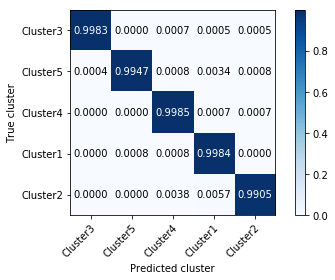

In [9]:
from OrthologClustering import plotConfusionMatrix

plotConfusionMatrix(result_file='ST10FoldResults-test.p')

# Outlier Detection

Since we are predicting the orthologous cluster out of the predefined clusters, it may happen that the input sequence does not belong to any of the clusters. To overcome this problem NORTH also covers an Outlier Detection method. Empirically, it has been found that the individual cluster probabilities of the outlier genes are somewhat distributed, compared to valid ones. Therefore, some statistical properties of the probabilities are computed and a Random Forest classifier is trained to determine whether the clustering is valid or is the gene is merely an outlier

## Reading Data

Similarly, we read the cluster data stored as fasta files from a directory. This time we also consider the 'Outliers.fasta' file as it contains all the outlier genes.

All the operations are compiled in *readFastasWithOutliers* function in **ReadFastas.py**

In [10]:
from ReadFastas import readFastasWithOutliers

(cluster_genes, outlier_genes) = readFastasWithOutliers('sample_clusters')

100%|██████████| 5/5 [00:00<00:00, 38.33it/s]


## Computing Probabilities

The outlier detection component of NORTH requires an already trained Scalable Naive Bayes Model. Therefore, we use the previously trained model and compute the probabilities


In [11]:
from OutlierDetection import *

valid_probas = computeProbabilities(sequences=cluster_genes, model_name='dummy_model', nChild=1)
outlier_probas  = computeProbabilities(sequences=outlier_genes, model_name='dummy_model', nChild=1)

  0%|          | 0/9868 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 476413.15it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 381527.06it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 439389.60it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 492879.04it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 461011.86it/s]

100%|██████████| 5/5 [00:00<00:00, 327.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/370 [00:00<?, ?it/s]


100%|██████████| 370/370 [00:00<00:00, 568667.09it/s]


  0%|          | 0/370 [00:00<?, ?it/s]


100%|██████████| 370/370 [00:00<00:00, 561263.10it/s]


  0%|          | 0/370 [00:00<?, ?it/s]


100%|██████████| 370/370 [00:00<00:00, 522522.72it/s]


  0%|          | 0/370 [00:00<?, ?it/s]


100%|

100%|██████████| 432/432 [00:00<00:00, 663228.16it/s]

  0%|          | 12/9868 [00:00<03:12, 51.22it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/432 [00:00<?, ?it/s]


100%|██████████| 432/432 [00:00<00:00, 588483.06it/s]


  0%|          | 0/432 [00:00<?, ?it/s]


100%|██████████| 432/432 [00:00<00:00, 409755.61it/s]


  0%|          | 0/432 [00:00<?, ?it/s]


100%|██████████| 432/432 [00:00<00:00, 411150.29it/s]


  0%|          | 0/432 [00:00<?, ?it/s]


100%|██████████| 432/432 [00:00<00:00, 424143.10it/s]


  0%|          | 0/432 [00:00<?, ?it/s]


100%|██████████| 432/432 [00:00<00:00, 298802.66it/s]

100%|██████████| 5/5 [00:00<00:00, 257.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 642714.01it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 632307.14it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 

100%|██████████| 355/355 [00:00<00:00, 328040.96it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 357755.39it/s]

100%|██████████| 5/5 [00:00<00:00, 334.12it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 454788.61it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 467496.99it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 626674.21it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 334226.24it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 683017.39it/s]

100%|██████████| 5/5 [00:00<00:00, 305.28it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/361 [00:00<?, ?it/s]


100%|██████████| 361/361 [00:00<00:00, 459388.27it/s]


  0%|          | 0/361 [00:00<?, ?it/s]


100%|██████████| 361/361 [00:00<00:00, 625

100%|██████████| 135/135 [00:00<00:00, 207182.96it/s]


  0%|          | 0/135 [00:00<?, ?it/s]


100%|██████████| 135/135 [00:00<00:00, 215624.92it/s]


  0%|          | 0/135 [00:00<?, ?it/s]


100%|██████████| 135/135 [00:00<00:00, 306734.04it/s]

100%|██████████| 5/5 [00:00<00:00, 112.15it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 482896.84it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 460809.18it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 224074.24it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 398759.98it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 349287.72it/s]

100%|██████████| 5/5 [00:00<00:00, 357.97it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/282 [00:00<?, ?it/s]


100%|██████████| 282/282 [00:00<00:00, 361

100%|██████████| 290/290 [00:00<00:00, 252354.39it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 561823.63it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 207638.81it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 447680.59it/s]

100%|██████████| 5/5 [00:00<00:00, 301.65it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/111 [00:00<?, ?it/s]


100%|██████████| 111/111 [00:00<00:00, 189717.91it/s]


  0%|          | 0/111 [00:00<?, ?it/s]


100%|██████████| 111/111 [00:00<00:00, 209526.44it/s]


  0%|          | 0/111 [00:00<?, ?it/s]


100%|██████████| 111/111 [00:00<00:00, 122646.93it/s]


  0%|          | 0/111 [00:00<?, ?it/s]


100%|██████████| 111/111 [00:00<00:00, 279788.31it/s]


  0%|          | 0/111 [00:00<?, ?it/s]


100%|██████████| 111/111 [00:00<00:00, 329722.20it/s]

  0%|          | 49/9868 [00:01<03:34, 45.84it/s]

  0%|          | 0/5 [0

100%|██████████| 363/363 [00:00<00:00, 232945.59it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 231458.25it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 320533.13it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 473277.08it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 439784.04it/s]

  1%|          | 60/9868 [00:01<03:35, 45.47it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 301312.56it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 442596.61it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 667777.35it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 600131.00it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00

100%|██████████| 5/5 [00:00<00:00, 286.20it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 438126.81it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 573088.96it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 395727.45it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 548247.40it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 457154.46it/s]

100%|██████████| 5/5 [00:00<00:00, 367.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 145586.17it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 321178.00it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 474573.66it/s]


  0%|          | 0/389 [00:00<?, ?it/s]



100%|██████████| 363/363 [00:00<00:00, 421170.78it/s]

100%|██████████| 5/5 [00:00<00:00, 352.56it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/795 [00:00<?, ?it/s]


100%|██████████| 795/795 [00:00<00:00, 1030748.59it/s]


  0%|          | 0/795 [00:00<?, ?it/s]


100%|██████████| 795/795 [00:00<00:00, 966233.46it/s]


  0%|          | 0/795 [00:00<?, ?it/s]


100%|██████████| 795/795 [00:00<00:00, 963163.40it/s]


  0%|          | 0/795 [00:00<?, ?it/s]


100%|██████████| 795/795 [00:00<00:00, 969041.46it/s]


  0%|          | 0/795 [00:00<?, ?it/s]


100%|██████████| 795/795 [00:00<00:00, 808356.77it/s]

100%|██████████| 5/5 [00:00<00:00, 403.15it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 498649.87it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 511971.70it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 58

100%|██████████| 272/272 [00:00<00:00, 612372.89it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 420048.12it/s]

  1%|          | 95/9868 [00:02<03:42, 43.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 376636.14it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 581941.66it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 604533.78it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 522065.58it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 441433.75it/s]

100%|██████████| 5/5 [00:00<00:00, 392.57it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 389146.62it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 

100%|██████████| 296/296 [00:00<00:00, 282419.01it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 305040.29it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 275097.27it/s]

100%|██████████| 5/5 [00:00<00:00, 279.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 358020.74it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 356165.71it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 449280.93it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 240536.49it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 451576.53it/s]

100%|██████████| 5/5 [00:00<00:00, 103.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 386

100%|██████████| 279/279 [00:00<00:00, 203161.60it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 516649.37it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 526647.53it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 427240.17it/s]

100%|██████████| 5/5 [00:00<00:00, 326.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 420636.53it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 440425.60it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 586866.01it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 410168.53it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 393612.79it/s]

100%|██████████| 5/5 [00:00<00:00, 349.72it/s]

  0%|          | 0/5 [00:0

100%|██████████| 544/544 [00:00<00:00, 809113.96it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 792532.61it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 623245.39it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 192646.18it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 510904.92it/s]

100%|██████████| 5/5 [00:00<00:00, 309.11it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 466658.49it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 710463.74it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 603601.62it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 579970.40it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 541991.23it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 403610.49it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 484989.25it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 427814.71it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 205582.88it/s]

100%|██████████| 5/5 [00:00<00:00, 384.38it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 376516.84it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 326776.16it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 664975.82it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 342870.2

100%|██████████| 186/186 [00:00<00:00, 223024.74it/s]

  2%|▏         | 154/9868 [00:03<03:42, 43.56it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 208315.23it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 245404.39it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 332116.03it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 290880.14it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 371318.68it/s]

100%|██████████| 5/5 [00:00<00:00, 365.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00, 110878.56it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00, 425365.74it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00,

100%|██████████| 102/102 [00:00<00:00, 150640.50it/s]


  0%|          | 0/102 [00:00<?, ?it/s]


100%|██████████| 102/102 [00:00<00:00, 203239.43it/s]

100%|██████████| 5/5 [00:00<00:00, 335.28it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 508156.06it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 453866.63it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 459549.83it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 411078.33it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 608570.13it/s]

100%|██████████| 5/5 [00:00<00:00, 370.35it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 371468.63it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 313

100%|██████████| 348/348 [00:00<00:00, 554776.81it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 381101.25it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 700392.41it/s]

100%|██████████| 5/5 [00:00<00:00, 465.37it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 513511.75it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 597317.72it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 663150.20it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 618535.68it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 487999.70it/s]

100%|██████████| 5/5 [00:00<00:00, 552.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 625

100%|██████████| 296/296 [00:00<00:00, 653428.41it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 477872.97it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 570286.63it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 681401.75it/s]

100%|██████████| 5/5 [00:00<00:00, 422.54it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 568882.61it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 479581.27it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 488287.17it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 355143.42it/s]


  0%|          | 0/295 [00:00<?, ?it/s]


100%|██████████| 295/295 [00:00<00:00, 518792.32it/s]

100%|██████████| 5/5 [00:00<00:00, 425.33it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 646931.33it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 626495.77it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 655174.43it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 467131.43it/s]

100%|██████████| 5/5 [00:00<00:00, 470.90it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 282179.25it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 400861.10it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 503464.56it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 434775.41it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 374417.69it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 273/273 [00:00<00:00, 513703.45it/s]


  0%|          | 0/273 [00:00<?, ?it/s]


100%|██████████| 273/273 [00:00<00:00, 545259.52it/s]


  0%|          | 0/273 [00:00<?, ?it/s]


100%|██████████| 273/273 [00:00<00:00, 665723.83it/s]


  0%|          | 0/273 [00:00<?, ?it/s]


100%|██████████| 273/273 [00:00<00:00, 676740.54it/s]


  0%|          | 0/273 [00:00<?, ?it/s]


100%|██████████| 273/273 [00:00<00:00, 615284.79it/s]

  2%|▏         | 214/9868 [00:04<03:30, 45.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 677745.50it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 630267.07it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 540394.05it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 374158.55it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [0

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/78 [00:00<?, ?it/s]


100%|██████████| 78/78 [00:00<00:00, 192331.40it/s]


  0%|          | 0/78 [00:00<?, ?it/s]


100%|██████████| 78/78 [00:00<00:00, 188671.11it/s]


  0%|          | 0/78 [00:00<?, ?it/s]


100%|██████████| 78/78 [00:00<00:00, 176745.39it/s]


  0%|          | 0/78 [00:00<?, ?it/s]


100%|██████████| 78/78 [00:00<00:00, 183383.25it/s]


  0%|          | 0/78 [00:00<?, ?it/s]


100%|██████████| 78/78 [00:00<00:00, 184729.37it/s]

100%|██████████| 5/5 [00:00<00:00, 489.78it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 440488.86it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 447287.80it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 530688.85it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 260856.88it/s]


  0%| 

100%|██████████| 5/5 [00:00<00:00, 369.79it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 437302.77it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 478833.51it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 533174.24it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 721353.38it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 477254.25it/s]

100%|██████████| 5/5 [00:00<00:00, 398.23it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 571087.87it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 513240.16it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 526874.62it/s]


  0%|          | 0/331 [00:00<?, ?it/s]



100%|██████████| 434/434 [00:00<00:00, 715819.09it/s]

100%|██████████| 5/5 [00:00<00:00, 372.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 667683.01it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 298306.11it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 490350.17it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 413327.58it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 469182.65it/s]

100%|██████████| 5/5 [00:00<00:00, 432.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 571261.17it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 290770.77it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 408

  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 536857.94it/s]

100%|██████████| 5/5 [00:00<00:00, 325.64it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 510596.92it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 265972.07it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 648899.15it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 573843.06it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 680447.48it/s]

100%|██████████| 5/5 [00:00<00:00, 424.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 581343.71it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 211658.16it/s]


  0%|          | 0/256 [00:00<?, ?it/s]




100%|██████████| 271/271 [00:00<00:00, 223487.30it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 390067.39it/s]

100%|██████████| 5/5 [00:00<00:00, 130.55it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 480206.54it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 326365.30it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 570532.32it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 370000.63it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 419430.40it/s]

100%|██████████| 5/5 [00:00<00:00, 393.88it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 454642.94it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 385

  0%|          | 0/82 [00:00<?, ?it/s]


100%|██████████| 82/82 [00:00<00:00, 231137.72it/s]


  0%|          | 0/82 [00:00<?, ?it/s]


100%|██████████| 82/82 [00:00<00:00, 214958.08it/s]

100%|██████████| 5/5 [00:00<00:00, 477.46it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 402240.63it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 572617.93it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 236764.35it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 326141.05it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 510294.87it/s]

100%|██████████| 5/5 [00:00<00:00, 131.10it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 404513.95it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|█

100%|██████████| 268/268 [00:00<00:00, 389222.12it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 431009.77it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 519442.45it/s]

100%|██████████| 5/5 [00:00<00:00, 305.11it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 429062.41it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 401800.38it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 520965.52it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 467092.95it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 511458.06it/s]

100%|██████████| 5/5 [00:00<00:00, 321.19it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 176

100%|██████████| 331/331 [00:00<00:00, 641846.80it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 585786.76it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 296585.05it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 423266.65it/s]

100%|██████████| 5/5 [00:00<00:00, 365.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 418341.78it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 457715.12it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 512383.19it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 409237.50it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 324587.97it/s]

100%|██████████| 5/5 [00:00<00:00, 360.84it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 494183.47it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 439747.86it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 249275.92it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 391898.30it/s]

100%|██████████| 5/5 [00:00<00:00, 328.51it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 537075.51it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 635959.45it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 598314.11it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 391344.14it/s]


  0%|          | 0/294 [00:00<?, ?it/s]


100%|██████████| 294/294 [00:00<00:00, 257115.38it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 289/289 [00:00<00:00, 523608.58it/s]


  0%|          | 0/289 [00:00<?, ?it/s]


100%|██████████| 289/289 [00:00<00:00, 635967.40it/s]


  0%|          | 0/289 [00:00<?, ?it/s]


100%|██████████| 289/289 [00:00<00:00, 542593.49it/s]


  0%|          | 0/289 [00:00<?, ?it/s]


100%|██████████| 289/289 [00:00<00:00, 402441.52it/s]


  0%|          | 0/289 [00:00<?, ?it/s]


100%|██████████| 289/289 [00:00<00:00, 225349.29it/s]

100%|██████████| 5/5 [00:00<00:00, 368.53it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 548898.96it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 398357.85it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 427326.65it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 484363.14it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 482701.42it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 234218.01it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 510351.48it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 262345.80it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 477794.88it/s]

100%|██████████| 5/5 [00:00<00:00, 189.96it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 323665.46it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 320984.21it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 236333.13it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 406441.0

100%|██████████| 286/286 [00:00<00:00, 682738.16it/s]

100%|██████████| 5/5 [00:00<00:00, 407.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 380525.89it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 379882.89it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 328772.59it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 363542.52it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 375191.41it/s]

100%|██████████| 5/5 [00:00<00:00, 333.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/243 [00:00<?, ?it/s]


100%|██████████| 243/243 [00:00<00:00, 491188.37it/s]


  0%|          | 0/243 [00:00<?, ?it/s]


100%|██████████| 243/243 [00:00<00:00, 451780.09it/s]


  0%|          | 0/243 [00:00<?, ?it/s]


100%|██████████| 243/243 [00:00<00:00, 243

100%|██████████| 435/435 [00:00<00:00, 704993.14it/s]


  0%|          | 0/435 [00:00<?, ?it/s]


100%|██████████| 435/435 [00:00<00:00, 616809.41it/s]

100%|██████████| 5/5 [00:00<00:00, 388.64it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 533749.93it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 321469.79it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 325552.81it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 348890.99it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 575853.02it/s]

100%|██████████| 5/5 [00:00<00:00, 355.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 575649.86it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 672

100%|██████████| 551/551 [00:00<00:00, 811183.40it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 842530.62it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 833115.18it/s]

100%|██████████| 5/5 [00:00<00:00, 424.09it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 365021.53it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 481790.45it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 372608.30it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 524040.81it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 561642.53it/s]

100%|██████████| 5/5 [00:00<00:00, 425.15it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 705

  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 622219.43it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 346678.52it/s]

100%|██████████| 5/5 [00:00<00:00, 419.89it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 553780.72it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 469709.12it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 484614.46it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 519486.41it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 333477.70it/s]

100%|██████████| 5/5 [00:00<00:00, 383.18it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 542113.52it/s]


  0%|          | 0/498 [00:00<?, ?it/s]




100%|██████████| 284/284 [00:00<00:00, 571859.02it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 510360.90it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 535844.51it/s]

100%|██████████| 5/5 [00:00<00:00, 487.65it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 424022.70it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 440584.83it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 438920.37it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 463986.50it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 437762.70it/s]

100%|██████████| 5/5 [00:00<00:00, 331.86it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 234

100%|██████████| 266/266 [00:00<00:00, 516760.01it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 377814.04it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 336353.59it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 401903.77it/s]

100%|██████████| 5/5 [00:00<00:00, 400.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 534810.90it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 426941.41it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 578524.69it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 213303.17it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 554675.30it/s]

100%|██████████| 5/5 [00:00<00:00, 373.15it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 615337.57it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 560140.36it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 627538.95it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 19730.35it/s]

  5%|▍         | 450/9868 [00:09<03:14, 48.37it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367/367 [00:00<00:00, 515163.84it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367/367 [00:00<00:00, 383580.75it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367/367 [00:00<00:00, 507186.02it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367/367 [00:00<00:00, 408196.65it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367/367 [00:00<00:00, 520740.72it/s]

100%|██████████| 5/5 [00:00<0

100%|██████████| 261/261 [00:00<00:00, 633514.67it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 504243.82it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 524037.02it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 446639.47it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 504243.82it/s]

100%|██████████| 5/5 [00:00<00:00, 479.81it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 479747.16it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 481805.18it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 563134.97it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 669865.65it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/195 [00:00<?, ?it/s]


100%|██████████| 195/195 [00:00<00:00, 535267.85it/s]


  0%|          | 0/195 [00:00<?, ?it/s]


100%|██████████| 195/195 [00:00<00:00, 273724.66it/s]


  0%|          | 0/195 [00:00<?, ?it/s]


100%|██████████| 195/195 [00:00<00:00, 479981.97it/s]


  0%|          | 0/195 [00:00<?, ?it/s]


100%|██████████| 195/195 [00:00<00:00, 350724.39it/s]


  0%|          | 0/195 [00:00<?, ?it/s]


100%|██████████| 195/195 [00:00<00:00, 433663.46it/s]

100%|██████████| 5/5 [00:00<00:00, 482.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 411940.57it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 554999.43it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 341868.21it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 446240.0

100%|██████████| 377/377 [00:00<00:00, 726011.30it/s]

100%|██████████| 5/5 [00:00<00:00, 395.67it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 734385.69it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 692183.76it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 722710.84it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 631966.88it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 338039.37it/s]

100%|██████████| 5/5 [00:00<00:00, 452.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 552952.78it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 495494.63it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 567

  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 530332.23it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 646154.67it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 147747.97it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 455756.91it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 518379.99it/s]

100%|██████████| 5/5 [00:00<00:00, 346.08it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 559542.17it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 191872.60it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 500510.38it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 735738.43it/s]


  0%|          | 0/371 [00:00<?

100%|██████████| 5/5 [00:00<00:00, 315.11it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 517569.55it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 468033.92it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 484459.81it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 43960.13it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 420887.32it/s]

100%|██████████| 5/5 [00:00<00:00, 125.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/374 [00:00<?, ?it/s]


100%|██████████| 374/374 [00:00<00:00, 398038.49it/s]


  0%|          | 0/374 [00:00<?, ?it/s]


100%|██████████| 374/374 [00:00<00:00, 637929.93it/s]


  0%|          | 0/374 [00:00<?, ?it/s]


100%|██████████| 374/374 [00:00<00:00, 659936.77it/s]


  0%|          | 0/374 [00:00<?, ?it/s]




100%|██████████| 233/233 [00:00<00:00, 153418.03it/s]

100%|██████████| 5/5 [00:00<00:00, 309.84it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/96 [00:00<?, ?it/s]


100%|██████████| 96/96 [00:00<00:00, 286790.02it/s]


  0%|          | 0/96 [00:00<?, ?it/s]


100%|██████████| 96/96 [00:00<00:00, 229301.36it/s]


  0%|          | 0/96 [00:00<?, ?it/s]


100%|██████████| 96/96 [00:00<00:00, 294122.12it/s]


  0%|          | 0/96 [00:00<?, ?it/s]


100%|██████████| 96/96 [00:00<00:00, 274100.19it/s]


  0%|          | 0/96 [00:00<?, ?it/s]


100%|██████████| 96/96 [00:00<00:00, 273355.86it/s]

100%|██████████| 5/5 [00:00<00:00, 550.68it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 339909.21it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 609140.61it/s]


  0%|          | 0/271 [00:00<?, ?it/s]


100%|██████████| 271/271 [00:00<00:00, 480209.71it/s]


 

  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 222305.31it/s]

100%|██████████| 5/5 [00:00<00:00, 346.89it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 301611.00it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 556277.80it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 691117.73it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 648437.97it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 261154.78it/s]

100%|██████████| 5/5 [00:00<00:00, 376.37it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 459751.66it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 521125.83it/s]


  0%|          | 0/309 [00:00<?, ?it/s]




100%|██████████| 306/306 [00:00<00:00, 346974.05it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 497849.89it/s]

100%|██████████| 5/5 [00:00<00:00, 349.92it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 725634.81it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 773264.95it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 709298.53it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 462375.49it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 651014.03it/s]

100%|██████████| 5/5 [00:00<00:00, 525.19it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 540199.03it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 252

  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 581462.01it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 632570.34it/s]

  6%|▌         | 589/9868 [00:12<03:09, 49.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 389316.60it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 618052.35it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 412554.49it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 453752.72it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 394163.51it/s]

100%|██████████| 5/5 [00:00<00:00, 440.13it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 646621.87it/s]


  0%|          | 0/259 [00:00<?, ?it/s

100%|██████████| 480/480 [00:00<00:00, 735305.30it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 723415.71it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 707899.41it/s]

100%|██████████| 5/5 [00:00<00:00, 412.59it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/202 [00:00<?, ?it/s]


100%|██████████| 202/202 [00:00<00:00, 9281.26it/s]


  0%|          | 0/202 [00:00<?, ?it/s]


100%|██████████| 202/202 [00:00<00:00, 408904.15it/s]


  0%|          | 0/202 [00:00<?, ?it/s]


100%|██████████| 202/202 [00:00<00:00, 420888.93it/s]


  0%|          | 0/202 [00:00<?, ?it/s]


100%|██████████| 202/202 [00:00<00:00, 410688.03it/s]


  0%|          | 0/202 [00:00<?, ?it/s]


100%|██████████| 202/202 [00:00<00:00, 442427.89it/s]

  6%|▌         | 602/9868 [00:12<03:08, 49.22it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 4

  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 507003.78it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 603617.13it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 525326.19it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 568986.01it/s]

100%|██████████| 5/5 [00:00<00:00, 520.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/300 [00:00<?, ?it/s]


100%|██████████| 300/300 [00:00<00:00, 525163.27it/s]


  0%|          | 0/300 [00:00<?, ?it/s]


100%|██████████| 300/300 [00:00<00:00, 502914.15it/s]


  0%|          | 0/300 [00:00<?, ?it/s]


100%|██████████| 300/300 [00:00<00:00, 556766.02it/s]


  0%|          | 0/300 [00:00<?, ?it/s]


100%|██████████| 300/300 [00:00<00:00, 518455.38it/s]


  0%|          | 0/300 [00:00<?, ?it/s]


100%|██████████| 300/300 [00:00<00:00, 560985.82it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 255/255 [00:00<00:00, 562919.75it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 515444.59it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 409945.39it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 211917.48it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 212296.05it/s]

  7%|▋         | 665/9868 [00:13<03:04, 49.84it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 380975.67it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 382168.93it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 358870.93it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 369745.81it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [0

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 281194.38it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 395717.55it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 434522.60it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 365814.80it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 155388.52it/s]

  7%|▋         | 677/9868 [00:13<03:04, 49.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 378001.44it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 294378.44it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 263064.73it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 2510

100%|██████████| 302/302 [00:00<00:00, 546925.65it/s]

100%|██████████| 5/5 [00:00<00:00, 334.20it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 190279.88it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 471318.70it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 264214.49it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 165784.77it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 116389.80it/s]

  7%|▋         | 689/9868 [00:13<03:04, 49.80it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 71504.95it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 405273.58it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 

100%|██████████| 432/432 [00:00<00:00, 638006.81it/s]


  0%|          | 0/432 [00:00<?, ?it/s]


100%|██████████| 432/432 [00:00<00:00, 667135.25it/s]

  7%|▋         | 700/9868 [00:14<03:04, 49.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 434254.97it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 607870.14it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 438956.39it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 497280.52it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 397629.34it/s]

100%|██████████| 5/5 [00:00<00:00, 428.98it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/517 [00:00<?, ?it/s]


100%|██████████| 517/517 [00:00<00:00, 741605.73it/s]


  0%|          | 0/517 [00:00<?, ?it/s]


100%|██████████| 517/517 [00:00<00:00,

100%|██████████| 288/288 [00:00<00:00, 577142.64it/s]


  0%|          | 0/288 [00:00<?, ?it/s]


100%|██████████| 288/288 [00:00<00:00, 539508.51it/s]


  0%|          | 0/288 [00:00<?, ?it/s]


100%|██████████| 288/288 [00:00<00:00, 488064.47it/s]

100%|██████████| 5/5 [00:00<00:00, 458.64it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 505295.26it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 481948.95it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 568786.60it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 431810.99it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 591504.41it/s]

100%|██████████| 5/5 [00:00<00:00, 465.32it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/192 [00:00<?, ?it/s]


100%|██████████| 192/192 [00:00<00:00, 435

100%|██████████| 336/336 [00:00<00:00, 628864.86it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 617295.73it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 619466.44it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 628864.86it/s]

100%|██████████| 5/5 [00:00<00:00, 480.78it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 807873.86it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 771244.82it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 823075.78it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 659311.35it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 730749.86it/s]

100%|██████████| 5/5 [00:00<00:00, 550.95it/s]

  0%|          | 0/5 [00:0

100%|██████████| 208/208 [00:00<00:00, 438840.66it/s]


  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 599186.29it/s]


  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 407099.97it/s]


  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 348269.55it/s]

100%|██████████| 5/5 [00:00<00:00, 487.59it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 415461.81it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 457237.83it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 566112.75it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 500032.68it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 505610.59it/s]

100%|██████████| 5/5 [00:00<00:00, 442.45it/s]

  0%|          | 0/5 [00:0

100%|██████████| 551/551 [00:00<00:00, 541612.73it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 875733.80it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 1046202.58it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 761219.20it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 998730.12it/s]

100%|██████████| 5/5 [00:00<00:00, 520.64it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 699050.67it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 684333.81it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 599493.25it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 696968.92it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:0

  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 601349.41it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 612082.16it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 636124.67it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 632673.09it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 606668.32it/s]

100%|██████████| 5/5 [00:00<00:00, 565.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 473100.12it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 577284.62it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 699815.49it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 688145.63it/s]


  0%|          | 0/305 [00:00<?

100%|██████████| 5/5 [00:00<00:00, 164.35it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 477241.34it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 449035.59it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 241130.64it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 667802.29it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 645434.16it/s]

100%|██████████| 5/5 [00:00<00:00, 400.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 587736.87it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 791038.90it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 523544.33it/s]


  0%|          | 0/440 [00:00<?, ?it/s]



100%|██████████| 239/239 [00:00<00:00, 396534.28it/s]

  8%|▊         | 811/9868 [00:15<02:57, 50.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/201 [00:00<?, ?it/s]


100%|██████████| 201/201 [00:00<00:00, 321163.85it/s]


  0%|          | 0/201 [00:00<?, ?it/s]


100%|██████████| 201/201 [00:00<00:00, 420896.21it/s]


  0%|          | 0/201 [00:00<?, ?it/s]


100%|██████████| 201/201 [00:00<00:00, 367664.68it/s]


  0%|          | 0/201 [00:00<?, ?it/s]


100%|██████████| 201/201 [00:00<00:00, 393950.98it/s]


  0%|          | 0/201 [00:00<?, ?it/s]


100%|██████████| 201/201 [00:00<00:00, 6731.68it/s]

100%|██████████| 5/5 [00:00<00:00, 117.69it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 510211.23it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 595355.17it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 3

100%|██████████| 355/355 [00:00<00:00, 449706.41it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 725269.32it/s]

100%|██████████| 5/5 [00:00<00:00, 546.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1076 [00:00<?, ?it/s]


100%|██████████| 1076/1076 [00:00<00:00, 1156604.59it/s]


  0%|          | 0/1076 [00:00<?, ?it/s]


100%|██████████| 1076/1076 [00:00<00:00, 1097003.19it/s]


  0%|          | 0/1076 [00:00<?, ?it/s]


100%|██████████| 1076/1076 [00:00<00:00, 1136793.73it/s]


  0%|          | 0/1076 [00:00<?, ?it/s]


100%|██████████| 1076/1076 [00:00<00:00, 1015085.72it/s]


  0%|          | 0/1076 [00:00<?, ?it/s]


100%|██████████| 1076/1076 [00:00<00:00, 1088536.20it/s]

100%|██████████| 5/5 [00:00<00:00, 404.47it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 537417.08it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/3

100%|██████████| 272/272 [00:00<00:00, 352658.64it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 431976.78it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 531865.12it/s]

100%|██████████| 5/5 [00:00<00:00, 384.53it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00, 351432.33it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00, 393788.37it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00, 377469.80it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00, 294987.03it/s]


  0%|          | 0/215 [00:00<?, ?it/s]


100%|██████████| 215/215 [00:00<00:00, 482749.12it/s]

100%|██████████| 5/5 [00:00<00:00, 421.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 441

  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 450300.02it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 405283.70it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 446232.41it/s]

100%|██████████| 5/5 [00:00<00:00, 326.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/226 [00:00<?, ?it/s]


100%|██████████| 226/226 [00:00<00:00, 487358.72it/s]


  0%|          | 0/226 [00:00<?, ?it/s]


100%|██████████| 226/226 [00:00<00:00, 519974.06it/s]


  0%|          | 0/226 [00:00<?, ?it/s]


100%|██████████| 226/226 [00:00<00:00, 514610.59it/s]


  0%|          | 0/226 [00:00<?, ?it/s]


100%|██████████| 226/226 [00:00<00:00, 518835.63it/s]


  0%|          | 0/226 [00:00<?, ?it/s]


100%|██████████| 226/226 [00:00<00:00, 401828.19it/s]

100%|██████████| 5/5 [00:00<00:00, 497.82it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/379 [00:00<?, ?it/s]




100%|██████████| 292/292 [00:00<00:00, 519616.79it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 599479.57it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 710816.46it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 689215.96it/s]

  9%|▊         | 859/9868 [00:16<02:56, 51.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 596397.93it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 613202.34it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 628574.17it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 452859.68it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 606431.97it/s]

100%|██████████| 5/5 [00:00<00:00, 550.01it/s]

  0%|          | 0/5 [

100%|██████████| 552/552 [00:00<00:00, 841299.35it/s]


  0%|          | 0/552 [00:00<?, ?it/s]


100%|██████████| 552/552 [00:00<00:00, 812085.52it/s]


  0%|          | 0/552 [00:00<?, ?it/s]


100%|██████████| 552/552 [00:00<00:00, 705010.90it/s]


  0%|          | 0/552 [00:00<?, ?it/s]


100%|██████████| 552/552 [00:00<00:00, 455848.75it/s]


  0%|          | 0/552 [00:00<?, ?it/s]


100%|██████████| 552/552 [00:00<00:00, 821595.39it/s]

100%|██████████| 5/5 [00:00<00:00, 450.19it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 10500.78it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 568111.95it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 550641.92it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 466033.78it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 734595.62it/s]


  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 668787.44it/s]


  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 628132.48it/s]


  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 688258.09it/s]


  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 746903.35it/s]

100%|██████████| 5/5 [00:00<00:00, 526.59it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/381 [00:00<?, ?it/s]


100%|██████████| 381/381 [00:00<00:00, 682918.73it/s]


  0%|          | 0/381 [00:00<?, ?it/s]


100%|██████████| 381/381 [00:00<00:00, 788761.02it/s]


  0%|          | 0/381 [00:00<?, ?it/s]


100%|██████████| 381/381 [00:00<00:00, 701197.82it/s]


  0%|          | 0/381 [00:00<?, ?it/s]


100%|██████████| 381/381 [00:00<00:00, 696309.2

  9%|▉         | 894/9868 [00:17<02:54, 51.54it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 680464.95it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 677523.98it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 600333.60it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 482902.15it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 439109.56it/s]

100%|██████████| 5/5 [00:00<00:00, 407.67it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 549103.24it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 585670.81it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 493224.35it/s]


  0%|          | 0/260 [00:00<?, ?it/

100%|██████████| 318/318 [00:00<00:00, 742230.76it/s]

100%|██████████| 5/5 [00:00<00:00, 512.50it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 421697.59it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 450687.78it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 443261.67it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 402134.30it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 259700.58it/s]

100%|██████████| 5/5 [00:00<00:00, 533.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 471296.72it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 429576.17it/s]


  0%|          | 0/199 [00:00<?, ?it/s]


100%|██████████| 199/199 [00:00<00:00, 468

  0%|          | 0/238 [00:00<?, ?it/s]


100%|██████████| 238/238 [00:00<00:00, 476716.50it/s]

100%|██████████| 5/5 [00:00<00:00, 179.08it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 726572.35it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 748795.85it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 669403.43it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 661284.97it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 649118.48it/s]

100%|██████████| 5/5 [00:00<00:00, 599.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 555536.95it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 471993.29it/s]


  0%|          | 0/220 [00:00<?, ?it/s]




100%|██████████| 465/465 [00:00<00:00, 835984.29it/s]


  0%|          | 0/465 [00:00<?, ?it/s]


100%|██████████| 465/465 [00:00<00:00, 828526.49it/s]

100%|██████████| 5/5 [00:00<00:00, 559.42it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 645613.10it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 616748.13it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 14591.80it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 592608.11it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 581777.87it/s]

100%|██████████| 5/5 [00:00<00:00, 171.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 663038.97it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 6499

100%|██████████| 363/363 [00:00<00:00, 593579.86it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 549056.02it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 700014.87it/s]

100%|██████████| 5/5 [00:00<00:00, 289.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 488782.13it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 469776.23it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 538512.87it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 467799.06it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 553531.16it/s]

100%|██████████| 5/5 [00:00<00:00, 444.80it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/425 [00:00<?, ?it/s]


100%|██████████| 425/425 [00:00<00:00, 685

  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 415119.54it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 169493.17it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 423173.86it/s]

 10%|▉         | 954/9868 [00:18<02:50, 52.25it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 531689.36it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 29431.83it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 84450.36it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 449900.97it/s]


  0%|          | 0/440 [00:00<?, ?it/s]


100%|██████████| 440/440 [00:00<00:00, 440557.12it/s]

100%|██████████| 5/5 [00:00<00:00, 109.24it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 693421.17it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 590484.91it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 726097.27it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 743429.20it/s]

100%|██████████| 5/5 [00:00<00:00, 496.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 575334.87it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 578133.79it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 634369.82it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 586696.39it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 591563.89it/s]

100%|██████████| 5/5 [00:00<00:00, 594.58it/s]

  0%|          | 0/5 [00:0

100%|██████████| 311/311 [00:00<00:00, 691637.62it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 697555.37it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 754877.63it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 646076.54it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 685459.04it/s]

100%|██████████| 5/5 [00:00<00:00, 564.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 629965.26it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 607902.90it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 592889.00it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 643254.15it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00

  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 683422.71it/s]


  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 672437.06it/s]


  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 631561.87it/s]


  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 694773.26it/s]


  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 18712.89it/s]

100%|██████████| 5/5 [00:00<00:00, 163.88it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 686750.65it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 646613.82it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 606165.59it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 636941.00it/s]


  0%|          | 0/335 [00:00<?,

  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 824801.68it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 756349.90it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 653561.31it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 829901.63it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 691519.91it/s]

 11%|█▏        | 1120/9868 [00:20<02:41, 54.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 857365.08it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 866604.62it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 851106.94it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 851728.64it/s]


  0%|          | 0/556 [00

100%|██████████| 5/5 [00:00<00:00, 532.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 458115.73it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 587986.54it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 549312.22it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 295651.13it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 388361.48it/s]

100%|██████████| 5/5 [00:00<00:00, 496.07it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 416615.43it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 587004.25it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 695915.91it/s]


  0%|          | 0/296 [00:00<?, ?it/s]



100%|██████████| 215/215 [00:00<00:00, 535178.26it/s]

100%|██████████| 5/5 [00:00<00:00, 532.38it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 667192.09it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 553446.87it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 632280.88it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 547476.57it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 723981.15it/s]

100%|██████████| 5/5 [00:00<00:00, 470.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 511679.41it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 515965.97it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 565

100%|██████████| 194/194 [00:00<00:00, 501661.51it/s]

100%|██████████| 5/5 [00:00<00:00, 171.15it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 691038.62it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 735655.76it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 750926.25it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 708289.22it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 706215.17it/s]

100%|██████████| 5/5 [00:00<00:00, 496.47it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 547352.80it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 606798.90it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 635

100%|██████████| 353/353 [00:00<00:00, 629770.02it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 743267.73it/s]

100%|██████████| 5/5 [00:00<00:00, 456.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 641890.72it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 647976.69it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 529786.69it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 540131.20it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 609560.44it/s]

100%|██████████| 5/5 [00:00<00:00, 155.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 538717.94it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 602

100%|██████████| 259/259 [00:00<00:00, 453012.82it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 408392.76it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 584989.09it/s]

100%|██████████| 5/5 [00:00<00:00, 450.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 688997.95it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 686719.01it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 279181.60it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 609446.32it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 672265.67it/s]

100%|██████████| 5/5 [00:00<00:00, 444.51it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/435 [00:00<?, ?it/s]


100%|██████████| 435/435 [00:00<00:00, 780

  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 486261.40it/s]


  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 516339.43it/s]


  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 539913.58it/s]

100%|██████████| 5/5 [00:00<00:00, 535.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 323989.24it/s]


  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 518856.62it/s]


  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 582781.46it/s]


  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 511377.60it/s]


  0%|          | 0/203 [00:00<?, ?it/s]


100%|██████████| 203/203 [00:00<00:00, 600877.71it/s]

100%|██████████| 5/5 [00:00<00:00, 603.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/203 [00:00<?, ?it/s]




100%|██████████| 252/252 [00:00<00:00, 665175.96it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 633671.83it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 608850.58it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 650439.76it/s]

100%|██████████| 5/5 [00:00<00:00, 619.84it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/392 [00:00<?, ?it/s]


100%|██████████| 392/392 [00:00<00:00, 829131.20it/s]


  0%|          | 0/392 [00:00<?, ?it/s]


100%|██████████| 392/392 [00:00<00:00, 906376.61it/s]


  0%|          | 0/392 [00:00<?, ?it/s]


100%|██████████| 392/392 [00:00<00:00, 734659.15it/s]


  0%|          | 0/392 [00:00<?, ?it/s]


100%|██████████| 392/392 [00:00<00:00, 823318.56it/s]


  0%|          | 0/392 [00:00<?, ?it/s]


100%|██████████| 392/392 [00:00<00:00, 426723.90it/s]

100%|██████████| 5/5 [00:00<00:00, 586.62it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 700868.74it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 406155.29it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 607287.96it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 620216.41it/s]

100%|██████████| 5/5 [00:00<00:00, 592.78it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 628120.10it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 589560.80it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 656616.28it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 617179.87it/s]


  0%|          | 0/245 [00:00<?, ?it/s]


100%|██████████| 245/245 [00:00<00:00, 656196.99it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 473/473 [00:00<00:00, 689814.25it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 611750.17it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 804503.57it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 686710.21it/s]

100%|██████████| 5/5 [00:00<00:00, 134.46it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 282247.48it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 421818.05it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 441067.68it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 458914.35it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 380647.45it/s]

100%|██████████| 5/5 [00:00<00:00, 382.11it/s]

  0%|          | 0/5 [00:0

100%|██████████| 305/305 [00:00<00:00, 248883.80it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 461328.06it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 508653.17it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 468766.11it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 490326.84it/s]

100%|██████████| 5/5 [00:00<00:00, 388.56it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 336649.74it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 528975.75it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 650129.25it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 496718.28it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00

  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 726017.01it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 821032.66it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 516539.90it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 569215.35it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 528249.87it/s]

 13%|█▎        | 1278/9868 [00:23<02:36, 55.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 590118.84it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 469063.91it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 337269.89it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 319283.15it/s]


  0%|          | 0/344 [00

  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 723155.86it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 662892.87it/s]

 14%|█▍        | 1406/9868 [00:25<02:33, 55.05it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 840891.94it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 536435.54it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 748143.84it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 814466.16it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 852450.59it/s]

100%|██████████| 5/5 [00:00<00:00, 545.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/214 [00:00<?, ?it/s]


100%|██████████| 214/214 [00:00<00:00, 571343.77it/s]


  0%|          | 0/214 [00:00<?, ?it/

100%|██████████| 307/307 [00:00<00:00, 455967.18it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 525571.97it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 537417.08it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 507348.83it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 604531.14it/s]

 14%|█▍        | 1429/9868 [00:25<02:32, 55.26it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 817986.37it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 719694.73it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 601737.10it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 809090.12it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 462112.82it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 364549.18it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 636552.76it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 582248.16it/s]


  0%|          | 0/275 [00:00<?, ?it/s]


100%|██████████| 275/275 [00:00<00:00, 601059.72it/s]

100%|██████████| 5/5 [00:00<00:00, 531.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 669042.64it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 696211.88it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 652491.63it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 678307.3

100%|██████████| 353/353 [00:00<00:00, 680417.88it/s]

100%|██████████| 5/5 [00:00<00:00, 143.10it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 473664.05it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 280106.20it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 460893.70it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 619586.92it/s]


  0%|          | 0/269 [00:00<?, ?it/s]


100%|██████████| 269/269 [00:00<00:00, 600781.56it/s]

100%|██████████| 5/5 [00:00<00:00, 443.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/174 [00:00<?, ?it/s]


100%|██████████| 174/174 [00:00<00:00, 352394.45it/s]


  0%|          | 0/174 [00:00<?, ?it/s]


100%|██████████| 174/174 [00:00<00:00, 162577.17it/s]


  0%|          | 0/174 [00:00<?, ?it/s]


100%|██████████| 174/174 [00:00<00:00, 272

  0%|          | 0/404 [00:00<?, ?it/s]


100%|██████████| 404/404 [00:00<00:00, 557034.46it/s]

100%|██████████| 5/5 [00:00<00:00, 476.90it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 615480.22it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 531253.74it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 519970.07it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 575333.79it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 614534.30it/s]

100%|██████████| 5/5 [00:00<00:00, 512.79it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 467208.26it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 530590.26it/s]


  0%|          | 0/221 [00:00<?, ?it/s]




100%|██████████| 332/332 [00:00<00:00, 612361.01it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 629524.83it/s]

100%|██████████| 5/5 [00:00<00:00, 496.50it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 553283.08it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 292625.86it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 603929.97it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 632405.42it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 641715.28it/s]

100%|██████████| 5/5 [00:00<00:00, 407.19it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 667077.46it/s]


  0%|          | 0/306 [00:00<?, ?it/s]


100%|██████████| 306/306 [00:00<00:00, 447

100%|██████████| 368/368 [00:00<00:00, 506565.10it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 455310.88it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 262589.97it/s]

100%|██████████| 5/5 [00:00<00:00, 157.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 210965.77it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 219917.56it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 176774.92it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 111404.02it/s]


  0%|          | 0/194 [00:00<?, ?it/s]


100%|██████████| 194/194 [00:00<00:00, 180700.64it/s]

100%|██████████| 5/5 [00:00<00:00, 202.34it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 521

100%|██████████| 389/389 [00:00<00:00, 742641.90it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 819479.79it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 678695.61it/s]


  0%|          | 0/389 [00:00<?, ?it/s]


100%|██████████| 389/389 [00:00<00:00, 437656.72it/s]

100%|██████████| 5/5 [00:00<00:00, 465.57it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/435 [00:00<?, ?it/s]


100%|██████████| 435/435 [00:00<00:00, 687202.35it/s]


  0%|          | 0/435 [00:00<?, ?it/s]


100%|██████████| 435/435 [00:00<00:00, 479758.67it/s]


  0%|          | 0/435 [00:00<?, ?it/s]


100%|██████████| 435/435 [00:00<00:00, 474765.09it/s]


  0%|          | 0/435 [00:00<?, ?it/s]


100%|██████████| 435/435 [00:00<00:00, 435031.53it/s]


  0%|          | 0/435 [00:00<?, ?it/s]


100%|██████████| 435/435 [00:00<00:00, 305257.19it/s]

100%|██████████| 5/5 [00:00<00:00, 144.32it/s]

  0%|          | 0/5 [00:0

100%|██████████| 979/979 [00:00<00:00, 800277.45it/s]


  0%|          | 0/979 [00:00<?, ?it/s]


100%|██████████| 979/979 [00:00<00:00, 747265.44it/s]


  0%|          | 0/979 [00:00<?, ?it/s]


100%|██████████| 979/979 [00:00<00:00, 604923.93it/s]


  0%|          | 0/979 [00:00<?, ?it/s]


100%|██████████| 979/979 [00:00<00:00, 615533.45it/s]


  0%|          | 0/979 [00:00<?, ?it/s]


100%|██████████| 979/979 [00:00<00:00, 638008.64it/s]

100%|██████████| 5/5 [00:00<00:00, 303.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/442 [00:00<?, ?it/s]


100%|██████████| 442/442 [00:00<00:00, 345744.57it/s]


  0%|          | 0/442 [00:00<?, ?it/s]


100%|██████████| 442/442 [00:00<00:00, 462199.54it/s]


  0%|          | 0/442 [00:00<?, ?it/s]


100%|██████████| 442/442 [00:00<00:00, 501863.12it/s]


  0%|          | 0/442 [00:00<?, ?it/s]


100%|██████████| 442/442 [00:00<00:00, 780910.85it/s]


  0%|          | 0/442 [00:00<?, ?it/s]


100%|██████████| 442/442 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 521710.38it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 290013.37it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 357172.30it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 563846.39it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 421596.71it/s]

100%|██████████| 5/5 [00:00<00:00, 417.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 598773.05it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 518650.49it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 357513.25it/s]


  0%|          | 0/414 [00:00<?, ?it/s]


100%|██████████| 414/414 [00:00<00:00, 703297.6

 16%|█▌        | 1571/9868 [00:28<02:30, 55.08it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 228734.64it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 276839.23it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 373213.30it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 250068.76it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 301599.87it/s]




100%|██████████| 452/452 [00:00<00:00, 503673.06it/s]


  0%|          | 0/452 [00:00<?, ?it/s]


100%|██████████| 452/452 [00:00<00:00, 528232.21it/s]

 17%|█▋        | 1694/9868 [00:31<02:30, 54.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 605658.45it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:

100%|██████████| 171/171 [00:00<00:00, 277028.19it/s]


  0%|          | 0/171 [00:00<?, ?it/s]


100%|██████████| 171/171 [00:00<00:00, 409609.36it/s]


  0%|          | 0/171 [00:00<?, ?it/s]


100%|██████████| 171/171 [00:00<00:00, 506873.49it/s]

100%|██████████| 5/5 [00:00<00:00, 461.09it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 613845.28it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 430613.50it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 175592.58it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 592365.87it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 704659.90it/s]

 18%|█▊        | 1748/9868 [00:32<02:30, 53.90it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00

100%|██████████| 328/328 [00:00<00:00, 564982.22it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 685466.72it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 452097.18it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 650464.17it/s]

100%|██████████| 5/5 [00:00<00:00, 350.19it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 810364.47it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 613438.87it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 613438.87it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 654685.53it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 461860.68it/s]

100%|██████████| 5/5 [00:00<00:00, 301.69it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 281039.66it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 494858.89it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 607603.30it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 592771.01it/s]

100%|██████████| 5/5 [00:00<00:00, 400.65it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/462 [00:00<?, ?it/s]


100%|██████████| 462/462 [00:00<00:00, 716100.68it/s]


  0%|          | 0/462 [00:00<?, ?it/s]


100%|██████████| 462/462 [00:00<00:00, 757236.60it/s]


  0%|          | 0/462 [00:00<?, ?it/s]


100%|██████████| 462/462 [00:00<00:00, 739042.12it/s]


  0%|          | 0/462 [00:00<?, ?it/s]


100%|██████████| 462/462 [00:00<00:00, 447728.38it/s]


  0%|          | 0/462 [00:00<?, ?it/s]


100%|██████████| 462/462 [00:00<00:00, 821784.75it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 352/352 [00:00<00:00, 584248.12it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 625856.30it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 739306.46it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 697070.35it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 720896.00it/s]

100%|██████████| 5/5 [00:00<00:00, 431.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 592847.03it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 585414.77it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 317088.62it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 534693.72it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 724967.37it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 819849.79it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 691368.79it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 303361.61it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 525430.24it/s]

100%|██████████| 5/5 [00:00<00:00, 426.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/397 [00:00<?, ?it/s]


100%|██████████| 397/397 [00:00<00:00, 549007.15it/s]


  0%|          | 0/397 [00:00<?, ?it/s]


100%|██████████| 397/397 [00:00<00:00, 609940.91it/s]


  0%|          | 0/397 [00:00<?, ?it/s]


100%|██████████| 397/397 [00:00<00:00, 665257.17it/s]


  0%|          | 0/397 [00:00<?, ?it/s]


100%|██████████| 397/397 [00:00<00:00, 604845.1

 18%|█▊        | 1806/9868 [00:33<02:29, 53.80it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 480799.53it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 403154.00it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 414030.01it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 625261.99it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 490223.55it/s]

100%|██████████| 5/5 [00:00<00:00, 150.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/403 [00:00<?, ?it/s]


100%|██████████| 403/403 [00:00<00:00, 493519.57it/s]


  0%|          | 0/403 [00:00<?, ?it/s]


100%|██████████| 403/403 [00:00<00:00, 456345.71it/s]


  0%|          | 0/403 [00:00<?, ?it/s]


100%|██████████| 403/403 [00:00<00:00, 662345.03it/s]


  0%|          | 0/403 [00:00<?, ?it

100%|██████████| 291/291 [00:00<00:00, 367301.37it/s]

 18%|█▊        | 1818/9868 [00:33<02:29, 53.79it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 442200.42it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 370004.43it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 243516.78it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 530473.56it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 353149.06it/s]

100%|██████████| 5/5 [00:00<00:00, 349.25it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/384 [00:00<?, ?it/s]


100%|██████████| 384/384 [00:00<00:00, 374909.85it/s]


  0%|          | 0/384 [00:00<?, ?it/s]


100%|██████████| 384/384 [00:00<00:00, 740171.29it/s]


  0%|          | 0/384 [00:00<?, ?it/s]


100%|██████████| 384/384 [00:00<00:00

100%|██████████| 342/342 [00:00<00:00, 568550.13it/s]


  0%|          | 0/342 [00:00<?, ?it/s]


100%|██████████| 342/342 [00:00<00:00, 411489.38it/s]

 20%|██        | 1995/9868 [00:37<02:26, 53.60it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 515089.96it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 556004.53it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 591805.49it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 363467.88it/s]


  0%|          | 0/252 [00:00<?, ?it/s]


100%|██████████| 252/252 [00:00<00:00, 644490.61it/s]

100%|██████████| 5/5 [00:00<00:00, 441.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 673034.76it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00

100%|██████████| 321/321 [00:00<00:00, 210239.16it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 285248.22it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 548643.68it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 551114.03it/s]

100%|██████████| 5/5 [00:00<00:00, 316.13it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 519616.79it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 369230.26it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 570706.79it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 530878.53it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 691550.97it/s]

100%|██████████| 5/5 [00:00<00:00, 359.29it/s]

  0%|          | 0/5 [00:0

100%|██████████| 398/398 [00:00<00:00, 494324.25it/s]


  0%|          | 0/398 [00:00<?, ?it/s]


100%|██████████| 398/398 [00:00<00:00, 692382.00it/s]


  0%|          | 0/398 [00:00<?, ?it/s]


100%|██████████| 398/398 [00:00<00:00, 734741.63it/s]


  0%|          | 0/398 [00:00<?, ?it/s]


100%|██████████| 398/398 [00:00<00:00, 710354.46it/s]


  0%|          | 0/398 [00:00<?, ?it/s]


100%|██████████| 398/398 [00:00<00:00, 651065.91it/s]

100%|██████████| 5/5 [00:00<00:00, 478.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/424 [00:00<?, ?it/s]


100%|██████████| 424/424 [00:00<00:00, 553841.45it/s]


  0%|          | 0/424 [00:00<?, ?it/s]


100%|██████████| 424/424 [00:00<00:00, 543516.17it/s]


  0%|          | 0/424 [00:00<?, ?it/s]


100%|██████████| 424/424 [00:00<00:00, 714497.75it/s]


  0%|          | 0/424 [00:00<?, ?it/s]


100%|██████████| 424/424 [00:00<00:00, 597977.44it/s]


  0%|          | 0/424 [00:00<?, ?it/s]


100%|██████████| 424/424 [00:00

  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 536756.91it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 733300.18it/s]

100%|██████████| 5/5 [00:00<00:00, 328.64it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/458 [00:00<?, ?it/s]


100%|██████████| 458/458 [00:00<00:00, 39969.02it/s]


  0%|          | 0/458 [00:00<?, ?it/s]


100%|██████████| 458/458 [00:00<00:00, 519748.71it/s]


  0%|          | 0/458 [00:00<?, ?it/s]


100%|██████████| 458/458 [00:00<00:00, 483268.23it/s]


  0%|          | 0/458 [00:00<?, ?it/s]


100%|██████████| 458/458 [00:00<00:00, 542806.23it/s]


  0%|          | 0/458 [00:00<?, ?it/s]


100%|██████████| 458/458 [00:00<00:00, 458689.41it/s]

100%|██████████| 5/5 [00:00<00:00, 179.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/359 [00:00<?, ?it/s]


100%|██████████| 359/359 [00:00<00:00, 309189.97it/s]


  0%|          | 0/359 [00:00<?, ?it/s]


1

100%|██████████| 326/326 [00:00<00:00, 689185.03it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 566422.16it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 688490.99it/s]

100%|██████████| 5/5 [00:00<00:00, 503.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/91 [00:00<?, ?it/s]


100%|██████████| 91/91 [00:00<00:00, 272435.16it/s]


  0%|          | 0/91 [00:00<?, ?it/s]


100%|██████████| 91/91 [00:00<00:00, 282727.16it/s]


  0%|          | 0/91 [00:00<?, ?it/s]


100%|██████████| 91/91 [00:00<00:00, 241876.85it/s]


  0%|          | 0/91 [00:00<?, ?it/s]


100%|██████████| 91/91 [00:00<00:00, 279211.17it/s]


  0%|          | 0/91 [00:00<?, ?it/s]


100%|██████████| 91/91 [00:00<00:00, 236481.82it/s]

100%|██████████| 5/5 [00:00<00:00, 504.57it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/288 [00:00<?, ?it/s]


100%|██████████| 288/288 [00:00<00:00, 591846.91it/s]


 

100%|██████████| 321/321 [00:00<00:00, 639910.45it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 599186.29it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 517039.78it/s]

100%|██████████| 5/5 [00:00<00:00, 470.56it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 633999.66it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 581280.76it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 575794.63it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 529876.54it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 595464.63it/s]

100%|██████████| 5/5 [00:00<00:00, 467.98it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/206 [00:00<?, ?it/s]


100%|██████████| 206/206 [00:00<00:00, 463

100%|██████████| 186/186 [00:00<00:00, 337431.03it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 459446.73it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 470815.05it/s]


  0%|          | 0/186 [00:00<?, ?it/s]


100%|██████████| 186/186 [00:00<00:00, 415631.62it/s]

100%|██████████| 5/5 [00:00<00:00, 571.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/449 [00:00<?, ?it/s]


100%|██████████| 449/449 [00:00<00:00, 699050.67it/s]


  0%|          | 0/449 [00:00<?, ?it/s]


100%|██████████| 449/449 [00:00<00:00, 838860.80it/s]


  0%|          | 0/449 [00:00<?, ?it/s]


100%|██████████| 449/449 [00:00<00:00, 559988.85it/s]


  0%|          | 0/449 [00:00<?, ?it/s]


100%|██████████| 449/449 [00:00<00:00, 828891.94it/s]


  0%|          | 0/449 [00:00<?, ?it/s]


100%|██████████| 449/449 [00:00<00:00, 704806.32it/s]

100%|██████████| 5/5 [00:00<00:00, 157.15it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/546 [00:00<?, ?it/s]


100%|██████████| 546/546 [00:00<00:00, 1024190.51it/s]


  0%|          | 0/546 [00:00<?, ?it/s]


100%|██████████| 546/546 [00:00<00:00, 1003545.13it/s]


  0%|          | 0/546 [00:00<?, ?it/s]


100%|██████████| 546/546 [00:00<00:00, 959803.01it/s]


  0%|          | 0/546 [00:00<?, ?it/s]


100%|██████████| 546/546 [00:00<00:00, 1003985.09it/s]


  0%|          | 0/546 [00:00<?, ?it/s]


100%|██████████| 546/546 [00:00<00:00, 792967.45it/s]

100%|██████████| 5/5 [00:00<00:00, 160.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 697653.96it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 696610.09it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 504224.99it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 52685

100%|██████████| 5/5 [00:00<00:00, 496.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 759837.68it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 764985.10it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 758659.64it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 763791.05it/s]


  0%|          | 0/350 [00:00<?, ?it/s]


100%|██████████| 350/350 [00:00<00:00, 737321.15it/s]

100%|██████████| 5/5 [00:00<00:00, 632.13it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 689149.10it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 693866.61it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 671273.82it/s]


  0%|          | 0/290 [00:00<?, ?it/s]



100%|██████████| 206/206 [00:00<00:00, 509449.66it/s]

100%|██████████| 5/5 [00:00<00:00, 512.21it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/229 [00:00<?, ?it/s]


100%|██████████| 229/229 [00:00<00:00, 514735.06it/s]


  0%|          | 0/229 [00:00<?, ?it/s]


100%|██████████| 229/229 [00:00<00:00, 481210.23it/s]


  0%|          | 0/229 [00:00<?, ?it/s]


100%|██████████| 229/229 [00:00<00:00, 468306.00it/s]


  0%|          | 0/229 [00:00<?, ?it/s]


100%|██████████| 229/229 [00:00<00:00, 568340.60it/s]


  0%|          | 0/229 [00:00<?, ?it/s]


100%|██████████| 229/229 [00:00<00:00, 536290.13it/s]

100%|██████████| 5/5 [00:00<00:00, 529.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/244 [00:00<?, ?it/s]


100%|██████████| 244/244 [00:00<00:00, 636053.56it/s]


  0%|          | 0/244 [00:00<?, ?it/s]


100%|██████████| 244/244 [00:00<00:00, 462662.83it/s]


  0%|          | 0/244 [00:00<?, ?it/s]


100%|██████████| 244/244 [00:00<00:00, 571

  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 572462.77it/s]

100%|██████████| 5/5 [00:00<00:00, 556.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/460 [00:00<?, ?it/s]


100%|██████████| 460/460 [00:00<00:00, 717241.58it/s]


  0%|          | 0/460 [00:00<?, ?it/s]


100%|██████████| 460/460 [00:00<00:00, 756619.55it/s]


  0%|          | 0/460 [00:00<?, ?it/s]


100%|██████████| 460/460 [00:00<00:00, 726149.73it/s]


  0%|          | 0/460 [00:00<?, ?it/s]


100%|██████████| 460/460 [00:00<00:00, 821362.21it/s]


  0%|          | 0/460 [00:00<?, ?it/s]


100%|██████████| 460/460 [00:00<00:00, 840688.38it/s]

 22%|██▏       | 2211/9868 [00:40<02:21, 54.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 726933.03it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 838860.80it/s]


  0%|          | 0/365 [00:00<?, ?it/

100%|██████████| 347/347 [00:00<00:00, 694381.44it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 696041.84it/s]

100%|██████████| 5/5 [00:00<00:00, 503.97it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 731418.02it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 727480.96it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 435342.93it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 399326.38it/s]


  0%|          | 0/290 [00:00<?, ?it/s]


100%|██████████| 290/290 [00:00<00:00, 466928.28it/s]

100%|██████████| 5/5 [00:00<00:00, 471.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 554858.73it/s]


  0%|          | 0/363 [00:00<?, ?it/s]


100%|██████████| 363/363 [00:00<00:00, 434

100%|██████████| 208/208 [00:00<00:00, 391920.59it/s]


  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 424120.19it/s]


  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 414646.02it/s]


  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 407480.26it/s]


  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 408816.88it/s]

100%|██████████| 5/5 [00:00<00:00, 475.18it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/216 [00:00<?, ?it/s]


100%|██████████| 216/216 [00:00<00:00, 399281.47it/s]


  0%|          | 0/216 [00:00<?, ?it/s]


100%|██████████| 216/216 [00:00<00:00, 420794.08it/s]


  0%|          | 0/216 [00:00<?, ?it/s]


100%|██████████| 216/216 [00:00<00:00, 462465.37it/s]


  0%|          | 0/216 [00:00<?, ?it/s]


100%|██████████| 216/216 [00:00<00:00, 444102.78it/s]


  0%|          | 0/216 [00:00<?, ?it/s]


100%|██████████| 216/216 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 857706.18it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 824461.75it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 788653.56it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 743373.90it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 821278.50it/s]

100%|██████████| 5/5 [00:00<00:00, 612.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/236 [00:00<?, ?it/s]


100%|██████████| 236/236 [00:00<00:00, 615199.34it/s]


  0%|          | 0/236 [00:00<?, ?it/s]


100%|██████████| 236/236 [00:00<00:00, 642763.47it/s]


  0%|          | 0/236 [00:00<?, ?it/s]


100%|██████████| 236/236 [00:00<00:00, 539725.05it/s]


  0%|          | 0/236 [00:00<?, ?it/s]


100%|██████████| 236/236 [00:00<00:00, 643181.1

  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 1031633.12it/s]

100%|██████████| 5/5 [00:00<00:00, 559.54it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/246 [00:00<?, ?it/s]


100%|██████████| 246/246 [00:00<00:00, 583926.87it/s]


  0%|          | 0/246 [00:00<?, ?it/s]


100%|██████████| 246/246 [00:00<00:00, 572903.27it/s]


  0%|          | 0/246 [00:00<?, ?it/s]


100%|██████████| 246/246 [00:00<00:00, 615264.63it/s]


  0%|          | 0/246 [00:00<?, ?it/s]


100%|██████████| 246/246 [00:00<00:00, 614165.94it/s]


  0%|          | 0/246 [00:00<?, ?it/s]


100%|██████████| 246/246 [00:00<00:00, 597105.78it/s]

100%|██████████| 5/5 [00:00<00:00, 566.25it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/273 [00:00<?, ?it/s]


100%|██████████| 273/273 [00:00<00:00, 596377.60it/s]


  0%|          | 0/273 [00:00<?, ?it/s]


100%|██████████| 273/273 [00:00<00:00, 620284.39it/s]


  0%|          | 0/273 [00:00<?, ?it/s]



100%|██████████| 309/309 [00:00<00:00, 462541.02it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 436083.42it/s]

100%|██████████| 5/5 [00:00<00:00, 389.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 533331.07it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 533331.07it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 533759.28it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 453476.93it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 518764.87it/s]

 25%|██▍       | 2433/9868 [00:44<02:15, 54.89it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 553225.97it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00

100%|██████████| 303/303 [00:00<00:00, 447175.97it/s]


  0%|          | 0/303 [00:00<?, ?it/s]


100%|██████████| 303/303 [00:00<00:00, 442196.98it/s]


  0%|          | 0/303 [00:00<?, ?it/s]


100%|██████████| 303/303 [00:00<00:00, 453883.61it/s]

100%|██████████| 5/5 [00:00<00:00, 364.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 559448.89it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 444511.79it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 477443.83it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 560911.78it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 523374.29it/s]

100%|██████████| 5/5 [00:00<00:00, 331.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 650

100%|██████████| 316/316 [00:00<00:00, 544535.77it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 518747.58it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 564000.03it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 539218.90it/s]

100%|██████████| 5/5 [00:00<00:00, 454.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 471548.97it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 545546.65it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 500479.75it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 323849.04it/s]


  0%|          | 0/247 [00:00<?, ?it/s]


100%|██████████| 247/247 [00:00<00:00, 338781.26it/s]

100%|██████████| 5/5 [00:00<00:00, 267.25it/s]

  0%|          | 0/5 [00:0

100%|██████████| 212/212 [00:00<00:00, 463845.83it/s]


  0%|          | 0/212 [00:00<?, ?it/s]


100%|██████████| 212/212 [00:00<00:00, 464815.71it/s]


  0%|          | 0/212 [00:00<?, ?it/s]


100%|██████████| 212/212 [00:00<00:00, 487763.27it/s]


  0%|          | 0/212 [00:00<?, ?it/s]


100%|██████████| 212/212 [00:00<00:00, 460482.88it/s]


  0%|          | 0/212 [00:00<?, ?it/s]


100%|██████████| 212/212 [00:00<00:00, 495924.40it/s]

100%|██████████| 5/5 [00:00<00:00, 526.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 687213.20it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 673647.75it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 702320.31it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 617418.11it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 354493.62it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 290263.25it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 305545.32it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 355723.55it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 371775.54it/s]

100%|██████████| 5/5 [00:00<00:00, 421.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 476867.84it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 515032.23it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 393176.75it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 577824.4

100%|██████████| 5/5 [00:00<00:00, 522.60it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 554247.31it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 10547.64it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 527256.79it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 511612.91it/s]


  0%|          | 0/222 [00:00<?, ?it/s]


100%|██████████| 222/222 [00:00<00:00, 552930.81it/s]

 25%|██▌       | 2492/9868 [00:45<02:14, 54.91it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 624889.39it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 568749.03it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 597336.95it/s]


  0%|          | 0/323 [00:00<?, ?it/

  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 410426.74it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 466624.63it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 505910.89it/s]

100%|██████████| 5/5 [00:00<00:00, 345.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 480125.51it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 436612.45it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 490724.31it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 685198.94it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 587868.07it/s]

100%|██████████| 5/5 [00:00<00:00, 370.78it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/347 [00:00<?, ?it/s]




100%|██████████| 291/291 [00:00<00:00, 615503.01it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 617683.43it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 529749.33it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 607839.87it/s]

100%|██████████| 5/5 [00:00<00:00, 553.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 637862.37it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 575906.64it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 639112.47it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 573375.18it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 676921.92it/s]

100%|██████████| 5/5 [00:00<00:00, 520.11it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 587386.12it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 613216.35it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 517465.94it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 544217.85it/s]

100%|██████████| 5/5 [00:00<00:00, 553.19it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 574134.40it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 533495.83it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 610127.00it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 454208.72it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 557529.84it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 256/256 [00:00<00:00, 506721.01it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 515231.20it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 534998.42it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 202135.13it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 130577.87it/s]

100%|██████████| 5/5 [00:00<00:00, 386.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 621792.07it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 638804.17it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 571095.61it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 629899.97it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00

  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 367491.59it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 486954.80it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 341432.13it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 338371.60it/s]


  0%|          | 0/225 [00:00<?, ?it/s]


100%|██████████| 225/225 [00:00<00:00, 488467.08it/s]

 28%|██▊       | 2757/9868 [00:49<02:07, 55.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/210 [00:00<?, ?it/s]


100%|██████████| 210/210 [00:00<00:00, 410822.69it/s]


  0%|          | 0/210 [00:00<?, ?it/s]


100%|██████████| 210/210 [00:00<00:00, 328290.66it/s]


  0%|          | 0/210 [00:00<?, ?it/s]


100%|██████████| 210/210 [00:00<00:00, 480263.82it/s]


  0%|          | 0/210 [00:00<?, ?it/s]


100%|██████████| 210/210 [00:00<00:00, 419430.40it/s]


  0%|          | 0/210 [00

100%|██████████| 5/5 [00:00<00:00, 382.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 357820.67it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 8868.01it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 300723.68it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 301536.45it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 265765.81it/s]

100%|██████████| 5/5 [00:00<00:00, 96.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 314364.15it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 696653.14it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 705642.21it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


10

100%|██████████| 250/250 [00:00<00:00, 533626.46it/s]

100%|██████████| 5/5 [00:00<00:00, 545.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 730493.32it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 715157.82it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 680323.06it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 669560.51it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 740171.29it/s]

100%|██████████| 5/5 [00:00<00:00, 545.86it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 420440.47it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 407320.86it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 640

100%|██████████| 286/286 [00:00<00:00, 417242.07it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 476209.19it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 484479.38it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 416952.01it/s]

100%|██████████| 5/5 [00:00<00:00, 355.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 560321.54it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 518865.77it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 487090.57it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 612120.39it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 633525.28it/s]

 30%|██▉       | 2940/9868 [00:52<02:03, 55.96it/s]

  0%|          | 0/5 

  0%|          | 0/446 [00:00<?, ?it/s]


100%|██████████| 446/446 [00:00<00:00, 601111.69it/s]


  0%|          | 0/446 [00:00<?, ?it/s]


100%|██████████| 446/446 [00:00<00:00, 649760.19it/s]


  0%|          | 0/446 [00:00<?, ?it/s]


100%|██████████| 446/446 [00:00<00:00, 599570.38it/s]

100%|██████████| 5/5 [00:00<00:00, 422.51it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 510879.68it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 420928.37it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 494171.67it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 442583.34it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 523356.76it/s]

100%|██████████| 5/5 [00:00<00:00, 407.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/247 [00:00<?, ?it/s]




100%|██████████| 310/310 [00:00<00:00, 690145.56it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 633025.43it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 611012.33it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 580980.45it/s]

100%|██████████| 5/5 [00:00<00:00, 477.57it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 614113.57it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 610909.50it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 642180.91it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 608528.30it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 635213.31it/s]

 30%|███       | 2978/9868 [00:53<02:02, 56.03it/s]

  0%|          | 0/5 

100%|██████████| 5/5 [00:00<00:00, 245.20it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 364098.84it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 349640.04it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 361749.82it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 340586.07it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 333026.95it/s]

100%|██████████| 5/5 [00:00<00:00, 422.74it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 359753.62it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 405592.54it/s]


  0%|          | 0/255 [00:00<?, ?it/s]


100%|██████████| 255/255 [00:00<00:00, 477689.83it/s]


  0%|          | 0/255 [00:00<?, ?it/s]



  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 674693.50it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 538379.15it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 530028.38it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 591860.52it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 544689.27it/s]

100%|██████████| 5/5 [00:00<00:00, 549.50it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 655360.00it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 646967.73it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 558818.78it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 265/265 [00:00<00:00, 569703.0

 31%|███       | 3036/9868 [00:54<02:01, 56.18it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 681358.39it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 762600.73it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 662258.53it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 652552.37it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 716353.90it/s]

100%|██████████| 5/5 [00:00<00:00, 625.12it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/359 [00:00<?, ?it/s]


100%|██████████| 359/359 [00:00<00:00, 811727.84it/s]


  0%|          | 0/359 [00:00<?, ?it/s]


100%|██████████| 359/359 [00:00<00:00, 793337.80it/s]


  0%|          | 0/359 [00:00<?, ?it/s]


100%|██████████| 359/359 [00:00<00:00, 876458.17it/s]


  0%|          | 0/359 [00:00<?, ?it

  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 666004.64it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 654501.28it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 467024.07it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 635206.73it/s]


  0%|          | 0/262 [00:00<?, ?it/s]


100%|██████████| 262/262 [00:00<00:00, 647940.83it/s]

100%|██████████| 5/5 [00:00<00:00, 607.76it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 753804.64it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 812661.56it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 793837.20it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 755019.80it/s]


  0%|          | 0/335 [00:00<?

100%|██████████| 305/305 [00:00<00:00, 624335.15it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 646092.28it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 679735.77it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 637083.03it/s]

 32%|███▏      | 3140/9868 [00:55<01:59, 56.47it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 525737.64it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 499934.57it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 614682.48it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 595122.95it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 566460.12it/s]

100%|██████████| 5/5 [00:00<00:00, 529.88it/s]

  0%|          | 0/5 

  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 459925.28it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 619305.33it/s]

100%|██████████| 5/5 [00:00<00:00, 467.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 556701.83it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 510567.54it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 584764.45it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 553352.53it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 636191.37it/s]

100%|██████████| 5/5 [00:00<00:00, 516.26it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 666365.04it/s]


  0%|          | 0/316 [00:00<?, ?it/s]




100%|██████████| 237/237 [00:00<00:00, 516389.64it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 464943.90it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 544684.96it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 529595.12it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 574927.73it/s]

100%|██████████| 5/5 [00:00<00:00, 159.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 693458.26it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 706649.04it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 697176.54it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 684333.81it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00

  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 586275.64it/s]


  0%|          | 0/253 [00:00<?, ?it/s]


100%|██████████| 253/253 [00:00<00:00, 587248.98it/s]

100%|██████████| 5/5 [00:00<00:00, 562.39it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 293/293 [00:00<00:00, 452811.74it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 293/293 [00:00<00:00, 657182.39it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 293/293 [00:00<00:00, 545222.30it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 293/293 [00:00<00:00, 657886.01it/s]


  0%|          | 0/293 [00:00<?, ?it/s]


100%|██████████| 293/293 [00:00<00:00, 651607.14it/s]

100%|██████████| 5/5 [00:00<00:00, 554.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 630191.56it/s]


  0%|          | 0/241 [00:00<?, ?it/s]




100%|██████████| 249/249 [00:00<00:00, 472143.62it/s]


  0%|          | 0/249 [00:00<?, ?it/s]


100%|██████████| 249/249 [00:00<00:00, 479074.17it/s]

100%|██████████| 5/5 [00:00<00:00, 497.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 610438.61it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 560445.79it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 535296.11it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 556845.50it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 562628.40it/s]

100%|██████████| 5/5 [00:00<00:00, 478.86it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 617566.23it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 583

100%|██████████| 341/341 [00:00<00:00, 753163.59it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 736107.91it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 762397.48it/s]

100%|██████████| 5/5 [00:00<00:00, 598.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 636443.16it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 655514.02it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 657445.41it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 686575.30it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 657833.06it/s]

100%|██████████| 5/5 [00:00<00:00, 624.12it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/273 [00:00<?, ?it/s]


100%|██████████| 273/273 [00:00<00:00, 699

  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 837886.51it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 751088.27it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 661246.83it/s]

100%|██████████| 5/5 [00:00<00:00, 633.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 729831.15it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 521817.27it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 646785.20it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 590873.14it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 447754.25it/s]

100%|██████████| 5/5 [00:00<00:00, 538.23it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/377 [00:00<?, ?it/s]




  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 229342.45it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 438996.15it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 458028.29it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 541004.43it/s]

100%|██████████| 5/5 [00:00<00:00, 116.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 604478.96it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 582020.70it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 576600.55it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 566057.57it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 585163.92it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 327/327 [00:00<00:00, 668390.55it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 667414.80it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 606338.38it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 557762.26it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 564651.05it/s]

100%|██████████| 5/5 [00:00<00:00, 427.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 467772.06it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 498250.65it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 489499.18it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 606136.73it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/421 [00:00<?, ?it/s]


100%|██████████| 421/421 [00:00<00:00, 826299.48it/s]


  0%|          | 0/421 [00:00<?, ?it/s]


100%|██████████| 421/421 [00:00<00:00, 814860.17it/s]


  0%|          | 0/421 [00:00<?, ?it/s]


100%|██████████| 421/421 [00:00<00:00, 772441.81it/s]


  0%|          | 0/421 [00:00<?, ?it/s]


100%|██████████| 421/421 [00:00<00:00, 837269.79it/s]


  0%|          | 0/421 [00:00<?, ?it/s]


100%|██████████| 421/421 [00:00<00:00, 847720.59it/s]

100%|██████████| 5/5 [00:00<00:00, 531.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 729891.14it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 630922.85it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 610862.74it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 729444.1

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 647871.76it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 632873.48it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 753776.94it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 720094.52it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 777117.24it/s]

 34%|███▍      | 3352/9868 [00:58<01:54, 56.97it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/249 [00:00<?, ?it/s]


100%|██████████| 249/249 [00:00<00:00, 572577.68it/s]


  0%|          | 0/249 [00:00<?, ?it/s]


100%|██████████| 249/249 [00:00<00:00, 607551.89it/s]


  0%|          | 0/249 [00:00<?, ?it/s]


100%|██████████| 249/249 [00:00<00:00, 480175.49it/s]


  0%|          | 0/249 [00:00<?, ?it/s]


100%|██████████| 249/249 [00:00<00:00, 615

100%|██████████| 481/481 [00:00<00:00, 390148.95it/s]

100%|██████████| 5/5 [00:00<00:00, 122.40it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [00:00<00:00, 356507.63it/s]


  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [00:00<00:00, 306555.73it/s]


  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [00:00<00:00, 345544.41it/s]


  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [00:00<00:00, 329292.32it/s]


  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [00:00<00:00, 311380.08it/s]

100%|██████████| 5/5 [00:00<00:00, 433.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1399 [00:00<?, ?it/s]


100%|██████████| 1399/1399 [00:00<00:00, 1188782.68it/s]


  0%|          | 0/1399 [00:00<?, ?it/s]


100%|██████████| 1399/1399 [00:00<00:00, 984205.18it/s]


  0%|          | 0/1399 [00:00<?, ?it/s]


100%|██████████| 1399/1399 [00:00<

100%|██████████| 349/349 [00:00<00:00, 493863.73it/s]


  0%|          | 0/349 [00:00<?, ?it/s]


100%|██████████| 349/349 [00:00<00:00, 295361.60it/s]

100%|██████████| 5/5 [00:00<00:00, 143.67it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 551840.97it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 504803.72it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 488643.34it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 496342.38it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 730073.63it/s]

100%|██████████| 5/5 [00:00<00:00, 295.89it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 947210.81it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 765

100%|██████████| 318/318 [00:00<00:00, 426949.00it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 502179.47it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 323107.72it/s]

100%|██████████| 5/5 [00:00<00:00, 334.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/193 [00:00<?, ?it/s]


100%|██████████| 193/193 [00:00<00:00, 400742.91it/s]


  0%|          | 0/193 [00:00<?, ?it/s]


100%|██████████| 193/193 [00:00<00:00, 365628.13it/s]


  0%|          | 0/193 [00:00<?, ?it/s]


100%|██████████| 193/193 [00:00<00:00, 331898.59it/s]


  0%|          | 0/193 [00:00<?, ?it/s]


100%|██████████| 193/193 [00:00<00:00, 383649.61it/s]


  0%|          | 0/193 [00:00<?, ?it/s]


100%|██████████| 193/193 [00:00<00:00, 406784.26it/s]

100%|██████████| 5/5 [00:00<00:00, 387.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 626

100%|██████████| 254/254 [00:00<00:00, 443527.57it/s]

100%|██████████| 5/5 [00:00<00:00, 87.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 317622.82it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 675202.46it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 447748.25it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 447906.58it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 375201.36it/s]

 36%|███▌      | 3574/9868 [01:02<01:49, 57.35it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 650343.51it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 645591.85it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00,

100%|██████████| 332/332 [00:00<00:00, 600219.37it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 675647.22it/s]

100%|██████████| 5/5 [00:00<00:00, 538.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/384 [00:00<?, ?it/s]


100%|██████████| 384/384 [00:00<00:00, 738135.99it/s]


  0%|          | 0/384 [00:00<?, ?it/s]


100%|██████████| 384/384 [00:00<00:00, 778826.27it/s]


  0%|          | 0/384 [00:00<?, ?it/s]


100%|██████████| 384/384 [00:00<00:00, 693631.67it/s]


  0%|          | 0/384 [00:00<?, ?it/s]


100%|██████████| 384/384 [00:00<00:00, 799708.41it/s]


  0%|          | 0/384 [00:00<?, ?it/s]


100%|██████████| 384/384 [00:00<00:00, 726810.80it/s]

100%|██████████| 5/5 [00:00<00:00, 167.68it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 601548.77it/s]


  0%|          | 0/291 [00:00<?, ?it/s]


100%|██████████| 291/291 [00:00<00:00, 702

100%|██████████| 302/302 [00:00<00:00, 549535.71it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 360671.93it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 448541.01it/s]

100%|██████████| 5/5 [00:00<00:00, 426.32it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 569950.02it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 490218.74it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 475207.67it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 354776.20it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 387696.19it/s]

100%|██████████| 5/5 [00:00<00:00, 366.05it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 499

  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 607420.35it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 640601.61it/s]


  0%|          | 0/274 [00:00<?, ?it/s]


100%|██████████| 274/274 [00:00<00:00, 636697.67it/s]

100%|██████████| 5/5 [00:00<00:00, 525.14it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 552656.29it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 609785.49it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 660144.79it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 529065.68it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 586132.81it/s]

 37%|███▋      | 3610/9868 [01:02<01:49, 57.40it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/276 [00:00<?, ?it/

100%|██████████| 597/597 [00:00<00:00, 789407.15it/s]


  0%|          | 0/597 [00:00<?, ?it/s]


100%|██████████| 597/597 [00:00<00:00, 937827.52it/s]


  0%|          | 0/597 [00:00<?, ?it/s]


100%|██████████| 597/597 [00:00<00:00, 936424.64it/s]


  0%|          | 0/597 [00:00<?, ?it/s]


100%|██████████| 597/597 [00:00<00:00, 718713.97it/s]

100%|██████████| 5/5 [00:00<00:00, 478.71it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/607 [00:00<?, ?it/s]


100%|██████████| 607/607 [00:00<00:00, 890812.64it/s]


  0%|          | 0/607 [00:00<?, ?it/s]


100%|██████████| 607/607 [00:00<00:00, 978456.01it/s]


  0%|          | 0/607 [00:00<?, ?it/s]


100%|██████████| 607/607 [00:00<00:00, 972104.82it/s]


  0%|          | 0/607 [00:00<?, ?it/s]


100%|██████████| 607/607 [00:00<00:00, 728244.43it/s]


  0%|          | 0/607 [00:00<?, ?it/s]


100%|██████████| 607/607 [00:00<00:00, 948209.51it/s]

100%|██████████| 5/5 [00:00<00:00, 502.19it/s]

  0%|          | 0/5 [00:0

100%|██████████| 287/287 [00:00<00:00, 638941.21it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 618902.44it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 585488.93it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 576792.16it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 622744.57it/s]

100%|██████████| 5/5 [00:00<00:00, 510.55it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 676686.16it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 699711.40it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 680730.72it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 705042.53it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00

  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 402024.73it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 566915.25it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 525042.37it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 582914.45it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 602815.72it/s]

 37%|███▋      | 3645/9868 [01:03<01:48, 57.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 369789.41it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 416835.32it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 534955.89it/s]


  0%|          | 0/257 [00:00<?, ?it/s]


100%|██████████| 257/257 [00:00<00:00, 429799.09it/s]


  0%|          | 0/257 [00

100%|██████████| 241/241 [00:00<00:00, 577945.83it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 521313.70it/s]

100%|██████████| 5/5 [00:00<00:00, 469.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 440833.17it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 429705.98it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 503535.41it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 505956.25it/s]


  0%|          | 0/276 [00:00<?, ?it/s]


100%|██████████| 276/276 [00:00<00:00, 500271.35it/s]

100%|██████████| 5/5 [00:00<00:00, 383.10it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/385 [00:00<?, ?it/s]


100%|██████████| 385/385 [00:00<00:00, 608213.57it/s]


  0%|          | 0/385 [00:00<?, ?it/s]


100%|██████████| 385/385 [00:00<00:00, 425

100%|██████████| 367/367 [00:00<00:00, 779792.08it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367/367 [00:00<00:00, 805499.51it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367/367 [00:00<00:00, 800056.95it/s]

100%|██████████| 5/5 [00:00<00:00, 602.28it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 788157.66it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 720071.87it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 639947.26it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 731673.03it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 552901.53it/s]

100%|██████████| 5/5 [00:00<00:00, 589.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/265 [00:00<?, ?it/s]


100%|██████████| 214/214 [00:00<00:00, 426

100%|██████████| 5/5 [00:00<00:00, 474.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 499321.90it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 424576.79it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 384157.74it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 478272.40it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 452622.73it/s]

 39%|███▉      | 3873/9868 [01:06<01:43, 57.99it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 502457.58it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 511358.35it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 397892.08it/s]


  0%|          | 0/351 [00:00<?, ?it

100%|██████████| 273/273 [00:00<00:00, 457651.88it/s]

100%|██████████| 5/5 [00:00<00:00, 405.69it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 505708.34it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 454933.67it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 272560.70it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 467437.49it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 229146.18it/s]

100%|██████████| 5/5 [00:00<00:00, 393.22it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 525389.91it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 487101.56it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 454

100%|██████████| 311/311 [00:00<00:00, 510739.45it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 679389.87it/s]

100%|██████████| 5/5 [00:00<00:00, 164.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 764110.83it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 700955.44it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 717575.02it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 640723.90it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 683268.65it/s]

100%|██████████| 5/5 [00:00<00:00, 518.51it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/282 [00:00<?, ?it/s]


100%|██████████| 282/282 [00:00<00:00, 568104.58it/s]


  0%|          | 0/282 [00:00<?, ?it/s]


100%|██████████| 282/282 [00:00<00:00, 639

  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 536672.76it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 479770.81it/s]

 40%|███▉      | 3908/9868 [01:07<01:42, 58.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 583789.64it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 594936.74it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 537731.28it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 523532.90it/s]


  0%|          | 0/260 [00:00<?, ?it/s]


100%|██████████| 260/260 [00:00<00:00, 647576.63it/s]

100%|██████████| 5/5 [00:00<00:00, 190.31it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 642592.83it/s]


  0%|          | 0/313 [00:00<?, ?it/

100%|██████████| 420/420 [00:00<00:00, 673654.94it/s]


  0%|          | 0/420 [00:00<?, ?it/s]


100%|██████████| 420/420 [00:00<00:00, 695737.63it/s]


  0%|          | 0/420 [00:00<?, ?it/s]


100%|██████████| 420/420 [00:00<00:00, 647888.08it/s]

100%|██████████| 5/5 [00:00<00:00, 460.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 609376.53it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 556881.39it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 568751.43it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 563639.05it/s]


  0%|          | 0/299 [00:00<?, ?it/s]


100%|██████████| 299/299 [00:00<00:00, 556387.27it/s]

100%|██████████| 5/5 [00:00<00:00, 489.69it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 588

  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 613857.51it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 664519.25it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 655048.67it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 620766.43it/s]


  0%|          | 0/263 [00:00<?, ?it/s]


100%|██████████| 263/263 [00:00<00:00, 610798.42it/s]

100%|██████████| 5/5 [00:00<00:00, 591.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 687550.42it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 594317.33it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 619159.16it/s]


  0%|          | 0/279 [00:00<?, ?it/s]


100%|██████████| 279/279 [00:00<00:00, 588637.23it/s]


  0%|          | 0/279 [00:00<?

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 634365.06it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 533288.65it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 553171.98it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 577264.84it/s]


  0%|          | 0/237 [00:00<?, ?it/s]


100%|██████████| 237/237 [00:00<00:00, 521263.79it/s]

 40%|████      | 3985/9868 [01:08<01:41, 58.21it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 640599.35it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 701641.11it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 722682.70it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 723

100%|██████████| 256/256 [00:00<00:00, 723058.47it/s]

100%|██████████| 5/5 [00:00<00:00, 620.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 689179.60it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 694978.53it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 577280.55it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 703631.60it/s]


  0%|          | 0/256 [00:00<?, ?it/s]


100%|██████████| 256/256 [00:00<00:00, 641422.83it/s]

100%|██████████| 5/5 [00:00<00:00, 638.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/231 [00:00<?, ?it/s]


100%|██████████| 231/231 [00:00<00:00, 653327.19it/s]


  0%|          | 0/231 [00:00<?, ?it/s]


100%|██████████| 231/231 [00:00<00:00, 590423.05it/s]


  0%|          | 0/231 [00:00<?, ?it/s]


100%|██████████| 231/231 [00:00<00:00, 603

  0%|          | 0/301 [00:00<?, ?it/s]


100%|██████████| 301/301 [00:00<00:00, 723902.24it/s]

100%|██████████| 5/5 [00:00<00:00, 181.84it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/190 [00:00<?, ?it/s]


100%|██████████| 190/190 [00:00<00:00, 537006.58it/s]


  0%|          | 0/190 [00:00<?, ?it/s]


100%|██████████| 190/190 [00:00<00:00, 457998.71it/s]


  0%|          | 0/190 [00:00<?, ?it/s]


100%|██████████| 190/190 [00:00<00:00, 517479.06it/s]


  0%|          | 0/190 [00:00<?, ?it/s]


100%|██████████| 190/190 [00:00<00:00, 545460.48it/s]


  0%|          | 0/190 [00:00<?, ?it/s]


100%|██████████| 190/190 [00:00<00:00, 407006.01it/s]

100%|██████████| 5/5 [00:00<00:00, 578.88it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 608392.04it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 780958.00it/s]


  0%|          | 0/321 [00:00<?, ?it/s]




100%|██████████| 322/322 [00:00<00:00, 376307.02it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 459376.15it/s]

100%|██████████| 5/5 [00:00<00:00, 112.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 468140.33it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 510182.49it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 419561.10it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 459199.04it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 434033.39it/s]

100%|██████████| 5/5 [00:00<00:00, 389.24it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 449239.77it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 496

100%|██████████| 326/326 [00:00<00:00, 403346.05it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 365404.36it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 383869.48it/s]

100%|██████████| 5/5 [00:00<00:00, 398.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 344229.49it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 391934.68it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 543087.17it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 249295.68it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 542438.84it/s]

100%|██████████| 5/5 [00:00<00:00, 81.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 5214

100%|██████████| 324/324 [00:00<00:00, 472844.29it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 461288.02it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 468928.40it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 462072.25it/s]

100%|██████████| 5/5 [00:00<00:00, 404.10it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 488762.90it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 512019.17it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 441283.08it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 455839.29it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 461447.15it/s]

100%|██████████| 5/5 [00:00<00:00, 414.65it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 770094.00it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 662898.70it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 650017.73it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 682356.92it/s]

100%|██████████| 5/5 [00:00<00:00, 528.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 721420.29it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 705200.67it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 670776.65it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 667672.64it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 712513.86it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 326/326 [00:00<00:00, 683671.55it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 760480.04it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 647109.85it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 689880.48it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 660552.22it/s]

100%|██████████| 5/5 [00:00<00:00, 531.05it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 689503.69it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 758991.54it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 644819.68it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 729737.04it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00

  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 440503.89it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 524692.86it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 495607.04it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 507451.27it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 557405.45it/s]

100%|██████████| 5/5 [00:00<00:00, 470.12it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 637955.46it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 759313.66it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 699050.67it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 654710.49it/s]


  0%|          | 0/315 [00:00<?

100%|██████████| 324/324 [00:00<00:00, 481727.93it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 569314.83it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 368280.35it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 536500.00it/s]

100%|██████████| 5/5 [00:00<00:00, 483.05it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 449773.32it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 644242.02it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 336065.97it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 442130.85it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 472458.59it/s]

100%|██████████| 5/5 [00:00<00:00, 440.76it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 711084.40it/s]

100%|██████████| 5/5 [00:00<00:00, 619.10it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 786883.19it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 716207.52it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 705886.47it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 732267.70it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 805838.67it/s]

100%|██████████| 5/5 [00:00<00:00, 587.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/147 [00:00<?, ?it/s]


100%|██████████| 147/147 [00:00<00:00, 416034.20it/s]


  0%|          | 0/147 [00:00<?, ?it/s]


100%|██████████| 147/147 [00:00<00:00, 429062.41it/s]


  0%|          | 0/147 [00:00<?, ?it/s]




100%|██████████| 320/320 [00:00<00:00, 683041.87it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 727467.36it/s]

100%|██████████| 5/5 [00:00<00:00, 585.80it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 696122.71it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 665129.75it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 791896.59it/s]

100%|██████████| 5/5 [00:00<00:00, 181.08it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 549990.44it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 751593.69it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 717217.26it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 735960.54it/s]


  0%|          | 0/329 [00:0

100%|██████████| 5/5 [00:00<00:00, 581.32it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 752098.36it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 679869.40it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 669996.48it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 790303.00it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 707179.16it/s]

100%|██████████| 5/5 [00:00<00:00, 579.92it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 696866.13it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 704943.61it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 747894.34it/s]


  0%|          | 0/319 [00:00<?, ?it/s]



  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 559911.09it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 645277.54it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 670927.94it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 654931.06it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 643794.82it/s]

100%|██████████| 5/5 [00:00<00:00, 163.63it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 622995.01it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 632874.32it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 612278.69it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 600278.6

100%|██████████| 327/327 [00:00<00:00, 366133.85it/s]

100%|██████████| 5/5 [00:00<00:00, 484.76it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 610599.36it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 597855.94it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 413886.13it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 582844.84it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 601058.74it/s]

100%|██████████| 5/5 [00:00<00:00, 525.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 587457.98it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 558315.79it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 245

100%|██████████| 323/323 [00:00<00:00, 691557.01it/s]

100%|██████████| 5/5 [00:00<00:00, 483.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 572111.57it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 427909.09it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 582943.28it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 624601.29it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 613291.17it/s]

100%|██████████| 5/5 [00:00<00:00, 462.39it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 669856.72it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 731271.44it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 733

100%|██████████| 319/319 [00:00<00:00, 691821.60it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 652038.49it/s]

100%|██████████| 5/5 [00:00<00:00, 481.41it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/308 [00:00<?, ?it/s]


100%|██████████| 308/308 [00:00<00:00, 546466.00it/s]


  0%|          | 0/308 [00:00<?, ?it/s]


100%|██████████| 308/308 [00:00<00:00, 581388.67it/s]


  0%|          | 0/308 [00:00<?, ?it/s]


100%|██████████| 308/308 [00:00<00:00, 583226.02it/s]


  0%|          | 0/308 [00:00<?, ?it/s]


100%|██████████| 308/308 [00:00<00:00, 348676.28it/s]


  0%|          | 0/308 [00:00<?, ?it/s]


100%|██████████| 308/308 [00:00<00:00, 635125.68it/s]

100%|██████████| 5/5 [00:00<00:00, 462.71it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 684092.38it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 627

  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 586143.48it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 363001.24it/s]

 48%|████▊     | 4722/9868 [01:20<01:27, 59.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 339589.59it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 404346.62it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 332088.11it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 474798.78it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 389968.81it/s]

100%|██████████| 5/5 [00:00<00:00, 406.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 615189.90it/s]


  0%|          | 0/324 [00:00<?, ?it/

100%|██████████| 323/323 [00:00<00:00, 349796.07it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 414934.21it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 452945.57it/s]

100%|██████████| 5/5 [00:00<00:00, 352.37it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 509025.17it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 398334.79it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 493176.40it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 483263.31it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 447894.74it/s]

100%|██████████| 5/5 [00:00<00:00, 368.09it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 447

100%|██████████| 320/320 [00:00<00:00, 649964.78it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 693990.32it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 636706.49it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 14099.83it/s]

100%|██████████| 5/5 [00:00<00:00, 154.76it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 654444.27it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 615728.24it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 722783.87it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 670048.56it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 723528.24it/s]

100%|██████████| 5/5 [00:00<00:00, 510.60it/s]

  0%|          | 0/5 [00:00

  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 725893.61it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 771809.82it/s]

100%|██████████| 5/5 [00:00<00:00, 591.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 687954.62it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 793265.48it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 740682.37it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 762397.48it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 757551.73it/s]

100%|██████████| 5/5 [00:00<00:00, 635.98it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 645711.97it/s]


  0%|          | 0/343 [00:00<?, ?it/s]




100%|██████████| 314/314 [00:00<00:00, 639325.95it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 672630.98it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 643386.15it/s]

100%|██████████| 5/5 [00:00<00:00, 545.47it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 666039.94it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 710793.61it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 653930.12it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 675738.03it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 676691.57it/s]

100%|██████████| 5/5 [00:00<00:00, 518.79it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 658

100%|██████████| 311/311 [00:00<00:00, 763270.07it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 626526.68it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 643844.30it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 640682.00it/s]

100%|██████████| 5/5 [00:00<00:00, 580.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 702080.14it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 633760.36it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 710548.21it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 624597.56it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 628535.37it/s]

100%|██████████| 5/5 [00:00<00:00, 562.40it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 441926.03it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 432321.93it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 609146.51it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 478689.90it/s]

100%|██████████| 5/5 [00:00<00:00, 457.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 465699.94it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 503381.43it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 351985.45it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 482103.91it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 217940.70it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 323/323 [00:00<00:00, 567082.54it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 632769.82it/s]

100%|██████████| 5/5 [00:00<00:00, 499.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 600821.17it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 602190.41it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 545276.83it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 499321.90it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 12812.44it/s]

100%|██████████| 5/5 [00:00<00:00, 147.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 605041.53it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 5355

100%|██████████| 351/351 [00:00<00:00, 707108.89it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 830813.04it/s]


  0%|          | 0/351 [00:00<?, ?it/s]


100%|██████████| 351/351 [00:00<00:00, 819710.86it/s]

100%|██████████| 5/5 [00:00<00:00, 624.28it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 764998.84it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 821856.86it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 520211.11it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 791705.90it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 745394.42it/s]

100%|██████████| 5/5 [00:00<00:00, 634.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 708

100%|██████████| 313/313 [00:00<00:00, 825152.20it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 702792.91it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 712326.18it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 733007.90it/s]

100%|██████████| 5/5 [00:00<00:00, 613.13it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 789575.21it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 719285.34it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 682389.36it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 717326.50it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 711129.30it/s]

100%|██████████| 5/5 [00:00<00:00, 586.29it/s]

  0%|          | 0/5 [00:0

100%|██████████| 5/5 [00:00<00:00, 174.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 772284.55it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 753156.76it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 601160.54it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 721155.04it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 764197.80it/s]

100%|██████████| 5/5 [00:00<00:00, 566.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 646680.99it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 811882.87it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 722453.01it/s]


  0%|          | 0/319 [00:00<?, ?it/s]



100%|██████████| 5/5 [00:00<00:00, 304.34it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/388 [00:00<?, ?it/s]


100%|██████████| 388/388 [00:00<00:00, 356414.79it/s]


  0%|          | 0/388 [00:00<?, ?it/s]


100%|██████████| 388/388 [00:00<00:00, 479207.88it/s]


  0%|          | 0/388 [00:00<?, ?it/s]


100%|██████████| 388/388 [00:00<00:00, 393659.88it/s]


  0%|          | 0/388 [00:00<?, ?it/s]


100%|██████████| 388/388 [00:00<00:00, 384907.75it/s]


  0%|          | 0/388 [00:00<?, ?it/s]


100%|██████████| 388/388 [00:00<00:00, 443430.50it/s]

100%|██████████| 5/5 [00:00<00:00, 318.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 413449.68it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 709084.89it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 658335.97it/s]


  0%|          | 0/318 [00:00<?, ?it/s]



100%|██████████| 330/330 [00:00<00:00, 610013.36it/s]

100%|██████████| 5/5 [00:00<00:00, 537.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 369032.66it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 379242.06it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 339599.24it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 367104.33it/s]


  0%|          | 0/134 [00:00<?, ?it/s]


100%|██████████| 134/134 [00:00<00:00, 406978.09it/s]

100%|██████████| 5/5 [00:00<00:00, 553.86it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/158 [00:00<?, ?it/s]


100%|██████████| 158/158 [00:00<00:00, 409074.09it/s]


  0%|          | 0/158 [00:00<?, ?it/s]


100%|██████████| 158/158 [00:00<00:00, 422910.04it/s]


  0%|          | 0/158 [00:00<?, ?it/s]


100%|██████████| 158/158 [00:00<00:00, 486

100%|██████████| 88/88 [00:00<00:00, 266882.68it/s]

100%|██████████| 5/5 [00:00<00:00, 511.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 642480.09it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 552522.23it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 599186.29it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 597307.96it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 609035.92it/s]

 51%|█████▏    | 5073/9868 [01:25<01:20, 59.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 535336.61it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 572924.08it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 

100%|██████████| 323/323 [00:00<00:00, 622878.25it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 634845.45it/s]

100%|██████████| 5/5 [00:00<00:00, 491.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 614298.51it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 774729.14it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 657969.02it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 487984.05it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 764911.64it/s]

100%|██████████| 5/5 [00:00<00:00, 522.89it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 677305.27it/s]


  0%|          | 0/353 [00:00<?, ?it/s]


100%|██████████| 353/353 [00:00<00:00, 731

100%|██████████| 317/317 [00:00<00:00, 666129.44it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 659194.03it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 662148.59it/s]

100%|██████████| 5/5 [00:00<00:00, 169.18it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 675898.72it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 757950.72it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 680947.76it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 593722.58it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 659596.29it/s]

100%|██████████| 5/5 [00:00<00:00, 537.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 581

100%|██████████| 317/317 [00:00<00:00, 383499.96it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 347970.26it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 557248.27it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 619857.51it/s]

100%|██████████| 5/5 [00:00<00:00, 153.99it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 699432.87it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 685564.16it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 670121.91it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 571609.79it/s]


  0%|          | 0/305 [00:00<?, ?it/s]


100%|██████████| 305/305 [00:00<00:00, 618300.01it/s]

100%|██████████| 5/5 [00:00<00:00, 549.97it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 461668.12it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 676766.07it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 599186.29it/s]

100%|██████████| 5/5 [00:00<00:00, 466.78it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 587058.05it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 625010.91it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 588833.17it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 464762.63it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 609364.68it/s]

100%|██████████| 5/5 [00:00<00:00, 480.25it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/341 [00:00<?, ?it/s]




 54%|█████▍    | 5314/9868 [01:29<01:16, 59.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 584466.76it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 613300.45it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 586952.79it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 589208.38it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 602587.78it/s]

100%|██████████| 5/5 [00:00<00:00, 492.75it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 475391.89it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 537514.24it/s]


  0%|          | 0/254 [00:00<?, ?it/s]


100%|██████████| 254/254 [00:00<00:00, 420755.61it/s]


  0%|          | 0/254 [00:00<?, ?it

100%|██████████| 325/325 [00:00<00:00, 370823.94it/s]

100%|██████████| 5/5 [00:00<00:00, 372.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 454452.42it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 376692.50it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 588642.66it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 621167.30it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 615039.20it/s]

 54%|█████▍    | 5327/9868 [01:29<01:16, 59.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 678219.16it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 682553.90it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00

100%|██████████| 311/311 [00:00<00:00, 584683.35it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 468376.50it/s]

100%|██████████| 5/5 [00:00<00:00, 443.88it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/138 [00:00<?, ?it/s]


100%|██████████| 138/138 [00:00<00:00, 265267.62it/s]


  0%|          | 0/138 [00:00<?, ?it/s]


100%|██████████| 138/138 [00:00<00:00, 259325.25it/s]


  0%|          | 0/138 [00:00<?, ?it/s]


100%|██████████| 138/138 [00:00<00:00, 256112.37it/s]


  0%|          | 0/138 [00:00<?, ?it/s]


100%|██████████| 138/138 [00:00<00:00, 305603.99it/s]


  0%|          | 0/138 [00:00<?, ?it/s]


100%|██████████| 138/138 [00:00<00:00, 218667.91it/s]

100%|██████████| 5/5 [00:00<00:00, 352.14it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/190 [00:00<?, ?it/s]


100%|██████████| 190/190 [00:00<00:00, 4965.53it/s]


  0%|          | 0/190 [00:00<?, ?it/s]


100%|██████████| 190/190 [00:00<00:00, 32985

100%|██████████| 320/320 [00:00<00:00, 377971.64it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 318428.77it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 421935.64it/s]

100%|██████████| 5/5 [00:00<00:00, 296.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 451566.41it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 408162.12it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 539598.70it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 510202.65it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 341921.26it/s]

100%|██████████| 5/5 [00:00<00:00, 337.39it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 479

100%|██████████| 324/324 [00:00<00:00, 493806.14it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 371806.98it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 490066.53it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 478673.65it/s]

100%|██████████| 5/5 [00:00<00:00, 340.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 423934.71it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 507439.43it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 430322.95it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 481930.80it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 441360.50it/s]

 54%|█████▍    | 5363/9868 [01:30<01:15, 59.37it/s]

  0%|          | 0/5 

100%|██████████| 319/319 [00:00<00:00, 471951.67it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 535836.19it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 470623.63it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 467336.00it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 466521.26it/s]

100%|██████████| 5/5 [00:00<00:00, 446.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 468008.50it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 505492.02it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 296510.08it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 479349.03it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 567904.49it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 589419.81it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 559591.37it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 579966.61it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 558423.61it/s]

100%|██████████| 5/5 [00:00<00:00, 473.99it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 485672.43it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 588282.32it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 472345.00it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 652263.8

  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 475316.04it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 611090.65it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 608672.08it/s]

100%|██████████| 5/5 [00:00<00:00, 394.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 283607.08it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 586602.84it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 575040.36it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 295612.96it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 646071.43it/s]

100%|██████████| 5/5 [00:00<00:00, 107.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/315 [00:00<?, ?it/s]




  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 551476.48it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 610011.69it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 577905.81it/s]

100%|██████████| 5/5 [00:00<00:00, 425.39it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 529142.52it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 570523.05it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 562335.96it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 623142.85it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 491062.44it/s]

100%|██████████| 5/5 [00:00<00:00, 434.76it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/320 [00:00<?, ?it/s]




100%|██████████| 5/5 [00:00<00:00, 408.41it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 501763.03it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 549375.58it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 558664.00it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 634251.03it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 473526.81it/s]

100%|██████████| 5/5 [00:00<00:00, 382.56it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 549878.50it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 506746.77it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 474468.78it/s]


  0%|          | 0/325 [00:00<?, ?it/s]



100%|██████████| 354/354 [00:00<00:00, 548497.83it/s]

100%|██████████| 5/5 [00:00<00:00, 215.07it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 443655.39it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 496693.89it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 479566.52it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 510907.10it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 493355.40it/s]

100%|██████████| 5/5 [00:00<00:00, 430.76it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 685473.65it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 436642.99it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 584

  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 633797.32it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 649709.81it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 764939.99it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 580176.57it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 704074.64it/s]

100%|██████████| 5/5 [00:00<00:00, 468.40it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 717706.65it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 690255.36it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 675301.53it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 367310.50it/s]


  0%|          | 0/327 [00:00<?

100%|██████████| 345/345 [00:00<00:00, 736779.47it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 677768.09it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 589663.77it/s]

100%|██████████| 5/5 [00:00<00:00, 470.32it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 614191.38it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 523339.92it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 459522.03it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 418097.34it/s]


  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 445652.87it/s]

100%|██████████| 5/5 [00:00<00:00, 394.37it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/354 [00:00<?, ?it/s]


100%|██████████| 354/354 [00:00<00:00, 481

100%|██████████| 315/315 [00:00<00:00, 663922.49it/s]

100%|██████████| 5/5 [00:00<00:00, 478.76it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 652877.81it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 709934.93it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 756276.32it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 727099.00it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 767361.81it/s]

100%|██████████| 5/5 [00:00<00:00, 552.38it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 633454.02it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 619690.76it/s]


  0%|          | 0/272 [00:00<?, ?it/s]


100%|██████████| 272/272 [00:00<00:00, 663

  0%|          | 0/459 [00:00<?, ?it/s]


100%|██████████| 459/459 [00:00<00:00, 682206.07it/s]

100%|██████████| 5/5 [00:00<00:00, 459.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 351086.81it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 716149.75it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 742502.35it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 618034.86it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 641672.64it/s]

100%|██████████| 5/5 [00:00<00:00, 438.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 665027.63it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 643710.57it/s]


  0%|          | 0/316 [00:00<?, ?it/s]




100%|██████████| 327/327 [00:00<00:00, 585126.88it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 689561.29it/s]

100%|██████████| 5/5 [00:00<00:00, 510.67it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 601627.96it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 516041.60it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 562865.04it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 105141.36it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 696084.40it/s]

100%|██████████| 5/5 [00:00<00:00, 371.35it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 689185.03it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 672

  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 600502.02it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 544758.21it/s]

100%|██████████| 5/5 [00:00<00:00, 150.50it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 542850.52it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 571871.54it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 598406.77it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 437793.79it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 522303.56it/s]

 58%|█████▊    | 5736/9868 [01:36<01:09, 59.55it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 445662.43it/s]


  0%|          | 0/316 [00:00<?, ?it/

100%|██████████| 325/325 [00:00<00:00, 689852.63it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 629339.24it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 743265.43it/s]

100%|██████████| 5/5 [00:00<00:00, 561.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 641504.87it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 677302.42it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 774879.89it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 778398.07it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 617809.64it/s]

100%|██████████| 5/5 [00:00<00:00, 84.31it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/367 [00:00<?, ?it/s]


100%|██████████| 367/367 [00:00<00:00, 6144

100%|██████████| 319/319 [00:00<00:00, 688971.67it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 635018.02it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 621162.01it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 629639.05it/s]

100%|██████████| 5/5 [00:00<00:00, 548.89it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 667406.40it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 796734.60it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 623235.61it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 646707.04it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 632142.83it/s]

100%|██████████| 5/5 [00:00<00:00, 546.89it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 692263.77it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 614961.50it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 702312.18it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 699050.67it/s]

100%|██████████| 5/5 [00:00<00:00, 540.64it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 658326.00it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 693027.42it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 598137.84it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 536844.56it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 654857.81it/s]

 58%|█████▊    | 5772/9868 [01:3

  0%|          | 0/434 [00:00<?, ?it/s]


100%|██████████| 434/434 [00:00<00:00, 697710.98it/s]


  0%|          | 0/434 [00:00<?, ?it/s]


100%|██████████| 434/434 [00:00<00:00, 827421.79it/s]


  0%|          | 0/434 [00:00<?, ?it/s]


100%|██████████| 434/434 [00:00<00:00, 772307.14it/s]


  0%|          | 0/434 [00:00<?, ?it/s]


100%|██████████| 434/434 [00:00<00:00, 791446.93it/s]


  0%|          | 0/434 [00:00<?, ?it/s]


100%|██████████| 434/434 [00:00<00:00, 765486.94it/s]

100%|██████████| 5/5 [00:00<00:00, 530.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 590826.80it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 601382.11it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 694244.92it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 600007.84it/s]


  0%|          | 0/313 [00:00<?

  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 702282.03it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 715886.44it/s]

100%|██████████| 5/5 [00:00<00:00, 513.08it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/151 [00:00<?, ?it/s]


100%|██████████| 151/151 [00:00<00:00, 414489.47it/s]


  0%|          | 0/151 [00:00<?, ?it/s]


100%|██████████| 151/151 [00:00<00:00, 392403.91it/s]


  0%|          | 0/151 [00:00<?, ?it/s]


100%|██████████| 151/151 [00:00<00:00, 328325.51it/s]


  0%|          | 0/151 [00:00<?, ?it/s]


100%|██████████| 151/151 [00:00<00:00, 366728.38it/s]


  0%|          | 0/151 [00:00<?, ?it/s]


100%|██████████| 151/151 [00:00<00:00, 380841.79it/s]

100%|██████████| 5/5 [00:00<00:00, 538.39it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 663655.70it/s]


  0%|          | 0/325 [00:00<?, ?it/s]




100%|██████████| 319/319 [00:00<00:00, 433987.34it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 480597.33it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 569839.43it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 428978.19it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 198337.23it/s]

100%|██████████| 5/5 [00:00<00:00, 274.88it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 636037.65it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 457534.68it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 367542.10it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 418394.13it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00

  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 635204.47it/s]

100%|██████████| 5/5 [00:00<00:00, 530.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 677041.58it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 656058.20it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 665402.84it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 705971.96it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 642370.88it/s]

100%|██████████| 5/5 [00:00<00:00, 485.69it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 617601.64it/s]


  0%|          | 0/321 [00:00<?, ?it/s]


100%|██████████| 321/321 [00:00<00:00, 580582.83it/s]


  0%|          | 0/321 [00:00<?, ?it/s]




100%|██████████| 324/324 [00:00<00:00, 721313.43it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 672749.75it/s]

100%|██████████| 5/5 [00:00<00:00, 499.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 684311.65it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 589087.64it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 465556.28it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 419559.50it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 495870.79it/s]

100%|██████████| 5/5 [00:00<00:00, 434.90it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 575025.55it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 583

100%|██████████| 328/328 [00:00<00:00, 419558.31it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 664604.69it/s]

100%|██████████| 5/5 [00:00<00:00, 503.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 663276.29it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 679889.54it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 609337.68it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 709741.62it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 676373.42it/s]

100%|██████████| 5/5 [00:00<00:00, 519.60it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 541576.80it/s]


  0%|          | 0/325 [00:00<?, ?it/s]


100%|██████████| 325/325 [00:00<00:00, 617

100%|██████████| 324/324 [00:00<00:00, 796106.91it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 342219.72it/s]

100%|██████████| 5/5 [00:00<00:00, 579.63it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 757150.70it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 787586.82it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 740299.00it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 846807.38it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 728237.10it/s]

100%|██████████| 5/5 [00:00<00:00, 590.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 678703.36it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 755

  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 608676.82it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 416848.15it/s]

100%|██████████| 5/5 [00:00<00:00, 128.28it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 400520.21it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 453330.48it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 419676.54it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 307582.29it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 344391.44it/s]

 63%|██████▎   | 6213/9868 [01:43<01:00, 59.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/332 [00:00<?, ?it/s]


100%|██████████| 332/332 [00:00<00:00, 346826.63it/s]


  0%|          | 0/332 [00:00<?, ?it/

100%|██████████| 335/335 [00:00<00:00, 595377.90it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 612774.46it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 607738.69it/s]

100%|██████████| 5/5 [00:00<00:00, 492.84it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 584962.28it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 613573.15it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 570217.36it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 628667.89it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 558222.50it/s]

100%|██████████| 5/5 [00:00<00:00, 473.41it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/329 [00:00<?, ?it/s]


100%|██████████| 329/329 [00:00<00:00, 553

100%|██████████| 323/323 [00:00<00:00, 711160.21it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 566371.32it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 642370.88it/s]


  0%|          | 0/323 [00:00<?, ?it/s]


100%|██████████| 323/323 [00:00<00:00, 651640.30it/s]

100%|██████████| 5/5 [00:00<00:00, 187.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 608909.92it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 561161.93it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 659531.89it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 665858.33it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 657345.94it/s]

100%|██████████| 5/5 [00:00<00:00, 496.52it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/345 [00:00<?, ?it/s]


100%|██████████| 345/345 [00:00<00:00, 765626.92it/s]

100%|██████████| 5/5 [00:00<00:00, 553.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 682296.27it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 539726.90it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 551973.17it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 398802.68it/s]


  0%|          | 0/319 [00:00<?, ?it/s]


100%|██████████| 319/319 [00:00<00:00, 463933.07it/s]

100%|██████████| 5/5 [00:00<00:00, 321.92it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 466359.68it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 537384.64it/s]


  0%|          | 0/318 [00:00<?, ?it/s]




100%|██████████| 355/355 [00:00<00:00, 602581.11it/s]


  0%|          | 0/355 [00:00<?, ?it/s]


100%|██████████| 355/355 [00:00<00:00, 619890.89it/s]

100%|██████████| 5/5 [00:00<00:00, 397.68it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 540807.85it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 587580.43it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 543059.34it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 561044.54it/s]


  0%|          | 0/311 [00:00<?, ?it/s]


100%|██████████| 311/311 [00:00<00:00, 504224.41it/s]

100%|██████████| 5/5 [00:00<00:00, 404.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 497629.29it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 451

100%|██████████| 313/313 [00:00<00:00, 581407.06it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 621010.95it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 584773.79it/s]

100%|██████████| 5/5 [00:00<00:00, 466.56it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 614881.07it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 603159.34it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 663365.31it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 574584.87it/s]


  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 606173.88it/s]

100%|██████████| 5/5 [00:00<00:00, 462.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/310 [00:00<?, ?it/s]


100%|██████████| 310/310 [00:00<00:00, 591

100%|██████████| 331/331 [00:00<00:00, 333009.02it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 595587.57it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 593296.85it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 640071.29it/s]

100%|██████████| 5/5 [00:00<00:00, 370.42it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 586615.94it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 615960.20it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 607045.36it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 591528.11it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 53777.44it/s]

100%|██████████| 5/5 [00:00<00:00, 311.24it/s]

  0%|          | 0/5 [00:00

  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 783371.95it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 558797.04it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 654568.58it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 660396.51it/s]

 65%|██████▍   | 6366/9868 [01:46<00:58, 59.97it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 698708.16it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 652362.01it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 711963.73it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 757335.83it/s]


  0%|          | 0/340 [00:00<?, ?it/s]


100%|██████████| 340/340 [00:00<00:00, 613360.58it/s]

100%|██████████| 5/5 [00:00

100%|██████████| 358/358 [00:00<00:00, 706949.54it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 796161.63it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 769242.23it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 773203.31it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 774399.60it/s]

100%|██████████| 5/5 [00:00<00:00, 533.88it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 631191.13it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 669106.10it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 702302.07it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 729835.93it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 622068.18it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 700448.77it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 668048.42it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 383282.50it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 428409.03it/s]

100%|██████████| 5/5 [00:00<00:00, 446.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/373 [00:00<?, ?it/s]


100%|██████████| 373/373 [00:00<00:00, 390046.22it/s]


  0%|          | 0/373 [00:00<?, ?it/s]


100%|██████████| 373/373 [00:00<00:00, 371168.54it/s]


  0%|          | 0/373 [00:00<?, ?it/s]


100%|██████████| 373/373 [00:00<00:00, 203099.49it/s]


  0%|          | 0/373 [00:00<?, ?it/s]


100%|██████████| 373/373 [00:00<00:00, 423059.8

 65%|██████▍   | 6401/9868 [01:46<00:57, 60.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 643612.11it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 597359.50it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 668064.98it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 603935.45it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 683717.55it/s]

100%|██████████| 5/5 [00:00<00:00, 525.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 624683.57it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 455964.18it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 571547.14it/s]


  0%|          | 0/322 [00:00<?, ?it

100%|██████████| 317/317 [00:00<00:00, 716762.46it/s]

100%|██████████| 5/5 [00:00<00:00, 654.24it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 734385.69it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 776038.63it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 827045.86it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 15286.59it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 722710.84it/s]

100%|██████████| 5/5 [00:00<00:00, 169.09it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 708361.41it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 601898.76it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 7257

  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 609914.08it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 604371.80it/s]


  0%|          | 0/333 [00:00<?, ?it/s]


100%|██████████| 333/333 [00:00<00:00, 624364.43it/s]

100%|██████████| 5/5 [00:00<00:00, 496.86it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 626071.14it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 637397.62it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 605883.98it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 599696.23it/s]


  0%|          | 0/336 [00:00<?, ?it/s]


100%|██████████| 336/336 [00:00<00:00, 604325.10it/s]

 66%|██████▌   | 6515/9868 [01:48<00:55, 60.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/334 [00:00<?, ?it/

  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 384506.31it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 680919.67it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 496732.57it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 637157.19it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 569347.29it/s]

100%|██████████| 5/5 [00:00<00:00, 462.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 545432.13it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 601907.39it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 566652.44it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 645906.46it/s]


  0%|          | 0/316 [00:00<?

100%|██████████| 338/338 [00:00<00:00, 47488.52it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 594163.77it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 544840.41it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 568206.31it/s]

100%|██████████| 5/5 [00:00<00:00, 195.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 552616.11it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 579596.50it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 544246.57it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 575084.07it/s]


  0%|          | 0/317 [00:00<?, ?it/s]


100%|██████████| 317/317 [00:00<00:00, 610185.58it/s]

100%|██████████| 5/5 [00:00<00:00, 473.25it/s]

  0%|          | 0/5 [00:00

100%|██████████| 314/314 [00:00<00:00, 577636.60it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 639015.75it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 533635.11it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 609727.53it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 587689.18it/s]

100%|██████████| 5/5 [00:00<00:00, 506.09it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 566113.48it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 610328.75it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 552067.77it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 552067.77it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00

100%|██████████| 5/5 [00:00<00:00, 528.96it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 595912.04it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 616402.66it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 643690.53it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 564304.81it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 640853.50it/s]

100%|██████████| 5/5 [00:00<00:00, 525.68it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 664803.23it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 635792.52it/s]


  0%|          | 0/330 [00:00<?, ?it/s]


100%|██████████| 330/330 [00:00<00:00, 570066.03it/s]


  0%|          | 0/330 [00:00<?, ?it/s]



100%|██████████| 319/319 [00:00<00:00, 600800.62it/s]

100%|██████████| 5/5 [00:00<00:00, 460.40it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 618862.67it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 572029.82it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 416888.40it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 372221.78it/s]


  0%|          | 0/328 [00:00<?, ?it/s]


100%|██████████| 328/328 [00:00<00:00, 684443.64it/s]

100%|██████████| 5/5 [00:00<00:00, 440.28it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 442505.86it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 530800.89it/s]


  0%|          | 0/326 [00:00<?, ?it/s]


100%|██████████| 326/326 [00:00<00:00, 555

  0%|          | 0/347 [00:00<?, ?it/s]


100%|██████████| 347/347 [00:00<00:00, 622774.28it/s]

 68%|██████▊   | 6719/9868 [01:51<00:52, 60.23it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 415943.45it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 470573.58it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 674806.13it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 599956.12it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 647065.84it/s]

100%|██████████| 5/5 [00:00<00:00, 468.54it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 675803.55it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 674539.77it/s]


  0%|          | 0/344 [00:00<?, ?it/

100%|██████████| 322/322 [00:00<00:00, 612779.44it/s]


  0%|          | 0/322 [00:00<?, ?it/s]


100%|██████████| 322/322 [00:00<00:00, 566037.67it/s]

100%|██████████| 5/5 [00:00<00:00, 161.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 631172.30it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 662578.46it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 607143.61it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 612566.95it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 704798.26it/s]

100%|██████████| 5/5 [00:00<00:00, 506.08it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 592653.51it/s]


  0%|          | 0/324 [00:00<?, ?it/s]


100%|██████████| 324/324 [00:00<00:00, 724

100%|██████████| 314/314 [00:00<00:00, 533635.11it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 643072.00it/s]


  0%|          | 0/314 [00:00<?, ?it/s]


100%|██████████| 314/314 [00:00<00:00, 610858.75it/s]

100%|██████████| 5/5 [00:00<00:00, 498.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 636149.08it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 716207.52it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 14818.46it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 662898.70it/s]


  0%|          | 0/327 [00:00<?, ?it/s]


100%|██████████| 327/327 [00:00<00:00, 636739.74it/s]

100%|██████████| 5/5 [00:00<00:00, 159.69it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 5961

  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 903785.82it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 956801.19it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 811373.45it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 908178.95it/s]

100%|██████████| 5/5 [00:00<00:00, 501.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 817519.92it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 711674.07it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 967020.09it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 889592.59it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 825924.63it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 482/482 [00:00<00:00, 869155.00it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 948688.19it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 1007301.71it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 904543.41it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 940304.43it/s]

 69%|██████▉   | 6805/9868 [01:52<00:50, 60.25it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 938122.75it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 967298.82it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 1035153.37it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 954961.99it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 957021.61it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 931411.17it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 894053.98it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 844574.62it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 839570.80it/s]

100%|██████████| 5/5 [00:00<00:00, 531.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 846960.63it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 985569.23it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 947164.42it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 869594.9

100%|██████████| 5/5 [00:00<00:00, 587.45it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00<00:00, 975059.60it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00<00:00, 996196.61it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00<00:00, 1048576.00it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00<00:00, 901462.35it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00<00:00, 1007112.54it/s]

 69%|██████▉   | 6829/9868 [01:53<00:50, 60.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 922859.88it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 763734.28it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 944489.41it/s]


  0%|          | 0/490 [00:00<?, ?

  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 617949.31it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 588926.25it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 648930.05it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 648231.15it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 592112.76it/s]

100%|██████████| 5/5 [00:00<00:00, 566.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 799359.38it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 674975.66it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 890488.33it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 915444.69it/s]


  0%|          | 0/514 [00:00<?

100%|██████████| 5/5 [00:00<00:00, 482.64it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 694062.54it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 671254.04it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 763884.09it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 816723.73it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 668617.36it/s]

100%|██████████| 5/5 [00:00<00:00, 468.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 670810.87it/s]


  0%|          | 0/483 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 610328.18it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████|

  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 781547.33it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 702465.43it/s]

 71%|███████   | 7002/9868 [01:56<00:47, 60.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 644969.38it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 732675.89it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 739360.89it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 722743.07it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 724034.61it/s]

100%|██████████| 5/5 [00:00<00:00, 454.39it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 762600.73it/s]


  0%|          | 0/532 [00:00<?, ?it/

100%|██████████| 499/499 [00:00<00:00, 713589.40it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 876815.12it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 706602.87it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 720963.73it/s]

 71%|███████▏  | 7055/9868 [01:56<00:46, 60.31it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 863142.61it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 878236.69it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 848558.61it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 882705.05it/s]


  0%|          | 0/455 [00:00<?, ?it/s]


100%|██████████| 455/455 [00:00<00:00, 794838.95it/s]

100%|██████████| 5/5 [00:00<00:00, 536.93it/s]

  0%|          | 0/5 

100%|██████████| 491/491 [00:00<00:00, 666905.20it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 149070.09it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 625008.58it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 181893.95it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 374436.96it/s]

100%|██████████| 5/5 [00:00<00:00, 94.09it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/516 [00:00<?, ?it/s]


100%|██████████| 516/516 [00:00<00:00, 450606.05it/s]


  0%|          | 0/516 [00:00<?, ?it/s]


100%|██████████| 516/516 [00:00<00:00, 605726.52it/s]


  0%|          | 0/516 [00:00<?, ?it/s]


100%|██████████| 516/516 [00:00<00:00, 756205.75it/s]


  0%|          | 0/516 [00:00<?, ?it/s]


100%|██████████| 516/516 [00:00<00:00, 546530.52it/s]


  0%|          | 0/516 [00:00<?, ?it/s]


100%|██████████| 516/516 [00:00<

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 533360.63it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 374353.60it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 88688.03it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 488412.35it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 691212.18it/s]

100%|██████████| 5/5 [00:00<00:00, 226.99it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 784208.73it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 721616.69it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 292443.57it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 668937.01

100%|██████████| 490/490 [00:00<00:00, 451198.45it/s]

100%|██████████| 5/5 [00:00<00:00, 361.60it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 434711.16it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 386266.14it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 573847.56it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 755249.36it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 787028.23it/s]

100%|██████████| 5/5 [00:00<00:00, 379.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 451128.86it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 608570.70it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 266

100%|██████████| 501/501 [00:00<00:00, 682033.85it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 727865.02it/s]

100%|██████████| 5/5 [00:00<00:00, 374.71it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 565727.54it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 616446.80it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 413313.36it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 444311.86it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 423581.50it/s]

100%|██████████| 5/5 [00:00<00:00, 318.26it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 334756.66it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 478

100%|██████████| 490/490 [00:00<00:00, 908580.44it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 706257.37it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 694796.81it/s]

100%|██████████| 5/5 [00:00<00:00, 522.43it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/494 [00:00<?, ?it/s]


100%|██████████| 494/494 [00:00<00:00, 404684.80it/s]


  0%|          | 0/494 [00:00<?, ?it/s]


100%|██████████| 494/494 [00:00<00:00, 346892.04it/s]


  0%|          | 0/494 [00:00<?, ?it/s]


100%|██████████| 494/494 [00:00<00:00, 595569.47it/s]


  0%|          | 0/494 [00:00<?, ?it/s]


100%|██████████| 494/494 [00:00<00:00, 766834.26it/s]


  0%|          | 0/494 [00:00<?, ?it/s]


100%|██████████| 494/494 [00:00<00:00, 799685.90it/s]

100%|██████████| 5/5 [00:00<00:00, 356.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/490 [00:00<?, ?it/s]


100%|██████████| 490/490 [00:00<00:00, 713

100%|██████████| 558/558 [00:00<00:00, 778065.70it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 695105.92it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 715506.46it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 736444.82it/s]

100%|██████████| 5/5 [00:00<00:00, 135.35it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 652507.83it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 714717.76it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 714209.60it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 709167.53it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 711679.64it/s]

100%|██████████| 5/5 [00:00<00:00, 427.75it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/503 [00:00<?, ?it/s]


100%|██████████| 503/503 [00:00<00:00, 812061.17it/s]


  0%|          | 0/503 [00:00<?, ?it/s]


100%|██████████| 503/503 [00:00<00:00, 632793.91it/s]

100%|██████████| 5/5 [00:00<00:00, 515.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 774308.59it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 443182.05it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 426257.52it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 695480.44it/s]


  0%|          | 0/487 [00:00<?, ?it/s]


100%|██████████| 487/487 [00:00<00:00, 789268.18it/s]

 74%|███████▍  | 7281/9868 [02:00<00:42, 60.18it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/477 [00:00<?, ?it/s]


100%|██████████| 477/477 [00:00<00:00, 734465.13it/s]


  0%|          | 0/477 [00:00<?, ?it/

100%|██████████| 485/485 [00:00<00:00, 772886.57it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 673142.77it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 746783.20it/s]

100%|██████████| 5/5 [00:00<00:00, 441.22it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 631013.29it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 801578.10it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 791031.02it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 645172.62it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 656270.52it/s]

100%|██████████| 5/5 [00:00<00:00, 447.34it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 654

100%|██████████| 555/555 [00:00<00:00, 905069.49it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 854252.74it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 401420.71it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 910735.02it/s]

100%|██████████| 5/5 [00:00<00:00, 150.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 768581.34it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 761300.35it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 756427.57it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 786021.76it/s]


  0%|          | 0/479 [00:00<?, ?it/s]


100%|██████████| 479/479 [00:00<00:00, 612708.64it/s]

100%|██████████| 5/5 [00:00<00:00, 461.47it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 727048.53it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 780839.11it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 798704.14it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 732209.89it/s]

 74%|███████▍  | 7316/9868 [02:01<00:42, 60.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 842509.46it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 866845.58it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 907069.58it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 672359.24it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 765890.16it/s]

100%|██████████| 5/5 [00:00

100%|██████████| 557/557 [00:00<00:00, 730984.77it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 789532.72it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 673458.44it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 795176.08it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 751923.83it/s]

100%|██████████| 5/5 [00:00<00:00, 413.38it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/469 [00:00<?, ?it/s]


100%|██████████| 469/469 [00:00<00:00, 661664.51it/s]


  0%|          | 0/469 [00:00<?, ?it/s]


100%|██████████| 469/469 [00:00<00:00, 781847.61it/s]


  0%|          | 0/469 [00:00<?, ?it/s]


100%|██████████| 469/469 [00:00<00:00, 677385.87it/s]


  0%|          | 0/469 [00:00<?, ?it/s]


100%|██████████| 469/469 [00:00<00:00, 760683.90it/s]


  0%|          | 0/469 [00:00<?, ?it/s]


100%|██████████| 469/469 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 795916.81it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 731961.72it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 847108.51it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 782957.92it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 750832.20it/s]

100%|██████████| 5/5 [00:00<00:00, 449.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/471 [00:00<?, ?it/s]


100%|██████████| 471/471 [00:00<00:00, 867596.48it/s]


  0%|          | 0/471 [00:00<?, ?it/s]


100%|██████████| 471/471 [00:00<00:00, 902062.64it/s]


  0%|          | 0/471 [00:00<?, ?it/s]


100%|██████████| 471/471 [00:00<00:00, 776845.14it/s]


  0%|          | 0/471 [00:00<?, ?it/s]


100%|██████████| 471/471 [00:00<00:00, 792425.6

 74%|███████▍  | 7351/9868 [02:02<00:41, 60.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 738036.18it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 673887.30it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 925511.61it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 818291.72it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 837640.19it/s]

100%|██████████| 5/5 [00:00<00:00, 420.57it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 774407.05it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 823515.79it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 735335.33it/s]


  0%|          | 0/483 [00:00<?, ?it

  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 781658.36it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 842363.35it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 594069.56it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 930562.83it/s]

100%|██████████| 5/5 [00:00<00:00, 557.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 877191.87it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 842400.30it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 604264.14it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 813896.74it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 517761.59it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 523/523 [00:00<00:00, 852222.61it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 850240.69it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 897186.50it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 863630.31it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 852885.30it/s]

 76%|███████▋  | 7549/9868 [02:05<00:38, 60.24it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/467 [00:00<?, ?it/s]


100%|██████████| 467/467 [00:00<00:00, 722249.25it/s]


  0%|          | 0/467 [00:00<?, ?it/s]


100%|██████████| 467/467 [00:00<00:00, 757147.26it/s]


  0%|          | 0/467 [00:00<?, ?it/s]


100%|██████████| 467/467 [00:00<00:00, 815122.75it/s]


  0%|          | 0/467 [00:00<?, ?it/s]


100%|██████████| 467/467 [00:00<00:00, 826821.43it/s]


  0%|          | 0/467 [00:00<?, ?it/s]


100%|██████████| 467/467 [

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 718678.44it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 21973.72it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 828762.43it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 783243.90it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 594016.28it/s]

100%|██████████| 5/5 [00:00<00:00, 155.91it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 776901.31it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 839902.00it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 904653.80it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 900240.86

100%|██████████| 493/493 [00:00<00:00, 819251.93it/s]

100%|██████████| 5/5 [00:00<00:00, 499.67it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 805255.64it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 852964.94it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 879367.08it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 906297.93it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 847873.63it/s]

100%|██████████| 5/5 [00:00<00:00, 527.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/395 [00:00<?, ?it/s]


100%|██████████| 395/395 [00:00<00:00, 784817.66it/s]


  0%|          | 0/395 [00:00<?, ?it/s]


100%|██████████| 395/395 [00:00<00:00, 758932.70it/s]


  0%|          | 0/395 [00:00<?, ?it/s]


100%|██████████| 395/395 [00:00<00:00, 170

  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 759621.82it/s]

 77%|███████▋  | 7584/9868 [02:05<00:37, 60.26it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 605104.62it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 414443.32it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 396791.86it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 784194.93it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 734346.00it/s]

100%|██████████| 5/5 [00:00<00:00, 383.41it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 719570.74it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 633966.64it/s]


  0%|          | 0/526 [00:00<?, ?it/

100%|██████████| 500/500 [00:00<00:00, 654746.18it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 792574.45it/s]

100%|██████████| 5/5 [00:00<00:00, 474.10it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 726832.49it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 662763.02it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 782290.23it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 839902.00it/s]


  0%|          | 0/484 [00:00<?, ?it/s]


100%|██████████| 484/484 [00:00<00:00, 709805.29it/s]

100%|██████████| 5/5 [00:00<00:00, 442.80it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/470 [00:00<?, ?it/s]


100%|██████████| 470/470 [00:00<00:00, 540088.46it/s]


  0%|          | 0/470 [00:00<?, ?it/s]


100%|██████████| 470/470 [00:00<00:00, 543

100%|██████████| 475/475 [00:00<00:00, 749264.54it/s]


  0%|          | 0/475 [00:00<?, ?it/s]


100%|██████████| 475/475 [00:00<00:00, 767447.77it/s]


  0%|          | 0/475 [00:00<?, ?it/s]


100%|██████████| 475/475 [00:00<00:00, 693454.37it/s]

100%|██████████| 5/5 [00:00<00:00, 406.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 631912.63it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 623306.07it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 881971.42it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 877461.98it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 880463.13it/s]

100%|██████████| 5/5 [00:00<00:00, 438.18it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/496 [00:00<?, ?it/s]


100%|██████████| 496/496 [00:00<00:00, 850

100%|██████████| 492/492 [00:00<00:00, 900740.97it/s]


  0%|          | 0/492 [00:00<?, ?it/s]


100%|██████████| 492/492 [00:00<00:00, 872188.32it/s]

100%|██████████| 5/5 [00:00<00:00, 619.07it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 906629.03it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 1037571.45it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 981645.62it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 905837.91it/s]


  0%|          | 0/495 [00:00<?, ?it/s]


100%|██████████| 495/495 [00:00<00:00, 884987.42it/s]

100%|██████████| 5/5 [00:00<00:00, 624.47it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/521 [00:00<?, ?it/s]


100%|██████████| 521/521 [00:00<00:00, 773533.59it/s]


  0%|          | 0/521 [00:00<?, ?it/s]


100%|██████████| 521/521 [00:00<00:00, 94

100%|██████████| 509/509 [00:00<00:00, 1086463.48it/s]


  0%|          | 0/509 [00:00<?, ?it/s]


100%|██████████| 509/509 [00:00<00:00, 897394.17it/s]


  0%|          | 0/509 [00:00<?, ?it/s]


100%|██████████| 509/509 [00:00<00:00, 941729.48it/s]

100%|██████████| 5/5 [00:00<00:00, 180.46it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/465 [00:00<?, ?it/s]


100%|██████████| 465/465 [00:00<00:00, 905876.15it/s]


  0%|          | 0/465 [00:00<?, ?it/s]


100%|██████████| 465/465 [00:00<00:00, 949538.15it/s]


  0%|          | 0/465 [00:00<?, ?it/s]


100%|██████████| 465/465 [00:00<00:00, 941743.78it/s]


  0%|          | 0/465 [00:00<?, ?it/s]


100%|██████████| 465/465 [00:00<00:00, 951390.91it/s]


  0%|          | 0/465 [00:00<?, ?it/s]


100%|██████████| 465/465 [00:00<00:00, 896301.18it/s]

100%|██████████| 5/5 [00:00<00:00, 598.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/520 [00:00<?, ?it/s]


100%|██████████| 520/520 [00:00<00:00, 91

  0%|          | 0/509 [00:00<?, ?it/s]


100%|██████████| 509/509 [00:00<00:00, 648906.00it/s]


  0%|          | 0/509 [00:00<?, ?it/s]


100%|██████████| 509/509 [00:00<00:00, 397043.10it/s]


  0%|          | 0/509 [00:00<?, ?it/s]


100%|██████████| 509/509 [00:00<00:00, 624605.25it/s]


  0%|          | 0/509 [00:00<?, ?it/s]


100%|██████████| 509/509 [00:00<00:00, 620069.92it/s]


  0%|          | 0/509 [00:00<?, ?it/s]


100%|██████████| 509/509 [00:00<00:00, 445606.50it/s]

 79%|███████▉  | 7775/9868 [02:08<00:34, 60.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/114 [00:00<?, ?it/s]


100%|██████████| 114/114 [00:00<00:00, 191951.29it/s]


  0%|          | 0/114 [00:00<?, ?it/s]


100%|██████████| 114/114 [00:00<00:00, 255832.35it/s]


  0%|          | 0/114 [00:00<?, ?it/s]


100%|██████████| 114/114 [00:00<00:00, 243705.74it/s]


  0%|          | 0/114 [00:00<?, ?it/s]


100%|██████████| 114/114 [00:00<00:00, 282428.03it/s]


  0%|          | 0/114 [00

  0%|          | 0/466 [00:00<?, ?it/s]


100%|██████████| 466/466 [00:00<00:00, 613287.00it/s]


  0%|          | 0/466 [00:00<?, ?it/s]


100%|██████████| 466/466 [00:00<00:00, 411396.69it/s]

100%|██████████| 5/5 [00:00<00:00, 343.10it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/466 [00:00<?, ?it/s]


100%|██████████| 466/466 [00:00<00:00, 664133.76it/s]


  0%|          | 0/466 [00:00<?, ?it/s]


100%|██████████| 466/466 [00:00<00:00, 726057.08it/s]


  0%|          | 0/466 [00:00<?, ?it/s]


100%|██████████| 466/466 [00:00<00:00, 728221.19it/s]


  0%|          | 0/466 [00:00<?, ?it/s]


100%|██████████| 466/466 [00:00<00:00, 738958.66it/s]


  0%|          | 0/466 [00:00<?, ?it/s]


100%|██████████| 466/466 [00:00<00:00, 673981.26it/s]

 79%|███████▉  | 7821/9868 [02:09<00:33, 60.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/206 [00:00<?, ?it/s]


100%|██████████| 206/206 [00:00<00:00, 404506.85it/s]


  0%|          | 0/206 [00:00<?, ?it/

100%|██████████| 473/473 [00:00<00:00, 50014.01it/s]


  0%|          | 0/473 [00:00<?, ?it/s]


100%|██████████| 473/473 [00:00<00:00, 793245.02it/s]

100%|██████████| 5/5 [00:00<00:00, 276.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/488 [00:00<?, ?it/s]


100%|██████████| 488/488 [00:00<00:00, 846843.34it/s]


  0%|          | 0/488 [00:00<?, ?it/s]


100%|██████████| 488/488 [00:00<00:00, 831702.70it/s]


  0%|          | 0/488 [00:00<?, ?it/s]


100%|██████████| 488/488 [00:00<00:00, 947163.51it/s]


  0%|          | 0/488 [00:00<?, ?it/s]


100%|██████████| 488/488 [00:00<00:00, 746469.86it/s]


  0%|          | 0/488 [00:00<?, ?it/s]


100%|██████████| 488/488 [00:00<00:00, 870246.75it/s]

100%|██████████| 5/5 [00:00<00:00, 546.56it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 926087.48it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 7085

100%|██████████| 508/508 [00:00<00:00, 190326.61it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 590223.39it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 575866.60it/s]

100%|██████████| 5/5 [00:00<00:00, 183.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/515 [00:00<?, ?it/s]


100%|██████████| 515/515 [00:00<00:00, 422382.98it/s]


  0%|          | 0/515 [00:00<?, ?it/s]


100%|██████████| 515/515 [00:00<00:00, 414441.01it/s]


  0%|          | 0/515 [00:00<?, ?it/s]


100%|██████████| 515/515 [00:00<00:00, 819448.62it/s]


  0%|          | 0/515 [00:00<?, ?it/s]


100%|██████████| 515/515 [00:00<00:00, 652982.64it/s]


  0%|          | 0/515 [00:00<?, ?it/s]


100%|██████████| 515/515 [00:00<00:00, 80692.84it/s]

100%|██████████| 5/5 [00:00<00:00, 251.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 7377

  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 963461.46it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 1056271.97it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 861134.22it/s]

 80%|███████▉  | 7868/9868 [02:10<00:33, 60.26it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 916693.25it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 896002.06it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 1041208.96it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 915560.59it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 912553.83it/s]

100%|██████████| 5/5 [00:00<00:00, 551.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/496 [00:00<?, ?i

100%|██████████| 489/489 [00:00<00:00, 720159.64it/s]


  0%|          | 0/489 [00:00<?, ?it/s]


100%|██████████| 489/489 [00:00<00:00, 525496.97it/s]


  0%|          | 0/489 [00:00<?, ?it/s]


100%|██████████| 489/489 [00:00<00:00, 527117.62it/s]

100%|██████████| 5/5 [00:00<00:00, 385.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 432369.94it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 615553.99it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 623231.72it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 517093.05it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 621882.74it/s]

100%|██████████| 5/5 [00:00<00:00, 387.15it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/481 [00:00<?, ?it/s]


100%|██████████| 481/481 [00:00<00:00, 438

100%|██████████| 508/508 [00:00<00:00, 586971.47it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 932475.46it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 548303.25it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 574469.25it/s]

100%|██████████| 5/5 [00:00<00:00, 406.05it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/475 [00:00<?, ?it/s]


100%|██████████| 475/475 [00:00<00:00, 552954.32it/s]


  0%|          | 0/475 [00:00<?, ?it/s]


100%|██████████| 475/475 [00:00<00:00, 756376.01it/s]


  0%|          | 0/475 [00:00<?, ?it/s]


100%|██████████| 475/475 [00:00<00:00, 576140.66it/s]


  0%|          | 0/475 [00:00<?, ?it/s]


100%|██████████| 475/475 [00:00<00:00, 768632.10it/s]


  0%|          | 0/475 [00:00<?, ?it/s]


100%|██████████| 475/475 [00:00<00:00, 569064.38it/s]

100%|██████████| 5/5 [00:00<00:00, 434.35it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 660104.50it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 808774.39it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 576933.15it/s]


  0%|          | 0/500 [00:00<?, ?it/s]


100%|██████████| 500/500 [00:00<00:00, 592583.22it/s]

100%|██████████| 5/5 [00:00<00:00, 450.35it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 548016.55it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 596375.68it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 672920.09it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 607416.38it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 557630.88it/s]

 81%|████████  | 7945/9868 [02:1

100%|██████████| 499/499 [00:00<00:00, 717257.61it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 765249.61it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 802514.45it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 743501.85it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 766370.45it/s]

100%|██████████| 5/5 [00:00<00:00, 123.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00<00:00, 739653.33it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00<00:00, 753897.72it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00<00:00, 846248.69it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00<00:00, 739912.22it/s]


  0%|          | 0/504 [00:00<?, ?it/s]


100%|██████████| 504/504 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 698072.97it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 675402.13it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 668840.44it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 716100.68it/s]


  0%|          | 0/476 [00:00<?, ?it/s]


100%|██████████| 476/476 [00:00<00:00, 713286.43it/s]

100%|██████████| 5/5 [00:00<00:00, 370.36it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 678863.17it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 745447.83it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 710848.99it/s]


  0%|          | 0/482 [00:00<?, ?it/s]


100%|██████████| 482/482 [00:00<00:00, 665017.9

100%|██████████| 5/5 [00:00<00:00, 495.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 689549.01it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 913682.00it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 699969.26it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 850241.99it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 726955.45it/s]

 81%|████████  | 7980/9868 [02:12<00:31, 60.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/489 [00:00<?, ?it/s]


100%|██████████| 489/489 [00:00<00:00, 800864.76it/s]


  0%|          | 0/489 [00:00<?, ?it/s]


100%|██████████| 489/489 [00:00<00:00, 830706.62it/s]


  0%|          | 0/489 [00:00<?, ?it/s]


100%|██████████| 489/489 [00:00<00:00, 729120.03it/s]


  0%|          | 0/489 [00:00<?, ?it

100%|██████████| 529/529 [00:00<00:00, 755717.58it/s]

100%|██████████| 5/5 [00:00<00:00, 469.80it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 809855.34it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 847273.44it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 851850.00it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 843647.45it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 757230.30it/s]

100%|██████████| 5/5 [00:00<00:00, 459.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 732096.70it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 759150.05it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 780

  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 384189.95it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 465475.65it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 448640.44it/s]


  0%|          | 0/278 [00:00<?, ?it/s]


100%|██████████| 278/278 [00:00<00:00, 495755.32it/s]

 83%|████████▎ | 8185/9868 [02:15<00:27, 60.34it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/224 [00:00<?, ?it/s]


100%|██████████| 224/224 [00:00<00:00, 391142.42it/s]


  0%|          | 0/224 [00:00<?, ?it/s]


100%|██████████| 224/224 [00:00<00:00, 414984.14it/s]


  0%|          | 0/224 [00:00<?, ?it/s]


100%|██████████| 224/224 [00:00<00:00, 379299.19it/s]


  0%|          | 0/224 [00:00<?, ?it/s]


100%|██████████| 224/224 [00:00<00:00, 481807.23it/s]


  0%|          | 0/224 [00:00<?, ?it/s]


100%|██████████| 224/224 [00:00<00:00, 349525.33it/s]

100%|██████████| 5/5 [00:00

  0%|          | 0/706 [00:00<?, ?it/s]


100%|██████████| 706/706 [00:00<00:00, 977609.32it/s]


  0%|          | 0/706 [00:00<?, ?it/s]


100%|██████████| 706/706 [00:00<00:00, 930310.60it/s]


  0%|          | 0/706 [00:00<?, ?it/s]


100%|██████████| 706/706 [00:00<00:00, 1031051.05it/s]


  0%|          | 0/706 [00:00<?, ?it/s]


100%|██████████| 706/706 [00:00<00:00, 1040470.35it/s]


  0%|          | 0/706 [00:00<?, ?it/s]


100%|██████████| 706/706 [00:00<00:00, 1000736.27it/s]

100%|██████████| 5/5 [00:00<00:00, 483.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [00:00<00:00, 451694.28it/s]


  0%|          | 0/685 [00:00<?, ?it/s]


100%|██████████| 685/685 [00:00<00:00, 665531.21it/s]

100%|██████████| 5/5 [00:00<00:00, 281.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/213 [00:00<?, ?it/s]


100%|██████████| 213/213 [00:00<00:00, 66039.82it/s]


  0%|          | 0/213 [00:00<?, ?it/s]


100%|██████████| 678/678 [00:00<00:00, 883422.84it/s]


  0%|          | 0/678 [00:00<?, ?it/s]


100%|██████████| 678/678 [00:00<00:00, 1030713.34it/s]


  0%|          | 0/678 [00:00<?, ?it/s]


100%|██████████| 678/678 [00:00<00:00, 939457.59it/s]

100%|██████████| 5/5 [00:00<00:00, 474.79it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 922458.61it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 1053959.81it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 974493.42it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 1010617.12it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 1031223.68it/s]

100%|██████████| 5/5 [00:00<00:00, 453.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/216 [00:00<?, ?it/s]


100%|██████████| 216/216 [00:00<00:00,

 84%|████████▎ | 8248/9868 [02:16<00:26, 60.34it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/757 [00:00<?, ?it/s]


100%|██████████| 757/757 [00:00<00:00, 241948.34it/s]


  0%|          | 0/757 [00:00<?, ?it/s]


100%|██████████| 757/757 [00:00<00:00, 646657.46it/s]


  0%|          | 0/757 [00:00<?, ?it/s]


100%|██████████| 757/757 [00:00<00:00, 681641.93it/s]


  0%|          | 0/757 [00:00<?, ?it/s]


100%|██████████| 757/757 [00:00<00:00, 797760.84it/s]


  0%|          | 0/757 [00:00<?, ?it/s]


100%|██████████| 757/757 [00:00<00:00, 585377.60it/s]

100%|██████████| 5/5 [00:00<00:00, 257.18it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/800 [00:00<?, ?it/s]


100%|██████████| 800/800 [00:00<00:00, 673378.13it/s]


  0%|          | 0/800 [00:00<?, ?it/s]


100%|██████████| 800/800 [00:00<00:00, 622531.21it/s]


  0%|          | 0/800 [00:00<?, ?it/s]


100%|██████████| 800/800 [00:00<00:00, 630485.38it/s]


  0%|          | 0/800 [00:00<?, ?it

100%|██████████| 280/280 [00:00<00:00, 602259.04it/s]


  0%|          | 0/280 [00:00<?, ?it/s]


100%|██████████| 280/280 [00:00<00:00, 712624.47it/s]


  0%|          | 0/280 [00:00<?, ?it/s]


100%|██████████| 280/280 [00:00<00:00, 451868.07it/s]

100%|██████████| 5/5 [00:00<00:00, 563.81it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 346750.56it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 416533.97it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 432166.43it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 418046.14it/s]


  0%|          | 0/302 [00:00<?, ?it/s]


100%|██████████| 302/302 [00:00<00:00, 409266.50it/s]

100%|██████████| 5/5 [00:00<00:00, 329.60it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/837 [00:00<?, ?it/s]


100%|██████████| 837/837 [00:00<00:00, 966

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 606021.11it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 314159.43it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 611445.85it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 554056.38it/s]


  0%|          | 0/228 [00:00<?, ?it/s]


100%|██████████| 228/228 [00:00<00:00, 609886.04it/s]

100%|██████████| 5/5 [00:00<00:00, 519.75it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 627570.62it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 423683.59it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 541537.75it/s]


  0%|          | 0/259 [00:00<?, ?it/s]


100%|██████████| 259/259 [00:00<00:00, 658777.8

100%|██████████| 834/834 [00:00<00:00, 1103485.66it/s]

100%|██████████| 5/5 [00:00<00:00, 488.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/730 [00:00<?, ?it/s]


100%|██████████| 730/730 [00:00<00:00, 956526.69it/s]


  0%|          | 0/730 [00:00<?, ?it/s]


100%|██████████| 730/730 [00:00<00:00, 1119094.27it/s]


  0%|          | 0/730 [00:00<?, ?it/s]


100%|██████████| 730/730 [00:00<00:00, 1098221.64it/s]


  0%|          | 0/730 [00:00<?, ?it/s]


100%|██████████| 730/730 [00:00<00:00, 1145898.92it/s]


  0%|          | 0/730 [00:00<?, ?it/s]


100%|██████████| 730/730 [00:00<00:00, 1098221.64it/s]

100%|██████████| 5/5 [00:00<00:00, 505.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 743377.16it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00, 728979.44it/s]


  0%|          | 0/341 [00:00<?, ?it/s]


100%|██████████| 341/341 [00:00<00:00

100%|██████████| 266/266 [00:00<00:00, 524288.00it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 626085.78it/s]

100%|██████████| 5/5 [00:00<00:00, 158.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/839 [00:00<?, ?it/s]


100%|██████████| 839/839 [00:00<00:00, 671568.90it/s]


  0%|          | 0/839 [00:00<?, ?it/s]


100%|██████████| 839/839 [00:00<00:00, 650586.26it/s]


  0%|          | 0/839 [00:00<?, ?it/s]


100%|██████████| 839/839 [00:00<00:00, 702960.66it/s]


  0%|          | 0/839 [00:00<?, ?it/s]


100%|██████████| 839/839 [00:00<00:00, 719342.00it/s]


  0%|          | 0/839 [00:00<?, ?it/s]


100%|██████████| 839/839 [00:00<00:00, 665976.73it/s]

100%|██████████| 5/5 [00:00<00:00, 300.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 349423.87it/s]


  0%|          | 0/287 [00:00<?, ?it/s]


100%|██████████| 287/287 [00:00<00:00, 358

100%|██████████| 231/231 [00:00<00:00, 607070.32it/s]


  0%|          | 0/231 [00:00<?, ?it/s]


100%|██████████| 231/231 [00:00<00:00, 648516.88it/s]


  0%|          | 0/231 [00:00<?, ?it/s]


100%|██████████| 231/231 [00:00<00:00, 606310.53it/s]

100%|██████████| 5/5 [00:00<00:00, 577.51it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/751 [00:00<?, ?it/s]


100%|██████████| 751/751 [00:00<00:00, 819651.91it/s]


  0%|          | 0/751 [00:00<?, ?it/s]


100%|██████████| 751/751 [00:00<00:00, 875464.79it/s]


  0%|          | 0/751 [00:00<?, ?it/s]


100%|██████████| 751/751 [00:00<00:00, 670053.67it/s]


  0%|          | 0/751 [00:00<?, ?it/s]


100%|██████████| 751/751 [00:00<00:00, 1043711.83it/s]


  0%|          | 0/751 [00:00<?, ?it/s]


100%|██████████| 751/751 [00:00<00:00, 1027036.94it/s]

100%|██████████| 5/5 [00:00<00:00, 197.39it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 5

100%|██████████| 286/286 [00:00<00:00, 609228.51it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 686253.40it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 638409.23it/s]


  0%|          | 0/286 [00:00<?, ?it/s]


100%|██████████| 286/286 [00:00<00:00, 459078.05it/s]

100%|██████████| 5/5 [00:00<00:00, 476.78it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 601607.24it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 697822.11it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 690140.40it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 721491.42it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 620407.47it/s]

100%|██████████| 5/5 [00:00<00:00, 557.15it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/235 [00:00<?, ?it/s]


100%|██████████| 235/235 [00:00<00:00, 375633.17it/s]


  0%|          | 0/235 [00:00<?, ?it/s]


100%|██████████| 235/235 [00:00<00:00, 450279.32it/s]


  0%|          | 0/235 [00:00<?, ?it/s]


100%|██████████| 235/235 [00:00<00:00, 487468.57it/s]


  0%|          | 0/235 [00:00<?, ?it/s]


100%|██████████| 235/235 [00:00<00:00, 381595.60it/s]

100%|██████████| 5/5 [00:00<00:00, 396.38it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 459581.57it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 520996.51it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 483488.23it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 491672.54it/s]


  0%|          | 0/277 [00:00<?, ?it/s]


100%|██████████| 277/277 [00:00<00:00, 432547.36it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 313/313 [00:00<00:00, 446688.38it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 583215.08it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 567091.64it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 573032.37it/s]


  0%|          | 0/313 [00:00<?, ?it/s]


100%|██████████| 313/313 [00:00<00:00, 575040.36it/s]

100%|██████████| 5/5 [00:00<00:00, 452.24it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 838459.62it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 1004134.63it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 900009.79it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 1038329.33it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:

100%|██████████| 283/283 [00:00<00:00, 592605.11it/s]

100%|██████████| 5/5 [00:00<00:00, 554.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/813 [00:00<?, ?it/s]


100%|██████████| 813/813 [00:00<00:00, 1056699.46it/s]


  0%|          | 0/813 [00:00<?, ?it/s]


100%|██████████| 813/813 [00:00<00:00, 1059654.80it/s]


  0%|          | 0/813 [00:00<?, ?it/s]


100%|██████████| 813/813 [00:00<00:00, 1063289.41it/s]


  0%|          | 0/813 [00:00<?, ?it/s]


100%|██████████| 813/813 [00:00<00:00, 495923.38it/s]


  0%|          | 0/813 [00:00<?, ?it/s]


100%|██████████| 813/813 [00:00<00:00, 1056699.46it/s]

100%|██████████| 5/5 [00:00<00:00, 357.26it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 600610.38it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00, 533418.08it/s]


  0%|          | 0/241 [00:00<?, ?it/s]


100%|██████████| 241/241 [00:00<00:00,

100%|██████████| 378/378 [00:00<00:00, 856535.34it/s]


  0%|          | 0/378 [00:00<?, ?it/s]


100%|██████████| 378/378 [00:00<00:00, 805613.27it/s]

100%|██████████| 5/5 [00:00<00:00, 343.10it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/778 [00:00<?, ?it/s]


100%|██████████| 778/778 [00:00<00:00, 39192.98it/s]


  0%|          | 0/778 [00:00<?, ?it/s]


100%|██████████| 778/778 [00:00<00:00, 1042879.04it/s]


  0%|          | 0/778 [00:00<?, ?it/s]


100%|██████████| 778/778 [00:00<00:00, 1028741.65it/s]


  0%|          | 0/778 [00:00<?, ?it/s]


100%|██████████| 778/778 [00:00<00:00, 1139374.48it/s]


100%|██████████| 722/722 [00:00<00:00, 920172.44it/s]

100%|██████████| 5/5 [00:00<00:00, 319.15it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 616534.66it/s]


  0%|          | 0/264 [00:00<?, ?it/s]


100%|██████████| 264/264 [00:00<00:00, 658321.20it/s]


  0%|          | 0/264 [00

100%|██████████| 842/842 [00:00<00:00, 1015704.33it/s]

100%|██████████| 5/5 [00:00<00:00, 165.28it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 489885.90it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 536083.85it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 548960.38it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 645091.69it/s]


  0%|          | 0/267 [00:00<?, ?it/s]


100%|██████████| 267/267 [00:00<00:00, 551121.64it/s]

100%|██████████| 5/5 [00:00<00:00, 548.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/197 [00:00<?, ?it/s]


100%|██████████| 197/197 [00:00<00:00, 461350.02it/s]


  0%|          | 0/197 [00:00<?, ?it/s]


100%|██████████| 197/197 [00:00<00:00, 553064.18it/s]


  0%|          | 0/197 [00:00<?, ?it/s]


100%|██████████| 197/197 [00:00<00:00, 47

100%|██████████| 307/307 [00:00<00:00, 793866.42it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 698292.48it/s]

100%|██████████| 5/5 [00:00<00:00, 560.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/88 [00:00<?, ?it/s]


100%|██████████| 88/88 [00:00<00:00, 276685.72it/s]


  0%|          | 0/88 [00:00<?, ?it/s]


100%|██████████| 88/88 [00:00<00:00, 302044.81it/s]


  0%|          | 0/88 [00:00<?, ?it/s]


100%|██████████| 88/88 [00:00<00:00, 165812.56it/s]


  0%|          | 0/88 [00:00<?, ?it/s]


100%|██████████| 88/88 [00:00<00:00, 268826.48it/s]


  0%|          | 0/88 [00:00<?, ?it/s]


100%|██████████| 88/88 [00:00<00:00, 268826.48it/s]

100%|██████████| 5/5 [00:00<00:00, 633.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/132 [00:00<?, ?it/s]


100%|██████████| 132/132 [00:00<00:00, 58599.51it/s]


  0%|          | 0/132 [00:00<?, ?it/s]


100%|██████████| 132/132 [00:00<00:00, 339661.43it/s]


  

  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 478194.43it/s]


  0%|          | 0/284 [00:00<?, ?it/s]


100%|██████████| 284/284 [00:00<00:00, 560820.31it/s]

 88%|████████▊ | 8652/9868 [02:23<00:20, 60.42it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/834 [00:00<?, ?it/s]


100%|██████████| 834/834 [00:00<00:00, 671668.50it/s]


  0%|          | 0/834 [00:00<?, ?it/s]


100%|██████████| 834/834 [00:00<00:00, 1027931.10it/s]


  0%|          | 0/834 [00:00<?, ?it/s]


100%|██████████| 834/834 [00:00<00:00, 949782.66it/s]


  0%|          | 0/834 [00:00<?, ?it/s]


100%|██████████| 834/834 [00:00<00:00, 1053946.83it/s]


  0%|          | 0/834 [00:00<?, ?it/s]


100%|██████████| 834/834 [00:00<00:00, 936308.76it/s]

100%|██████████| 5/5 [00:00<00:00, 400.24it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/840 [00:00<?, ?it/s]


100%|██████████| 840/840 [00:00<00:00, 946083.61it/s]


  0%|          | 0/840 [00:00<?, ?i

  0%|          | 0/213 [00:00<?, ?it/s]


100%|██████████| 213/213 [00:00<00:00, 444029.20it/s]


  0%|          | 0/213 [00:00<?, ?it/s]


100%|██████████| 213/213 [00:00<00:00, 490871.84it/s]


  0%|          | 0/213 [00:00<?, ?it/s]


100%|██████████| 213/213 [00:00<00:00, 423005.09it/s]

100%|██████████| 5/5 [00:00<00:00, 474.35it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 955286.32it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 1003641.34it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 971509.17it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 960016.76it/s]


  0%|          | 0/832 [00:00<?, ?it/s]


100%|██████████| 832/832 [00:00<00:00, 966129.83it/s]

100%|██████████| 5/5 [00:00<00:00, 415.07it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/839 [00:00<?, ?it/s]



  0%|          | 0/686 [00:00<?, ?it/s]


100%|██████████| 686/686 [00:00<00:00, 813713.95it/s]


  0%|          | 0/686 [00:00<?, ?it/s]


100%|██████████| 686/686 [00:00<00:00, 740044.38it/s]


  0%|          | 0/686 [00:00<?, ?it/s]


100%|██████████| 686/686 [00:00<00:00, 739283.80it/s]


  0%|          | 0/686 [00:00<?, ?it/s]


100%|██████████| 686/686 [00:00<00:00, 739093.90it/s]

100%|██████████| 5/5 [00:00<00:00, 321.56it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 703481.51it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 734270.01it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 786717.87it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 762600.73it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 518075.61it/s]

100%|██████████| 5/5 [00:00<00:0

  0%|          | 0/210 [00:00<?, ?it/s]


100%|██████████| 210/210 [00:00<00:00, 9326.89it/s]


  0%|          | 0/210 [00:00<?, ?it/s]


100%|██████████| 210/210 [00:00<00:00, 493171.24it/s]


  0%|          | 0/210 [00:00<?, ?it/s]


100%|██████████| 210/210 [00:00<00:00, 336570.06it/s]


  0%|          | 0/210 [00:00<?, ?it/s]


100%|██████████| 210/210 [00:00<00:00, 517815.31it/s]


  0%|          | 0/210 [00:00<?, ?it/s]


100%|██████████| 210/210 [00:00<00:00, 526481.67it/s]

100%|██████████| 5/5 [00:00<00:00, 157.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/732 [00:00<?, ?it/s]


100%|██████████| 732/732 [00:00<00:00, 855932.68it/s]


  0%|          | 0/732 [00:00<?, ?it/s]


100%|██████████| 732/732 [00:00<00:00, 995858.10it/s]


  0%|          | 0/732 [00:00<?, ?it/s]


100%|██████████| 732/732 [00:00<00:00, 693054.30it/s]


  0%|          | 0/732 [00:00<?, ?it/s]


100%|██████████| 732/732 [00:00<00:00, 1090668.04it/s]


  0%|          | 0/732 [00:00<?,

 88%|████████▊ | 8699/9868 [02:23<00:19, 60.41it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 432713.05it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 559476.60it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 419962.00it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 453748.74it/s]


  0%|          | 0/316 [00:00<?, ?it/s]


100%|██████████| 316/316 [00:00<00:00, 491070.79it/s]

100%|██████████| 5/5 [00:00<00:00, 330.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/726 [00:00<?, ?it/s]


100%|██████████| 726/726 [00:00<00:00, 548462.66it/s]


  0%|          | 0/726 [00:00<?, ?it/s]


100%|██████████| 726/726 [00:00<00:00, 31457.93it/s]


  0%|          | 0/726 [00:00<?, ?it/s]


100%|██████████| 726/726 [00:00<00:00, 500750.65it/s]


  0%|          | 0/726 [00:00<?, ?it/

100%|██████████| 221/221 [00:00<00:00, 515253.58it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 544938.97it/s]

100%|██████████| 5/5 [00:00<00:00, 626.78it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 337574.85it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 349854.14it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 388334.45it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 431265.89it/s]


  0%|          | 0/266 [00:00<?, ?it/s]


100%|██████████| 266/266 [00:00<00:00, 376411.90it/s]

100%|██████████| 5/5 [00:00<00:00, 339.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/837 [00:00<?, ?it/s]


100%|██████████| 837/837 [00:00<00:00, 489969.64it/s]


  0%|          | 0/837 [00:00<?, ?it/s]


100%|██████████| 837/837 [00:00<00:00, 503

100%|██████████| 346/346 [00:00<00:00, 368894.05it/s]


  0%|          | 0/346 [00:00<?, ?it/s]


100%|██████████| 346/346 [00:00<00:00, 473948.13it/s]


  0%|          | 0/346 [00:00<?, ?it/s]


100%|██████████| 346/346 [00:00<00:00, 381500.84it/s]

100%|██████████| 5/5 [00:00<00:00, 394.98it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 366942.22it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 389786.45it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 381076.14it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 407687.93it/s]


  0%|          | 0/309 [00:00<?, ?it/s]


100%|██████████| 309/309 [00:00<00:00, 389084.34it/s]

100%|██████████| 5/5 [00:00<00:00, 415.25it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/837 [00:00<?, ?it/s]


100%|██████████| 837/837 [00:00<00:00, 478

100%|██████████| 817/817 [00:00<00:00, 1006386.60it/s]


  0%|          | 0/817 [00:00<?, ?it/s]


100%|██████████| 817/817 [00:00<00:00, 1053411.12it/s]


  0%|          | 0/817 [00:00<?, ?it/s]


100%|██████████| 817/817 [00:00<00:00, 1014730.94it/s]


  0%|          | 0/817 [00:00<?, ?it/s]


100%|██████████| 817/817 [00:00<00:00, 1034645.64it/s]

100%|██████████| 5/5 [00:00<00:00, 437.12it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/817 [00:00<?, ?it/s]


100%|██████████| 817/817 [00:00<00:00, 1015934.29it/s]


  0%|          | 0/817 [00:00<?, ?it/s]


100%|██████████| 817/817 [00:00<00:00, 1018047.05it/s]


  0%|          | 0/817 [00:00<?, ?it/s]


100%|██████████| 817/817 [00:00<00:00, 1016537.04it/s]


  0%|          | 0/817 [00:00<?, ?it/s]


100%|██████████| 817/817 [00:00<00:00, 1105045.59it/s]


  0%|          | 0/817 [00:00<?, ?it/s]


100%|██████████| 817/817 [00:00<00:00, 1030910.46it/s]

100%|██████████| 5/5 [00:00<00:00, 438.74it/s]

  0%|          | 

  0%|          | 0/831 [00:00<?, ?it/s]


100%|██████████| 831/831 [00:00<00:00, 1037032.62it/s]


  0%|          | 0/831 [00:00<?, ?it/s]


100%|██████████| 831/831 [00:00<00:00, 68871.85it/s]

100%|██████████| 5/5 [00:00<00:00, 226.43it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/768 [00:00<?, ?it/s]


100%|██████████| 768/768 [00:00<00:00, 603338.73it/s]


  0%|          | 0/768 [00:00<?, ?it/s]


100%|██████████| 768/768 [00:00<00:00, 365882.04it/s]


  0%|          | 0/768 [00:00<?, ?it/s]


100%|██████████| 768/768 [00:00<00:00, 578316.96it/s]


  0%|          | 0/768 [00:00<?, ?it/s]


100%|██████████| 768/768 [00:00<00:00, 657795.69it/s]


  0%|          | 0/768 [00:00<?, ?it/s]


100%|██████████| 768/768 [00:00<00:00, 602548.72it/s]

100%|██████████| 5/5 [00:00<00:00, 215.20it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/297 [00:00<?, ?it/s]


100%|██████████| 297/297 [00:00<00:00, 713055.69it/s]


  0%|          | 0/297 [00:00<?, ?it/s]




  0%|          | 0/207 [00:00<?, ?it/s]


100%|██████████| 207/207 [00:00<00:00, 348543.13it/s]


  0%|          | 0/207 [00:00<?, ?it/s]


100%|██████████| 207/207 [00:00<00:00, 404011.60it/s]


  0%|          | 0/207 [00:00<?, ?it/s]


100%|██████████| 207/207 [00:00<00:00, 362060.44it/s]

100%|██████████| 5/5 [00:00<00:00, 378.81it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/209 [00:00<?, ?it/s]


100%|██████████| 209/209 [00:00<00:00, 351487.38it/s]


  0%|          | 0/209 [00:00<?, ?it/s]


100%|██████████| 209/209 [00:00<00:00, 344038.28it/s]


  0%|          | 0/209 [00:00<?, ?it/s]


100%|██████████| 209/209 [00:00<00:00, 367705.34it/s]


  0%|          | 0/209 [00:00<?, ?it/s]


100%|██████████| 209/209 [00:00<00:00, 343633.69it/s]


  0%|          | 0/209 [00:00<?, ?it/s]


100%|██████████| 209/209 [00:00<00:00, 440286.06it/s]

100%|██████████| 5/5 [00:00<00:00, 371.41it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/221 [00:00<?, ?it/s]




  0%|          | 0/864 [00:00<?, ?it/s]


100%|██████████| 864/864 [00:00<00:00, 1034507.18it/s]


  0%|          | 0/864 [00:00<?, ?it/s]


100%|██████████| 864/864 [00:00<00:00, 1138868.21it/s]


  0%|          | 0/864 [00:00<?, ?it/s]


100%|██████████| 864/864 [00:00<00:00, 1123334.98it/s]


  0%|          | 0/864 [00:00<?, ?it/s]


100%|██████████| 864/864 [00:00<00:00, 1174677.04it/s]

100%|██████████| 5/5 [00:00<00:00, 442.51it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 851441.47it/s]


  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 859730.24it/s]


  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 823648.30it/s]


  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 853727.83it/s]


  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 783846.75it/s]

 91%|█████████ | 8954/9868 [

100%|██████████| 268/268 [00:00<00:00, 694301.09it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 702985.29it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 697748.90it/s]

100%|██████████| 5/5 [00:00<00:00, 654.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 734208.67it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 753905.75it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 743926.85it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 693444.46it/s]


  0%|          | 0/268 [00:00<?, ?it/s]


100%|██████████| 268/268 [00:00<00:00, 753400.45it/s]

100%|██████████| 5/5 [00:00<00:00, 652.32it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/823 [00:00<?, ?it/s]


100%|██████████| 823/823 [00:00<00:00, 113

  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 578887.63it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 571360.30it/s]

100%|██████████| 5/5 [00:00<00:00, 634.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 622771.60it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 717510.10it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 739149.97it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 733080.70it/s]


  0%|          | 0/298 [00:00<?, ?it/s]


100%|██████████| 298/298 [00:00<00:00, 733510.91it/s]

100%|██████████| 5/5 [00:00<00:00, 631.12it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/837 [00:00<?, ?it/s]


100%|██████████| 837/837 [00:00<00:00, 1164002.80it/s]


  0%|          | 0/837 [00:00<?, ?it/s]



  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 714015.05it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 756832.81it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 695579.71it/s]

100%|██████████| 5/5 [00:00<00:00, 558.54it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/337 [00:00<?, ?it/s]





  0%|          | 0/209 [00:00<?, ?it/s]


100%|██████████| 209/209 [00:00<00:00, 602066.99it/s]


  0%|          | 0/209 [00:00<?, ?it/s]


100%|██████████| 209/209 [00:00<00:00, 568488.67it/s]


  0%|          | 0/209 [00:00<?, ?it/s]


100%|██████████| 209/209 [00:00<00:00, 409630.62it/s]

100%|██████████| 5/5 [00:00<00:00, 171.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/728 [00:00<?, ?it/s]


100%|██████████| 728/728 [00:00<00:00, 903121.36it/s]


  0%|          | 0/728 [00:00<?, ?it/s]


100%|██████████| 728/728 [00:00<00:00, 983082.20it/s]

  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 483332.54it/s]


  0%|          | 0/208 [00:00<?, ?it/s]


100%|██████████| 208/208 [00:00<00:00, 410548.34it/s]

100%|██████████| 5/5 [00:00<00:00, 531.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 424143.10it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 472996.21it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 262986.91it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 581782.53it/s]


  0%|          | 0/234 [00:00<?, ?it/s]


100%|██████████| 234/234 [00:00<00:00, 480404.86it/s]

 91%|█████████▏| 9029/9868 [02:29<00:13, 60.54it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/762 [00:00<?, ?it/s]


100%|██████████| 762/762 [00:00<00:00, 923716.66it/s]


  0%|          | 0/762 [00:00<?, ?it/

100%|██████████| 5/5 [00:00<00:00, 564.55it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 557863.09it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 606243.08it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 544452.92it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 585554.33it/s]


  0%|          | 0/270 [00:00<?, ?it/s]


100%|██████████| 270/270 [00:00<00:00, 560070.27it/s]

 92%|█████████▏| 9050/9868 [02:29<00:13, 60.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 567938.69it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 647633.79it/s]


  0%|          | 0/296 [00:00<?, ?it/s]


100%|██████████| 296/296 [00:00<00:00, 617054.66it/s]


  0%|          | 0/296 [00:00<?, ?it

100%|██████████| 872/872 [00:00<00:00, 1096681.59it/s]


  0%|          | 0/872 [00:00<?, ?it/s]


100%|██████████| 872/872 [00:00<00:00, 1117797.40it/s]

100%|██████████| 5/5 [00:00<00:00, 391.15it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/753 [00:00<?, ?it/s]


100%|██████████| 753/753 [00:00<00:00, 907039.32it/s]


  0%|          | 0/753 [00:00<?, ?it/s]


100%|██████████| 753/753 [00:00<00:00, 1004551.82it/s]


  0%|          | 0/753 [00:00<?, ?it/s]


100%|██████████| 753/753 [00:00<00:00, 911489.44it/s]


  0%|          | 0/753 [00:00<?, ?it/s]


100%|██████████| 753/753 [00:00<00:00, 1016514.62it/s]


  0%|          | 0/753 [00:00<?, ?it/s]


100%|██████████| 753/753 [00:00<00:00, 963781.18it/s]

100%|██████████| 5/5 [00:00<00:00, 451.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/754 [00:00<?, ?it/s]


100%|██████████| 754/754 [00:00<00:00, 932342.34it/s]


  0%|          | 0/754 [00:00<?, ?it/s]


100%|██████████| 754/754 [00:00<00:00,

  0%|          | 0/820 [00:00<?, ?it/s]


100%|██████████| 820/820 [00:00<00:00, 679306.59it/s]


  0%|          | 0/820 [00:00<?, ?it/s]


100%|██████████| 820/820 [00:00<00:00, 774798.22it/s]


  0%|          | 0/820 [00:00<?, ?it/s]


100%|██████████| 820/820 [00:00<00:00, 625218.92it/s]

 92%|█████████▏| 9097/9868 [02:30<00:12, 60.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 353270.56it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 500945.14it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 518914.62it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 530368.41it/s]


  0%|          | 0/338 [00:00<?, ?it/s]


100%|██████████| 338/338 [00:00<00:00, 617454.16it/s]

100%|██████████| 5/5 [00:00<00:00, 438.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/132 [00:00<?, ?it/

  0%|          | 0/723 [00:00<?, ?it/s]


100%|██████████| 723/723 [00:00<00:00, 626028.45it/s]


  0%|          | 0/723 [00:00<?, ?it/s]


100%|██████████| 723/723 [00:00<00:00, 714870.77it/s]


  0%|          | 0/723 [00:00<?, ?it/s]


100%|██████████| 723/723 [00:00<00:00, 875427.77it/s]

100%|██████████| 5/5 [00:00<00:00, 380.45it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/728 [00:00<?, ?it/s]


100%|██████████| 728/728 [00:00<00:00, 811656.91it/s]


  0%|          | 0/728 [00:00<?, ?it/s]


100%|██████████| 728/728 [00:00<00:00, 775775.74it/s]


  0%|          | 0/728 [00:00<?, ?it/s]


100%|██████████| 728/728 [00:00<00:00, 593479.75it/s]


  0%|          | 0/728 [00:00<?, ?it/s]


100%|██████████| 728/728 [00:00<00:00, 589128.56it/s]


  0%|          | 0/728 [00:00<?, ?it/s]


100%|██████████| 728/728 [00:00<00:00, 866227.89it/s]

100%|██████████| 5/5 [00:00<00:00, 388.46it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/296 [00:00<?, ?it/s]




100%|██████████| 814/814 [00:00<00:00, 1006534.04it/s]

100%|██████████| 5/5 [00:00<00:00, 456.20it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 992762.78it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 921776.59it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 935299.58it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 821179.89it/s]


  0%|          | 0/836 [00:00<?, ?it/s]


100%|██████████| 836/836 [00:00<00:00, 865787.20it/s]

100%|██████████| 5/5 [00:00<00:00, 358.97it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/702 [00:00<?, ?it/s]


100%|██████████| 702/702 [00:00<00:00, 858175.87it/s]


  0%|          | 0/702 [00:00<?, ?it/s]


100%|██████████| 702/702 [00:00<00:00, 891702.43it/s]


  0%|          | 0/702 [00:00<?, ?it/s]


100%|██████████| 702/702 [00:00<00:00, 66

  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 709059.10it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 650657.57it/s]


  0%|          | 0/307 [00:00<?, ?it/s]


100%|██████████| 307/307 [00:00<00:00, 600863.90it/s]

100%|██████████| 5/5 [00:00<00:00, 166.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/800 [00:00<?, ?it/s]


100%|██████████| 800/800 [00:00<00:00, 968381.88it/s]


  0%|          | 0/800 [00:00<?, ?it/s]


100%|██████████| 800/800 [00:00<00:00, 933623.59it/s]


  0%|          | 0/800 [00:00<?, ?it/s]


100%|██████████| 800/800 [00:00<00:00, 1003122.03it/s]


  0%|          | 0/800 [00:00<?, ?it/s]


100%|██████████| 800/800 [00:00<00:00, 1062185.25it/s]


  0%|          | 0/800 [00:00<?, ?it/s]


100%|██████████| 800/800 [00:00<00:00, 1021133.05it/s]

 93%|█████████▎| 9170/9868 [02:31<00:11, 60.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/245 [00:00<?, ?

  0%|          | 0/780 [00:00<?, ?it/s]


100%|██████████| 780/780 [00:00<00:00, 1123474.29it/s]


  0%|          | 0/780 [00:00<?, ?it/s]


100%|██████████| 780/780 [00:00<00:00, 1122703.20it/s]


  0%|          | 0/780 [00:00<?, ?it/s]


100%|██████████| 780/780 [00:00<00:00, 1263637.36it/s]


  0%|          | 0/780 [00:00<?, ?it/s]


100%|██████████| 780/780 [00:00<00:00, 1123474.29it/s]

100%|██████████| 5/5 [00:00<00:00, 499.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 805990.78it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 770426.29it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 740414.61it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 825941.05it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 784514.54it/s]

100%|██████████| 5/5 [00:00<

100%|██████████| 331/331 [00:00<00:00, 730691.91it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 799720.41it/s]


  0%|          | 0/331 [00:00<?, ?it/s]


100%|██████████| 331/331 [00:00<00:00, 726485.94it/s]

100%|██████████| 5/5 [00:00<00:00, 614.71it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/857 [00:00<?, ?it/s]


100%|██████████| 857/857 [00:00<00:00, 1121184.82it/s]


  0%|          | 0/857 [00:00<?, ?it/s]


100%|██████████| 857/857 [00:00<00:00, 1133202.56it/s]


  0%|          | 0/857 [00:00<?, ?it/s]


100%|██████████| 857/857 [00:00<00:00, 1134633.37it/s]


  0%|          | 0/857 [00:00<?, ?it/s]


100%|██████████| 857/857 [00:00<00:00, 1237355.78it/s]


  0%|          | 0/857 [00:00<?, ?it/s]


100%|██████████| 857/857 [00:00<00:00, 1140031.25it/s]

100%|██████████| 5/5 [00:00<00:00, 528.24it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/229 [00:00<?, ?it/s]


100%|██████████| 229/229 [00:00<00:00

  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [00:00<00:00, 547302.45it/s]


  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [00:00<00:00, 625112.62it/s]


  0%|          | 0/217 [00:00<?, ?it/s]


100%|██████████| 217/217 [00:00<00:00, 410909.24it/s]

100%|██████████| 5/5 [00:00<00:00, 165.75it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/808 [00:00<?, ?it/s]


100%|██████████| 808/808 [00:00<00:00, 968561.77it/s]


  0%|          | 0/808 [00:00<?, ?it/s]


100%|██████████| 808/808 [00:00<00:00, 1140692.57it/s]


  0%|          | 0/808 [00:00<?, ?it/s]


100%|██████████| 808/808 [00:00<00:00, 1020167.86it/s]


  0%|          | 0/808 [00:00<?, ?it/s]


100%|██████████| 808/808 [00:00<00:00, 1177962.33it/s]


  0%|          | 0/808 [00:00<?, ?it/s]


100%|██████████| 808/808 [00:00<00:00, 1035124.51it/s]

 93%|█████████▎| 9216/9868 [02:32<00:10, 60.53it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/262 [00:00<?, 

  0%|          | 0/811 [00:00<?, ?it/s]


100%|██████████| 811/811 [00:00<00:00, 1096576.58it/s]


  0%|          | 0/811 [00:00<?, ?it/s]


100%|██████████| 811/811 [00:00<00:00, 1075088.67it/s]


  0%|          | 0/811 [00:00<?, ?it/s]


100%|██████████| 811/811 [00:00<00:00, 1201123.07it/s]


  0%|          | 0/811 [00:00<?, ?it/s]


100%|██████████| 811/811 [00:00<00:00, 1136512.04it/s]

100%|██████████| 5/5 [00:00<00:00, 495.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 595272.36it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 579779.44it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 603515.15it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 579109.56it/s]


  0%|          | 0/239 [00:00<?, ?it/s]


100%|██████████| 239/239 [00:00<00:00, 617265.18it/s]

100%|██████████| 5/5 [00:00<

100%|██████████| 238/238 [00:00<00:00, 503655.07it/s]


  0%|          | 0/238 [00:00<?, ?it/s]


100%|██████████| 238/238 [00:00<00:00, 497629.29it/s]


  0%|          | 0/238 [00:00<?, ?it/s]


100%|██████████| 238/238 [00:00<00:00, 493935.85it/s]


  0%|          | 0/238 [00:00<?, ?it/s]


100%|██████████| 238/238 [00:00<00:00, 553657.43it/s]


  0%|          | 0/238 [00:00<?, ?it/s]


100%|██████████| 238/238 [00:00<00:00, 446043.05it/s]

100%|██████████| 5/5 [00:00<00:00, 495.90it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 509264.69it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 521939.27it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 535534.22it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00<00:00, 592415.82it/s]


  0%|          | 0/250 [00:00<?, ?it/s]


100%|██████████| 250/250 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 589933.41it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 707093.77it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 673085.93it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 645424.86it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 683170.83it/s]

100%|██████████| 5/5 [00:00<00:00, 517.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/850 [00:00<?, ?it/s]


100%|██████████| 850/850 [00:00<00:00, 1009388.00it/s]


  0%|          | 0/850 [00:00<?, ?it/s]


100%|██████████| 850/850 [00:00<00:00, 987578.50it/s]


  0%|          | 0/850 [00:00<?, ?it/s]


100%|██████████| 850/850 [00:00<00:00, 968793.04it/s]


  0%|          | 0/850 [00:00<?, ?it/s]


100%|██████████| 850/850 [00:00<00:00, 1052911

 94%|█████████▍| 9262/9868 [02:32<00:10, 60.54it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 507079.42it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 520169.01it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 538919.29it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 568326.91it/s]


  0%|          | 0/221 [00:00<?, ?it/s]


100%|██████████| 221/221 [00:00<00:00, 509588.34it/s]

100%|██████████| 5/5 [00:00<00:00, 568.84it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/792 [00:00<?, ?it/s]


100%|██████████| 792/792 [00:00<00:00, 1025590.85it/s]


  0%|          | 0/792 [00:00<?, ?it/s]


100%|██████████| 792/792 [00:00<00:00, 1002683.00it/s]


  0%|          | 0/792 [00:00<?, ?it/s]


100%|██████████| 792/792 [00:00<00:00, 879504.57it/s]


  0%|          | 0/792 [00:00<?, ?

100%|██████████| 181/181 [00:00<00:00, 425066.64it/s]

100%|██████████| 5/5 [00:00<00:00, 189.36it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 432506.17it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 580386.39it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 471054.71it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 721781.18it/s]


  0%|          | 0/344 [00:00<?, ?it/s]


100%|██████████| 344/344 [00:00<00:00, 434459.67it/s]

 94%|█████████▍| 9275/9868 [02:33<00:09, 60.53it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 417856.28it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00, 648008.87it/s]


  0%|          | 0/292 [00:00<?, ?it/s]


100%|██████████| 292/292 [00:00<00:00

100%|██████████| 781/781 [00:00<00:00, 620524.99it/s]


  0%|          | 0/781 [00:00<?, ?it/s]


100%|██████████| 781/781 [00:00<00:00, 598092.28it/s]

100%|██████████| 5/5 [00:00<00:00, 330.67it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/802 [00:00<?, ?it/s]


100%|██████████| 802/802 [00:00<00:00, 585727.29it/s]


  0%|          | 0/802 [00:00<?, ?it/s]


100%|██████████| 802/802 [00:00<00:00, 293733.13it/s]


  0%|          | 0/802 [00:00<?, ?it/s]


100%|██████████| 802/802 [00:00<00:00, 501092.18it/s]


  0%|          | 0/802 [00:00<?, ?it/s]


100%|██████████| 802/802 [00:00<00:00, 1049557.51it/s]


  0%|          | 0/802 [00:00<?, ?it/s]


100%|██████████| 802/802 [00:00<00:00, 1002931.37it/s]

 94%|█████████▍| 9287/9868 [02:33<00:09, 60.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:00, 506447.24it/s]


  0%|          | 0/220 [00:00<?, ?it/s]


100%|██████████| 220/220 [00:00<00:

100%|██████████| 1241/1241 [00:00<00:00, 1202386.52it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1168904.39it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1078113.35it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1326486.05it/s]

100%|██████████| 5/5 [00:00<00:00, 404.32it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1179232.28it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1187031.08it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1046257.54it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1111495.04it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1305198.41it/s]

100%|██████████| 5/5 [00:00<00:00, 400.

  0%|          | 0/1280 [00:00<?, ?it/s]


100%|██████████| 1280/1280 [00:00<00:00, 1319741.67it/s]


  0%|          | 0/1280 [00:00<?, ?it/s]


100%|██████████| 1280/1280 [00:00<00:00, 1405421.24it/s]

100%|██████████| 5/5 [00:00<00:00, 462.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 1261931.39it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 1367421.99it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 1325187.69it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 1355032.72it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 1488339.89it/s]

100%|██████████| 5/5 [00:00<00:00, 466.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1336 [00:00<?, ?it/s]


100%|██████████| 1336/1336 [00:00<00:00, 1355488.67it/s]


  0%|     

100%|██████████| 1290/1290 [00:00<00:00, 780983.28it/s]


  0%|          | 0/1290 [00:00<?, ?it/s]


100%|██████████| 1290/1290 [00:00<00:00, 521307.66it/s]


  0%|          | 0/1290 [00:00<?, ?it/s]


100%|██████████| 1290/1290 [00:00<00:00, 838470.81it/s]


  0%|          | 0/1290 [00:00<?, ?it/s]


100%|██████████| 1290/1290 [00:00<00:00, 829091.66it/s]


  0%|          | 0/1290 [00:00<?, ?it/s]


100%|██████████| 1290/1290 [00:00<00:00, 1047966.72it/s]

100%|██████████| 5/5 [00:00<00:00, 313.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1287 [00:00<?, ?it/s]


100%|██████████| 1287/1287 [00:00<00:00, 853854.67it/s]


  0%|          | 0/1287 [00:00<?, ?it/s]


100%|██████████| 1287/1287 [00:00<00:00, 237873.76it/s]


  0%|          | 0/1287 [00:00<?, ?it/s]


100%|██████████| 1287/1287 [00:00<00:00, 1265073.65it/s]


  0%|          | 0/1287 [00:00<?, ?it/s]


100%|██████████| 1287/1287 [00:00<00:00, 1166645.61it/s]


  0%|          | 0/1287 [00:00<?, ?it/s]


1

  0%|          | 0/1403 [00:00<?, ?it/s]


100%|██████████| 1403/1403 [00:00<00:00, 1569647.51it/s]

100%|██████████| 5/5 [00:00<00:00, 426.22it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 1299878.97it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 61385.59it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 1269516.83it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 1219662.03it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 1420946.13it/s]

 95%|█████████▌| 9406/9868 [02:35<00:07, 60.39it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 1307765.71it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 1347589.29it/s]


  0%|  

100%|██████████| 1251/1251 [00:00<00:00, 1342306.04it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 1266797.27it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 1326358.52it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 1430890.18it/s]

100%|██████████| 5/5 [00:00<00:00, 477.07it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1613 [00:00<?, ?it/s]


100%|██████████| 1613/1613 [00:00<00:00, 1379570.22it/s]


  0%|          | 0/1613 [00:00<?, ?it/s]


100%|██████████| 1613/1613 [00:00<00:00, 1434565.81it/s]


  0%|          | 0/1613 [00:00<?, ?it/s]


100%|██████████| 1613/1613 [00:00<00:00, 1416247.09it/s]


  0%|          | 0/1613 [00:00<?, ?it/s]


100%|██████████| 1613/1613 [00:00<00:00, 1374245.86it/s]


  0%|          | 0/1613 [00:00<?, ?it/s]


100%|██████████| 1613/1613 [00:00<00:00, 1596745.89it/s]

100%|██████████| 5/5 [00:00<00:00, 424.

100%|██████████| 1227/1227 [00:00<00:00, 1278611.43it/s]

100%|██████████| 5/5 [00:00<00:00, 425.97it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1262 [00:00<?, ?it/s]


100%|██████████| 1262/1262 [00:00<00:00, 1091158.86it/s]


  0%|          | 0/1262 [00:00<?, ?it/s]


100%|██████████| 1262/1262 [00:00<00:00, 1191359.81it/s]


  0%|          | 0/1262 [00:00<?, ?it/s]


100%|██████████| 1262/1262 [00:00<00:00, 1148949.78it/s]


  0%|          | 0/1262 [00:00<?, ?it/s]


100%|██████████| 1262/1262 [00:00<00:00, 970875.21it/s]


  0%|          | 0/1262 [00:00<?, ?it/s]


100%|██████████| 1262/1262 [00:00<00:00, 1062253.99it/s]

100%|██████████| 5/5 [00:00<00:00, 344.59it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1256 [00:00<?, ?it/s]


100%|██████████| 1256/1256 [00:00<00:00, 980466.37it/s]


  0%|          | 0/1256 [00:00<?, ?it/s]


100%|██████████| 1256/1256 [00:00<00:00, 974841.94it/s]


  0%|          | 0/1256 [00:00<?, ?it/s]


100%|████████

  0%|          | 0/1272 [00:00<?, ?it/s]


100%|██████████| 1272/1272 [00:00<00:00, 1202966.11it/s]


  0%|          | 0/1272 [00:00<?, ?it/s]


100%|██████████| 1272/1272 [00:00<00:00, 1216128.26it/s]


  0%|          | 0/1272 [00:00<?, ?it/s]


100%|██████████| 1272/1272 [00:00<00:00, 1332123.52it/s]

100%|██████████| 5/5 [00:00<00:00, 407.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 960280.94it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 1217890.04it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 1163220.31it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 1158329.58it/s]


  0%|          | 0/1248 [00:00<?, ?it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the

100%|██████████| 1278/1278 [00:00<00:00, 1256521.45it/s]

100%|██████████| 5/5 [00:00<00:00, 363.63it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 1182911.45it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 1128747.90it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 1172823.78it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 539942.43it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 788013.09it/s]

100%|██████████| 5/5 [00:00<00:00, 349.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 745387.74it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 1115134.47it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|████████

  0%|          | 0/1395 [00:00<?, ?it/s]


100%|██████████| 1395/1395 [00:00<00:00, 1145244.49it/s]


  0%|          | 0/1395 [00:00<?, ?it/s]


100%|██████████| 1395/1395 [00:00<00:00, 1160232.81it/s]


  0%|          | 0/1395 [00:00<?, ?it/s]


100%|██████████| 1395/1395 [00:00<00:00, 1092429.81it/s]

100%|██████████| 5/5 [00:00<00:00, 243.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 1085154.23it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 1097920.75it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 1044593.80it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 1106053.50it/s]


  0%|          | 0/1246 [00:00<?, ?it/s]


100%|██████████| 1246/1246 [00:00<00:00, 1147585.15it/s]

 96%|█████████▌| 9489/9868 [02:37<00:06, 60.26it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|

100%|██████████| 5/5 [00:00<00:00, 417.75it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1341 [00:00<?, ?it/s]


100%|██████████| 1341/1341 [00:00<00:00, 1087081.88it/s]


  0%|          | 0/1341 [00:00<?, ?it/s]


100%|██████████| 1341/1341 [00:00<00:00, 1236982.99it/s]


  0%|          | 0/1341 [00:00<?, ?it/s]


100%|██████████| 1341/1341 [00:00<00:00, 1212451.32it/s]


  0%|          | 0/1341 [00:00<?, ?it/s]


100%|██████████| 1341/1341 [00:00<00:00, 1132842.23it/s]


  0%|          | 0/1341 [00:00<?, ?it/s]


100%|██████████| 1341/1341 [00:00<00:00, 1252128.60it/s]

 96%|█████████▋| 9500/9868 [02:37<00:06, 60.25it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1343 [00:00<?, ?it/s]


100%|██████████| 1343/1343 [00:00<00:00, 1187133.88it/s]


  0%|          | 0/1343 [00:00<?, ?it/s]


100%|██████████| 1343/1343 [00:00<00:00, 1229633.33it/s]


  0%|          | 0/1343 [00:00<?, ?it/s]


100%|██████████| 1343/1343 [00:00<00:00, 1229901.81it/s]


  0%

100%|██████████| 1242/1242 [00:00<00:00, 797142.40it/s]


  0%|          | 0/1242 [00:00<?, ?it/s]


100%|██████████| 1242/1242 [00:00<00:00, 792775.16it/s]


  0%|          | 0/1242 [00:00<?, ?it/s]


100%|██████████| 1242/1242 [00:00<00:00, 934240.60it/s]

100%|██████████| 5/5 [00:00<00:00, 292.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 769534.49it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 781082.12it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 782608.82it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 780613.57it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 942275.75it/s]

100%|██████████| 5/5 [00:00<00:00, 295.79it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1335 [00:00<?, ?it/s]


100%|██████████| 1

  0%|          | 0/1253 [00:00<?, ?it/s]


100%|██████████| 1253/1253 [00:00<00:00, 476772.47it/s]


  0%|          | 0/1253 [00:00<?, ?it/s]


100%|██████████| 1253/1253 [00:00<00:00, 969463.74it/s]


  0%|          | 0/1253 [00:00<?, ?it/s]


100%|██████████| 1253/1253 [00:00<00:00, 977942.48it/s]


  0%|          | 0/1253 [00:00<?, ?it/s]


100%|██████████| 1253/1253 [00:00<00:00, 825033.42it/s]


  0%|          | 0/1253 [00:00<?, ?it/s]


100%|██████████| 1253/1253 [00:00<00:00, 926889.40it/s]

100%|██████████| 5/5 [00:00<00:00, 248.37it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 886612.43it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 1033006.17it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 977832.49it/s]


  0%|          | 0/1244 [00:00<?, ?it/s]


100%|██████████| 1244/1244 [00:00<00:00, 1090203.55it/s]


  

100%|██████████| 1230/1230 [00:00<00:00, 938852.40it/s]


  0%|          | 0/1230 [00:00<?, ?it/s]


100%|██████████| 1230/1230 [00:00<00:00, 1129624.24it/s]

100%|██████████| 5/5 [00:00<00:00, 350.57it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1484 [00:00<?, ?it/s]


100%|██████████| 1484/1484 [00:00<00:00, 1075016.78it/s]


  0%|          | 0/1484 [00:00<?, ?it/s]


100%|██████████| 1484/1484 [00:00<00:00, 1045581.58it/s]


  0%|          | 0/1484 [00:00<?, ?it/s]


100%|██████████| 1484/1484 [00:00<00:00, 1045405.97it/s]


  0%|          | 0/1484 [00:00<?, ?it/s]


100%|██████████| 1484/1484 [00:00<00:00, 1133554.39it/s]


  0%|          | 0/1484 [00:00<?, ?it/s]


100%|██████████| 1484/1484 [00:00<00:00, 1301620.06it/s]

 97%|█████████▋| 9535/9868 [02:38<00:05, 60.14it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1334 [00:00<?, ?it/s]


100%|██████████| 1334/1334 [00:00<00:00, 1000930.51it/s]


  0%|          | 0/1334 [00:00<?, ?it/s]


100%|█

100%|██████████| 1260/1260 [00:00<00:00, 1288038.76it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 1219386.95it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 1276219.04it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 1170503.44it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 1513408.66it/s]

100%|██████████| 5/5 [00:00<00:00, 451.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 1076985.69it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 1233734.85it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 1269248.74it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 1272018.01it/s]


  0%|          | 0/1251 [00:00<?, ?it/

  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 730957.54it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 847198.31it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 896188.41it/s]

100%|██████████| 5/5 [00:00<00:00, 254.82it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/824 [00:00<?, ?it/s]


100%|██████████| 824/824 [00:00<00:00, 672525.10it/s]


  0%|          | 0/824 [00:00<?, ?it/s]


100%|██████████| 824/824 [00:00<00:00, 510277.06it/s]


  0%|          | 0/824 [00:00<?, ?it/s]


100%|██████████| 824/824 [00:00<00:00, 895596.40it/s]


  0%|          | 0/824 [00:00<?, ?it/s]


100%|██████████| 824/824 [00:00<00:00, 746620.54it/s]


  0%|          | 0/824 [00:00<?, ?it/s]


100%|██████████| 824/824 [00:00<00:00, 1002060.45it/s]

100%|██████████| 5/5 [00:00<00:00, 117.80it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1278 [00:00<?

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1223 [00:00<?, ?it/s]


100%|██████████| 1223/1223 [00:00<00:00, 725651.97it/s]


  0%|          | 0/1223 [00:00<?, ?it/s]


100%|██████████| 1223/1223 [00:00<00:00, 917808.87it/s]


  0%|          | 0/1223 [00:00<?, ?it/s]


100%|██████████| 1223/1223 [00:00<00:00, 896005.90it/s]


  0%|          | 0/1223 [00:00<?, ?it/s]


100%|██████████| 1223/1223 [00:00<00:00, 682949.51it/s]


  0%|          | 0/1223 [00:00<?, ?it/s]


100%|██████████| 1223/1223 [00:00<00:00, 879114.62it/s]

100%|██████████| 5/5 [00:00<00:00, 258.22it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1269 [00:00<?, ?it/s]


100%|██████████| 1269/1269 [00:00<00:00, 802438.08it/s]


  0%|          | 0/1269 [00:00<?, ?it/s]


100%|██████████| 1269/1269 [00:00<00:00, 716555.17it/s]


  0%|          | 0/1269 [00:00<?, ?it/s]


100%|██████████| 1269/1269 [00:00<00:00, 818731.24it/s]


  0%|          | 0/1269 [00:00<?, ?it/s]


100%|██████████| 1269/

  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 1160734.25it/s]


  0%|          | 0/1260 [00:00<?, ?it/s]


100%|██████████| 1260/1260 [00:00<00:00, 1264311.73it/s]

100%|██████████| 5/5 [00:00<00:00, 381.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1256 [00:00<?, ?it/s]


100%|██████████| 1256/1256 [00:00<00:00, 621305.09it/s]


  0%|          | 0/1256 [00:00<?, ?it/s]


100%|██████████| 1256/1256 [00:00<00:00, 937374.70it/s]


  0%|          | 0/1256 [00:00<?, ?it/s]


100%|██████████| 1256/1256 [00:00<00:00, 750433.88it/s]


  0%|          | 0/1256 [00:00<?, ?it/s]


100%|██████████| 1256/1256 [00:00<00:00, 957478.34it/s]


  0%|          | 0/1256 [00:00<?, ?it/s]


100%|██████████| 1256/1256 [00:00<00:00, 1311111.45it/s]

100%|██████████| 5/5 [00:00<00:00, 278.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1224 [00:00<?, ?it/s]


100%|██████████| 1224/1224 [00:00<00:00, 1174789.04it/s]


  0%|         

100%|██████████| 1292/1292 [00:00<00:00, 935446.36it/s]


  0%|          | 0/1292 [00:00<?, ?it/s]


100%|██████████| 1292/1292 [00:00<00:00, 627131.21it/s]


  0%|          | 0/1292 [00:00<?, ?it/s]


100%|██████████| 1292/1292 [00:00<00:00, 544298.99it/s]


  0%|          | 0/1292 [00:00<?, ?it/s]


100%|██████████| 1292/1292 [00:00<00:00, 536644.96it/s]


  0%|          | 0/1292 [00:00<?, ?it/s]


100%|██████████| 1292/1292 [00:00<00:00, 751496.43it/s]

100%|██████████| 5/5 [00:00<00:00, 247.05it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 903041.51it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1164198.45it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1142478.33it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


100%|██████████| 1241/1241 [00:00<00:00, 1112920.95it/s]


  0%|          | 0/1241 [00:00<?, ?it/s]


1

  0%|          | 0/1248 [00:00<?, ?it/s]


100%|██████████| 1248/1248 [00:00<00:00, 955896.89it/s]

100%|██████████| 5/5 [00:00<00:00, 268.20it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 527070.49it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 620309.41it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 551788.56it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 541588.20it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 689589.58it/s]

100%|██████████| 5/5 [00:00<00:00, 224.50it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 1145317.18it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 1332600.11it/s]


  0%|          |

  0%|          | 0/1175 [00:00<?, ?it/s]


100%|██████████| 1175/1175 [00:00<00:00, 635582.56it/s]


  0%|          | 0/1175 [00:00<?, ?it/s]


100%|██████████| 1175/1175 [00:00<00:00, 813789.17it/s]


  0%|          | 0/1175 [00:00<?, ?it/s]


100%|██████████| 1175/1175 [00:00<00:00, 1238268.14it/s]

 99%|█████████▊| 9739/9868 [02:43<00:02, 59.56it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 1171888.54it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 1091347.12it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 1223776.67it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 491234.30it/s]


  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 827955.73it/s]

100%|██████████| 5/5 [00:00<00:00, 306.04it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|    

  0%|          | 0/1263 [00:00<?, ?it/s]


100%|██████████| 1263/1263 [00:00<00:00, 485199.30it/s]


  0%|          | 0/1263 [00:00<?, ?it/s]


100%|██████████| 1263/1263 [00:00<00:00, 527419.95it/s]


  0%|          | 0/1263 [00:00<?, ?it/s]


100%|██████████| 1263/1263 [00:00<00:00, 438963.04it/s]


  0%|          | 0/1263 [00:00<?, ?it/s]


100%|██████████| 1263/1263 [00:00<00:00, 1141682.32it/s]


  0%|          | 0/1263 [00:00<?, ?it/s]


100%|██████████| 1263/1263 [00:00<00:00, 1209453.41it/s]

100%|██████████| 5/5 [00:00<00:00, 253.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/766 [00:00<?, ?it/s]


100%|██████████| 766/766 [00:00<00:00, 817723.81it/s]


  0%|          | 0/766 [00:00<?, ?it/s]


100%|██████████| 766/766 [00:00<00:00, 763144.15it/s]


  0%|          | 0/766 [00:00<?, ?it/s]


100%|██████████| 766/766 [00:00<00:00, 765690.39it/s]


  0%|          | 0/766 [00:00<?, ?it/s]


100%|██████████| 766/766 [00:00<00:00, 743540.12it/s]


  0%|         

  0%|          | 0/1397 [00:00<?, ?it/s]


100%|██████████| 1397/1397 [00:00<00:00, 241796.01it/s]

100%|██████████| 5/5 [00:00<00:00, 132.22it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 385437.59it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 469765.07it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 850196.76it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 675887.71it/s]


  0%|          | 0/1245 [00:00<?, ?it/s]


100%|██████████| 1245/1245 [00:00<00:00, 858584.10it/s]

100%|██████████| 5/5 [00:00<00:00, 208.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1321 [00:00<?, ?it/s]


100%|██████████| 1321/1321 [00:00<00:00, 920378.00it/s]


  0%|          | 0/1321 [00:00<?, ?it/s]


100%|██████████| 1321/1321 [00:00<00:00, 262504.17it/s]


  0%|          | 0

  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 728254.59it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 515176.66it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 375327.20it/s]


  0%|          | 0/1251 [00:00<?, ?it/s]


100%|██████████| 1251/1251 [00:00<00:00, 1190892.94it/s]

100%|██████████| 5/5 [00:00<00:00, 210.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1407 [00:00<?, ?it/s]


100%|██████████| 1407/1407 [00:00<00:00, 441918.96it/s]


  0%|          | 0/1407 [00:00<?, ?it/s]


100%|██████████| 1407/1407 [00:00<00:00, 1093254.12it/s]


  0%|          | 0/1407 [00:00<?, ?it/s]


100%|██████████| 1407/1407 [00:00<00:00, 655345.44it/s]


  0%|          | 0/1407 [00:00<?, ?it/s]


100%|██████████| 1407/1407 [00:00<00:00, 630287.91it/s]


  0%|          | 0/1407 [00:00<?, ?it/s]


100%|██████████| 1407/1407 [00:00<00:00, 443446.48it/s]

100

100%|██████████| 1393/1393 [00:00<00:00, 831222.86it/s]

100%|██████████| 5/5 [00:00<00:00, 239.79it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1281 [00:00<?, ?it/s]


100%|██████████| 1281/1281 [00:00<00:00, 899230.70it/s]


  0%|          | 0/1281 [00:00<?, ?it/s]


100%|██████████| 1281/1281 [00:00<00:00, 805532.75it/s]


  0%|          | 0/1281 [00:00<?, ?it/s]


100%|██████████| 1281/1281 [00:00<00:00, 779585.52it/s]


  0%|          | 0/1281 [00:00<?, ?it/s]


100%|██████████| 1281/1281 [00:00<00:00, 878212.39it/s]


  0%|          | 0/1281 [00:00<?, ?it/s]


100%|██████████| 1281/1281 [00:00<00:00, 1108043.60it/s]

 99%|█████████▉| 9786/9868 [02:44<00:01, 59.41it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1270 [00:00<?, ?it/s]


100%|██████████| 1270/1270 [00:00<00:00, 841245.43it/s]


  0%|          | 0/1270 [00:00<?, ?it/s]


100%|██████████| 1270/1270 [00:00<00:00, 874674.23it/s]


  0%|          | 0/1270 [00:00<?, ?it/s]


100%|███████

100%|██████████| 1257/1257 [00:00<00:00, 848991.97it/s]


  0%|          | 0/1257 [00:00<?, ?it/s]


100%|██████████| 1257/1257 [00:00<00:00, 944845.90it/s]


  0%|          | 0/1257 [00:00<?, ?it/s]


100%|██████████| 1257/1257 [00:00<00:00, 1072247.33it/s]


  0%|          | 0/1257 [00:00<?, ?it/s]


100%|██████████| 1257/1257 [00:00<00:00, 641938.41it/s]

100%|██████████| 5/5 [00:00<00:00, 272.96it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/1264 [00:00<?, ?it/s]


100%|██████████| 1264/1264 [00:00<00:00, 897511.47it/s]


  0%|          | 0/1264 [00:00<?, ?it/s]


100%|██████████| 1264/1264 [00:00<00:00, 1167239.16it/s]


  0%|          | 0/1264 [00:00<?, ?it/s]


100%|██████████| 1264/1264 [00:00<00:00, 161742.64it/s]


  0%|          | 0/1264 [00:00<?, ?it/s]


100%|██████████| 1264/1264 [00:00<00:00, 379037.70it/s]


  0%|          | 0/1264 [00:00<?, ?it/s]


100%|██████████| 1264/1264 [00:00<00:00, 209657.15it/s]

 99%|█████████▉| 9798/9868 [02:45<00:01, 59.35

100%|██████████| 5/5 [00:00<00:00, 337.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 278234.42it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 590938.38it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 452594.66it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 321927.17it/s]


  0%|          | 0/348 [00:00<?, ?it/s]


100%|██████████| 348/348 [00:00<00:00, 634892.47it/s]

100%|██████████| 5/5 [00:00<00:00, 320.41it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 11959.63it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 608141.09it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 517387.93it/s]


  0%|          | 0/553 [00:00<?, ?it/s]




100%|██████████| 518/518 [00:00<00:00, 463152.73it/s]


  0%|          | 0/518 [00:00<?, ?it/s]


100%|██████████| 518/518 [00:00<00:00, 452541.03it/s]


  0%|          | 0/518 [00:00<?, ?it/s]


100%|██████████| 518/518 [00:00<00:00, 420729.95it/s]

100%|██████████| 5/5 [00:00<00:00, 289.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 359049.18it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 571881.59it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 471452.78it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 472862.62it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 353747.79it/s]

100%|██████████| 5/5 [00:00<00:00, 255.59it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/506 [00:00<?, ?it/s]


100%|██████████| 506/506 [00:00<00:00, 751

100%|██████████| 537/537 [00:00<00:00, 876397.37it/s]

100%|██████████| 5/5 [00:00<00:00, 526.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 780054.62it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 988195.71it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 783818.15it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 847614.13it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 764394.80it/s]

100%|██████████| 5/5 [00:00<00:00, 470.32it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/636 [00:00<?, ?it/s]


100%|██████████| 636/636 [00:00<00:00, 409200.39it/s]


  0%|          | 0/636 [00:00<?, ?it/s]


100%|██████████| 636/636 [00:00<00:00, 920171.56it/s]


  0%|          | 0/636 [00:00<?, ?it/s]


100%|██████████| 636/636 [00:00<00:00, 868

100%|██████████| 612/612 [00:00<00:00, 747717.46it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 829910.78it/s]

100%|██████████| 5/5 [00:00<00:00, 347.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 810356.96it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 416704.86it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 393949.65it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 405121.60it/s]


  0%|          | 0/688 [00:00<?, ?it/s]


100%|██████████| 688/688 [00:00<00:00, 327471.76it/s]

100%|██████████| 5/5 [00:00<00:00, 127.15it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 179859.25it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 356

100%|██████████| 358/358 [00:00<00:00, 639506.32it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 662355.90it/s]


  0%|          | 0/358 [00:00<?, ?it/s]


100%|██████████| 358/358 [00:00<00:00, 761826.91it/s]

100%|██████████| 5/5 [00:00<00:00, 459.55it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/364 [00:00<?, ?it/s]


100%|██████████| 364/364 [00:00<00:00, 606084.42it/s]


  0%|          | 0/364 [00:00<?, ?it/s]


100%|██████████| 364/364 [00:00<00:00, 450893.87it/s]


  0%|          | 0/364 [00:00<?, ?it/s]


100%|██████████| 364/364 [00:00<00:00, 590609.92it/s]


  0%|          | 0/364 [00:00<?, ?it/s]


100%|██████████| 364/364 [00:00<00:00, 572236.38it/s]


  0%|          | 0/364 [00:00<?, ?it/s]


100%|██████████| 364/364 [00:00<00:00, 564200.54it/s]

  3%|▎         | 97/3107 [00:02<01:08, 44.11it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/584 [00:00<?, ?it/s]


100%|██████████| 584/584 [00:00<00:00, 

100%|██████████| 553/553 [00:00<00:00, 452575.63it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 547556.68it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 391270.26it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 883600.04it/s]

100%|██████████| 5/5 [00:00<00:00, 322.10it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 497860.47it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 405005.54it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 372034.26it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 402344.54it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 496246.66it/s]

  4%|▎         | 109/3107 [00:02<01:07, 44.57it/s]

  0%|          | 0/5 [

100%|██████████| 312/312 [00:00<00:00, 616402.66it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 594018.54it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 672468.06it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 612938.10it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 655622.67it/s]

100%|██████████| 5/5 [00:00<00:00, 541.75it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 834657.49it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 891109.29it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 748405.98it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00<00:00, 843106.66it/s]


  0%|          | 0/556 [00:00<?, ?it/s]


100%|██████████| 556/556 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 637931.48it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 153607.19it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 409021.18it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 632745.05it/s]


  0%|          | 0/334 [00:00<?, ?it/s]


100%|██████████| 334/334 [00:00<00:00, 506104.60it/s]

  4%|▍         | 132/3107 [00:02<01:06, 44.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 790208.73it/s]


  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 415842.74it/s]


  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 837219.19it/s]


  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 8408

100%|██████████| 529/529 [00:00<00:00, 664506.38it/s]

100%|██████████| 5/5 [00:00<00:00, 276.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 633760.91it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 694119.09it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 711048.83it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 500295.16it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 682680.88it/s]

100%|██████████| 5/5 [00:00<00:00, 300.71it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/590 [00:00<?, ?it/s]


100%|██████████| 590/590 [00:00<00:00, 545074.75it/s]


  0%|          | 0/590 [00:00<?, ?it/s]


100%|██████████| 590/590 [00:00<00:00, 692788.17it/s]


  0%|          | 0/590 [00:00<?, ?it/s]


100%|██████████| 590/590 [00:00<00:00, 800

100%|██████████| 555/555 [00:00<00:00, 938266.31it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 583272.04it/s]

100%|██████████| 5/5 [00:00<00:00, 415.34it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 890084.11it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 800472.25it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 808142.76it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 937805.06it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 564791.47it/s]

100%|██████████| 5/5 [00:00<00:00, 434.18it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/590 [00:00<?, ?it/s]


100%|██████████| 590/590 [00:00<00:00, 799818.80it/s]


  0%|          | 0/590 [00:00<?, ?it/s]


100%|██████████| 590/590 [00:00<00:00, 675

100%|██████████| 357/357 [00:00<00:00, 719196.22it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 796471.56it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 700031.10it/s]

100%|██████████| 5/5 [00:00<00:00, 148.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 731066.50it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 789042.25it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 438842.33it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 848484.44it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 638316.12it/s]

  6%|▋         | 195/3107 [00:04<01:04, 45.03it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/518 [00:00<?, ?it/s]


100%|██████████| 518/518 [00:00<00:00,

100%|██████████| 317/317 [00:00<00:00, 440554.79it/s]


  0%|          | 0/5 [00:00<?, ?it/s]s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 697140.69it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 722132.53it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 697458.30it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 527176.64it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 507599.79it/s]

 10%|▉         | 299/3107 [00:06<00:59, 46.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 479161.49it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 410434.57it/s]


  0%|          | 0/365 [00:00<?, ?it/s]


100%|██████████| 365/365 [00:00<00:00, 553478.29it/s]


  0%|          | 0/365 [00:

  0%|          | 0/379 [00:00<?, ?it/s]


100%|██████████| 379/379 [00:00<00:00, 720925.72it/s]

100%|██████████| 5/5 [00:00<00:00, 506.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 754731.26it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 830820.60it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 822643.81it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 873943.85it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 803716.22it/s]

100%|██████████| 5/5 [00:00<00:00, 491.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 781027.88it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 879734.11it/s]


  0%|          | 0/551 [00:00<?, ?it/s]




100%|██████████| 244/244 [00:00<00:00, 575272.72it/s]


  0%|          | 0/244 [00:00<?, ?it/s]


100%|██████████| 244/244 [00:00<00:00, 528075.43it/s]


  0%|          | 0/244 [00:00<?, ?it/s]


100%|██████████| 244/244 [00:00<00:00, 692897.88it/s]


  0%|          | 0/244 [00:00<?, ?it/s]


100%|██████████| 244/244 [00:00<00:00, 595352.05it/s]

100%|██████████| 5/5 [00:00<00:00, 558.91it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 950507.74it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 1056025.92it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 937394.71it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 980688.81it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 949748.55it/s]

100%|██████████| 5/5 [00:00<00:00, 169.06it/s]

  0%|          | 0/5 [00:

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 647369.88it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 660505.75it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 653586.44it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 654443.41it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 652731.70it/s]

 11%|█▏        | 351/3107 [00:07<00:57, 48.12it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 17880.44it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 681692.75it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 671685.69it/s]


  0%|          | 0/360 [00:00<?, ?it/s]


100%|██████████| 360/360 [00:00<00:00, 66782

100%|██████████| 548/548 [00:00<00:00, 907055.48it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 898545.19it/s]

100%|██████████| 5/5 [00:00<00:00, 537.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/570 [00:00<?, ?it/s]


100%|██████████| 570/570 [00:00<00:00, 818751.12it/s]


  0%|          | 0/570 [00:00<?, ?it/s]


100%|██████████| 570/570 [00:00<00:00, 866528.92it/s]


  0%|          | 0/570 [00:00<?, ?it/s]


100%|██████████| 570/570 [00:00<00:00, 850499.21it/s]


  0%|          | 0/570 [00:00<?, ?it/s]


100%|██████████| 570/570 [00:00<00:00, 524978.76it/s]


  0%|          | 0/570 [00:00<?, ?it/s]


100%|██████████| 570/570 [00:00<00:00, 548841.43it/s]

100%|██████████| 5/5 [00:00<00:00, 437.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 636063.00it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 594

  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 733098.14it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 627982.67it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 383205.02it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 252004.91it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 757137.97it/s]

100%|██████████| 5/5 [00:00<00:00, 279.63it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 595672.00it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 640481.56it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 650740.99it/s]


  0%|          | 0/339 [00:00<?, ?it/s]


100%|██████████| 339/339 [00:00<00:00, 614995.27it/s]


  0%|          | 0/339 [00:00<?

100%|██████████| 527/527 [00:00<00:00, 735328.75it/s]


  0%|          | 0/527 [00:00<?, ?it/s]


100%|██████████| 527/527 [00:00<00:00, 670427.12it/s]

100%|██████████| 5/5 [00:00<00:00, 320.71it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 620829.45it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 588701.64it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 625248.16it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 639665.29it/s]


  0%|          | 0/377 [00:00<?, ?it/s]


100%|██████████| 377/377 [00:00<00:00, 705916.34it/s]

 14%|█▎        | 421/3107 [00:08<00:54, 48.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 428776.58it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00,

100%|██████████| 343/343 [00:00<00:00, 559349.25it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 549731.09it/s]


  0%|          | 0/343 [00:00<?, ?it/s]


100%|██████████| 343/343 [00:00<00:00, 335270.63it/s]

100%|██████████| 5/5 [00:00<00:00, 353.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/573 [00:00<?, ?it/s]


100%|██████████| 573/573 [00:00<00:00, 817183.34it/s]


  0%|          | 0/573 [00:00<?, ?it/s]


100%|██████████| 573/573 [00:00<00:00, 758389.46it/s]


  0%|          | 0/573 [00:00<?, ?it/s]


100%|██████████| 573/573 [00:00<00:00, 823342.31it/s]


  0%|          | 0/573 [00:00<?, ?it/s]


100%|██████████| 573/573 [00:00<00:00, 791091.57it/s]


  0%|          | 0/573 [00:00<?, ?it/s]


100%|██████████| 573/573 [00:00<00:00, 787720.81it/s]

 14%|█▍        | 433/3107 [00:08<00:54, 48.92it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/540 [00:00<?, ?it/s]


100%|██████████| 540/540 [00:00<00:00,

100%|██████████| 505/505 [00:00<00:00, 646755.27it/s]


  0%|          | 0/505 [00:00<?, ?it/s]


100%|██████████| 505/505 [00:00<00:00, 688372.93it/s]


  0%|          | 0/505 [00:00<?, ?it/s]


100%|██████████| 505/505 [00:00<00:00, 579831.24it/s]


  0%|          | 0/505 [00:00<?, ?it/s]


100%|██████████| 505/505 [00:00<00:00, 498734.05it/s]

100%|██████████| 5/5 [00:00<00:00, 153.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/550 [00:00<?, ?it/s]


100%|██████████| 550/550 [00:00<00:00, 537480.71it/s]


  0%|          | 0/550 [00:00<?, ?it/s]


100%|██████████| 550/550 [00:00<00:00, 520737.52it/s]


  0%|          | 0/550 [00:00<?, ?it/s]


100%|██████████| 550/550 [00:00<00:00, 461004.64it/s]


  0%|          | 0/550 [00:00<?, ?it/s]


100%|██████████| 550/550 [00:00<00:00, 624321.30it/s]


  0%|          | 0/550 [00:00<?, ?it/s]


100%|██████████| 550/550 [00:00<00:00, 635850.94it/s]

 14%|█▍        | 445/3107 [00:09<00:54, 48.77it/s]

  0%|          | 0/5 [

100%|██████████| 337/337 [00:00<00:00, 445611.74it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 435453.00it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 337265.68it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 409823.27it/s]


  0%|          | 0/337 [00:00<?, ?it/s]


100%|██████████| 337/337 [00:00<00:00, 539496.35it/s]

100%|██████████| 5/5 [00:00<00:00, 390.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 583042.65it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 540612.68it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 529118.44it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00<00:00, 494919.53it/s]


  0%|          | 0/356 [00:00<?, ?it/s]


100%|██████████| 356/356 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 676150.73it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 742038.65it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 614201.13it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 694716.43it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 559972.52it/s]

 15%|█▌        | 468/3107 [00:09<00:54, 48.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 328687.82it/s]


  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 402341.69it/s]


  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 259139.86it/s]


  0%|          | 0/372 [00:00<?, ?it/s]


100%|██████████| 372/372 [00:00<00:00, 4728

100%|██████████| 311/311 [00:00<00:00, 650263.48it/s]

 15%|█▌        | 479/3107 [00:09<00:54, 48.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 729609.11it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 821770.26it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 810215.40it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 726324.55it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 824008.65it/s]

100%|██████████| 5/5 [00:00<00:00, 447.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 814118.00it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 891599.18it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00,

100%|██████████| 357/357 [00:00<00:00, 434649.21it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 713371.38it/s]


  0%|          | 0/357 [00:00<?, ?it/s]


100%|██████████| 357/357 [00:00<00:00, 860061.19it/s]

100%|██████████| 5/5 [00:00<00:00, 608.47it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 948050.01it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 1082641.89it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 691106.91it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 960780.54it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 915235.64it/s]

100%|██████████| 5/5 [00:00<00:00, 563.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/620 [00:00<?, ?it/s]


100%|██████████| 620/620 [00:00<00:00, 10

100%|██████████| 5/5 [00:00<00:00, 322.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 467289.21it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 932962.74it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 878618.67it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 1008514.13it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 719556.15it/s]

100%|██████████| 5/5 [00:00<00:00, 475.57it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/373 [00:00<?, ?it/s]


100%|██████████| 373/373 [00:00<00:00, 579006.44it/s]


  0%|          | 0/373 [00:00<?, ?it/s]


100%|██████████| 373/373 [00:00<00:00, 710479.29it/s]


  0%|          | 0/373 [00:00<?, ?it/s]


100%|██████████| 373/373 [00:00<00:00, 639083.08it/s]


  0%|          | 0/373 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 829432.09it/s]

100%|██████████| 5/5 [00:00<00:00, 399.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<00:00, 700481.89it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<00:00, 594722.52it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<00:00, 363366.35it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<00:00, 461010.12it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<00:00, 436158.73it/s]

100%|██████████| 5/5 [00:00<00:00, 262.75it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 841193.40it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 684808.55it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 607

100%|██████████| 563/563 [00:00<00:00, 531366.60it/s]


  0%|          | 0/563 [00:00<?, ?it/s]


100%|██████████| 563/563 [00:00<00:00, 592124.66it/s]

100%|██████████| 5/5 [00:00<00:00, 340.42it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 746466.89it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 840997.64it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 296062.20it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 682937.80it/s]


  0%|          | 0/551 [00:00<?, ?it/s]


100%|██████████| 551/551 [00:00<00:00, 735772.53it/s]

100%|██████████| 5/5 [00:00<00:00, 355.87it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/380 [00:00<?, ?it/s]


100%|██████████| 380/380 [00:00<00:00, 602356.58it/s]


  0%|          | 0/380 [00:00<?, ?it/s]


100%|██████████| 380/380 [00:00<00:00, 656

100%|██████████| 374/374 [00:00<00:00, 413133.97it/s]


  0%|          | 0/374 [00:00<?, ?it/s]


100%|██████████| 374/374 [00:00<00:00, 524463.29it/s]


  0%|          | 0/374 [00:00<?, ?it/s]


100%|██████████| 374/374 [00:00<00:00, 358717.06it/s]

100%|██████████| 5/5 [00:00<00:00, 332.51it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 803512.20it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 870394.50it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 727048.53it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 692649.10it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 553984.00it/s]

100%|██████████| 5/5 [00:00<00:00, 394.91it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 463

100%|██████████| 539/539 [00:00<00:00, 665703.73it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 458287.02it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 419041.68it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 443106.60it/s]

100%|██████████| 5/5 [00:00<00:00, 80.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 471005.05it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 601561.06it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 621100.26it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 645020.46it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 580287.22it/s]

100%|██████████| 5/5 [00:00<00:00, 362.57it/s]

  0%|          | 0/5 [00:00

100%|██████████| 510/510 [00:00<00:00, 799661.70it/s]


  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 766426.03it/s]


  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 678862.28it/s]


  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 582225.11it/s]


  0%|          | 0/510 [00:00<?, ?it/s]


100%|██████████| 510/510 [00:00<00:00, 739148.25it/s]

 22%|██▏       | 673/3107 [00:13<00:48, 49.96it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 497386.11it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 404770.44it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 546397.85it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 473281.32it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [0

100%|██████████| 5/5 [00:00<00:00, 267.69it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 605474.14it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 629480.43it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 491295.42it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 630319.07it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 721655.72it/s]

100%|██████████| 5/5 [00:00<00:00, 319.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 598209.62it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 821952.07it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 682159.11it/s]


  0%|          | 0/525 [00:00<?, ?it/s]



100%|██████████| 364/364 [00:00<00:00, 328965.02it/s]

100%|██████████| 5/5 [00:00<00:00, 314.23it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 535210.67it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 475342.69it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 397595.82it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 391468.37it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 223834.64it/s]

100%|██████████| 5/5 [00:00<00:00, 249.53it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/585 [00:00<?, ?it/s]


100%|██████████| 585/585 [00:00<00:00, 377429.29it/s]


  0%|          | 0/585 [00:00<?, ?it/s]


100%|██████████| 585/585 [00:00<00:00, 569825.32it/s]


  0%|          | 0/585 [00:00<?, ?it/s]


100%|██████████| 585/585 [00:00<00:00, 559

100%|██████████| 557/557 [00:00<00:00, 503605.80it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 744732.97it/s]

100%|██████████| 5/5 [00:00<00:00, 324.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/552 [00:00<?, ?it/s]


100%|██████████| 552/552 [00:00<00:00, 585695.88it/s]


  0%|          | 0/552 [00:00<?, ?it/s]


100%|██████████| 552/552 [00:00<00:00, 719694.07it/s]


  0%|          | 0/552 [00:00<?, ?it/s]


100%|██████████| 552/552 [00:00<00:00, 672257.78it/s]


  0%|          | 0/552 [00:00<?, ?it/s]


100%|██████████| 552/552 [00:00<00:00, 697996.93it/s]


  0%|          | 0/552 [00:00<?, ?it/s]


100%|██████████| 552/552 [00:00<00:00, 653104.60it/s]

100%|██████████| 5/5 [00:00<00:00, 386.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 233874.92it/s]


  0%|          | 0/318 [00:00<?, ?it/s]


100%|██████████| 318/318 [00:00<00:00, 385

100%|██████████| 569/569 [00:00<00:00, 18502.18it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 418841.52it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 428159.13it/s]

 23%|██▎       | 720/3107 [00:14<00:49, 48.47it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 482208.49it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 360873.56it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 316342.10it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 491344.11it/s]


  0%|          | 0/371 [00:00<?, ?it/s]


100%|██████████| 371/371 [00:00<00:00, 461883.88it/s]

100%|██████████| 5/5 [00:00<00:00, 283.05it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/534 [00:00<?, ?it/s]


100%|██████████| 534/534 [00:00<00:00, 

100%|██████████| 524/524 [00:00<00:00, 631919.29it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 362615.95it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 673763.12it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 503970.49it/s]

100%|██████████| 5/5 [00:00<00:00, 321.65it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 609512.27it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 360502.16it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 545032.42it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 455648.62it/s]


  0%|          | 0/312 [00:00<?, ?it/s]


100%|██████████| 312/312 [00:00<00:00, 484854.70it/s]

 24%|██▎       | 733/3107 [00:15<00:49, 48.29it/s]

  0%|          | 0/5 [

100%|██████████| 574/574 [00:00<00:00, 516083.71it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 722548.17it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 398004.71it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 412672.35it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 405854.77it/s]

 24%|██▍       | 744/3107 [00:15<00:48, 48.27it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/375 [00:00<?, ?it/s]


100%|██████████| 375/375 [00:00<00:00, 354568.08it/s]


  0%|          | 0/375 [00:00<?, ?it/s]


100%|██████████| 375/375 [00:00<00:00, 304052.58it/s]


  0%|          | 0/375 [00:00<?, ?it/s]


100%|██████████| 375/375 [00:00<00:00, 346904.28it/s]


  0%|          | 0/375 [00:00<?, ?it/s]


100%|██████████| 375/375 [00:00<00:00, 356012.68it/s]


  0%|          | 0/375 [00:00<?, ?it/s]


100%|██████████| 375/375 [0

 28%|██▊       | 858/3107 [00:18<00:47, 47.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 513886.18it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 803698.97it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 743027.18it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 742653.42it/s]


  0%|          | 0/352 [00:00<?, ?it/s]


100%|██████████| 352/352 [00:00<00:00, 801517.38it/s]

100%|██████████| 5/5 [00:00<00:00, 518.99it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 525042.37it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 431329.13it/s]


  0%|          | 0/261 [00:00<?, ?it/s]


100%|██████████| 261/261 [00:00<00:00, 366002.46it/s]


  0%|          | 0/261 [00:00<?, ?it/

100%|██████████| 243/243 [00:00<00:00, 458280.52it/s]

 28%|██▊       | 870/3107 [00:18<00:47, 47.51it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/223 [00:00<?, ?it/s]


100%|██████████| 223/223 [00:00<00:00, 46691.78it/s]


  0%|          | 0/223 [00:00<?, ?it/s]


100%|██████████| 223/223 [00:00<00:00, 330973.03it/s]


  0%|          | 0/223 [00:00<?, ?it/s]


100%|██████████| 223/223 [00:00<00:00, 45270.31it/s]


  0%|          | 0/223 [00:00<?, ?it/s]


100%|██████████| 223/223 [00:00<00:00, 193090.38it/s]


  0%|          | 0/223 [00:00<?, ?it/s]


100%|██████████| 223/223 [00:00<00:00, 284208.38it/s]

100%|██████████| 5/5 [00:00<00:00, 153.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 11589.89it/s]


  0%|          | 0/281 [00:00<?, ?it/s]


100%|██████████| 281/281 [00:00<00:00, 536702.83it/s]

100%|██████████| 5/5 [00:00<00:00, 141.63it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/227 [00:00<?, ?it/s

  0%|          | 0/559 [00:00<?, ?it/s]


100%|██████████| 559/559 [00:00<00:00, 662695.29it/s]


  0%|          | 0/559 [00:00<?, ?it/s]


100%|██████████| 559/559 [00:00<00:00, 795864.20it/s]


  0%|          | 0/559 [00:00<?, ?it/s]


100%|██████████| 559/559 [00:00<00:00, 783366.50it/s]


  0%|          | 0/559 [00:00<?, ?it/s]


100%|██████████| 559/559 [00:00<00:00, 943127.89it/s]

100%|██████████| 5/5 [00:00<00:00, 466.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 962743.20it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 785980.49it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 881306.05it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 541072.18it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 514012.47it/s]

100%|██████████| 5/5 [00:00<00:0

100%|██████████| 559/559 [00:00<00:00, 445829.23it/s]


  0%|          | 0/559 [00:00<?, ?it/s]


100%|██████████| 559/559 [00:00<00:00, 528423.70it/s]


  0%|          | 0/559 [00:00<?, ?it/s]


100%|██████████| 559/559 [00:00<00:00, 417935.10it/s]

100%|██████████| 5/5 [00:00<00:00, 310.91it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/542 [00:00<?, ?it/s]


100%|██████████| 542/542 [00:00<00:00, 771922.84it/s]


  0%|          | 0/542 [00:00<?, ?it/s]


100%|██████████| 542/542 [00:00<00:00, 784441.95it/s]


  0%|          | 0/542 [00:00<?, ?it/s]


100%|██████████| 542/542 [00:00<00:00, 746327.24it/s]


  0%|          | 0/542 [00:00<?, ?it/s]


100%|██████████| 542/542 [00:00<00:00, 842591.83it/s]


  0%|          | 0/542 [00:00<?, ?it/s]


100%|██████████| 542/542 [00:00<00:00, 867345.58it/s]

100%|██████████| 5/5 [00:00<00:00, 391.93it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 785

100%|██████████| 539/539 [00:00<00:00, 679714.33it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 825385.12it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 829321.30it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 752322.75it/s]

 30%|███       | 944/3107 [00:19<00:45, 47.90it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 699260.65it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 857715.08it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 877436.38it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 867625.31it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 902263.07it/s]

100%|██████████| 5/5 [00:00<00:00, 502.08it/s]

  0%|          | 0/5 [

  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 711799.31it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 543135.62it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 677479.19it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 679116.40it/s]


  0%|          | 0/335 [00:00<?, ?it/s]


100%|██████████| 335/335 [00:00<00:00, 682414.69it/s]

 31%|███       | 969/3107 [00:20<00:44, 48.05it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 22630.03it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 353771.23it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 774851.34it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 831181.41it/s]


  0%|          | 0/368 [00:0

100%|██████████| 5/5 [00:00<00:00, 518.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 806886.96it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 511967.29it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 536445.77it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 574488.64it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 514314.15it/s]

100%|██████████| 5/5 [00:00<00:00, 377.84it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 433446.75it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 446228.35it/s]


  0%|          | 0/368 [00:00<?, ?it/s]


100%|██████████| 368/368 [00:00<00:00, 709656.95it/s]


  0%|          | 0/368 [00:00<?, ?it/s]



100%|██████████| 557/557 [00:00<00:00, 663135.77it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 683907.30it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 677953.37it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 679728.64it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 659392.42it/s]

100%|██████████| 5/5 [00:00<00:00, 359.82it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/554 [00:00<?, ?it/s]


100%|██████████| 554/554 [00:00<00:00, 665038.47it/s]


  0%|          | 0/554 [00:00<?, ?it/s]


100%|██████████| 554/554 [00:00<00:00, 498422.23it/s]


  0%|          | 0/554 [00:00<?, ?it/s]


100%|██████████| 554/554 [00:00<00:00, 539003.58it/s]


  0%|          | 0/554 [00:00<?, ?it/s]


100%|██████████| 554/554 [00:00<00:00, 490116.94it/s]


  0%|          | 0/554 [00:00<?, ?it/s]


100%|██████████| 554/554 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 822083.58it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


  0%|          | 0/568 [00:00<?, ?it/s]859920.07it/s]


100%|██████████| 568/568 [00:00<00:00, 839156.28it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 918059.60it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 943884.58it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 977982.21it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 998476.39it/s]

100%|██████████| 5/5 [00:00<00:00, 172.34it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/162 [00:00<?, ?it/s]


100%|██████████| 162/162 [00:00<00:00, 451780.09it/s]


  0%|          | 0/162 [00:00<?, ?it/s]


100%|██████████| 162/162 [00:00<00:00, 469576.54it/s]


  0%|          | 0/162 [00:00<?, 

  0%|          | 0/585 [00:00<?, ?it/s]


100%|██████████| 585/585 [00:00<00:00, 856129.74it/s]


  0%|          | 0/585 [00:00<?, ?it/s]


100%|██████████| 585/585 [00:00<00:00, 884523.37it/s]

100%|██████████| 5/5 [00:00<00:00, 468.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 869386.59it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 874377.69it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 823830.50it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 870007.36it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 941247.83it/s]

100%|██████████| 5/5 [00:00<00:00, 489.42it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/375 [00:00<?, ?it/s]


100%|██████████| 375/375 [00:00<00:00, 760572.53it/s]


  0%|          | 0/375 [00:00<?, ?it/s]




100%|██████████| 522/522 [00:00<00:00, 746480.29it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 897673.92it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 914165.63it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 860962.13it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 814821.99it/s]

100%|██████████| 5/5 [00:00<00:00, 516.99it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 752309.40it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 875202.54it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 770741.90it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 761677.48it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00

100%|██████████| 537/537 [00:00<00:00, 807001.52it/s]

100%|██████████| 5/5 [00:00<00:00, 462.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 690578.58it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 836458.05it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 694272.61it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 840369.54it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 732130.16it/s]

100%|██████████| 5/5 [00:00<00:00, 459.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 736932.58it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 799644.52it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 776

100%|██████████| 376/376 [00:00<00:00, 786170.64it/s]


  0%|          | 0/376 [00:00<?, ?it/s]


100%|██████████| 376/376 [00:00<00:00, 816705.49it/s]

100%|██████████| 5/5 [00:00<00:00, 537.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 766657.11it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 373339.15it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 410666.62it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 462049.81it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 448203.99it/s]

100%|██████████| 5/5 [00:00<00:00, 282.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 434893.27it/s]


  0%|          | 0/315 [00:00<?, ?it/s]


100%|██████████| 315/315 [00:00<00:00, 613

  0%|          | 0/601 [00:00<?, ?it/s]


100%|██████████| 601/601 [00:00<00:00, 627371.01it/s]


  0%|          | 0/601 [00:00<?, ?it/s]


100%|██████████| 601/601 [00:00<00:00, 607416.07it/s]

100%|██████████| 5/5 [00:00<00:00, 321.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/362 [00:00<?, ?it/s]


100%|██████████| 362/362 [00:00<00:00, 515389.70it/s]


  0%|          | 0/362 [00:00<?, ?it/s]


100%|██████████| 362/362 [00:00<00:00, 554948.12it/s]


  0%|          | 0/362 [00:00<?, ?it/s]


100%|██████████| 362/362 [00:00<00:00, 489944.51it/s]


  0%|          | 0/362 [00:00<?, ?it/s]


100%|██████████| 362/362 [00:00<00:00, 388123.22it/s]


  0%|          | 0/362 [00:00<?, ?it/s]


100%|██████████| 362/362 [00:00<00:00, 532937.19it/s]

100%|██████████| 5/5 [00:00<00:00, 428.82it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/570 [00:00<?, ?it/s]


100%|██████████| 570/570 [00:00<00:00, 628153.78it/s]


  0%|          | 0/570 [00:00<?, ?it/s]




100%|██████████| 585/585 [00:00<00:00, 818162.00it/s]


  0%|          | 0/585 [00:00<?, ?it/s]


100%|██████████| 585/585 [00:00<00:00, 704874.42it/s]


  0%|          | 0/585 [00:00<?, ?it/s]


100%|██████████| 585/585 [00:00<00:00, 724223.09it/s]

100%|██████████| 5/5 [00:00<00:00, 351.75it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 583247.96it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 773791.93it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 688617.07it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 748425.99it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 623302.14it/s]

100%|██████████| 5/5 [00:00<00:00, 348.71it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/516 [00:00<?, ?it/s]


100%|██████████| 516/516 [00:00<00:00, 672

100%|██████████| 437/437 [00:00<00:00, 645618.47it/s]


  0%|          | 0/437 [00:00<?, ?it/s]


100%|██████████| 437/437 [00:00<00:00, 658609.72it/s]


  0%|          | 0/437 [00:00<?, ?it/s]


100%|██████████| 437/437 [00:00<00:00, 696659.39it/s]


  0%|          | 0/437 [00:00<?, ?it/s]


100%|██████████| 437/437 [00:00<00:00, 672627.83it/s]

100%|██████████| 5/5 [00:00<00:00, 428.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/116 [00:00<?, ?it/s]


100%|██████████| 116/116 [00:00<00:00, 258522.46it/s]


  0%|          | 0/116 [00:00<?, ?it/s]


100%|██████████| 116/116 [00:00<00:00, 263136.43it/s]


  0%|          | 0/116 [00:00<?, ?it/s]


100%|██████████| 116/116 [00:00<00:00, 216335.82it/s]


  0%|          | 0/116 [00:00<?, ?it/s]


100%|██████████| 116/116 [00:00<00:00, 253405.87it/s]


  0%|          | 0/116 [00:00<?, ?it/s]


100%|██████████| 116/116 [00:00<00:00, 259211.12it/s]

100%|██████████| 5/5 [00:00<00:00, 482.09it/s]

  0%|          | 0/5 [00:0

100%|██████████| 526/526 [00:00<00:00, 815602.18it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 810508.41it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 829088.28it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 844641.62it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 846261.57it/s]

100%|██████████| 5/5 [00:00<00:00, 487.88it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/497 [00:00<?, ?it/s]


100%|██████████| 497/497 [00:00<00:00, 647985.42it/s]


  0%|          | 0/497 [00:00<?, ?it/s]


100%|██████████| 497/497 [00:00<00:00, 764979.48it/s]


  0%|          | 0/497 [00:00<?, ?it/s]


100%|██████████| 497/497 [00:00<00:00, 738161.86it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 629960.71it/s]


  0%|          | 0/541 [00:00<?, ?

100%|██████████| 550/550 [00:00<00:00, 641509.23it/s]


  0%|          | 0/550 [00:00<?, ?it/s]


100%|██████████| 550/550 [00:00<00:00, 713537.64it/s]


  0%|          | 0/550 [00:00<?, ?it/s]


100%|██████████| 550/550 [00:00<00:00, 590747.04it/s]

100%|██████████| 5/5 [00:00<00:00, 229.98it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 731754.79it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 931874.74it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 887797.10it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 794756.97it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 876056.49it/s]

100%|██████████| 5/5 [00:00<00:00, 453.96it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 839

100%|██████████| 524/524 [00:00<00:00, 847268.81it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 796598.51it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 650626.20it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 740254.39it/s]

100%|██████████| 5/5 [00:00<00:00, 463.16it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 760752.96it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 835036.21it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 814609.08it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 748319.81it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 829051.41it/s]

100%|██████████| 5/5 [00:00<00:00, 401.12it/s]

  0%|          | 0/5 [00:0

  0%|          | 0/477 [00:00<?, ?it/s]


100%|██████████| 477/477 [00:00<00:00, 854992.74it/s]


  0%|          | 0/477 [00:00<?, ?it/s]


100%|██████████| 477/477 [00:00<00:00, 891172.83it/s]


  0%|          | 0/477 [00:00<?, ?it/s]


100%|██████████| 477/477 [00:00<00:00, 772762.85it/s]


  0%|          | 0/477 [00:00<?, ?it/s]


100%|██████████| 477/477 [00:00<00:00, 1008917.30it/s]

 40%|███▉      | 1239/3107 [00:25<00:37, 49.47it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 780815.29it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 899992.36it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 820288.24it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 816972.11it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 779446.40it/s]

100%|██████████| 5/5 [00:0

  0%|          | 0/613 [00:00<?, ?it/s]


100%|██████████| 613/613 [00:00<00:00, 770023.47it/s]


  0%|          | 0/613 [00:00<?, ?it/s]


100%|██████████| 613/613 [00:00<00:00, 164719.61it/s]


  0%|          | 0/613 [00:00<?, ?it/s]


100%|██████████| 613/613 [00:00<00:00, 518891.70it/s]


  0%|          | 0/613 [00:00<?, ?it/s]


100%|██████████| 613/613 [00:00<00:00, 328744.20it/s]


  0%|          | 0/613 [00:00<?, ?it/s]


100%|██████████| 613/613 [00:00<00:00, 768182.96it/s]

100%|██████████| 5/5 [00:00<00:00, 183.21it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 711070.11it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 852697.68it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 763022.83it/s]


  0%|          | 0/493 [00:00<?, ?it/s]


100%|██████████| 493/493 [00:00<00:00, 680866.60it/s]


  0%|          | 0/493 [00:00<?

100%|██████████| 5/5 [00:00<00:00, 558.09it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 881026.67it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 912731.69it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 856184.37it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 978607.47it/s]


  0%|          | 0/514 [00:00<?, ?it/s]


100%|██████████| 514/514 [00:00<00:00, 911959.50it/s]

100%|██████████| 5/5 [00:00<00:00, 542.64it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 888694.11it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 965140.92it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 903362.58it/s]


  0%|          | 0/535 [00:00<?, ?it/s]



100%|██████████| 588/588 [00:00<00:00, 941676.50it/s]

100%|██████████| 5/5 [00:00<00:00, 454.32it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/531 [00:00<?, ?it/s]


100%|██████████| 531/531 [00:00<00:00, 915402.97it/s]


  0%|          | 0/531 [00:00<?, ?it/s]


100%|██████████| 531/531 [00:00<00:00, 369349.16it/s]


  0%|          | 0/531 [00:00<?, ?it/s]


100%|██████████| 531/531 [00:00<00:00, 412439.89it/s]


  0%|          | 0/531 [00:00<?, ?it/s]


100%|██████████| 531/531 [00:00<00:00, 345727.32it/s]


  0%|          | 0/531 [00:00<?, ?it/s]


100%|██████████| 531/531 [00:00<00:00, 422613.93it/s]

100%|██████████| 5/5 [00:00<00:00, 312.90it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/521 [00:00<?, ?it/s]


100%|██████████| 521/521 [00:00<00:00, 475878.13it/s]


  0%|          | 0/521 [00:00<?, ?it/s]


100%|██████████| 521/521 [00:00<00:00, 641771.63it/s]


  0%|          | 0/521 [00:00<?, ?it/s]


100%|██████████| 521/521 [00:00<00:00, 775

100%|██████████| 496/496 [00:00<00:00, 902157.32it/s]


  0%|          | 0/496 [00:00<?, ?it/s]


100%|██████████| 496/496 [00:00<00:00, 932485.34it/s]

100%|██████████| 5/5 [00:00<00:00, 174.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 875317.31it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 729902.20it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 815979.72it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 822911.59it/s]


  0%|          | 0/485 [00:00<?, ?it/s]


100%|██████████| 485/485 [00:00<00:00, 553986.23it/s]

100%|██████████| 5/5 [00:00<00:00, 489.84it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/543 [00:00<?, ?it/s]


100%|██████████| 543/543 [00:00<00:00, 679852.86it/s]


  0%|          | 0/543 [00:00<?, ?it/s]


100%|██████████| 543/543 [00:00<00:00, 745

100%|██████████| 480/480 [00:00<00:00, 858535.57it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 859268.43it/s]


  0%|          | 0/480 [00:00<?, ?it/s]


100%|██████████| 480/480 [00:00<00:00, 825447.28it/s]

100%|██████████| 5/5 [00:00<00:00, 491.50it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 896701.47it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 645656.67it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 746287.03it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 951847.25it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 774423.99it/s]

100%|██████████| 5/5 [00:00<00:00, 150.21it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/570 [00:00<?, ?it/s]


100%|██████████| 570/570 [00:00<00:00, 499

100%|██████████| 512/512 [00:00<00:00, 906493.73it/s]


  0%|          | 0/512 [00:00<?, ?it/s]


100%|██████████| 512/512 [00:00<00:00, 997437.83it/s]

100%|██████████| 5/5 [00:00<00:00, 523.31it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 916854.06it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 913456.90it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 937779.72it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 941360.55it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 1018726.73it/s]

100%|██████████| 5/5 [00:00<00:00, 553.88it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/598 [00:00<?, ?it/s]


100%|██████████| 598/598 [00:00<00:00, 746486.25it/s]


  0%|          | 0/598 [00:00<?, ?it/s]


100%|██████████| 598/598 [00:00<00:00, 92

  0%|          | 0/601 [00:00<?, ?it/s]


100%|██████████| 601/601 [00:00<00:00, 419919.49it/s]


  0%|          | 0/601 [00:00<?, ?it/s]


100%|██████████| 601/601 [00:00<00:00, 588828.94it/s]


  0%|          | 0/601 [00:00<?, ?it/s]


100%|██████████| 601/601 [00:00<00:00, 790459.93it/s]


  0%|          | 0/601 [00:00<?, ?it/s]


100%|██████████| 601/601 [00:00<00:00, 950160.84it/s]


  0%|          | 0/601 [00:00<?, ?it/s]


100%|██████████| 601/601 [00:00<00:00, 918985.31it/s]

100%|██████████| 5/5 [00:00<00:00, 343.78it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 598722.28it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 631658.53it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 828967.16it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 871318.60it/s]


  0%|          | 0/553 [00:00<?

100%|██████████| 5/5 [00:00<00:00, 288.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 735112.80it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 804844.72it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 835393.13it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 500220.77it/s]


  0%|          | 0/530 [00:00<?, ?it/s]


100%|██████████| 530/530 [00:00<00:00, 721747.12it/s]

100%|██████████| 5/5 [00:00<00:00, 340.20it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 561646.52it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 227237.10it/s]


  0%|          | 0/498 [00:00<?, ?it/s]


100%|██████████| 498/498 [00:00<00:00, 430761.68it/s]


  0%|          | 0/498 [00:00<?, ?it/s]



100%|██████████| 542/542 [00:00<00:00, 820690.53it/s]

100%|██████████| 5/5 [00:00<00:00, 448.50it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 385522.96it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 575552.82it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 889051.67it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 877842.44it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 849682.92it/s]

100%|██████████| 5/5 [00:00<00:00, 356.28it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 500648.79it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 681838.80it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 589

100%|██████████| 512/512 [00:00<00:00, 630870.64it/s]


  0%|          | 0/512 [00:00<?, ?it/s]


100%|██████████| 512/512 [00:00<00:00, 724522.15it/s]

 53%|█████▎    | 1635/3107 [00:32<00:28, 50.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 518572.27it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 631359.79it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 567812.72it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 292598.59it/s]


  0%|          | 0/499 [00:00<?, ?it/s]


100%|██████████| 499/499 [00:00<00:00, 452923.11it/s]

100%|██████████| 5/5 [00:00<00:00, 271.92it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/531 [00:00<?, ?it/s]


100%|██████████| 531/531 [00:00<00:00, 358470.21it/s]


  0%|          | 0/531 [00:00<?, ?it/s]


100%|██████████| 531/531 [00:00<00:00

100%|██████████| 523/523 [00:00<00:00, 650154.41it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 638980.77it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 635095.83it/s]

100%|██████████| 5/5 [00:00<00:00, 298.85it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 818808.35it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 303128.17it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 342638.66it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 478663.95it/s]


  0%|          | 0/539 [00:00<?, ?it/s]


100%|██████████| 539/539 [00:00<00:00, 499608.81it/s]

100%|██████████| 5/5 [00:00<00:00, 135.17it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/657 [00:00<?, ?it/s]


100%|██████████| 657/657 [00:00<00:00, 141

  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 587357.13it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 634813.58it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 575095.29it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 392501.27it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 760262.26it/s]

 54%|█████▍    | 1687/3107 [00:33<00:28, 50.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 700613.54it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 441283.64it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 484456.93it/s]


  0%|          | 0/523 [00:00<?, ?it/s]


100%|██████████| 523/523 [00:00<00:00, 449973.54it/s]


  0%|          | 0/523 [00

 55%|█████▍    | 1698/3107 [00:33<00:27, 50.44it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 622671.17it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 505988.24it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 558096.75it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 540034.95it/s]


  0%|          | 0/553 [00:00<?, ?it/s]


100%|██████████| 553/553 [00:00<00:00, 477744.62it/s]

100%|██████████| 5/5 [00:00<00:00, 284.64it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/578 [00:00<?, ?it/s]


100%|██████████| 578/578 [00:00<00:00, 726928.85it/s]


  0%|          | 0/578 [00:00<?, ?it/s]


100%|██████████| 578/578 [00:00<00:00, 483700.66it/s]


  0%|          | 0/578 [00:00<?, ?it/s]


100%|██████████| 578/578 [00:00<00:00, 834242.16it/s]


  0%|          | 0/578 [00:00<?, ?it

100%|██████████| 532/532 [00:00<00:00, 789306.59it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 732076.68it/s]

100%|██████████| 5/5 [00:00<00:00, 375.43it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 779774.09it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 784022.10it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 296621.52it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 671528.99it/s]


  0%|          | 0/549 [00:00<?, ?it/s]


100%|██████████| 549/549 [00:00<00:00, 818873.72it/s]

100%|██████████| 5/5 [00:00<00:00, 341.40it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/521 [00:00<?, ?it/s]


100%|██████████| 521/521 [00:00<00:00, 835014.29it/s]


  0%|          | 0/521 [00:00<?, ?it/s]


100%|██████████| 521/521 [00:00<00:00, 746

100%|██████████| 603/603 [00:00<00:00, 338259.37it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 648337.69it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 630714.54it/s]

100%|██████████| 5/5 [00:00<00:00, 285.79it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 552267.46it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 647731.07it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 763126.30it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 648679.70it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 702822.12it/s]

100%|██████████| 5/5 [00:00<00:00, 316.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/560 [00:00<?, ?it/s]


100%|██████████| 560/560 [00:00<00:00, 409

100%|██████████| 501/501 [00:00<00:00, 707524.01it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 578883.28it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 631414.15it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 555324.08it/s]

100%|██████████| 5/5 [00:00<00:00, 334.82it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/513 [00:00<?, ?it/s]


100%|██████████| 513/513 [00:00<00:00, 677267.22it/s]


  0%|          | 0/513 [00:00<?, ?it/s]


100%|██████████| 513/513 [00:00<00:00, 787295.26it/s]


  0%|          | 0/513 [00:00<?, ?it/s]


100%|██████████| 513/513 [00:00<00:00, 706626.59it/s]


  0%|          | 0/513 [00:00<?, ?it/s]


100%|██████████| 513/513 [00:00<00:00, 822192.57it/s]


  0%|          | 0/513 [00:00<?, ?it/s]


100%|██████████| 513/513 [00:00<00:00, 708487.97it/s]

100%|██████████| 5/5 [00:00<00:00, 409.70it/s]

  0%|          | 0/5 [00:0

100%|██████████| 511/511 [00:00<00:00, 735010.06it/s]


  0%|          | 0/511 [00:00<?, ?it/s]


100%|██████████| 511/511 [00:00<00:00, 827844.47it/s]


  0%|          | 0/511 [00:00<?, ?it/s]


100%|██████████| 511/511 [00:00<00:00, 599689.24it/s]


  0%|          | 0/511 [00:00<?, ?it/s]


100%|██████████| 511/511 [00:00<00:00, 623411.68it/s]


  0%|          | 0/511 [00:00<?, ?it/s]


100%|██████████| 511/511 [00:00<00:00, 20352.58it/s]

100%|██████████| 5/5 [00:00<00:00, 136.84it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<00:00, 839448.86it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<00:00, 846570.37it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<00:00, 864290.00it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<00:00, 353654.40it/s]


  0%|          | 0/571 [00:00<?, ?it/s]


100%|██████████| 571/571 [00:00<

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 702507.89it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 709762.30it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 690890.54it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 639467.72it/s]


  0%|          | 0/508 [00:00<?, ?it/s]


100%|██████████| 508/508 [00:00<00:00, 485244.01it/s]

100%|██████████| 5/5 [00:00<00:00, 296.38it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 763389.35it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 656370.04it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 286530.28it/s]


  0%|          | 0/528 [00:00<?, ?it/s]


100%|██████████| 528/528 [00:00<00:00, 780610.6

  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 492284.98it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 342443.18it/s]

100%|██████████| 5/5 [00:00<00:00, 346.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 809664.71it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 536886.88it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 753182.76it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 714093.53it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 601261.80it/s]

100%|██████████| 5/5 [00:00<00:00, 340.31it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/434 [00:00<?, ?it/s]


100%|██████████| 434/434 [00:00<00:00, 608805.33it/s]


  0%|          | 0/434 [00:00<?, ?it/s]




100%|██████████| 522/522 [00:00<00:00, 676375.25it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 717609.53it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 689583.21it/s]

100%|██████████| 5/5 [00:00<00:00, 372.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 769285.70it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 327266.41it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 600922.14it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 585351.82it/s]


  0%|          | 0/544 [00:00<?, ?it/s]


100%|██████████| 544/544 [00:00<00:00, 540047.66it/s]

100%|██████████| 5/5 [00:00<00:00, 356.02it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 818

100%|██████████| 575/575 [00:00<00:00, 917354.43it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 981173.64it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 116926.44it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 801237.48it/s]

100%|██████████| 5/5 [00:00<00:00, 293.34it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 980010.22it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 957284.19it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 986171.23it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 895700.25it/s]


  0%|          | 0/561 [00:00<?, ?it/s]


100%|██████████| 561/561 [00:00<00:00, 1009873.19it/s]

100%|██████████| 5/5 [00:00<00:00, 517.85it/s]

  0%|          | 0/5 [00:

100%|██████████| 537/537 [00:00<00:00, 856729.27it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 893431.67it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 446450.20it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 372287.81it/s]


  0%|          | 0/537 [00:00<?, ?it/s]


100%|██████████| 537/537 [00:00<00:00, 265762.98it/s]

100%|██████████| 5/5 [00:00<00:00, 201.26it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 359201.36it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 330422.46it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 367409.64it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00<00:00, 374036.89it/s]


  0%|          | 0/529 [00:00<?, ?it/s]


100%|██████████| 529/529 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 736487.65it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 793398.06it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 768151.14it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 642263.93it/s]


  0%|          | 0/541 [00:00<?, ?it/s]


100%|██████████| 541/541 [00:00<00:00, 748636.91it/s]

100%|██████████| 5/5 [00:00<00:00, 344.76it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/512 [00:00<?, ?it/s]


100%|██████████| 512/512 [00:00<00:00, 725011.36it/s]


  0%|          | 0/512 [00:00<?, ?it/s]


100%|██████████| 512/512 [00:00<00:00, 789516.05it/s]


  0%|          | 0/512 [00:00<?, ?it/s]


100%|██████████| 512/512 [00:00<00:00, 613742.11it/s]


  0%|          | 0/512 [00:00<?, ?it/s]


100%|██████████| 512/512 [00:00<00:00, 648590.6

100%|██████████| 534/534 [00:00<00:00, 642869.79it/s]

100%|██████████| 5/5 [00:00<00:00, 298.86it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 676620.13it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 710723.13it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 568930.34it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 863764.97it/s]


  0%|          | 0/548 [00:00<?, ?it/s]


100%|██████████| 548/548 [00:00<00:00, 548039.72it/s]

 65%|██████▍   | 2016/3107 [00:40<00:21, 49.81it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/576 [00:00<?, ?it/s]


100%|██████████| 576/576 [00:00<00:00, 785409.33it/s]


  0%|          | 0/576 [00:00<?, ?it/s]


100%|██████████| 576/576 [00:00<00:00, 866231.30it/s]


  0%|          | 0/576 [00:00<?, ?it/s]


100%|██████████| 576/576 [00:00<00:00

100%|██████████| 520/520 [00:00<00:00, 601665.68it/s]


  0%|          | 0/520 [00:00<?, ?it/s]


100%|██████████| 520/520 [00:00<00:00, 916787.76it/s]

100%|██████████| 5/5 [00:00<00:00, 455.60it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 737657.02it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 461338.95it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 438100.87it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 387422.76it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 436736.60it/s]

 65%|██████▌   | 2028/3107 [00:40<00:21, 49.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00<00:00, 795471.45it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00<00:00

  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 619801.27it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 457782.82it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 442661.69it/s]

100%|██████████| 5/5 [00:00<00:00, 356.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 803066.96it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 847252.64it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 661462.78it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 861843.29it/s]


  0%|          | 0/525 [00:00<?, ?it/s]


100%|██████████| 525/525 [00:00<00:00, 829382.15it/s]

100%|██████████| 5/5 [00:00<00:00, 476.46it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/491 [00:00<?, ?it/s]




100%|██████████| 522/522 [00:00<00:00, 717374.41it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 596249.10it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 382299.06it/s]


  0%|          | 0/522 [00:00<?, ?it/s]


100%|██████████| 522/522 [00:00<00:00, 647759.38it/s]

 67%|██████▋   | 2081/3107 [00:41<00:20, 49.75it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 694429.94it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 430394.83it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 528305.53it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 641151.96it/s]


  0%|          | 0/526 [00:00<?, ?it/s]


100%|██████████| 526/526 [00:00<00:00, 755808.12it/s]

100%|██████████| 5/5 [00:00<00:00, 318.82it/s]

  0%|          | 0/5 

100%|██████████| 197/197 [00:00<00:00, 316460.32it/s]


  0%|          | 0/197 [00:00<?, ?it/s]


100%|██████████| 197/197 [00:00<00:00, 282488.17it/s]


  0%|          | 0/197 [00:00<?, ?it/s]


100%|██████████| 197/197 [00:00<00:00, 267837.24it/s]


  0%|          | 0/197 [00:00<?, ?it/s]


100%|██████████| 197/197 [00:00<00:00, 298080.05it/s]


  0%|          | 0/197 [00:00<?, ?it/s]


100%|██████████| 197/197 [00:00<00:00, 446636.70it/s]

 67%|██████▋   | 2093/3107 [00:42<00:20, 49.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 787762.68it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 725861.78it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 728588.02it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [00:00<00:00, 651325.89it/s]


  0%|          | 0/555 [00:00<?, ?it/s]


100%|██████████| 555/555 [

100%|██████████| 5/5 [00:00<00:00, 360.22it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/629 [00:00<?, ?it/s]


100%|██████████| 629/629 [00:00<00:00, 859074.31it/s]


  0%|          | 0/629 [00:00<?, ?it/s]


100%|██████████| 629/629 [00:00<00:00, 961449.42it/s]


  0%|          | 0/629 [00:00<?, ?it/s]


100%|██████████| 629/629 [00:00<00:00, 977117.49it/s]


  0%|          | 0/629 [00:00<?, ?it/s]


100%|██████████| 629/629 [00:00<00:00, 1097884.82it/s]


  0%|          | 0/629 [00:00<?, ?it/s]


100%|██████████| 629/629 [00:00<00:00, 345723.66it/s]

100%|██████████| 5/5 [00:00<00:00, 481.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/453 [00:00<?, ?it/s]


100%|██████████| 453/453 [00:00<00:00, 706589.70it/s]


  0%|          | 0/453 [00:00<?, ?it/s]


100%|██████████| 453/453 [00:00<00:00, 779015.87it/s]


  0%|          | 0/453 [00:00<?, ?it/s]


100%|██████████| 453/453 [00:00<00:00, 857796.71it/s]


  0%|          | 0/453 [00:00<?, ?it/s]


100%|██████████| 5/5 [00:00<00:00, 345.53it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 349580.93it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 691354.29it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 674797.45it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 667825.98it/s]


  0%|          | 0/524 [00:00<?, ?it/s]


100%|██████████| 524/524 [00:00<00:00, 746794.19it/s]

 72%|███████▏  | 2225/3107 [00:44<00:17, 49.67it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 522882.40it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 758154.08it/s]


  0%|          | 0/558 [00:00<?, ?it/s]


100%|██████████| 558/558 [00:00<00:00, 723692.53it/s]


  0%|          | 0/558 [00:00<?, ?it

100%|██████████| 519/519 [00:00<00:00, 965340.92it/s]

 72%|███████▏  | 2236/3107 [00:45<00:17, 49.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 860865.66it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 608342.19it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 608799.70it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 572354.94it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 612793.85it/s]

100%|██████████| 5/5 [00:00<00:00, 316.29it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 370762.96it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00, 414792.96it/s]


  0%|          | 0/483 [00:00<?, ?it/s]


100%|██████████| 483/483 [00:00<00:00

100%|██████████| 612/612 [00:00<00:00, 824049.45it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 562672.96it/s]

100%|██████████| 5/5 [00:00<00:00, 333.91it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 909930.54it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 875780.98it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 626688.00it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 459197.50it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 662429.43it/s]

100%|██████████| 5/5 [00:00<00:00, 337.42it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/623 [00:00<?, ?it/s]


100%|██████████| 623/623 [00:00<00:00, 826130.70it/s]


  0%|          | 0/623 [00:00<?, ?it/s]


100%|██████████| 623/623 [00:00<00:00, 796

100%|██████████| 598/598 [00:00<00:00, 610117.68it/s]


  0%|          | 0/598 [00:00<?, ?it/s]


100%|██████████| 598/598 [00:00<00:00, 515135.30it/s]


  0%|          | 0/598 [00:00<?, ?it/s]


100%|██████████| 598/598 [00:00<00:00, 800828.16it/s]

100%|██████████| 5/5 [00:00<00:00, 317.63it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 609600.35it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 640072.31it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 612842.09it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 246648.33it/s]


  0%|          | 0/577 [00:00<?, ?it/s]


100%|██████████| 577/577 [00:00<00:00, 617218.42it/s]

100%|██████████| 5/5 [00:00<00:00, 327.13it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/578 [00:00<?, ?it/s]


100%|██████████| 578/578 [00:00<00:00, 784

  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 989569.01it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 1028585.82it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 308870.16it/s]

 73%|███████▎  | 2272/3107 [00:45<00:16, 49.58it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/593 [00:00<?, ?it/s]


100%|██████████| 593/593 [00:00<00:00, 759689.15it/s]


  0%|          | 0/593 [00:00<?, ?it/s]


100%|██████████| 593/593 [00:00<00:00, 758993.67it/s]


  0%|          | 0/593 [00:00<?, ?it/s]


100%|██████████| 593/593 [00:00<00:00, 837166.70it/s]


  0%|          | 0/593 [00:00<?, ?it/s]


100%|██████████| 593/593 [00:00<00:00, 360833.06it/s]


  0%|          | 0/593 [00:00<?, ?it/s]


100%|██████████| 593/593 [00:00<00:00, 475204.87it/s]

100%|██████████| 5/5 [00:00<00:00, 316.72it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/524 [00:00<?, ?it

100%|██████████| 589/589 [00:00<00:00, 706649.04it/s]


  0%|          | 0/589 [00:00<?, ?it/s]


100%|██████████| 589/589 [00:00<00:00, 296358.57it/s]


  0%|          | 0/589 [00:00<?, ?it/s]


100%|██████████| 589/589 [00:00<00:00, 454376.50it/s]


  0%|          | 0/589 [00:00<?, ?it/s]


100%|██████████| 589/589 [00:00<00:00, 421505.73it/s]


  0%|          | 0/589 [00:00<?, ?it/s]


100%|██████████| 589/589 [00:00<00:00, 912276.61it/s]

100%|██████████| 5/5 [00:00<00:00, 325.71it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 352231.60it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 486846.56it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 493756.51it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 422728.28it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 538726.63it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 881950.84it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 750490.24it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 576881.55it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 616522.60it/s]

100%|██████████| 5/5 [00:00<00:00, 273.18it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 878229.72it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 902335.43it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 766444.97it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 917306.3

100%|██████████| 572/572 [00:00<00:00, 664582.24it/s]

100%|██████████| 5/5 [00:00<00:00, 309.60it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/595 [00:00<?, ?it/s]


100%|██████████| 595/595 [00:00<00:00, 294432.62it/s]


  0%|          | 0/595 [00:00<?, ?it/s]


100%|██████████| 595/595 [00:00<00:00, 789750.28it/s]


  0%|          | 0/595 [00:00<?, ?it/s]


100%|██████████| 595/595 [00:00<00:00, 817696.88it/s]


  0%|          | 0/595 [00:00<?, ?it/s]


100%|██████████| 595/595 [00:00<00:00, 516048.57it/s]


  0%|          | 0/595 [00:00<?, ?it/s]


100%|██████████| 595/595 [00:00<00:00, 307152.11it/s]

100%|██████████| 5/5 [00:00<00:00, 287.24it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 677822.56it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 793727.29it/s]


  0%|          | 0/612 [00:00<?, ?it/s]


100%|██████████| 612/612 [00:00<00:00, 795

100%|██████████| 5/5 [00:00<00:00, 543.22it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/598 [00:00<?, ?it/s]


100%|██████████| 598/598 [00:00<00:00, 691343.38it/s]


  0%|          | 0/598 [00:00<?, ?it/s]


100%|██████████| 598/598 [00:00<00:00, 922130.07it/s]


  0%|          | 0/598 [00:00<?, ?it/s]


100%|██████████| 598/598 [00:00<00:00, 913399.05it/s]


  0%|          | 0/598 [00:00<?, ?it/s]


100%|██████████| 598/598 [00:00<00:00, 886914.35it/s]


  0%|          | 0/598 [00:00<?, ?it/s]


100%|██████████| 598/598 [00:00<00:00, 906794.57it/s]

100%|██████████| 5/5 [00:00<00:00, 479.13it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00<00:00, 514716.82it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00<00:00, 700981.75it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00<00:00, 873813.33it/s]


  0%|          | 0/605 [00:00<?, ?it/s]



100%|██████████| 568/568 [00:00<00:00, 900364.58it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 830960.82it/s]

100%|██████████| 5/5 [00:00<00:00, 459.95it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 840643.08it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 29855.70it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 869269.89it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 928059.45it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 698022.95it/s]

 79%|███████▊  | 2443/3107 [00:49<00:13, 49.21it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00, 806976.20it/s]


  0%|          | 0/491 [00:00<?, ?it/s]


100%|██████████| 491/491 [00:00<00:00,

  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 921537.77it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 895038.77it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 900833.00it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 867468.81it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 885656.10it/s]

100%|██████████| 5/5 [00:00<00:00, 483.88it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/565 [00:00<?, ?it/s]


100%|██████████| 565/565 [00:00<00:00, 869325.66it/s]


  0%|          | 0/565 [00:00<?, ?it/s]


100%|██████████| 565/565 [00:00<00:00, 980058.63it/s]


  0%|          | 0/565 [00:00<?, ?it/s]


100%|██████████| 565/565 [00:00<00:00, 811013.61it/s]


  0%|          | 0/565 [00:00<?, ?it/s]


100%|██████████| 565/565 [00:00<00:00, 849688.69it/s]


  0%|          | 0/565 [00:00<?

 80%|████████  | 2487/3107 [00:50<00:12, 49.32it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/572 [00:00<?, ?it/s]


100%|██████████| 572/572 [00:00<00:00, 906705.17it/s]


  0%|          | 0/572 [00:00<?, ?it/s]


100%|██████████| 572/572 [00:00<00:00, 899903.18it/s]


  0%|          | 0/572 [00:00<?, ?it/s]


100%|██████████| 572/572 [00:00<00:00, 569326.50it/s]


  0%|          | 0/572 [00:00<?, ?it/s]


100%|██████████| 572/572 [00:00<00:00, 835646.77it/s]


  0%|          | 0/572 [00:00<?, ?it/s]


100%|██████████| 572/572 [00:00<00:00, 860524.35it/s]

100%|██████████| 5/5 [00:00<00:00, 511.74it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/582 [00:00<?, ?it/s]


100%|██████████| 582/582 [00:00<00:00, 834273.73it/s]


  0%|          | 0/582 [00:00<?, ?it/s]


100%|██████████| 582/582 [00:00<00:00, 29870.60it/s]


  0%|          | 0/582 [00:00<?, ?it/s]


100%|██████████| 582/582 [00:00<00:00, 896468.94it/s]


  0%|          | 0/582 [00:00<?, ?it/

100%|██████████| 587/587 [00:00<00:00, 431334.35it/s]

 80%|████████  | 2499/3107 [00:50<00:12, 49.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/591 [00:00<?, ?it/s]


100%|██████████| 591/591 [00:00<00:00, 755281.43it/s]


  0%|          | 0/591 [00:00<?, ?it/s]


100%|██████████| 591/591 [00:00<00:00, 597309.32it/s]





  0%|          | 0/591 [00:00<?, ?it/s]


100%|██████████| 591/591 [00:00<00:00, 541111.91it/s]


  0%|          | 0/591 [00:00<?, ?it/s]


100%|██████████| 591/591 [00:00<00:00, 506090.99it/s]


  0%|          | 0/591 [00:00<?, ?it/s]


100%|██████████| 591/591 [00:00<00:00, 626917.97it/s]

100%|██████████| 5/5 [00:00<00:00, 334.70it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 504170.10it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00:00, 905969.66it/s]


  0%|          | 0/567 [00:00<?, ?it/s]


100%|██████████| 567/567 [00:00<00

100%|██████████| 591/591 [00:00<00:00, 904023.95it/s]


  0%|          | 0/591 [00:00<?, ?it/s]


100%|██████████| 591/591 [00:00<00:00, 837160.98it/s]

 81%|████████  | 2519/3107 [00:51<00:11, 49.36it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 969105.88it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 1082153.46it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 812079.46it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 1051839.69it/s]


  0%|          | 0/564 [00:00<?, ?it/s]


100%|██████████| 564/564 [00:00<00:00, 970696.54it/s]

100%|██████████| 5/5 [00:00<00:00, 571.49it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/611 [00:00<?, ?it/s]


100%|██████████| 611/611 [00:00<00:00, 844667.02it/s]


  0%|          | 0/611 [00:00<?, ?it/s]


100%|██████████| 611/611 [00:00<00:

100%|██████████| 606/606 [00:00<00:00, 991708.24it/s]


  0%|          | 0/606 [00:00<?, ?it/s]


100%|██████████| 606/606 [00:00<00:00, 1003453.70it/s]


  0%|          | 0/606 [00:00<?, ?it/s]


100%|██████████| 606/606 [00:00<00:00, 973849.89it/s]

100%|██████████| 5/5 [00:00<00:00, 458.73it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/588 [00:00<?, ?it/s]


100%|██████████| 588/588 [00:00<00:00, 902396.91it/s]


  0%|          | 0/588 [00:00<?, ?it/s]


100%|██████████| 588/588 [00:00<00:00, 409948.60it/s]


  0%|          | 0/588 [00:00<?, ?it/s]


100%|██████████| 588/588 [00:00<00:00, 975573.87it/s]


  0%|          | 0/588 [00:00<?, ?it/s]


100%|██████████| 588/588 [00:00<00:00, 906709.84it/s]


  0%|          | 0/588 [00:00<?, ?it/s]


100%|██████████| 588/588 [00:00<00:00, 916140.70it/s]

100%|██████████| 5/5 [00:00<00:00, 445.77it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/595 [00:00<?, ?it/s]


100%|██████████| 595/595 [00:00<00:00, 97

100%|██████████| 557/557 [00:00<00:00, 625495.94it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 656981.81it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 679728.64it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 623659.19it/s]


  0%|          | 0/557 [00:00<?, ?it/s]


100%|██████████| 557/557 [00:00<00:00, 581151.08it/s]

100%|██████████| 5/5 [00:00<00:00, 328.40it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 456779.88it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 77255.47it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 120354.35it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<00:00, 77602.06it/s]


  0%|          | 0/532 [00:00<?, ?it/s]


100%|██████████| 532/532 [00:00<0

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/604 [00:00<?, ?it/s]


100%|██████████| 604/604 [00:00<00:00, 548227.57it/s]


  0%|          | 0/604 [00:00<?, ?it/s]


100%|██████████| 604/604 [00:00<00:00, 651416.72it/s]


  0%|          | 0/604 [00:00<?, ?it/s]


100%|██████████| 604/604 [00:00<00:00, 649745.99it/s]


  0%|          | 0/604 [00:00<?, ?it/s]


100%|██████████| 604/604 [00:00<00:00, 588059.34it/s]


  0%|          | 0/604 [00:00<?, ?it/s]


100%|██████████| 604/604 [00:00<00:00, 890147.44it/s]

100%|██████████| 5/5 [00:00<00:00, 361.48it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 666804.51it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 901113.92it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 867012.50it/s]


  0%|          | 0/579 [00:00<?, ?it/s]


100%|██████████| 579/579 [00:00<00:00, 809770.6

 86%|████████▌ | 2669/3107 [00:53<00:08, 49.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 792800.22it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 790170.70it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 777788.01it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 792009.53it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 807307.58it/s]

100%|██████████| 5/5 [00:00<00:00, 442.21it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 741938.55it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 751534.60it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 634958.60it/s]


  0%|          | 0/568 [00:00<?, ?it

100%|██████████| 570/570 [00:00<00:00, 801459.36it/s]

 86%|████████▋ | 2681/3107 [00:54<00:08, 49.63it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 741908.28it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 851857.63it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 724274.14it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 563916.46it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 697123.85it/s]

100%|██████████| 5/5 [00:00<00:00, 347.01it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 570674.07it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 743013.38it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00

100%|██████████| 587/587 [00:00<00:00, 672509.27it/s]


  0%|          | 0/587 [00:00<?, ?it/s]


100%|██████████| 587/587 [00:00<00:00, 649962.10it/s]

100%|██████████| 5/5 [00:00<00:00, 347.19it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/587 [00:00<?, ?it/s]


100%|██████████| 587/587 [00:00<00:00, 758956.98it/s]


  0%|          | 0/587 [00:00<?, ?it/s]


100%|██████████| 587/587 [00:00<00:00, 955025.78it/s]


  0%|          | 0/587 [00:00<?, ?it/s]


100%|██████████| 587/587 [00:00<00:00, 862366.53it/s]


  0%|          | 0/587 [00:00<?, ?it/s]


100%|██████████| 587/587 [00:00<00:00, 976618.98it/s]


  0%|          | 0/587 [00:00<?, ?it/s]


100%|██████████| 587/587 [00:00<00:00, 899217.11it/s]

100%|██████████| 5/5 [00:00<00:00, 482.99it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 799719.59it/s]


  0%|          | 0/568 [00:00<?, ?it/s]


100%|██████████| 568/568 [00:00<00:00, 966

100%|██████████| 581/581 [00:00<00:00, 399293.89it/s]

100%|██████████| 5/5 [00:00<00:00, 177.45it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 948124.18it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 370835.75it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 387321.58it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 335843.96it/s]


  0%|          | 0/538 [00:00<?, ?it/s]


100%|██████████| 538/538 [00:00<00:00, 537526.33it/s]

100%|██████████| 5/5 [00:00<00:00, 290.83it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/606 [00:00<?, ?it/s]


100%|██████████| 606/606 [00:00<00:00, 833360.07it/s]


  0%|          | 0/606 [00:00<?, ?it/s]


100%|██████████| 606/606 [00:00<00:00, 666950.47it/s]


  0%|          | 0/606 [00:00<?, ?it/s]


100%|██████████| 606/606 [00:00<00:00, 395

  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 891327.95it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 757268.68it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 859573.41it/s]


  0%|          | 0/581 [00:00<?, ?it/s]


100%|██████████| 581/581 [00:00<00:00, 708192.57it/s]

100%|██████████| 5/5 [00:00<00:00, 392.81it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/596 [00:00<?, ?it/s]


100%|██████████| 596/596 [00:00<00:00, 763999.14it/s]


  0%|          | 0/596 [00:00<?, ?it/s]


100%|██████████| 596/596 [00:00<00:00, 735886.13it/s]


  0%|          | 0/596 [00:00<?, ?it/s]


100%|██████████| 596/596 [00:00<00:00, 692850.66it/s]


  0%|          | 0/596 [00:00<?, ?it/s]


100%|██████████| 596/596 [00:00<00:00, 638193.82it/s]


  0%|          | 0/596 [00:00<?, ?it/s]


100%|██████████| 596/596 [00:00<00:00, 733941.63it/s]

100%|██████████| 5/5 [00:00<00:0

  0%|          | 0/594 [00:00<?, ?it/s]


100%|██████████| 594/594 [00:00<00:00, 753832.55it/s]


  0%|          | 0/594 [00:00<?, ?it/s]


100%|██████████| 594/594 [00:00<00:00, 842263.89it/s]


  0%|          | 0/594 [00:00<?, ?it/s]


100%|██████████| 594/594 [00:00<00:00, 741713.78it/s]


  0%|          | 0/594 [00:00<?, ?it/s]


100%|██████████| 594/594 [00:00<00:00, 424359.83it/s]


  0%|          | 0/594 [00:00<?, ?it/s]


100%|██████████| 594/594 [00:00<00:00, 427564.20it/s]

 91%|█████████ | 2818/3107 [00:56<00:05, 49.89it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/594 [00:00<?, ?it/s]


100%|██████████| 594/594 [00:00<00:00, 827713.15it/s]


  0%|          | 0/594 [00:00<?, ?it/s]


100%|██████████| 594/594 [00:00<00:00, 965291.20it/s]


  0%|          | 0/594 [00:00<?, ?it/s]


100%|██████████| 594/594 [00:00<00:00, 878496.68it/s]


  0%|          | 0/594 [00:00<?, ?it/s]


100%|██████████| 594/594 [00:00<00:00, 978176.90it/s]


  0%|          | 0/594 [00

100%|██████████| 5/5 [00:00<00:00, 301.59it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/540 [00:00<?, ?it/s]


100%|██████████| 540/540 [00:00<00:00, 482206.55it/s]


  0%|          | 0/540 [00:00<?, ?it/s]


100%|██████████| 540/540 [00:00<00:00, 861515.47it/s]


  0%|          | 0/540 [00:00<?, ?it/s]


100%|██████████| 540/540 [00:00<00:00, 793040.67it/s]


  0%|          | 0/540 [00:00<?, ?it/s]


100%|██████████| 540/540 [00:00<00:00, 554449.00it/s]


  0%|          | 0/540 [00:00<?, ?it/s]


100%|██████████| 540/540 [00:00<00:00, 640532.85it/s]

100%|██████████| 5/5 [00:00<00:00, 385.66it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 519549.16it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 630400.13it/s]


  0%|          | 0/603 [00:00<?, ?it/s]


100%|██████████| 603/603 [00:00<00:00, 500131.56it/s]


  0%|          | 0/603 [00:00<?, ?it/s]



100%|██████████| 565/565 [00:00<00:00, 735043.97it/s]

100%|██████████| 5/5 [00:00<00:00, 460.75it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/565 [00:00<?, ?it/s]


100%|██████████| 565/565 [00:00<00:00, 811013.61it/s]


  0%|          | 0/565 [00:00<?, ?it/s]


100%|██████████| 565/565 [00:00<00:00, 760764.61it/s]


  0%|          | 0/565 [00:00<?, ?it/s]


100%|██████████| 565/565 [00:00<00:00, 695154.52it/s]


  0%|          | 0/565 [00:00<?, ?it/s]


100%|██████████| 565/565 [00:00<00:00, 788350.55it/s]


  0%|          | 0/565 [00:00<?, ?it/s]


100%|██████████| 565/565 [00:00<00:00, 783398.93it/s]

100%|██████████| 5/5 [00:00<00:00, 444.68it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 780176.19it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 823519.32it/s]


  0%|          | 0/569 [00:00<?, ?it/s]


100%|██████████| 569/569 [00:00<00:00, 822

100%|██████████| 572/572 [00:00<00:00, 523715.76it/s]


  0%|          | 0/572 [00:00<?, ?it/s]


100%|██████████| 572/572 [00:00<00:00, 483405.58it/s]

100%|██████████| 5/5 [00:00<00:00, 360.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/562 [00:00<?, ?it/s]


100%|██████████| 562/562 [00:00<00:00, 466125.93it/s]


  0%|          | 0/562 [00:00<?, ?it/s]


100%|██████████| 562/562 [00:00<00:00, 487629.05it/s]


  0%|          | 0/562 [00:00<?, ?it/s]


100%|██████████| 562/562 [00:00<00:00, 446101.22it/s]


  0%|          | 0/562 [00:00<?, ?it/s]


100%|██████████| 562/562 [00:00<00:00, 497929.63it/s]


  0%|          | 0/562 [00:00<?, ?it/s]


100%|██████████| 562/562 [00:00<00:00, 466956.98it/s]

100%|██████████| 5/5 [00:00<00:00, 360.30it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/478 [00:00<?, ?it/s]


100%|██████████| 478/478 [00:00<00:00, 403152.49it/s]


  0%|          | 0/478 [00:00<?, ?it/s]


100%|██████████| 478/478 [00:00<00:00, 439

100%|██████████| 572/572 [00:00<00:00, 816312.31it/s]


  0%|          | 0/572 [00:00<?, ?it/s]


100%|██████████| 572/572 [00:00<00:00, 810794.83it/s]


  0%|          | 0/572 [00:00<?, ?it/s]


100%|██████████| 572/572 [00:00<00:00, 858676.41it/s]

100%|██████████| 5/5 [00:00<00:00, 474.52it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 670614.71it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 933533.65it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 886142.61it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 905406.58it/s]


  0%|          | 0/566 [00:00<?, ?it/s]


100%|██████████| 566/566 [00:00<00:00, 892136.81it/s]

100%|██████████| 5/5 [00:00<00:00, 465.61it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/320 [00:00<?, ?it/s]


100%|██████████| 320/320 [00:00<00:00, 612

  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 445426.27it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 509718.40it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 556707.17it/s]

 93%|█████████▎| 2877/3107 [00:57<00:04, 49.94it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 527498.86it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 498187.32it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 461221.04it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 765870.05it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 502338.01it/s]

100%|██████████| 5/5 [00:00<00:00, 335.78it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/565 [00:00<?, ?it/

100%|██████████| 574/574 [00:00<00:00, 846232.16it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 825061.86it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 726253.54it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 835078.22it/s]

100%|██████████| 5/5 [00:00<00:00, 473.33it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 840582.13it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 840294.75it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 851060.30it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 852536.30it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 814400.98it/s]

 93%|█████████▎| 2890/3107 [00:57<00:04, 49.96it/s]

  0%|          | 0/5 

100%|██████████| 580/580 [00:00<00:00, 468637.32it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 438402.65it/s]


  0%|          | 0/580 [00:00<?, ?it/s]


100%|██████████| 580/580 [00:00<00:00, 355397.56it/s]

100%|██████████| 5/5 [00:00<00:00, 282.06it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/582 [00:00<?, ?it/s]


100%|██████████| 582/582 [00:00<00:00, 557325.33it/s]


  0%|          | 0/582 [00:00<?, ?it/s]


100%|██████████| 582/582 [00:00<00:00, 632733.26it/s]


  0%|          | 0/582 [00:00<?, ?it/s]


100%|██████████| 582/582 [00:00<00:00, 401296.22it/s]


  0%|          | 0/582 [00:00<?, ?it/s]


100%|██████████| 582/582 [00:00<00:00, 723713.29it/s]


  0%|          | 0/582 [00:00<?, ?it/s]


100%|██████████| 582/582 [00:00<00:00, 324181.27it/s]

100%|██████████| 5/5 [00:00<00:00, 289.00it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/575 [00:00<?, ?it/s]


100%|██████████| 575/575 [00:00<00:00, 575

100%|██████████| 574/574 [00:00<00:00, 628269.96it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 363730.25it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 561850.76it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 584068.53it/s]


  0%|          | 0/574 [00:00<?, ?it/s]


100%|██████████| 574/574 [00:00<00:00, 216038.27it/s]

100%|██████████| 5/5 [00:00<00:00, 213.07it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00<00:00, 337440.68it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00<00:00, 606634.93it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00<00:00, 640311.36it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00<00:00, 679398.64it/s]


  0%|          | 0/605 [00:00<?, ?it/s]


100%|██████████| 605/605 [00:00

100%|██████████| 535/535 [00:00<00:00, 448431.78it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 616979.00it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 617658.31it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 584514.88it/s]


  0%|          | 0/535 [00:00<?, ?it/s]


100%|██████████| 535/535 [00:00<00:00, 490695.96it/s]

100%|██████████| 5/5 [00:00<00:00, 306.62it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 757430.55it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 548385.13it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 653860.64it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00<00:00, 587864.66it/s]


  0%|          | 0/586 [00:00<?, ?it/s]


100%|██████████| 586/586 [00:00

  0%|          | 0/536 [00:00<?, ?it/s]


100%|██████████| 536/536 [00:00<00:00, 734688.54it/s]


  0%|          | 0/536 [00:00<?, ?it/s]


100%|██████████| 536/536 [00:00<00:00, 712566.38it/s]


  0%|          | 0/536 [00:00<?, ?it/s]


100%|██████████| 536/536 [00:00<00:00, 406389.54it/s]


  0%|          | 0/536 [00:00<?, ?it/s]


100%|██████████| 536/536 [00:00<00:00, 753653.02it/s]


  0%|          | 0/536 [00:00<?, ?it/s]


100%|██████████| 536/536 [00:00<00:00, 384693.18it/s]

100%|██████████| 5/5 [00:00<00:00, 371.71it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 745687.12it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 778853.34it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 887767.77it/s]


  0%|          | 0/501 [00:00<?, ?it/s]


100%|██████████| 501/501 [00:00<00:00, 336484.60it/s]


  0%|          | 0/501 [00:00<?

## Extracting Features

Next the various statistical features are computed, which is summerised inside *featureExtraction* function of **OutlierDetection.py**

In [12]:
(X,Y) = featureExtraction(valid_probas, outlier_probas)

100%|██████████| 3107/3107 [00:01<00:00, 2614.15it/s]


## Training Random Forest

After the features are computed a Random Forest model from Scikit-Learn can be trained straightforwardly 

In [13]:
rf = RandomForestClassifier(n_estimators=10, random_state=2)

rf.fit(X, Y)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=None,
            oob_score=False, random_state=2, verbose=0, warm_start=False)

## Making Predictions

After the outlier detection model has been trained, it can be used to predict outliers

In [14]:
yp = rf.predict([X[0]])

print(yp)

['Valid']


## Evaluating Outlier Detection

To evaluate the outlier detection model here we perform an independent testing, by taking 2/3 rd of the data as training data and the remaining 1/3 rd as test. However, cross-validation tests can also be performed.

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.33, stratify=Y, random_state=2)

rf = RandomForestClassifier(n_estimators=10, random_state=2)

rf.fit(X_train, y_train)

yp = rf.predict(X_test)

print(classification_report(y_test, yp))

              precision    recall  f1-score   support

     Outlier       1.00      1.00      1.00      1025
       Valid       1.00      1.00      1.00      3257

   micro avg       1.00      1.00      1.00      4282
   macro avg       1.00      1.00      1.00      4282
weighted avg       1.00      1.00      1.00      4282

